In [ ]:
import scipy.stats as stats

In [ ]:
import torch
import torch.nn.functional as F
from torch import nn, Tensor
import numpy as np
from torch.nn import Module, Linear, BatchNorm1d, Tanh
from numba import cuda
from torch import autograd
import torch.nn as nn
import torch.nn.functional as F
import math
"""
In this section we have used code available online in : https://github.com/frankhan91/DeepBSDE

"""

class StochasticProcess:
    """
    Base class for defining PDE related function.

    Args:
    eqn_config (dict): dictionary containing PDE configuration parameters

    Attributes:
    dim (int): dimensionality of the problem
    total_time (float): total time horizon
    num_time_interval (int): number of time steps
    delta_t (float): time step size
    sqrt_delta_t (float): square root of time step size
    y_init (None): initial value of the function
    """

    def __init__(self, eqn_config: dict):
        self.dim = eqn_config['dim']
        self.total_time = eqn_config['total_time']
        self.num_time_interval = eqn_config['num_time_interval']
        self.delta_t = self.total_time / self.num_time_interval
        self.sqrt_delta_t = np.sqrt(self.delta_t)
        self.y_init = None

    def sample(self, num_sample: int) -> Tensor:
        """
        Sample forward SDE.

        Args:
        num_sample (int): number of samples to generate

        Returns:
        Tensor: tensor of size [num_sample, dim+1] containing samples
        """
        raise NotImplementedError

    def r_u(self, t: float, x: Tensor, y: Tensor, z: Tensor) -> Tensor:
        """
        Interest rate in the PDE.

        Args:
        t (float): current time
        x (Tensor): tensor of size [batch_size, dim] containing space coordinates
        y (Tensor): tensor of size [batch_size, 1] containing function values
        z (Tensor): tensor of size [batch_size, dim] containing gradients

        Returns:
        Tensor: tensor of size [batch_size, 1] containing generator values
        """
        raise NotImplementedError

    def h_z(self, t,x,y,z: Tensor) -> Tensor:
        """
        Function to compute H(z) in the PDE.

        Args:
        h (float): value of H function
        z (Tensor): tensor of size [batch_size, dim] containing gradients

        Returns:
        Tensor: tensor of size [batch_size, dim] containing H(z)
        """
        raise NotImplementedError

    def terminal(self, x: Tensor) -> Tensor:
        """
        Terminal condition of the PDE.

        Args:
        t (float): current time
        x (Tensor): tensor of size [batch_size, dim] containing space coordinates

        Returns:
        Tensor: tensor of size [batch_size, 1] containing terminal values
        """
        raise NotImplementedError


class BlackScholes(StochasticProcess):
  """
  Args:
  eqn_config (dict): dictionary containing PDE configuration parameters
  """
  def __init__(self, basic_config,specific_config):
    super(BlackScholes, self).__init__(basic_config)

    self.x_init = np.ones(self.dim) * specific_config['init']
    self.sigma = specific_config['sigma']
    self.rate = specific_config['rate']   # interest rate R
    self.mu_bar = specific_config['mu']
    self.K = specific_config['K']

  def sample(self, num_sample)-> tuple:
    """
    Sample forward SDE.

    Args:
    num_sample (int): number of samples to generate

    Returns:
    tuple: tuple of two tensors: dw_sample of size [num_sample, dim, num_time_interval] and
    x_sample of size [num_sample, dim, num_time_interval+1]
    """

    dw_sample = np.random.normal(size=[num_sample, self.dim, self.num_time_interval]) * self.sqrt_delta_t
    x_sample = np.zeros([num_sample, self.dim, self.num_time_interval + 1])
    x_sample[:, :, 0] = np.ones([num_sample, self.dim]) * self.x_init
    for i in range(self.num_time_interval):
        x_sample[:, :, i + 1] = (1 + self.mu_bar * self.delta_t) * x_sample[:, :, i] + (
            self.sigma * x_sample[:, :, i] * dw_sample[:, :, i])
    return dw_sample, x_sample

  def r_u(self, t, x, y, z)-> torch.Tensor:
    """
    Interest rate in the PDE.

    Args:
    t (float): current time
    x (torch.Tensor): tensor of size [batch_size, dim] containing space coordinates
    y (torch.Tensor): tensor of size [batch_size, 1] containing function values
    z (torch.Tensor): tensor of size [batch_size, dim] containing gradients

    Returns:
    torch.Tensor: tensor of size [batch_size, 1] containing generator values
    """

    return torch.zeros((x.size()[0],1))

  def h_z(self,t,x,y,z)-> torch.Tensor:
      """
      Function to compute $h^T Z$ in the PDE.

      Args:
      t (float): current time
      x (torch.Tensor): tensor of size [batch_size, dim] containing space coordinates
      y (torch.Tensor): tensor of size [batch_size, 1] containing function value
      z (torch.Tensor): tensor of size [batch_size, dim] containing gradients

      Returns:
      torch.Tensor: tensor of size [batch_size, 1] containing H(z)
      """
      return torch.zeros((x.size()[0],1))


  def terminal(self,  x)-> torch.Tensor:
    """
    Terminal condition of the PDE.

    Args:
    t (float): current time
    x (torch.Tensor): tensor of size [batch_size, dim] containing space coordinates

    Returns:
    torch.Tensor: tensor of size [batch_size, 1] containing terminal values
    """
    return nn.ReLU()(x-self.K)



In [ ]:
from Model import *


In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class Sine(nn.Module):
    """This class defines the sine activation function as a nn.Module"""
    def __init__(self):
        super(Sine, self).__init__()

    def forward(self, x):
        return torch.sin(x)


class Resnet(nn.Module):

    def __init__(self, layers, stable, activation):
        super(Resnet, self).__init__()

        self.layer1 = nn.Linear(in_features=layers[0], out_features=layers[1])
        self.layer2 = nn.Linear(in_features=layers[1], out_features=layers[2])
        self.layer2_input = nn.Linear(in_features=layers[0], out_features=layers[2])
        self.layer3 = nn.Linear(in_features=layers[2], out_features=layers[3])
        self.layer3_input = nn.Linear(in_features=layers[0], out_features=layers[3])
        self.layer4 = nn.Linear(in_features=layers[3], out_features=layers[4])
        self.layer4_input = nn.Linear(in_features=layers[0], out_features=layers[4])
        self.layer5 = nn.Linear(in_features=layers[4], out_features=layers[5])

        self.activation = activation

        self.epsilon = 0.01
        self.stable = stable

    def stable_forward(self, layer, out):  # Building block for the NAIS-Net
        weights = layer.weight
        delta = 1 - 2 * self.epsilon
        RtR = torch.matmul(weights.t(), weights)
        norm = torch.norm(RtR)
        if norm > delta:
            RtR = delta ** (1 / 2) * RtR / (norm ** (1 / 2))
        A = RtR + torch.eye(RtR.shape[0]).cuda()  * self.epsilon

        return F.linear(out, -A, layer.bias)

    def forward(self, x):
        u = x

        out = self.layer1(x)
        out = self.activation(out)

        shortcut = out
        if self.stable:
            out = self.stable_forward(self.layer2, out)
            out += self.layer2_input(u)
        else:
            out = self.layer2(out)
        out = self.activation(out)
        out = out + shortcut

        shortcut = out
        if self.stable:
            out = self.stable_forward(self.layer3, out)
            out += self.layer3_input(u)
        else:
            out = self.layer3(out)
        out = self.activation(out)
        out = out + shortcut

        shortcut = out
        if self.stable:
            out = self.stable_forward(self.layer4, out)
            out += self.layer4_input(u)
        else:
            out = self.layer4(out)

        out = self.activation(out)
        out = out + shortcut

        out = self.layer5(out)

        return out


In [ ]:
import torch

from torch.nn import Module, Linear, BatchNorm1d, Tanh
class TimeNet(Module):
    """
    Neural network model for time dimension
    """
    def __init__(
            self,
            output_dim: int
    ):
        """
        Initialize the neural network model with layers

        :param output_dim: The output dimension of the neural network
        :type output_dim: int
        """
        super(TimeNet, self).__init__()
        self.layer1 = Linear(2, 10)
        self.layer2 = Linear(10, 20)
        self.layer6 = Linear(20, output_dim)
        self.tanh1 = Tanh()
        self.tanh2 = Tanh()
        self.tanh3 = Tanh()
        self.tanh4 = Tanh()
        self.tanh5 = Tanh()

    def forward(
            self,
            x: torch.Tensor
    ) -> torch.Tensor:
        """
        Forward propagation through the network.

        :param x: Input tensor
        :type x: torch.Tensor
        :return: Output tensor
        :rtype: torch.Tensor
        """
        x = self.layer1(x)
        x = self.tanh1(x)
        x = self.layer2(x)
        x = self.tanh2(x)
        x = self.layer6(x)
        return x


class Net1(Module):
    """
    A class for defining a neural network with a single linear layer.
    """
    def __init__(
            self,
            input_dim: int,
            output_dim: int
    ):
        """
        Initialize the network with a single linear layer.

        :param input_dim: Number of input features
        :type input_dim: int
        :param output_dim: Number of output features
        :type output_dim: int
        """
        super(Net1, self).__init__()
        self.layer = Linear(input_dim, output_dim)
        self.bn = BatchNorm1d(output_dim)

    def forward(
            self,
            x: torch.Tensor
    ) -> torch.Tensor:
        """
        Forward propagation through the network.

        :param x: Input tensor of shape (batch_size, input_dim)
        :type x: torch.Tensor
        :return: Output tensor of shape (batch_size, output_dim)
        :rtype: torch.Tensor
        """
        x = self.layer(x)
        return x
class TimeDependentNetwork(nn.Module):
    def __init__(
            self,
            indim: int,
            layersize: list[int],
            outdim: int):
        """
        Initializes a neural network with multiple blocks.

        Args:
        - indim (int): input dimension
        - layersize (List[int]): list of sizes of hidden layers
        - outdim (int): output dimension
        """
        super(TimeDependentNetwork, self).__init__()

        # initialize first set of layers
        self.n_layer = len(layersize)
        self.layers = nn.ModuleList([])
        self.time_layer = nn.ModuleList([])
        self.batch_layer = nn.ModuleList([])

        # create input layer
        self.layers.append(Net1(indim, layersize[0]))
        self.time_layer.append(TimeNet(indim))
        self.batch_layer.append(nn.BatchNorm1d(indim))
        self.batch_layer.append(nn.BatchNorm1d(layersize[0]))

        # create hidden layers
        for i in range(len(layersize) - 1):
            self.layers.append(Net1(layersize[i], layersize[i + 1]))
            self.time_layer.append(TimeNet(layersize[i]))
            self.batch_layer.append(nn.BatchNorm1d(layersize[i + 1]))

        # create output layer
        self.time_layer.append(TimeNet(outdim))
        self.linear = nn.Linear(layersize[-1], outdim)

    def forward(
            self,
            t: torch.Tensor,
            x: torch.Tensor) -> torch.Tensor:
        """
        Passes the input through the neural network.

        Args:
        - t (torch.Tensor): tensor containing time information
        - x (torch.Tensor): input tensor

        Returns:
        - torch.Tensor: output tensor
        """

        for i in range(self.n_layer):
            # apply time-based weights to input tensor
            time = self.time_layer[i](torch.cat((t , t**2), 1))

            x = x * (1 + time)
            # x = self.batch_layer[i](x)

            # apply layer to tensor
            x = self.layers[i](x)
            x = nn.ReLU()(x)

        # apply output layer to tensor

        x = self.linear(x)

        return x


In [ ]:
"""A trading environment"""
import gym
from gym import spaces
from gym.utils import seeding

import numpy as np




class TradingEnv(gym.Env):
    """
    trading environment;
    """

    # trade_freq in unit of day, e.g 2: every 2 day; 0.5 twice a day;
    def __init__(self,basic_config,specific_config, num_sim=500002, sabr_flag = False, spread=0):

        # simulated data: array of asset price, option price and delta paths (num_path x num_period)
        # generate data now
        self.sp = BlackScholes(basic_config,specific_config)

        self.path = self.sp.sample(num_sim)[1]

        # other attributes
        self.num_path = self.path.shape[0]

        # set num_period: initial time to maturity * daily trading freq + 1 (see get_sim_path() in utils.py)
        self.num_period = self.path.shape[2]
        # print("***", self.num_period)

        # time to maturity array
        self.ttm_array = np.arange(self.sp.total_time, -self.sp.delta_t, -self.sp.delta_t)
        # print(self.ttm_array)

        # spread
        self.spread = spread

        # step function initialization depending on cash_flow_flag

        self.step = self.step_cash_flow





        # track the index of simulated path in use
        self.sim_episode = -1

        # track time step within an episode (it's step)
        self.t = None

        # action space
        self.observation_space = spaces.Box(
    low=np.array([0, 0, 0]),  # Assuming price cannot be negative, position can be any float value (to be more precise, you'd want to define specific bounds), and ttm starts at 0
    high=np.array([np.inf, np.inf, self.sp.total_time]),  # Assuming there's no upper bound on price, position can be any float value, and ttm starts at init_ttm
    dtype=np.float32
)

        self.action_space = spaces.Box(low=np.ones(self.sp.dim)* -2, high=np.ones(self.sp.dim)* 2, dtype=np.float32)


        self.num_state = 3

        self.state = []

        # seed and start
        self.seed()
        # self.reset()

    def seed(self, seed=None):
        self.np_random, seed = seeding.np_random(seed)
        return [seed]

    def reset(self):
        # repeatedly go through available simulated paths (if needed)
        self.sim_episode = (self.sim_episode + 1) % self.num_path

        self.t = 0

        price = self.path[self.sim_episode,:, self.t]
        position = np.zeros(self.sp.dim)

        ttm = self.ttm_array[self.t]

        self.state = [price, position, ttm]

        return self.state

    def step_cash_flow(self, action):
        """
        cash flow period reward
        """

        # do it consistently as in the profit & loss case
        # current prices (at t)
        current_price = self.state[0]

        # current position
        current_position = self.state[1]

        # update time/period
        self.t = self.t + 1

        # get state for tomorrow
        price = self.path[self.sim_episode, :,self.t]
        position = current_position + action*self.sp.delta_t
        ttm = self.ttm_array[self.t]

        self.state = [price, position, ttm]

        # calculate period reward (part 1)

        cash_flow =  -np.sum( np.abs(action) * current_price) * self.spread + np.sum(position * (price - current_price))


        # if tomorrow is end of episode
        if self.t == self.num_period-1 :
            done = True
            # add (stock payoff + option payoff) to cash flow
            reward = cash_flow  - np.sum(np.max(price - self.sp.K, 0)) - np.sum(position * price) * self.spread
        else:
            done = False
            reward = cash_flow

        # for other info
        info = {"path_row": self.sim_episode}

        return self.state, reward, done, info

    def sample(self, batch_size):
      return  self.sp.sample(batch_size)




# DeepSOC

In [ ]:
from tqdm import tqdm

In [ ]:
class NuarlBox(nn.Module):
  """
  Base subnetwork that introduced in DGM.

  Args:
  indim (int): input dimension
  outdim (int) : number of node in hidden layer

  """
  def __init__(self,
              indim=100,
              outdim = 50
              ):
    super().__init__()
    self.acitivision = nn.Tanh()
    self.z = nn.Linear(outdim,outdim,bias=False)
    self.g = nn.Linear(outdim,outdim,bias=False)
    self.r = nn.Linear(outdim,outdim,bias=False)
    self.h = nn.Linear(outdim,outdim,bias=False)
    self.z1 = nn.Linear(outdim,outdim)
    self.g1 = nn.Linear(outdim,outdim)
    self.r1 = nn.Linear(outdim,outdim)
    self.h1 = nn.Linear(outdim,outdim)
    self.s1 = nn.Linear(indim,outdim)
    self.s2 = nn.Linear(indim ,outdim)
    self.s3 = nn.Linear(indim ,outdim)
    self.s4 = nn.Linear(indim ,outdim)







  def forward(self, x,s):

    z1 =self.z(s) + self.s1(x)
    z1 = self.acitivision(z1)
    g1 = self.g(s) + self.s2(x)
    g1 = self.acitivision(g1)
    r1 = self.r(s) + self.s3(x)
    r1 = self.acitivision(r1)
    h1 = self.h(torch.mul(s,r1)) + self.s4(x)
    h1 = self.acitivision(h1)
    s2 = torch.mul((1.0-g1),h1) + torch.mul(z1,s)
    return s2


class DGM(nn.Module):
  """
    Base Model

    Args:
    dim (int): input dimension
    layersize (int) : number of node in hidden layer

  """
  def __init__(self,

              dim=1,
              layersize = 10,
              ):
    super().__init__()


    self.dim = dim
    self.layer1 = nn.Linear(self.dim  , layersize)
    self.module1 = NuarlBox(indim = self.dim ,outdim = layersize)
    self.module2 = NuarlBox(indim = self.dim ,outdim = layersize)
    self.module3 = NuarlBox(indim = self.dim,outdim = layersize)

    self.last_layer = nn.Linear(layersize,1)

    self.acitivision  = nn.Tanh()


  def forward(self,y):

    s1=self.layer1(y)
    s1= self.acitivision(s1)
    s2 = self.module1(y,s1)
    s3 = self.module2(y,s2)
    s4 = self.module3(y,s3)
    out =self.last_layer(s4)
    return out


In [ ]:
def weights_init_uniform_rule(m):
        classname = m.__class__.__name__
        # for every Linear layer in a model..
        if classname.find('nn.Linear') != -1:
            # get the number of the inputs
            n = m.in_features
            y = 1.0/np.sqrt(n)
            m.weight.data.uniform_(-y, y)
            m.bias.data.fill_(0)

class RL_Net(nn.Module):
    def __init__(self,INPUT_DIM,OUTPUT_DIM,HIDDEN_DIM , First = False):
        super(RL_Net, self).__init__()
        self.input_dim = INPUT_DIM
        self.output_dim = OUTPUT_DIM
        self.hidden_dim = HIDDEN_DIM
        self.is_first = First
        current_dim = self.input_dim
        self.layers = nn.ModuleList()
        self.bn = nn.ModuleList()
        self.droupout = nn.ModuleList() #drop out layer for regularization
        for hdim in self.hidden_dim:
            self.layers.append(nn.Linear(int(current_dim), int(hdim)))
            self.bn.append(nn.BatchNorm1d(int(hdim)))
            self.droupout.append(nn.Dropout(0.25)) # add a dropout layer
            current_dim = hdim
        self.layers.append(nn.Linear(int(current_dim), int(self.output_dim)))
    def forward(self, x):
        for i, layer in enumerate(self.layers[:-1]):
            x = layer(x)
            if self.is_first == False:
              x = self.bn[i](x)
            x = F.relu(x)
        out = self.layers[-1](x)
        return out

In [ ]:
def Mean_Utility(S,rdt,V0,C,PHI,PHI_dot,LAM,kappa,time_step,delta_t, n_samples):
    """Calculate the average loss for the batch
    S: Stock prices (BATCH_SIZE,TIME_STEP)
    C: Option prices (BATCH_SIZE,TIME_STEP)
    D: Option Deltas (BATCH_SIZE,TIME_STEP)
    PHI: Hedging strategy(BATCH_SIZE,TIME_STEP+1)
    PHI_dot: rebalancing rate(BATCH,TIME_STEP)
    LAM: Risk aversion parameter
    TIME: Time horizon T"""
    cf_mat = torch.zeros((n_samples,time_step+1)).to(device) #cash flow matrix
    kappa = torch.tensor(kappa).to(device)
    cf_mat[:,0] = -kappa*torch.sum(torch.abs(torch.mul(S[:,:, 0],PHI_dot[:,:,0])),dim=1 )
    for i in torch.arange(1,time_step+1):
        r1 = torch.exp( -i* rdt).to(device)
        r2 = torch.exp( -(i-1)* rdt).to(device)
        if i < time_step :
          cf_mat[:,i] = torch.sum(PHI[:,:,i]*(S[:,:,i]*r1-S[:,:,i-1]*r2),dim = 1 )-torch.sum(kappa*torch.abs(S[:,:,i]*PHI_dot[:,:,i]) , dim = 1)*r1
        else :
          cf_mat[:,i] = torch.sum(PHI[:,:,i]*(S[:,:,i]-S[:,:,i-1]),dim = 1 )*r1
    cf_mat[:,-1] = cf_mat[:,-1]-torch.sum(kappa*torch.abs(S[:,:,-1]*PHI[:,:,-1])  , dim = 1)*torch.exp( -time_step* rdt)
    loss_mat = ( (V0 +torch.sum(cf_mat,dim=1, keepdim=True))/torch.exp( -time_step* rdt)-C)**2 #loss_mat.shape =(n_samples,)
    return torch.mean(loss_mat), cf_mat

In [ ]:
device = torch.device('cuda')

In [ ]:
def calculate_d1(S, K, ir, vol, tau):
    x = np.log(S/K) + (ir + vol**2 / 2) * tau
    return x / (vol * np.sqrt(tau))

def calculate_d2(S, K, ir, vol, tau):
    x = np.log(S/K) + (ir - vol**2 / 2) * tau
    return x / (vol * np.sqrt(tau))

In [ ]:
def calculate_option_prices(S, K, ir, vol, T):#Peyman has thoughts here

    dt = T / (S.shape[1]-1)

    # Convert to np.ndarray
    K = torch.full_like(S, K)
    ir = torch.full_like(S, ir)
    vol = torch.full_like(S, vol)


    T = torch.full_like(S, T)
    t = torch.zeros_like(S)
    for j in range(t.shape[1]): t[:, j] = j*dt
    tau = T - t
    prices = torch.zeros_like(S)

    # Calc prices before expiry
    d1 = calculate_d1(S[:, :-1], K[:, :-1], ir[:, :-1], vol[:, :-1], tau[:, :-1])
    d2 = calculate_d2(S[:, :-1], K[:, :-1], ir[:, :-1], vol[:, :-1], tau[:, :-1])
    df = np.exp(-ir[:, :-1] * tau[:, :-1])
    prices[:, :-1] = S[:, :-1] * stats.norm.cdf(d1) - K[:, :-1] * df * stats.norm.cdf(d2)

    # Calc prices at expiry
    prices[:, -1] = torch.from_numpy(np.where(S[:, -1] > K[:, -1], S[:, -1] - K[:, -1], 0.0))

    return prices

In [ ]:
def TRAIN_Utility(env,price, PHI_INITIAL,LAM,kappa,TIME,EPOCH,n_samples,time_step,HIDDEN_DIM_Utility,model_type ='Naive' , LR_Utility = 0.001,saving=0,LR_Adjust=dict(),OPT_Utility="ADAM",SEED_Utility1=0,SEED_Utility2=0 ):

    """
    n_samples: path size of the Brownian Motion
    time_step: discretization step
    LR_Utility: initial learning rate
    saving: list, to indicate at which epoch should have the models be saved to the path_temp
         saving=0 means no saving
    LR_Adjust: a dictoinary in which the value is the absolute DECAY,
          and the key is the epoch corresponding to the updated learning rate
    OPT_Utility: "ADAM" or "SGD"
    """
    model_list_Utility = []
    i = 0
    n_model = 1
    if  model_type != 'DGM' and model_type!= 'DTNN' and model_type!= 'NAIS' and model_type!= 'FF':
      n_model = time_step



      while i <= n_model-1:
          f= False
          if model_type == 'Deep BSDE':
            model = RL_Net(env.sp.dim + 1 ,env.sp.dim,HIDDEN_DIM_Utility , f).to(device)



          model.apply(weights_init_uniform_rule)
          model_list_Utility.append(model)
          i += 1
    elif model_type == 'DGM' :

      model = DGM(1*env.sp.dim + 1 , 30).to(device)
      model.apply(weights_init_uniform_rule)
      model_list_Utility.append(model)
    elif model_type == 'DTNN':
      model = TimeDependentNetwork(1*env.sp.dim + 1,[10,20,20,10],1).to(device)
      model.apply(weights_init_uniform_rule)
      model_list_Utility.append(model)
    elif model_type == 'NAIS':
      model = Resnet([2,10,10,10,10,1], stable=True, activation=nn.ReLU()).to(device)
      model.apply(weights_init_uniform_rule)
      model_list_Utility.append(model)
    elif  model_type == 'FF' :
      f= False
      model = RL_Net(env.sp.dim + 1 ,env.sp.dim,HIDDEN_DIM_Utility , f).to(device)
      model.apply(weights_init_uniform_rule)
      model_list_Utility.append(model)



    V0 = (torch.ones(1) *price).to(device).requires_grad_()
    if OPT_Utility=="SGD":
        optimizer_Utility = torch.optim.SGD((par for model in model_list_Utility
                        for par in model.parameters()),
                                lr=LR_Utility)
    if OPT_Utility=="ADAM":
        optimizer_first = torch.optim.Adam([V0],lr=LR_Utility, betas=(0.9, 0.99))

        #optimizers = [torch.optim.Adam(model.parameters() ,lr=LR_Utility, betas=(0.9, 0.99)) for model in model_list_Utility ]
        optimizer_Utility = torch.optim.Adam((par for model in model_list_Utility
                        for par in model.parameters()),
                        lr=LR_Utility, betas=(0.9, 0.99))

    loss_arr_Utility = []
    PHI_0=torch.ones(n_samples,env.sp.dim)*PHI_INITIAL
    DUMMY_1 = torch.ones(n_samples).reshape((n_samples, 1))
    S_val = torch.tensor(env.sample(n_samples)[1]).to(torch.float32)
    def compute():
          PHI = torch.zeros((n_samples,env.sp.dim, time_step + 1)).to(device)

          PHI[:,:,0] = PHI_0.to(device)
          phi = torch.zeros((n_samples,env.sp.dim, time_step + 1)).to(device)

          phi[:,:,0] = PHI_0.to(device)


          PHI_dot = torch.zeros((n_samples,env.sp.dim, time_step )).to(device)


          for t in range(time_step):#t=0,...,time_step-1, X_utility.shape =(SAMPLE_SIZE,TIME_STEP)
              t_tensor=t/env.sp.num_time_interval *env.sp.total_time *torch.ones(n_samples).reshape(-1,1)

              if model_type == 'Naive':
                x_Utility=torch.cat((t_tensor.to(device),S[:,:,t].to(device),PHI[:,:,t]),dim=1).to(device)
                PHI_dot[:,:,t] = model_list_Utility[t%n_model](x_Utility)
                PHI[:,:,t+1] = PHI_dot[:,:,t] + PHI[:,:,t]
              elif model_type == 'Deep BSDE' :
                x_Utility=torch.cat((t_tensor.to(device),S[:,:,t].to(device)),dim=1).to(device)
                PHI[:,:,t+1] = model_list_Utility[t%n_model](x_Utility)
                PHI_dot[:,:,t] = PHI[:,:,t+1] - PHI[:,:,t]
              elif model_type == 'DGM' :
                x_Utility=torch.cat((t_tensor.to(device),S[:,:,t].to(device)),dim=1).to(device)
                PHI[:,:,t+1] = model_list_Utility[t%n_model](x_Utility)
                PHI_dot[:,:,t] = PHI[:,:,t+1] - PHI[:,:,t]
              elif model_type == 'DTNN' :
                PHI[:,:,t+1] = model_list_Utility[t%n_model](t_tensor.to(device),S[:,:,t].to(device))
                PHI_dot[:,:,t] = PHI[:,:,t+1] - PHI[:,:,t]
              elif model_type == 'FF' :
                x_Utility=torch.cat((t_tensor.to(device),S[:,:,t].to(device)),dim=1).to(device)
                PHI[:,:,t+1] = model_list_Utility[t%n_model](x_Utility)
                PHI_dot[:,:,t] = PHI[:,:,t+1] - PHI[:,:,t]

          C = env.sp.terminal(S[:,:,-1])


          loss_Utility, _ = Mean_Utility(S.to(device),torch.tensor(env.sp.rate * env.sp.delta_t).to(device),V0,C.to(device), PHI,PHI_dot,LAM,kappa,time_step,env.sp.delta_t, n_samples)
          return loss_Utility
    for epoch in tqdm(range(EPOCH)):
        ### tuning the learning rate

        S = torch.tensor(env.sample(n_samples)[1]).to(torch.float32)

        ### Calculate option prices batch (SAMPLE_SIZE,TIME_STEP+1)

        optimizer_Utility.zero_grad()
        optimizer_first.zero_grad()

        loss_Utility = compute()



        loss_Utility.backward()


        #loss_arr_Utility.append(loss_Utility.data)


        optimizer_Utility.step()  #update NN weights
        S = S_val
        loss_Utility = compute()
        print(loss_Utility)



        loss_arr_Utility.append(loss_Utility.data)


        #for i,opt in enumerate(optimizers):
          #opt.step()
          #print(torch.max(opt.state_dict()['state'][0]['exp_avg_sq']))
         # v_t_sqt[epoch,i] = torch.max(opt.state_dict()['state'][0]['exp_avg_sq'])


        #optimizer_first.step()
        if np.isinf(loss_Utility.data.cpu().numpy()) or np.isnan(loss_Utility.data.cpu().numpy()):
            print("\nFAIL")
            break
        ### saving
        path_Q = './models/'
        if saving:
            if epoch%100==0:
                for i,model in enumerate(model_list_Utility):
                      torch.save(model.state_dict(),path_Q+'Utility_para{}.pkl'.format(i))
                torch.save(loss_arr_Utility,path_Q+"Utility_LOSS_arr.pt")
                torch.save(optimizer_Utility.state_dict(),path_Q+"Utility_optimizer.pt")
                print("\n saving models after {} Epochs".format(epoch+1))
    result={
        'loss':loss_arr_Utility,
        'model_list':model_list_Utility
      }
    return result

In [ ]:
def calculate_deltas(S, K, ir, vol, T):

    dt = T / (S.shape[1]-1)

    # Convert to torch tensors
    K = torch.full_like(S, K)
    ir = torch.full_like(S, ir)
    vol = torch.full_like(S, vol)

    T = torch.full_like(S, T)
    t = torch.zeros_like(S)
    for j in range(t.shape[1]): t[:, j] = j*dt
    tau = T - t
    deltas = torch.zeros_like(S)

    # Calculate prices before expiry
    d1 = calculate_d1(S[:, :-1], K[:, :-1], ir[:, :-1], vol[:, :-1], tau[:, :-1])
    deltas[:, 1:] = torch.from_numpy(stats.norm.cdf(d1))



    return deltas

#Transaction cost 0

## T = 30

In [ ]:
transaction = 0


PHI_INITIAL = 0.0
LAM = 0.1
TIME = 30
EPOCH =100
n_samples = 5000
time_step = 30
LR_Utility = 0.008
INPUT_DIM_Utility = 3 #The dimension of the input is 5:(t,W_t,C_t,Delta_t,phi_t)
OUTPUT_DIM = 1
HIDDEN_DIM_Utility = [10,20,20,20,20,10]


In [ ]:
basic = {'dim' : 1 , 'total_time' : 30 , 'num_time_interval': 30}
specific = {'init':100 , 'sigma':0.20/np.sqrt(252) , 'rate':0.05/252 , 'mu':0.2/252 , 'K' : 100}

env = TradingEnv(basic , specific)

/usr/local/lib/python3.10/dist-packages/gym/spaces/box.py:128: UserWarning:

WARN: Box bound precision lowered by casting to float32



In [ ]:
S= torch.tensor(env.sample(n_samples)[1]).to(torch.float32)
price = calculate_option_prices(torch.squeeze(S),100,env.sp.rate,0.20/np.sqrt(252),30)[0,0]

In [ ]:
D = torch.unsqueeze( calculate_deltas(torch.squeeze(S),100,0,0.20/np.sqrt(252),30) , 1)
D_dot = torch.zeros((n_samples,1, time_step))
for i in range(time_step):
  D_dot[:,:, i ] = D[:,:,i+1] - D[:, :,i]
loss, _ = Mean_Utility(S.to(device),torch.tensor(env.sp.rate).to(device),torch.ones(1).to(device) * price ,env.sp.terminal(S[:,:,-1]).to(device) ,D.to(device),D_dot.to(device),  LAM,transaction,time_step,env.sp.delta_t, n_samples )
loss

tensor(0.2075, device='cuda:0')

In [ ]:
i = 0
resultdtnn30 = []

for i in range(10):
  a = TRAIN_Utility(env,price,PHI_INITIAL,LAM,0.00,TIME,EPOCH,n_samples,time_step,HIDDEN_DIM_Utility,'FF',LR_Utility, saving=0,LR_Adjust=dict(),OPT_Utility="ADAM",SEED_Utility1=0,SEED_Utility2=0)
  resultdtnn30.append(a)



  1%|          | 1/100 [00:00<00:20,  4.90it/s]

tensor(20.2977, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:20,  4.89it/s]

tensor(14.7176, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(11.1051, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:00<00:19,  4.89it/s]

tensor(8.2917, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:19,  4.85it/s]

tensor(6.1812, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:01<00:18,  4.94it/s]

tensor(4.4263, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(3.1590, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:01<00:17,  5.07it/s]

tensor(2.3281, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.8117, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:02<00:17,  5.07it/s]

tensor(1.5117, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:02<00:17,  5.05it/s]

tensor(1.3565, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.3512, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:02<00:16,  5.17it/s]

tensor(1.4778, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.6049, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:02<00:16,  5.15it/s]

tensor(1.6540, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.6679, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:03<00:16,  5.10it/s]

tensor(1.6829, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.6717, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:03<00:15,  5.12it/s]

tensor(1.6042, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.5110, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:04<00:15,  5.09it/s]

tensor(1.4284, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.3695, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:04<00:15,  5.03it/s]

tensor(1.3246, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:04<00:15,  4.99it/s]

tensor(1.2701, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.2008, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:05<00:14,  5.03it/s]

tensor(1.1347, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0835, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:05<00:14,  5.05it/s]

tensor(1.0514, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0319, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:05<00:13,  5.02it/s]

tensor(1.0195, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:06<00:13,  5.00it/s]

tensor(1.0125, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:06<00:13,  4.97it/s]

tensor(1.0110, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:06<00:13,  4.96it/s]

tensor(1.0151, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:06<00:13,  4.93it/s]

tensor(1.0221, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:06<00:13,  4.92it/s]

tensor(1.0256, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0187, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:07<00:12,  4.96it/s]

tensor(1.0099, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:07<00:12,  4.95it/s]

tensor(0.9994, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:07<00:12,  4.96it/s]

tensor(0.9896, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9800, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:08<00:11,  5.00it/s]

tensor(0.9685, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9558, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:08<00:11,  4.98it/s]

tensor(0.9459, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9438, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:09<00:10,  5.04it/s]

tensor(0.9479, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9500, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:09<00:10,  5.06it/s]

tensor(0.9468, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9433, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:09<00:09,  5.09it/s]

tensor(0.9408, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9394, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:10<00:09,  5.07it/s]

tensor(0.9381, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9360, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:10<00:09,  5.08it/s]

tensor(0.9329, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9294, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:11<00:08,  5.06it/s]

tensor(0.9252, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9210, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:11<00:08,  4.97it/s]

tensor(0.9180, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:11<00:08,  4.89it/s]

tensor(0.9145, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:11<00:08,  4.79it/s]

tensor(0.9125, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:12<00:08,  4.79it/s]

tensor(0.9110, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:12<00:08,  4.75it/s]

tensor(0.9091, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:12<00:08,  4.63it/s]

tensor(0.9070, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:12<00:07,  4.77it/s]

tensor(0.9045, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9018, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:13<00:06,  4.86it/s]

tensor(0.8996, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8979, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:13<00:06,  4.99it/s]

tensor(0.8944, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8903, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:14<00:05,  5.03it/s]

tensor(0.8907, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8926, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:14<00:05,  5.06it/s]

tensor(0.8939, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:14<00:05,  5.03it/s]

tensor(0.8906, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8898, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:15<00:04,  5.05it/s]

tensor(0.8900, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8875, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:15<00:04,  5.14it/s]

tensor(0.8797, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8749, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:15<00:04,  5.10it/s]

tensor(0.8737, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8741, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:16<00:03,  5.06it/s]

tensor(0.8730, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:16<00:03,  5.00it/s]

tensor(0.8705, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:16<00:03,  4.91it/s]

tensor(0.8668, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:16<00:03,  4.98it/s]

tensor(0.8629, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8613, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:17<00:02,  5.07it/s]

tensor(0.8598, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8600, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:17<00:02,  5.11it/s]

tensor(0.8630, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8652, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:18<00:01,  5.11it/s]

tensor(0.8626, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8557, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:18<00:01,  5.10it/s]

tensor(0.8497, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8477, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:18<00:01,  5.07it/s]

tensor(0.8482, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8461, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:19<00:00,  5.06it/s]

tensor(0.8440, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8440, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:19<00:00,  5.08it/s]

tensor(0.8431, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8375, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:19<00:00,  5.00it/s]

tensor(0.8326, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8321, device='cuda:0', grad_fn=<MeanBackward0>)



  2%|▏         | 2/100 [00:00<00:18,  5.17it/s]

tensor(45.5836, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(39.2548, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:00<00:18,  5.13it/s]

tensor(32.8069, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(26.0018, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:01<00:18,  5.11it/s]

tensor(21.2993, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(17.5897, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:01<00:17,  5.13it/s]

tensor(14.2238, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(10.7899, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:01<00:17,  5.12it/s]

tensor(8.9953, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:02<00:17,  5.08it/s]

tensor(7.2725, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(5.6948, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:02<00:17,  5.06it/s]

tensor(4.2858, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(3.2542, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:02<00:17,  4.94it/s]

tensor(2.5807, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:02<00:17,  4.88it/s]

tensor(2.0820, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:03<00:17,  4.88it/s]

tensor(1.7079, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:03<00:17,  4.86it/s]

tensor(1.5227, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:03<00:17,  4.81it/s]

tensor(1.4547, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:03<00:17,  4.70it/s]

tensor(1.4395, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.4670, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:04<00:15,  4.93it/s]

tensor(1.5423, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.6390, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:04<00:15,  4.99it/s]

tensor(1.7352, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.8227, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:05<00:14,  5.05it/s]

tensor(1.8970, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.9307, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:05<00:14,  5.08it/s]

tensor(1.9072, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.8367, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:05<00:13,  5.06it/s]

tensor(1.7546, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.6695, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:06<00:13,  5.06it/s]

tensor(1.5685, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:06<00:13,  4.98it/s]

tensor(1.4433, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.3233, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:06<00:12,  5.01it/s]

tensor(1.2295, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.1639, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:07<00:12,  5.05it/s]

tensor(1.1213, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0988, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:07<00:11,  5.11it/s]

tensor(1.0915, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0934, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:08<00:11,  5.09it/s]

tensor(1.0967, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0928, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:08<00:11,  5.09it/s]

tensor(1.0776, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0674, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:08<00:11,  5.08it/s]

tensor(1.0698, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0726, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:09<00:10,  5.07it/s]

tensor(1.0615, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0515, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:09<00:10,  5.06it/s]

tensor(1.0544, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0624, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:10<00:09,  5.01it/s]

tensor(1.0641, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0514, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:10<00:09,  5.01it/s]

tensor(1.0330, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0240, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:10<00:09,  5.02it/s]

tensor(1.0203, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:11<00:08,  5.01it/s]

tensor(1.0132, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0007, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:11<00:08,  5.00it/s]

tensor(0.9988, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0035, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:11<00:08,  5.02it/s]

tensor(0.9926, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9817, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:12<00:07,  5.02it/s]

tensor(0.9779, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9773, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:12<00:07,  5.09it/s]

tensor(0.9695, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9676, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:13<00:06,  5.00it/s]

tensor(0.9798, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9684, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:13<00:06,  5.06it/s]

tensor(0.9554, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9527, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:13<00:06,  5.09it/s]

tensor(0.9512, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:13<00:06,  4.96it/s]

tensor(0.9480, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:14<00:05,  4.89it/s]

tensor(0.9496, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:14<00:05,  4.83it/s]

tensor(0.9500, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:14<00:05,  4.86it/s]

tensor(0.9428, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:14<00:05,  4.80it/s]

tensor(0.9357, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:15<00:05,  4.70it/s]

tensor(0.9324, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:15<00:05,  4.69it/s]

tensor(0.9314, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:15<00:04,  4.77it/s]

tensor(0.9293, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:15<00:04,  4.88it/s]

tensor(0.9262, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9231, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:16<00:03,  5.00it/s]

tensor(0.9201, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9181, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:16<00:03,  5.03it/s]

tensor(0.9184, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9171, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:16<00:03,  4.99it/s]

tensor(0.9148, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:17<00:03,  4.97it/s]

tensor(0.9133, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9120, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:17<00:02,  4.93it/s]

tensor(0.9099, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9050, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:18<00:02,  4.98it/s]

tensor(0.9034, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9034, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:18<00:01,  5.04it/s]

tensor(0.8963, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8916, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:18<00:01,  5.11it/s]

tensor(0.8887, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8872, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:19<00:00,  5.11it/s]

tensor(0.8869, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8819, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:19<00:00,  5.10it/s]

tensor(0.8779, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8762, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:19<00:00,  5.00it/s]

tensor(0.8745, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8737, device='cuda:0', grad_fn=<MeanBackward0>)



  1%|          | 1/100 [00:00<00:19,  5.03it/s]

tensor(33.4196, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(26.7259, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:00<00:18,  5.14it/s]

tensor(21.7409, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(18.2931, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:01<00:18,  5.10it/s]

tensor(15.7659, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(13.2180, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:01<00:17,  5.14it/s]

tensor(10.9195, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(9.1410, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:01<00:17,  5.12it/s]

tensor(7.8234, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(6.5056, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:02<00:17,  5.12it/s]

tensor(5.2632, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(4.0406, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:02<00:16,  5.14it/s]

tensor(3.1472, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(2.5586, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:03<00:16,  5.15it/s]

tensor(2.0684, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.7229, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:03<00:15,  5.14it/s]

tensor(1.5368, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.4845, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:03<00:15,  5.17it/s]

tensor(1.4869, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.5096, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:04<00:15,  5.09it/s]

tensor(1.5851, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.6236, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:04<00:14,  5.12it/s]

tensor(1.6289, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.6115, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:05<00:14,  5.11it/s]

tensor(1.5577, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.5457, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:05<00:14,  4.95it/s]

tensor(1.5129, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:05<00:14,  4.94it/s]

tensor(1.4438, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.4215, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:05<00:14,  4.97it/s]

tensor(1.3395, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:06<00:14,  4.76it/s]

tensor(1.3142, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:06<00:14,  4.77it/s]

tensor(1.2918, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:06<00:13,  4.84it/s]

tensor(1.1837, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.1471, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:06<00:13,  4.88it/s]

tensor(1.1257, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0686, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:07<00:12,  4.97it/s]

tensor(1.0382, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0392, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:07<00:11,  5.07it/s]

tensor(1.0298, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0151, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:08<00:11,  5.07it/s]

tensor(1.0146, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0156, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:08<00:10,  5.14it/s]

tensor(1.0060, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9965, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:09<00:10,  5.10it/s]

tensor(0.9983, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9970, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:09<00:10,  5.10it/s]

tensor(0.9833, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9711, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:09<00:09,  5.09it/s]

tensor(0.9683, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9641, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:10<00:09,  5.10it/s]

tensor(0.9554, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9481, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:10<00:08,  5.17it/s]

tensor(0.9480, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9493, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:11<00:08,  5.17it/s]

tensor(0.9437, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9381, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:11<00:08,  5.19it/s]

tensor(0.9417, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9411, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:11<00:07,  5.25it/s]

tensor(0.9347, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9340, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:12<00:07,  5.16it/s]

tensor(0.9411, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9300, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:12<00:06,  5.20it/s]

tensor(0.9193, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9169, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:12<00:06,  5.18it/s]

tensor(0.9196, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9178, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:13<00:06,  5.12it/s]

tensor(0.9142, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9091, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:13<00:05,  5.16it/s]

tensor(0.9052, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8997, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:13<00:05,  5.05it/s]

tensor(0.8933, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:14<00:05,  5.01it/s]

tensor(0.8957, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:14<00:05,  4.94it/s]

tensor(0.8950, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:14<00:05,  4.92it/s]

tensor(0.8885, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:14<00:04,  4.96it/s]

tensor(0.8827, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8906, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:15<00:04,  5.04it/s]

tensor(0.9015, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8687, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:15<00:03,  5.08it/s]

tensor(0.8718, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8718, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:16<00:03,  5.06it/s]

tensor(0.8840, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8676, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:16<00:03,  5.06it/s]

tensor(0.8684, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:16<00:03,  4.97it/s]

tensor(0.8609, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:16<00:03,  4.89it/s]

tensor(0.8759, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:16<00:02,  4.88it/s]

tensor(0.8567, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:17<00:02,  4.89it/s]

tensor(0.8484, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:17<00:02,  4.84it/s]

tensor(0.8505, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:17<00:02,  4.80it/s]

tensor(0.8797, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:18<00:01,  4.89it/s]

tensor(0.8620, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8422, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:18<00:01,  4.92it/s]

tensor(0.8457, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:18<00:01,  4.90it/s]

tensor(0.8556, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8721, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:18<00:01,  4.95it/s]

tensor(0.8583, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:19<00:00,  5.01it/s]

tensor(0.8625, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8510, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:19<00:00,  5.08it/s]

tensor(0.8545, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8759, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:19<00:00,  5.04it/s]


tensor(0.8401, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:19,  4.99it/s]

tensor(14.8142, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(6.2494, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:00<00:19,  5.01it/s]

tensor(4.0151, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(2.2885, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:01<00:18,  5.07it/s]

tensor(1.5868, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.3375, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:01<00:17,  5.15it/s]

tensor(1.3107, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.3316, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:01<00:17,  5.15it/s]

tensor(1.3320, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.3144, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:02<00:17,  5.12it/s]

tensor(1.2618, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.1746, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:02<00:16,  5.16it/s]

tensor(1.0957, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0815, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:03<00:16,  5.15it/s]

tensor(1.0188, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0093, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:03<00:15,  5.19it/s]

tensor(1.0407, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0530, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:03<00:15,  5.21it/s]

tensor(1.0568, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0430, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:04<00:15,  5.18it/s]

tensor(1.0038, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9549, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:04<00:14,  5.19it/s]

tensor(0.9238, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9025, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:05<00:14,  5.14it/s]

tensor(0.8973, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9155, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:05<00:14,  5.03it/s]

tensor(0.9259, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9119, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:05<00:13,  5.04it/s]

tensor(0.9036, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8996, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:06<00:13,  5.10it/s]

tensor(0.8824, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8860, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:06<00:13,  5.07it/s]

tensor(0.8800, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:06<00:12,  5.02it/s]

tensor(0.8644, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8703, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:07<00:12,  5.04it/s]

tensor(0.8685, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:07<00:12,  4.99it/s]

tensor(0.8649, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8692, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:07<00:11,  5.00it/s]

tensor(0.8666, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8592, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:08<00:12,  4.91it/s]

tensor(0.8565, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:08<00:11,  4.84it/s]

tensor(0.8524, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8516, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:08<00:11,  4.93it/s]

tensor(0.8549, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:08<00:11,  4.82it/s]

tensor(0.8509, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:09<00:11,  4.69it/s]

tensor(0.8441, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:09<00:10,  4.82it/s]

tensor(0.8400, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8346, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:09<00:10,  4.82it/s]

tensor(0.8307, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:09<00:10,  4.85it/s]

tensor(0.8297, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:10<00:10,  4.83it/s]

tensor(0.8268, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:10<00:09,  4.84it/s]

tensor(0.8216, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:10<00:09,  4.89it/s]

tensor(0.8182, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8165, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:10<00:09,  4.95it/s]

tensor(0.8157, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:11<00:08,  4.92it/s]

tensor(0.8152, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:11<00:08,  4.97it/s]

tensor(0.8152, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8151, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:11<00:07,  5.03it/s]

tensor(0.8157, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8218, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:12<00:07,  5.01it/s]

tensor(0.8250, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:12<00:07,  4.96it/s]

tensor(0.8205, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:12<00:07,  4.95it/s]

tensor(0.8238, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8216, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:13<00:06,  4.97it/s]

tensor(0.8141, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8114, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:13<00:06,  4.99it/s]

tensor(0.8111, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:13<00:06,  4.97it/s]

tensor(0.8134, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8131, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:13<00:06,  4.96it/s]

tensor(0.8128, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8128, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:14<00:05,  4.98it/s]

tensor(0.8117, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:14<00:05,  5.02it/s]

tensor(0.8111, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8103, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:15<00:04,  5.02it/s]

tensor(0.8182, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8272, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:15<00:04,  5.03it/s]

tensor(0.8219, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8126, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:15<00:03,  5.06it/s]

tensor(0.8059, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8031, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:16<00:03,  5.05it/s]

tensor(0.8032, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8010, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:16<00:03,  5.06it/s]

tensor(0.8008, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:16<00:02,  5.02it/s]

tensor(0.8097, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8117, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:17<00:02,  5.07it/s]

tensor(0.8021, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7971, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:17<00:02,  5.03it/s]

tensor(0.8068, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8125, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:17<00:01,  5.04it/s]

tensor(0.8057, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8082, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:18<00:01,  5.05it/s]

tensor(0.8033, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7987, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:18<00:01,  5.02it/s]

tensor(0.7983, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:19<00:00,  4.98it/s]

tensor(0.7977, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8000, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:19<00:00,  4.86it/s]

tensor(0.7998, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:19<00:00,  4.79it/s]

tensor(0.7977, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:19<00:00,  4.78it/s]

tensor(0.7978, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:20<00:00,  5.00it/s]


tensor(0.7985, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:21,  4.68it/s]

tensor(19.9905, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:21,  4.64it/s]

tensor(16.0244, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:00<00:19,  4.86it/s]

tensor(13.2805, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(9.1934, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:01<00:18,  4.99it/s]

tensor(6.9697, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(5.7674, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:01<00:18,  5.08it/s]

tensor(4.7349, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(3.7822, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:01<00:17,  5.07it/s]

tensor(3.0697, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(2.6831, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:02<00:17,  5.06it/s]

tensor(2.3996, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(2.1252, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:02<00:16,  5.13it/s]

tensor(1.9316, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.8325, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:03<00:16,  5.13it/s]

tensor(6.4940, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.8540, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:03<00:15,  5.13it/s]

tensor(1.9430, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.9146, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:03<00:15,  5.11it/s]

tensor(1.7773, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.6021, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:04<00:15,  5.05it/s]

tensor(1.4500, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.3506, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:04<00:14,  5.08it/s]

tensor(1.3115, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.2591, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:05<00:14,  5.03it/s]

tensor(1.1814, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.1440, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:05<00:14,  4.98it/s]

tensor(1.1184, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:05<00:14,  4.96it/s]

tensor(1.0651, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:05<00:14,  4.95it/s]

tensor(1.0128, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:06<00:13,  4.98it/s]

tensor(0.9971, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9865, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:06<00:13,  5.02it/s]

tensor(0.9694, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:06<00:13,  4.93it/s]

tensor(0.9665, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:06<00:13,  4.93it/s]

tensor(0.9795, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:06<00:13,  4.91it/s]

tensor(0.9748, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:07<00:13,  4.88it/s]

tensor(0.9502, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:07<00:12,  4.97it/s]

tensor(0.9292, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9222, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:07<00:12,  5.00it/s]

tensor(0.9088, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8943, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:08<00:11,  5.03it/s]

tensor(0.8915, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:08<00:11,  5.02it/s]

tensor(0.8923, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8815, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:08<00:10,  5.06it/s]

tensor(0.8760, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8749, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:09<00:10,  5.08it/s]

tensor(0.8687, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8604, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:09<00:09,  5.11it/s]

tensor(0.8573, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8518, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:10<00:09,  5.08it/s]

tensor(0.8459, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8422, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:10<00:09,  5.08it/s]

tensor(0.8387, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8338, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:10<00:09,  4.95it/s]

tensor(0.8316, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:10<00:09,  4.91it/s]

tensor(0.8328, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:11<00:09,  4.87it/s]

tensor(0.8351, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:11<00:08,  4.85it/s]

tensor(0.8358, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:11<00:08,  4.78it/s]

tensor(0.8350, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:12<00:08,  4.82it/s]

tensor(0.8309, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8250, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:12<00:07,  4.91it/s]

tensor(0.8231, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8214, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:12<00:07,  4.95it/s]

tensor(0.8172, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:12<00:07,  4.93it/s]

tensor(0.8124, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:13<00:07,  4.92it/s]

tensor(0.8147, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:13<00:06,  4.94it/s]

tensor(0.8093, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8042, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:13<00:06,  5.01it/s]

tensor(0.8048, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8033, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:14<00:05,  5.00it/s]

tensor(0.8065, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7988, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:14<00:05,  5.10it/s]

tensor(0.7944, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7931, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:14<00:05,  5.08it/s]

tensor(0.7903, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7875, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:15<00:04,  5.06it/s]

tensor(0.7858, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7825, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:15<00:04,  4.98it/s]

tensor(0.7823, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:15<00:04,  4.95it/s]

tensor(0.7789, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:16<00:04,  4.94it/s]

tensor(0.7805, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:16<00:03,  4.97it/s]

tensor(0.7714, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7756, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:16<00:03,  5.02it/s]

tensor(0.7743, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7671, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:17<00:02,  5.01it/s]

tensor(0.7689, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:17<00:02,  4.96it/s]

tensor(0.8217, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8325, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:17<00:02,  4.98it/s]

tensor(0.8189, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7897, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:18<00:02,  4.99it/s]

tensor(0.7894, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7991, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:18<00:01,  5.02it/s]

tensor(0.8046, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:18<00:01,  5.03it/s]

tensor(0.7984, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7839, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:19<00:00,  5.03it/s]

tensor(0.7752, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:19<00:00,  5.04it/s]

tensor(0.7790, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7774, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:19<00:00,  5.13it/s]

tensor(0.7693, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7626, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:20<00:00,  5.00it/s]


tensor(0.7534, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:18,  5.17it/s]

tensor(15.1908, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(8.5130, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:00<00:18,  5.21it/s]

tensor(5.7549, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(4.6173, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:01<00:18,  5.16it/s]

tensor(3.3701, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(2.4981, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:01<00:17,  5.17it/s]

tensor(1.9444, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.5954, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:01<00:17,  5.11it/s]

tensor(1.4201, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:01<00:18,  5.00it/s]

tensor(1.4257, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:02<00:17,  4.94it/s]

tensor(1.5434, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:02<00:17,  4.93it/s]

tensor(1.6190, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.6364, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:02<00:17,  4.94it/s]

tensor(1.6089, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:02<00:17,  4.87it/s]

tensor(1.5360, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:03<00:16,  4.93it/s]

tensor(1.4178, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.2895, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:03<00:16,  5.04it/s]

tensor(1.1810, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.1061, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:03<00:15,  5.04it/s]

tensor(1.0603, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:04<00:15,  5.02it/s]

tensor(1.0444, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0206, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:04<00:15,  5.03it/s]

tensor(0.9887, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:04<00:15,  4.99it/s]

tensor(1.5321, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.4105, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:05<00:14,  4.99it/s]

tensor(1.1234, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:05<00:14,  5.01it/s]

tensor(1.1753, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.1793, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:05<00:13,  5.02it/s]

tensor(1.2348, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.1813, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:06<00:13,  4.99it/s]

tensor(1.0985, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0302, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:06<00:13,  5.01it/s]

tensor(1.0143, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0244, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:07<00:12,  4.97it/s]

tensor(1.0123, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9721, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:07<00:12,  5.00it/s]

tensor(0.9291, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9168, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:07<00:11,  5.01it/s]

tensor(0.9362, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9627, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:08<00:11,  5.01it/s]

tensor(0.9682, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:08<00:11,  5.00it/s]

tensor(0.9472, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9204, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:08<00:11,  5.04it/s]

tensor(0.9056, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:08<00:10,  5.02it/s]

tensor(0.9046, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:09<00:10,  5.02it/s]

tensor(0.9081, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9058, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:09<00:10,  5.09it/s]

tensor(0.8928, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8795, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:10<00:09,  5.05it/s]

tensor(0.8713, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8726, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:10<00:09,  5.05it/s]

tensor(0.8782, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8800, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:10<00:08,  5.14it/s]

tensor(0.8759, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8699, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:11<00:08,  5.11it/s]

tensor(0.8675, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8669, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:11<00:08,  5.06it/s]

tensor(0.8634, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8574, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:12<00:07,  5.08it/s]

tensor(0.8531, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8505, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:12<00:07,  5.07it/s]

tensor(0.8488, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8483, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:12<00:07,  5.07it/s]

tensor(0.8484, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8474, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:13<00:06,  4.96it/s]

tensor(0.8457, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:13<00:06,  4.93it/s]

tensor(0.8442, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8437, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:13<00:06,  4.98it/s]

tensor(0.8438, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:13<00:06,  4.86it/s]

tensor(0.8427, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:14<00:06,  4.78it/s]

tensor(0.8396, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:14<00:05,  4.85it/s]

tensor(0.8358, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8341, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:14<00:04,  5.01it/s]

tensor(0.8328, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8307, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:15<00:04,  5.04it/s]

tensor(0.8286, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8264, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:15<00:04,  5.10it/s]

tensor(0.8245, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8245, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:16<00:03,  5.11it/s]

tensor(0.8244, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8245, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:16<00:03,  5.16it/s]

tensor(0.8232, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8209, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:16<00:02,  5.15it/s]

tensor(0.8198, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8176, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:17<00:02,  5.18it/s]

tensor(0.8154, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8122, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:17<00:02,  5.14it/s]

tensor(0.8097, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8091, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:18<00:01,  5.10it/s]

tensor(0.8080, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8063, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:18<00:01,  5.11it/s]

tensor(0.8055, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8042, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:18<00:00,  5.06it/s]

tensor(0.8034, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8027, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:19<00:00,  5.09it/s]

tensor(0.8018, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8010, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:19<00:00,  5.11it/s]

tensor(0.7999, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7973, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:19<00:00,  5.03it/s]


tensor(0.7939, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:19,  5.06it/s]

tensor(57.4503, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:19,  4.97it/s]

tensor(45.3884, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:00<00:19,  4.98it/s]

tensor(37.4853, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(33.2411, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:01<00:18,  5.05it/s]

tensor(27.2356, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(23.0709, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:01<00:18,  5.10it/s]

tensor(19.8146, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(16.6999, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:01<00:17,  5.11it/s]

tensor(13.8548, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(11.4011, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:02<00:17,  5.07it/s]

tensor(9.1310, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:02<00:17,  5.03it/s]

tensor(7.2306, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:02<00:17,  5.01it/s]

tensor(5.8000, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(4.6289, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:02<00:16,  5.03it/s]

tensor(3.7931, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:03<00:16,  4.99it/s]

tensor(3.2993, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:03<00:16,  4.97it/s]

tensor(2.9802, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(2.7882, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:03<00:16,  4.96it/s]

tensor(2.5933, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(2.3316, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:04<00:15,  5.02it/s]

tensor(2.0879, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.9122, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:04<00:15,  4.90it/s]

tensor(1.8181, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:04<00:15,  4.79it/s]

tensor(1.7164, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:05<00:15,  4.77it/s]

tensor(1.6742, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:05<00:15,  4.79it/s]

tensor(1.6145, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:05<00:15,  4.75it/s]

tensor(1.5664, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:05<00:15,  4.67it/s]

tensor(1.5383, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:05<00:15,  4.68it/s]

tensor(1.4236, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:06<00:14,  4.71it/s]

tensor(1.3112, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:06<00:14,  4.66it/s]

tensor(1.2371, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:06<00:14,  4.70it/s]

tensor(1.1665, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:06<00:14,  4.75it/s]

tensor(1.1009, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:07<00:13,  4.90it/s]

tensor(1.0625, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0461, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:07<00:12,  4.97it/s]

tensor(1.0314, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0167, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:07<00:12,  4.96it/s]

tensor(1.0067, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:07<00:12,  4.94it/s]

tensor(0.9935, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:08<00:11,  4.95it/s]

tensor(0.9819, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9674, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:08<00:11,  4.96it/s]

tensor(0.9639, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:08<00:11,  4.90it/s]

tensor(0.9578, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:09<00:11,  4.96it/s]

tensor(0.9545, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9515, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:09<00:10,  4.94it/s]

tensor(0.9415, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:09<00:10,  4.90it/s]

tensor(0.9314, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:09<00:10,  4.95it/s]

tensor(0.9292, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9217, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:10<00:10,  4.98it/s]

tensor(0.9234, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:10<00:09,  4.99it/s]

tensor(0.9282, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9166, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:10<00:09,  5.03it/s]

tensor(0.9188, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9068, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:11<00:08,  5.06it/s]

tensor(0.9042, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9097, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:11<00:08,  5.07it/s]

tensor(0.8944, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8969, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:12<00:07,  5.07it/s]

tensor(0.8976, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8950, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:12<00:07,  5.05it/s]

tensor(0.8933, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8789, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:12<00:07,  5.05it/s]

tensor(0.8848, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8757, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:13<00:06,  5.02it/s]

tensor(0.8840, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:13<00:06,  5.01it/s]

tensor(0.8830, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8654, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:13<00:06,  5.04it/s]

tensor(0.8683, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8626, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:14<00:05,  5.05it/s]

tensor(0.8571, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8593, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:14<00:05,  5.08it/s]

tensor(0.8587, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8509, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:15<00:04,  5.08it/s]

tensor(0.8497, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8482, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:15<00:04,  5.07it/s]

tensor(0.8468, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8446, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:15<00:04,  5.11it/s]

tensor(0.8466, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:15<00:04,  5.02it/s]

tensor(0.8424, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:16<00:04,  4.94it/s]

tensor(0.8430, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:16<00:03,  4.84it/s]

tensor(0.8393, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:16<00:03,  4.81it/s]

tensor(0.8407, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:16<00:03,  4.74it/s]

tensor(0.8387, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:16<00:03,  4.73it/s]

tensor(0.8300, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:17<00:02,  4.84it/s]

tensor(0.8273, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8287, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:17<00:02,  5.00it/s]

tensor(0.8351, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8269, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:18<00:01,  5.04it/s]

tensor(0.8193, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8236, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:18<00:01,  5.06it/s]

tensor(0.8143, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8367, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:18<00:01,  5.07it/s]

tensor(0.8339, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8087, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:19<00:00,  5.02it/s]

tensor(0.8083, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:19<00:00,  5.00it/s]

tensor(0.8065, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:19<00:00,  5.01it/s]

tensor(0.8375, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8024, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:20<00:00,  4.96it/s]

tensor(0.7966, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7992, device='cuda:0', grad_fn=<MeanBackward0>)



  1%|          | 1/100 [00:00<00:19,  5.07it/s]

tensor(22.0088, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:00<00:19,  5.06it/s]

tensor(20.0989, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(16.4018, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:00<00:18,  5.06it/s]

tensor(13.5440, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(10.4556, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:01<00:18,  5.07it/s]

tensor(7.9089, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(6.1956, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:01<00:17,  5.09it/s]

tensor(4.8379, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(3.6859, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:02<00:17,  5.08it/s]

tensor(2.7429, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(2.0584, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:02<00:17,  5.06it/s]

tensor(1.6335, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.4049, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:02<00:17,  5.03it/s]

tensor(1.3021, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:02<00:17,  4.96it/s]

tensor(1.2640, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.2371, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:03<00:16,  5.04it/s]

tensor(1.2360, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.2645, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:03<00:16,  5.04it/s]

tensor(1.2979, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:04<00:15,  5.02it/s]

tensor(1.3179, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.3301, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:04<00:15,  5.09it/s]

tensor(1.3176, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.2670, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:04<00:14,  5.05it/s]

tensor(1.1982, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.1302, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:05<00:14,  5.08it/s]

tensor(1.0734, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0202, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:05<00:13,  5.12it/s]

tensor(0.9734, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9402, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:06<00:13,  5.07it/s]

tensor(0.9188, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9018, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:06<00:13,  5.08it/s]

tensor(0.8885, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8808, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:06<00:13,  4.95it/s]

tensor(0.8800, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:06<00:13,  4.86it/s]

tensor(0.8842, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:07<00:13,  4.76it/s]

tensor(0.8905, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:07<00:12,  4.84it/s]

tensor(0.8960, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9001, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:07<00:12,  4.83it/s]

tensor(0.9011, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:07<00:12,  4.86it/s]

tensor(0.8979, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:08<00:11,  4.89it/s]

tensor(0.8932, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8821, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:08<00:11,  4.95it/s]

tensor(0.8708, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:08<00:11,  4.89it/s]

tensor(0.8624, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:09<00:10,  4.97it/s]

tensor(0.8579, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8572, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:09<00:10,  5.06it/s]

tensor(0.8556, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8561, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:09<00:09,  5.04it/s]

tensor(0.8568, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8557, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:10<00:09,  5.04it/s]

tensor(0.8551, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8554, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:10<00:09,  5.09it/s]

tensor(0.8482, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8436, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:11<00:08,  5.13it/s]

tensor(0.8419, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8342, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:11<00:08,  5.11it/s]

tensor(0.8336, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8301, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:11<00:08,  5.10it/s]

tensor(0.8259, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:12<00:07,  5.04it/s]

tensor(0.8259, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8259, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:12<00:07,  5.12it/s]

tensor(0.8276, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8288, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:12<00:06,  5.09it/s]

tensor(0.8306, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8320, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:13<00:06,  5.10it/s]

tensor(0.8316, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8302, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:13<00:06,  5.15it/s]

tensor(0.8273, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8257, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:14<00:05,  5.11it/s]

tensor(0.8232, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8208, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:14<00:05,  5.11it/s]

tensor(0.8179, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8165, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:14<00:04,  5.07it/s]

tensor(0.8162, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8144, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:15<00:04,  5.02it/s]

tensor(0.8152, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:15<00:04,  5.01it/s]

tensor(0.8132, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8121, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:15<00:03,  5.03it/s]

tensor(0.8124, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8104, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:16<00:03,  4.94it/s]

tensor(0.8117, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:16<00:03,  4.87it/s]

tensor(0.8146, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:16<00:03,  4.86it/s]

tensor(0.8083, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:16<00:03,  4.90it/s]

tensor(0.8091, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8067, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:17<00:02,  4.98it/s]

tensor(0.8097, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8112, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:17<00:02,  5.12it/s]

tensor(0.8037, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8074, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:18<00:01,  5.06it/s]

tensor(0.8025, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8065, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:18<00:01,  4.94it/s]

tensor(0.8120, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8011, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:18<00:00,  5.01it/s]

tensor(0.8042, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8055, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:19<00:00,  4.98it/s]

tensor(0.7988, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:19<00:00,  4.81it/s]

tensor(0.8054, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:19<00:00,  4.87it/s]

tensor(0.8062, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7985, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:19<00:00,  5.01it/s]


tensor(0.8039, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:19,  5.00it/s]

tensor(15.9721, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:00<00:19,  5.05it/s]

tensor(10.5455, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(7.9641, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:00<00:18,  5.13it/s]

tensor(5.5981, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(3.9683, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:01<00:18,  5.08it/s]

tensor(2.8823, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(2.1849, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:01<00:17,  5.09it/s]

tensor(1.7139, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.4653, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:02<00:17,  5.07it/s]

tensor(1.4168, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.4814, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:02<00:17,  5.10it/s]

tensor(1.6168, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.7415, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:02<00:17,  5.06it/s]

tensor(1.8390, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:03<00:16,  5.03it/s]

tensor(1.8929, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.8939, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:03<00:16,  5.05it/s]

tensor(1.8192, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.6628, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:03<00:15,  5.11it/s]

tensor(1.4846, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.3129, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:04<00:15,  5.12it/s]

tensor(1.1674, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0712, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:04<00:14,  5.13it/s]

tensor(1.0343, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0407, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:05<00:14,  5.13it/s]

tensor(1.0626, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0820, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:05<00:14,  5.14it/s]

tensor(1.0887, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0925, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:05<00:13,  5.11it/s]

tensor(1.0926, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0859, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:06<00:13,  5.06it/s]

tensor(1.0794, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0732, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:06<00:12,  5.08it/s]

tensor(1.0500, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0338, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:07<00:12,  5.08it/s]

tensor(1.0253, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0104, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:07<00:12,  5.14it/s]

tensor(0.9968, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9938, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:07<00:11,  5.16it/s]

tensor(0.9823, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9762, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:08<00:11,  5.15it/s]

tensor(0.9774, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9792, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:08<00:10,  5.17it/s]

tensor(0.9748, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9747, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:08<00:10,  5.09it/s]

tensor(0.9782, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9775, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:09<00:10,  5.03it/s]

tensor(0.9688, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9599, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:09<00:10,  4.93it/s]

tensor(0.9553, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:09<00:10,  4.82it/s]

tensor(0.9549, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:10<00:10,  4.75it/s]

tensor(0.9529, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:10<00:09,  4.80it/s]

tensor(0.9498, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:10<00:09,  4.77it/s]

tensor(0.9462, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:10<00:09,  4.66it/s]

tensor(0.9456, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:11<00:09,  4.79it/s]

tensor(0.9494, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9533, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:11<00:08,  4.91it/s]

tensor(0.9517, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9459, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:11<00:08,  4.91it/s]

tensor(0.9372, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:11<00:08,  4.90it/s]

tensor(0.9330, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:12<00:07,  4.90it/s]

tensor(0.9309, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:12<00:07,  4.93it/s]

tensor(0.9294, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9292, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:12<00:07,  4.98it/s]

tensor(0.9276, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9273, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:13<00:06,  5.01it/s]

tensor(0.9273, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9271, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:13<00:06,  5.04it/s]

tensor(0.9238, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9206, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:14<00:05,  5.01it/s]

tensor(0.9171, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9139, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:14<00:05,  5.02it/s]

tensor(0.9089, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:14<00:05,  4.99it/s]

tensor(0.9037, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8999, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:15<00:04,  5.03it/s]

tensor(0.8962, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8923, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:15<00:04,  5.13it/s]

tensor(0.8892, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8869, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:15<00:03,  5.17it/s]

tensor(0.8819, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8806, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:16<00:03,  5.11it/s]

tensor(0.8822, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8830, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:16<00:03,  5.07it/s]

tensor(0.8802, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8767, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:17<00:02,  5.07it/s]

tensor(0.8754, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8740, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:17<00:02,  5.05it/s]

tensor(0.8719, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8699, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:17<00:02,  5.08it/s]

tensor(0.8684, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:18<00:01,  5.04it/s]

tensor(0.8680, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8700, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:18<00:01,  5.09it/s]

tensor(0.8730, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8727, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:18<00:00,  5.11it/s]

tensor(0.8700, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8632, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:19<00:00,  5.07it/s]

tensor(0.8581, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8553, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:19<00:00,  5.12it/s]

tensor(0.8578, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8611, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:19<00:00,  5.04it/s]


tensor(0.8509, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:19,  5.05it/s]

tensor(33.7821, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(31.1672, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:00<00:19,  5.00it/s]

tensor(24.4105, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(21.0780, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:19,  4.93it/s]

tensor(24.5583, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:01<00:19,  4.88it/s]

tensor(18.3738, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:01<00:19,  4.89it/s]

tensor(14.0785, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:01<00:18,  4.89it/s]

tensor(11.7670, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(10.1246, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:02<00:18,  4.78it/s]

tensor(7.8701, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:02<00:17,  4.91it/s]

tensor(6.2259, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(5.8914, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:02<00:16,  5.07it/s]

tensor(4.2970, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(3.3237, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:03<00:16,  5.08it/s]

tensor(2.6137, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(2.2225, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:03<00:16,  5.07it/s]

tensor(1.9203, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.6015, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:03<00:16,  5.04it/s]

tensor(1.3496, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:04<00:16,  5.00it/s]

tensor(1.2266, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.1597, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:04<00:15,  5.02it/s]

tensor(1.1256, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:04<00:15,  4.99it/s]

tensor(1.1116, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.1103, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:05<00:14,  5.03it/s]

tensor(1.1086, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.1193, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:05<00:14,  4.99it/s]

tensor(1.1258, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.1336, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:06<00:13,  5.02it/s]

tensor(1.1301, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.1270, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:06<00:13,  5.00it/s]

tensor(1.1253, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.1238, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:06<00:13,  4.97it/s]

tensor(1.1130, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:06<00:13,  4.86it/s]

tensor(1.0950, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:07<00:13,  4.80it/s]

tensor(1.0703, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:07<00:13,  4.77it/s]

tensor(1.0682, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:07<00:13,  4.80it/s]

tensor(1.0883, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(1.0702, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:07<00:12,  4.89it/s]

tensor(1.0179, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.9656, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:08<00:11,  4.98it/s]

tensor(0.9171, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8931, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:08<00:11,  5.04it/s]

tensor(0.8889, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8845, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:09<00:10,  5.02it/s]

tensor(0.8753, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8611, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:09<00:10,  5.05it/s]

tensor(0.8523, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8495, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:09<00:10,  5.09it/s]

tensor(0.8493, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:10<00:09,  5.05it/s]

tensor(0.8475, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8438, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:10<00:09,  5.08it/s]

tensor(0.8386, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8338, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:11<00:08,  5.12it/s]

tensor(0.8320, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8331, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:11<00:08,  5.11it/s]

tensor(0.8352, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8350, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:11<00:08,  5.08it/s]

tensor(0.8320, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8270, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:12<00:07,  5.09it/s]

tensor(0.8200, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8155, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:12<00:07,  4.91it/s]

tensor(0.8139, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8132, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:12<00:07,  4.95it/s]

tensor(0.8123, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:13<00:07,  4.90it/s]

tensor(0.8113, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:13<00:07,  4.84it/s]

tensor(0.8097, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:13<00:06,  4.93it/s]

tensor(0.8079, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8075, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:14<00:05,  5.00it/s]

tensor(0.8079, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8069, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:14<00:05,  5.05it/s]

tensor(0.8042, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.8008, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:14<00:05,  5.05it/s]

tensor(0.7986, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7985, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:15<00:04,  5.05it/s]

tensor(0.7995, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7994, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:15<00:04,  5.06it/s]

tensor(0.7975, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7960, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:15<00:04,  5.10it/s]

tensor(0.7947, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7929, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:16<00:03,  5.07it/s]

tensor(0.7930, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7928, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:16<00:03,  5.08it/s]

tensor(0.7915, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7912, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:17<00:02,  5.04it/s]

tensor(0.7925, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7938, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:17<00:02,  5.09it/s]

tensor(0.7941, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7936, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:17<00:02,  5.08it/s]

tensor(0.7924, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:18<00:01,  5.02it/s]

tensor(0.7909, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7901, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:18<00:01,  5.05it/s]

tensor(0.7896, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7892, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:18<00:01,  4.99it/s]

tensor(0.7890, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:19<00:00,  5.03it/s]

tensor(0.7886, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7881, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:19<00:00,  5.13it/s]

tensor(0.7877, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7876, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:19<00:00,  5.00it/s]

tensor(0.7876, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.7874, device='cuda:0', grad_fn=<MeanBackward0>)


In [ ]:
resultdgm30 = []
for i in range(10):
  resultdgm30.append(TRAIN_Utility(env,price,PHI_INITIAL,LAM,0.00,TIME,EPOCH,n_samples,time_step,HIDDEN_DIM_Utility,'DGM',LR_Utility, saving=0,LR_Adjust=dict(),OPT_Utility="ADAM",SEED_Utility1=0,SEED_Utility2=0))


  1%|          | 1/100 [00:00<00:26,  3.68it/s]

tensor(12.5613, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:26,  3.68it/s]

tensor(22.7930, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:00<00:26,  3.65it/s]

tensor(10.7766, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:26,  3.59it/s]

tensor(5.8515, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:26,  3.57it/s]

tensor(7.4798, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:01<00:26,  3.58it/s]

tensor(9.1618, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:01<00:26,  3.57it/s]

tensor(8.1248, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:02<00:26,  3.53it/s]

tensor(5.7734, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:02<00:25,  3.52it/s]

tensor(4.3547, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:02<00:25,  3.54it/s]

tensor(4.6526, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:03<00:25,  3.53it/s]

tensor(5.6755, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:03<00:24,  3.53it/s]

tensor(6.0509, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:03<00:25,  3.47it/s]

tensor(5.4211, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:03<00:25,  3.43it/s]

tensor(4.4112, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:04<00:24,  3.43it/s]

tensor(3.8769, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:04<00:24,  3.40it/s]

tensor(4.1755, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:04<00:24,  3.35it/s]

tensor(4.8341, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:05<00:24,  3.40it/s]

tensor(5.1199, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:05<00:23,  3.43it/s]

tensor(4.7768, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:05<00:23,  3.47it/s]

tensor(4.2282, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:06<00:22,  3.47it/s]

tensor(3.9026, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:06<00:22,  3.50it/s]

tensor(3.9842, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:06<00:21,  3.55it/s]

tensor(4.2326, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:06<00:21,  3.52it/s]

tensor(4.2636, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:07<00:21,  3.51it/s]

tensor(4.0313, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:07<00:21,  3.52it/s]

tensor(3.7382, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:07<00:20,  3.54it/s]

tensor(3.6562, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:07<00:20,  3.56it/s]

tensor(3.8298, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:08<00:19,  3.56it/s]

tensor(4.0636, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:08<00:19,  3.59it/s]

tensor(4.0991, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:08<00:19,  3.58it/s]

tensor(3.9225, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:09<00:19,  3.57it/s]

tensor(3.6902, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:09<00:18,  3.56it/s]

tensor(3.6388, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:09<00:18,  3.56it/s]

tensor(3.7303, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:09<00:18,  3.56it/s]

tensor(3.7908, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:10<00:18,  3.53it/s]

tensor(3.7465, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:10<00:17,  3.56it/s]

tensor(3.6504, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:10<00:17,  3.59it/s]

tensor(3.6045, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:11<00:17,  3.59it/s]

tensor(3.6533, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:11<00:16,  3.59it/s]

tensor(3.7574, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:11<00:16,  3.58it/s]

tensor(3.7854, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:11<00:16,  3.59it/s]

tensor(3.6806, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:12<00:15,  3.57it/s]

tensor(3.5741, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:12<00:15,  3.56it/s]

tensor(3.5511, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:12<00:15,  3.56it/s]

tensor(3.6005, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:13<00:15,  3.55it/s]

tensor(3.6435, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:13<00:14,  3.55it/s]

tensor(3.6051, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:13<00:14,  3.56it/s]

tensor(3.5360, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:13<00:14,  3.58it/s]

tensor(3.5199, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:14<00:14,  3.54it/s]

tensor(3.5616, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:14<00:13,  3.54it/s]

tensor(3.5934, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:14<00:13,  3.55it/s]

tensor(3.5759, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:15<00:13,  3.44it/s]

tensor(3.5303, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:15<00:13,  3.44it/s]

tensor(3.5129, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:15<00:13,  3.45it/s]

tensor(3.5210, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:15<00:12,  3.40it/s]

tensor(3.5311, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:16<00:12,  3.34it/s]

tensor(3.5123, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:16<00:12,  3.38it/s]

tensor(3.4924, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:16<00:12,  3.40it/s]

tensor(3.4901, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:17<00:11,  3.39it/s]

tensor(3.5018, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:17<00:11,  3.34it/s]

tensor(3.4966, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:17<00:11,  3.32it/s]

tensor(3.4888, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:17<00:11,  3.34it/s]

tensor(3.4850, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:18<00:10,  3.36it/s]

tensor(3.4867, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:18<00:10,  3.41it/s]

tensor(3.4819, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:18<00:09,  3.45it/s]

tensor(3.4712, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:19<00:09,  3.46it/s]

tensor(3.4677, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:19<00:09,  3.48it/s]

tensor(3.4738, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:19<00:08,  3.52it/s]

tensor(3.4867, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:19<00:08,  3.57it/s]

tensor(3.4722, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:20<00:08,  3.56it/s]

tensor(3.4542, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:20<00:07,  3.55it/s]

tensor(3.4500, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:20<00:07,  3.56it/s]

tensor(3.4467, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:21<00:07,  3.57it/s]

tensor(3.4404, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:21<00:07,  3.56it/s]

tensor(3.4389, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:21<00:06,  3.58it/s]

tensor(3.4359, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:21<00:06,  3.58it/s]

tensor(3.4289, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:22<00:06,  3.58it/s]

tensor(3.4249, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:22<00:05,  3.56it/s]

tensor(3.4224, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:22<00:05,  3.56it/s]

tensor(3.4159, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:23<00:05,  3.57it/s]

tensor(3.4117, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:23<00:05,  3.57it/s]

tensor(3.4174, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:23<00:04,  3.58it/s]

tensor(3.4148, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:23<00:04,  3.59it/s]

tensor(3.4087, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:24<00:04,  3.59it/s]

tensor(3.3893, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:24<00:03,  3.56it/s]

tensor(3.3840, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:24<00:03,  3.56it/s]

tensor(3.3802, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:25<00:03,  3.54it/s]

tensor(3.3689, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:25<00:03,  3.50it/s]

tensor(3.3587, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:25<00:02,  3.48it/s]

tensor(3.3622, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:25<00:02,  3.51it/s]

tensor(3.3584, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:26<00:02,  3.47it/s]

tensor(3.3477, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:26<00:02,  3.45it/s]

tensor(3.3356, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:26<00:01,  3.44it/s]

tensor(3.3201, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:27<00:01,  3.42it/s]

tensor(3.3139, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:27<00:01,  3.42it/s]

tensor(3.3142, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:27<00:00,  3.47it/s]

tensor(3.3056, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:27<00:00,  3.49it/s]

tensor(3.2844, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:28<00:00,  3.49it/s]

tensor(3.2792, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:28<00:00,  3.51it/s]


tensor(3.2791, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:27,  3.65it/s]

tensor(147.9346, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:27,  3.61it/s]

tensor(42.2893, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:00<00:27,  3.56it/s]

tensor(8.9711, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:26,  3.57it/s]

tensor(20.5513, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:26,  3.58it/s]

tensor(45.5831, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:01<00:26,  3.56it/s]

tensor(64.0469, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:01<00:26,  3.58it/s]

tensor(66.8486, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:02<00:25,  3.58it/s]

tensor(55.0461, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:02<00:25,  3.57it/s]

tensor(35.9660, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:02<00:25,  3.56it/s]

tensor(17.9454, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:03<00:24,  3.57it/s]

tensor(7.1786, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:03<00:24,  3.57it/s]

tensor(5.7414, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:03<00:24,  3.57it/s]

tensor(10.9335, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:03<00:24,  3.57it/s]

tensor(17.4344, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:04<00:23,  3.58it/s]

tensor(21.5853, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:04<00:23,  3.57it/s]

tensor(21.4659, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:04<00:23,  3.57it/s]

tensor(17.9213, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:05<00:22,  3.58it/s]

tensor(12.6959, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:05<00:22,  3.61it/s]

tensor(8.1165, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:05<00:22,  3.60it/s]

tensor(5.2979, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:05<00:21,  3.60it/s]

tensor(4.3457, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:06<00:21,  3.56it/s]

tensor(4.9851, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:06<00:21,  3.57it/s]

tensor(6.6008, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:06<00:21,  3.56it/s]

tensor(8.3593, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:06<00:21,  3.57it/s]

tensor(9.4914, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:07<00:20,  3.58it/s]

tensor(9.5102, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:07<00:20,  3.58it/s]

tensor(8.5307, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:07<00:20,  3.57it/s]

tensor(6.9834, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:08<00:20,  3.54it/s]

tensor(5.4937, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:08<00:19,  3.55it/s]

tensor(4.5155, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:08<00:19,  3.54it/s]

tensor(4.2293, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:08<00:19,  3.48it/s]

tensor(4.5330, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:09<00:19,  3.50it/s]

tensor(5.1427, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:09<00:19,  3.45it/s]

tensor(5.7080, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:09<00:19,  3.40it/s]

tensor(5.9582, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:10<00:18,  3.44it/s]

tensor(5.8358, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:10<00:18,  3.47it/s]

tensor(5.3723, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:10<00:17,  3.51it/s]

tensor(4.7793, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:10<00:17,  3.52it/s]

tensor(4.2953, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:11<00:16,  3.54it/s]

tensor(4.0915, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:11<00:16,  3.58it/s]

tensor(4.1819, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:11<00:16,  3.57it/s]

tensor(4.4546, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:12<00:15,  3.57it/s]

tensor(4.7447, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:12<00:15,  3.59it/s]

tensor(4.8993, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:12<00:15,  3.58it/s]

tensor(4.8366, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:12<00:15,  3.59it/s]

tensor(4.6095, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:13<00:14,  3.58it/s]

tensor(4.3086, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:13<00:14,  3.58it/s]

tensor(4.0679, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:13<00:14,  3.58it/s]

tensor(3.9646, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:14<00:13,  3.59it/s]

tensor(3.9953, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:14<00:13,  3.58it/s]

tensor(4.0990, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:14<00:13,  3.59it/s]

tensor(4.1965, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:14<00:13,  3.60it/s]

tensor(4.2271, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:15<00:12,  3.59it/s]

tensor(4.1729, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:15<00:12,  3.56it/s]

tensor(4.0748, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:15<00:12,  3.51it/s]

tensor(3.9796, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:16<00:12,  3.49it/s]

tensor(3.9351, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:16<00:12,  3.50it/s]

tensor(3.9500, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:16<00:11,  3.50it/s]

tensor(3.9972, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:16<00:11,  3.50it/s]

tensor(4.0410, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:17<00:11,  3.53it/s]

tensor(4.0520, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:17<00:10,  3.55it/s]

tensor(4.0218, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:17<00:10,  3.54it/s]

tensor(3.9658, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:18<00:10,  3.51it/s]

tensor(3.9176, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:18<00:10,  3.48it/s]

tensor(3.8934, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:18<00:09,  3.47it/s]

tensor(3.8954, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:18<00:09,  3.49it/s]

tensor(3.9128, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:19<00:09,  3.46it/s]

tensor(3.9279, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:19<00:08,  3.46it/s]

tensor(3.9231, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:19<00:08,  3.47it/s]

tensor(3.9031, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:20<00:08,  3.49it/s]

tensor(3.8772, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:20<00:08,  3.42it/s]

tensor(3.8601, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:20<00:07,  3.46it/s]

tensor(3.8542, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:20<00:07,  3.45it/s]

tensor(3.8559, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:21<00:07,  3.44it/s]

tensor(3.8566, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:21<00:06,  3.45it/s]

tensor(3.8501, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:21<00:06,  3.47it/s]

tensor(3.8370, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:22<00:06,  3.50it/s]

tensor(3.8197, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:22<00:05,  3.51it/s]

tensor(3.8064, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:22<00:05,  3.51it/s]

tensor(3.7970, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:22<00:05,  3.55it/s]

tensor(3.7894, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:23<00:05,  3.56it/s]

tensor(3.7822, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:23<00:04,  3.59it/s]

tensor(3.7749, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:23<00:04,  3.57it/s]

tensor(3.7658, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:24<00:04,  3.57it/s]

tensor(3.7573, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:24<00:03,  3.56it/s]

tensor(3.7472, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:24<00:03,  3.57it/s]

tensor(3.7365, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:24<00:03,  3.55it/s]

tensor(3.7251, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:25<00:03,  3.58it/s]

tensor(3.7169, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:25<00:02,  3.57it/s]

tensor(3.7106, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:25<00:02,  3.56it/s]

tensor(3.7032, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:25<00:02,  3.56it/s]

tensor(3.6944, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:26<00:01,  3.57it/s]

tensor(3.6858, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:26<00:01,  3.58it/s]

tensor(3.6782, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:26<00:01,  3.56it/s]

tensor(3.6709, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:27<00:01,  3.54it/s]

tensor(3.6650, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:27<00:00,  3.52it/s]

tensor(3.6601, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:27<00:00,  3.52it/s]

tensor(3.6570, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:27<00:00,  3.55it/s]

tensor(3.6539, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:28<00:00,  3.54it/s]


tensor(3.6495, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:27,  3.66it/s]

tensor(23.2776, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:26,  3.64it/s]

tensor(10.5118, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:00<00:26,  3.66it/s]

tensor(4.8953, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:26,  3.65it/s]

tensor(8.1315, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:26,  3.61it/s]

tensor(9.8701, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:01<00:26,  3.61it/s]

tensor(7.6578, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:01<00:25,  3.59it/s]

tensor(4.9968, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:02<00:25,  3.57it/s]

tensor(4.3819, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:02<00:25,  3.54it/s]

tensor(5.3722, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:02<00:25,  3.54it/s]

tensor(5.7011, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:03<00:25,  3.52it/s]

tensor(4.9932, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:03<00:25,  3.44it/s]

tensor(4.2589, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:03<00:25,  3.47it/s]

tensor(4.1575, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:03<00:24,  3.44it/s]

tensor(4.4985, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:04<00:24,  3.41it/s]

tensor(4.5314, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:04<00:24,  3.42it/s]

tensor(4.1803, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:04<00:23,  3.47it/s]

tensor(3.9323, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:05<00:23,  3.52it/s]

tensor(3.8214, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:05<00:22,  3.52it/s]

tensor(3.8487, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:05<00:22,  3.55it/s]

tensor(3.8954, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:05<00:22,  3.59it/s]

tensor(3.8144, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:06<00:21,  3.57it/s]

tensor(3.7270, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:06<00:21,  3.55it/s]

tensor(3.7089, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:06<00:21,  3.58it/s]

tensor(3.7035, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:07<00:20,  3.60it/s]

tensor(3.7357, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:07<00:20,  3.58it/s]

tensor(3.7580, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:07<00:20,  3.55it/s]

tensor(3.7515, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:07<00:20,  3.52it/s]

tensor(3.7013, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:08<00:20,  3.54it/s]

tensor(3.6115, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:08<00:19,  3.54it/s]

tensor(3.5599, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:08<00:19,  3.57it/s]

tensor(3.5362, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:09<00:19,  3.57it/s]

tensor(3.5512, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:09<00:18,  3.56it/s]

tensor(3.5491, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:09<00:18,  3.56it/s]

tensor(3.5115, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:09<00:18,  3.55it/s]

tensor(3.5018, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:10<00:18,  3.51it/s]

tensor(3.4456, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:10<00:18,  3.48it/s]

tensor(3.4042, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:10<00:17,  3.49it/s]

tensor(3.3387, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:11<00:17,  3.51it/s]

tensor(3.2649, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:11<00:17,  3.50it/s]

tensor(3.2141, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:11<00:16,  3.50it/s]

tensor(3.1927, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:11<00:16,  3.51it/s]

tensor(3.0960, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:12<00:16,  3.51it/s]

tensor(3.0227, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:12<00:16,  3.50it/s]

tensor(2.9912, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:12<00:15,  3.50it/s]

tensor(2.8983, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:13<00:15,  3.45it/s]

tensor(2.8420, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:13<00:15,  3.45it/s]

tensor(2.8090, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:13<00:15,  3.46it/s]

tensor(2.7305, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:13<00:14,  3.50it/s]

tensor(2.6164, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:14<00:14,  3.49it/s]

tensor(2.6359, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:14<00:14,  3.47it/s]

tensor(2.4380, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:14<00:13,  3.50it/s]

tensor(2.3372, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:15<00:13,  3.48it/s]

tensor(2.3756, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:15<00:13,  3.41it/s]

tensor(2.1827, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:15<00:13,  3.40it/s]

tensor(2.0884, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:15<00:12,  3.46it/s]

tensor(2.1110, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:16<00:12,  3.48it/s]

tensor(1.9891, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:16<00:12,  3.47it/s]

tensor(1.9423, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:16<00:11,  3.51it/s]

tensor(1.7602, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:17<00:11,  3.56it/s]

tensor(1.7430, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:17<00:11,  3.53it/s]

tensor(1.8264, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:17<00:10,  3.51it/s]

tensor(1.5663, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:17<00:10,  3.52it/s]

tensor(1.4834, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:18<00:10,  3.48it/s]

tensor(1.4923, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:18<00:10,  3.48it/s]

tensor(1.4316, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:18<00:09,  3.49it/s]

tensor(1.4700, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:19<00:09,  3.51it/s]

tensor(1.2745, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:19<00:09,  3.49it/s]

tensor(1.1910, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:19<00:08,  3.47it/s]

tensor(1.2880, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:19<00:08,  3.47it/s]

tensor(1.2617, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:20<00:08,  3.47it/s]

tensor(1.2426, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:20<00:08,  3.48it/s]

tensor(0.9972, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:20<00:07,  3.51it/s]

tensor(1.0125, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:21<00:07,  3.47it/s]

tensor(1.1348, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:21<00:07,  3.41it/s]

tensor(0.9404, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:21<00:07,  3.41it/s]

tensor(0.8464, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:21<00:06,  3.41it/s]

tensor(0.8882, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:22<00:06,  3.43it/s]

tensor(0.8749, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:22<00:06,  3.45it/s]

tensor(0.9423, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:22<00:05,  3.52it/s]

tensor(0.7846, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:23<00:05,  3.58it/s]

tensor(0.7048, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:23<00:05,  3.56it/s]

tensor(0.7061, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:23<00:04,  3.58it/s]

tensor(0.7308, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:23<00:04,  3.57it/s]

tensor(0.8006, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:24<00:04,  3.56it/s]

tensor(0.6969, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:24<00:03,  3.55it/s]

tensor(0.6249, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:24<00:03,  3.61it/s]

tensor(0.5818, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:25<00:03,  3.63it/s]

tensor(0.5838, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:25<00:03,  3.60it/s]

tensor(0.5991, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:25<00:02,  3.56it/s]

tensor(0.5593, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:25<00:02,  3.54it/s]

tensor(0.5445, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:26<00:02,  3.54it/s]

tensor(0.5226, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:26<00:01,  3.51it/s]

tensor(0.5137, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:26<00:01,  3.47it/s]

tensor(0.4937, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:27<00:01,  3.52it/s]

tensor(0.4828, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:27<00:01,  3.53it/s]

tensor(0.4796, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:27<00:00,  3.54it/s]

tensor(0.4957, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:27<00:00,  3.54it/s]

tensor(0.6171, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:28<00:00,  3.55it/s]

tensor(0.8416, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:28<00:00,  3.52it/s]


tensor(1.3561, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:25,  3.81it/s]

tensor(14.8112, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:25,  3.82it/s]

tensor(9.9149, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:00<00:25,  3.79it/s]

tensor(6.7211, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:25,  3.70it/s]

tensor(6.5775, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:25,  3.67it/s]

tensor(5.0338, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:01<00:25,  3.66it/s]

tensor(3.7225, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:01<00:25,  3.66it/s]

tensor(4.0166, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:02<00:25,  3.65it/s]

tensor(4.5797, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:02<00:24,  3.68it/s]

tensor(4.4023, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:02<00:24,  3.69it/s]

tensor(4.1419, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:02<00:24,  3.68it/s]

tensor(4.2746, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:03<00:24,  3.66it/s]

tensor(4.3123, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:03<00:23,  3.64it/s]

tensor(3.9852, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:03<00:23,  3.64it/s]

tensor(3.6225, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:04<00:23,  3.65it/s]

tensor(3.5641, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:04<00:23,  3.65it/s]

tensor(3.3884, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:04<00:22,  3.68it/s]

tensor(3.5308, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:04<00:22,  3.66it/s]

tensor(3.2987, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:05<00:22,  3.65it/s]

tensor(3.2516, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:05<00:21,  3.65it/s]

tensor(3.1742, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:05<00:21,  3.64it/s]

tensor(3.0610, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:05<00:21,  3.65it/s]

tensor(3.2251, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:06<00:21,  3.65it/s]

tensor(3.0297, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:06<00:21,  3.61it/s]

tensor(3.1697, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:06<00:20,  3.58it/s]

tensor(3.0169, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:07<00:20,  3.56it/s]

tensor(2.9811, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:07<00:20,  3.56it/s]

tensor(3.0412, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:07<00:20,  3.56it/s]

tensor(2.9268, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:07<00:19,  3.57it/s]

tensor(2.9716, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:08<00:19,  3.58it/s]

tensor(2.8515, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:08<00:19,  3.55it/s]

tensor(2.9183, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:08<00:19,  3.56it/s]

tensor(2.8798, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:09<00:19,  3.52it/s]

tensor(2.7867, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:09<00:18,  3.52it/s]

tensor(2.8391, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:09<00:18,  3.48it/s]

tensor(2.7225, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:09<00:18,  3.54it/s]

tensor(2.7950, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:10<00:17,  3.59it/s]

tensor(2.7098, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:10<00:17,  3.61it/s]

tensor(2.6683, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:10<00:16,  3.63it/s]

tensor(2.6528, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:11<00:16,  3.64it/s]

tensor(2.6054, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:11<00:16,  3.64it/s]

tensor(2.5755, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:11<00:16,  3.62it/s]

tensor(2.5188, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:11<00:15,  3.66it/s]

tensor(2.4763, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:12<00:15,  3.67it/s]

tensor(2.4365, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:12<00:14,  3.70it/s]

tensor(2.4306, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:12<00:14,  3.70it/s]

tensor(2.3756, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:12<00:14,  3.67it/s]

tensor(2.3442, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:13<00:14,  3.64it/s]

tensor(2.3113, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:13<00:14,  3.60it/s]

tensor(2.2748, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:13<00:14,  3.54it/s]

tensor(2.2313, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:14<00:13,  3.51it/s]

tensor(2.1911, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:14<00:13,  3.51it/s]

tensor(2.1531, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:14<00:13,  3.54it/s]

tensor(2.1185, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:14<00:13,  3.53it/s]

tensor(2.0715, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:15<00:12,  3.55it/s]

tensor(2.0444, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:15<00:12,  3.60it/s]

tensor(2.0135, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:15<00:11,  3.62it/s]

tensor(1.9496, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:16<00:11,  3.64it/s]

tensor(1.9151, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:16<00:11,  3.64it/s]

tensor(1.8658, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:16<00:11,  3.60it/s]

tensor(1.8248, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:16<00:10,  3.61it/s]

tensor(1.7977, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:17<00:10,  3.61it/s]

tensor(1.7409, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:17<00:10,  3.63it/s]

tensor(1.6940, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:17<00:09,  3.66it/s]

tensor(1.6500, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:17<00:09,  3.65it/s]

tensor(1.6054, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:18<00:09,  3.64it/s]

tensor(1.5601, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:18<00:09,  3.66it/s]

tensor(1.5273, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:18<00:08,  3.66it/s]

tensor(1.4804, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:19<00:08,  3.67it/s]

tensor(1.4299, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:19<00:08,  3.67it/s]

tensor(1.3833, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:19<00:07,  3.64it/s]

tensor(1.3448, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:19<00:07,  3.54it/s]

tensor(1.3100, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:20<00:07,  3.54it/s]

tensor(1.2771, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:20<00:07,  3.52it/s]

tensor(1.2431, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:20<00:07,  3.43it/s]

tensor(1.2341, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:21<00:06,  3.45it/s]

tensor(1.2330, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:21<00:06,  3.50it/s]

tensor(1.4876, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:21<00:06,  3.54it/s]

tensor(1.6958, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:21<00:05,  3.58it/s]

tensor(1.7140, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:22<00:05,  3.60it/s]

tensor(1.0684, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:22<00:05,  3.63it/s]

tensor(1.2729, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:22<00:04,  3.66it/s]

tensor(1.6152, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:22<00:04,  3.65it/s]

tensor(0.9869, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:23<00:04,  3.57it/s]

tensor(1.2619, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:23<00:04,  3.57it/s]

tensor(1.5104, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:23<00:03,  3.52it/s]

tensor(0.9096, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:24<00:03,  3.55it/s]

tensor(1.3727, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:24<00:03,  3.53it/s]

tensor(1.2648, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:24<00:03,  3.51it/s]

tensor(0.8843, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:24<00:02,  3.52it/s]

tensor(1.3253, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:25<00:02,  3.53it/s]

tensor(0.9944, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:25<00:02,  3.53it/s]

tensor(0.9228, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:25<00:01,  3.56it/s]

tensor(1.0886, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:26<00:01,  3.56it/s]

tensor(0.7939, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:26<00:01,  3.58it/s]

tensor(0.9419, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:26<00:01,  3.60it/s]

tensor(0.9265, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:26<00:00,  3.60it/s]

tensor(0.7373, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:27<00:00,  3.59it/s]

tensor(0.8643, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:27<00:00,  3.63it/s]

tensor(0.8032, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:27<00:00,  3.60it/s]


tensor(0.7110, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:25,  3.82it/s]

tensor(9.1637, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:25,  3.79it/s]

tensor(4.7258, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:00<00:26,  3.72it/s]

tensor(6.0469, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:26,  3.68it/s]

tensor(6.1054, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:25,  3.68it/s]

tensor(4.2203, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:01<00:25,  3.65it/s]

tensor(4.2852, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:01<00:25,  3.63it/s]

tensor(5.1670, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:02<00:25,  3.62it/s]

tensor(4.6890, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:02<00:25,  3.61it/s]

tensor(4.0054, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:02<00:24,  3.61it/s]

tensor(4.2880, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:03<00:24,  3.58it/s]

tensor(4.6197, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:03<00:25,  3.51it/s]

tensor(4.1939, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:03<00:24,  3.50it/s]

tensor(3.6451, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:03<00:24,  3.49it/s]

tensor(3.8083, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:04<00:24,  3.45it/s]

tensor(4.0040, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:04<00:24,  3.46it/s]

tensor(3.8468, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:04<00:23,  3.53it/s]

tensor(3.6735, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:05<00:23,  3.53it/s]

tensor(3.7498, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:05<00:22,  3.56it/s]

tensor(3.8301, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:05<00:22,  3.58it/s]

tensor(3.6426, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:05<00:21,  3.62it/s]

tensor(3.4641, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:06<00:21,  3.63it/s]

tensor(3.5931, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:06<00:21,  3.63it/s]

tensor(3.6845, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:06<00:20,  3.65it/s]

tensor(3.5499, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:06<00:20,  3.67it/s]

tensor(3.4606, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:07<00:20,  3.70it/s]

tensor(3.5286, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:07<00:19,  3.72it/s]

tensor(3.5719, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:07<00:19,  3.71it/s]

tensor(3.5072, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:08<00:19,  3.66it/s]

tensor(3.4675, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:08<00:19,  3.65it/s]

tensor(3.5019, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:08<00:18,  3.66it/s]

tensor(3.5010, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:08<00:18,  3.67it/s]

tensor(3.3839, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:09<00:18,  3.60it/s]

tensor(3.3747, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:09<00:18,  3.56it/s]

tensor(3.3778, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:09<00:18,  3.56it/s]

tensor(3.3259, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:09<00:18,  3.53it/s]

tensor(3.3075, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:10<00:17,  3.53it/s]

tensor(3.2907, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:10<00:17,  3.56it/s]

tensor(3.2457, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:10<00:17,  3.54it/s]

tensor(3.2074, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:11<00:17,  3.53it/s]

tensor(3.1728, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:11<00:16,  3.55it/s]

tensor(3.1589, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:11<00:16,  3.57it/s]

tensor(3.1425, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:11<00:15,  3.57it/s]

tensor(3.1161, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:12<00:15,  3.58it/s]

tensor(3.0812, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:12<00:15,  3.60it/s]

tensor(3.0608, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:12<00:14,  3.60it/s]

tensor(3.0477, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:13<00:14,  3.59it/s]

tensor(2.9834, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:13<00:14,  3.58it/s]

tensor(2.9539, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:13<00:14,  3.57it/s]

tensor(2.9213, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:13<00:14,  3.48it/s]

tensor(2.8687, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:14<00:14,  3.46it/s]

tensor(2.8380, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:14<00:13,  3.44it/s]

tensor(2.8106, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:14<00:13,  3.48it/s]

tensor(2.7585, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:15<00:13,  3.46it/s]

tensor(2.7221, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:15<00:13,  3.43it/s]

tensor(2.6795, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:15<00:12,  3.42it/s]

tensor(2.6374, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:15<00:12,  3.46it/s]

tensor(2.6278, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:16<00:12,  3.45it/s]

tensor(2.5777, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:16<00:11,  3.47it/s]

tensor(2.5346, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:16<00:11,  3.50it/s]

tensor(2.4811, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:17<00:11,  3.52it/s]

tensor(2.4234, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:17<00:10,  3.56it/s]

tensor(2.3966, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:17<00:10,  3.58it/s]

tensor(2.4292, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:17<00:10,  3.59it/s]

tensor(2.3127, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:18<00:09,  3.58it/s]

tensor(2.2616, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:18<00:09,  3.59it/s]

tensor(2.3075, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:18<00:09,  3.63it/s]

tensor(2.1805, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:19<00:08,  3.61it/s]

tensor(2.1251, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:19<00:08,  3.61it/s]

tensor(2.2158, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:19<00:08,  3.62it/s]

tensor(2.0843, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:19<00:07,  3.64it/s]

tensor(1.9874, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:20<00:07,  3.62it/s]

tensor(2.1632, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:20<00:07,  3.61it/s]

tensor(1.9355, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:20<00:07,  3.63it/s]

tensor(1.8895, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:20<00:06,  3.62it/s]

tensor(1.9471, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:21<00:06,  3.61it/s]

tensor(1.7620, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:21<00:06,  3.60it/s]

tensor(1.7752, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:21<00:06,  3.60it/s]

tensor(1.8213, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:22<00:05,  3.60it/s]

tensor(1.6361, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:22<00:05,  3.60it/s]

tensor(1.6454, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:22<00:05,  3.63it/s]

tensor(1.6183, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:22<00:04,  3.62it/s]

tensor(1.5289, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:23<00:04,  3.60it/s]

tensor(1.5984, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:23<00:04,  3.60it/s]

tensor(1.6201, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:23<00:04,  3.58it/s]

tensor(1.4498, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:24<00:03,  3.58it/s]

tensor(1.4333, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:24<00:03,  3.60it/s]

tensor(1.4993, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:24<00:03,  3.61it/s]

tensor(1.3619, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:24<00:02,  3.67it/s]

tensor(1.3091, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:25<00:02,  3.68it/s]

tensor(1.3677, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:25<00:02,  3.65it/s]

tensor(1.4127, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:25<00:02,  3.48it/s]

tensor(1.2287, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:26<00:02,  3.45it/s]

tensor(1.2466, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:26<00:01,  3.40it/s]

tensor(1.3905, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:26<00:01,  3.35it/s]

tensor(1.3433, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:26<00:01,  3.40it/s]

tensor(1.1328, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:27<00:00,  3.47it/s]

tensor(1.2109, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:27<00:00,  3.47it/s]

tensor(1.1906, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:27<00:00,  3.53it/s]

tensor(1.0584, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:28<00:00,  3.57it/s]


tensor(1.0700, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:26,  3.74it/s]

tensor(28.1835, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:26,  3.67it/s]

tensor(11.8731, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:00<00:26,  3.64it/s]

tensor(4.3345, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:26,  3.66it/s]

tensor(10.5497, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:25,  3.67it/s]

tensor(12.2388, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:01<00:25,  3.68it/s]

tensor(7.2002, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:01<00:25,  3.68it/s]

tensor(3.9896, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:02<00:25,  3.66it/s]

tensor(5.4892, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:02<00:24,  3.68it/s]

tensor(8.1039, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:02<00:24,  3.74it/s]

tensor(7.8693, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:03<00:31,  2.81it/s]

tensor(5.5104, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:03<00:29,  3.01it/s]

tensor(4.1694, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:03<00:27,  3.19it/s]

tensor(4.6494, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:04<00:25,  3.32it/s]

tensor(5.3637, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:04<00:24,  3.42it/s]

tensor(5.1665, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:04<00:23,  3.50it/s]

tensor(4.3204, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:04<00:23,  3.58it/s]

tensor(3.7423, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:05<00:22,  3.63it/s]

tensor(3.8045, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:05<00:22,  3.64it/s]

tensor(4.2571, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:05<00:21,  3.64it/s]

tensor(4.5890, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:05<00:21,  3.68it/s]

tensor(4.5395, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:06<00:21,  3.70it/s]

tensor(4.1467, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:06<00:20,  3.71it/s]

tensor(3.7758, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:06<00:20,  3.75it/s]

tensor(3.7391, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:07<00:20,  3.74it/s]

tensor(3.9546, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:07<00:19,  3.75it/s]

tensor(4.0731, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:07<00:19,  3.73it/s]

tensor(3.9452, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:07<00:19,  3.72it/s]

tensor(3.7522, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:08<00:19,  3.69it/s]

tensor(3.7090, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:08<00:19,  3.66it/s]

tensor(3.8200, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:08<00:18,  3.64it/s]

tensor(3.8720, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:08<00:19,  3.56it/s]

tensor(3.7545, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:09<00:18,  3.55it/s]

tensor(3.5793, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:09<00:18,  3.51it/s]

tensor(3.5093, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:09<00:18,  3.47it/s]

tensor(3.5780, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:10<00:18,  3.53it/s]

tensor(3.6383, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:10<00:17,  3.59it/s]

tensor(3.5835, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:10<00:17,  3.62it/s]

tensor(3.4719, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:10<00:16,  3.65it/s]

tensor(3.4735, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:11<00:16,  3.60it/s]

tensor(3.5639, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:11<00:16,  3.60it/s]

tensor(3.6048, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:11<00:16,  3.61it/s]

tensor(3.5406, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:12<00:15,  3.62it/s]

tensor(3.4406, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:12<00:15,  3.61it/s]

tensor(3.4381, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:12<00:15,  3.63it/s]

tensor(3.4608, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:12<00:14,  3.62it/s]

tensor(3.4419, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:13<00:14,  3.63it/s]

tensor(3.4022, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:13<00:14,  3.65it/s]

tensor(3.3950, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:13<00:14,  3.64it/s]

tensor(3.4252, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:13<00:13,  3.63it/s]

tensor(3.4316, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:14<00:13,  3.66it/s]

tensor(3.3852, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:14<00:13,  3.67it/s]

tensor(3.3519, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:14<00:12,  3.67it/s]

tensor(3.3521, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:15<00:12,  3.67it/s]

tensor(3.3521, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:15<00:12,  3.69it/s]

tensor(3.3355, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:15<00:12,  3.65it/s]

tensor(3.3185, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:15<00:11,  3.66it/s]

tensor(3.3248, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:16<00:11,  3.64it/s]

tensor(3.3423, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:16<00:11,  3.64it/s]

tensor(3.3159, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:16<00:10,  3.67it/s]

tensor(3.2858, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:16<00:10,  3.67it/s]

tensor(3.2830, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:17<00:10,  3.71it/s]

tensor(3.2767, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:17<00:09,  3.71it/s]

tensor(3.2569, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:17<00:09,  3.69it/s]

tensor(3.2515, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:18<00:09,  3.67it/s]

tensor(3.2671, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:18<00:09,  3.66it/s]

tensor(3.2717, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:18<00:09,  3.64it/s]

tensor(3.2438, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:18<00:08,  3.64it/s]

tensor(3.2223, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:19<00:08,  3.64it/s]

tensor(3.2252, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:19<00:08,  3.66it/s]

tensor(3.2134, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:19<00:07,  3.67it/s]

tensor(3.1879, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:19<00:07,  3.61it/s]

tensor(3.1856, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:20<00:07,  3.59it/s]

tensor(3.1841, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:20<00:07,  3.57it/s]

tensor(3.1693, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:20<00:07,  3.53it/s]

tensor(3.1477, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:21<00:06,  3.54it/s]

tensor(3.1351, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:21<00:06,  3.57it/s]

tensor(3.1242, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:21<00:06,  3.58it/s]

tensor(3.1073, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:21<00:05,  3.63it/s]

tensor(3.0979, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:22<00:05,  3.64it/s]

tensor(3.1021, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:22<00:05,  3.66it/s]

tensor(3.0881, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:22<00:04,  3.65it/s]

tensor(3.0606, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:23<00:04,  3.66it/s]

tensor(3.0471, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:23<00:04,  3.67it/s]

tensor(3.0377, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:23<00:04,  3.63it/s]

tensor(3.0236, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:23<00:03,  3.60it/s]

tensor(3.0198, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:24<00:03,  3.60it/s]

tensor(3.0073, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:24<00:03,  3.62it/s]

tensor(2.9816, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:24<00:03,  3.60it/s]

tensor(2.9631, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:24<00:02,  3.57it/s]

tensor(2.9518, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:25<00:02,  3.59it/s]

tensor(2.9281, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:25<00:02,  3.61it/s]

tensor(2.9326, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:25<00:01,  3.60it/s]

tensor(2.9056, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:26<00:01,  3.62it/s]

tensor(2.8744, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:26<00:01,  3.63it/s]

tensor(2.8544, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:26<00:01,  3.64it/s]

tensor(2.8347, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:26<00:00,  3.65it/s]

tensor(2.8244, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:27<00:00,  3.67it/s]

tensor(2.7940, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:27<00:00,  3.70it/s]

tensor(2.7688, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:27<00:00,  3.61it/s]


tensor(2.7472, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:28,  3.51it/s]

tensor(229.5650, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:28,  3.46it/s]

tensor(64.1065, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:00<00:28,  3.44it/s]

tensor(18.7386, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:27,  3.45it/s]

tensor(36.6724, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:27,  3.48it/s]

tensor(68.7858, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:01<00:26,  3.51it/s]

tensor(88.2691, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:01<00:26,  3.54it/s]

tensor(89.9299, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:02<00:25,  3.56it/s]

tensor(76.7997, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:02<00:25,  3.58it/s]

tensor(56.3519, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:02<00:25,  3.51it/s]

tensor(35.6835, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:03<00:25,  3.51it/s]

tensor(19.5594, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:03<00:25,  3.44it/s]

tensor(9.1316, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:03<00:25,  3.47it/s]

tensor(4.5799, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:04<00:24,  3.48it/s]

tensor(5.3835, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:04<00:24,  3.45it/s]

tensor(9.7212, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:04<00:24,  3.44it/s]

tensor(15.0605, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:04<00:23,  3.47it/s]

tensor(19.2179, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:05<00:23,  3.52it/s]

tensor(21.0027, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:05<00:22,  3.54it/s]

tensor(20.0425, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:05<00:22,  3.59it/s]

tensor(16.9317, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:05<00:21,  3.61it/s]

tensor(12.7463, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:06<00:21,  3.60it/s]

tensor(8.6684, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:06<00:21,  3.63it/s]

tensor(5.6628, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:06<00:20,  3.64it/s]

tensor(4.2430, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:07<00:20,  3.65it/s]

tensor(4.3843, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:07<00:20,  3.61it/s]

tensor(5.6690, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:07<00:20,  3.59it/s]

tensor(7.4060, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:07<00:20,  3.56it/s]

tensor(8.9050, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:08<00:20,  3.54it/s]

tensor(9.6470, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:08<00:19,  3.57it/s]

tensor(9.4033, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:08<00:19,  3.58it/s]

tensor(8.3157, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:09<00:18,  3.61it/s]

tensor(6.7756, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:09<00:18,  3.60it/s]

tensor(5.2981, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:09<00:18,  3.65it/s]

tensor(4.2356, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:09<00:17,  3.66it/s]

tensor(3.7885, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:10<00:17,  3.71it/s]

tensor(3.9269, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:10<00:17,  3.69it/s]

tensor(4.4552, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:10<00:16,  3.71it/s]

tensor(5.0691, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:10<00:16,  3.72it/s]

tensor(5.4793, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:11<00:16,  3.68it/s]

tensor(5.5432, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:11<00:16,  3.66it/s]

tensor(5.2669, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:11<00:15,  3.68it/s]

tensor(4.7598, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:11<00:15,  3.73it/s]

tensor(4.2220, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:12<00:15,  3.72it/s]

tensor(3.8352, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:12<00:14,  3.71it/s]

tensor(3.6902, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:12<00:14,  3.73it/s]

tensor(3.7810, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:13<00:14,  3.71it/s]

tensor(4.0207, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:13<00:14,  3.68it/s]

tensor(4.2735, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:13<00:13,  3.66it/s]

tensor(4.4152, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:13<00:13,  3.69it/s]

tensor(4.4032, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:14<00:13,  3.67it/s]

tensor(4.2581, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:14<00:13,  3.61it/s]

tensor(4.0403, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:14<00:13,  3.59it/s]

tensor(3.8405, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:15<00:12,  3.57it/s]

tensor(3.7076, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:15<00:12,  3.48it/s]

tensor(3.6812, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:15<00:12,  3.46it/s]

tensor(3.7396, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:15<00:12,  3.48it/s]

tensor(3.8337, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:16<00:12,  3.49it/s]

tensor(3.9036, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:16<00:11,  3.53it/s]

tensor(3.9116, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:16<00:11,  3.56it/s]

tensor(3.8614, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:17<00:10,  3.60it/s]

tensor(3.7777, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:17<00:10,  3.60it/s]

tensor(3.6979, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:17<00:10,  3.61it/s]

tensor(3.6570, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:17<00:10,  3.58it/s]

tensor(3.6597, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:18<00:09,  3.58it/s]

tensor(3.6914, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:18<00:09,  3.50it/s]

tensor(3.7294, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:18<00:09,  3.51it/s]

tensor(3.7556, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:18<00:09,  3.53it/s]

tensor(3.7580, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:19<00:08,  3.52it/s]

tensor(3.7319, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:19<00:08,  3.52it/s]

tensor(3.6940, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:19<00:08,  3.53it/s]

tensor(3.6558, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:20<00:07,  3.53it/s]

tensor(3.6320, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:20<00:07,  3.49it/s]

tensor(3.6274, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:20<00:07,  3.53it/s]

tensor(3.6385, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:20<00:07,  3.54it/s]

tensor(3.6481, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:21<00:06,  3.54it/s]

tensor(3.6491, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:21<00:06,  3.54it/s]

tensor(3.6412, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:21<00:06,  3.59it/s]

tensor(3.6283, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:22<00:05,  3.62it/s]

tensor(3.6192, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:22<00:05,  3.63it/s]

tensor(3.6128, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:22<00:05,  3.63it/s]

tensor(3.6108, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:22<00:04,  3.64it/s]

tensor(3.6114, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:23<00:04,  3.64it/s]

tensor(3.6148, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:23<00:04,  3.67it/s]

tensor(3.6176, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:23<00:04,  3.65it/s]

tensor(3.6199, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:23<00:03,  3.67it/s]

tensor(3.6209, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:24<00:03,  3.66it/s]

tensor(3.6184, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:24<00:03,  3.65it/s]

tensor(3.6130, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:24<00:02,  3.67it/s]

tensor(3.6057, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:25<00:02,  3.72it/s]

tensor(3.5997, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:25<00:02,  3.70it/s]

tensor(3.5969, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:25<00:02,  3.62it/s]

tensor(3.5959, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:25<00:01,  3.55it/s]

tensor(3.5957, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:26<00:01,  3.53it/s]

tensor(3.5950, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:26<00:01,  3.50it/s]

tensor(3.5934, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:26<00:01,  3.51it/s]

tensor(3.5906, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:27<00:00,  3.57it/s]

tensor(3.5883, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:27<00:00,  3.58it/s]

tensor(3.5878, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:27<00:00,  3.62it/s]

tensor(3.5869, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:27<00:00,  3.59it/s]


tensor(3.5871, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:26,  3.73it/s]

tensor(11.6877, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:26,  3.66it/s]

tensor(20.5952, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:00<00:26,  3.68it/s]

tensor(18.6825, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:26,  3.66it/s]

tensor(8.5007, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:26,  3.61it/s]

tensor(4.0838, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:01<00:25,  3.62it/s]

tensor(5.3978, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:01<00:25,  3.61it/s]

tensor(5.5444, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:02<00:25,  3.60it/s]

tensor(5.4745, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:02<00:25,  3.53it/s]

tensor(5.6375, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:02<00:25,  3.49it/s]

tensor(5.5324, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:03<00:25,  3.48it/s]

tensor(5.1809, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:03<00:25,  3.49it/s]

tensor(4.6879, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:03<00:24,  3.52it/s]

tensor(4.3794, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:03<00:24,  3.52it/s]

tensor(4.3487, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:04<00:24,  3.53it/s]

tensor(4.4594, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:04<00:23,  3.54it/s]

tensor(4.4901, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:04<00:23,  3.55it/s]

tensor(4.4299, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:05<00:22,  3.58it/s]

tensor(4.3052, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:05<00:22,  3.59it/s]

tensor(4.2006, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:05<00:22,  3.57it/s]

tensor(4.1585, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:05<00:22,  3.56it/s]

tensor(4.1523, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:06<00:21,  3.56it/s]

tensor(4.1250, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:06<00:21,  3.55it/s]

tensor(4.0627, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:06<00:21,  3.56it/s]

tensor(4.0007, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:07<00:20,  3.58it/s]

tensor(3.9776, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:07<00:20,  3.58it/s]

tensor(3.9799, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:07<00:20,  3.59it/s]

tensor(3.9739, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:07<00:20,  3.59it/s]

tensor(3.9369, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:08<00:19,  3.56it/s]

tensor(3.9005, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:08<00:19,  3.54it/s]

tensor(3.8930, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:08<00:19,  3.55it/s]

tensor(3.9037, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:09<00:19,  3.47it/s]

tensor(3.8995, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:09<00:19,  3.49it/s]

tensor(3.8809, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:09<00:18,  3.48it/s]

tensor(3.8526, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:09<00:18,  3.42it/s]

tensor(3.8313, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:10<00:18,  3.45it/s]

tensor(3.8178, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:10<00:17,  3.51it/s]

tensor(3.8097, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:10<00:17,  3.54it/s]

tensor(3.7972, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:10<00:17,  3.57it/s]

tensor(3.7854, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:11<00:16,  3.59it/s]

tensor(3.7884, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:11<00:16,  3.58it/s]

tensor(3.7941, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:11<00:16,  3.57it/s]

tensor(3.7757, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:12<00:16,  3.56it/s]

tensor(3.7570, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:12<00:15,  3.56it/s]

tensor(3.7481, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:12<00:15,  3.58it/s]

tensor(3.7579, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:12<00:15,  3.57it/s]

tensor(3.7576, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:13<00:14,  3.57it/s]

tensor(3.7387, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:13<00:14,  3.57it/s]

tensor(3.7387, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:13<00:14,  3.55it/s]

tensor(3.7597, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:14<00:14,  3.53it/s]

tensor(3.7596, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:14<00:13,  3.52it/s]

tensor(3.7423, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:14<00:13,  3.54it/s]

tensor(3.7043, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:14<00:13,  3.54it/s]

tensor(3.6949, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:15<00:12,  3.54it/s]

tensor(3.7055, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:15<00:12,  3.53it/s]

tensor(3.6935, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:15<00:12,  3.57it/s]

tensor(3.6902, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:16<00:12,  3.55it/s]

tensor(3.7197, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:16<00:11,  3.54it/s]

tensor(3.7165, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:16<00:11,  3.54it/s]

tensor(3.6802, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:16<00:11,  3.55it/s]

tensor(3.6555, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:17<00:10,  3.56it/s]

tensor(3.6515, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:17<00:10,  3.57it/s]

tensor(3.6456, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:17<00:10,  3.60it/s]

tensor(3.6359, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:18<00:10,  3.59it/s]

tensor(3.6353, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:18<00:09,  3.59it/s]

tensor(3.6317, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:18<00:09,  3.62it/s]

tensor(3.6251, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:18<00:09,  3.65it/s]

tensor(3.6125, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:19<00:08,  3.60it/s]

tensor(3.6054, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:19<00:08,  3.58it/s]

tensor(3.5975, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:19<00:08,  3.60it/s]

tensor(3.5892, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:19<00:08,  3.52it/s]

tensor(3.5847, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:20<00:08,  3.44it/s]

tensor(3.5799, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:20<00:07,  3.43it/s]

tensor(3.5758, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:20<00:07,  3.45it/s]

tensor(3.5690, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:21<00:07,  3.43it/s]

tensor(3.5607, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:21<00:06,  3.51it/s]

tensor(3.5493, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:21<00:06,  3.57it/s]

tensor(3.5362, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:21<00:06,  3.61it/s]

tensor(3.5309, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:22<00:05,  3.61it/s]

tensor(3.5312, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:22<00:05,  3.59it/s]

tensor(3.5290, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:22<00:05,  3.59it/s]

tensor(3.5226, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:23<00:05,  3.59it/s]

tensor(3.4907, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:23<00:04,  3.55it/s]

tensor(3.4852, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:23<00:04,  3.57it/s]

tensor(3.4625, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:23<00:04,  3.60it/s]

tensor(3.4582, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:24<00:03,  3.59it/s]

tensor(3.4477, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:24<00:03,  3.57it/s]

tensor(3.4244, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:24<00:03,  3.55it/s]

tensor(3.4004, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:25<00:03,  3.54it/s]

tensor(3.3755, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:25<00:02,  3.52it/s]

tensor(3.3471, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:25<00:02,  3.50it/s]

tensor(3.3163, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:25<00:02,  3.53it/s]

tensor(3.2844, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:26<00:01,  3.55it/s]

tensor(3.2560, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:26<00:01,  3.55it/s]

tensor(3.2194, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:26<00:01,  3.57it/s]

tensor(3.1760, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:27<00:01,  3.59it/s]

tensor(3.1501, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:27<00:00,  3.58it/s]

tensor(3.0982, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:27<00:00,  3.60it/s]

tensor(3.0532, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:27<00:00,  3.60it/s]

tensor(2.9823, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:28<00:00,  3.56it/s]


tensor(2.9952, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:26,  3.68it/s]

tensor(14.2632, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:26,  3.74it/s]

tensor(9.6645, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:00<00:25,  3.73it/s]

tensor(19.0693, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:26,  3.66it/s]

tensor(19.0653, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:26,  3.64it/s]

tensor(13.5877, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:01<00:25,  3.62it/s]

tensor(8.3293, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:01<00:25,  3.59it/s]

tensor(5.9330, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:02<00:25,  3.58it/s]

tensor(6.6404, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:02<00:25,  3.56it/s]

tensor(8.1762, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:02<00:25,  3.59it/s]

tensor(8.5131, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:03<00:25,  3.53it/s]

tensor(7.2407, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:03<00:25,  3.47it/s]

tensor(5.4492, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:03<00:25,  3.47it/s]

tensor(4.2268, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:03<00:24,  3.44it/s]

tensor(4.0198, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:04<00:24,  3.42it/s]

tensor(4.6155, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:04<00:24,  3.45it/s]

tensor(5.3752, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:04<00:23,  3.51it/s]

tensor(5.6765, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:05<00:23,  3.53it/s]

tensor(5.3453, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:05<00:22,  3.54it/s]

tensor(4.6282, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:05<00:22,  3.53it/s]

tensor(3.9712, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:05<00:22,  3.55it/s]

tensor(3.6903, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:06<00:21,  3.55it/s]

tensor(3.8255, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:06<00:21,  3.56it/s]

tensor(4.1895, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:06<00:21,  3.58it/s]

tensor(4.4822, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:07<00:21,  3.57it/s]

tensor(4.5058, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:07<00:20,  3.55it/s]

tensor(4.2456, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:07<00:20,  3.48it/s]

tensor(3.9228, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:07<00:20,  3.48it/s]

tensor(3.7168, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:08<00:20,  3.45it/s]

tensor(3.7168, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:08<00:20,  3.47it/s]

tensor(3.8563, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:08<00:19,  3.49it/s]

tensor(3.9823, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:09<00:19,  3.51it/s]

tensor(3.9697, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:09<00:18,  3.53it/s]

tensor(3.8255, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:09<00:18,  3.55it/s]

tensor(3.6487, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:09<00:18,  3.57it/s]

tensor(3.5397, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:10<00:17,  3.56it/s]

tensor(3.5412, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:10<00:17,  3.58it/s]

tensor(3.6128, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:10<00:17,  3.59it/s]

tensor(3.6647, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:11<00:17,  3.57it/s]

tensor(3.6562, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:11<00:16,  3.54it/s]

tensor(3.5937, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:11<00:16,  3.56it/s]

tensor(3.5204, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:11<00:16,  3.57it/s]

tensor(3.4828, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:12<00:15,  3.57it/s]

tensor(3.4934, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:12<00:15,  3.57it/s]

tensor(3.5204, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:12<00:15,  3.55it/s]

tensor(3.5360, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:12<00:15,  3.53it/s]

tensor(3.5186, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:13<00:15,  3.51it/s]

tensor(3.4929, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:13<00:14,  3.52it/s]

tensor(3.4705, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:13<00:14,  3.56it/s]

tensor(3.4733, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:14<00:14,  3.51it/s]

tensor(3.4938, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:14<00:14,  3.47it/s]

tensor(3.5117, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:14<00:13,  3.49it/s]

tensor(3.4982, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:15<00:13,  3.43it/s]

tensor(3.4626, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:15<00:13,  3.37it/s]

tensor(3.4261, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:15<00:13,  3.44it/s]

tensor(3.4060, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:15<00:12,  3.47it/s]

tensor(3.4068, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:16<00:12,  3.48it/s]

tensor(3.4149, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:16<00:11,  3.52it/s]

tensor(3.4171, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:16<00:11,  3.53it/s]

tensor(3.4103, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:16<00:11,  3.56it/s]

tensor(3.3956, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:17<00:10,  3.55it/s]

tensor(3.3837, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:17<00:10,  3.55it/s]

tensor(3.3801, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:17<00:10,  3.57it/s]

tensor(3.3906, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:18<00:10,  3.55it/s]

tensor(3.4066, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:18<00:09,  3.55it/s]

tensor(3.4048, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:18<00:09,  3.58it/s]

tensor(3.3972, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:18<00:09,  3.55it/s]

tensor(3.3856, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:19<00:09,  3.53it/s]

tensor(3.3700, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:19<00:08,  3.52it/s]

tensor(3.3581, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:19<00:08,  3.52it/s]

tensor(3.3542, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:20<00:08,  3.49it/s]

tensor(3.3527, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:20<00:08,  3.46it/s]

tensor(3.3411, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:20<00:07,  3.49it/s]

tensor(3.3246, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:20<00:07,  3.53it/s]

tensor(3.3143, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:21<00:07,  3.52it/s]

tensor(3.3138, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:21<00:06,  3.53it/s]

tensor(3.3103, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:21<00:06,  3.51it/s]

tensor(3.2971, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:22<00:06,  3.46it/s]

tensor(3.2827, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:22<00:06,  3.42it/s]

tensor(3.2784, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:22<00:05,  3.41it/s]

tensor(3.2766, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:22<00:05,  3.46it/s]

tensor(3.2689, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:23<00:05,  3.48it/s]

tensor(3.2539, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:23<00:04,  3.52it/s]

tensor(3.2487, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:23<00:04,  3.52it/s]

tensor(3.2556, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:24<00:04,  3.53it/s]

tensor(3.2554, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:24<00:03,  3.52it/s]

tensor(3.2356, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:24<00:03,  3.55it/s]

tensor(3.2150, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:24<00:03,  3.56it/s]

tensor(3.2061, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:25<00:03,  3.57it/s]

tensor(3.1973, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:25<00:02,  3.52it/s]

tensor(3.1885, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:25<00:02,  3.54it/s]

tensor(3.1768, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:26<00:02,  3.51it/s]

tensor(3.1734, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:26<00:02,  3.43it/s]

tensor(3.1683, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:26<00:01,  3.50it/s]

tensor(3.1566, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:26<00:01,  3.56it/s]

tensor(3.1389, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:27<00:01,  3.57it/s]

tensor(3.1247, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:27<00:00,  3.56it/s]

tensor(3.1112, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:27<00:00,  3.59it/s]

tensor(3.0971, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:28<00:00,  3.62it/s]

tensor(3.0848, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:28<00:00,  3.53it/s]


tensor(3.0766, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:27,  3.58it/s]

tensor(38.3842, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:27,  3.54it/s]

tensor(8.0336, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:00<00:27,  3.52it/s]

tensor(16.9641, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:27,  3.52it/s]

tensor(32.5091, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:26,  3.54it/s]

tensor(36.2058, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:01<00:26,  3.51it/s]

tensor(28.8515, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:01<00:26,  3.52it/s]

tensor(18.0168, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:02<00:26,  3.53it/s]

tensor(9.1242, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:02<00:25,  3.55it/s]

tensor(4.7988, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:02<00:25,  3.50it/s]

tensor(5.2033, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:03<00:25,  3.47it/s]

tensor(8.6643, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:03<00:25,  3.50it/s]

tensor(12.6381, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:03<00:24,  3.52it/s]

tensor(14.9448, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:03<00:24,  3.52it/s]

tensor(14.7190, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:04<00:24,  3.53it/s]

tensor(12.4474, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:04<00:23,  3.56it/s]

tensor(9.1686, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:04<00:23,  3.58it/s]

tensor(6.2623, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:05<00:23,  3.56it/s]

tensor(4.5515, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:05<00:22,  3.54it/s]

tensor(4.3575, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:05<00:22,  3.56it/s]

tensor(5.3219, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:05<00:22,  3.53it/s]

tensor(6.6908, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:06<00:22,  3.53it/s]

tensor(7.6640, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:06<00:21,  3.53it/s]

tensor(7.8284, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:06<00:21,  3.53it/s]

tensor(7.2009, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:07<00:21,  3.52it/s]

tensor(6.0756, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:07<00:20,  3.53it/s]

tensor(4.9036, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:07<00:20,  3.50it/s]

tensor(4.1309, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:07<00:20,  3.51it/s]

tensor(3.9737, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:08<00:20,  3.43it/s]

tensor(4.3410, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:08<00:20,  3.43it/s]

tensor(4.9643, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:08<00:20,  3.41it/s]

tensor(5.4749, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:09<00:20,  3.36it/s]

tensor(5.6446, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:09<00:20,  3.34it/s]

tensor(5.4112, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:09<00:19,  3.36it/s]

tensor(4.9099, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:10<00:19,  3.37it/s]

tensor(4.3721, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:10<00:18,  3.40it/s]

tensor(4.0089, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:10<00:18,  3.46it/s]

tensor(3.9289, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:10<00:17,  3.47it/s]

tensor(4.0817, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:11<00:17,  3.49it/s]

tensor(4.3220, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:11<00:17,  3.47it/s]

tensor(4.4843, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:11<00:17,  3.46it/s]

tensor(4.4755, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:12<00:16,  3.46it/s]

tensor(4.2935, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:12<00:16,  3.48it/s]

tensor(4.0596, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:12<00:16,  3.49it/s]

tensor(3.8876, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:12<00:15,  3.49it/s]

tensor(3.8531, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:13<00:15,  3.50it/s]

tensor(3.9492, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:13<00:15,  3.49it/s]

tensor(4.0842, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:13<00:14,  3.47it/s]

tensor(4.1718, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:14<00:14,  3.48it/s]

tensor(4.1521, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:14<00:14,  3.49it/s]

tensor(4.0526, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:14<00:13,  3.51it/s]

tensor(3.9164, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:14<00:13,  3.51it/s]

tensor(3.8015, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:15<00:13,  3.52it/s]

tensor(3.7589, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:15<00:13,  3.53it/s]

tensor(3.7825, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:15<00:12,  3.55it/s]

tensor(3.8379, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:16<00:12,  3.53it/s]

tensor(3.8762, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:16<00:12,  3.54it/s]

tensor(3.8637, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:16<00:11,  3.56it/s]

tensor(3.8142, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:16<00:11,  3.55it/s]

tensor(3.7546, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:17<00:11,  3.56it/s]

tensor(3.7201, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:17<00:10,  3.57it/s]

tensor(3.7280, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:17<00:10,  3.56it/s]

tensor(3.7574, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:17<00:10,  3.55it/s]

tensor(3.7889, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:18<00:10,  3.58it/s]

tensor(3.7977, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:18<00:09,  3.58it/s]

tensor(3.7723, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:18<00:09,  3.57it/s]

tensor(3.7338, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:19<00:09,  3.57it/s]

tensor(3.6991, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:19<00:09,  3.49it/s]

tensor(3.6792, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:19<00:08,  3.51it/s]

tensor(3.6765, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:19<00:08,  3.48it/s]

tensor(3.6809, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:20<00:08,  3.41it/s]

tensor(3.6803, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:20<00:08,  3.44it/s]

tensor(3.6708, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:20<00:07,  3.46it/s]

tensor(3.6580, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:21<00:07,  3.47it/s]

tensor(3.6491, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:21<00:07,  3.50it/s]

tensor(3.6465, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:21<00:06,  3.49it/s]

tensor(3.6495, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:21<00:06,  3.49it/s]

tensor(3.6607, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:22<00:06,  3.53it/s]

tensor(3.6775, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:22<00:05,  3.52it/s]

tensor(3.6844, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:22<00:05,  3.52it/s]

tensor(3.6816, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:23<00:05,  3.52it/s]

tensor(3.6704, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:23<00:05,  3.53it/s]

tensor(3.6501, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:23<00:04,  3.55it/s]

tensor(3.6339, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:23<00:04,  3.54it/s]

tensor(3.6280, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:24<00:04,  3.57it/s]

tensor(3.6291, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:24<00:03,  3.56it/s]

tensor(3.6288, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:24<00:03,  3.54it/s]

tensor(3.6238, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:25<00:03,  3.53it/s]

tensor(3.6177, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:25<00:03,  3.56it/s]

tensor(3.6151, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:25<00:02,  3.48it/s]

tensor(3.6172, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:25<00:02,  3.46it/s]

tensor(3.6208, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:26<00:02,  3.48it/s]

tensor(3.6217, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:26<00:01,  3.50it/s]

tensor(3.6151, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:26<00:01,  3.49it/s]

tensor(3.6081, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:27<00:01,  3.50it/s]

tensor(3.6012, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:27<00:01,  3.51it/s]

tensor(3.5958, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:27<00:00,  3.48it/s]

tensor(3.5948, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:27<00:00,  3.46it/s]

tensor(3.5943, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:28<00:00,  3.48it/s]

tensor(3.5934, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:28<00:00,  3.50it/s]

tensor(3.5928, device='cuda:0', grad_fn=<MeanBackward0>)


In [ ]:
resultdbsde30 = []
for i in range(10):
  resultdbsde30.append(TRAIN_Utility(env,price,PHI_INITIAL,LAM,0.00,TIME,EPOCH,n_samples,time_step,HIDDEN_DIM_Utility,'Deep BSDE',LR_Utility, saving=0,LR_Adjust=dict(),OPT_Utility="ADAM",SEED_Utility1=0,SEED_Utility2=0))


  1%|          | 1/100 [00:00<00:22,  4.35it/s]

tensor(25.0249, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:21,  4.46it/s]

tensor(18.3844, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:00<00:21,  4.51it/s]

tensor(14.4331, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:00<00:21,  4.50it/s]

tensor(11.4985, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:20,  4.55it/s]

tensor(9.0577, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:01<00:20,  4.59it/s]

tensor(7.2823, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:01<00:20,  4.63it/s]

tensor(5.8851, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:01<00:19,  4.60it/s]

tensor(4.7690, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:01<00:20,  4.53it/s]

tensor(3.8048, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:02<00:20,  4.50it/s]

tensor(3.0237, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:02<00:19,  4.48it/s]

tensor(2.3829, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:02<00:19,  4.41it/s]

tensor(1.8980, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:02<00:20,  4.32it/s]

tensor(1.5907, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:03<00:19,  4.41it/s]

tensor(1.3774, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:03<00:18,  4.50it/s]

tensor(1.1914, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:03<00:18,  4.59it/s]

tensor(1.0180, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:03<00:17,  4.65it/s]

tensor(0.8868, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:03<00:17,  4.70it/s]

tensor(0.8039, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:04<00:17,  4.69it/s]

tensor(0.7268, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:04<00:17,  4.66it/s]

tensor(0.6585, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:04<00:16,  4.69it/s]

tensor(0.6134, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:04<00:16,  4.62it/s]

tensor(0.5879, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:05<00:16,  4.59it/s]

tensor(0.5566, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:05<00:16,  4.56it/s]

tensor(0.5323, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:05<00:16,  4.57it/s]

tensor(0.5127, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:05<00:16,  4.59it/s]

tensor(0.4984, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:05<00:15,  4.63it/s]

tensor(0.4826, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:06<00:15,  4.63it/s]

tensor(0.4598, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:06<00:15,  4.63it/s]

tensor(0.4352, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:06<00:15,  4.66it/s]

tensor(0.4084, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:06<00:14,  4.68it/s]

tensor(0.3819, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:06<00:14,  4.76it/s]

tensor(0.3570, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:07<00:14,  4.71it/s]

tensor(0.3366, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:07<00:14,  4.70it/s]

tensor(0.3172, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:07<00:13,  4.71it/s]

tensor(0.2999, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:07<00:13,  4.74it/s]

tensor(0.2859, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:08<00:13,  4.71it/s]

tensor(0.2749, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:08<00:13,  4.70it/s]

tensor(0.2667, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:08<00:12,  4.71it/s]

tensor(0.2601, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:08<00:12,  4.73it/s]

tensor(0.2561, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:08<00:12,  4.73it/s]

tensor(0.2510, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:09<00:12,  4.65it/s]

tensor(0.2441, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:09<00:12,  4.61it/s]

tensor(0.2392, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:09<00:12,  4.66it/s]

tensor(0.2373, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:09<00:11,  4.68it/s]

tensor(0.2313, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:09<00:11,  4.66it/s]

tensor(0.2268, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:10<00:11,  4.58it/s]

tensor(0.2264, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:10<00:11,  4.59it/s]

tensor(0.2229, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:10<00:11,  4.63it/s]

tensor(0.2166, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:10<00:10,  4.65it/s]

tensor(0.2138, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:11<00:10,  4.62it/s]

tensor(0.2141, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:11<00:10,  4.57it/s]

tensor(0.2153, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:11<00:10,  4.59it/s]

tensor(0.2135, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:11<00:09,  4.62it/s]

tensor(0.2104, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:11<00:09,  4.67it/s]

tensor(0.2095, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:12<00:09,  4.63it/s]

tensor(0.2105, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:12<00:09,  4.66it/s]

tensor(0.2108, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:12<00:09,  4.66it/s]

tensor(0.2095, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:12<00:08,  4.66it/s]

tensor(0.2087, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:13<00:08,  4.46it/s]

tensor(0.2090, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:13<00:08,  4.44it/s]

tensor(0.2088, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:13<00:08,  4.41it/s]

tensor(0.2077, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:13<00:08,  4.41it/s]

tensor(0.2040, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:13<00:08,  4.35it/s]

tensor(0.2009, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:14<00:08,  4.37it/s]

tensor(0.2015, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:14<00:07,  4.40it/s]

tensor(0.2004, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:14<00:07,  4.45it/s]

tensor(0.1976, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:14<00:07,  4.47it/s]

tensor(0.1968, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:15<00:06,  4.52it/s]

tensor(0.1969, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:15<00:06,  4.53it/s]

tensor(0.1979, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:15<00:06,  4.52it/s]

tensor(0.1965, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:15<00:06,  4.55it/s]

tensor(0.1943, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:15<00:05,  4.58it/s]

tensor(0.1932, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:16<00:05,  4.55it/s]

tensor(0.1939, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:16<00:05,  4.58it/s]

tensor(0.1932, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:16<00:05,  4.62it/s]

tensor(0.1930, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:16<00:04,  4.66it/s]

tensor(0.1940, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:17<00:04,  4.63it/s]

tensor(0.1960, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:17<00:04,  4.63it/s]

tensor(0.1977, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:17<00:04,  4.68it/s]

tensor(0.1986, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:17<00:04,  4.62it/s]

tensor(0.1973, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:17<00:03,  4.64it/s]

tensor(0.1957, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:18<00:03,  4.67it/s]

tensor(0.1963, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:18<00:03,  4.63it/s]

tensor(0.1969, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:18<00:03,  4.64it/s]

tensor(0.1974, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:18<00:02,  4.67it/s]

tensor(0.1973, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:18<00:02,  4.70it/s]

tensor(0.1985, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:19<00:02,  4.65it/s]

tensor(0.2006, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:19<00:02,  4.65it/s]

tensor(0.2016, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:19<00:02,  4.66it/s]

tensor(0.1997, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:19<00:01,  4.69it/s]

tensor(0.1974, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:20<00:01,  4.71it/s]

tensor(0.1958, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:20<00:01,  4.66it/s]

tensor(0.1937, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:20<00:01,  4.67it/s]

tensor(0.1911, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:20<00:01,  4.68it/s]

tensor(0.1908, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:20<00:00,  4.69it/s]

tensor(0.1909, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:21<00:00,  4.66it/s]

tensor(0.1925, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:21<00:00,  4.66it/s]

tensor(0.1937, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:21<00:00,  4.65it/s]

tensor(0.1941, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:21<00:00,  4.60it/s]


tensor(0.1952, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:22,  4.43it/s]

tensor(21.5732, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:21,  4.59it/s]

tensor(16.3915, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:00<00:20,  4.70it/s]

tensor(13.1703, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:00<00:20,  4.77it/s]

tensor(10.3752, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:20,  4.74it/s]

tensor(8.4372, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:01<00:19,  4.74it/s]

tensor(6.7159, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:01<00:19,  4.70it/s]

tensor(5.4926, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:01<00:19,  4.71it/s]

tensor(4.5289, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:01<00:19,  4.71it/s]

tensor(3.7907, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:02<00:18,  4.74it/s]

tensor(3.1812, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:02<00:18,  4.69it/s]

tensor(2.6837, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:02<00:19,  4.61it/s]

tensor(2.3035, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:02<00:18,  4.62it/s]

tensor(1.9825, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:03<00:18,  4.57it/s]

tensor(1.7209, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:03<00:18,  4.47it/s]

tensor(1.4635, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:03<00:18,  4.43it/s]

tensor(1.2355, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:03<00:18,  4.49it/s]

tensor(1.0663, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:03<00:18,  4.49it/s]

tensor(0.9224, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:04<00:17,  4.61it/s]

tensor(0.8099, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:04<00:17,  4.61it/s]

tensor(0.7240, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:04<00:17,  4.59it/s]

tensor(0.6614, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:04<00:16,  4.62it/s]

tensor(0.6090, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:04<00:16,  4.65it/s]

tensor(0.5700, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:05<00:16,  4.68it/s]

tensor(0.5321, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:05<00:16,  4.66it/s]

tensor(0.4880, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:05<00:15,  4.64it/s]

tensor(0.4620, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:05<00:15,  4.68it/s]

tensor(0.4521, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:06<00:15,  4.71it/s]

tensor(0.4405, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:06<00:15,  4.72it/s]

tensor(0.4210, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:06<00:14,  4.73it/s]

tensor(0.3965, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:06<00:14,  4.70it/s]

tensor(0.3750, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:06<00:14,  4.72it/s]

tensor(0.3547, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:07<00:14,  4.75it/s]

tensor(0.3419, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:07<00:13,  4.73it/s]

tensor(0.3316, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:07<00:13,  4.71it/s]

tensor(0.3181, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:07<00:13,  4.72it/s]

tensor(0.3021, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:07<00:13,  4.71it/s]

tensor(0.2844, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:08<00:13,  4.72it/s]

tensor(0.2694, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:08<00:12,  4.74it/s]

tensor(0.2572, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:08<00:12,  4.67it/s]

tensor(0.2487, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:08<00:12,  4.68it/s]

tensor(0.2412, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:09<00:12,  4.68it/s]

tensor(0.2338, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:09<00:12,  4.69it/s]

tensor(0.2290, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:09<00:12,  4.65it/s]

tensor(0.2272, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:09<00:11,  4.60it/s]

tensor(0.2239, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:09<00:11,  4.65it/s]

tensor(0.2213, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:10<00:11,  4.73it/s]

tensor(0.2197, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:10<00:11,  4.70it/s]

tensor(0.2182, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:10<00:10,  4.66it/s]

tensor(0.2168, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:10<00:10,  4.67it/s]

tensor(0.2154, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:10<00:10,  4.71it/s]

tensor(0.2136, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:11<00:10,  4.70it/s]

tensor(0.2105, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:11<00:10,  4.65it/s]

tensor(0.2076, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:11<00:10,  4.55it/s]

tensor(0.2046, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:11<00:09,  4.58it/s]

tensor(0.2025, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:12<00:09,  4.66it/s]

tensor(0.2010, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:12<00:09,  4.72it/s]

tensor(0.1997, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:12<00:08,  4.70it/s]

tensor(0.1995, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:12<00:08,  4.69it/s]

tensor(0.1983, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:12<00:08,  4.76it/s]

tensor(0.1962, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:13<00:08,  4.72it/s]

tensor(0.1943, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:13<00:08,  4.74it/s]

tensor(0.1936, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:13<00:07,  4.65it/s]

tensor(0.1936, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:13<00:07,  4.59it/s]

tensor(0.1939, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:13<00:07,  4.63it/s]

tensor(0.1936, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:14<00:07,  4.62it/s]

tensor(0.1929, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:14<00:07,  4.53it/s]

tensor(0.1920, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:14<00:07,  4.52it/s]

tensor(0.1905, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:14<00:06,  4.55it/s]

tensor(0.1907, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:15<00:06,  4.61it/s]

tensor(0.1905, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:15<00:06,  4.63it/s]

tensor(0.1892, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:15<00:06,  4.65it/s]

tensor(0.1899, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:15<00:05,  4.65it/s]

tensor(0.1911, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:15<00:05,  4.67it/s]

tensor(0.1911, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:16<00:05,  4.61it/s]

tensor(0.1905, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:16<00:05,  4.57it/s]

tensor(0.1908, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:16<00:05,  4.54it/s]

tensor(0.1916, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:16<00:04,  4.55it/s]

tensor(0.1902, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:17<00:04,  4.53it/s]

tensor(0.1879, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:17<00:04,  4.55it/s]

tensor(0.1885, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:17<00:04,  4.57it/s]

tensor(0.1888, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:17<00:03,  4.59it/s]

tensor(0.1866, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:17<00:03,  4.57it/s]

tensor(0.1853, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:18<00:03,  4.61it/s]

tensor(0.1855, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:18<00:03,  4.60it/s]

tensor(0.1863, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:18<00:03,  4.61it/s]

tensor(0.1868, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:18<00:02,  4.63it/s]

tensor(0.1871, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:18<00:02,  4.64it/s]

tensor(0.1864, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:19<00:02,  4.65it/s]

tensor(0.1855, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:19<00:02,  4.63it/s]

tensor(0.1854, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:19<00:01,  4.51it/s]

tensor(0.1859, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:19<00:01,  4.47it/s]

tensor(0.1860, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:20<00:01,  4.49it/s]

tensor(0.1859, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:20<00:01,  4.55it/s]

tensor(0.1850, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:20<00:01,  4.56it/s]

tensor(0.1846, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:20<00:00,  4.56it/s]

tensor(0.1845, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:20<00:00,  4.52it/s]

tensor(0.1847, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:21<00:00,  4.55it/s]

tensor(0.1860, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:21<00:00,  4.58it/s]

tensor(0.1873, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:21<00:00,  4.63it/s]


tensor(0.1886, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:23,  4.21it/s]

tensor(22.9926, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:21,  4.46it/s]

tensor(16.1901, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:00<00:21,  4.56it/s]

tensor(12.4791, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:00<00:21,  4.56it/s]

tensor(10.1655, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:20,  4.56it/s]

tensor(8.1614, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:01<00:20,  4.57it/s]

tensor(6.5561, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:01<00:20,  4.60it/s]

tensor(5.3146, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:01<00:20,  4.58it/s]

tensor(4.3291, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:01<00:19,  4.59it/s]

tensor(3.6236, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:02<00:19,  4.57it/s]

tensor(2.9901, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:02<00:19,  4.63it/s]

tensor(2.4746, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:02<00:18,  4.69it/s]

tensor(2.0719, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:02<00:18,  4.71it/s]

tensor(1.7655, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:03<00:18,  4.57it/s]

tensor(1.5412, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:03<00:18,  4.62it/s]

tensor(1.3807, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:03<00:18,  4.59it/s]

tensor(1.2408, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:03<00:18,  4.55it/s]

tensor(1.1067, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:03<00:18,  4.45it/s]

tensor(0.9842, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:04<00:18,  4.47it/s]

tensor(0.8879, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:04<00:17,  4.56it/s]

tensor(0.8170, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:04<00:17,  4.63it/s]

tensor(0.7506, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:04<00:16,  4.65it/s]

tensor(0.6985, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:05<00:16,  4.71it/s]

tensor(0.6515, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:05<00:16,  4.67it/s]

tensor(0.5945, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:05<00:15,  4.71it/s]

tensor(0.5493, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:05<00:15,  4.78it/s]

tensor(0.5143, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.4714, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:06<00:14,  4.90it/s]

tensor(0.4367, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:06<00:14,  4.91it/s]

tensor(0.4126, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:06<00:13,  4.93it/s]

tensor(0.3846, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.3523, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:06<00:13,  4.94it/s]

tensor(0.3272, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.3152, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:07<00:13,  4.87it/s]

tensor(0.3106, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:07<00:13,  4.89it/s]

tensor(0.3060, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:07<00:13,  4.89it/s]

tensor(0.2956, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:07<00:13,  4.83it/s]

tensor(0.2825, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:08<00:12,  4.80it/s]

tensor(0.2708, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:08<00:12,  4.80it/s]

tensor(0.2604, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:08<00:12,  4.76it/s]

tensor(0.2515, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:08<00:12,  4.75it/s]

tensor(0.2448, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:08<00:12,  4.77it/s]

tensor(0.2397, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:09<00:11,  4.76it/s]

tensor(0.2349, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:09<00:11,  4.72it/s]

tensor(0.2294, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:09<00:11,  4.71it/s]

tensor(0.2229, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:09<00:11,  4.67it/s]

tensor(0.2192, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:09<00:11,  4.69it/s]

tensor(0.2160, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:10<00:11,  4.68it/s]

tensor(0.2136, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:10<00:10,  4.68it/s]

tensor(0.2132, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:10<00:10,  4.68it/s]

tensor(0.2132, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:10<00:10,  4.60it/s]

tensor(0.2137, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:11<00:10,  4.62it/s]

tensor(0.2136, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:11<00:10,  4.58it/s]

tensor(0.2121, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:11<00:10,  4.57it/s]

tensor(0.2115, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:12<00:13,  3.22it/s]

tensor(0.2093, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:12<00:12,  3.55it/s]

tensor(0.2055, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:12<00:11,  3.84it/s]

tensor(0.2014, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:12<00:10,  4.06it/s]

tensor(0.1982, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:12<00:09,  4.27it/s]

tensor(0.1956, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:13<00:09,  4.41it/s]

tensor(0.1939, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:13<00:08,  4.53it/s]

tensor(0.1925, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:13<00:08,  4.56it/s]

tensor(0.1914, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:13<00:08,  4.60it/s]

tensor(0.1915, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:13<00:07,  4.68it/s]

tensor(0.1930, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:14<00:07,  4.58it/s]

tensor(0.1934, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:14<00:07,  4.59it/s]

tensor(0.1930, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:14<00:07,  4.55it/s]

tensor(0.1931, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:14<00:07,  4.49it/s]

tensor(0.1922, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:15<00:07,  4.43it/s]

tensor(0.1924, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:15<00:06,  4.45it/s]

tensor(0.1928, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:15<00:06,  4.53it/s]

tensor(0.1931, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:15<00:06,  4.62it/s]

tensor(0.1921, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:15<00:05,  4.68it/s]

tensor(0.1909, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:16<00:05,  4.73it/s]

tensor(0.1893, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:16<00:05,  4.79it/s]

tensor(0.1891, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:16<00:05,  4.75it/s]

tensor(0.1901, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:16<00:04,  4.77it/s]

tensor(0.1912, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:16<00:04,  4.76it/s]

tensor(0.1918, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:17<00:04,  4.81it/s]

tensor(0.1927, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:17<00:04,  4.81it/s]

tensor(0.1937, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:17<00:04,  4.74it/s]

tensor(0.1933, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:17<00:03,  4.72it/s]

tensor(0.1921, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:18<00:03,  4.74it/s]

tensor(0.1916, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:18<00:03,  4.75it/s]

tensor(0.1905, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:18<00:03,  4.73it/s]

tensor(0.1894, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:18<00:02,  4.72it/s]

tensor(0.1888, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:18<00:02,  4.72it/s]

tensor(0.1877, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:19<00:02,  4.72it/s]

tensor(0.1877, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:19<00:02,  4.77it/s]

tensor(0.1869, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:19<00:02,  4.74it/s]

tensor(0.1872, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:19<00:01,  4.73it/s]

tensor(0.1877, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:19<00:01,  4.72it/s]

tensor(0.1861, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:20<00:01,  4.76it/s]

tensor(0.1847, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:20<00:01,  4.76it/s]

tensor(0.1845, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:20<00:01,  4.81it/s]

tensor(0.1844, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:20<00:00,  4.85it/s]

tensor(0.1863, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:20<00:00,  4.85it/s]

tensor(0.1887, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:21<00:00,  4.87it/s]

tensor(0.1920, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:21<00:00,  4.80it/s]

tensor(0.1929, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:21<00:00,  4.63it/s]


tensor(0.1926, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:22,  4.32it/s]

tensor(20.4857, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:21,  4.63it/s]

tensor(15.2683, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:00<00:20,  4.72it/s]

tensor(11.6504, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:00<00:20,  4.73it/s]

tensor(9.2814, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:20,  4.74it/s]

tensor(7.5162, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:01<00:19,  4.77it/s]

tensor(5.8488, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:01<00:19,  4.73it/s]

tensor(4.5715, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:01<00:19,  4.77it/s]

tensor(3.6939, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:01<00:19,  4.74it/s]

tensor(3.0641, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:02<00:18,  4.80it/s]

tensor(2.5399, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:02<00:18,  4.81it/s]

tensor(2.1073, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:02<00:18,  4.83it/s]

tensor(1.7730, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:02<00:17,  4.86it/s]

tensor(1.4964, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:02<00:17,  4.82it/s]

tensor(1.2803, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:03<00:17,  4.77it/s]

tensor(1.1537, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:03<00:17,  4.78it/s]

tensor(1.0351, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:03<00:17,  4.73it/s]

tensor(0.9134, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:03<00:17,  4.64it/s]

tensor(0.8545, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:04<00:17,  4.58it/s]

tensor(0.7808, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:04<00:17,  4.59it/s]

tensor(0.7167, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:04<00:17,  4.55it/s]

tensor(0.6896, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:04<00:17,  4.48it/s]

tensor(0.6461, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:04<00:17,  4.52it/s]

tensor(0.5961, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:05<00:16,  4.58it/s]

tensor(0.5661, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:05<00:16,  4.63it/s]

tensor(0.5182, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:05<00:15,  4.70it/s]

tensor(0.4484, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:05<00:15,  4.77it/s]

tensor(0.4075, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:05<00:15,  4.78it/s]

tensor(0.3776, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:06<00:14,  4.82it/s]

tensor(0.3456, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:06<00:14,  4.80it/s]

tensor(0.3287, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:06<00:14,  4.73it/s]

tensor(0.3046, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:06<00:14,  4.62it/s]

tensor(0.2829, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:07<00:14,  4.53it/s]

tensor(0.2712, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:07<00:14,  4.53it/s]

tensor(0.2645, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:07<00:14,  4.53it/s]

tensor(0.2598, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:07<00:14,  4.57it/s]

tensor(0.2581, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:07<00:13,  4.58it/s]

tensor(0.2552, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:08<00:13,  4.59it/s]

tensor(0.2495, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:08<00:13,  4.61it/s]

tensor(0.2436, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:08<00:12,  4.65it/s]

tensor(0.2404, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:08<00:12,  4.67it/s]

tensor(0.2374, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:08<00:12,  4.67it/s]

tensor(0.2326, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:09<00:12,  4.65it/s]

tensor(0.2281, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:09<00:11,  4.68it/s]

tensor(0.2240, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:09<00:11,  4.69it/s]

tensor(0.2202, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:09<00:11,  4.70it/s]

tensor(0.2149, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:10<00:11,  4.69it/s]

tensor(0.2096, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:10<00:11,  4.68it/s]

tensor(0.2057, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:10<00:10,  4.71it/s]

tensor(0.2026, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:10<00:10,  4.77it/s]

tensor(0.1997, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:10<00:10,  4.71it/s]

tensor(0.1978, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:11<00:10,  4.65it/s]

tensor(0.1968, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:11<00:10,  4.65it/s]

tensor(0.1960, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:11<00:09,  4.70it/s]

tensor(0.1951, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:11<00:09,  4.74it/s]

tensor(0.1941, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:11<00:09,  4.74it/s]

tensor(0.1948, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:12<00:09,  4.71it/s]

tensor(0.1957, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:12<00:08,  4.77it/s]

tensor(0.1952, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:12<00:08,  4.82it/s]

tensor(0.1929, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:12<00:08,  4.84it/s]

tensor(0.1917, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:12<00:08,  4.83it/s]

tensor(0.1917, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:13<00:07,  4.78it/s]

tensor(0.1905, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:13<00:07,  4.78it/s]

tensor(0.1894, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:13<00:07,  4.77it/s]

tensor(0.1889, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:13<00:07,  4.79it/s]

tensor(0.1909, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:14<00:07,  4.76it/s]

tensor(0.1927, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:14<00:06,  4.74it/s]

tensor(0.1930, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:14<00:06,  4.71it/s]

tensor(0.1908, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:14<00:06,  4.73it/s]

tensor(0.1889, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:14<00:06,  4.59it/s]

tensor(0.1885, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:15<00:06,  4.59it/s]

tensor(0.1882, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:15<00:06,  4.51it/s]

tensor(0.1891, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:15<00:06,  4.49it/s]

tensor(0.1896, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:15<00:05,  4.47it/s]

tensor(0.1890, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:16<00:05,  4.54it/s]

tensor(0.1880, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:16<00:05,  4.58it/s]

tensor(0.1870, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:16<00:04,  4.65it/s]

tensor(0.1860, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:16<00:04,  4.70it/s]

tensor(0.1864, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:16<00:04,  4.68it/s]

tensor(0.1864, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:17<00:04,  4.67it/s]

tensor(0.1871, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:17<00:04,  4.68it/s]

tensor(0.1859, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:17<00:03,  4.72it/s]

tensor(0.1863, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:17<00:03,  4.71it/s]

tensor(0.1878, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:17<00:03,  4.71it/s]

tensor(0.1889, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:18<00:03,  4.69it/s]

tensor(0.1879, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:18<00:02,  4.70it/s]

tensor(0.1876, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:18<00:02,  4.69it/s]

tensor(0.1890, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:18<00:02,  4.72it/s]

tensor(0.1890, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:19<00:02,  4.68it/s]

tensor(0.1868, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:19<00:02,  4.66it/s]

tensor(0.1869, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:19<00:01,  4.64it/s]

tensor(0.1889, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:19<00:01,  4.65it/s]

tensor(0.1905, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:19<00:01,  4.67it/s]

tensor(0.1904, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:20<00:01,  4.66it/s]

tensor(0.1890, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:20<00:01,  4.64it/s]

tensor(0.1877, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:20<00:00,  4.56it/s]

tensor(0.1867, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:20<00:00,  4.56it/s]

tensor(0.1870, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:20<00:00,  4.58it/s]

tensor(0.1865, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:21<00:00,  4.59it/s]

tensor(0.1862, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:21<00:00,  4.68it/s]


tensor(0.1872, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:22,  4.35it/s]

tensor(18.5444, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:21,  4.56it/s]

tensor(14.3301, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:00<00:21,  4.55it/s]

tensor(11.2452, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:00<00:20,  4.59it/s]

tensor(8.6162, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:20,  4.58it/s]

tensor(6.9749, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:01<00:20,  4.60it/s]

tensor(5.8979, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:01<00:20,  4.58it/s]

tensor(4.8963, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:01<00:20,  4.54it/s]

tensor(4.2043, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:01<00:19,  4.56it/s]

tensor(3.5390, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:02<00:19,  4.57it/s]

tensor(2.9855, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:02<00:19,  4.57it/s]

tensor(2.5823, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:02<00:19,  4.60it/s]

tensor(2.2502, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:02<00:18,  4.61it/s]

tensor(1.9541, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:03<00:18,  4.61it/s]

tensor(1.7112, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:03<00:18,  4.67it/s]

tensor(1.5361, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:03<00:18,  4.66it/s]

tensor(1.3934, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:03<00:17,  4.64it/s]

tensor(1.2707, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:03<00:17,  4.65it/s]

tensor(1.1578, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:04<00:17,  4.64it/s]

tensor(1.0486, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:04<00:17,  4.64it/s]

tensor(0.9537, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:04<00:17,  4.55it/s]

tensor(0.8863, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:04<00:17,  4.52it/s]

tensor(0.8299, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:05<00:16,  4.56it/s]

tensor(0.7706, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:05<00:16,  4.56it/s]

tensor(0.7070, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:05<00:17,  4.41it/s]

tensor(0.6447, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:05<00:16,  4.46it/s]

tensor(0.5807, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:05<00:16,  4.54it/s]

tensor(0.5220, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:06<00:15,  4.58it/s]

tensor(0.4677, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:06<00:15,  4.63it/s]

tensor(0.4202, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:06<00:15,  4.65it/s]

tensor(0.3780, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:06<00:14,  4.68it/s]

tensor(0.3411, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:06<00:14,  4.71it/s]

tensor(0.3140, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:07<00:14,  4.74it/s]

tensor(0.2956, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:07<00:14,  4.70it/s]

tensor(0.2825, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:07<00:13,  4.69it/s]

tensor(0.2738, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:07<00:13,  4.70it/s]

tensor(0.2694, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:08<00:13,  4.67it/s]

tensor(0.2651, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:08<00:13,  4.66it/s]

tensor(0.2611, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:08<00:13,  4.66it/s]

tensor(0.2574, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:08<00:12,  4.67it/s]

tensor(0.2524, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:08<00:12,  4.65it/s]

tensor(0.2485, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:09<00:12,  4.66it/s]

tensor(0.2445, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:09<00:12,  4.71it/s]

tensor(0.2406, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:09<00:11,  4.71it/s]

tensor(0.2372, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:09<00:11,  4.75it/s]

tensor(0.2351, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:09<00:11,  4.72it/s]

tensor(0.2337, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:10<00:11,  4.75it/s]

tensor(0.2323, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:10<00:10,  4.73it/s]

tensor(0.2288, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:10<00:10,  4.69it/s]

tensor(0.2243, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:10<00:10,  4.69it/s]

tensor(0.2206, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:11<00:10,  4.71it/s]

tensor(0.2188, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:11<00:10,  4.67it/s]

tensor(0.2170, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:11<00:10,  4.63it/s]

tensor(0.2144, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:11<00:10,  4.56it/s]

tensor(0.2118, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:11<00:09,  4.61it/s]

tensor(0.2093, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:12<00:09,  4.64it/s]

tensor(0.2072, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:12<00:09,  4.69it/s]

tensor(0.2051, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:12<00:08,  4.72it/s]

tensor(0.2031, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:12<00:08,  4.73it/s]

tensor(0.2018, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:12<00:08,  4.74it/s]

tensor(0.2006, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:13<00:08,  4.67it/s]

tensor(0.1994, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:13<00:08,  4.68it/s]

tensor(0.1990, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:13<00:07,  4.70it/s]

tensor(0.1988, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:13<00:07,  4.69it/s]

tensor(0.1989, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:14<00:07,  4.69it/s]

tensor(0.1977, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:14<00:07,  4.70it/s]

tensor(0.1962, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:14<00:06,  4.72it/s]

tensor(0.1953, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:14<00:06,  4.74it/s]

tensor(0.1952, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:14<00:06,  4.74it/s]

tensor(0.1947, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:15<00:06,  4.71it/s]

tensor(0.1938, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:15<00:06,  4.70it/s]

tensor(0.1934, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:15<00:06,  4.59it/s]

tensor(0.1927, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:15<00:06,  4.42it/s]

tensor(0.1921, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:15<00:05,  4.42it/s]

tensor(0.1918, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:16<00:05,  4.43it/s]

tensor(0.1928, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:16<00:05,  4.37it/s]

tensor(0.1936, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:16<00:05,  4.27it/s]

tensor(0.1936, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:16<00:05,  4.30it/s]

tensor(0.1947, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:17<00:04,  4.37it/s]

tensor(0.1958, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:17<00:04,  4.45it/s]

tensor(0.1971, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:17<00:04,  4.51it/s]

tensor(0.1951, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:17<00:03,  4.54it/s]

tensor(0.1951, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:18<00:03,  4.56it/s]

tensor(0.1948, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:18<00:03,  4.55it/s]

tensor(0.1942, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:18<00:03,  4.58it/s]

tensor(0.1932, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:18<00:03,  4.60it/s]

tensor(0.1924, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:18<00:02,  4.61it/s]

tensor(0.1928, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:19<00:02,  4.62it/s]

tensor(0.1933, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:19<00:02,  4.57it/s]

tensor(0.1933, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:19<00:02,  4.59it/s]

tensor(0.1937, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:19<00:01,  4.63it/s]

tensor(0.1944, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:19<00:01,  4.62it/s]

tensor(0.1937, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:20<00:01,  4.61it/s]

tensor(0.1933, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:20<00:01,  4.57it/s]

tensor(0.1934, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:20<00:01,  4.61it/s]

tensor(0.1947, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:20<00:00,  4.60it/s]

tensor(0.1956, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:21<00:00,  4.63it/s]

tensor(0.1959, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:21<00:00,  4.66it/s]

tensor(0.1963, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:21<00:00,  4.68it/s]

tensor(0.1960, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:21<00:00,  4.61it/s]


tensor(0.1946, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:23,  4.17it/s]

tensor(23.8427, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:22,  4.39it/s]

tensor(17.5329, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:00<00:21,  4.53it/s]

tensor(13.9069, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:00<00:20,  4.64it/s]

tensor(11.3574, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:20,  4.71it/s]

tensor(9.3138, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:01<00:19,  4.75it/s]

tensor(7.4017, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:01<00:19,  4.74it/s]

tensor(5.9396, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:01<00:19,  4.77it/s]

tensor(4.8513, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:01<00:19,  4.77it/s]

tensor(3.9987, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:02<00:18,  4.80it/s]

tensor(3.2721, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:02<00:18,  4.71it/s]

tensor(2.6509, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:02<00:18,  4.74it/s]

tensor(2.1271, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:02<00:18,  4.74it/s]

tensor(1.7406, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:02<00:18,  4.75it/s]

tensor(1.4488, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:03<00:18,  4.71it/s]

tensor(1.2195, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:03<00:17,  4.69it/s]

tensor(1.0873, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:03<00:17,  4.67it/s]

tensor(0.9800, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:03<00:17,  4.67it/s]

tensor(0.8727, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:04<00:17,  4.70it/s]

tensor(0.7896, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:04<00:17,  4.66it/s]

tensor(0.7331, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:04<00:17,  4.64it/s]

tensor(0.6974, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:04<00:16,  4.67it/s]

tensor(0.6657, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:04<00:16,  4.64it/s]

tensor(0.6377, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:05<00:16,  4.57it/s]

tensor(0.5967, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:05<00:16,  4.55it/s]

tensor(0.5512, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:05<00:16,  4.53it/s]

tensor(0.5149, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:05<00:16,  4.49it/s]

tensor(0.4885, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:06<00:16,  4.45it/s]

tensor(0.4563, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:06<00:15,  4.45it/s]

tensor(0.4243, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:06<00:15,  4.48it/s]

tensor(0.4058, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:06<00:15,  4.54it/s]

tensor(0.3896, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:06<00:14,  4.60it/s]

tensor(0.3674, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:07<00:14,  4.63it/s]

tensor(0.3470, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:07<00:14,  4.66it/s]

tensor(0.3531, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:07<00:13,  4.65it/s]

tensor(0.3353, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:07<00:13,  4.67it/s]

tensor(0.3241, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:07<00:13,  4.69it/s]

tensor(0.3102, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:08<00:13,  4.69it/s]

tensor(0.2966, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:08<00:12,  4.73it/s]

tensor(0.2860, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:08<00:12,  4.72it/s]

tensor(0.2769, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:08<00:12,  4.74it/s]

tensor(0.2682, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:09<00:12,  4.70it/s]

tensor(0.2607, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:09<00:12,  4.67it/s]

tensor(0.2545, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:09<00:12,  4.66it/s]

tensor(0.2496, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:09<00:11,  4.66it/s]

tensor(0.2461, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:09<00:11,  4.70it/s]

tensor(0.2430, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:10<00:11,  4.71it/s]

tensor(0.2387, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:10<00:10,  4.74it/s]

tensor(0.2348, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:10<00:10,  4.75it/s]

tensor(0.2306, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:10<00:10,  4.76it/s]

tensor(0.2270, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:10<00:10,  4.79it/s]

tensor(0.2234, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:11<00:10,  4.79it/s]

tensor(0.2200, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:11<00:09,  4.82it/s]

tensor(0.2175, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:11<00:09,  4.85it/s]

tensor(0.2154, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:11<00:09,  4.87it/s]

tensor(0.2135, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.2117, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:12<00:08,  4.91it/s]

tensor(0.2093, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:12<00:08,  4.89it/s]

tensor(0.2078, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:12<00:08,  4.89it/s]

tensor(0.2077, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:12<00:08,  4.83it/s]

tensor(0.2082, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:12<00:08,  4.79it/s]

tensor(0.2097, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:13<00:07,  4.82it/s]

tensor(0.2104, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:13<00:07,  4.82it/s]

tensor(0.2103, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.2100, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:13<00:07,  4.82it/s]

tensor(0.2084, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:14<00:07,  4.83it/s]

tensor(0.2071, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:14<00:06,  4.85it/s]

tensor(0.2054, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:14<00:06,  4.84it/s]

tensor(0.2041, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:14<00:06,  4.90it/s]

tensor(0.2025, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.2016, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:15<00:05,  4.89it/s]

tensor(0.2016, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.2028, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:15<00:05,  4.91it/s]

tensor(0.2024, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:15<00:05,  4.82it/s]

tensor(0.2007, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:15<00:05,  4.74it/s]

tensor(0.1998, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:16<00:04,  4.80it/s]

tensor(0.1999, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:16<00:04,  4.71it/s]

tensor(0.1992, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:16<00:04,  4.67it/s]

tensor(0.1997, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:16<00:04,  4.60it/s]

tensor(0.2004, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:16<00:04,  4.62it/s]

tensor(0.2011, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:17<00:04,  4.54it/s]

tensor(0.1999, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:17<00:04,  4.50it/s]

tensor(0.1981, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:17<00:03,  4.53it/s]

tensor(0.1959, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:17<00:03,  4.57it/s]

tensor(0.1958, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:18<00:03,  4.68it/s]

tensor(0.1970, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:18<00:02,  4.68it/s]

tensor(0.1982, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:18<00:02,  4.72it/s]

tensor(0.1990, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:18<00:02,  4.69it/s]

tensor(0.2026, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:18<00:02,  4.67it/s]

tensor(0.2061, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:19<00:02,  4.68it/s]

tensor(0.2061, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:19<00:01,  4.71it/s]

tensor(0.2042, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:19<00:01,  4.66it/s]

tensor(0.2025, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:19<00:01,  4.64it/s]

tensor(0.2030, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:19<00:01,  4.66it/s]

tensor(0.2017, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:20<00:01,  4.65it/s]

tensor(0.1996, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:20<00:00,  4.71it/s]

tensor(0.2000, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:20<00:00,  4.75it/s]

tensor(0.2000, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:20<00:00,  4.72it/s]

tensor(0.1991, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:21<00:00,  4.76it/s]

tensor(0.1983, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:21<00:00,  4.71it/s]


tensor(0.1993, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:22,  4.39it/s]

tensor(23.2285, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:22,  4.40it/s]

tensor(17.0068, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:00<00:21,  4.49it/s]

tensor(12.9466, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:00<00:20,  4.60it/s]

tensor(10.2331, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:20,  4.68it/s]

tensor(8.3095, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:01<00:19,  4.70it/s]

tensor(6.6674, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:01<00:19,  4.69it/s]

tensor(5.3626, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:01<00:19,  4.74it/s]

tensor(4.3368, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:01<00:19,  4.71it/s]

tensor(3.4687, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:02<00:19,  4.72it/s]

tensor(2.7582, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:02<00:18,  4.70it/s]

tensor(2.2294, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:02<00:18,  4.66it/s]

tensor(1.8063, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:02<00:18,  4.59it/s]

tensor(1.4889, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:03<00:18,  4.58it/s]

tensor(1.2636, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:03<00:18,  4.58it/s]

tensor(1.1145, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:03<00:18,  4.57it/s]

tensor(1.0223, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:03<00:18,  4.59it/s]

tensor(0.9583, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:03<00:17,  4.61it/s]

tensor(0.9126, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:04<00:17,  4.65it/s]

tensor(0.8812, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:04<00:17,  4.70it/s]

tensor(0.8519, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:04<00:17,  4.64it/s]

tensor(0.8133, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:04<00:16,  4.66it/s]

tensor(0.7623, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:04<00:16,  4.68it/s]

tensor(0.7044, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:05<00:16,  4.70it/s]

tensor(0.6474, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:05<00:15,  4.71it/s]

tensor(0.5932, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:05<00:15,  4.67it/s]

tensor(0.5430, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:05<00:15,  4.68it/s]

tensor(0.5028, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:06<00:15,  4.70it/s]

tensor(0.4663, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:06<00:15,  4.57it/s]

tensor(0.4374, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:06<00:15,  4.56it/s]

tensor(0.4125, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:06<00:14,  4.60it/s]

tensor(0.3851, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:06<00:14,  4.58it/s]

tensor(0.3549, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:07<00:15,  4.46it/s]

tensor(0.3290, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:07<00:14,  4.49it/s]

tensor(0.3104, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:07<00:14,  4.52it/s]

tensor(0.2985, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:07<00:14,  4.56it/s]

tensor(0.2915, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:08<00:13,  4.57it/s]

tensor(0.2848, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:08<00:13,  4.62it/s]

tensor(0.2780, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:08<00:13,  4.63it/s]

tensor(0.2729, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:08<00:13,  4.61it/s]

tensor(0.2687, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:08<00:12,  4.64it/s]

tensor(0.2647, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:09<00:12,  4.64it/s]

tensor(0.2611, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:09<00:12,  4.64it/s]

tensor(0.2574, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:09<00:12,  4.63it/s]

tensor(0.2531, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:09<00:11,  4.67it/s]

tensor(0.2484, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:09<00:11,  4.71it/s]

tensor(0.2446, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:10<00:11,  4.73it/s]

tensor(0.2403, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:10<00:11,  4.70it/s]

tensor(0.2349, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:10<00:10,  4.73it/s]

tensor(0.2294, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:10<00:10,  4.73it/s]

tensor(0.2248, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:10<00:10,  4.70it/s]

tensor(0.2217, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:11<00:10,  4.71it/s]

tensor(0.2192, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:11<00:10,  4.69it/s]

tensor(0.2170, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:11<00:09,  4.68it/s]

tensor(0.2141, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:11<00:09,  4.68it/s]

tensor(0.2116, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:12<00:09,  4.70it/s]

tensor(0.2101, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:12<00:09,  4.71it/s]

tensor(0.2086, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:12<00:08,  4.72it/s]

tensor(0.2077, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:12<00:08,  4.70it/s]

tensor(0.2070, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:12<00:08,  4.63it/s]

tensor(0.2066, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:13<00:08,  4.65it/s]

tensor(0.2064, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:13<00:08,  4.66it/s]

tensor(0.2055, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:13<00:07,  4.68it/s]

tensor(0.2041, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:13<00:07,  4.65it/s]

tensor(0.2037, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:13<00:07,  4.63it/s]

tensor(0.2040, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:14<00:07,  4.65it/s]

tensor(0.2048, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:14<00:07,  4.67it/s]

tensor(0.2045, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:14<00:06,  4.71it/s]

tensor(0.2036, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:14<00:06,  4.73it/s]

tensor(0.2027, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:15<00:06,  4.69it/s]

tensor(0.2017, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:15<00:06,  4.72it/s]

tensor(0.2002, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:15<00:05,  4.72it/s]

tensor(0.1987, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:15<00:05,  4.66it/s]

tensor(0.1985, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:15<00:05,  4.64it/s]

tensor(0.1984, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:16<00:05,  4.60it/s]

tensor(0.1982, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:16<00:05,  4.63it/s]

tensor(0.1987, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:16<00:04,  4.71it/s]

tensor(0.1999, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:16<00:04,  4.69it/s]

tensor(0.2016, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:16<00:04,  4.69it/s]

tensor(0.2026, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:17<00:04,  4.69it/s]

tensor(0.2021, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:17<00:04,  4.55it/s]

tensor(0.2005, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:17<00:03,  4.52it/s]

tensor(0.1991, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:17<00:03,  4.54it/s]

tensor(0.1982, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:18<00:03,  4.47it/s]

tensor(0.1977, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:18<00:03,  4.40it/s]

tensor(0.1968, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:18<00:03,  4.46it/s]

tensor(0.1964, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:18<00:02,  4.46it/s]

tensor(0.1968, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:18<00:02,  4.54it/s]

tensor(0.1967, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:19<00:02,  4.59it/s]

tensor(0.1959, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:19<00:02,  4.61it/s]

tensor(0.1960, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:19<00:01,  4.62it/s]

tensor(0.1972, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:19<00:01,  4.60it/s]

tensor(0.1975, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:20<00:01,  4.62it/s]

tensor(0.1970, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:20<00:01,  4.60it/s]

tensor(0.1962, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:20<00:01,  4.59it/s]

tensor(0.1955, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:20<00:00,  4.52it/s]

tensor(0.1968, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:20<00:00,  4.54it/s]

tensor(0.1988, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:21<00:00,  4.58it/s]

tensor(0.1999, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:21<00:00,  4.61it/s]

tensor(0.1990, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:21<00:00,  4.63it/s]


tensor(0.1986, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:22,  4.35it/s]

tensor(22.2354, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:21,  4.57it/s]

tensor(17.2175, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:00<00:20,  4.68it/s]

tensor(13.6230, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:00<00:20,  4.69it/s]

tensor(10.7381, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:20,  4.69it/s]

tensor(8.7451, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:01<00:19,  4.73it/s]

tensor(7.1299, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:01<00:19,  4.73it/s]

tensor(5.7536, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:01<00:19,  4.71it/s]

tensor(4.6594, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(3.8178, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:02<00:18,  4.82it/s]

tensor(3.1779, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:02<00:18,  4.84it/s]

tensor(2.6634, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:02<00:18,  4.80it/s]

tensor(2.1746, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:02<00:18,  4.77it/s]

tensor(1.8086, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:02<00:18,  4.74it/s]

tensor(1.5466, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:03<00:18,  4.70it/s]

tensor(1.4167, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:03<00:17,  4.68it/s]

tensor(1.2057, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:03<00:17,  4.72it/s]

tensor(1.0486, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:03<00:17,  4.75it/s]

tensor(0.9312, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:04<00:16,  4.77it/s]

tensor(0.8488, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:04<00:16,  4.72it/s]

tensor(0.7735, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:04<00:16,  4.74it/s]

tensor(0.7106, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:04<00:16,  4.74it/s]

tensor(0.6517, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:04<00:16,  4.72it/s]

tensor(0.6050, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:05<00:16,  4.70it/s]

tensor(0.5416, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:05<00:16,  4.64it/s]

tensor(0.4963, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:05<00:15,  4.66it/s]

tensor(0.4548, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:05<00:15,  4.67it/s]

tensor(0.4227, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:05<00:15,  4.65it/s]

tensor(0.4053, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:06<00:15,  4.66it/s]

tensor(0.3950, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:06<00:15,  4.65it/s]

tensor(0.3786, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:06<00:14,  4.63it/s]

tensor(0.3627, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:06<00:14,  4.56it/s]

tensor(0.3466, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:07<00:14,  4.55it/s]

tensor(0.3284, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:07<00:14,  4.54it/s]

tensor(0.3179, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:07<00:14,  4.53it/s]

tensor(0.3082, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:07<00:14,  4.48it/s]

tensor(0.2937, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:07<00:14,  4.45it/s]

tensor(0.2871, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:08<00:13,  4.50it/s]

tensor(0.2774, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:08<00:13,  4.54it/s]

tensor(0.2663, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:08<00:13,  4.56it/s]

tensor(0.2597, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:08<00:12,  4.58it/s]

tensor(0.2511, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:09<00:12,  4.63it/s]

tensor(0.2461, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:09<00:12,  4.65it/s]

tensor(0.2451, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:09<00:12,  4.60it/s]

tensor(0.2400, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:09<00:11,  4.65it/s]

tensor(0.2475, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:09<00:11,  4.68it/s]

tensor(0.2422, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:10<00:11,  4.66it/s]

tensor(0.2361, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:10<00:11,  4.65it/s]

tensor(0.2329, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:10<00:10,  4.67it/s]

tensor(0.2331, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:10<00:10,  4.65it/s]

tensor(0.2288, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:10<00:10,  4.71it/s]

tensor(0.2224, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:11<00:10,  4.70it/s]

tensor(0.2194, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:11<00:10,  4.56it/s]

tensor(0.2181, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:11<00:10,  4.53it/s]

tensor(0.2168, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:11<00:09,  4.52it/s]

tensor(0.2138, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:12<00:09,  4.57it/s]

tensor(0.2105, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:12<00:09,  4.54it/s]

tensor(0.2076, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:12<00:09,  4.57it/s]

tensor(0.2066, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:12<00:08,  4.62it/s]

tensor(0.2071, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:12<00:08,  4.65it/s]

tensor(0.2057, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:13<00:08,  4.72it/s]

tensor(0.2029, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:13<00:08,  4.66it/s]

tensor(0.2017, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.2025, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:13<00:07,  4.74it/s]

tensor(0.2016, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:13<00:07,  4.71it/s]

tensor(0.1992, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:14<00:07,  4.69it/s]

tensor(0.1972, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:14<00:07,  4.71it/s]

tensor(0.1975, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:14<00:06,  4.69it/s]

tensor(0.1970, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:14<00:06,  4.70it/s]

tensor(0.1962, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:15<00:06,  4.74it/s]

tensor(0.1960, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:15<00:06,  4.71it/s]

tensor(0.1958, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:15<00:05,  4.72it/s]

tensor(0.1951, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:15<00:05,  4.74it/s]

tensor(0.1954, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:15<00:05,  4.72it/s]

tensor(0.1968, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:16<00:05,  4.71it/s]

tensor(0.1982, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:16<00:05,  4.67it/s]

tensor(0.1969, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:16<00:04,  4.69it/s]

tensor(0.1959, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:16<00:04,  4.68it/s]

tensor(0.1956, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:16<00:04,  4.76it/s]

tensor(0.1956, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:17<00:04,  4.75it/s]

tensor(0.1951, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:17<00:04,  4.69it/s]

tensor(0.1945, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:17<00:03,  4.70it/s]

tensor(0.1942, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:17<00:03,  4.67it/s]

tensor(0.1937, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:18<00:03,  4.60it/s]

tensor(0.1927, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:18<00:03,  4.57it/s]

tensor(0.1942, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:18<00:03,  4.59it/s]

tensor(0.1966, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:18<00:02,  4.57it/s]

tensor(0.1970, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:18<00:02,  4.51it/s]

tensor(0.1966, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:19<00:02,  4.55it/s]

tensor(0.1953, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:19<00:02,  4.58it/s]

tensor(0.1942, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:19<00:01,  4.59it/s]

tensor(0.1939, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:19<00:01,  4.59it/s]

tensor(0.1939, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:19<00:01,  4.59it/s]

tensor(0.1941, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:20<00:01,  4.59it/s]

tensor(0.1928, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:20<00:01,  4.61it/s]

tensor(0.1922, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:20<00:00,  4.63it/s]

tensor(0.1927, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:20<00:00,  4.61it/s]

tensor(0.1922, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:21<00:00,  4.66it/s]

tensor(0.1909, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:21<00:00,  4.66it/s]

tensor(0.1895, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:21<00:00,  4.65it/s]


tensor(0.1901, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:22,  4.38it/s]

tensor(20.7966, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:21,  4.51it/s]

tensor(15.4241, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:00<00:21,  4.59it/s]

tensor(12.3081, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:00<00:20,  4.62it/s]

tensor(9.6353, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:20,  4.64it/s]

tensor(7.8372, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:01<00:20,  4.62it/s]

tensor(6.6550, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:01<00:19,  4.66it/s]

tensor(5.4943, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:01<00:19,  4.60it/s]

tensor(4.4909, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:01<00:19,  4.60it/s]

tensor(3.7683, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:02<00:28,  3.19it/s]

tensor(3.2001, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:02<00:25,  3.54it/s]

tensor(2.7481, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:02<00:23,  3.82it/s]

tensor(2.4132, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:03<00:21,  4.03it/s]

tensor(2.1238, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:03<00:20,  4.17it/s]

tensor(1.8665, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:03<00:19,  4.36it/s]

tensor(1.6565, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:03<00:18,  4.47it/s]

tensor(1.4853, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:03<00:18,  4.50it/s]

tensor(1.3470, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:04<00:18,  4.55it/s]

tensor(1.2355, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:04<00:17,  4.54it/s]

tensor(1.1205, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:04<00:17,  4.59it/s]

tensor(1.0199, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:04<00:17,  4.64it/s]

tensor(0.9465, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:05<00:16,  4.72it/s]

tensor(0.8722, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:05<00:16,  4.67it/s]

tensor(0.7987, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:05<00:16,  4.70it/s]

tensor(0.7359, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:05<00:15,  4.72it/s]

tensor(0.6808, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:05<00:15,  4.75it/s]

tensor(0.6275, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:06<00:15,  4.73it/s]

tensor(0.5760, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:06<00:15,  4.69it/s]

tensor(0.5329, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:06<00:15,  4.67it/s]

tensor(0.4919, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:06<00:14,  4.67it/s]

tensor(0.4552, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:06<00:14,  4.71it/s]

tensor(0.4123, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:07<00:14,  4.71it/s]

tensor(0.3673, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:07<00:14,  4.59it/s]

tensor(0.3386, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:07<00:14,  4.52it/s]

tensor(0.3229, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:07<00:14,  4.56it/s]

tensor(0.3120, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:08<00:14,  4.56it/s]

tensor(0.3005, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:08<00:14,  4.50it/s]

tensor(0.2894, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:08<00:13,  4.46it/s]

tensor(0.2851, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:08<00:13,  4.47it/s]

tensor(0.2809, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:08<00:13,  4.49it/s]

tensor(0.2690, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:09<00:12,  4.54it/s]

tensor(0.2650, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:09<00:12,  4.60it/s]

tensor(0.2566, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:09<00:12,  4.64it/s]

tensor(0.2649, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:09<00:12,  4.63it/s]

tensor(0.2550, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:10<00:11,  4.61it/s]

tensor(0.2378, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:10<00:11,  4.61it/s]

tensor(0.2370, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:10<00:11,  4.60it/s]

tensor(0.2313, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:10<00:11,  4.60it/s]

tensor(0.2288, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:10<00:11,  4.60it/s]

tensor(0.2263, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:11<00:10,  4.55it/s]

tensor(0.2208, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:11<00:10,  4.53it/s]

tensor(0.2196, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:11<00:10,  4.53it/s]

tensor(0.2149, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:11<00:10,  4.52it/s]

tensor(0.2098, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:12<00:10,  4.56it/s]

tensor(0.2087, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:12<00:09,  4.59it/s]

tensor(0.2065, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:12<00:09,  4.66it/s]

tensor(0.2031, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:12<00:09,  4.64it/s]

tensor(0.2029, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:12<00:08,  4.67it/s]

tensor(0.2040, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:13<00:08,  4.64it/s]

tensor(0.2025, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:13<00:08,  4.63it/s]

tensor(0.1999, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:13<00:08,  4.63it/s]

tensor(0.2002, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:13<00:08,  4.62it/s]

tensor(0.2009, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:13<00:07,  4.63it/s]

tensor(0.1992, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:14<00:07,  4.62it/s]

tensor(0.1978, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:14<00:07,  4.63it/s]

tensor(0.1997, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:14<00:07,  4.62it/s]

tensor(0.1992, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:14<00:07,  4.67it/s]

tensor(0.1968, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:15<00:06,  4.69it/s]

tensor(0.1968, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:15<00:06,  4.63it/s]

tensor(0.1990, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:15<00:06,  4.65it/s]

tensor(0.2009, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:15<00:06,  4.63it/s]

tensor(0.1994, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:15<00:06,  4.66it/s]

tensor(0.1979, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:16<00:05,  4.62it/s]

tensor(0.1976, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:16<00:05,  4.65it/s]

tensor(0.1969, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:16<00:05,  4.69it/s]

tensor(0.1956, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:16<00:05,  4.67it/s]

tensor(0.1952, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:16<00:04,  4.70it/s]

tensor(0.1950, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:17<00:04,  4.64it/s]

tensor(0.1937, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:17<00:04,  4.62it/s]

tensor(0.1924, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:17<00:04,  4.61it/s]

tensor(0.1923, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:17<00:04,  4.60it/s]

tensor(0.1926, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:18<00:03,  4.61it/s]

tensor(0.1933, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:18<00:03,  4.61it/s]

tensor(0.1942, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:18<00:03,  4.60it/s]

tensor(0.1948, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:18<00:03,  4.53it/s]

tensor(0.1948, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:18<00:03,  4.55it/s]

tensor(0.1940, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:19<00:02,  4.48it/s]

tensor(0.1928, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:19<00:02,  4.49it/s]

tensor(0.1915, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:19<00:02,  4.40it/s]

tensor(0.1906, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:19<00:02,  4.40it/s]

tensor(0.1902, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:20<00:02,  4.45it/s]

tensor(0.1905, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:20<00:01,  4.40it/s]

tensor(0.1915, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:20<00:01,  4.40it/s]

tensor(0.1929, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:20<00:01,  4.46it/s]

tensor(0.1930, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:20<00:01,  4.54it/s]

tensor(0.1923, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:21<00:00,  4.51it/s]

tensor(0.1922, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:21<00:00,  4.56it/s]

tensor(0.1918, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:21<00:00,  4.62it/s]

tensor(0.1910, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:21<00:00,  4.58it/s]

tensor(0.1912, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:22<00:00,  4.54it/s]


tensor(0.1923, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:20,  4.73it/s]

tensor(28.7178, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(22.2625, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:00<00:20,  4.77it/s]

tensor(17.2546, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:00<00:20,  4.70it/s]

tensor(14.1918, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:20,  4.66it/s]

tensor(11.3866, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:01<00:20,  4.66it/s]

tensor(9.4272, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:01<00:20,  4.64it/s]

tensor(7.7840, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:01<00:19,  4.70it/s]

tensor(6.3163, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:01<00:19,  4.71it/s]

tensor(5.1061, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:02<00:19,  4.70it/s]

tensor(4.1877, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:02<00:19,  4.68it/s]

tensor(3.5204, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:02<00:18,  4.65it/s]

tensor(3.0189, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:02<00:18,  4.69it/s]

tensor(2.6553, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:02<00:18,  4.69it/s]

tensor(2.3457, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:03<00:18,  4.68it/s]

tensor(2.0877, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:03<00:17,  4.68it/s]

tensor(1.8884, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:03<00:17,  4.71it/s]

tensor(1.6940, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:03<00:17,  4.71it/s]

tensor(1.5375, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:04<00:17,  4.71it/s]

tensor(1.4153, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:04<00:16,  4.71it/s]

tensor(1.3184, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:04<00:16,  4.75it/s]

tensor(1.2185, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:04<00:16,  4.71it/s]

tensor(1.1238, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:04<00:16,  4.63it/s]

tensor(1.0272, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:05<00:16,  4.64it/s]

tensor(0.9189, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:05<00:16,  4.64it/s]

tensor(0.8149, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:05<00:15,  4.63it/s]

tensor(0.7268, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:05<00:15,  4.60it/s]

tensor(0.6600, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:05<00:15,  4.60it/s]

tensor(0.5949, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:06<00:15,  4.61it/s]

tensor(0.5342, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:06<00:14,  4.68it/s]

tensor(0.4871, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:06<00:14,  4.67it/s]

tensor(0.4534, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:06<00:14,  4.70it/s]

tensor(0.4241, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:07<00:14,  4.69it/s]

tensor(0.3974, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:07<00:14,  4.71it/s]

tensor(0.3718, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:07<00:13,  4.72it/s]

tensor(0.3493, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:07<00:13,  4.64it/s]

tensor(0.3296, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:07<00:13,  4.59it/s]

tensor(0.3134, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:08<00:13,  4.57it/s]

tensor(0.3005, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:08<00:13,  4.57it/s]

tensor(0.2931, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:08<00:13,  4.53it/s]

tensor(0.2876, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:08<00:13,  4.45it/s]

tensor(0.2787, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:09<00:12,  4.49it/s]

tensor(0.2710, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:09<00:12,  4.53it/s]

tensor(0.2662, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:09<00:12,  4.61it/s]

tensor(0.2608, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:09<00:11,  4.61it/s]

tensor(0.2542, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:09<00:11,  4.60it/s]

tensor(0.2467, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:10<00:11,  4.62it/s]

tensor(0.2416, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:10<00:11,  4.64it/s]

tensor(0.2402, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:10<00:10,  4.67it/s]

tensor(0.2374, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:10<00:10,  4.61it/s]

tensor(0.2334, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:10<00:10,  4.63it/s]

tensor(0.2300, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:11<00:10,  4.63it/s]

tensor(0.2285, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:11<00:10,  4.66it/s]

tensor(0.2287, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:11<00:09,  4.69it/s]

tensor(0.2287, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:11<00:09,  4.74it/s]

tensor(0.2275, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:12<00:09,  4.73it/s]

tensor(0.2263, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:12<00:09,  4.73it/s]

tensor(0.2245, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:12<00:08,  4.68it/s]

tensor(0.2238, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:12<00:08,  4.61it/s]

tensor(0.2239, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:12<00:08,  4.62it/s]

tensor(0.2223, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:13<00:08,  4.62it/s]

tensor(0.2209, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:13<00:08,  4.64it/s]

tensor(0.2187, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:13<00:07,  4.70it/s]

tensor(0.2168, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:13<00:07,  4.67it/s]

tensor(0.2151, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:13<00:07,  4.65it/s]

tensor(0.2130, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:14<00:07,  4.67it/s]

tensor(0.2112, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:14<00:07,  4.63it/s]

tensor(0.2102, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:14<00:06,  4.62it/s]

tensor(0.2090, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:14<00:06,  4.65it/s]

tensor(0.2069, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:15<00:06,  4.62it/s]

tensor(0.2044, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:15<00:06,  4.60it/s]

tensor(0.2043, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:15<00:06,  4.63it/s]

tensor(0.2040, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:15<00:05,  4.62it/s]

tensor(0.2034, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:15<00:05,  4.64it/s]

tensor(0.2042, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:16<00:05,  4.57it/s]

tensor(0.2056, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:16<00:05,  4.55it/s]

tensor(0.2058, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:16<00:05,  4.55it/s]

tensor(0.2062, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:16<00:04,  4.59it/s]

tensor(0.2077, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:17<00:04,  4.57it/s]

tensor(0.2074, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:17<00:04,  4.53it/s]

tensor(0.2058, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:17<00:04,  4.52it/s]

tensor(0.2051, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:17<00:03,  4.55it/s]

tensor(0.2043, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:17<00:03,  4.58it/s]

tensor(0.2029, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:18<00:03,  4.59it/s]

tensor(0.2010, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:18<00:03,  4.58it/s]

tensor(0.2005, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:18<00:03,  4.60it/s]

tensor(0.2019, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:18<00:02,  4.63it/s]

tensor(0.2021, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:19<00:02,  4.50it/s]

tensor(0.2027, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:19<00:02,  4.55it/s]

tensor(0.2040, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:19<00:02,  4.53it/s]

tensor(0.2041, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:19<00:01,  4.50it/s]

tensor(0.2021, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:19<00:01,  4.39it/s]

tensor(0.2021, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:20<00:01,  4.46it/s]

tensor(0.2019, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:20<00:01,  4.53it/s]

tensor(0.2011, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:20<00:01,  4.56it/s]

tensor(0.1999, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:20<00:00,  4.61it/s]

tensor(0.2001, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:20<00:00,  4.63it/s]

tensor(0.2005, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:21<00:00,  4.60it/s]

tensor(0.2026, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:21<00:00,  4.61it/s]

tensor(0.2048, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:21<00:00,  4.62it/s]

tensor(0.2067, device='cuda:0', grad_fn=<MeanBackward0>)


## T = 60

In [ ]:
T = 60

TIME = T

time_step = T



basic = {'dim' : 1 , 'total_time' : T , 'num_time_interval': T}
specific = {'init':100 , 'sigma':0.20/np.sqrt(252) , 'rate':0.05/252 , 'mu':0.2/252 , 'K' : 100}

env = TradingEnv(basic , specific)

S= torch.tensor(env.sample(n_samples)[1]).to(torch.float32)
price = calculate_option_prices(torch.squeeze(S),100,env.sp.rate,0.20/np.sqrt(252),T)[0,0]

In [ ]:
D = torch.unsqueeze( calculate_deltas(torch.squeeze(S),100,0,0.20/np.sqrt(252),30) , 1)
D_dot = torch.zeros((n_samples,1, time_step))
for i in range(time_step):
  D_dot[:,:, i ] = D[:,:,i+1] - D[:, :,i]
loss, _ = Mean_Utility(S.to(device),torch.tensor(env.sp.rate).to(device),torch.ones(1).to(device) * price ,env.sp.terminal(S[:,:,-1]).to(device) ,D.to(device),D_dot.to(device),  LAM,transaction,time_step,env.sp.delta_t, n_samples )
loss

tensor(0.4618, device='cuda:0')

In [ ]:
i = 0
resultdtnn60 = []

for i in range(10):
  a = TRAIN_Utility(env,price,PHI_INITIAL,LAM,0.00,TIME,EPOCH,n_samples,time_step,HIDDEN_DIM_Utility,'FF',LR_Utility, saving=0,LR_Adjust=dict(),OPT_Utility="ADAM",SEED_Utility1=0,SEED_Utility2=0)
  resultdtnn60.append(a)



  1%|          | 1/100 [00:00<00:36,  2.69it/s]

tensor(70.1062, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:37,  2.63it/s]

tensor(52.7010, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:37,  2.60it/s]

tensor(43.8937, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:37,  2.58it/s]

tensor(37.0662, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:37,  2.57it/s]

tensor(30.1364, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:36,  2.55it/s]

tensor(24.5198, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:36,  2.55it/s]

tensor(19.9465, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:35,  2.58it/s]

tensor(16.0935, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:34,  2.60it/s]

tensor(12.8408, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:34,  2.57it/s]

tensor(10.0095, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:34,  2.55it/s]

tensor(7.7409, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:34,  2.58it/s]

tensor(11.2334, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:33,  2.60it/s]

tensor(8.9527, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:33,  2.60it/s]

tensor(4.8825, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:33,  2.57it/s]

tensor(3.4339, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:32,  2.58it/s]

tensor(2.7604, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:32,  2.57it/s]

tensor(2.2741, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:06<00:31,  2.58it/s]

tensor(2.1792, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:31,  2.59it/s]

tensor(2.2028, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:30,  2.59it/s]

tensor(2.3491, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:30,  2.60it/s]

tensor(2.5157, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:30,  2.58it/s]

tensor(2.6201, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:29,  2.59it/s]

tensor(2.5982, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:29,  2.56it/s]

tensor(2.4995, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:29,  2.57it/s]

tensor(2.3885, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:28,  2.58it/s]

tensor(2.2812, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:28,  2.59it/s]

tensor(2.1906, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:27,  2.60it/s]

tensor(2.1114, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:27,  2.62it/s]

tensor(2.0427, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:26,  2.61it/s]

tensor(1.9563, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:11<00:26,  2.62it/s]

tensor(1.7995, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:25,  2.62it/s]

tensor(1.7026, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:25,  2.63it/s]

tensor(1.6905, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:25,  2.64it/s]

tensor(1.6788, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:24,  2.63it/s]

tensor(1.6217, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:13<00:24,  2.62it/s]

tensor(1.5759, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:23,  2.63it/s]

tensor(1.5608, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:23,  2.62it/s]

tensor(1.5533, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:15<00:23,  2.61it/s]

tensor(1.5351, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:23,  2.59it/s]

tensor(1.5149, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:15<00:22,  2.58it/s]

tensor(1.5118, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.60it/s]

tensor(1.5311, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:21,  2.60it/s]

tensor(1.5409, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:16<00:21,  2.57it/s]

tensor(1.5264, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:21,  2.55it/s]

tensor(1.4982, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:21,  2.51it/s]

tensor(1.4820, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:21,  2.52it/s]

tensor(1.4863, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:20,  2.54it/s]

tensor(1.4999, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:18<00:19,  2.55it/s]

tensor(1.4989, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.57it/s]

tensor(1.4838, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:19,  2.58it/s]

tensor(1.4697, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:18,  2.59it/s]

tensor(1.4653, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:18,  2.59it/s]

tensor(1.4658, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:20<00:17,  2.59it/s]

tensor(1.4631, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.61it/s]

tensor(1.4545, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:16,  2.60it/s]

tensor(1.4424, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:22<00:16,  2.60it/s]

tensor(1.4323, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:16,  2.61it/s]

tensor(1.4267, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:22<00:15,  2.58it/s]

tensor(1.4227, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.59it/s]

tensor(1.4157, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:15,  2.58it/s]

tensor(1.4104, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:23<00:14,  2.57it/s]

tensor(1.4126, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.58it/s]

tensor(1.4143, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:13,  2.57it/s]

tensor(1.4103, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.59it/s]

tensor(1.4070, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:13,  2.59it/s]

tensor(1.4081, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:25<00:12,  2.59it/s]

tensor(1.4112, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.60it/s]

tensor(1.4079, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:11,  2.61it/s]

tensor(1.4046, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:27<00:11,  2.61it/s]

tensor(1.4076, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.60it/s]

tensor(1.4111, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:27<00:10,  2.59it/s]

tensor(1.4104, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.53it/s]

tensor(1.4076, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:10,  2.52it/s]

tensor(1.4042, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:29<00:10,  2.49it/s]

tensor(1.4053, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:09,  2.53it/s]

tensor(1.4068, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:29<00:09,  2.55it/s]

tensor(1.4024, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.59it/s]

tensor(1.3962, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:30<00:08,  2.59it/s]

tensor(1.3951, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:30<00:07,  2.60it/s]

tensor(1.3976, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.61it/s]

tensor(1.3969, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:31<00:06,  2.61it/s]

tensor(1.3918, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.62it/s]

tensor(1.3883, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:32<00:06,  2.61it/s]

tensor(1.3883, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:32<00:05,  2.59it/s]

tensor(1.3876, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.60it/s]

tensor(1.3862, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:33<00:05,  2.58it/s]

tensor(1.3842, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:34<00:04,  2.57it/s]

tensor(1.3819, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:34<00:04,  2.55it/s]

tensor(1.3808, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:34<00:03,  2.53it/s]

tensor(1.3795, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:03,  2.55it/s]

tensor(1.3778, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:35<00:03,  2.57it/s]

tensor(1.3778, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:35<00:02,  2.57it/s]

tensor(1.3746, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:36<00:02,  2.58it/s]

tensor(1.3753, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:36<00:01,  2.56it/s]

tensor(1.3759, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:37<00:01,  2.58it/s]

tensor(1.3718, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:37<00:01,  2.59it/s]

tensor(1.3728, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:37<00:00,  2.59it/s]

tensor(1.3754, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:38<00:00,  2.59it/s]

tensor(1.3668, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:38<00:00,  2.58it/s]


tensor(1.3721, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:38,  2.59it/s]

tensor(150.1721, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:38,  2.55it/s]

tensor(105.7935, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:38,  2.53it/s]

tensor(86.4460, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:37,  2.54it/s]

tensor(70.6936, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:36,  2.58it/s]

tensor(61.3336, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:36,  2.59it/s]

tensor(51.4237, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:35,  2.60it/s]

tensor(42.6992, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:35,  2.58it/s]

tensor(37.3336, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:35,  2.60it/s]

tensor(32.3893, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:34,  2.60it/s]

tensor(27.4786, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:34,  2.60it/s]

tensor(22.9564, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:33,  2.61it/s]

tensor(19.4778, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:33,  2.62it/s]

tensor(16.6128, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:32,  2.65it/s]

tensor(14.2635, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:32,  2.65it/s]

tensor(12.2775, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:31,  2.64it/s]

tensor(10.5766, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:31,  2.62it/s]

tensor(9.3567, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:06<00:31,  2.57it/s]

tensor(8.5403, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:31,  2.54it/s]

tensor(7.4964, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:31,  2.52it/s]

tensor(6.5904, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:31,  2.54it/s]

tensor(5.9806, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:30,  2.56it/s]

tensor(5.4488, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:30,  2.56it/s]

tensor(5.0333, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:29,  2.56it/s]

tensor(4.8902, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:29,  2.58it/s]

tensor(4.5212, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:28,  2.57it/s]

tensor(4.1249, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:28,  2.57it/s]

tensor(3.9279, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:28,  2.57it/s]

tensor(3.5768, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:27,  2.55it/s]

tensor(3.3107, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:27,  2.52it/s]

tensor(3.2408, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:12<00:27,  2.52it/s]

tensor(3.1656, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:27,  2.49it/s]

tensor(2.9161, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:27,  2.47it/s]

tensor(2.7249, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:26,  2.50it/s]

tensor(2.6343, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:25,  2.52it/s]

tensor(2.5126, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:14<00:25,  2.52it/s]

tensor(2.3713, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:24,  2.53it/s]

tensor(2.3383, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:24,  2.52it/s]

tensor(2.3300, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:15<00:24,  2.53it/s]

tensor(2.1947, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:23,  2.55it/s]

tensor(2.0700, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:16<00:23,  2.54it/s]

tensor(2.1109, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.55it/s]

tensor(2.0921, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:22,  2.54it/s]

tensor(1.9786, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:17<00:22,  2.54it/s]

tensor(2.0250, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:21,  2.54it/s]

tensor(2.0580, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:21,  2.55it/s]

tensor(1.9065, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:20,  2.56it/s]

tensor(1.8882, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:20,  2.59it/s]

tensor(1.9192, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:19<00:19,  2.58it/s]

tensor(1.7943, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.57it/s]

tensor(1.8262, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:19,  2.58it/s]

tensor(1.8735, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:18,  2.58it/s]

tensor(1.7998, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:18,  2.59it/s]

tensor(1.7607, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:21<00:17,  2.59it/s]

tensor(1.8146, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.58it/s]

tensor(1.7602, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:17,  2.58it/s]

tensor(1.7298, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:22<00:16,  2.58it/s]

tensor(1.7557, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:16,  2.58it/s]

tensor(1.7524, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:23<00:16,  2.54it/s]

tensor(1.6880, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.54it/s]

tensor(1.6876, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:15,  2.53it/s]

tensor(1.6807, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:24<00:15,  2.53it/s]

tensor(1.6620, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.55it/s]

tensor(1.6994, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:13,  2.57it/s]

tensor(1.6942, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.58it/s]

tensor(1.6645, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:13,  2.56it/s]

tensor(1.6973, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:26<00:13,  2.52it/s]

tensor(1.6901, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.52it/s]

tensor(1.6653, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:12,  2.55it/s]

tensor(1.7082, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:27<00:11,  2.57it/s]

tensor(1.7123, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.61it/s]

tensor(1.6703, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:28<00:10,  2.62it/s]

tensor(1.6946, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.63it/s]

tensor(1.6658, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:10,  2.60it/s]

tensor(1.6691, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:29<00:09,  2.60it/s]

tensor(1.6862, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:09,  2.59it/s]

tensor(1.6129, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:30<00:08,  2.59it/s]

tensor(1.6296, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.59it/s]

tensor(1.6224, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:30<00:08,  2.59it/s]

tensor(1.6379, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:31<00:07,  2.59it/s]

tensor(1.7018, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.60it/s]

tensor(1.6374, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:31<00:06,  2.59it/s]

tensor(1.6634, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.59it/s]

tensor(1.5965, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:32<00:06,  2.60it/s]

tensor(1.6391, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:33<00:05,  2.59it/s]

tensor(1.6092, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.59it/s]

tensor(1.6287, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:33<00:05,  2.58it/s]

tensor(1.5940, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:34<00:04,  2.54it/s]

tensor(1.5986, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:34<00:04,  2.55it/s]

tensor(1.5692, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:35<00:03,  2.53it/s]

tensor(1.5970, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:03,  2.54it/s]

tensor(1.5617, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:35<00:03,  2.54it/s]

tensor(1.5777, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:36<00:02,  2.56it/s]

tensor(1.5576, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:36<00:02,  2.57it/s]

tensor(1.5764, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:36<00:01,  2.59it/s]

tensor(1.5786, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:37<00:01,  2.60it/s]

tensor(1.6011, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:37<00:01,  2.61it/s]

tensor(1.5966, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:38<00:00,  2.61it/s]

tensor(1.5767, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:38<00:00,  2.62it/s]

tensor(1.5909, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:38<00:00,  2.57it/s]


tensor(1.5868, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:36,  2.68it/s]

tensor(46.3434, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:36,  2.67it/s]

tensor(26.6282, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:36,  2.66it/s]

tensor(19.8996, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:36,  2.63it/s]

tensor(15.6017, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:36,  2.59it/s]

tensor(11.8251, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:36,  2.58it/s]

tensor(8.1425, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:35,  2.58it/s]

tensor(5.8255, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:36,  2.55it/s]

tensor(4.2450, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:35,  2.58it/s]

tensor(3.1946, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:34,  2.58it/s]

tensor(2.5883, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:34,  2.59it/s]

tensor(2.0596, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:34,  2.59it/s]

tensor(1.8980, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:33,  2.58it/s]

tensor(2.0707, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:33,  2.58it/s]

tensor(2.3041, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:32,  2.59it/s]

tensor(2.4523, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:32,  2.56it/s]

tensor(2.6781, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:32,  2.56it/s]

tensor(2.7159, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:06<00:32,  2.54it/s]

tensor(2.6344, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:31,  2.55it/s]

tensor(2.5435, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:31,  2.58it/s]

tensor(2.3537, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:30,  2.58it/s]

tensor(2.1568, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:30,  2.59it/s]

tensor(2.0050, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:29,  2.61it/s]

tensor(1.8921, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:28,  2.63it/s]

tensor(1.7693, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:28,  2.65it/s]

tensor(1.6697, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:28,  2.63it/s]

tensor(1.6269, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:27,  2.63it/s]

tensor(1.6126, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:27,  2.64it/s]

tensor(1.5995, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:27,  2.62it/s]

tensor(1.5905, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:26,  2.64it/s]

tensor(1.5894, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:11<00:26,  2.64it/s]

tensor(1.5891, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:25,  2.62it/s]

tensor(1.5821, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:25,  2.62it/s]

tensor(1.5724, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:25,  2.61it/s]

tensor(1.5678, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:24,  2.61it/s]

tensor(1.5650, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:13<00:24,  2.62it/s]

tensor(1.5601, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:24,  2.60it/s]

tensor(1.5536, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:23,  2.63it/s]

tensor(1.5471, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:14<00:23,  2.63it/s]

tensor(1.5436, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:22,  2.63it/s]

tensor(1.5342, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:15<00:22,  2.62it/s]

tensor(1.5172, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.61it/s]

tensor(1.4985, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:21,  2.61it/s]

tensor(1.4803, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:16<00:21,  2.59it/s]

tensor(1.4645, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:21,  2.55it/s]

tensor(1.4517, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:21,  2.50it/s]

tensor(1.4420, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:21,  2.46it/s]

tensor(1.4351, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:21,  2.44it/s]

tensor(1.4308, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:18<00:20,  2.49it/s]

tensor(1.4288, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.52it/s]

tensor(1.4266, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:19,  2.54it/s]

tensor(1.4249, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:18,  2.54it/s]

tensor(1.4211, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:18,  2.55it/s]

tensor(1.4168, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:20<00:18,  2.55it/s]

tensor(1.4139, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.57it/s]

tensor(1.4120, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:17,  2.58it/s]

tensor(1.4103, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:22<00:16,  2.58it/s]

tensor(1.4087, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:16,  2.59it/s]

tensor(1.4060, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:22<00:15,  2.61it/s]

tensor(1.4055, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.61it/s]

tensor(1.4062, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:14,  2.61it/s]

tensor(1.4080, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:23<00:14,  2.58it/s]

tensor(1.4118, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.57it/s]

tensor(1.4147, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:13,  2.58it/s]

tensor(1.4159, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.58it/s]

tensor(1.4166, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:13,  2.60it/s]

tensor(1.4150, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:25<00:12,  2.61it/s]

tensor(1.4147, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.63it/s]

tensor(1.4138, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:11,  2.64it/s]

tensor(1.4153, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:27<00:11,  2.63it/s]

tensor(1.4130, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.62it/s]

tensor(1.4059, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:27<00:10,  2.61it/s]

tensor(1.4016, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.60it/s]

tensor(1.4008, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:10,  2.59it/s]

tensor(1.4013, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:28<00:09,  2.55it/s]

tensor(1.4005, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:09,  2.53it/s]

tensor(1.3956, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:29<00:09,  2.51it/s]

tensor(1.3910, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.52it/s]

tensor(1.3879, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:30<00:08,  2.55it/s]

tensor(1.3884, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:30<00:07,  2.55it/s]

tensor(1.3903, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.57it/s]

tensor(1.3895, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:31<00:06,  2.61it/s]

tensor(1.3854, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.61it/s]

tensor(1.3849, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:32<00:06,  2.60it/s]

tensor(1.3881, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:32<00:05,  2.63it/s]

tensor(1.3930, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.62it/s]

tensor(1.3941, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:33<00:04,  2.61it/s]

tensor(1.3918, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:34<00:04,  2.61it/s]

tensor(1.3892, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:34<00:04,  2.62it/s]

tensor(1.3885, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:34<00:03,  2.61it/s]

tensor(1.3906, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:03,  2.60it/s]

tensor(1.3921, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:35<00:03,  2.58it/s]

tensor(1.3924, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:35<00:02,  2.56it/s]

tensor(1.3919, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:36<00:02,  2.57it/s]

tensor(1.3927, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:36<00:01,  2.58it/s]

tensor(1.3963, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:37<00:01,  2.59it/s]

tensor(1.4033, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:37<00:01,  2.61it/s]

tensor(1.4071, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:37<00:00,  2.61it/s]

tensor(1.4039, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:38<00:00,  2.60it/s]

tensor(1.3914, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:38<00:00,  2.59it/s]


tensor(1.3873, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:36,  2.69it/s]

tensor(220.0653, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:36,  2.65it/s]

tensor(179.2336, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:37,  2.60it/s]

tensor(169.8847, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:37,  2.58it/s]

tensor(148.4522, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:37,  2.53it/s]

tensor(132.9642, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:37,  2.52it/s]

tensor(122.3277, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:36,  2.55it/s]

tensor(111.7947, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:35,  2.57it/s]

tensor(101.2871, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:34,  2.60it/s]

tensor(91.6779, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:34,  2.61it/s]

tensor(83.2523, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:33,  2.62it/s]

tensor(75.7359, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:33,  2.61it/s]

tensor(68.7928, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:33,  2.59it/s]

tensor(62.6104, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:33,  2.60it/s]

tensor(57.2751, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:32,  2.60it/s]

tensor(52.6698, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:32,  2.59it/s]

tensor(48.5449, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:31,  2.60it/s]

tensor(44.7424, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:06<00:31,  2.60it/s]

tensor(41.2021, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:31,  2.59it/s]

tensor(37.9352, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:30,  2.59it/s]

tensor(34.7955, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:30,  2.58it/s]

tensor(31.8211, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:30,  2.57it/s]

tensor(29.0699, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:30,  2.56it/s]

tensor(26.5390, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:30,  2.52it/s]

tensor(24.2244, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:29,  2.52it/s]

tensor(22.1031, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:29,  2.53it/s]

tensor(20.0105, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:28,  2.53it/s]

tensor(17.7805, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:28,  2.55it/s]

tensor(15.5188, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:27,  2.56it/s]

tensor(13.4325, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:27,  2.54it/s]

tensor(11.7357, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:12<00:27,  2.55it/s]

tensor(10.2547, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:26,  2.52it/s]

tensor(8.9827, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:26,  2.54it/s]

tensor(7.9688, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:26,  2.51it/s]

tensor(6.9360, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:25,  2.54it/s]

tensor(6.0373, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:14<00:24,  2.58it/s]

tensor(5.2522, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:24,  2.59it/s]

tensor(4.5117, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:23,  2.61it/s]

tensor(3.8478, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:15<00:23,  2.61it/s]

tensor(3.3773, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:22,  2.62it/s]

tensor(3.0237, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:15<00:22,  2.63it/s]

tensor(2.7471, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.61it/s]

tensor(2.5245, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:21,  2.61it/s]

tensor(2.3731, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:17<00:21,  2.60it/s]

tensor(2.2847, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:21,  2.60it/s]

tensor(2.1585, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:20,  2.60it/s]

tensor(2.0152, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:20,  2.62it/s]

tensor(1.9969, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:19,  2.62it/s]

tensor(1.9578, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:18<00:19,  2.63it/s]

tensor(1.9235, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.63it/s]

tensor(1.9775, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:18,  2.63it/s]

tensor(1.9541, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:18,  2.65it/s]

tensor(1.9099, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:17,  2.65it/s]

tensor(1.9030, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:20<00:17,  2.65it/s]

tensor(1.8867, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.64it/s]

tensor(1.8621, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:16,  2.62it/s]

tensor(1.8427, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:21<00:16,  2.64it/s]

tensor(1.8162, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:15,  2.64it/s]

tensor(1.7609, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:22<00:15,  2.67it/s]

tensor(1.7081, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:14,  2.69it/s]

tensor(1.6686, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:14,  2.62it/s]

tensor(1.6373, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:23<00:14,  2.62it/s]

tensor(1.6161, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.57it/s]

tensor(1.5972, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:13,  2.58it/s]

tensor(1.5745, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.61it/s]

tensor(1.5438, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:13,  2.58it/s]

tensor(1.5161, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:25<00:12,  2.60it/s]

tensor(1.5072, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.60it/s]

tensor(1.4997, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:11,  2.61it/s]

tensor(1.4888, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:26<00:11,  2.61it/s]

tensor(1.4829, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.61it/s]

tensor(1.4695, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:27<00:10,  2.60it/s]

tensor(1.4614, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.59it/s]

tensor(1.4565, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:10,  2.58it/s]

tensor(1.4557, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:28<00:09,  2.56it/s]

tensor(1.4531, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:09,  2.57it/s]

tensor(1.4503, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:29<00:08,  2.58it/s]

tensor(1.4594, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.60it/s]

tensor(1.4477, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:30<00:08,  2.58it/s]

tensor(1.4451, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:30<00:07,  2.59it/s]

tensor(1.4550, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.59it/s]

tensor(1.4405, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:31<00:06,  2.59it/s]

tensor(1.4386, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.60it/s]

tensor(1.4397, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:32<00:06,  2.60it/s]

tensor(1.4273, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:32<00:05,  2.61it/s]

tensor(1.4258, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.62it/s]

tensor(1.4290, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:33<00:04,  2.61it/s]

tensor(1.4178, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:33<00:04,  2.61it/s]

tensor(1.4202, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:34<00:04,  2.61it/s]

tensor(1.4160, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:34<00:03,  2.55it/s]

tensor(1.4205, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:03,  2.53it/s]

tensor(1.4160, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:35<00:03,  2.48it/s]

tensor(1.4132, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:35<00:02,  2.52it/s]

tensor(1.4120, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:36<00:02,  2.52it/s]

tensor(1.4138, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:36<00:01,  2.55it/s]

tensor(1.4128, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:37<00:01,  2.57it/s]

tensor(1.4104, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:37<00:01,  2.57it/s]

tensor(1.4099, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:37<00:00,  2.60it/s]

tensor(1.4092, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:38<00:00,  2.62it/s]

tensor(1.4089, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:38<00:00,  2.59it/s]


tensor(1.4106, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:36,  2.73it/s]

tensor(116.8135, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:36,  2.66it/s]

tensor(97.6833, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:37,  2.57it/s]

tensor(83.5913, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:37,  2.56it/s]

tensor(70.1079, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:36,  2.59it/s]

tensor(60.1966, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:35,  2.62it/s]

tensor(52.8205, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:35,  2.62it/s]

tensor(46.6565, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:35,  2.59it/s]

tensor(40.7879, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:35,  2.60it/s]

tensor(35.4701, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:34,  2.59it/s]

tensor(31.4139, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:34,  2.60it/s]

tensor(27.6018, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:33,  2.59it/s]

tensor(23.7705, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:33,  2.57it/s]

tensor(20.3562, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:33,  2.59it/s]

tensor(17.3323, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:32,  2.59it/s]

tensor(14.6050, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:32,  2.58it/s]

tensor(12.2194, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:32,  2.59it/s]

tensor(10.1755, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:06<00:31,  2.56it/s]

tensor(8.4243, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:31,  2.56it/s]

tensor(6.9767, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:31,  2.55it/s]

tensor(5.7799, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:31,  2.54it/s]

tensor(4.7122, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:30,  2.58it/s]

tensor(3.8477, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:29,  2.59it/s]

tensor(3.1606, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:29,  2.60it/s]

tensor(2.8353, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:28,  2.60it/s]

tensor(2.3615, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:28,  2.59it/s]

tensor(1.9667, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:28,  2.59it/s]

tensor(1.7089, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:27,  2.57it/s]

tensor(1.6015, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:27,  2.58it/s]

tensor(1.6080, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:27,  2.58it/s]

tensor(1.6576, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:12<00:27,  2.55it/s]

tensor(1.8652, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:26,  2.54it/s]

tensor(1.9289, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:26,  2.53it/s]

tensor(1.9999, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:26,  2.53it/s]

tensor(2.1014, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:25,  2.52it/s]

tensor(2.2064, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:13<00:25,  2.54it/s]

tensor(2.2572, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:24,  2.55it/s]

tensor(2.2380, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:24,  2.58it/s]

tensor(2.1691, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:15<00:23,  2.60it/s]

tensor(2.0784, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:22,  2.63it/s]

tensor(2.0369, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:15<00:22,  2.64it/s]

tensor(1.9233, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:21,  2.64it/s]

tensor(1.8289, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:21,  2.65it/s]

tensor(1.7559, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:17<00:21,  2.64it/s]

tensor(1.6756, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:20,  2.67it/s]

tensor(1.5967, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:20,  2.67it/s]

tensor(1.5279, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:20,  2.64it/s]

tensor(1.4747, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:19,  2.62it/s]

tensor(1.4374, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:18<00:19,  2.61it/s]

tensor(1.4199, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.58it/s]

tensor(1.4162, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:18,  2.60it/s]

tensor(1.4170, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:18,  2.60it/s]

tensor(1.4179, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:17,  2.62it/s]

tensor(1.4197, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:20<00:17,  2.63it/s]

tensor(1.4238, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.63it/s]

tensor(1.4266, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:16,  2.63it/s]

tensor(1.4247, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:21<00:16,  2.64it/s]

tensor(1.4173, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:15,  2.64it/s]

tensor(1.4088, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:22<00:15,  2.65it/s]

tensor(1.3988, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.64it/s]

tensor(1.3911, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:14,  2.63it/s]

tensor(1.3840, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:23<00:14,  2.62it/s]

tensor(1.3772, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.61it/s]

tensor(1.3706, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:13,  2.62it/s]

tensor(1.3652, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.60it/s]

tensor(1.3600, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:13,  2.57it/s]

tensor(1.3548, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:25<00:12,  2.56it/s]

tensor(1.3499, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.53it/s]

tensor(1.3466, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:12,  2.55it/s]

tensor(1.3453, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:26<00:11,  2.54it/s]

tensor(1.3459, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.56it/s]

tensor(1.3481, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:27<00:10,  2.55it/s]

tensor(1.3506, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.56it/s]

tensor(1.3531, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:10,  2.56it/s]

tensor(1.3538, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:28<00:09,  2.56it/s]

tensor(1.3523, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:09,  2.54it/s]

tensor(1.3486, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:29<00:09,  2.53it/s]

tensor(1.3431, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.52it/s]

tensor(1.3391, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:30<00:08,  2.52it/s]

tensor(1.3368, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:30<00:07,  2.52it/s]

tensor(1.3354, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.51it/s]

tensor(1.3331, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:31<00:07,  2.53it/s]

tensor(1.3311, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.55it/s]

tensor(1.3303, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:32<00:06,  2.58it/s]

tensor(1.3298, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:32<00:05,  2.59it/s]

tensor(1.3292, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.58it/s]

tensor(1.3287, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:33<00:05,  2.56it/s]

tensor(1.3283, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:34<00:04,  2.52it/s]

tensor(1.3283, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:34<00:04,  2.52it/s]

tensor(1.3280, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:35<00:04,  2.03it/s]

tensor(1.3275, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:04,  2.18it/s]

tensor(1.3271, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:35<00:03,  2.29it/s]

tensor(1.3271, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:36<00:02,  2.39it/s]

tensor(1.3268, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:36<00:02,  2.44it/s]

tensor(1.3253, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:37<00:02,  2.48it/s]

tensor(1.3227, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:37<00:01,  2.52it/s]

tensor(1.3195, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:37<00:01,  2.53it/s]

tensor(1.3166, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:38<00:00,  2.53it/s]

tensor(1.3158, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:38<00:00,  2.55it/s]

tensor(1.3169, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:39<00:00,  2.56it/s]


tensor(1.3179, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:37,  2.61it/s]

tensor(80.6139, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:37,  2.60it/s]

tensor(60.3280, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:37,  2.59it/s]

tensor(43.0352, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:37,  2.55it/s]

tensor(33.1415, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:37,  2.54it/s]

tensor(26.2151, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:37,  2.52it/s]

tensor(20.0382, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:36,  2.55it/s]

tensor(15.1003, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:35,  2.57it/s]

tensor(11.4289, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:35,  2.58it/s]

tensor(8.2090, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:34,  2.60it/s]

tensor(5.8594, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:34,  2.61it/s]

tensor(4.5252, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:33,  2.60it/s]

tensor(3.6550, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:33,  2.62it/s]

tensor(2.9260, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:32,  2.62it/s]

tensor(2.6538, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:32,  2.62it/s]

tensor(2.5909, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:31,  2.63it/s]

tensor(2.6051, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:31,  2.61it/s]

tensor(2.8901, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:06<00:31,  2.59it/s]

tensor(3.2746, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:31,  2.58it/s]

tensor(3.5591, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:30,  2.59it/s]

tensor(4.4747, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:30,  2.58it/s]

tensor(8.0187, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:30,  2.59it/s]

tensor(7.8342, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:29,  2.59it/s]

tensor(5.8043, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:29,  2.56it/s]

tensor(4.3509, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:29,  2.56it/s]

tensor(3.6757, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:28,  2.56it/s]

tensor(3.4398, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:28,  2.56it/s]

tensor(3.3786, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:28,  2.55it/s]

tensor(3.2530, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:27,  2.57it/s]

tensor(2.9205, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:27,  2.58it/s]

tensor(2.5633, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:12<00:26,  2.59it/s]

tensor(2.3409, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:26,  2.61it/s]

tensor(2.2420, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:25,  2.59it/s]

tensor(2.1907, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:25,  2.60it/s]

tensor(2.1197, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:25,  2.53it/s]

tensor(2.0265, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:13<00:24,  2.58it/s]

tensor(1.9508, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:24,  2.59it/s]

tensor(1.9025, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:24,  2.57it/s]

tensor(1.8935, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:15<00:23,  2.58it/s]

tensor(1.9223, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:23,  2.59it/s]

tensor(2.0268, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:15<00:22,  2.57it/s]

tensor(2.1131, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.58it/s]

tensor(2.0666, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:22,  2.58it/s]

tensor(2.0147, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:17<00:21,  2.60it/s]

tensor(1.9807, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:21,  2.57it/s]

tensor(1.9693, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:20,  2.58it/s]

tensor(1.9594, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:20,  2.60it/s]

tensor(1.9638, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:19,  2.60it/s]

tensor(1.9363, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:18<00:19,  2.60it/s]

tensor(1.9085, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.61it/s]

tensor(1.8855, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:18,  2.60it/s]

tensor(1.8826, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:18,  2.60it/s]

tensor(1.8831, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:18,  2.60it/s]

tensor(1.8665, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:20<00:17,  2.60it/s]

tensor(1.8357, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.59it/s]

tensor(1.8354, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:17,  2.57it/s]

tensor(1.8611, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:22<00:16,  2.58it/s]

tensor(1.8722, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:16,  2.57it/s]

tensor(1.8466, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:22<00:16,  2.52it/s]

tensor(1.8069, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.50it/s]

tensor(1.7945, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:15,  2.46it/s]

tensor(1.8115, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:24<00:15,  2.45it/s]

tensor(1.8079, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.48it/s]

tensor(1.7791, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:14,  2.47it/s]

tensor(3.2076, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.52it/s]

tensor(2.6596, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:13,  2.55it/s]

tensor(2.1137, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:26<00:12,  2.58it/s]

tensor(1.9624, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.60it/s]

tensor(2.1108, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:12,  2.58it/s]

tensor(2.1435, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:27<00:11,  2.60it/s]

tensor(1.9914, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.62it/s]

tensor(1.8946, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:27<00:10,  2.62it/s]

tensor(1.9598, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.63it/s]

tensor(2.0504, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:09,  2.64it/s]

tensor(2.0265, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:29<00:09,  2.66it/s]

tensor(1.9234, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:09,  2.66it/s]

tensor(1.8837, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:29<00:08,  2.64it/s]

tensor(1.8916, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.64it/s]

tensor(1.8493, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:30<00:07,  2.63it/s]

tensor(1.8009, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:30<00:07,  2.65it/s]

tensor(1.7905, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.63it/s]

tensor(1.7807, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:31<00:06,  2.61it/s]

tensor(1.7538, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.61it/s]

tensor(1.7343, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:32<00:06,  2.62it/s]

tensor(1.7371, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:32<00:05,  2.59it/s]

tensor(1.7382, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.59it/s]

tensor(1.7299, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:33<00:05,  2.58it/s]

tensor(1.7284, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:34<00:04,  2.60it/s]

tensor(1.7277, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:34<00:04,  2.61it/s]

tensor(1.7102, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:34<00:03,  2.58it/s]

tensor(1.6844, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:03,  2.56it/s]

tensor(1.6795, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:35<00:03,  2.55it/s]

tensor(1.7031, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:36<00:02,  2.53it/s]

tensor(1.7247, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:36<00:02,  2.55it/s]

tensor(1.7243, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:36<00:01,  2.56it/s]

tensor(1.7051, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:37<00:01,  2.58it/s]

tensor(1.6767, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:37<00:01,  2.60it/s]

tensor(1.6535, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:37<00:00,  2.60it/s]

tensor(1.6511, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:38<00:00,  2.60it/s]

tensor(1.6608, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:38<00:00,  2.58it/s]


tensor(1.6671, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:37,  2.66it/s]

tensor(35.9594, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:37,  2.58it/s]

tensor(20.4643, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:37,  2.58it/s]

tensor(13.6456, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:37,  2.55it/s]

tensor(8.8728, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:37,  2.55it/s]

tensor(6.7222, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:36,  2.57it/s]

tensor(7.5977, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:35,  2.59it/s]

tensor(4.0821, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:35,  2.60it/s]

tensor(2.6568, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:34,  2.61it/s]

tensor(2.3387, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:34,  2.61it/s]

tensor(2.9703, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:34,  2.62it/s]

tensor(2.7895, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:33,  2.62it/s]

tensor(2.8309, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:33,  2.60it/s]

tensor(2.7856, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:33,  2.60it/s]

tensor(2.7540, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:32,  2.59it/s]

tensor(2.9452, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:32,  2.56it/s]

tensor(2.7297, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:32,  2.54it/s]

tensor(2.3364, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:06<00:32,  2.54it/s]

tensor(2.1054, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:32,  2.51it/s]

tensor(2.0361, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:32,  2.49it/s]

tensor(1.9572, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:32,  2.45it/s]

tensor(1.8379, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:31,  2.48it/s]

tensor(1.7518, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:31,  2.48it/s]

tensor(1.7606, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:30,  2.51it/s]

tensor(1.7828, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:29,  2.54it/s]

tensor(1.7551, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:29,  2.54it/s]

tensor(1.7214, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:28,  2.54it/s]

tensor(1.6850, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:28,  2.54it/s]

tensor(1.6583, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:27,  2.54it/s]

tensor(1.6852, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:27,  2.54it/s]

tensor(1.6736, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:12<00:26,  2.56it/s]

tensor(1.6323, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:26,  2.57it/s]

tensor(1.5970, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:25,  2.58it/s]

tensor(1.5806, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:25,  2.60it/s]

tensor(1.5589, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:25,  2.59it/s]

tensor(1.5348, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:14<00:24,  2.56it/s]

tensor(1.5332, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:24,  2.55it/s]

tensor(1.5491, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:24,  2.57it/s]

tensor(1.5687, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:15<00:23,  2.58it/s]

tensor(1.5553, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:23,  2.56it/s]

tensor(1.5478, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:16<00:22,  2.57it/s]

tensor(1.5545, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.58it/s]

tensor(1.5536, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:22,  2.58it/s]

tensor(1.5438, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:17<00:21,  2.60it/s]

tensor(1.5329, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:20,  2.62it/s]

tensor(1.5210, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:20,  2.62it/s]

tensor(1.5128, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:20,  2.59it/s]

tensor(1.5088, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:20,  2.56it/s]

tensor(1.5113, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:19<00:20,  2.54it/s]

tensor(1.5076, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.51it/s]

tensor(1.5008, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:19,  2.51it/s]

tensor(1.4963, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:18,  2.53it/s]

tensor(1.4939, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:18,  2.55it/s]

tensor(1.4911, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:21<00:17,  2.56it/s]

tensor(1.4916, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.59it/s]

tensor(1.4910, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:17,  2.58it/s]

tensor(1.4892, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:22<00:16,  2.61it/s]

tensor(1.4844, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:16,  2.61it/s]

tensor(1.4804, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:23<00:15,  2.60it/s]

tensor(1.4780, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.62it/s]

tensor(1.4754, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:15,  2.59it/s]

tensor(1.4747, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:24<00:14,  2.59it/s]

tensor(1.4734, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.58it/s]

tensor(1.4739, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:13,  2.58it/s]

tensor(1.4796, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.59it/s]

tensor(1.4786, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:13,  2.57it/s]

tensor(1.4711, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:26<00:12,  2.57it/s]

tensor(1.4671, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.57it/s]

tensor(1.4639, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:12,  2.58it/s]

tensor(1.4566, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:27<00:11,  2.59it/s]

tensor(1.4535, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.59it/s]

tensor(1.4544, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:28<00:10,  2.58it/s]

tensor(1.4510, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.57it/s]

tensor(1.4419, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:10,  2.56it/s]

tensor(1.4429, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:29<00:09,  2.56it/s]

tensor(1.4425, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:09,  2.54it/s]

tensor(1.4369, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:30<00:09,  2.52it/s]

tensor(1.4401, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.48it/s]

tensor(1.4409, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:30<00:08,  2.47it/s]

tensor(1.4333, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:31<00:08,  2.49it/s]

tensor(1.4338, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.51it/s]

tensor(1.4393, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:32<00:07,  2.51it/s]

tensor(1.4338, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.53it/s]

tensor(1.4260, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:32<00:06,  2.56it/s]

tensor(1.4229, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:33<00:05,  2.55it/s]

tensor(1.4237, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.56it/s]

tensor(1.4210, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:33<00:05,  2.57it/s]

tensor(1.4175, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:34<00:04,  2.59it/s]

tensor(1.4198, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:34<00:04,  2.59it/s]

tensor(1.4231, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:35<00:03,  2.58it/s]

tensor(1.4248, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:03,  2.59it/s]

tensor(1.4275, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:35<00:03,  2.57it/s]

tensor(1.4249, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:36<00:02,  2.58it/s]

tensor(1.4268, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:36<00:02,  2.57it/s]

tensor(1.4299, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:37<00:01,  2.58it/s]

tensor(1.4260, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:37<00:01,  2.59it/s]

tensor(1.4293, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:37<00:01,  2.60it/s]

tensor(1.4352, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:38<00:00,  2.59it/s]

tensor(1.4511, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:38<00:00,  2.62it/s]

tensor(1.4311, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:38<00:00,  2.57it/s]


tensor(1.4215, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:36,  2.71it/s]

tensor(29.2946, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:37,  2.63it/s]

tensor(17.2527, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:37,  2.60it/s]

tensor(13.2664, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:37,  2.58it/s]

tensor(9.5480, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:37,  2.52it/s]

tensor(6.9706, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:37,  2.51it/s]

tensor(5.5990, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:37,  2.47it/s]

tensor(4.5136, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:36,  2.49it/s]

tensor(3.4799, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:36,  2.52it/s]

tensor(2.4229, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:35,  2.52it/s]

tensor(2.0174, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:35,  2.54it/s]

tensor(2.0711, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:34,  2.55it/s]

tensor(2.0009, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:33,  2.57it/s]

tensor(2.0807, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:33,  2.57it/s]

tensor(2.2851, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:33,  2.54it/s]

tensor(2.2209, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:32,  2.56it/s]

tensor(2.0947, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:32,  2.58it/s]

tensor(2.2100, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:31,  2.58it/s]

tensor(2.0019, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:31,  2.58it/s]

tensor(2.0732, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:30,  2.60it/s]

tensor(1.9161, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:30,  2.60it/s]

tensor(1.8625, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:29,  2.62it/s]

tensor(1.8901, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:29,  2.58it/s]

tensor(1.7741, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:29,  2.59it/s]

tensor(1.7158, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:28,  2.59it/s]

tensor(1.7342, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:28,  2.59it/s]

tensor(1.6562, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:27,  2.61it/s]

tensor(1.5877, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:27,  2.61it/s]

tensor(1.5777, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:27,  2.60it/s]

tensor(1.5417, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:26,  2.60it/s]

tensor(1.5035, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:12<00:26,  2.59it/s]

tensor(1.5147, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:26,  2.56it/s]

tensor(1.4933, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:26,  2.54it/s]

tensor(1.4824, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:26,  2.53it/s]

tensor(1.4955, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:25,  2.51it/s]

tensor(1.4932, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:14<00:25,  2.47it/s]

tensor(1.4787, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:25,  2.51it/s]

tensor(1.4656, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:24,  2.53it/s]

tensor(1.4585, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:15<00:24,  2.50it/s]

tensor(1.4473, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:23,  2.53it/s]

tensor(1.4337, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:16<00:23,  2.53it/s]

tensor(1.4324, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.56it/s]

tensor(1.4266, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:22,  2.57it/s]

tensor(1.4115, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:17<00:21,  2.56it/s]

tensor(1.3988, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:21,  2.57it/s]

tensor(1.3967, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:20,  2.59it/s]

tensor(1.4004, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:20,  2.59it/s]

tensor(1.4002, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:19,  2.62it/s]

tensor(1.3983, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:19<00:19,  2.62it/s]

tensor(1.3980, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:18,  2.64it/s]

tensor(1.3996, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:18,  2.62it/s]

tensor(1.3961, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:18,  2.62it/s]

tensor(1.3851, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:17,  2.65it/s]

tensor(1.3804, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:20<00:17,  2.64it/s]

tensor(1.3794, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.61it/s]

tensor(1.3735, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:16,  2.59it/s]

tensor(1.3729, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:22<00:16,  2.61it/s]

tensor(1.3792, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:15,  2.63it/s]

tensor(1.3853, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:22<00:15,  2.61it/s]

tensor(1.3846, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.60it/s]

tensor(1.3791, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:15,  2.59it/s]

tensor(1.3733, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:24<00:14,  2.59it/s]

tensor(1.3741, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.60it/s]

tensor(1.3765, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:13,  2.57it/s]

tensor(1.3727, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.54it/s]

tensor(1.3695, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:13,  2.57it/s]

tensor(1.3730, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:26<00:12,  2.56it/s]

tensor(1.3723, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.57it/s]

tensor(1.3647, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:12,  2.57it/s]

tensor(1.3617, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:27<00:11,  2.58it/s]

tensor(1.3594, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.57it/s]

tensor(1.3569, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:27<00:10,  2.57it/s]

tensor(1.3550, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.56it/s]

tensor(1.3539, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:10,  2.58it/s]

tensor(1.3547, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:29<00:09,  2.58it/s]

tensor(1.3566, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:09,  2.60it/s]

tensor(1.3549, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:29<00:08,  2.61it/s]

tensor(1.3533, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.60it/s]

tensor(1.3516, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:30<00:08,  2.61it/s]

tensor(1.3471, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:31<00:07,  2.60it/s]

tensor(1.3453, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.59it/s]

tensor(1.3443, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:31<00:06,  2.61it/s]

tensor(1.3439, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.62it/s]

tensor(1.3431, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:32<00:06,  2.58it/s]

tensor(1.3423, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:32<00:05,  2.58it/s]

tensor(1.3414, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.60it/s]

tensor(1.3408, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:33<00:05,  2.59it/s]

tensor(1.3411, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:34<00:04,  2.60it/s]

tensor(1.3409, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:34<00:04,  2.64it/s]

tensor(1.3394, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:34<00:03,  2.60it/s]

tensor(1.3366, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:03,  2.58it/s]

tensor(1.3365, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:35<00:03,  2.55it/s]

tensor(1.3340, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:36<00:02,  2.47it/s]

tensor(1.3347, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:36<00:02,  2.46it/s]

tensor(1.3380, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:36<00:02,  2.44it/s]

tensor(1.3379, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:37<00:01,  2.45it/s]

tensor(1.3331, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:37<00:01,  2.49it/s]

tensor(1.3355, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:38<00:00,  2.54it/s]

tensor(1.3357, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:38<00:00,  2.57it/s]

tensor(1.3326, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:38<00:00,  2.57it/s]


tensor(1.3363, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:37,  2.64it/s]

tensor(43.0463, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:37,  2.60it/s]

tensor(19.4870, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:37,  2.58it/s]

tensor(11.6359, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:37,  2.58it/s]

tensor(7.3803, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:37,  2.56it/s]

tensor(5.5742, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:36,  2.59it/s]

tensor(4.4863, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:35,  2.61it/s]

tensor(3.9689, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:35,  2.62it/s]

tensor(3.4626, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:34,  2.61it/s]

tensor(2.9654, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:34,  2.60it/s]

tensor(2.6115, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:34,  2.60it/s]

tensor(2.4289, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:34,  2.59it/s]

tensor(2.2502, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:33,  2.60it/s]

tensor(2.3569, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:33,  2.59it/s]

tensor(2.3963, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:32,  2.58it/s]

tensor(2.3318, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:32,  2.58it/s]

tensor(2.1930, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:32,  2.57it/s]

tensor(2.0947, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:06<00:31,  2.58it/s]

tensor(2.0297, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:31,  2.59it/s]

tensor(1.9627, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:31,  2.54it/s]

tensor(1.8887, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:31,  2.52it/s]

tensor(1.8240, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:31,  2.49it/s]

tensor(1.7784, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:30,  2.51it/s]

tensor(1.7509, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:29,  2.55it/s]

tensor(1.7331, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:29,  2.57it/s]

tensor(1.7162, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:28,  2.58it/s]

tensor(1.6969, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:28,  2.60it/s]

tensor(1.6763, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:27,  2.61it/s]

tensor(1.6571, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:27,  2.60it/s]

tensor(1.6402, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:26,  2.61it/s]

tensor(1.6215, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:12<00:26,  2.60it/s]

tensor(1.6034, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:26,  2.59it/s]

tensor(1.5865, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:26,  2.58it/s]

tensor(1.5712, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:25,  2.58it/s]

tensor(1.5604, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:25,  2.57it/s]

tensor(1.5536, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:13<00:24,  2.58it/s]

tensor(1.5482, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:24,  2.59it/s]

tensor(1.5421, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:24,  2.58it/s]

tensor(1.5332, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:15<00:23,  2.59it/s]

tensor(1.5245, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:22,  2.62it/s]

tensor(1.5177, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:15<00:22,  2.60it/s]

tensor(1.5122, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.59it/s]

tensor(1.5076, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:22,  2.56it/s]

tensor(1.5033, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:17<00:21,  2.56it/s]

tensor(1.4986, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:21,  2.59it/s]

tensor(1.4951, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:20,  2.59it/s]

tensor(1.4932, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:20,  2.58it/s]

tensor(1.4927, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:20,  2.56it/s]

tensor(1.4925, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:19<00:20,  2.55it/s]

tensor(1.4923, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.53it/s]

tensor(1.4905, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:19,  2.53it/s]

tensor(1.4881, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:18,  2.53it/s]

tensor(1.4857, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:18,  2.55it/s]

tensor(1.4829, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:20<00:18,  2.55it/s]

tensor(1.4794, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.56it/s]

tensor(1.4760, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:17,  2.59it/s]

tensor(1.4736, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:22<00:16,  2.57it/s]

tensor(1.4726, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:16,  2.58it/s]

tensor(1.4738, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:22<00:15,  2.57it/s]

tensor(1.4762, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.58it/s]

tensor(1.4777, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:14,  2.60it/s]

tensor(1.4792, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:24<00:14,  2.60it/s]

tensor(1.4808, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.59it/s]

tensor(1.4823, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:13,  2.58it/s]

tensor(1.4830, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.58it/s]

tensor(4.7123, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:13,  2.59it/s]

tensor(3.2853, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:25<00:12,  2.59it/s]

tensor(1.8911, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.60it/s]

tensor(2.2359, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:11,  2.62it/s]

tensor(2.2303, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:27<00:11,  2.61it/s]

tensor(1.9852, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.61it/s]

tensor(1.6952, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:27<00:10,  2.60it/s]

tensor(1.5387, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.60it/s]

tensor(1.6033, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:09,  2.61it/s]

tensor(1.8073, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:29<00:09,  2.61it/s]

tensor(1.9588, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:09,  2.61it/s]

tensor(1.8765, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:29<00:09,  2.55it/s]

tensor(1.7214, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.51it/s]

tensor(2.2603, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:30<00:08,  2.47it/s]

tensor(1.8451, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:31<00:08,  2.47it/s]

tensor(1.8004, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.51it/s]

tensor(1.8827, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:31<00:07,  2.54it/s]

tensor(1.9026, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.54it/s]

tensor(1.8264, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:32<00:06,  2.55it/s]

tensor(1.7363, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:33<00:05,  2.54it/s]

tensor(1.6838, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.55it/s]

tensor(1.6766, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:33<00:05,  2.56it/s]

tensor(1.6696, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:34<00:04,  2.56it/s]

tensor(1.6335, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:34<00:04,  2.55it/s]

tensor(1.5831, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:35<00:03,  2.51it/s]

tensor(1.5474, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:03,  2.51it/s]

tensor(1.5679, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:35<00:03,  2.51it/s]

tensor(1.5637, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:36<00:02,  2.51it/s]

tensor(1.5505, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:36<00:02,  2.52it/s]

tensor(1.5495, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:36<00:01,  2.52it/s]

tensor(1.5429, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:37<00:01,  2.51it/s]

tensor(1.5233, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:37<00:01,  2.52it/s]

tensor(1.5137, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:38<00:00,  2.53it/s]

tensor(1.5149, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:38<00:00,  2.55it/s]

tensor(1.5191, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:38<00:00,  2.57it/s]


tensor(1.5195, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:37,  2.67it/s]

tensor(34.8744, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:36,  2.68it/s]

tensor(18.7237, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:36,  2.66it/s]

tensor(13.3211, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:36,  2.66it/s]

tensor(8.3468, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:36,  2.63it/s]

tensor(5.6179, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:36,  2.59it/s]

tensor(3.9099, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:36,  2.57it/s]

tensor(2.5823, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:36,  2.51it/s]

tensor(2.2683, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:35,  2.53it/s]

tensor(8.4777, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:35,  2.53it/s]

tensor(2.9888, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:35,  2.54it/s]

tensor(3.0573, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:34,  2.56it/s]

tensor(2.8207, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:34,  2.55it/s]

tensor(2.6731, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:33,  2.57it/s]

tensor(2.8176, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:33,  2.58it/s]

tensor(2.8883, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:32,  2.58it/s]

tensor(2.6962, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:32,  2.57it/s]

tensor(2.2591, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:06<00:31,  2.57it/s]

tensor(2.0156, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:31,  2.57it/s]

tensor(2.0464, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:30,  2.59it/s]

tensor(2.0855, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:30,  2.58it/s]

tensor(2.0479, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:30,  2.58it/s]

tensor(1.9316, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:29,  2.58it/s]

tensor(1.8581, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:29,  2.58it/s]

tensor(1.8505, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:29,  2.57it/s]

tensor(1.8279, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:28,  2.57it/s]

tensor(1.7944, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:28,  2.59it/s]

tensor(1.7589, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:27,  2.62it/s]

tensor(1.7265, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:27,  2.62it/s]

tensor(1.7112, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:33,  2.09it/s]

tensor(1.7491, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:12<00:31,  2.22it/s]

tensor(1.7319, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:29,  2.32it/s]

tensor(1.6815, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:13<00:28,  2.38it/s]

tensor(1.6572, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:27,  2.38it/s]

tensor(1.6658, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:27,  2.40it/s]

tensor(1.6532, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:14<00:26,  2.42it/s]

tensor(1.6309, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:25,  2.47it/s]

tensor(1.6207, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:15<00:25,  2.48it/s]

tensor(1.6169, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:15<00:24,  2.48it/s]

tensor(1.6167, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:24,  2.50it/s]

tensor(1.6099, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:16<00:23,  2.53it/s]

tensor(1.6137, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.55it/s]

tensor(1.6124, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:17<00:22,  2.56it/s]

tensor(1.6085, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:17<00:21,  2.57it/s]

tensor(1.6116, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:21,  2.60it/s]

tensor(1.6167, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:18<00:20,  2.57it/s]

tensor(1.6025, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:20,  2.59it/s]

tensor(1.5766, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:19,  2.60it/s]

tensor(1.5722, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:19<00:19,  2.61it/s]

tensor(1.5856, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.60it/s]

tensor(1.5861, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:20<00:18,  2.60it/s]

tensor(1.5628, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:18,  2.60it/s]

tensor(1.5596, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:18,  2.57it/s]

tensor(1.5736, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:21<00:18,  2.51it/s]

tensor(1.5654, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:18,  2.47it/s]

tensor(1.5571, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:22<00:17,  2.49it/s]

tensor(1.5435, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:22<00:17,  2.53it/s]

tensor(1.5578, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:16,  2.53it/s]

tensor(1.5340, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:23<00:16,  2.54it/s]

tensor(1.5244, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.54it/s]

tensor(1.5184, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:24<00:15,  2.55it/s]

tensor(1.5222, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:24<00:14,  2.54it/s]

tensor(1.5337, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.51it/s]

tensor(1.5194, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:25<00:14,  2.47it/s]

tensor(1.5228, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.51it/s]

tensor(1.5936, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:26<00:13,  2.54it/s]

tensor(1.5266, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:26<00:12,  2.56it/s]

tensor(1.5075, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.57it/s]

tensor(1.5103, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:27<00:11,  2.60it/s]

tensor(1.4918, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:27<00:11,  2.62it/s]

tensor(1.5412, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.62it/s]

tensor(1.6006, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:28<00:10,  2.61it/s]

tensor(1.5341, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.59it/s]

tensor(1.5422, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:29<00:10,  2.59it/s]

tensor(1.5780, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:29<00:09,  2.58it/s]

tensor(1.4979, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:09,  2.57it/s]

tensor(1.5645, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:30<00:08,  2.58it/s]

tensor(1.7110, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.60it/s]

tensor(1.6134, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:31<00:08,  2.58it/s]

tensor(1.6367, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:31<00:07,  2.59it/s]

tensor(1.4530, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.61it/s]

tensor(1.6869, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:32<00:06,  2.59it/s]

tensor(1.5886, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.59it/s]

tensor(1.5280, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:33<00:06,  2.57it/s]

tensor(1.5458, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:33<00:05,  2.57it/s]

tensor(1.4485, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.56it/s]

tensor(1.5520, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:34<00:05,  2.55it/s]

tensor(1.4802, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:34<00:04,  2.57it/s]

tensor(1.4440, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:34<00:04,  2.56it/s]

tensor(1.4716, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:35<00:03,  2.55it/s]

tensor(1.4292, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:03,  2.51it/s]

tensor(1.5025, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:36<00:03,  2.51it/s]

tensor(1.4761, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:36<00:02,  2.49it/s]

tensor(1.4352, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:36<00:02,  2.52it/s]

tensor(1.4008, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:37<00:01,  2.55it/s]

tensor(1.3916, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:37<00:01,  2.59it/s]

tensor(1.4018, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:38<00:01,  2.60it/s]

tensor(1.4926, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:38<00:00,  2.61it/s]

tensor(1.4681, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:38<00:00,  2.60it/s]

tensor(1.4656, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:39<00:00,  2.55it/s]

tensor(1.3941, device='cuda:0', grad_fn=<MeanBackward0>)


In [ ]:
resultdgm60 = []
for i in range(10):
  resultdgm60.append(TRAIN_Utility(env,price,PHI_INITIAL,LAM,0.00,TIME,EPOCH,n_samples,time_step,HIDDEN_DIM_Utility,'DGM',LR_Utility, saving=0,LR_Adjust=dict(),OPT_Utility="ADAM",SEED_Utility1=0,SEED_Utility2=0))


  1%|          | 1/100 [00:00<00:52,  1.89it/s]

tensor(261.0920, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:53,  1.84it/s]

tensor(69.5670, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:52,  1.84it/s]

tensor(31.0450, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:51,  1.85it/s]

tensor(66.8880, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:51,  1.84it/s]

tensor(105.7794, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:51,  1.84it/s]

tensor(115.6983, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:50,  1.83it/s]

tensor(100.5147, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:50,  1.82it/s]

tensor(71.7950, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:49,  1.83it/s]

tensor(43.1921, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:48,  1.84it/s]

tensor(23.0393, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:05<00:48,  1.83it/s]

tensor(12.9584, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:48,  1.82it/s]

tensor(12.0505, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:47,  1.82it/s]

tensor(16.5869, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:48,  1.79it/s]

tensor(22.8236, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:48,  1.76it/s]

tensor(27.6804, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:47,  1.76it/s]

tensor(29.8569, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:46,  1.78it/s]

tensor(28.6139, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:09<00:45,  1.78it/s]

tensor(24.6280, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:45,  1.79it/s]

tensor(19.2737, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:11<00:44,  1.79it/s]

tensor(14.1786, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:43,  1.80it/s]

tensor(10.6019, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:43,  1.81it/s]

tensor(9.0307, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:43,  1.78it/s]

tensor(9.2669, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:42,  1.79it/s]

tensor(10.6152, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:41,  1.80it/s]

tensor(12.2101, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:40,  1.81it/s]

tensor(13.2793, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:14<00:40,  1.82it/s]

tensor(13.4543, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:39,  1.82it/s]

tensor(12.7225, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:16<00:39,  1.81it/s]

tensor(11.4061, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:38,  1.81it/s]

tensor(9.9555, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:17<00:37,  1.82it/s]

tensor(8.7758, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:37,  1.83it/s]

tensor(8.1477, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:18<00:37,  1.81it/s]

tensor(8.0889, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:36,  1.79it/s]

tensor(8.4099, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:19<00:36,  1.77it/s]

tensor(8.8177, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:19<00:36,  1.77it/s]

tensor(9.0565, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:35,  1.78it/s]

tensor(8.9556, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:21<00:34,  1.79it/s]

tensor(8.5856, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:21<00:33,  1.79it/s]

tensor(8.0988, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:22<00:33,  1.80it/s]

tensor(7.6568, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:22<00:32,  1.81it/s]

tensor(7.4103, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:23<00:31,  1.83it/s]

tensor(7.3864, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:23<00:31,  1.83it/s]

tensor(7.5210, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:24<00:30,  1.83it/s]

tensor(7.7252, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:24<00:29,  1.84it/s]

tensor(7.9001, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:25<00:29,  1.85it/s]

tensor(7.9682, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:25<00:28,  1.83it/s]

tensor(7.9011, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:26<00:28,  1.83it/s]

tensor(7.7220, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:27<00:27,  1.83it/s]

tensor(7.4706, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:27<00:27,  1.84it/s]

tensor(7.2270, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:28<00:26,  1.84it/s]

tensor(7.0442, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:28<00:26,  1.83it/s]

tensor(6.9786, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:29<00:25,  1.82it/s]

tensor(7.0229, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:29<00:25,  1.79it/s]

tensor(7.1130, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:30<00:25,  1.76it/s]

tensor(7.1847, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:30<00:24,  1.76it/s]

tensor(7.1815, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:31<00:24,  1.79it/s]

tensor(7.1175, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:32<00:23,  1.79it/s]

tensor(7.0212, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:32<00:22,  1.78it/s]

tensor(6.9367, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:33<00:22,  1.80it/s]

tensor(6.8884, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:33<00:21,  1.81it/s]

tensor(6.8892, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:34<00:20,  1.81it/s]

tensor(6.9188, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:34<00:20,  1.82it/s]

tensor(6.9404, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:35<00:19,  1.82it/s]

tensor(6.9339, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:35<00:19,  1.82it/s]

tensor(6.8919, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:36<00:18,  1.80it/s]

tensor(6.8339, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:37<00:18,  1.78it/s]

tensor(6.7688, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:37<00:17,  1.79it/s]

tensor(6.7195, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:38<00:17,  1.79it/s]

tensor(6.6908, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:38<00:16,  1.81it/s]

tensor(6.6777, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:39<00:15,  1.82it/s]

tensor(6.6680, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:39<00:15,  1.82it/s]

tensor(6.6504, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:40<00:14,  1.83it/s]

tensor(6.6148, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:40<00:14,  1.82it/s]

tensor(6.5609, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:41<00:13,  1.81it/s]

tensor(6.5046, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:42<00:13,  1.79it/s]

tensor(6.4554, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:42<00:12,  1.78it/s]

tensor(6.4181, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:43<00:12,  1.79it/s]

tensor(6.3872, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:43<00:11,  1.81it/s]

tensor(6.3585, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:44<00:11,  1.81it/s]

tensor(6.3323, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:44<00:10,  1.83it/s]

tensor(6.3051, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:45<00:09,  1.83it/s]

tensor(6.2751, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:45<00:09,  1.83it/s]

tensor(6.2512, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:46<00:08,  1.82it/s]

tensor(6.2345, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:46<00:08,  1.83it/s]

tensor(6.2290, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:47<00:07,  1.84it/s]

tensor(6.2300, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:48<00:07,  1.84it/s]

tensor(6.2329, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:48<00:06,  1.83it/s]

tensor(6.2313, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:49<00:06,  1.83it/s]

tensor(6.2251, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:49<00:05,  1.83it/s]

tensor(6.2148, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:50<00:04,  1.83it/s]

tensor(6.2038, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:50<00:04,  1.82it/s]

tensor(6.1978, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:51<00:03,  1.83it/s]

tensor(6.1978, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:51<00:03,  1.81it/s]

tensor(6.2029, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:52<00:02,  1.79it/s]

tensor(6.2034, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:53<00:02,  1.76it/s]

tensor(6.1947, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:53<00:01,  1.77it/s]

tensor(6.1782, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:54<00:01,  1.78it/s]

tensor(6.1638, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:54<00:00,  1.79it/s]

tensor(6.1548, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:55<00:00,  1.81it/s]


tensor(6.1500, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:52,  1.90it/s]

tensor(325.9315, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:52,  1.88it/s]

tensor(84.8939, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:51,  1.88it/s]

tensor(66.8651, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:51,  1.87it/s]

tensor(115.1564, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:50,  1.87it/s]

tensor(142.6444, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:50,  1.87it/s]

tensor(125.5274, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:49,  1.87it/s]

tensor(82.8666, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:49,  1.87it/s]

tensor(52.2011, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:48,  1.86it/s]

tensor(34.4868, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:48,  1.85it/s]

tensor(25.2091, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:05<00:49,  1.79it/s]

tensor(21.8106, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:50,  1.76it/s]

tensor(22.1386, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:49,  1.77it/s]

tensor(23.7624, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:48,  1.79it/s]

tensor(24.5951, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:48,  1.77it/s]

tensor(23.8109, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:48,  1.74it/s]

tensor(21.2243, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:47,  1.76it/s]

tensor(17.6759, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:09<00:46,  1.78it/s]

tensor(14.2985, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:45,  1.79it/s]

tensor(12.1231, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:11<00:44,  1.80it/s]

tensor(11.2624, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:43,  1.81it/s]

tensor(11.7934, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:42,  1.83it/s]

tensor(13.1767, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:41,  1.84it/s]

tensor(14.5271, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:41,  1.85it/s]

tensor(15.0658, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:40,  1.85it/s]

tensor(14.5443, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:39,  1.87it/s]

tensor(13.1128, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:14<00:39,  1.86it/s]

tensor(11.2409, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:38,  1.86it/s]

tensor(9.4819, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:15<00:38,  1.86it/s]

tensor(8.3110, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:37,  1.87it/s]

tensor(7.9137, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:16<00:36,  1.87it/s]

tensor(8.1656, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:36,  1.86it/s]

tensor(8.7599, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:18<00:36,  1.83it/s]

tensor(9.3053, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:36,  1.82it/s]

tensor(9.5471, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:19<00:36,  1.80it/s]

tensor(9.4144, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:19<00:35,  1.78it/s]

tensor(9.0143, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:35,  1.77it/s]

tensor(8.5276, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:20<00:34,  1.78it/s]

tensor(8.1129, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:21<00:34,  1.77it/s]

tensor(7.8811, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:22<00:34,  1.76it/s]

tensor(7.8488, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:22<00:33,  1.77it/s]

tensor(7.9278, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:23<00:32,  1.78it/s]

tensor(8.0020, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:23<00:31,  1.78it/s]

tensor(7.9735, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:24<00:31,  1.80it/s]

tensor(7.8135, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:24<00:30,  1.80it/s]

tensor(7.5655, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:25<00:29,  1.81it/s]

tensor(7.3337, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:25<00:29,  1.81it/s]

tensor(7.2011, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:26<00:28,  1.83it/s]

tensor(7.1901, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:26<00:27,  1.83it/s]

tensor(7.2622, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:27<00:27,  1.83it/s]

tensor(7.3505, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:28<00:26,  1.84it/s]

tensor(7.3871, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:28<00:26,  1.84it/s]

tensor(7.3560, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:29<00:25,  1.83it/s]

tensor(7.2717, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:29<00:24,  1.84it/s]

tensor(7.1690, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:30<00:24,  1.84it/s]

tensor(7.0781, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:30<00:24,  1.82it/s]

tensor(7.0196, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:31<00:23,  1.81it/s]

tensor(6.9981, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:31<00:22,  1.84it/s]

tensor(6.9977, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:32<00:22,  1.85it/s]

tensor(7.0045, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:32<00:21,  1.86it/s]

tensor(7.0092, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:33<00:21,  1.85it/s]

tensor(7.0008, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:34<00:20,  1.85it/s]

tensor(6.9881, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:34<00:20,  1.85it/s]

tensor(6.9742, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:35<00:19,  1.85it/s]

tensor(6.9616, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:35<00:19,  1.84it/s]

tensor(6.9564, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:36<00:18,  1.83it/s]

tensor(6.9512, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:36<00:18,  1.83it/s]

tensor(6.9417, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:37<00:17,  1.83it/s]

tensor(6.9183, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:37<00:16,  1.83it/s]

tensor(6.8855, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:38<00:16,  1.83it/s]

tensor(6.8508, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:38<00:15,  1.82it/s]

tensor(6.8192, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:39<00:15,  1.82it/s]

tensor(6.7980, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:40<00:14,  1.81it/s]

tensor(6.7929, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:40<00:14,  1.81it/s]

tensor(6.7928, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:41<00:13,  1.80it/s]

tensor(6.7890, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:41<00:13,  1.78it/s]

tensor(6.7772, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:42<00:13,  1.77it/s]

tensor(6.7631, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:42<00:12,  1.79it/s]

tensor(6.7492, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:43<00:11,  1.80it/s]

tensor(6.7385, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:43<00:10,  1.83it/s]

tensor(6.7315, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:44<00:10,  1.83it/s]

tensor(6.7335, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:45<00:09,  1.81it/s]

tensor(6.7343, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:45<00:09,  1.81it/s]

tensor(6.7267, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:46<00:08,  1.81it/s]

tensor(6.7164, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:46<00:08,  1.81it/s]

tensor(6.7076, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:47<00:07,  1.81it/s]

tensor(6.7007, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:47<00:07,  1.80it/s]

tensor(6.6971, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:48<00:06,  1.78it/s]

tensor(6.6905, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:48<00:06,  1.78it/s]

tensor(6.6781, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:49<00:05,  1.79it/s]

tensor(6.6643, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:50<00:05,  1.79it/s]

tensor(6.6534, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:50<00:04,  1.79it/s]

tensor(6.6502, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:51<00:03,  1.79it/s]

tensor(6.6538, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:51<00:03,  1.80it/s]

tensor(6.6616, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:52<00:02,  1.77it/s]

tensor(6.6645, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:52<00:02,  1.75it/s]

tensor(6.6593, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:53<00:01,  1.73it/s]

tensor(6.6382, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:54<00:01,  1.73it/s]

tensor(6.6164, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:54<00:00,  1.74it/s]

tensor(6.6009, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:55<00:00,  1.81it/s]


tensor(6.5959, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:52,  1.90it/s]

tensor(153.4920, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:52,  1.86it/s]

tensor(12.3325, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:52,  1.85it/s]

tensor(83.0188, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:52,  1.84it/s]

tensor(141.7055, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:51,  1.84it/s]

tensor(132.0164, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:51,  1.83it/s]

tensor(84.1730, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:51,  1.82it/s]

tensor(39.2036, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:50,  1.83it/s]

tensor(13.8125, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:49,  1.82it/s]

tensor(9.7097, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:49,  1.82it/s]

tensor(19.5270, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:06<00:49,  1.81it/s]

tensor(31.5319, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:48,  1.82it/s]

tensor(38.0578, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:47,  1.84it/s]

tensor(37.6181, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:46,  1.84it/s]

tensor(30.8762, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:46,  1.82it/s]

tensor(22.0576, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:46,  1.81it/s]

tensor(14.8809, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:46,  1.78it/s]

tensor(11.8793, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:09<00:46,  1.78it/s]

tensor(13.1554, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:45,  1.79it/s]

tensor(16.3909, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:11<00:44,  1.79it/s]

tensor(18.6530, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:43,  1.80it/s]

tensor(18.2339, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:43,  1.81it/s]

tensor(15.2936, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:42,  1.81it/s]

tensor(11.2935, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:41,  1.83it/s]

tensor(8.2105, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:41,  1.82it/s]

tensor(7.3656, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:40,  1.82it/s]

tensor(8.5258, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:14<00:40,  1.82it/s]

tensor(10.2012, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:39,  1.83it/s]

tensor(11.0458, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:15<00:38,  1.83it/s]

tensor(10.6651, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:38,  1.83it/s]

tensor(9.4854, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:17<00:37,  1.82it/s]

tensor(8.1721, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:37,  1.82it/s]

tensor(7.2767, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:18<00:36,  1.82it/s]

tensor(7.0059, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:36,  1.82it/s]

tensor(7.3839, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:19<00:35,  1.81it/s]

tensor(7.8746, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:19<00:35,  1.78it/s]

tensor(8.0160, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:36,  1.75it/s]

tensor(7.8221, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:20<00:34,  1.77it/s]

tensor(7.4769, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:21<00:34,  1.77it/s]

tensor(7.2189, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:22<00:33,  1.80it/s]

tensor(7.1142, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:22<00:32,  1.82it/s]

tensor(7.1372, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:23<00:31,  1.81it/s]

tensor(7.1862, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:23<00:31,  1.80it/s]

tensor(7.1605, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:24<00:30,  1.81it/s]

tensor(7.0438, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:24<00:30,  1.82it/s]

tensor(6.8782, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:25<00:29,  1.81it/s]

tensor(6.7030, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:25<00:29,  1.80it/s]

tensor(6.6242, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:26<00:29,  1.79it/s]

tensor(6.6574, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:27<00:28,  1.78it/s]

tensor(6.7559, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:27<00:28,  1.78it/s]

tensor(6.8279, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:28<00:27,  1.78it/s]

tensor(6.8141, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:28<00:26,  1.79it/s]

tensor(6.7117, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:29<00:26,  1.80it/s]

tensor(6.5723, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:29<00:25,  1.82it/s]

tensor(6.4608, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:30<00:24,  1.83it/s]

tensor(6.4386, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:30<00:24,  1.81it/s]

tensor(6.4753, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:31<00:24,  1.78it/s]

tensor(6.5063, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:32<00:23,  1.79it/s]

tensor(6.4971, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:32<00:22,  1.80it/s]

tensor(6.4602, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:33<00:22,  1.80it/s]

tensor(6.4029, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:33<00:21,  1.80it/s]

tensor(6.3667, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:34<00:21,  1.80it/s]

tensor(6.3516, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:34<00:20,  1.80it/s]

tensor(6.3451, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:35<00:19,  1.81it/s]

tensor(6.3411, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:35<00:19,  1.81it/s]

tensor(6.3170, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:36<00:18,  1.81it/s]

tensor(6.2793, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:37<00:18,  1.81it/s]

tensor(6.2441, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:37<00:17,  1.81it/s]

tensor(6.2255, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:38<00:17,  1.81it/s]

tensor(6.2229, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:38<00:16,  1.81it/s]

tensor(6.2217, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:39<00:15,  1.82it/s]

tensor(6.2125, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:39<00:15,  1.82it/s]

tensor(6.1966, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:40<00:14,  1.83it/s]

tensor(6.1745, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:40<00:14,  1.84it/s]

tensor(6.1532, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:41<00:13,  1.83it/s]

tensor(6.1371, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:41<00:13,  1.81it/s]

tensor(6.1249, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:42<00:12,  1.78it/s]

tensor(6.1147, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:43<00:12,  1.76it/s]

tensor(6.1068, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:43<00:11,  1.76it/s]

tensor(6.0986, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:44<00:11,  1.76it/s]

tensor(6.0875, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:44<00:10,  1.78it/s]

tensor(6.0727, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:45<00:10,  1.79it/s]

tensor(6.0601, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:45<00:09,  1.80it/s]

tensor(6.0529, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:46<00:08,  1.81it/s]

tensor(6.0490, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:47<00:08,  1.82it/s]

tensor(6.0456, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:47<00:07,  1.82it/s]

tensor(6.0318, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:48<00:07,  1.82it/s]

tensor(6.0165, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:48<00:06,  1.83it/s]

tensor(6.0055, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:49<00:06,  1.82it/s]

tensor(5.9953, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:49<00:05,  1.82it/s]

tensor(5.9857, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:50<00:04,  1.81it/s]

tensor(5.9770, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:50<00:04,  1.81it/s]

tensor(5.9682, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:51<00:03,  1.81it/s]

tensor(5.9607, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:51<00:03,  1.82it/s]

tensor(5.9543, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:52<00:02,  1.82it/s]

tensor(5.9483, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:53<00:02,  1.79it/s]

tensor(5.9389, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:53<00:01,  1.76it/s]

tensor(5.9264, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:54<00:01,  1.74it/s]

tensor(5.9168, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:54<00:00,  1.76it/s]

tensor(5.9111, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:55<00:00,  1.81it/s]


tensor(5.9068, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:52,  1.90it/s]

tensor(253.7727, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:52,  1.87it/s]

tensor(75.6465, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:52,  1.85it/s]

tensor(41.9350, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:52,  1.84it/s]

tensor(60.7605, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:51,  1.83it/s]

tensor(71.1908, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:51,  1.83it/s]

tensor(68.4100, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:51,  1.81it/s]

tensor(56.9497, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:50,  1.82it/s]

tensor(43.0767, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:49,  1.82it/s]

tensor(33.7048, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:49,  1.82it/s]

tensor(32.2228, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:06<00:48,  1.82it/s]

tensor(33.5109, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:48,  1.83it/s]

tensor(32.9637, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:47,  1.82it/s]

tensor(28.8370, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:47,  1.82it/s]

tensor(22.5134, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:46,  1.83it/s]

tensor(16.8859, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:46,  1.82it/s]

tensor(14.8962, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:45,  1.81it/s]

tensor(14.6891, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:09<00:45,  1.78it/s]

tensor(15.2380, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:45,  1.80it/s]

tensor(15.1819, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:10<00:44,  1.80it/s]

tensor(13.9348, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:43,  1.81it/s]

tensor(11.9666, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:42,  1.82it/s]

tensor(10.2989, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:42,  1.83it/s]

tensor(10.2170, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:41,  1.82it/s]

tensor(12.0999, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:41,  1.82it/s]

tensor(12.3197, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:40,  1.84it/s]

tensor(11.0209, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:14<00:40,  1.82it/s]

tensor(9.4269, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:40,  1.80it/s]

tensor(8.8069, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:15<00:39,  1.81it/s]

tensor(8.8353, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:38,  1.82it/s]

tensor(8.8561, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:17<00:37,  1.82it/s]

tensor(8.6412, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:37,  1.82it/s]

tensor(8.2920, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:18<00:36,  1.82it/s]

tensor(7.9811, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:36,  1.81it/s]

tensor(7.8788, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:19<00:35,  1.81it/s]

tensor(7.9626, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:19<00:35,  1.81it/s]

tensor(8.0914, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:35,  1.79it/s]

tensor(8.0953, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:20<00:34,  1.78it/s]

tensor(7.8788, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:21<00:33,  1.79it/s]

tensor(7.4913, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:22<00:33,  1.81it/s]

tensor(7.0954, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:22<00:32,  1.81it/s]

tensor(6.7933, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:23<00:31,  1.82it/s]

tensor(6.6126, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:23<00:31,  1.81it/s]

tensor(6.5260, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:24<00:30,  1.82it/s]

tensor(6.5110, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:24<00:30,  1.82it/s]

tensor(6.5139, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:25<00:29,  1.81it/s]

tensor(6.5156, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:25<00:29,  1.81it/s]

tensor(6.5039, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:26<00:28,  1.81it/s]

tensor(6.4744, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:26<00:28,  1.80it/s]

tensor(6.4297, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:27<00:27,  1.81it/s]

tensor(6.3731, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:28<00:26,  1.82it/s]

tensor(6.3192, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:28<00:26,  1.78it/s]

tensor(6.2829, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:29<00:26,  1.77it/s]

tensor(6.2809, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:29<00:25,  1.77it/s]

tensor(6.2985, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:30<00:25,  1.77it/s]

tensor(6.3131, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:30<00:24,  1.77it/s]

tensor(6.2987, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:31<00:24,  1.76it/s]

tensor(6.2513, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:32<00:23,  1.75it/s]

tensor(6.2003, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:32<00:23,  1.76it/s]

tensor(6.1726, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:33<00:22,  1.80it/s]

tensor(6.1699, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:33<00:21,  1.80it/s]

tensor(6.1678, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:34<00:20,  1.82it/s]

tensor(6.1536, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:34<00:20,  1.82it/s]

tensor(6.1250, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:35<00:19,  1.82it/s]

tensor(6.0860, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:35<00:19,  1.81it/s]

tensor(6.0417, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:36<00:18,  1.81it/s]

tensor(5.9994, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:37<00:18,  1.81it/s]

tensor(5.9585, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:37<00:17,  1.80it/s]

tensor(5.9224, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:38<00:17,  1.81it/s]

tensor(5.8836, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:38<00:16,  1.81it/s]

tensor(5.8561, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:39<00:15,  1.83it/s]

tensor(5.8387, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:39<00:15,  1.82it/s]

tensor(5.8341, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:40<00:14,  1.82it/s]

tensor(5.8378, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:40<00:14,  1.82it/s]

tensor(5.8268, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:41<00:13,  1.82it/s]

tensor(5.8079, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:41<00:13,  1.81it/s]

tensor(5.7912, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:42<00:12,  1.78it/s]

tensor(5.7789, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:43<00:12,  1.75it/s]

tensor(5.7670, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:43<00:11,  1.76it/s]

tensor(5.7580, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:44<00:11,  1.78it/s]

tensor(5.7502, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:44<00:10,  1.79it/s]

tensor(5.7524, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:45<00:11,  1.53it/s]

tensor(5.7557, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:46<00:10,  1.60it/s]

tensor(5.7569, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:46<00:09,  1.67it/s]

tensor(5.7527, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:47<00:08,  1.72it/s]

tensor(5.7367, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:47<00:07,  1.75it/s]

tensor(5.7194, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:48<00:07,  1.77it/s]

tensor(5.7048, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:48<00:06,  1.79it/s]

tensor(5.6909, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:49<00:06,  1.80it/s]

tensor(5.6792, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:50<00:05,  1.83it/s]

tensor(5.6659, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:50<00:04,  1.82it/s]

tensor(5.6527, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:51<00:04,  1.83it/s]

tensor(5.6470, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:51<00:03,  1.82it/s]

tensor(5.6511, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:52<00:03,  1.81it/s]

tensor(5.6472, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:52<00:02,  1.81it/s]

tensor(5.6298, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:53<00:02,  1.80it/s]

tensor(5.6016, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:53<00:01,  1.78it/s]

tensor(5.5916, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:54<00:01,  1.75it/s]

tensor(5.6011, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:55<00:00,  1.78it/s]

tensor(5.5989, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:55<00:00,  1.80it/s]


tensor(5.5785, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:51,  1.92it/s]

tensor(46.7408, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:51,  1.88it/s]

tensor(16.5496, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:51,  1.88it/s]

tensor(24.6001, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:51,  1.86it/s]

tensor(25.4645, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:51,  1.84it/s]

tensor(15.5191, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:52,  1.80it/s]

tensor(10.7402, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:51,  1.79it/s]

tensor(12.2673, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:50,  1.80it/s]

tensor(12.7131, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:50,  1.81it/s]

tensor(10.1731, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:49,  1.82it/s]

tensor(8.4221, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:06<00:48,  1.83it/s]

tensor(8.9366, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:47,  1.84it/s]

tensor(9.1367, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:47,  1.82it/s]

tensor(8.0365, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:46,  1.83it/s]

tensor(7.5897, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:46,  1.83it/s]

tensor(7.9685, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:45,  1.83it/s]

tensor(8.1935, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:45,  1.81it/s]

tensor(7.7763, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:09<00:45,  1.79it/s]

tensor(7.1400, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:45,  1.79it/s]

tensor(6.8464, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:10<00:44,  1.79it/s]

tensor(6.8970, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:43,  1.81it/s]

tensor(6.9332, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:42,  1.82it/s]

tensor(6.7076, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:42,  1.82it/s]

tensor(6.4738, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:41,  1.81it/s]

tensor(6.4386, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:41,  1.82it/s]

tensor(6.5032, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:40,  1.82it/s]

tensor(6.4259, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:14<00:40,  1.82it/s]

tensor(6.2683, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:39,  1.83it/s]

tensor(6.1948, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:15<00:38,  1.84it/s]

tensor(6.2486, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:38,  1.83it/s]

tensor(6.2950, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:17<00:37,  1.82it/s]

tensor(6.2225, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:37,  1.83it/s]

tensor(6.1131, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:18<00:36,  1.82it/s]

tensor(6.1053, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:36,  1.82it/s]

tensor(6.0823, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:19<00:36,  1.80it/s]

tensor(6.0058, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:19<00:35,  1.79it/s]

tensor(5.9635, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:35,  1.77it/s]

tensor(5.9912, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:20<00:35,  1.77it/s]

tensor(6.0087, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:21<00:34,  1.77it/s]

tensor(5.9427, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:22<00:33,  1.78it/s]

tensor(5.8445, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:22<00:33,  1.78it/s]

tensor(5.8176, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:23<00:32,  1.79it/s]

tensor(5.8419, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:23<00:31,  1.81it/s]

tensor(5.7743, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:24<00:30,  1.83it/s]

tensor(5.6855, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:24<00:29,  1.84it/s]

tensor(5.6722, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:25<00:29,  1.84it/s]

tensor(5.6785, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:25<00:28,  1.84it/s]

tensor(5.5921, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:26<00:28,  1.83it/s]

tensor(5.4810, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:26<00:28,  1.81it/s]

tensor(5.4424, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:27<00:27,  1.80it/s]

tensor(5.4210, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:28<00:27,  1.80it/s]

tensor(5.3737, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:28<00:26,  1.81it/s]

tensor(5.3005, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:29<00:26,  1.79it/s]

tensor(5.2733, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:29<00:25,  1.78it/s]

tensor(5.2688, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:30<00:25,  1.78it/s]

tensor(5.1998, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:30<00:24,  1.78it/s]

tensor(5.1593, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:31<00:24,  1.76it/s]

tensor(5.1391, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:32<00:23,  1.76it/s]

tensor(5.0958, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:32<00:23,  1.76it/s]

tensor(5.0663, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:33<00:22,  1.77it/s]

tensor(5.0499, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:33<00:22,  1.76it/s]

tensor(5.0226, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:34<00:21,  1.76it/s]

tensor(4.9414, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:34<00:21,  1.75it/s]

tensor(4.9033, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:35<00:20,  1.75it/s]

tensor(4.8682, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:36<00:19,  1.78it/s]

tensor(4.8335, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:36<00:19,  1.79it/s]

tensor(4.7885, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:37<00:18,  1.79it/s]

tensor(4.7319, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:37<00:17,  1.81it/s]

tensor(4.6988, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:38<00:17,  1.82it/s]

tensor(4.6359, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:38<00:16,  1.82it/s]

tensor(4.5687, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:39<00:15,  1.81it/s]

tensor(4.5325, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:39<00:15,  1.81it/s]

tensor(4.4798, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:40<00:14,  1.81it/s]

tensor(4.4354, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:40<00:14,  1.81it/s]

tensor(4.3601, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:41<00:13,  1.80it/s]

tensor(4.2889, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:42<00:13,  1.81it/s]

tensor(4.2212, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:42<00:12,  1.79it/s]

tensor(4.1487, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:43<00:12,  1.77it/s]

tensor(4.0482, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:43<00:11,  1.78it/s]

tensor(3.9563, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:44<00:11,  1.80it/s]

tensor(3.9175, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:44<00:10,  1.80it/s]

tensor(3.8092, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:45<00:09,  1.81it/s]

tensor(3.7517, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:45<00:09,  1.82it/s]

tensor(3.7143, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:46<00:08,  1.84it/s]

tensor(3.5749, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:47<00:08,  1.83it/s]

tensor(3.4974, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:47<00:07,  1.84it/s]

tensor(3.4350, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:48<00:07,  1.83it/s]

tensor(3.3649, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:48<00:06,  1.83it/s]

tensor(3.2774, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:49<00:06,  1.81it/s]

tensor(3.1919, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:49<00:05,  1.80it/s]

tensor(3.1256, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:50<00:05,  1.79it/s]

tensor(3.0417, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:50<00:04,  1.79it/s]

tensor(2.9814, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:51<00:03,  1.78it/s]

tensor(2.9543, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:52<00:03,  1.77it/s]

tensor(2.8535, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:52<00:02,  1.77it/s]

tensor(2.7484, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:53<00:02,  1.78it/s]

tensor(2.7495, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:53<00:01,  1.77it/s]

tensor(2.6462, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:54<00:01,  1.74it/s]

tensor(2.5385, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:54<00:00,  1.76it/s]

tensor(2.5420, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:55<00:00,  1.80it/s]


tensor(2.5020, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:52,  1.88it/s]

tensor(218.3234, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:52,  1.87it/s]

tensor(69.6690, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:52,  1.84it/s]

tensor(41.2963, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:52,  1.84it/s]

tensor(68.9078, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:52,  1.82it/s]

tensor(89.7949, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:51,  1.82it/s]

tensor(82.4123, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:51,  1.82it/s]

tensor(61.9328, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:50,  1.81it/s]

tensor(40.2574, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:50,  1.81it/s]

tensor(27.4055, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:50,  1.79it/s]

tensor(23.1150, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:06<00:49,  1.79it/s]

tensor(24.0364, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:49,  1.79it/s]

tensor(25.9696, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:48,  1.79it/s]

tensor(26.3112, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:47,  1.80it/s]

tensor(23.9357, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:47,  1.79it/s]

tensor(19.3432, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:47,  1.78it/s]

tensor(14.3041, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:46,  1.77it/s]

tensor(10.8157, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:09<00:46,  1.78it/s]

tensor(9.8137, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:45,  1.79it/s]

tensor(11.0948, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:11<00:44,  1.81it/s]

tensor(13.5500, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:43,  1.80it/s]

tensor(15.8680, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:43,  1.79it/s]

tensor(16.8789, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:43,  1.79it/s]

tensor(16.1394, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:42,  1.78it/s]

tensor(14.0590, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:42,  1.79it/s]

tensor(11.4448, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:41,  1.79it/s]

tensor(9.2577, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:15<00:40,  1.80it/s]

tensor(8.0579, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:39,  1.81it/s]

tensor(7.9627, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:16<00:39,  1.81it/s]

tensor(8.6384, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:38,  1.81it/s]

tensor(9.5216, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:17<00:38,  1.81it/s]

tensor(10.0559, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:37,  1.80it/s]

tensor(10.0120, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:18<00:37,  1.80it/s]

tensor(9.4090, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:36,  1.80it/s]

tensor(8.5971, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:19<00:36,  1.80it/s]

tensor(7.9037, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:19<00:35,  1.80it/s]

tensor(7.5256, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:35,  1.78it/s]

tensor(7.5134, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:21<00:35,  1.75it/s]

tensor(7.7237, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:21<00:34,  1.75it/s]

tensor(7.8943, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:22<00:34,  1.76it/s]

tensor(7.8273, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:22<00:33,  1.77it/s]

tensor(7.5223, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:23<00:32,  1.77it/s]

tensor(7.1702, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:23<00:32,  1.78it/s]

tensor(6.8888, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:24<00:31,  1.78it/s]

tensor(6.7553, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:25<00:30,  1.79it/s]

tensor(6.7943, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:25<00:30,  1.79it/s]

tensor(6.9132, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:26<00:29,  1.80it/s]

tensor(7.0021, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:26<00:28,  1.80it/s]

tensor(6.9551, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:27<00:28,  1.80it/s]

tensor(6.7965, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:27<00:27,  1.80it/s]

tensor(6.5508, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:28<00:27,  1.81it/s]

tensor(6.3683, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:28<00:26,  1.80it/s]

tensor(6.3172, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:29<00:26,  1.79it/s]

tensor(6.3924, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:30<00:25,  1.79it/s]

tensor(6.5210, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:30<00:25,  1.78it/s]

tensor(6.6142, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:31<00:24,  1.79it/s]

tensor(6.6278, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:31<00:24,  1.77it/s]

tensor(6.5516, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:32<00:23,  1.76it/s]

tensor(6.4413, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:32<00:23,  1.77it/s]

tensor(6.3412, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:33<00:22,  1.78it/s]

tensor(6.2854, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:34<00:21,  1.80it/s]

tensor(6.2831, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:34<00:21,  1.81it/s]

tensor(6.3046, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:35<00:20,  1.82it/s]

tensor(6.3131, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:35<00:19,  1.81it/s]

tensor(6.3045, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:36<00:19,  1.82it/s]

tensor(6.2805, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:36<00:18,  1.82it/s]

tensor(6.2550, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:37<00:18,  1.82it/s]

tensor(6.2420, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:37<00:17,  1.81it/s]

tensor(6.2394, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:38<00:17,  1.80it/s]

tensor(6.2419, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:39<00:16,  1.77it/s]

tensor(6.2323, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:39<00:16,  1.77it/s]

tensor(6.2011, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:40<00:15,  1.78it/s]

tensor(6.1746, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:40<00:15,  1.79it/s]

tensor(6.1643, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:41<00:14,  1.77it/s]

tensor(6.1683, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:41<00:14,  1.76it/s]

tensor(6.1783, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:42<00:13,  1.77it/s]

tensor(6.1778, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:42<00:12,  1.77it/s]

tensor(6.1670, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:43<00:12,  1.74it/s]

tensor(6.1451, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:44<00:11,  1.77it/s]

tensor(6.1242, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:44<00:11,  1.78it/s]

tensor(6.1113, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:45<00:10,  1.80it/s]

tensor(6.1131, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:45<00:10,  1.79it/s]

tensor(6.1248, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:46<00:09,  1.81it/s]

tensor(6.1317, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:46<00:08,  1.81it/s]

tensor(6.1229, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:47<00:08,  1.81it/s]

tensor(6.1064, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:47<00:07,  1.82it/s]

tensor(6.0880, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:48<00:07,  1.82it/s]

tensor(6.0747, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:49<00:06,  1.82it/s]

tensor(6.0693, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:49<00:06,  1.83it/s]

tensor(6.0736, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:50<00:05,  1.82it/s]

tensor(6.0736, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:50<00:04,  1.82it/s]

tensor(6.0604, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:51<00:04,  1.82it/s]

tensor(6.0422, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:51<00:03,  1.80it/s]

tensor(6.0274, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:52<00:03,  1.81it/s]

tensor(6.0195, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:52<00:02,  1.80it/s]

tensor(6.0202, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:53<00:02,  1.80it/s]

tensor(6.0222, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:54<00:01,  1.78it/s]

tensor(6.0091, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:54<00:01,  1.77it/s]

tensor(5.9930, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:55<00:00,  1.79it/s]

tensor(5.9716, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:55<00:00,  1.79it/s]


tensor(5.9573, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:51,  1.91it/s]

tensor(332.8638, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:52,  1.86it/s]

tensor(99.9704, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:52,  1.84it/s]

tensor(40.0607, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:52,  1.84it/s]

tensor(67.0686, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:52,  1.82it/s]

tensor(101.2117, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:51,  1.81it/s]

tensor(115.0725, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:51,  1.82it/s]

tensor(108.5935, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:50,  1.83it/s]

tensor(89.0739, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:49,  1.84it/s]

tensor(63.1069, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:48,  1.84it/s]

tensor(37.9572, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:06<00:48,  1.83it/s]

tensor(20.5975, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:48,  1.82it/s]

tensor(14.1720, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:48,  1.81it/s]

tensor(17.2156, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:47,  1.80it/s]

tensor(25.3677, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:47,  1.79it/s]

tensor(33.2843, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:46,  1.79it/s]

tensor(37.1429, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:46,  1.78it/s]

tensor(35.6415, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:09<00:46,  1.76it/s]

tensor(30.4235, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:45,  1.78it/s]

tensor(23.3134, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:11<00:44,  1.80it/s]

tensor(16.5185, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:43,  1.80it/s]

tensor(11.6207, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:43,  1.79it/s]

tensor(9.4889, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:42,  1.80it/s]

tensor(9.9189, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:42,  1.77it/s]

tensor(11.8918, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:42,  1.77it/s]

tensor(14.1124, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:41,  1.78it/s]

tensor(15.4260, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:14<00:40,  1.78it/s]

tensor(15.2109, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:40,  1.80it/s]

tensor(13.6820, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:16<00:39,  1.80it/s]

tensor(11.6756, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:39,  1.79it/s]

tensor(10.7423, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:17<00:38,  1.80it/s]

tensor(10.2615, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:37,  1.80it/s]

tensor(9.6972, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:18<00:37,  1.79it/s]

tensor(9.0910, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:36,  1.79it/s]

tensor(8.7141, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:19<00:36,  1.79it/s]

tensor(8.6395, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:19<00:35,  1.80it/s]

tensor(8.7333, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:35,  1.77it/s]

tensor(8.9104, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:21<00:35,  1.74it/s]

tensor(8.8813, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:21<00:34,  1.75it/s]

tensor(8.6022, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:22<00:33,  1.78it/s]

tensor(8.1989, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:22<00:32,  1.79it/s]

tensor(7.7802, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:23<00:32,  1.79it/s]

tensor(7.4511, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:23<00:31,  1.81it/s]

tensor(7.2623, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:24<00:30,  1.82it/s]

tensor(7.2125, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:25<00:30,  1.82it/s]

tensor(7.2326, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:25<00:29,  1.82it/s]

tensor(7.2535, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:26<00:29,  1.82it/s]

tensor(7.2672, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:26<00:28,  1.81it/s]

tensor(7.2866, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:27<00:28,  1.82it/s]

tensor(7.2851, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:27<00:27,  1.81it/s]

tensor(7.1979, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:28<00:27,  1.81it/s]

tensor(7.0314, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:28<00:26,  1.80it/s]

tensor(6.8391, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:29<00:25,  1.81it/s]

tensor(6.6913, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:29<00:25,  1.80it/s]

tensor(6.6260, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:30<00:24,  1.80it/s]

tensor(6.6540, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:31<00:24,  1.80it/s]

tensor(6.7313, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:31<00:24,  1.77it/s]

tensor(6.7894, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:32<00:23,  1.75it/s]

tensor(6.8000, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:32<00:23,  1.75it/s]

tensor(6.7438, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:33<00:22,  1.77it/s]

tensor(6.6450, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:33<00:22,  1.77it/s]

tensor(6.5473, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:34<00:21,  1.78it/s]

tensor(6.4657, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:35<00:20,  1.79it/s]

tensor(6.4254, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:35<00:20,  1.80it/s]

tensor(6.4280, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:36<00:19,  1.80it/s]

tensor(6.4516, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:36<00:19,  1.78it/s]

tensor(6.4711, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:37<00:18,  1.76it/s]

tensor(6.4717, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:37<00:18,  1.76it/s]

tensor(6.4578, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:38<00:17,  1.78it/s]

tensor(6.4291, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:38<00:16,  1.78it/s]

tensor(6.4045, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:39<00:16,  1.79it/s]

tensor(6.3900, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:40<00:15,  1.79it/s]

tensor(6.3981, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:40<00:15,  1.79it/s]

tensor(6.4189, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:41<00:14,  1.80it/s]

tensor(6.4234, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:41<00:13,  1.80it/s]

tensor(6.4117, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:42<00:13,  1.80it/s]

tensor(6.3840, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:42<00:12,  1.77it/s]

tensor(6.3488, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:43<00:12,  1.72it/s]

tensor(6.3153, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:44<00:12,  1.72it/s]

tensor(6.3008, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:44<00:11,  1.74it/s]

tensor(6.2999, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:45<00:10,  1.75it/s]

tensor(6.2988, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:45<00:10,  1.77it/s]

tensor(6.2895, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:46<00:09,  1.77it/s]

tensor(6.2761, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:46<00:09,  1.78it/s]

tensor(6.2630, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:47<00:08,  1.78it/s]

tensor(6.2544, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:48<00:07,  1.79it/s]

tensor(6.2528, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:48<00:07,  1.79it/s]

tensor(6.2565, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:49<00:06,  1.79it/s]

tensor(6.2598, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:49<00:06,  1.80it/s]

tensor(6.2635, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:50<00:05,  1.81it/s]

tensor(6.2578, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:50<00:04,  1.81it/s]

tensor(6.2410, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:51<00:04,  1.81it/s]

tensor(6.2222, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:51<00:03,  1.81it/s]

tensor(6.2095, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:52<00:03,  1.83it/s]

tensor(6.1996, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:52<00:02,  1.83it/s]

tensor(6.1939, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:53<00:02,  1.82it/s]

tensor(6.1802, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:54<00:01,  1.79it/s]

tensor(6.1649, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:54<00:01,  1.77it/s]

tensor(6.1558, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:55<00:00,  1.79it/s]

tensor(6.1505, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:55<00:00,  1.79it/s]


tensor(6.1459, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:52,  1.89it/s]

tensor(310.5650, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:52,  1.86it/s]

tensor(44.5796, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:52,  1.84it/s]

tensor(28.5364, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:53,  1.81it/s]

tensor(91.1913, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:52,  1.81it/s]

tensor(143.4182, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:52,  1.80it/s]

tensor(158.4227, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:51,  1.80it/s]

tensor(139.6572, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:50,  1.81it/s]

tensor(102.5462, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:50,  1.82it/s]

tensor(63.0515, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:49,  1.80it/s]

tensor(32.1513, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:06<00:49,  1.82it/s]

tensor(15.2894, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:48,  1.81it/s]

tensor(12.9473, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:47,  1.82it/s]

tensor(21.6792, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:47,  1.82it/s]

tensor(34.7683, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:46,  1.84it/s]

tensor(44.8133, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:45,  1.85it/s]

tensor(47.9592, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:45,  1.83it/s]

tensor(44.0971, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:09<00:45,  1.80it/s]

tensor(35.0131, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:45,  1.79it/s]

tensor(24.5687, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:11<00:44,  1.79it/s]

tensor(15.3394, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:43,  1.80it/s]

tensor(9.4103, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:43,  1.80it/s]

tensor(7.6727, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:42,  1.81it/s]

tensor(9.5527, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:41,  1.81it/s]

tensor(13.4873, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:41,  1.81it/s]

tensor(17.4536, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:41,  1.80it/s]

tensor(19.8612, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:14<00:40,  1.79it/s]

tensor(19.8937, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:39,  1.80it/s]

tensor(17.7625, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:16<00:39,  1.80it/s]

tensor(14.3145, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:38,  1.80it/s]

tensor(10.8087, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:17<00:38,  1.79it/s]

tensor(8.2102, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:37,  1.80it/s]

tensor(7.1069, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:18<00:37,  1.77it/s]

tensor(7.4978, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:37,  1.78it/s]

tensor(8.8071, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:19<00:36,  1.79it/s]

tensor(10.1996, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:19<00:35,  1.81it/s]

tensor(11.0411, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:35,  1.77it/s]

tensor(10.8923, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:21<00:35,  1.75it/s]

tensor(9.9296, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:21<00:34,  1.77it/s]

tensor(8.5990, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:22<00:33,  1.79it/s]

tensor(7.4746, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:22<00:32,  1.79it/s]

tensor(6.8644, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:23<00:32,  1.80it/s]

tensor(6.8904, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:23<00:31,  1.80it/s]

tensor(7.3919, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:24<00:31,  1.80it/s]

tensor(8.0447, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:24<00:30,  1.81it/s]

tensor(8.5076, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:25<00:29,  1.81it/s]

tensor(8.5727, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:26<00:29,  1.81it/s]

tensor(8.2418, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:26<00:28,  1.82it/s]

tensor(7.6630, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:27<00:28,  1.81it/s]

tensor(7.0512, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:27<00:27,  1.81it/s]

tensor(6.6246, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:28<00:27,  1.79it/s]

tensor(6.4694, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:28<00:26,  1.79it/s]

tensor(6.5573, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:29<00:26,  1.78it/s]

tensor(6.7666, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:29<00:25,  1.77it/s]

tensor(6.9274, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:30<00:25,  1.78it/s]

tensor(6.9370, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:31<00:24,  1.77it/s]

tensor(6.7872, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:31<00:24,  1.73it/s]

tensor(6.5612, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:32<00:24,  1.72it/s]

tensor(6.3757, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:32<00:23,  1.74it/s]

tensor(6.2946, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:33<00:22,  1.76it/s]

tensor(6.3318, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:33<00:22,  1.77it/s]

tensor(6.4363, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:34<00:25,  1.52it/s]

tensor(6.5340, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:35<00:23,  1.59it/s]

tensor(6.5642, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:35<00:21,  1.65it/s]

tensor(6.5157, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:36<00:20,  1.71it/s]

tensor(6.4090, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:37<00:19,  1.72it/s]

tensor(6.2921, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:37<00:18,  1.75it/s]

tensor(6.2178, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:38<00:18,  1.75it/s]

tensor(6.1983, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:38<00:17,  1.76it/s]

tensor(6.2131, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:39<00:16,  1.78it/s]

tensor(6.2391, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:39<00:16,  1.79it/s]

tensor(6.2437, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:40<00:15,  1.80it/s]

tensor(6.2119, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:40<00:15,  1.79it/s]

tensor(6.1617, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:41<00:14,  1.80it/s]

tensor(6.1359, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:42<00:13,  1.80it/s]

tensor(6.1395, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:42<00:13,  1.78it/s]

tensor(6.1578, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:43<00:13,  1.76it/s]

tensor(6.1794, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:43<00:12,  1.75it/s]

tensor(6.1919, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:44<00:11,  1.75it/s]

tensor(6.1820, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:44<00:11,  1.76it/s]

tensor(6.1522, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:45<00:10,  1.77it/s]

tensor(6.1271, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:46<00:10,  1.78it/s]

tensor(6.1031, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:46<00:09,  1.79it/s]

tensor(6.0898, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:47<00:08,  1.80it/s]

tensor(6.0846, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:47<00:08,  1.81it/s]

tensor(6.0801, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:48<00:07,  1.81it/s]

tensor(6.0730, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:48<00:07,  1.79it/s]

tensor(6.0659, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:49<00:06,  1.80it/s]

tensor(6.0620, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:49<00:06,  1.79it/s]

tensor(6.0598, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:50<00:05,  1.79it/s]

tensor(6.0572, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:51<00:05,  1.79it/s]

tensor(6.0575, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:51<00:04,  1.80it/s]

tensor(6.0538, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:52<00:03,  1.81it/s]

tensor(6.0461, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:52<00:03,  1.82it/s]

tensor(6.0356, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:53<00:02,  1.81it/s]

tensor(6.0284, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:53<00:02,  1.79it/s]

tensor(6.0234, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:54<00:01,  1.77it/s]

tensor(6.0180, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:54<00:01,  1.77it/s]

tensor(6.0136, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:55<00:00,  1.79it/s]

tensor(6.0094, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:56<00:00,  1.78it/s]


tensor(6.0042, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:54,  1.83it/s]

tensor(43.6287, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:54,  1.81it/s]

tensor(26.5046, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:54,  1.80it/s]

tensor(13.8512, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:53,  1.79it/s]

tensor(11.5231, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:52,  1.80it/s]

tensor(13.0836, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:52,  1.81it/s]

tensor(13.8218, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:51,  1.80it/s]

tensor(11.9982, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:51,  1.80it/s]

tensor(9.9036, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:05<00:50,  1.79it/s]

tensor(10.0839, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:50,  1.79it/s]

tensor(10.2583, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:06<00:49,  1.81it/s]

tensor(9.2846, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:48,  1.81it/s]

tensor(8.4245, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:48,  1.81it/s]

tensor(8.1331, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:47,  1.81it/s]

tensor(7.9396, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:46,  1.81it/s]

tensor(7.5790, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:47,  1.78it/s]

tensor(7.4501, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:47,  1.76it/s]

tensor(7.2926, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:10<00:46,  1.78it/s]

tensor(6.9754, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:45,  1.79it/s]

tensor(6.8643, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:11<00:44,  1.80it/s]

tensor(7.0311, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:43,  1.80it/s]

tensor(6.9320, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:43,  1.81it/s]

tensor(6.5942, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:42,  1.82it/s]

tensor(6.4575, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:41,  1.81it/s]

tensor(6.5327, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:41,  1.82it/s]

tensor(6.4628, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:40,  1.82it/s]

tensor(6.3326, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:14<00:40,  1.82it/s]

tensor(6.3766, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:39,  1.81it/s]

tensor(6.3652, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:16<00:39,  1.81it/s]

tensor(6.2057, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:38,  1.80it/s]

tensor(6.1621, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:17<00:37,  1.82it/s]

tensor(6.2234, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:37,  1.82it/s]

tensor(6.1447, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:18<00:37,  1.80it/s]

tensor(5.9703, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:36,  1.80it/s]

tensor(6.0704, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:19<00:36,  1.80it/s]

tensor(6.3463, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:19<00:35,  1.79it/s]

tensor(6.1747, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:35,  1.77it/s]

tensor(5.9037, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:21<00:35,  1.76it/s]

tensor(6.1444, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:21<00:34,  1.76it/s]

tensor(5.7253, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:22<00:33,  1.77it/s]

tensor(5.8429, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:22<00:33,  1.74it/s]

tensor(5.6672, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:23<00:33,  1.76it/s]

tensor(5.5781, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:23<00:32,  1.77it/s]

tensor(5.7280, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:24<00:31,  1.79it/s]

tensor(5.4885, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:25<00:30,  1.79it/s]

tensor(5.6726, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:25<00:30,  1.80it/s]

tensor(5.4122, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:26<00:29,  1.80it/s]

tensor(5.3893, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:26<00:28,  1.81it/s]

tensor(5.3144, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:27<00:28,  1.81it/s]

tensor(5.2641, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:27<00:27,  1.81it/s]

tensor(5.2441, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:28<00:26,  1.82it/s]

tensor(5.1094, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:28<00:26,  1.81it/s]

tensor(5.1575, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:29<00:26,  1.80it/s]

tensor(4.9555, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:30<00:25,  1.80it/s]

tensor(4.9557, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:30<00:24,  1.80it/s]

tensor(4.8004, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:31<00:24,  1.78it/s]

tensor(4.8131, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:31<00:24,  1.75it/s]

tensor(4.6440, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:32<00:23,  1.76it/s]

tensor(4.5762, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:32<00:23,  1.77it/s]

tensor(4.4699, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:33<00:22,  1.78it/s]

tensor(4.3395, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:33<00:21,  1.78it/s]

tensor(4.2420, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:34<00:21,  1.78it/s]

tensor(4.1355, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:35<00:20,  1.78it/s]

tensor(4.0888, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:35<00:20,  1.79it/s]

tensor(3.9387, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:36<00:19,  1.80it/s]

tensor(3.7660, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:36<00:18,  1.81it/s]

tensor(3.6544, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:37<00:18,  1.82it/s]

tensor(3.5453, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:37<00:17,  1.82it/s]

tensor(3.4258, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:38<00:17,  1.82it/s]

tensor(3.3609, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:38<00:16,  1.81it/s]

tensor(3.3010, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:39<00:16,  1.81it/s]

tensor(3.1596, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:40<00:15,  1.82it/s]

tensor(3.0343, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:40<00:14,  1.82it/s]

tensor(2.8920, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:41<00:14,  1.82it/s]

tensor(2.8132, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:41<00:13,  1.79it/s]

tensor(2.8006, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:42<00:13,  1.78it/s]

tensor(2.7025, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:42<00:12,  1.77it/s]

tensor(2.5124, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:43<00:12,  1.79it/s]

tensor(2.3187, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:43<00:11,  1.79it/s]

tensor(2.2085, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:44<00:11,  1.79it/s]

tensor(2.1752, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:45<00:10,  1.79it/s]

tensor(2.2745, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:45<00:10,  1.78it/s]

tensor(2.3612, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:46<00:09,  1.79it/s]

tensor(2.6174, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:46<00:08,  1.78it/s]

tensor(2.3585, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:47<00:08,  1.79it/s]

tensor(1.8554, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:47<00:07,  1.78it/s]

tensor(1.7068, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:48<00:07,  1.79it/s]

tensor(1.9406, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:49<00:06,  1.79it/s]

tensor(2.0740, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:49<00:06,  1.79it/s]

tensor(1.7004, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:50<00:05,  1.80it/s]

tensor(1.4717, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:50<00:04,  1.80it/s]

tensor(1.4877, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:51<00:04,  1.81it/s]

tensor(1.5724, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:51<00:03,  1.80it/s]

tensor(1.6239, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:52<00:03,  1.80it/s]

tensor(1.4643, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:52<00:02,  1.79it/s]

tensor(1.3259, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:53<00:02,  1.75it/s]

tensor(1.2162, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:54<00:01,  1.71it/s]

tensor(1.1353, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:54<00:01,  1.73it/s]

tensor(1.1118, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:55<00:00,  1.75it/s]

tensor(1.1144, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:55<00:00,  1.79it/s]


tensor(1.1925, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:53,  1.86it/s]

tensor(15.5375, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:53,  1.85it/s]

tensor(41.0279, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:52,  1.83it/s]

tensor(49.0154, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:53,  1.81it/s]

tensor(29.9196, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:52,  1.82it/s]

tensor(12.0731, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:51,  1.81it/s]

tensor(8.9521, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:51,  1.80it/s]

tensor(16.7452, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:51,  1.80it/s]

tensor(23.5489, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:50,  1.80it/s]

tensor(22.6820, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:49,  1.81it/s]

tensor(15.8302, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:06<00:49,  1.80it/s]

tensor(9.1677, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:48,  1.80it/s]

tensor(7.1546, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:48,  1.80it/s]

tensor(9.7858, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:47,  1.81it/s]

tensor(13.5761, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:47,  1.80it/s]

tensor(14.8082, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:47,  1.77it/s]

tensor(12.7991, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:47,  1.73it/s]

tensor(9.4014, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:10<00:47,  1.74it/s]

tensor(7.1713, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:46,  1.74it/s]

tensor(7.3724, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:11<00:45,  1.75it/s]

tensor(9.1694, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:44,  1.77it/s]

tensor(10.5851, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:43,  1.77it/s]

tensor(10.5036, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:43,  1.78it/s]

tensor(9.0222, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:42,  1.78it/s]

tensor(7.4179, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:42,  1.78it/s]

tensor(6.9136, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:41,  1.79it/s]

tensor(7.6531, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:15<00:40,  1.79it/s]

tensor(8.7219, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:40,  1.78it/s]

tensor(9.0095, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:16<00:39,  1.80it/s]

tensor(8.2831, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:38,  1.81it/s]

tensor(7.2378, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:17<00:38,  1.81it/s]

tensor(6.6661, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:37,  1.83it/s]

tensor(6.8654, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:18<00:36,  1.83it/s]

tensor(7.4663, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:35,  1.84it/s]

tensor(7.8157, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:19<00:35,  1.84it/s]

tensor(7.5792, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:20<00:35,  1.80it/s]

tensor(6.9839, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:35,  1.77it/s]

tensor(6.6068, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:21<00:35,  1.76it/s]

tensor(6.6686, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:21<00:34,  1.77it/s]

tensor(6.9703, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:22<00:33,  1.78it/s]

tensor(7.1291, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:22<00:33,  1.78it/s]

tensor(6.9543, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:23<00:32,  1.79it/s]

tensor(6.6591, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:23<00:31,  1.79it/s]

tensor(6.5108, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:24<00:31,  1.79it/s]

tensor(6.6024, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:25<00:30,  1.79it/s]

tensor(6.7792, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:25<00:30,  1.79it/s]

tensor(6.8334, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:26<00:29,  1.79it/s]

tensor(6.7087, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:26<00:28,  1.80it/s]

tensor(6.5587, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:27<00:28,  1.79it/s]

tensor(6.5125, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:27<00:28,  1.76it/s]

tensor(6.5686, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:28<00:27,  1.77it/s]

tensor(6.6431, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:29<00:27,  1.77it/s]

tensor(6.6562, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:29<00:26,  1.78it/s]

tensor(6.5684, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:30<00:25,  1.79it/s]

tensor(6.4912, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:30<00:25,  1.79it/s]

tensor(6.5040, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:31<00:24,  1.77it/s]

tensor(6.5656, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:31<00:24,  1.76it/s]

tensor(6.5927, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:32<00:23,  1.78it/s]

tensor(6.5467, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:32<00:22,  1.79it/s]

tensor(6.4716, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:33<00:22,  1.79it/s]

tensor(6.4292, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:34<00:21,  1.80it/s]

tensor(6.4440, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:34<00:20,  1.83it/s]

tensor(6.4729, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:35<00:20,  1.83it/s]

tensor(6.4633, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:35<00:19,  1.83it/s]

tensor(6.4204, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:36<00:19,  1.84it/s]

tensor(6.3849, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:36<00:18,  1.82it/s]

tensor(6.3923, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:37<00:18,  1.82it/s]

tensor(6.4197, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:37<00:17,  1.82it/s]

tensor(6.4209, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:38<00:17,  1.82it/s]

tensor(6.3884, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:39<00:16,  1.82it/s]

tensor(6.3533, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:39<00:15,  1.81it/s]

tensor(6.3560, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:40<00:15,  1.81it/s]

tensor(6.3757, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:40<00:14,  1.82it/s]

tensor(6.3725, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:41<00:14,  1.81it/s]

tensor(6.3473, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:41<00:13,  1.81it/s]

tensor(6.3380, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:42<00:13,  1.79it/s]

tensor(6.3475, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:42<00:12,  1.78it/s]

tensor(6.3391, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:43<00:12,  1.78it/s]

tensor(6.3279, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:44<00:11,  1.79it/s]

tensor(6.3235, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:44<00:11,  1.81it/s]

tensor(6.3162, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:45<00:10,  1.81it/s]

tensor(6.3064, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:45<00:09,  1.82it/s]

tensor(6.2984, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:46<00:09,  1.83it/s]

tensor(6.2888, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:46<00:08,  1.84it/s]

tensor(6.2780, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:47<00:08,  1.84it/s]

tensor(6.2665, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:47<00:07,  1.84it/s]

tensor(6.2582, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:48<00:07,  1.84it/s]

tensor(6.2495, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:48<00:06,  1.83it/s]

tensor(6.2475, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:49<00:06,  1.82it/s]

tensor(6.2408, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:50<00:05,  1.81it/s]

tensor(6.2310, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:50<00:04,  1.81it/s]

tensor(6.2200, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:51<00:04,  1.81it/s]

tensor(6.2150, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:51<00:03,  1.82it/s]

tensor(6.2117, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:52<00:03,  1.81it/s]

tensor(6.2079, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:52<00:02,  1.81it/s]

tensor(6.2042, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:53<00:02,  1.78it/s]

tensor(6.1964, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:53<00:01,  1.77it/s]

tensor(6.1925, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:54<00:01,  1.76it/s]

tensor(6.1909, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:55<00:00,  1.77it/s]

tensor(6.1879, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:55<00:00,  1.80it/s]

tensor(6.1798, device='cuda:0', grad_fn=<MeanBackward0>)


In [ ]:
resultdbsde60 = []
for i in range(10):
  resultdbsde60.append(TRAIN_Utility(env,price,PHI_INITIAL,LAM,0.00,TIME,EPOCH,n_samples,time_step,HIDDEN_DIM_Utility,'Deep BSDE',LR_Utility, saving=0,LR_Adjust=dict(),OPT_Utility="ADAM",SEED_Utility1=0,SEED_Utility2=0))


  1%|          | 1/100 [00:00<00:43,  2.29it/s]

tensor(52.5459, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:41,  2.39it/s]

tensor(42.2647, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:40,  2.41it/s]

tensor(32.3746, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:39,  2.44it/s]

tensor(25.7782, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:39,  2.41it/s]

tensor(20.7463, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:39,  2.38it/s]

tensor(16.6510, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:39,  2.38it/s]

tensor(13.4409, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:38,  2.37it/s]

tensor(10.5734, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:38,  2.37it/s]

tensor(8.5672, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:37,  2.38it/s]

tensor(7.0036, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:37,  2.36it/s]

tensor(5.8244, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:05<00:37,  2.35it/s]

tensor(4.8488, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:37,  2.35it/s]

tensor(4.0564, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:36,  2.38it/s]

tensor(3.4805, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:06<00:35,  2.37it/s]

tensor(3.0912, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:35,  2.38it/s]

tensor(2.7709, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:34,  2.38it/s]

tensor(2.4822, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:34,  2.39it/s]

tensor(2.2593, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:33,  2.39it/s]

tensor(2.0591, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:08<00:33,  2.37it/s]

tensor(1.8875, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:33,  2.35it/s]

tensor(1.6978, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:09<00:33,  2.31it/s]

tensor(1.5486, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:33,  2.30it/s]

tensor(1.4590, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:10<00:32,  2.32it/s]

tensor(1.3332, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:10<00:31,  2.35it/s]

tensor(1.2090, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:31,  2.38it/s]

tensor(1.1190, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:11<00:30,  2.38it/s]

tensor(1.0229, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:11<00:29,  2.40it/s]

tensor(0.9247, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:12<00:29,  2.41it/s]

tensor(0.8366, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:12<00:29,  2.40it/s]

tensor(0.7941, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:13<00:28,  2.41it/s]

tensor(0.7576, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:13<00:28,  2.40it/s]

tensor(0.7079, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:13<00:27,  2.40it/s]

tensor(0.6505, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:14<00:27,  2.41it/s]

tensor(0.6091, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:14<00:26,  2.42it/s]

tensor(0.5727, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:15<00:26,  2.41it/s]

tensor(0.5331, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:15<00:26,  2.40it/s]

tensor(0.4959, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:15<00:25,  2.40it/s]

tensor(0.4715, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:16<00:25,  2.41it/s]

tensor(0.4418, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:16<00:24,  2.42it/s]

tensor(0.4070, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:17<00:24,  2.43it/s]

tensor(0.3821, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:17<00:24,  2.40it/s]

tensor(0.3642, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:18<00:23,  2.40it/s]

tensor(0.3481, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:18<00:23,  2.40it/s]

tensor(0.3268, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:18<00:22,  2.40it/s]

tensor(0.3145, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:19<00:22,  2.39it/s]

tensor(0.3125, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:19<00:22,  2.35it/s]

tensor(0.3078, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:20<00:22,  2.33it/s]

tensor(0.2974, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:20<00:22,  2.31it/s]

tensor(0.2846, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:21<00:21,  2.32it/s]

tensor(0.2741, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:21<00:20,  2.36it/s]

tensor(0.2655, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:21<00:20,  2.35it/s]

tensor(0.2592, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:22<00:19,  2.35it/s]

tensor(0.2577, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:22<00:19,  2.35it/s]

tensor(0.2587, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:23<00:19,  2.35it/s]

tensor(0.2573, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:23<00:18,  2.36it/s]

tensor(0.2525, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:23<00:18,  2.37it/s]

tensor(0.2457, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:24<00:17,  2.38it/s]

tensor(0.2396, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:24<00:17,  2.39it/s]

tensor(0.2376, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:25<00:16,  2.40it/s]

tensor(0.2365, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:25<00:16,  2.39it/s]

tensor(0.2342, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:26<00:15,  2.38it/s]

tensor(0.2307, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:26<00:15,  2.38it/s]

tensor(0.2256, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:26<00:14,  2.41it/s]

tensor(0.2207, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:27<00:14,  2.42it/s]

tensor(0.2173, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:27<00:14,  2.42it/s]

tensor(0.2158, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:28<00:13,  2.42it/s]

tensor(0.2151, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:28<00:13,  2.43it/s]

tensor(0.2146, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:28<00:12,  2.43it/s]

tensor(0.2148, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:29<00:12,  2.43it/s]

tensor(0.2154, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:29<00:12,  2.41it/s]

tensor(0.2155, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:30<00:11,  2.40it/s]

tensor(0.2153, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:30<00:11,  2.40it/s]

tensor(0.2145, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:31<00:13,  1.92it/s]

tensor(0.2121, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:31<00:12,  2.00it/s]

tensor(0.2091, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:32<00:11,  2.10it/s]

tensor(0.2077, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:32<00:10,  2.18it/s]

tensor(0.2070, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:33<00:09,  2.23it/s]

tensor(0.2058, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:33<00:09,  2.28it/s]

tensor(0.2041, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:33<00:08,  2.32it/s]

tensor(0.2030, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:34<00:08,  2.35it/s]

tensor(0.2031, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:34<00:07,  2.36it/s]

tensor(0.2028, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:35<00:07,  2.33it/s]

tensor(0.2021, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:35<00:06,  2.35it/s]

tensor(0.2012, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:36<00:06,  2.34it/s]

tensor(0.2016, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:36<00:05,  2.37it/s]

tensor(0.2020, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:36<00:05,  2.40it/s]

tensor(0.2008, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:37<00:04,  2.41it/s]

tensor(0.1998, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:37<00:04,  2.43it/s]

tensor(0.1999, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:38<00:04,  2.44it/s]

tensor(0.2009, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:38<00:03,  2.44it/s]

tensor(0.2010, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:38<00:03,  2.43it/s]

tensor(0.2000, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:39<00:02,  2.42it/s]

tensor(0.1997, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:39<00:02,  2.40it/s]

tensor(0.1993, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:40<00:02,  2.40it/s]

tensor(0.1992, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:40<00:01,  2.39it/s]

tensor(0.1996, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:41<00:01,  2.40it/s]

tensor(0.2000, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:41<00:00,  2.40it/s]

tensor(0.1985, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:41<00:00,  2.37it/s]

tensor(0.1972, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:42<00:00,  2.36it/s]


tensor(0.1962, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:46,  2.12it/s]

tensor(70.9239, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:43,  2.25it/s]

tensor(54.3094, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:41,  2.31it/s]

tensor(43.5577, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:40,  2.36it/s]

tensor(36.2935, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:40,  2.35it/s]

tensor(29.9945, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:39,  2.35it/s]

tensor(25.1606, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:39,  2.35it/s]

tensor(21.1541, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:39,  2.36it/s]

tensor(17.7540, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:38,  2.35it/s]

tensor(14.8352, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:37,  2.38it/s]

tensor(12.3665, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:37,  2.39it/s]

tensor(10.3470, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:05<00:36,  2.40it/s]

tensor(8.7648, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:36,  2.40it/s]

tensor(7.5307, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:35,  2.41it/s]

tensor(6.4157, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:06<00:35,  2.42it/s]

tensor(5.6329, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:34,  2.43it/s]

tensor(4.8121, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:34,  2.43it/s]

tensor(4.1964, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:34,  2.41it/s]

tensor(3.7217, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:33,  2.41it/s]

tensor(3.3455, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:08<00:33,  2.40it/s]

tensor(3.0486, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:32,  2.40it/s]

tensor(2.7867, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:09<00:32,  2.42it/s]

tensor(2.5484, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:31,  2.42it/s]

tensor(2.3413, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:10<00:31,  2.42it/s]

tensor(2.1905, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:10<00:31,  2.40it/s]

tensor(2.0628, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:31,  2.37it/s]

tensor(1.8753, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:11<00:31,  2.35it/s]

tensor(1.6796, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:11<00:30,  2.34it/s]

tensor(1.4742, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:12<00:29,  2.38it/s]

tensor(1.2784, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:12<00:29,  2.39it/s]

tensor(1.1658, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:13<00:28,  2.39it/s]

tensor(1.0650, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:13<00:28,  2.40it/s]

tensor(0.9623, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:13<00:28,  2.39it/s]

tensor(0.8829, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:14<00:27,  2.38it/s]

tensor(0.7971, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:14<00:27,  2.37it/s]

tensor(0.7116, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:15<00:27,  2.36it/s]

tensor(0.6417, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:15<00:26,  2.35it/s]

tensor(0.5944, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:15<00:26,  2.37it/s]

tensor(0.5542, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:16<00:25,  2.38it/s]

tensor(0.5213, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:16<00:25,  2.38it/s]

tensor(0.4836, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:17<00:24,  2.37it/s]

tensor(0.4447, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:17<00:24,  2.37it/s]

tensor(0.4095, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:18<00:24,  2.37it/s]

tensor(0.3817, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:18<00:23,  2.39it/s]

tensor(0.3630, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:18<00:22,  2.39it/s]

tensor(0.3477, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:19<00:22,  2.39it/s]

tensor(0.3369, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:19<00:22,  2.36it/s]

tensor(0.3305, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:20<00:22,  2.34it/s]

tensor(0.3269, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:20<00:21,  2.34it/s]

tensor(0.3242, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:21<00:21,  2.36it/s]

tensor(0.3214, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:21<00:20,  2.37it/s]

tensor(0.3132, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:21<00:20,  2.35it/s]

tensor(0.3093, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:22<00:19,  2.36it/s]

tensor(0.3082, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:22<00:19,  2.30it/s]

tensor(0.3024, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:23<00:19,  2.32it/s]

tensor(0.2916, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:23<00:18,  2.34it/s]

tensor(0.2841, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:24<00:18,  2.37it/s]

tensor(0.2795, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:24<00:17,  2.39it/s]

tensor(0.2697, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:24<00:17,  2.39it/s]

tensor(0.2584, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:25<00:16,  2.40it/s]

tensor(0.2541, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:25<00:16,  2.40it/s]

tensor(0.2516, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:26<00:15,  2.40it/s]

tensor(0.2462, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:26<00:15,  2.40it/s]

tensor(0.2412, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:26<00:15,  2.39it/s]

tensor(0.2391, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:27<00:14,  2.38it/s]

tensor(0.2362, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:27<00:14,  2.38it/s]

tensor(0.2353, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:28<00:13,  2.38it/s]

tensor(0.2350, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:28<00:13,  2.37it/s]

tensor(0.2332, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:29<00:13,  2.35it/s]

tensor(0.2301, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:29<00:12,  2.39it/s]

tensor(0.2283, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:29<00:12,  2.40it/s]

tensor(0.2278, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:30<00:11,  2.41it/s]

tensor(0.2256, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:30<00:11,  2.40it/s]

tensor(0.2207, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:31<00:10,  2.39it/s]

tensor(0.2192, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:31<00:10,  2.38it/s]

tensor(0.2217, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:31<00:10,  2.39it/s]

tensor(0.2209, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:32<00:09,  2.40it/s]

tensor(0.2182, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:32<00:09,  2.37it/s]

tensor(0.2155, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:33<00:08,  2.34it/s]

tensor(0.2142, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:33<00:08,  2.31it/s]

tensor(0.2134, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:34<00:08,  2.31it/s]

tensor(0.2126, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:34<00:07,  2.31it/s]

tensor(0.2141, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:35<00:07,  2.30it/s]

tensor(0.2149, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:35<00:06,  2.32it/s]

tensor(0.2149, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:35<00:06,  2.33it/s]

tensor(0.2141, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:36<00:05,  2.36it/s]

tensor(0.2129, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:36<00:05,  2.38it/s]

tensor(0.2115, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:37<00:05,  2.37it/s]

tensor(0.2106, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:37<00:04,  2.38it/s]

tensor(0.2089, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:37<00:04,  2.36it/s]

tensor(0.2077, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:38<00:03,  2.36it/s]

tensor(0.2066, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:38<00:03,  2.35it/s]

tensor(0.2063, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:39<00:02,  2.34it/s]

tensor(0.2059, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:39<00:02,  2.33it/s]

tensor(0.2058, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:40<00:02,  2.34it/s]

tensor(0.2052, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:40<00:01,  2.34it/s]

tensor(0.2044, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:40<00:01,  2.34it/s]

tensor(0.2042, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:41<00:00,  2.37it/s]

tensor(0.2040, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:41<00:00,  2.37it/s]

tensor(0.2030, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:42<00:00,  2.37it/s]


tensor(0.2021, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:45,  2.18it/s]

tensor(55.7875, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:42,  2.29it/s]

tensor(41.8294, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:42,  2.31it/s]

tensor(33.1080, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:41,  2.29it/s]

tensor(27.0193, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:41,  2.30it/s]

tensor(21.3407, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:41,  2.25it/s]

tensor(17.4402, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:40,  2.28it/s]

tensor(14.3415, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:39,  2.32it/s]

tensor(11.7875, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:38,  2.34it/s]

tensor(9.7523, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:38,  2.37it/s]

tensor(7.9754, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:37,  2.38it/s]

tensor(6.5444, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:05<00:36,  2.39it/s]

tensor(5.3893, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:36,  2.41it/s]

tensor(4.5034, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:35,  2.41it/s]

tensor(3.8252, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:06<00:35,  2.42it/s]

tensor(3.2779, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:34,  2.41it/s]

tensor(2.7842, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:34,  2.40it/s]

tensor(2.3775, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:34,  2.39it/s]

tensor(2.0628, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:08<00:34,  2.36it/s]

tensor(1.8156, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:08<00:33,  2.35it/s]

tensor(1.6161, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:33,  2.34it/s]

tensor(1.4455, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:09<00:33,  2.35it/s]

tensor(1.2917, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:32,  2.37it/s]

tensor(1.1749, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:10<00:31,  2.38it/s]

tensor(1.0813, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:10<00:31,  2.37it/s]

tensor(0.9870, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:11<00:31,  2.35it/s]

tensor(0.9162, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:11<00:31,  2.35it/s]

tensor(0.8384, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:11<00:30,  2.37it/s]

tensor(0.7643, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:12<00:29,  2.37it/s]

tensor(0.7084, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:12<00:29,  2.37it/s]

tensor(0.6668, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:13<00:29,  2.35it/s]

tensor(0.6244, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:13<00:29,  2.32it/s]

tensor(0.5855, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:14<00:28,  2.33it/s]

tensor(0.5547, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:14<00:28,  2.36it/s]

tensor(0.5197, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:14<00:27,  2.37it/s]

tensor(0.4779, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:15<00:26,  2.39it/s]

tensor(0.4553, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:15<00:26,  2.39it/s]

tensor(0.4355, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:16<00:26,  2.37it/s]

tensor(0.4191, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:16<00:25,  2.37it/s]

tensor(0.4004, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:16<00:25,  2.36it/s]

tensor(0.3845, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:17<00:24,  2.37it/s]

tensor(0.3735, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:17<00:24,  2.39it/s]

tensor(0.3593, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:18<00:23,  2.40it/s]

tensor(0.3461, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:18<00:23,  2.39it/s]

tensor(0.3295, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:19<00:22,  2.40it/s]

tensor(0.3141, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:19<00:22,  2.40it/s]

tensor(0.3038, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:19<00:21,  2.42it/s]

tensor(0.2970, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:20<00:21,  2.39it/s]

tensor(0.2865, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:20<00:21,  2.38it/s]

tensor(0.2780, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:21<00:20,  2.38it/s]

tensor(0.2712, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:21<00:20,  2.37it/s]

tensor(0.2674, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:21<00:20,  2.37it/s]

tensor(0.2618, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:22<00:19,  2.37it/s]

tensor(0.2585, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:22<00:19,  2.36it/s]

tensor(0.2560, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:23<00:19,  2.36it/s]

tensor(0.2534, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:23<00:18,  2.37it/s]

tensor(0.2499, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:24<00:18,  2.34it/s]

tensor(0.2463, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:24<00:17,  2.33it/s]

tensor(0.2425, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:25<00:17,  2.30it/s]

tensor(0.2388, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:25<00:17,  2.32it/s]

tensor(0.2339, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:25<00:16,  2.35it/s]

tensor(0.2304, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:26<00:16,  2.36it/s]

tensor(0.2274, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:26<00:15,  2.36it/s]

tensor(0.2257, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:27<00:15,  2.36it/s]

tensor(0.2243, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:27<00:14,  2.37it/s]

tensor(0.2235, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:27<00:14,  2.40it/s]

tensor(0.2220, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:28<00:13,  2.39it/s]

tensor(0.2185, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:28<00:13,  2.37it/s]

tensor(0.2168, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:29<00:13,  2.38it/s]

tensor(0.2165, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:29<00:12,  2.38it/s]

tensor(0.2151, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:30<00:12,  2.38it/s]

tensor(0.2144, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:30<00:11,  2.36it/s]

tensor(0.2139, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:30<00:11,  2.36it/s]

tensor(0.2126, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:31<00:11,  2.36it/s]

tensor(0.2115, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:31<00:10,  2.35it/s]

tensor(0.2095, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:32<00:10,  2.35it/s]

tensor(0.2085, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:32<00:09,  2.35it/s]

tensor(0.2095, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:33<00:09,  2.37it/s]

tensor(0.2109, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:33<00:08,  2.37it/s]

tensor(0.2089, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:33<00:08,  2.38it/s]

tensor(0.2072, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:34<00:08,  2.36it/s]

tensor(0.2063, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:34<00:07,  2.35it/s]

tensor(0.2052, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:35<00:07,  2.32it/s]

tensor(0.2048, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:35<00:06,  2.31it/s]

tensor(0.2040, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:36<00:06,  2.28it/s]

tensor(0.2043, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:36<00:06,  2.29it/s]

tensor(0.2056, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:36<00:05,  2.34it/s]

tensor(0.2058, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:37<00:05,  2.36it/s]

tensor(0.2039, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:37<00:04,  2.36it/s]

tensor(0.2054, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:38<00:05,  1.92it/s]

tensor(0.2096, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:38<00:04,  2.05it/s]

tensor(0.2146, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:39<00:03,  2.14it/s]

tensor(0.2166, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:39<00:03,  2.21it/s]

tensor(0.2150, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:40<00:02,  2.28it/s]

tensor(0.2123, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:40<00:02,  2.30it/s]

tensor(0.2098, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:40<00:01,  2.31it/s]

tensor(0.2088, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:41<00:01,  2.29it/s]

tensor(0.2076, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:41<00:00,  2.32it/s]

tensor(0.2070, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:42<00:00,  2.34it/s]

tensor(0.2078, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:42<00:00,  2.34it/s]


tensor(0.2092, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:44,  2.22it/s]

tensor(68.4626, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:42,  2.30it/s]

tensor(53.0826, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:41,  2.32it/s]

tensor(42.1682, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:40,  2.35it/s]

tensor(34.5545, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:40,  2.36it/s]

tensor(28.4200, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:39,  2.38it/s]

tensor(23.2753, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:38,  2.40it/s]

tensor(20.1625, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:38,  2.37it/s]

tensor(16.3470, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:38,  2.36it/s]

tensor(13.6352, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:38,  2.35it/s]

tensor(11.4156, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:37,  2.35it/s]

tensor(9.5343, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:05<00:37,  2.36it/s]

tensor(8.0302, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:36,  2.37it/s]

tensor(6.8328, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:36,  2.36it/s]

tensor(5.8592, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:06<00:35,  2.37it/s]

tensor(5.0035, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:35,  2.37it/s]

tensor(4.3350, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:34,  2.37it/s]

tensor(3.8048, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:34,  2.37it/s]

tensor(3.3733, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:08<00:34,  2.37it/s]

tensor(2.9759, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:08<00:33,  2.37it/s]

tensor(2.6735, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:33,  2.36it/s]

tensor(2.4348, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:09<00:32,  2.36it/s]

tensor(2.2075, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:32,  2.35it/s]

tensor(1.9906, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:10<00:32,  2.35it/s]

tensor(1.8206, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:10<00:31,  2.36it/s]

tensor(1.7053, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:11<00:31,  2.36it/s]

tensor(1.5650, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:11<00:30,  2.36it/s]

tensor(1.4223, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:11<00:30,  2.36it/s]

tensor(1.3041, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:12<00:30,  2.36it/s]

tensor(1.1877, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:12<00:29,  2.36it/s]

tensor(1.0875, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:13<00:29,  2.35it/s]

tensor(1.0056, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:13<00:28,  2.36it/s]

tensor(0.9147, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:13<00:28,  2.37it/s]

tensor(0.8210, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:14<00:27,  2.39it/s]

tensor(0.7415, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:14<00:27,  2.35it/s]

tensor(0.6719, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:15<00:27,  2.33it/s]

tensor(0.6104, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:15<00:27,  2.31it/s]

tensor(0.5602, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:16<00:26,  2.32it/s]

tensor(0.5150, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:16<00:26,  2.33it/s]

tensor(0.4802, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:16<00:25,  2.34it/s]

tensor(0.4475, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:17<00:25,  2.36it/s]

tensor(0.4244, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:17<00:24,  2.36it/s]

tensor(0.4059, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:18<00:24,  2.37it/s]

tensor(0.3894, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:18<00:23,  2.36it/s]

tensor(0.3751, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:19<00:23,  2.36it/s]

tensor(0.3637, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:19<00:22,  2.36it/s]

tensor(0.3539, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:19<00:22,  2.36it/s]

tensor(0.3438, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:20<00:21,  2.36it/s]

tensor(0.3363, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:20<00:21,  2.38it/s]

tensor(0.3291, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:21<00:20,  2.38it/s]

tensor(0.3204, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:21<00:20,  2.39it/s]

tensor(0.3105, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:22<00:20,  2.38it/s]

tensor(0.2996, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:22<00:19,  2.39it/s]

tensor(0.2883, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:22<00:19,  2.39it/s]

tensor(0.2763, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:23<00:18,  2.39it/s]

tensor(0.2665, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:23<00:18,  2.40it/s]

tensor(0.2591, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:24<00:17,  2.39it/s]

tensor(0.2529, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:24<00:17,  2.39it/s]

tensor(0.2474, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:24<00:17,  2.38it/s]

tensor(0.2414, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:25<00:16,  2.39it/s]

tensor(0.2365, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:25<00:16,  2.37it/s]

tensor(0.2335, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:26<00:16,  2.34it/s]

tensor(0.2310, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:26<00:15,  2.32it/s]

tensor(0.2288, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:27<00:15,  2.36it/s]

tensor(0.2262, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:27<00:14,  2.37it/s]

tensor(0.2241, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:27<00:14,  2.38it/s]

tensor(0.2215, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:28<00:13,  2.38it/s]

tensor(0.2187, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:28<00:13,  2.35it/s]

tensor(0.2161, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:29<00:13,  2.37it/s]

tensor(0.2135, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:29<00:12,  2.38it/s]

tensor(0.2116, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:30<00:12,  2.38it/s]

tensor(0.2106, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:30<00:11,  2.38it/s]

tensor(0.2105, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:30<00:11,  2.39it/s]

tensor(0.2106, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:31<00:10,  2.39it/s]

tensor(0.2097, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:31<00:10,  2.38it/s]

tensor(0.2089, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:32<00:10,  2.39it/s]

tensor(0.2073, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:32<00:09,  2.39it/s]

tensor(0.2065, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:32<00:09,  2.40it/s]

tensor(0.2062, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:33<00:08,  2.39it/s]

tensor(0.2062, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:33<00:08,  2.40it/s]

tensor(0.2064, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:34<00:07,  2.40it/s]

tensor(0.2063, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:34<00:07,  2.41it/s]

tensor(0.2060, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:35<00:07,  2.41it/s]

tensor(0.2054, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:35<00:06,  2.39it/s]

tensor(0.2035, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:35<00:06,  2.40it/s]

tensor(0.2022, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:36<00:05,  2.39it/s]

tensor(0.2020, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:36<00:05,  2.35it/s]

tensor(0.2019, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:37<00:05,  2.33it/s]

tensor(0.2003, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:37<00:04,  2.31it/s]

tensor(0.1990, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:38<00:04,  2.31it/s]

tensor(0.1974, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:38<00:03,  2.34it/s]

tensor(0.1975, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:38<00:03,  2.36it/s]

tensor(0.1981, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:39<00:02,  2.37it/s]

tensor(0.1980, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:39<00:02,  2.38it/s]

tensor(0.1982, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:40<00:02,  2.38it/s]

tensor(0.1988, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:40<00:01,  2.38it/s]

tensor(0.1992, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:40<00:01,  2.38it/s]

tensor(0.1993, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:41<00:00,  2.39it/s]

tensor(0.1994, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:41<00:00,  2.38it/s]

tensor(0.1993, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:42<00:00,  2.37it/s]


tensor(0.1994, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:44,  2.25it/s]

tensor(49.2345, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:42,  2.32it/s]

tensor(37.1728, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:41,  2.35it/s]

tensor(28.4485, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:40,  2.36it/s]

tensor(21.8182, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:40,  2.36it/s]

tensor(17.4024, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:39,  2.36it/s]

tensor(14.2163, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:39,  2.36it/s]

tensor(11.5036, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:38,  2.36it/s]

tensor(9.4085, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:38,  2.38it/s]

tensor(7.7590, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:38,  2.36it/s]

tensor(6.2977, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:37,  2.37it/s]

tensor(5.1029, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:05<00:37,  2.36it/s]

tensor(4.2857, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:37,  2.35it/s]

tensor(3.7102, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:36,  2.33it/s]

tensor(3.2427, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:06<00:36,  2.30it/s]

tensor(2.9634, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:36,  2.29it/s]

tensor(2.7333, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:35,  2.32it/s]

tensor(2.4988, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:35,  2.32it/s]

tensor(2.2620, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:08<00:34,  2.33it/s]

tensor(2.0207, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:08<00:33,  2.35it/s]

tensor(1.8166, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:33,  2.35it/s]

tensor(1.6558, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:09<00:33,  2.34it/s]

tensor(1.5095, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:32,  2.35it/s]

tensor(1.3769, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:10<00:32,  2.37it/s]

tensor(1.2512, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:10<00:31,  2.38it/s]

tensor(1.1316, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:11<00:31,  2.39it/s]

tensor(1.0387, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:11<00:30,  2.40it/s]

tensor(0.9470, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:11<00:29,  2.42it/s]

tensor(0.8572, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:12<00:29,  2.40it/s]

tensor(0.7810, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:12<00:29,  2.39it/s]

tensor(0.7118, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:13<00:28,  2.39it/s]

tensor(0.6525, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:13<00:28,  2.42it/s]

tensor(0.6090, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:13<00:27,  2.42it/s]

tensor(0.5683, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:14<00:27,  2.41it/s]

tensor(0.5546, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:14<00:27,  2.40it/s]

tensor(0.5015, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:15<00:26,  2.39it/s]

tensor(0.4879, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:15<00:26,  2.37it/s]

tensor(0.4707, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:16<00:26,  2.38it/s]

tensor(0.4472, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:16<00:26,  2.34it/s]

tensor(0.4297, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:16<00:26,  2.28it/s]

tensor(0.4142, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:17<00:26,  2.26it/s]

tensor(0.4000, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:17<00:26,  2.22it/s]

tensor(0.3798, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:18<00:25,  2.26it/s]

tensor(0.3599, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:18<00:24,  2.29it/s]

tensor(0.3439, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:19<00:23,  2.30it/s]

tensor(0.3314, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:19<00:23,  2.32it/s]

tensor(0.3220, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:20<00:22,  2.34it/s]

tensor(0.3149, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:20<00:22,  2.35it/s]

tensor(0.3077, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:20<00:21,  2.36it/s]

tensor(0.3017, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:21<00:21,  2.35it/s]

tensor(0.2940, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:21<00:20,  2.36it/s]

tensor(0.2867, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:22<00:20,  2.36it/s]

tensor(0.2802, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:22<00:19,  2.36it/s]

tensor(0.2757, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:22<00:19,  2.37it/s]

tensor(0.2709, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:23<00:19,  2.37it/s]

tensor(0.2629, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:23<00:18,  2.38it/s]

tensor(0.2570, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:24<00:18,  2.36it/s]

tensor(0.2526, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:24<00:17,  2.37it/s]

tensor(0.2487, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:25<00:17,  2.37it/s]

tensor(0.2442, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:25<00:16,  2.35it/s]

tensor(0.2374, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:25<00:16,  2.36it/s]

tensor(0.2321, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:26<00:16,  2.36it/s]

tensor(0.2309, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:26<00:15,  2.36it/s]

tensor(0.2323, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:27<00:15,  2.35it/s]

tensor(0.2324, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:27<00:14,  2.36it/s]

tensor(0.2294, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:28<00:14,  2.33it/s]

tensor(0.2260, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:28<00:14,  2.33it/s]

tensor(0.2242, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:28<00:14,  2.28it/s]

tensor(0.2238, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:29<00:13,  2.29it/s]

tensor(0.2242, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:29<00:13,  2.30it/s]

tensor(0.2236, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:30<00:15,  1.86it/s]

tensor(0.2232, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:31<00:14,  1.99it/s]

tensor(0.2234, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:31<00:12,  2.09it/s]

tensor(0.2235, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:31<00:12,  2.15it/s]

tensor(0.2231, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:32<00:11,  2.22it/s]

tensor(0.2232, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:32<00:10,  2.26it/s]

tensor(0.2242, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:33<00:10,  2.28it/s]

tensor(0.2234, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:33<00:09,  2.31it/s]

tensor(0.2236, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:33<00:09,  2.33it/s]

tensor(0.2229, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:34<00:08,  2.35it/s]

tensor(0.2226, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:34<00:08,  2.36it/s]

tensor(0.2219, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:35<00:07,  2.37it/s]

tensor(0.2235, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:35<00:07,  2.37it/s]

tensor(0.2256, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:36<00:06,  2.37it/s]

tensor(0.2257, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:36<00:06,  2.37it/s]

tensor(0.2232, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:36<00:05,  2.39it/s]

tensor(0.2194, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:37<00:05,  2.41it/s]

tensor(0.2159, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:37<00:04,  2.42it/s]

tensor(0.2145, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:38<00:04,  2.41it/s]

tensor(0.2131, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:38<00:04,  2.40it/s]

tensor(0.2114, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:39<00:03,  2.35it/s]

tensor(0.2102, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:39<00:03,  2.32it/s]

tensor(0.2105, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:39<00:03,  2.28it/s]

tensor(0.2118, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:40<00:02,  2.30it/s]

tensor(0.2137, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:40<00:02,  2.31it/s]

tensor(0.2135, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:41<00:01,  2.32it/s]

tensor(0.2116, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:41<00:01,  2.33it/s]

tensor(0.2105, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:42<00:00,  2.34it/s]

tensor(0.2129, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:42<00:00,  2.33it/s]

tensor(0.2142, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:42<00:00,  2.33it/s]


tensor(0.2166, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:45,  2.18it/s]

tensor(62.0138, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:42,  2.30it/s]

tensor(46.8237, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:40,  2.37it/s]

tensor(37.7042, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:40,  2.39it/s]

tensor(30.1419, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:39,  2.39it/s]

tensor(24.5595, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:39,  2.40it/s]

tensor(19.7986, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:38,  2.40it/s]

tensor(15.7486, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:38,  2.39it/s]

tensor(12.5508, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:38,  2.34it/s]

tensor(10.3290, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:38,  2.36it/s]

tensor(8.4547, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:37,  2.37it/s]

tensor(6.9211, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:05<00:37,  2.37it/s]

tensor(5.8139, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:36,  2.38it/s]

tensor(4.9232, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:36,  2.37it/s]

tensor(4.1985, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:06<00:35,  2.37it/s]

tensor(3.6113, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:35,  2.37it/s]

tensor(3.1544, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:35,  2.34it/s]

tensor(2.7782, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:35,  2.33it/s]

tensor(2.4777, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:08<00:35,  2.29it/s]

tensor(2.2416, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:08<00:34,  2.31it/s]

tensor(2.0353, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:34,  2.32it/s]

tensor(1.8515, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:09<00:33,  2.33it/s]

tensor(1.6708, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:33,  2.32it/s]

tensor(1.5436, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:10<00:32,  2.33it/s]

tensor(1.4474, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:10<00:32,  2.34it/s]

tensor(1.3660, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:11<00:31,  2.34it/s]

tensor(1.2848, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:11<00:31,  2.34it/s]

tensor(1.1848, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:11<00:30,  2.34it/s]

tensor(1.0910, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:12<00:30,  2.35it/s]

tensor(1.0097, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:12<00:29,  2.35it/s]

tensor(0.9422, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:13<00:29,  2.34it/s]

tensor(0.8756, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:13<00:28,  2.35it/s]

tensor(0.8153, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:14<00:28,  2.35it/s]

tensor(0.7472, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:14<00:27,  2.37it/s]

tensor(0.6804, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:14<00:27,  2.38it/s]

tensor(0.6223, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:15<00:26,  2.39it/s]

tensor(0.5791, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:15<00:26,  2.40it/s]

tensor(0.5390, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:16<00:25,  2.41it/s]

tensor(0.4942, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:16<00:25,  2.41it/s]

tensor(0.4515, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:16<00:24,  2.41it/s]

tensor(0.4114, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:17<00:24,  2.41it/s]

tensor(0.3781, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:17<00:24,  2.41it/s]

tensor(0.3482, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:18<00:23,  2.39it/s]

tensor(0.3250, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:18<00:23,  2.36it/s]

tensor(0.3091, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:19<00:23,  2.33it/s]

tensor(0.2995, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:19<00:23,  2.34it/s]

tensor(0.2940, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:19<00:22,  2.35it/s]

tensor(0.2900, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:20<00:21,  2.38it/s]

tensor(0.2848, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:20<00:21,  2.38it/s]

tensor(0.2787, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:21<00:20,  2.38it/s]

tensor(0.2737, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:21<00:20,  2.38it/s]

tensor(0.2706, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:22<00:20,  2.36it/s]

tensor(0.2671, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:22<00:19,  2.36it/s]

tensor(0.2632, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:22<00:19,  2.38it/s]

tensor(0.2588, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:23<00:18,  2.39it/s]

tensor(0.2543, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:23<00:18,  2.40it/s]

tensor(0.2508, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:24<00:17,  2.41it/s]

tensor(0.2478, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:24<00:17,  2.39it/s]

tensor(0.2440, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:24<00:17,  2.40it/s]

tensor(0.2390, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:25<00:16,  2.40it/s]

tensor(0.2361, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:25<00:16,  2.40it/s]

tensor(0.2340, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:26<00:15,  2.39it/s]

tensor(0.2317, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:26<00:15,  2.37it/s]

tensor(0.2290, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:27<00:15,  2.37it/s]

tensor(0.2253, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:27<00:14,  2.38it/s]

tensor(0.2211, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:27<00:14,  2.38it/s]

tensor(0.2167, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:28<00:13,  2.38it/s]

tensor(0.2142, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:28<00:13,  2.37it/s]

tensor(0.2131, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:29<00:13,  2.38it/s]

tensor(0.2126, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:29<00:12,  2.33it/s]

tensor(0.2110, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:30<00:12,  2.32it/s]

tensor(0.2102, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:30<00:12,  2.29it/s]

tensor(0.2110, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:30<00:11,  2.32it/s]

tensor(0.2108, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:31<00:11,  2.34it/s]

tensor(0.2089, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:31<00:10,  2.34it/s]

tensor(0.2112, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:32<00:10,  2.36it/s]

tensor(0.2129, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:32<00:09,  2.37it/s]

tensor(0.2116, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:32<00:09,  2.38it/s]

tensor(0.2070, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:33<00:08,  2.40it/s]

tensor(0.2039, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:33<00:08,  2.41it/s]

tensor(0.2046, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:34<00:07,  2.38it/s]

tensor(0.2062, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:34<00:07,  2.35it/s]

tensor(0.2093, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:35<00:07,  2.35it/s]

tensor(0.2101, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:35<00:06,  2.36it/s]

tensor(0.2089, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:35<00:06,  2.37it/s]

tensor(0.2095, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:36<00:05,  2.37it/s]

tensor(0.2105, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:36<00:05,  2.39it/s]

tensor(0.2084, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:37<00:04,  2.40it/s]

tensor(0.2066, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:37<00:04,  2.41it/s]

tensor(0.2064, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:38<00:04,  2.41it/s]

tensor(0.2067, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:38<00:03,  2.42it/s]

tensor(0.2044, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:38<00:03,  2.42it/s]

tensor(0.2015, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:39<00:02,  2.40it/s]

tensor(0.1995, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:39<00:02,  2.40it/s]

tensor(0.1995, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:40<00:02,  2.39it/s]

tensor(0.2013, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:40<00:01,  2.38it/s]

tensor(0.2023, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:40<00:01,  2.35it/s]

tensor(0.2027, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:41<00:00,  2.31it/s]

tensor(0.2036, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:41<00:00,  2.30it/s]

tensor(0.2044, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:42<00:00,  2.37it/s]


tensor(0.2044, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:44,  2.24it/s]

tensor(69.7681, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:42,  2.32it/s]

tensor(54.4230, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:41,  2.33it/s]

tensor(44.1179, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:41,  2.31it/s]

tensor(36.1605, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:40,  2.33it/s]

tensor(30.2048, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:40,  2.34it/s]

tensor(25.4274, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:39,  2.34it/s]

tensor(21.3597, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:39,  2.33it/s]

tensor(18.0706, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:38,  2.33it/s]

tensor(15.3856, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:38,  2.34it/s]

tensor(13.1726, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:37,  2.34it/s]

tensor(11.3199, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:05<00:37,  2.34it/s]

tensor(9.9205, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:37,  2.35it/s]

tensor(8.7169, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:36,  2.37it/s]

tensor(7.6170, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:06<00:35,  2.36it/s]

tensor(6.6331, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:35,  2.37it/s]

tensor(5.7112, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:35,  2.36it/s]

tensor(4.9576, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:34,  2.37it/s]

tensor(4.3663, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:08<00:34,  2.38it/s]

tensor(3.9132, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:08<00:33,  2.39it/s]

tensor(3.5270, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:33,  2.39it/s]

tensor(3.1933, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:09<00:33,  2.36it/s]

tensor(2.9144, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:32,  2.34it/s]

tensor(2.6512, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:10<00:33,  2.30it/s]

tensor(2.3932, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:10<00:32,  2.31it/s]

tensor(2.1468, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:11<00:32,  2.31it/s]

tensor(1.9276, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:11<00:31,  2.33it/s]

tensor(1.7737, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:11<00:30,  2.36it/s]

tensor(1.5905, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:12<00:29,  2.38it/s]

tensor(1.4204, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:12<00:29,  2.40it/s]

tensor(1.2818, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:13<00:28,  2.39it/s]

tensor(1.1578, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:13<00:28,  2.38it/s]

tensor(1.0512, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:14<00:28,  2.36it/s]

tensor(0.9612, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:14<00:28,  2.34it/s]

tensor(0.8806, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:14<00:27,  2.32it/s]

tensor(0.8096, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:15<00:27,  2.32it/s]

tensor(0.7361, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:15<00:27,  2.32it/s]

tensor(0.6684, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:16<00:26,  2.30it/s]

tensor(0.6131, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:16<00:26,  2.28it/s]

tensor(0.5686, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:17<00:26,  2.29it/s]

tensor(0.5254, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:17<00:25,  2.30it/s]

tensor(0.4775, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:17<00:24,  2.32it/s]

tensor(0.4359, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:18<00:24,  2.34it/s]

tensor(0.4047, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:18<00:23,  2.38it/s]

tensor(0.3819, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:19<00:22,  2.41it/s]

tensor(0.3626, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:19<00:22,  2.41it/s]

tensor(0.3459, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:20<00:22,  2.41it/s]

tensor(0.3322, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:20<00:21,  2.38it/s]

tensor(0.3207, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:20<00:21,  2.35it/s]

tensor(0.3087, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:21<00:21,  2.29it/s]

tensor(0.2975, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:21<00:21,  2.30it/s]

tensor(0.2905, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:22<00:21,  2.29it/s]

tensor(0.2850, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:22<00:20,  2.32it/s]

tensor(0.2815, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:23<00:19,  2.34it/s]

tensor(0.2772, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:23<00:19,  2.35it/s]

tensor(0.2723, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:23<00:18,  2.36it/s]

tensor(0.2659, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:24<00:18,  2.36it/s]

tensor(0.2581, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:24<00:17,  2.36it/s]

tensor(0.2509, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:25<00:17,  2.38it/s]

tensor(0.2455, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:25<00:16,  2.39it/s]

tensor(0.2413, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:25<00:16,  2.39it/s]

tensor(0.2579, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:26<00:16,  2.37it/s]

tensor(0.2337, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:26<00:15,  2.37it/s]

tensor(0.2323, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:27<00:15,  2.35it/s]

tensor(0.2309, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:27<00:14,  2.35it/s]

tensor(0.2266, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:28<00:14,  2.35it/s]

tensor(0.2215, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:28<00:14,  2.33it/s]

tensor(0.2174, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:28<00:13,  2.33it/s]

tensor(0.2159, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:29<00:13,  2.32it/s]

tensor(0.2157, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:29<00:12,  2.32it/s]

tensor(0.2155, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:30<00:12,  2.31it/s]

tensor(0.2134, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:30<00:12,  2.32it/s]

tensor(0.2103, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:31<00:11,  2.31it/s]

tensor(0.2081, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:31<00:11,  2.26it/s]

tensor(0.2059, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:32<00:11,  2.23it/s]

tensor(0.2039, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:32<00:10,  2.22it/s]

tensor(0.2032, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:32<00:10,  2.25it/s]

tensor(0.2029, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:33<00:09,  2.25it/s]

tensor(0.2025, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:33<00:09,  2.27it/s]

tensor(0.2013, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:34<00:08,  2.29it/s]

tensor(0.2013, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:34<00:08,  2.31it/s]

tensor(0.2009, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:35<00:07,  2.33it/s]

tensor(0.1997, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:35<00:07,  2.34it/s]

tensor(0.1986, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:35<00:06,  2.36it/s]

tensor(0.1971, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:36<00:06,  2.35it/s]

tensor(0.1973, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:36<00:05,  2.37it/s]

tensor(0.1991, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:37<00:05,  2.36it/s]

tensor(0.1994, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:37<00:05,  2.37it/s]

tensor(0.1983, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:38<00:04,  2.37it/s]

tensor(0.1971, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:38<00:04,  2.37it/s]

tensor(0.1968, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:38<00:03,  2.39it/s]

tensor(0.1974, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:39<00:03,  2.39it/s]

tensor(0.1973, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:39<00:02,  2.39it/s]

tensor(0.1959, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:40<00:02,  2.39it/s]

tensor(0.1942, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:40<00:02,  2.36it/s]

tensor(0.1933, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:41<00:01,  2.36it/s]

tensor(0.1932, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:41<00:01,  2.35it/s]

tensor(0.1938, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:41<00:00,  2.33it/s]

tensor(0.1941, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:42<00:00,  2.34it/s]

tensor(0.1932, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:42<00:00,  2.34it/s]

tensor(0.1929, device='cuda:0', grad_fn=<MeanBackward0>)



  1%|          | 1/100 [00:00<00:48,  2.05it/s]

tensor(49.6359, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:45,  2.15it/s]

tensor(36.0525, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:44,  2.19it/s]

tensor(27.9040, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:42,  2.24it/s]

tensor(21.6341, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:42,  2.25it/s]

tensor(17.3462, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:41,  2.28it/s]

tensor(13.8783, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:40,  2.28it/s]

tensor(10.9149, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:40,  2.28it/s]

tensor(8.7204, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:40,  2.25it/s]

tensor(7.1209, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:39,  2.26it/s]

tensor(5.7734, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:39,  2.27it/s]

tensor(4.8529, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:05<00:38,  2.28it/s]

tensor(4.1966, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:37,  2.30it/s]

tensor(3.6162, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:06<00:37,  2.31it/s]

tensor(3.1598, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:06<00:36,  2.30it/s]

tensor(2.7854, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:07<00:36,  2.31it/s]

tensor(2.4877, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:35,  2.32it/s]

tensor(2.2525, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:35,  2.31it/s]

tensor(2.0730, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:08<00:34,  2.32it/s]

tensor(1.8895, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:08<00:34,  2.31it/s]

tensor(1.7204, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:09<00:34,  2.26it/s]

tensor(1.5946, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:09<00:34,  2.28it/s]

tensor(1.4879, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:10<00:33,  2.29it/s]

tensor(1.4202, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:10<00:33,  2.27it/s]

tensor(1.2578, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:10<00:33,  2.27it/s]

tensor(1.1280, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:11<00:32,  2.26it/s]

tensor(1.0119, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:11<00:32,  2.27it/s]

tensor(0.9086, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:12<00:31,  2.29it/s]

tensor(0.8168, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:12<00:30,  2.31it/s]

tensor(0.7272, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:13<00:29,  2.33it/s]

tensor(0.6453, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:13<00:29,  2.37it/s]

tensor(0.5971, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:13<00:28,  2.36it/s]

tensor(0.5716, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:14<00:28,  2.36it/s]

tensor(0.5477, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:14<00:27,  2.37it/s]

tensor(0.5083, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:15<00:27,  2.37it/s]

tensor(0.4819, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:15<00:26,  2.39it/s]

tensor(0.4584, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:16<00:26,  2.38it/s]

tensor(0.4374, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:16<00:26,  2.37it/s]

tensor(0.4286, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:16<00:25,  2.37it/s]

tensor(0.4037, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:17<00:25,  2.37it/s]

tensor(0.3901, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:17<00:24,  2.38it/s]

tensor(0.3778, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:18<00:24,  2.37it/s]

tensor(0.3606, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:18<00:24,  2.35it/s]

tensor(0.3387, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:19<00:23,  2.34it/s]

tensor(0.3199, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:19<00:23,  2.35it/s]

tensor(0.3081, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:19<00:23,  2.34it/s]

tensor(0.3029, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:20<00:22,  2.35it/s]

tensor(0.2971, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:20<00:22,  2.36it/s]

tensor(0.2893, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:21<00:21,  2.34it/s]

tensor(0.2833, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:21<00:21,  2.33it/s]

tensor(0.2782, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:22<00:21,  2.30it/s]

tensor(0.2735, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:22<00:21,  2.27it/s]

tensor(0.2683, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:22<00:20,  2.27it/s]

tensor(0.2636, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:23<00:20,  2.28it/s]

tensor(0.2608, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:23<00:19,  2.29it/s]

tensor(0.2589, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:24<00:19,  2.31it/s]

tensor(0.2566, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:24<00:18,  2.29it/s]

tensor(0.2556, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:25<00:18,  2.30it/s]

tensor(0.2554, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:25<00:17,  2.29it/s]

tensor(0.2541, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:25<00:17,  2.30it/s]

tensor(0.2525, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:26<00:16,  2.31it/s]

tensor(0.2510, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:26<00:16,  2.31it/s]

tensor(0.2472, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:27<00:15,  2.32it/s]

tensor(0.2411, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:27<00:15,  2.34it/s]

tensor(0.2351, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:28<00:14,  2.35it/s]

tensor(0.2307, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:28<00:14,  2.36it/s]

tensor(0.2281, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:28<00:13,  2.38it/s]

tensor(0.2273, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:29<00:13,  2.39it/s]

tensor(0.2273, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:29<00:13,  2.38it/s]

tensor(0.2272, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:30<00:12,  2.35it/s]

tensor(0.2268, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:30<00:12,  2.34it/s]

tensor(0.2259, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:31<00:11,  2.34it/s]

tensor(0.2247, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:31<00:11,  2.35it/s]

tensor(0.2231, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:31<00:10,  2.37it/s]

tensor(0.2197, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:32<00:10,  2.36it/s]

tensor(0.2162, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:32<00:10,  2.34it/s]

tensor(0.2135, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:33<00:09,  2.31it/s]

tensor(0.2117, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:33<00:09,  2.28it/s]

tensor(0.2112, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:34<00:09,  2.29it/s]

tensor(0.2096, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:34<00:08,  2.31it/s]

tensor(0.2083, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:34<00:08,  2.31it/s]

tensor(0.2105, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:35<00:07,  2.33it/s]

tensor(0.2141, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:35<00:07,  2.34it/s]

tensor(0.2156, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:36<00:06,  2.33it/s]

tensor(0.2150, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:36<00:06,  2.32it/s]

tensor(0.2140, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:37<00:06,  2.31it/s]

tensor(0.2136, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:37<00:05,  2.30it/s]

tensor(0.2150, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:37<00:05,  2.31it/s]

tensor(0.2142, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:38<00:04,  2.31it/s]

tensor(0.2115, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:38<00:04,  2.31it/s]

tensor(0.2113, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:39<00:03,  2.27it/s]

tensor(0.2119, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:39<00:03,  2.26it/s]

tensor(0.2123, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:40<00:03,  2.26it/s]

tensor(0.2121, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:40<00:02,  2.28it/s]

tensor(0.2114, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:41<00:02,  2.30it/s]

tensor(0.2112, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:41<00:01,  2.31it/s]

tensor(0.2117, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:41<00:01,  2.32it/s]

tensor(0.2131, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:42<00:00,  2.33it/s]

tensor(0.2134, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:42<00:00,  2.34it/s]

tensor(0.2121, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:43<00:00,  2.32it/s]


tensor(0.2115, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:43,  2.28it/s]

tensor(55.4252, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:43,  2.26it/s]

tensor(41.0370, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:43,  2.24it/s]

tensor(31.6738, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:43,  2.19it/s]

tensor(25.2559, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:42,  2.24it/s]

tensor(20.4807, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:41,  2.26it/s]

tensor(16.2120, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:40,  2.28it/s]

tensor(13.1599, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:40,  2.30it/s]

tensor(10.8129, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:39,  2.31it/s]

tensor(8.8388, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:38,  2.32it/s]

tensor(7.1353, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:38,  2.34it/s]

tensor(5.7866, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:05<00:37,  2.34it/s]

tensor(4.7631, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:37,  2.34it/s]

tensor(3.9693, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:06<00:36,  2.35it/s]

tensor(3.3732, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:06<00:36,  2.33it/s]

tensor(2.8845, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:36,  2.33it/s]

tensor(2.4918, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:35,  2.31it/s]

tensor(2.1771, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:35,  2.32it/s]

tensor(1.9394, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:08<00:34,  2.33it/s]

tensor(1.7462, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:08<00:34,  2.33it/s]

tensor(1.6156, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:09<00:33,  2.32it/s]

tensor(1.5399, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:09<00:33,  2.31it/s]

tensor(1.4380, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:33,  2.32it/s]

tensor(1.3108, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:10<00:32,  2.32it/s]

tensor(1.2174, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:10<00:32,  2.31it/s]

tensor(1.1631, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:11<00:31,  2.33it/s]

tensor(1.1105, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:11<00:31,  2.32it/s]

tensor(1.0325, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:12<00:31,  2.30it/s]

tensor(0.9573, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:12<00:31,  2.26it/s]

tensor(0.8922, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:13<00:31,  2.24it/s]

tensor(0.8353, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:13<00:30,  2.26it/s]

tensor(0.7820, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:13<00:29,  2.29it/s]

tensor(0.7325, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:14<00:28,  2.31it/s]

tensor(0.6930, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:14<00:28,  2.31it/s]

tensor(0.8843, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:15<00:28,  2.31it/s]

tensor(0.6234, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:15<00:27,  2.33it/s]

tensor(0.6074, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:16<00:27,  2.33it/s]

tensor(0.5783, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:16<00:26,  2.33it/s]

tensor(0.5460, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:16<00:26,  2.32it/s]

tensor(0.5026, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:17<00:25,  2.34it/s]

tensor(0.4910, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:17<00:25,  2.34it/s]

tensor(0.4788, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:18<00:24,  2.34it/s]

tensor(0.4626, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:18<00:24,  2.33it/s]

tensor(0.4493, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:19<00:23,  2.34it/s]

tensor(0.4356, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:19<00:23,  2.33it/s]

tensor(0.4183, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:19<00:23,  2.31it/s]

tensor(0.4099, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:20<00:23,  2.30it/s]

tensor(0.3979, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:20<00:22,  2.31it/s]

tensor(0.3872, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:21<00:22,  2.32it/s]

tensor(0.3840, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:21<00:21,  2.33it/s]

tensor(0.3755, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:22<00:20,  2.34it/s]

tensor(0.3614, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:22<00:20,  2.35it/s]

tensor(0.3483, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:22<00:20,  2.30it/s]

tensor(0.3388, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:23<00:20,  2.29it/s]

tensor(0.3427, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:23<00:19,  2.27it/s]

tensor(0.3323, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:24<00:19,  2.27it/s]

tensor(0.3266, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:24<00:18,  2.28it/s]

tensor(0.3184, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:25<00:18,  2.31it/s]

tensor(0.3128, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:25<00:17,  2.31it/s]

tensor(0.3084, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:25<00:17,  2.31it/s]

tensor(0.3033, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:26<00:16,  2.30it/s]

tensor(0.2989, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:26<00:16,  2.27it/s]

tensor(0.2956, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:27<00:16,  2.28it/s]

tensor(0.2940, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:27<00:15,  2.29it/s]

tensor(0.2909, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:28<00:15,  2.30it/s]

tensor(0.2853, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:28<00:14,  2.33it/s]

tensor(0.2770, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:29<00:14,  2.33it/s]

tensor(0.2720, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:29<00:13,  2.31it/s]

tensor(0.2692, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:29<00:13,  2.29it/s]

tensor(0.2655, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:30<00:13,  2.30it/s]

tensor(0.2620, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:30<00:12,  2.30it/s]

tensor(0.2588, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:31<00:12,  2.30it/s]

tensor(0.2525, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:31<00:11,  2.30it/s]

tensor(0.2471, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:32<00:11,  2.31it/s]

tensor(0.2431, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:32<00:10,  2.32it/s]

tensor(0.2405, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:32<00:10,  2.31it/s]

tensor(0.2372, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:33<00:09,  2.31it/s]

tensor(0.2363, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:33<00:09,  2.30it/s]

tensor(0.2345, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:34<00:09,  2.26it/s]

tensor(0.2321, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:34<00:08,  2.25it/s]

tensor(0.2303, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:35<00:08,  2.23it/s]

tensor(0.2269, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:35<00:07,  2.26it/s]

tensor(0.2241, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:36<00:07,  2.28it/s]

tensor(0.2237, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:36<00:06,  2.30it/s]

tensor(0.2234, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:36<00:06,  2.31it/s]

tensor(0.2213, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:37<00:06,  2.32it/s]

tensor(0.2191, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:37<00:05,  2.33it/s]

tensor(0.2166, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:38<00:05,  2.35it/s]

tensor(0.2148, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:38<00:04,  2.34it/s]

tensor(0.2144, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:39<00:04,  2.35it/s]

tensor(0.2146, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:39<00:03,  2.35it/s]

tensor(0.2132, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:39<00:03,  2.33it/s]

tensor(0.2088, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:40<00:03,  2.33it/s]

tensor(0.2054, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:40<00:02,  2.34it/s]

tensor(0.2040, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:41<00:02,  2.33it/s]

tensor(0.2030, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:41<00:01,  2.34it/s]

tensor(0.2022, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:42<00:01,  2.35it/s]

tensor(0.2020, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:42<00:00,  2.34it/s]

tensor(0.2032, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:42<00:00,  2.35it/s]

tensor(0.2019, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:43<00:00,  2.31it/s]


tensor(0.2002, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<01:24,  1.17it/s]

tensor(67.5693, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:59,  1.66it/s]

tensor(50.6795, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:50,  1.92it/s]

tensor(39.7855, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:47,  2.04it/s]

tensor(31.3292, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:45,  2.11it/s]

tensor(25.5239, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:43,  2.15it/s]

tensor(20.7522, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:42,  2.21it/s]

tensor(16.8383, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:41,  2.24it/s]

tensor(13.4075, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:40,  2.27it/s]

tensor(10.7556, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:39,  2.31it/s]

tensor(8.7065, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:05<00:38,  2.33it/s]

tensor(7.0605, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:05<00:37,  2.35it/s]

tensor(5.6802, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:06<00:36,  2.35it/s]

tensor(4.5784, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:06<00:36,  2.36it/s]

tensor(3.7283, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:06<00:35,  2.36it/s]

tensor(3.0628, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:07<00:35,  2.35it/s]

tensor(2.6011, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:35,  2.36it/s]

tensor(2.2788, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:08<00:34,  2.35it/s]

tensor(2.0228, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:08<00:34,  2.35it/s]

tensor(1.7988, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:08<00:34,  2.32it/s]

tensor(1.6349, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:09<00:34,  2.32it/s]

tensor(1.4962, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:09<00:33,  2.31it/s]

tensor(1.3848, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:10<00:33,  2.31it/s]

tensor(1.2991, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:10<00:33,  2.30it/s]

tensor(1.2173, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:11<00:32,  2.30it/s]

tensor(1.1311, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:11<00:32,  2.30it/s]

tensor(1.0464, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:12<00:31,  2.31it/s]

tensor(0.9705, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:12<00:31,  2.32it/s]

tensor(0.8964, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:12<00:30,  2.32it/s]

tensor(0.8295, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:13<00:30,  2.26it/s]

tensor(0.7674, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:13<00:30,  2.26it/s]

tensor(0.7102, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:14<00:30,  2.25it/s]

tensor(0.6578, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:14<00:29,  2.28it/s]

tensor(0.6169, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:15<00:28,  2.30it/s]

tensor(0.5689, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:15<00:28,  2.31it/s]

tensor(0.5245, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:15<00:27,  2.32it/s]

tensor(0.4913, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:16<00:27,  2.33it/s]

tensor(0.4670, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:16<00:26,  2.32it/s]

tensor(0.4457, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:17<00:26,  2.32it/s]

tensor(0.4262, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:17<00:25,  2.33it/s]

tensor(0.4066, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:18<00:25,  2.33it/s]

tensor(0.3864, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:18<00:24,  2.35it/s]

tensor(0.3694, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:18<00:24,  2.35it/s]

tensor(0.3577, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:19<00:23,  2.35it/s]

tensor(0.3483, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:19<00:23,  2.36it/s]

tensor(0.3351, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:20<00:22,  2.35it/s]

tensor(0.3225, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:20<00:22,  2.36it/s]

tensor(0.3108, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:21<00:21,  2.37it/s]

tensor(0.3010, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:21<00:21,  2.35it/s]

tensor(0.2944, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:21<00:21,  2.33it/s]

tensor(0.2878, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:22<00:20,  2.34it/s]

tensor(0.2794, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:22<00:20,  2.35it/s]

tensor(0.2721, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:23<00:20,  2.33it/s]

tensor(0.2648, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:23<00:19,  2.34it/s]

tensor(0.2571, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:24<00:19,  2.34it/s]

tensor(0.2529, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:24<00:19,  2.30it/s]

tensor(0.2488, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:24<00:18,  2.29it/s]

tensor(0.2448, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:25<00:18,  2.27it/s]

tensor(0.2404, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:25<00:17,  2.29it/s]

tensor(0.2368, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:26<00:17,  2.29it/s]

tensor(0.2332, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:26<00:16,  2.30it/s]

tensor(0.2289, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:27<00:16,  2.31it/s]

tensor(0.2244, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:27<00:15,  2.32it/s]

tensor(0.2207, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:27<00:15,  2.34it/s]

tensor(0.2193, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:28<00:14,  2.34it/s]

tensor(0.2190, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:28<00:14,  2.35it/s]

tensor(0.2178, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:29<00:14,  2.34it/s]

tensor(0.2178, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:29<00:13,  2.33it/s]

tensor(0.2177, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:30<00:13,  2.34it/s]

tensor(0.2154, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:30<00:12,  2.33it/s]

tensor(0.2128, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:30<00:12,  2.34it/s]

tensor(0.2101, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:31<00:11,  2.35it/s]

tensor(0.2083, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:31<00:11,  2.37it/s]

tensor(0.2064, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:32<00:10,  2.36it/s]

tensor(0.2051, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:32<00:10,  2.38it/s]

tensor(0.2045, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:33<00:10,  2.38it/s]

tensor(0.2036, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:33<00:09,  2.38it/s]

tensor(0.2036, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:33<00:09,  2.36it/s]

tensor(0.2033, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:34<00:08,  2.35it/s]

tensor(0.2030, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:34<00:08,  2.36it/s]

tensor(0.2021, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:35<00:07,  2.38it/s]

tensor(0.2010, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:35<00:07,  2.33it/s]

tensor(0.1994, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:36<00:07,  2.32it/s]

tensor(0.1998, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:36<00:06,  2.30it/s]

tensor(0.2003, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:36<00:06,  2.32it/s]

tensor(0.2001, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:37<00:06,  2.33it/s]

tensor(0.2008, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:37<00:05,  2.34it/s]

tensor(0.2030, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:38<00:05,  2.35it/s]

tensor(0.2037, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:38<00:04,  2.36it/s]

tensor(0.2005, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:39<00:04,  2.37it/s]

tensor(0.1995, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:39<00:03,  2.35it/s]

tensor(0.2004, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:39<00:03,  2.35it/s]

tensor(0.2016, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:40<00:02,  2.36it/s]

tensor(0.2013, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:40<00:02,  2.36it/s]

tensor(0.2004, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:41<00:02,  2.36it/s]

tensor(0.2023, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:41<00:01,  2.34it/s]

tensor(0.2044, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:42<00:01,  2.34it/s]

tensor(0.2045, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:42<00:00,  2.34it/s]

tensor(0.2024, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:42<00:00,  2.35it/s]

tensor(0.2002, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:43<00:00,  2.31it/s]

tensor(0.1978, device='cuda:0', grad_fn=<MeanBackward0>)


## T= 90

In [ ]:
T = 90

TIME = T
LR_Utility = 0.008
time_step = 60



basic = {'dim' : 1 , 'total_time' : T , 'num_time_interval': 60}
specific = {'init':100 , 'sigma':0.20/np.sqrt(252) , 'rate':0.05/252 , 'mu':0.2/252 , 'K' : 100}

env = TradingEnv(basic , specific)

S= torch.tensor(env.sample(n_samples)[1]).to(torch.float32)
price = calculate_option_prices(torch.squeeze(S),100,env.sp.rate,0.20/np.sqrt(252),T)[0,0]

In [ ]:
price

tensor(5.6608)

In [ ]:
D = torch.unsqueeze( calculate_deltas(torch.squeeze(S),100,0,0.20/np.sqrt(252),30) , 1)
D_dot = torch.zeros((n_samples,1, time_step))
for i in range(time_step):
  D_dot[:,:, i ] = D[:,:,i+1] - D[:, :,i]
loss, _ = Mean_Utility(S.to(device),torch.tensor(env.sp.rate).to(device),torch.ones(1).to(device) * price ,env.sp.terminal(S[:,:,-1]).to(device) ,D.to(device),D_dot.to(device),  LAM,transaction,time_step,env.sp.delta_t, n_samples )
loss

tensor(1.2088, device='cuda:0')

In [ ]:
loss

tensor(1.2088, device='cuda:0')

In [ ]:
i = 0
resultdtnn90 = []

for i in range(10):
  a = TRAIN_Utility(env,price,PHI_INITIAL,LAM,0.00,TIME,EPOCH,n_samples,time_step,HIDDEN_DIM_Utility,'FF',LR_Utility, saving=0,LR_Adjust=dict(),OPT_Utility="ADAM",SEED_Utility1=0,SEED_Utility2=0)
  resultdtnn90.append(a)



  1%|          | 1/100 [00:00<00:37,  2.65it/s]

tensor(130.2669, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:38,  2.57it/s]

tensor(104.6646, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:38,  2.54it/s]

tensor(87.8263, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:38,  2.47it/s]

tensor(66.3314, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:38,  2.50it/s]

tensor(51.4608, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:36,  2.55it/s]

tensor(39.6682, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:36,  2.57it/s]

tensor(31.6668, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:35,  2.58it/s]

tensor(23.9016, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:35,  2.59it/s]

tensor(19.2805, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:34,  2.59it/s]

tensor(15.2037, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:34,  2.61it/s]

tensor(10.7247, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:33,  2.59it/s]

tensor(7.9374, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:33,  2.58it/s]

tensor(5.8416, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:33,  2.58it/s]

tensor(4.6190, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:33,  2.57it/s]

tensor(3.9341, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:32,  2.57it/s]

tensor(3.7566, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:32,  2.58it/s]

tensor(3.6904, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:31,  2.57it/s]

tensor(3.8177, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:31,  2.58it/s]

tensor(4.0531, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:31,  2.57it/s]

tensor(4.3485, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:30,  2.57it/s]

tensor(4.7262, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:30,  2.58it/s]

tensor(4.9744, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:29,  2.59it/s]

tensor(4.9914, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:29,  2.57it/s]

tensor(4.8365, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:29,  2.56it/s]

tensor(4.6532, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:29,  2.54it/s]

tensor(4.5332, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:28,  2.53it/s]

tensor(4.3194, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:28,  2.50it/s]

tensor(4.0124, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:28,  2.51it/s]

tensor(3.6209, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:27,  2.54it/s]

tensor(3.2287, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:12<00:27,  2.50it/s]

tensor(2.9815, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:27,  2.50it/s]

tensor(2.7617, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:27,  2.48it/s]

tensor(2.5913, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:26,  2.51it/s]

tensor(2.4326, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:25,  2.54it/s]

tensor(2.6081, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:14<00:25,  2.56it/s]

tensor(2.5418, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:24,  2.57it/s]

tensor(2.5798, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:24,  2.57it/s]

tensor(2.6059, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:15<00:23,  2.57it/s]

tensor(2.5951, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:23,  2.59it/s]

tensor(2.7284, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:16<00:22,  2.60it/s]

tensor(2.6819, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.61it/s]

tensor(2.5776, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:21,  2.62it/s]

tensor(2.6088, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:17<00:21,  2.63it/s]

tensor(2.5649, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:20,  2.63it/s]

tensor(2.5004, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:20,  2.62it/s]

tensor(2.6597, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:20,  2.62it/s]

tensor(2.4780, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:19,  2.60it/s]

tensor(2.5187, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:19<00:19,  2.59it/s]

tensor(2.5308, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.60it/s]

tensor(2.4786, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:18,  2.61it/s]

tensor(2.4499, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:18,  2.57it/s]

tensor(2.4879, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:18,  2.58it/s]

tensor(2.5212, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:21<00:17,  2.56it/s]

tensor(2.5060, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.57it/s]

tensor(2.4768, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:17,  2.56it/s]

tensor(2.4684, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:22<00:16,  2.54it/s]

tensor(2.4820, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:16,  2.54it/s]

tensor(2.4790, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:23<00:16,  2.52it/s]

tensor(2.4550, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.52it/s]

tensor(2.4507, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:15,  2.50it/s]

tensor(2.4633, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:24<00:15,  2.49it/s]

tensor(2.4613, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.52it/s]

tensor(2.4245, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:14,  2.53it/s]

tensor(2.3856, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.54it/s]

tensor(2.3738, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:13,  2.55it/s]

tensor(2.3780, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:26<00:12,  2.58it/s]

tensor(2.3708, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.60it/s]

tensor(2.3671, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:11,  2.62it/s]

tensor(2.3847, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:27<00:11,  2.61it/s]

tensor(2.4213, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.58it/s]

tensor(2.4451, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:28<00:10,  2.56it/s]

tensor(2.4285, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.52it/s]

tensor(2.4138, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:10,  2.54it/s]

tensor(2.3950, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:29<00:09,  2.56it/s]

tensor(2.3912, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:09,  2.58it/s]

tensor(2.3896, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:30<00:08,  2.57it/s]

tensor(2.3802, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.56it/s]

tensor(2.3797, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:30<00:08,  2.56it/s]

tensor(2.3904, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:31<00:07,  2.53it/s]

tensor(2.4136, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.55it/s]

tensor(2.4265, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:32<00:07,  2.56it/s]

tensor(2.4197, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.55it/s]

tensor(2.4004, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:32<00:06,  2.54it/s]

tensor(2.3871, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:33<00:05,  2.55it/s]

tensor(2.3961, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.55it/s]

tensor(2.3903, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:33<00:05,  2.54it/s]

tensor(2.3809, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:34<00:04,  2.48it/s]

tensor(2.3708, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:34<00:04,  2.48it/s]

tensor(2.3537, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:35<00:04,  2.47it/s]

tensor(2.3874, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:03,  2.49it/s]

tensor(2.3862, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:35<00:03,  2.51it/s]

tensor(2.3880, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:36<00:02,  2.53it/s]

tensor(2.3608, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:36<00:02,  2.55it/s]

tensor(2.3548, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:37<00:01,  2.56it/s]

tensor(2.3214, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:37<00:01,  2.55it/s]

tensor(2.3333, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:37<00:01,  2.54it/s]

tensor(2.3375, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:38<00:00,  2.55it/s]

tensor(2.3464, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:38<00:00,  2.55it/s]

tensor(2.3766, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:39<00:00,  2.56it/s]


tensor(2.3887, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:37,  2.65it/s]

tensor(153.9796, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:37,  2.63it/s]

tensor(95.4369, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:37,  2.61it/s]

tensor(73.9842, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:37,  2.58it/s]

tensor(57.4784, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:36,  2.57it/s]

tensor(46.5617, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:36,  2.55it/s]

tensor(38.5268, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:36,  2.55it/s]

tensor(31.4814, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:35,  2.57it/s]

tensor(24.8494, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:35,  2.57it/s]

tensor(21.1696, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:35,  2.55it/s]

tensor(17.9928, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:35,  2.54it/s]

tensor(14.7935, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:34,  2.53it/s]

tensor(12.1836, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:34,  2.54it/s]

tensor(10.4230, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:33,  2.54it/s]

tensor(9.0127, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:33,  2.54it/s]

tensor(7.6599, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:33,  2.52it/s]

tensor(6.4550, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:33,  2.50it/s]

tensor(5.4727, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:33,  2.45it/s]

tensor(4.7993, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:32,  2.47it/s]

tensor(4.3596, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:31,  2.50it/s]

tensor(4.0642, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:31,  2.53it/s]

tensor(3.8430, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:30,  2.53it/s]

tensor(3.5904, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:30,  2.55it/s]

tensor(3.3232, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:29,  2.55it/s]

tensor(3.0723, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:29,  2.55it/s]

tensor(2.8693, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:28,  2.57it/s]

tensor(2.7120, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:28,  2.59it/s]

tensor(2.5788, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:27,  2.59it/s]

tensor(2.4760, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:27,  2.57it/s]

tensor(2.4033, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:27,  2.58it/s]

tensor(2.3731, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:12<00:26,  2.57it/s]

tensor(2.3769, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:26,  2.55it/s]

tensor(2.4017, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:26,  2.57it/s]

tensor(2.4186, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:25,  2.58it/s]

tensor(2.3928, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:25,  2.58it/s]

tensor(2.3492, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:14<00:25,  2.53it/s]

tensor(2.2901, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:24,  2.54it/s]

tensor(2.2225, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:24,  2.55it/s]

tensor(2.1804, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:15<00:23,  2.56it/s]

tensor(2.1782, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:23,  2.55it/s]

tensor(2.2052, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:16<00:23,  2.54it/s]

tensor(2.2445, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.52it/s]

tensor(2.2711, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:22,  2.52it/s]

tensor(2.2722, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:17<00:22,  2.51it/s]

tensor(2.2490, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:22,  2.49it/s]

tensor(2.2130, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:18<00:21,  2.47it/s]

tensor(2.1698, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:21,  2.45it/s]

tensor(2.1371, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:21,  2.47it/s]

tensor(2.1152, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:19<00:20,  2.45it/s]

tensor(2.0997, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:20,  2.44it/s]

tensor(2.0945, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:20<00:19,  2.46it/s]

tensor(2.0909, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:19,  2.48it/s]

tensor(2.0895, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:18,  2.51it/s]

tensor(2.0862, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:21<00:18,  2.53it/s]

tensor(2.0760, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.52it/s]

tensor(2.0635, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:22<00:17,  2.53it/s]

tensor(2.0523, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:22<00:17,  2.53it/s]

tensor(2.0474, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:16,  2.54it/s]

tensor(2.0523, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:23<00:16,  2.55it/s]

tensor(2.0592, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.58it/s]

tensor(2.0632, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:24<00:15,  2.57it/s]

tensor(2.0674, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:24<00:14,  2.56it/s]

tensor(2.0709, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.56it/s]

tensor(2.0668, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:25<00:14,  2.57it/s]

tensor(2.0529, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.56it/s]

tensor(2.0417, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:26<00:13,  2.57it/s]

tensor(2.0395, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:26<00:12,  2.56it/s]

tensor(2.0462, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.55it/s]

tensor(2.0573, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:27<00:12,  2.55it/s]

tensor(2.0640, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:27<00:11,  2.55it/s]

tensor(2.0591, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.56it/s]

tensor(2.0454, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:28<00:10,  2.56it/s]

tensor(2.0333, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.52it/s]

tensor(2.0294, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:29<00:10,  2.51it/s]

tensor(2.0369, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:29<00:10,  2.48it/s]

tensor(2.0409, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:09,  2.51it/s]

tensor(2.0442, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:30<00:09,  2.53it/s]

tensor(2.0415, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.54it/s]

tensor(2.0323, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:31<00:08,  2.54it/s]

tensor(2.0225, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:31<00:07,  2.54it/s]

tensor(2.0234, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.54it/s]

tensor(2.0371, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:32<00:07,  2.54it/s]

tensor(2.0589, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.56it/s]

tensor(2.0716, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:33<00:06,  2.55it/s]

tensor(2.0706, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:33<00:05,  2.57it/s]

tensor(2.0730, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.57it/s]

tensor(2.0901, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:34<00:05,  2.56it/s]

tensor(2.1067, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:34<00:04,  2.56it/s]

tensor(2.1202, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:35<00:04,  2.57it/s]

tensor(2.1131, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:35<00:03,  2.57it/s]

tensor(2.1097, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:03,  2.56it/s]

tensor(2.1021, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:36<00:03,  2.57it/s]

tensor(2.0639, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:36<00:02,  2.58it/s]

tensor(2.0303, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:37<00:02,  2.54it/s]

tensor(2.0151, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:37<00:01,  2.54it/s]

tensor(1.9923, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:37<00:01,  2.53it/s]

tensor(1.9904, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:38<00:01,  2.54it/s]

tensor(1.9788, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:38<00:00,  2.56it/s]

tensor(2.0059, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:38<00:00,  2.57it/s]

tensor(2.0099, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:39<00:00,  2.54it/s]


tensor(1.9940, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:39,  2.49it/s]

tensor(127.8980, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:38,  2.53it/s]

tensor(92.6456, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:38,  2.50it/s]

tensor(70.3658, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:38,  2.49it/s]

tensor(58.8020, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:38,  2.49it/s]

tensor(50.9540, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:37,  2.50it/s]

tensor(43.0284, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:37,  2.50it/s]

tensor(35.4798, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:36,  2.55it/s]

tensor(29.2489, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:35,  2.56it/s]

tensor(24.5228, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:35,  2.56it/s]

tensor(20.1162, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:34,  2.56it/s]

tensor(16.3841, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:34,  2.54it/s]

tensor(13.5828, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:34,  2.54it/s]

tensor(11.5276, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:33,  2.56it/s]

tensor(9.8685, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:33,  2.56it/s]

tensor(8.4773, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:33,  2.54it/s]

tensor(7.2393, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:32,  2.54it/s]

tensor(6.2314, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:32,  2.56it/s]

tensor(5.5721, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:31,  2.55it/s]

tensor(5.1140, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:31,  2.54it/s]

tensor(4.7496, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:30,  2.55it/s]

tensor(4.5120, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:30,  2.55it/s]

tensor(4.4012, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:30,  2.55it/s]

tensor(4.3772, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:29,  2.54it/s]

tensor(4.3430, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:29,  2.54it/s]

tensor(4.2283, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:28,  2.56it/s]

tensor(4.0613, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:28,  2.52it/s]

tensor(3.9257, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:11<00:28,  2.50it/s]

tensor(3.8980, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:28,  2.50it/s]

tensor(3.9943, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:28,  2.49it/s]

tensor(4.1605, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:12<00:27,  2.47it/s]

tensor(4.2079, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:27,  2.45it/s]

tensor(4.0769, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:13<00:27,  2.46it/s]

tensor(3.8673, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:26,  2.49it/s]

tensor(3.6748, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:25,  2.53it/s]

tensor(3.5155, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:14<00:25,  2.53it/s]

tensor(3.3939, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:24,  2.54it/s]

tensor(3.2974, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:15<00:24,  2.54it/s]

tensor(3.2103, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:15<00:23,  2.55it/s]

tensor(3.1167, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:23,  2.55it/s]

tensor(3.0232, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:16<00:22,  2.57it/s]

tensor(2.9159, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.58it/s]

tensor(2.8060, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:22,  2.57it/s]

tensor(2.7128, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:17<00:21,  2.58it/s]

tensor(2.6475, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:21,  2.57it/s]

tensor(2.6016, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:18<00:21,  2.56it/s]

tensor(2.5736, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:20,  2.57it/s]

tensor(2.5596, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:20,  2.56it/s]

tensor(2.5602, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:19<00:19,  2.57it/s]

tensor(2.5604, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.55it/s]

tensor(2.5500, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:20<00:19,  2.57it/s]

tensor(2.5303, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:18,  2.58it/s]

tensor(2.5165, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:18,  2.57it/s]

tensor(2.5095, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:21<00:17,  2.56it/s]

tensor(2.5177, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.55it/s]

tensor(2.5098, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:22<00:17,  2.55it/s]

tensor(2.4943, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:22<00:16,  2.54it/s]

tensor(2.4912, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:16,  2.50it/s]

tensor(2.4839, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:23<00:16,  2.46it/s]

tensor(2.4776, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:16,  2.45it/s]

tensor(2.4751, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:24<00:15,  2.49it/s]

tensor(2.4644, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:24<00:15,  2.52it/s]

tensor(2.4623, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.53it/s]

tensor(2.4773, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:25<00:14,  2.55it/s]

tensor(2.4979, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.55it/s]

tensor(2.5241, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:26<00:13,  2.56it/s]

tensor(2.5325, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:26<00:12,  2.56it/s]

tensor(2.5166, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.56it/s]

tensor(2.5239, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:27<00:12,  2.55it/s]

tensor(2.4914, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:27<00:11,  2.55it/s]

tensor(2.4690, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.54it/s]

tensor(2.4925, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:28<00:10,  2.56it/s]

tensor(2.4828, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.55it/s]

tensor(2.4586, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:29<00:10,  2.55it/s]

tensor(2.4586, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:29<00:09,  2.54it/s]

tensor(2.4734, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:09,  2.53it/s]

tensor(2.4240, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:30<00:09,  2.55it/s]

tensor(2.3983, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.55it/s]

tensor(2.4063, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:31<00:08,  2.55it/s]

tensor(2.3765, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:31<00:07,  2.53it/s]

tensor(2.3576, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.54it/s]

tensor(2.3583, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:32<00:07,  2.55it/s]

tensor(2.3382, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.55it/s]

tensor(2.3712, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:33<00:06,  2.53it/s]

tensor(2.3266, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:33<00:05,  2.54it/s]

tensor(2.2999, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.50it/s]

tensor(2.3649, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:34<00:05,  2.49it/s]

tensor(2.2888, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:34<00:04,  2.48it/s]

tensor(2.4045, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:35<00:04,  2.49it/s]

tensor(2.2913, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:35<00:03,  2.52it/s]

tensor(2.3417, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:03,  2.54it/s]

tensor(2.2406, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:36<00:03,  2.55it/s]

tensor(2.2744, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:36<00:02,  2.57it/s]

tensor(2.3365, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:37<00:02,  2.56it/s]

tensor(2.2260, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:37<00:01,  2.58it/s]

tensor(2.1919, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:37<00:01,  2.58it/s]

tensor(2.2708, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:38<00:01,  2.57it/s]

tensor(2.1747, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:38<00:00,  2.58it/s]

tensor(2.1989, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:38<00:00,  2.58it/s]

tensor(2.1887, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:39<00:00,  2.54it/s]


tensor(2.1330, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:37,  2.66it/s]

tensor(59.3201, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:37,  2.60it/s]

tensor(31.1267, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:37,  2.60it/s]

tensor(30.9337, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:37,  2.55it/s]

tensor(20.9105, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:37,  2.55it/s]

tensor(13.4464, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:37,  2.54it/s]

tensor(8.2248, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:36,  2.52it/s]

tensor(6.4391, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:36,  2.54it/s]

tensor(5.9526, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:35,  2.56it/s]

tensor(5.5074, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:34,  2.57it/s]

tensor(5.3938, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:34,  2.58it/s]

tensor(4.8809, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:34,  2.57it/s]

tensor(4.2439, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:33,  2.56it/s]

tensor(4.5219, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:33,  2.54it/s]

tensor(4.6526, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:34,  2.49it/s]

tensor(4.4533, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:33,  2.48it/s]

tensor(4.2940, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:33,  2.48it/s]

tensor(4.2337, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:32,  2.49it/s]

tensor(4.1591, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:32,  2.50it/s]

tensor(4.0077, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:32,  2.47it/s]

tensor(3.7645, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:31,  2.48it/s]

tensor(3.4571, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:31,  2.50it/s]

tensor(3.1685, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:30,  2.50it/s]

tensor(2.9405, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:30,  2.52it/s]

tensor(2.7906, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:29,  2.52it/s]

tensor(2.6790, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:29,  2.53it/s]

tensor(2.5615, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:28,  2.54it/s]

tensor(2.4540, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:11<00:28,  2.57it/s]

tensor(2.3916, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:27,  2.57it/s]

tensor(2.3956, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:27,  2.58it/s]

tensor(2.4393, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:12<00:26,  2.56it/s]

tensor(2.4871, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:26,  2.57it/s]

tensor(2.5176, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:13<00:26,  2.57it/s]

tensor(2.5139, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:25,  2.57it/s]

tensor(2.4769, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:25,  2.57it/s]

tensor(2.4235, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:14<00:24,  2.58it/s]

tensor(2.3729, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:24,  2.59it/s]

tensor(2.3424, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:23,  2.59it/s]

tensor(2.3201, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:15<00:23,  2.60it/s]

tensor(2.2950, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:23,  2.60it/s]

tensor(2.2495, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:16<00:22,  2.60it/s]

tensor(2.2121, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.60it/s]

tensor(2.1953, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:22,  2.57it/s]

tensor(2.1917, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:17<00:22,  2.54it/s]

tensor(2.1931, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:21,  2.51it/s]

tensor(2.1924, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:18<00:21,  2.53it/s]

tensor(2.1814, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:20,  2.54it/s]

tensor(2.1678, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:20,  2.56it/s]

tensor(2.1604, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:19<00:19,  2.57it/s]

tensor(2.1505, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.60it/s]

tensor(2.1398, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:18,  2.60it/s]

tensor(2.1177, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:18,  2.59it/s]

tensor(2.0994, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:18,  2.58it/s]

tensor(2.0866, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:21<00:17,  2.59it/s]

tensor(2.0820, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.58it/s]

tensor(2.0810, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:16,  2.59it/s]

tensor(2.0809, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:22<00:16,  2.58it/s]

tensor(2.0831, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:16,  2.60it/s]

tensor(2.0843, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:23<00:15,  2.58it/s]

tensor(2.0834, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.58it/s]

tensor(2.0775, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:14,  2.62it/s]

tensor(2.0711, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:24<00:14,  2.63it/s]

tensor(2.0640, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.62it/s]

tensor(2.0621, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:13,  2.61it/s]

tensor(2.0578, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.60it/s]

tensor(2.0573, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:13,  2.61it/s]

tensor(2.0571, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:26<00:12,  2.63it/s]

tensor(2.0580, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.62it/s]

tensor(2.0608, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:11,  2.62it/s]

tensor(2.0637, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:27<00:11,  2.62it/s]

tensor(2.0676, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.61it/s]

tensor(2.0684, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:28<00:11,  2.53it/s]

tensor(2.0677, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.52it/s]

tensor(2.0654, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:10,  2.45it/s]

tensor(2.0636, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:29<00:10,  2.45it/s]

tensor(2.0734, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:09,  2.47it/s]

tensor(2.1822, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:30<00:09,  2.49it/s]

tensor(6.8547, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.50it/s]

tensor(4.5933, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:30<00:08,  2.54it/s]

tensor(3.3100, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:31<00:07,  2.55it/s]

tensor(2.5934, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.56it/s]

tensor(2.3235, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:32<00:07,  2.56it/s]

tensor(2.3689, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.55it/s]

tensor(2.4722, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:32<00:06,  2.56it/s]

tensor(2.5491, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:33<00:05,  2.56it/s]

tensor(2.5614, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.56it/s]

tensor(2.5008, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:34<00:05,  2.57it/s]

tensor(2.3877, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:34<00:04,  2.52it/s]

tensor(2.2653, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:34<00:04,  2.52it/s]

tensor(2.1702, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:35<00:03,  2.54it/s]

tensor(2.1189, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:03,  2.54it/s]

tensor(2.1018, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:35<00:03,  2.57it/s]

tensor(2.1059, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:36<00:02,  2.57it/s]

tensor(2.1233, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:36<00:02,  2.59it/s]

tensor(2.1325, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:37<00:01,  2.59it/s]

tensor(2.1326, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:37<00:01,  2.60it/s]

tensor(2.1307, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:37<00:01,  2.61it/s]

tensor(2.1206, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:38<00:00,  2.62it/s]

tensor(2.1082, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:38<00:00,  2.62it/s]

tensor(2.0947, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:39<00:00,  2.56it/s]


tensor(2.0796, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:37,  2.61it/s]

tensor(103.8960, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:37,  2.58it/s]

tensor(77.5079, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:37,  2.58it/s]

tensor(63.9763, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:37,  2.59it/s]

tensor(52.1472, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:36,  2.62it/s]

tensor(40.1553, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:35,  2.61it/s]

tensor(31.5772, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:35,  2.63it/s]

tensor(23.9987, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:34,  2.63it/s]

tensor(17.7632, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:34,  2.62it/s]

tensor(13.0752, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:34,  2.62it/s]

tensor(9.5704, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:33,  2.62it/s]

tensor(6.9641, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:33,  2.60it/s]

tensor(5.1980, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:04<00:33,  2.60it/s]

tensor(4.0720, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:33,  2.58it/s]

tensor(3.4264, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:32,  2.59it/s]

tensor(3.2180, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:32,  2.58it/s]

tensor(3.5330, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:32,  2.56it/s]

tensor(4.2306, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:06<00:31,  2.58it/s]

tensor(4.9083, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:31,  2.57it/s]

tensor(5.3745, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:31,  2.58it/s]

tensor(5.6687, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:30,  2.59it/s]

tensor(5.7868, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:30,  2.57it/s]

tensor(5.7324, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:29,  2.57it/s]

tensor(5.5189, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:29,  2.56it/s]

tensor(5.2514, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:29,  2.56it/s]

tensor(5.0040, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:28,  2.58it/s]

tensor(4.7349, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:28,  2.58it/s]

tensor(4.3651, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:27,  2.57it/s]

tensor(3.9149, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:28,  2.51it/s]

tensor(3.5399, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:28,  2.48it/s]

tensor(3.2920, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:12<00:36,  1.87it/s]

tensor(3.1072, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:33,  2.03it/s]

tensor(2.9461, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:13<00:31,  2.16it/s]

tensor(2.8552, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:29,  2.24it/s]

tensor(2.8084, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:14<00:28,  2.31it/s]

tensor(2.7867, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:14<00:26,  2.37it/s]

tensor(2.7905, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:26,  2.40it/s]

tensor(2.8181, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:15<00:25,  2.44it/s]

tensor(2.8393, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:15<00:24,  2.49it/s]

tensor(2.8423, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:16<00:23,  2.53it/s]

tensor(2.8344, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:16<00:23,  2.54it/s]

tensor(2.8218, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.53it/s]

tensor(2.8075, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:17<00:22,  2.53it/s]

tensor(2.7910, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:17<00:22,  2.53it/s]

tensor(2.7709, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:18<00:21,  2.53it/s]

tensor(2.7390, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:18<00:21,  2.53it/s]

tensor(2.6986, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:20,  2.54it/s]

tensor(2.6664, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:19<00:20,  2.55it/s]

tensor(2.6416, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:19<00:19,  2.56it/s]

tensor(2.6206, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.57it/s]

tensor(2.6025, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:20<00:18,  2.58it/s]

tensor(2.5914, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:18,  2.57it/s]

tensor(2.5874, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:21<00:18,  2.59it/s]

tensor(2.5773, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:21<00:17,  2.59it/s]

tensor(2.5509, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.60it/s]

tensor(2.5220, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:22<00:17,  2.57it/s]

tensor(2.5052, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:22<00:16,  2.55it/s]

tensor(2.5010, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:23<00:16,  2.50it/s]

tensor(2.4980, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:23<00:16,  2.51it/s]

tensor(2.4787, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.55it/s]

tensor(2.4615, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:24<00:15,  2.56it/s]

tensor(2.4512, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:24<00:14,  2.55it/s]

tensor(2.4510, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:25<00:14,  2.57it/s]

tensor(2.4508, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:25<00:13,  2.58it/s]

tensor(2.4448, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.57it/s]

tensor(2.4417, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:26<00:13,  2.57it/s]

tensor(2.4349, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:26<00:12,  2.58it/s]

tensor(2.4185, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.60it/s]

tensor(2.3996, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:27<00:11,  2.62it/s]

tensor(2.3942, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:27<00:11,  2.62it/s]

tensor(2.3907, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:28<00:10,  2.64it/s]

tensor(2.3936, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:28<00:10,  2.63it/s]

tensor(2.4066, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.62it/s]

tensor(2.4200, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:29<00:09,  2.60it/s]

tensor(2.4246, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:29<00:09,  2.60it/s]

tensor(2.4280, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:30<00:09,  2.60it/s]

tensor(2.4267, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:30<00:08,  2.60it/s]

tensor(2.4223, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.60it/s]

tensor(2.4226, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:31<00:08,  2.61it/s]

tensor(2.4177, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:31<00:07,  2.60it/s]

tensor(2.4122, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.60it/s]

tensor(2.4062, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:32<00:06,  2.60it/s]

tensor(2.3953, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.60it/s]

tensor(2.3824, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:33<00:06,  2.62it/s]

tensor(2.3714, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:33<00:05,  2.57it/s]

tensor(2.3695, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.57it/s]

tensor(2.3764, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:34<00:05,  2.54it/s]

tensor(2.3916, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:34<00:04,  2.54it/s]

tensor(2.3998, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:35<00:04,  2.53it/s]

tensor(2.3813, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:35<00:03,  2.54it/s]

tensor(2.3658, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:03,  2.54it/s]

tensor(2.3726, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:36<00:03,  2.53it/s]

tensor(2.3858, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:36<00:02,  2.53it/s]

tensor(2.3891, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:37<00:02,  2.54it/s]

tensor(2.3662, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:37<00:01,  2.55it/s]

tensor(2.3635, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:37<00:01,  2.55it/s]

tensor(2.3612, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:38<00:01,  2.56it/s]

tensor(2.3676, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:38<00:00,  2.54it/s]

tensor(2.3816, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:39<00:00,  2.55it/s]

tensor(2.3771, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:39<00:00,  2.54it/s]


tensor(2.3727, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:37,  2.61it/s]

tensor(162.0798, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:38,  2.57it/s]

tensor(138.1930, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:38,  2.54it/s]

tensor(109.9302, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:37,  2.53it/s]

tensor(85.2275, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:37,  2.55it/s]

tensor(67.3576, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:36,  2.55it/s]

tensor(54.7311, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:36,  2.56it/s]

tensor(49.2202, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:36,  2.55it/s]

tensor(39.0822, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:35,  2.59it/s]

tensor(32.6215, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:34,  2.60it/s]

tensor(25.3601, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:34,  2.60it/s]

tensor(20.5839, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:33,  2.61it/s]

tensor(16.3730, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:33,  2.62it/s]

tensor(13.4679, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:33,  2.57it/s]

tensor(10.7952, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:33,  2.55it/s]

tensor(8.8971, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:33,  2.50it/s]

tensor(6.9807, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:32,  2.52it/s]

tensor(4.8630, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:32,  2.52it/s]

tensor(3.7119, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:31,  2.54it/s]

tensor(3.2022, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:31,  2.57it/s]

tensor(3.1628, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:30,  2.56it/s]

tensor(3.4073, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:30,  2.57it/s]

tensor(3.9270, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:29,  2.57it/s]

tensor(4.3680, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:29,  2.58it/s]

tensor(4.6580, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:29,  2.58it/s]

tensor(4.9918, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:28,  2.58it/s]

tensor(5.2233, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:27,  2.61it/s]

tensor(5.3602, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:27,  2.62it/s]

tensor(5.3668, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:27,  2.62it/s]

tensor(5.2920, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:26,  2.61it/s]

tensor(5.1433, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:12<00:26,  2.61it/s]

tensor(4.9456, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:26,  2.61it/s]

tensor(4.7341, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:25,  2.60it/s]

tensor(4.4992, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:25,  2.59it/s]

tensor(4.2820, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:25,  2.60it/s]

tensor(4.0473, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:13<00:24,  2.59it/s]

tensor(3.7855, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:24,  2.59it/s]

tensor(3.5063, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:23,  2.59it/s]

tensor(3.2513, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:15<00:23,  2.59it/s]

tensor(3.0468, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:23,  2.60it/s]

tensor(2.9075, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:15<00:22,  2.59it/s]

tensor(2.7992, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.57it/s]

tensor(2.7214, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:22,  2.52it/s]

tensor(2.6716, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:17<00:22,  2.51it/s]

tensor(2.6585, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:22,  2.49it/s]

tensor(2.6683, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:21,  2.51it/s]

tensor(2.7003, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:20,  2.53it/s]

tensor(2.7095, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:20,  2.56it/s]

tensor(2.7223, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:19<00:19,  2.57it/s]

tensor(2.7266, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.59it/s]

tensor(2.7155, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:18,  2.59it/s]

tensor(2.6921, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:18,  2.59it/s]

tensor(2.6742, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:17,  2.62it/s]

tensor(2.6621, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:20<00:17,  2.61it/s]

tensor(2.6491, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.64it/s]

tensor(2.6440, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:16,  2.63it/s]

tensor(2.6618, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:22<00:16,  2.62it/s]

tensor(2.6608, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:16,  2.59it/s]

tensor(2.6206, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:22<00:15,  2.58it/s]

tensor(2.6037, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.60it/s]

tensor(2.5786, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:14,  2.62it/s]

tensor(2.5415, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:24<00:14,  2.60it/s]

tensor(2.5251, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.62it/s]

tensor(2.5476, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:13,  2.62it/s]

tensor(2.5023, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.61it/s]

tensor(2.4967, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:13,  2.61it/s]

tensor(2.5021, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:25<00:12,  2.60it/s]

tensor(2.4879, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.59it/s]

tensor(2.4597, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:11,  2.61it/s]

tensor(2.4501, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:27<00:11,  2.61it/s]

tensor(2.4575, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.60it/s]

tensor(2.4532, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:27<00:10,  2.59it/s]

tensor(2.4398, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.57it/s]

tensor(2.4211, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:10,  2.56it/s]

tensor(2.4036, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:29<00:09,  2.55it/s]

tensor(2.4026, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:09,  2.55it/s]

tensor(2.3992, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:29<00:08,  2.57it/s]

tensor(2.3900, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.57it/s]

tensor(2.4170, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:30<00:08,  2.60it/s]

tensor(2.4396, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:30<00:07,  2.58it/s]

tensor(2.3959, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.59it/s]

tensor(2.3870, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:31<00:06,  2.59it/s]

tensor(2.3752, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.58it/s]

tensor(2.4015, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:32<00:06,  2.59it/s]

tensor(2.5290, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:32<00:05,  2.58it/s]

tensor(2.7294, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.57it/s]

tensor(2.8725, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:33<00:05,  2.57it/s]

tensor(2.8077, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:34<00:04,  2.56it/s]

tensor(2.4918, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:34<00:04,  2.55it/s]

tensor(2.4685, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:34<00:03,  2.54it/s]

tensor(2.4951, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:03,  2.53it/s]

tensor(2.5222, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:35<00:03,  2.55it/s]

tensor(2.3993, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:36<00:02,  2.53it/s]

tensor(2.4355, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:36<00:02,  2.54it/s]

tensor(2.4555, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:36<00:01,  2.55it/s]

tensor(2.4314, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:37<00:01,  2.53it/s]

tensor(2.3237, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:37<00:01,  2.56it/s]

tensor(2.4024, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:38<00:00,  2.55it/s]

tensor(2.3720, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:38<00:00,  2.56it/s]

tensor(2.5639, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:38<00:00,  2.57it/s]


tensor(2.3226, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:39,  2.53it/s]

tensor(59.4230, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:39,  2.50it/s]

tensor(42.9211, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:38,  2.54it/s]

tensor(32.4949, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:37,  2.56it/s]

tensor(26.0491, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:37,  2.56it/s]

tensor(17.3655, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:36,  2.58it/s]

tensor(12.8956, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:36,  2.57it/s]

tensor(9.8219, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:35,  2.58it/s]

tensor(7.4828, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:34,  2.60it/s]

tensor(5.7483, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:34,  2.62it/s]

tensor(4.6625, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:34,  2.61it/s]

tensor(4.1981, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:33,  2.63it/s]

tensor(3.5826, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:33,  2.62it/s]

tensor(3.4181, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:33,  2.58it/s]

tensor(3.4486, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:32,  2.59it/s]

tensor(3.6735, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:32,  2.58it/s]

tensor(3.8830, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:32,  2.59it/s]

tensor(4.2327, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:06<00:31,  2.59it/s]

tensor(4.4352, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:31,  2.59it/s]

tensor(4.6141, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:31,  2.57it/s]

tensor(4.7236, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:31,  2.53it/s]

tensor(4.5642, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:30,  2.54it/s]

tensor(4.2930, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:30,  2.55it/s]

tensor(3.9895, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:29,  2.55it/s]

tensor(3.6276, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:29,  2.53it/s]

tensor(3.3507, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:29,  2.53it/s]

tensor(3.0754, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:29,  2.50it/s]

tensor(2.8095, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:28,  2.50it/s]

tensor(2.6083, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:28,  2.51it/s]

tensor(2.4654, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:28,  2.48it/s]

tensor(2.3660, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:12<00:27,  2.49it/s]

tensor(2.3149, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:26,  2.52it/s]

tensor(2.2997, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:26,  2.56it/s]

tensor(2.3080, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:25,  2.55it/s]

tensor(2.3264, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:25,  2.57it/s]

tensor(2.3510, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:14<00:24,  2.58it/s]

tensor(2.3783, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:24,  2.60it/s]

tensor(2.3965, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:23,  2.62it/s]

tensor(2.4083, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:15<00:23,  2.61it/s]

tensor(2.4238, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:23,  2.60it/s]

tensor(2.4108, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:15<00:22,  2.60it/s]

tensor(2.3732, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.59it/s]

tensor(2.3410, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:21,  2.60it/s]

tensor(2.3175, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:17<00:21,  2.59it/s]

tensor(2.2997, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:21,  2.59it/s]

tensor(2.2869, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:20,  2.59it/s]

tensor(2.2881, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:20,  2.57it/s]

tensor(2.2895, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:20,  2.57it/s]

tensor(2.2858, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:19<00:19,  2.58it/s]

tensor(2.2885, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.58it/s]

tensor(2.2885, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:18,  2.59it/s]

tensor(2.2917, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:18,  2.57it/s]

tensor(2.2857, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:18,  2.58it/s]

tensor(2.2828, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:21<00:17,  2.60it/s]

tensor(2.2847, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.61it/s]

tensor(2.2840, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:16,  2.59it/s]

tensor(2.2820, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:22<00:16,  2.55it/s]

tensor(2.2758, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:16,  2.53it/s]

tensor(2.2560, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:23<00:16,  2.48it/s]

tensor(2.2419, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.51it/s]

tensor(2.2374, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:15,  2.53it/s]

tensor(2.2198, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:24<00:14,  2.55it/s]

tensor(2.2167, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.57it/s]

tensor(2.2263, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:13,  2.58it/s]

tensor(2.1948, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.60it/s]

tensor(2.1834, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:13,  2.60it/s]

tensor(2.1878, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:26<00:12,  2.61it/s]

tensor(2.1700, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.60it/s]

tensor(2.1746, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:11,  2.59it/s]

tensor(2.1883, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:27<00:11,  2.58it/s]

tensor(2.1707, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.61it/s]

tensor(2.1625, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:28<00:10,  2.59it/s]

tensor(2.1575, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.59it/s]

tensor(2.1584, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:10,  2.59it/s]

tensor(2.1622, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:29<00:09,  2.59it/s]

tensor(2.1567, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:09,  2.60it/s]

tensor(2.1468, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:29<00:08,  2.59it/s]

tensor(2.1424, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.59it/s]

tensor(2.1355, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:30<00:08,  2.60it/s]

tensor(2.1211, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:31<00:07,  2.61it/s]

tensor(2.1115, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.62it/s]

tensor(2.1178, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:31<00:06,  2.61it/s]

tensor(2.1323, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.62it/s]

tensor(2.1203, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:32<00:06,  2.61it/s]

tensor(2.1088, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:33<00:05,  2.60it/s]

tensor(2.0920, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.54it/s]

tensor(2.0863, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:33<00:05,  2.52it/s]

tensor(2.1003, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:34<00:04,  2.47it/s]

tensor(2.0824, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:34<00:04,  2.50it/s]

tensor(2.0759, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:35<00:03,  2.51it/s]

tensor(2.1068, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:03,  2.54it/s]

tensor(2.0998, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:35<00:03,  2.55it/s]

tensor(2.0553, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:36<00:02,  2.57it/s]

tensor(2.0593, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:36<00:02,  2.60it/s]

tensor(2.0583, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:36<00:01,  2.61it/s]

tensor(2.0411, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:37<00:01,  2.62it/s]

tensor(2.0693, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:37<00:01,  2.64it/s]

tensor(2.0589, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:38<00:00,  2.63it/s]

tensor(2.0369, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:38<00:00,  2.59it/s]

tensor(2.1076, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:38<00:00,  2.57it/s]


tensor(2.0330, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:37,  2.61it/s]

tensor(27.4797, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:37,  2.60it/s]

tensor(23.1419, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:37,  2.57it/s]

tensor(8.4947, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:37,  2.56it/s]

tensor(6.3538, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:37,  2.55it/s]

tensor(4.9429, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:36,  2.55it/s]

tensor(3.6144, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:36,  2.56it/s]

tensor(3.3635, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:36,  2.54it/s]

tensor(3.6129, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:35,  2.55it/s]

tensor(3.7004, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:35,  2.55it/s]

tensor(3.5636, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:34,  2.55it/s]

tensor(3.3454, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:34,  2.58it/s]

tensor(3.2700, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:33,  2.58it/s]

tensor(3.2487, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:33,  2.55it/s]

tensor(3.1936, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:33,  2.53it/s]

tensor(3.0550, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:34,  2.45it/s]

tensor(2.8675, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:33,  2.45it/s]

tensor(2.6818, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:32,  2.49it/s]

tensor(2.5425, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:32,  2.51it/s]

tensor(2.4765, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:31,  2.53it/s]

tensor(2.4744, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:31,  2.54it/s]

tensor(2.5100, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:30,  2.57it/s]

tensor(2.5434, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:29,  2.60it/s]

tensor(2.5580, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:29,  2.59it/s]

tensor(2.5305, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:28,  2.61it/s]

tensor(2.4790, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:28,  2.61it/s]

tensor(2.4244, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:28,  2.60it/s]

tensor(2.3731, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:27,  2.62it/s]

tensor(2.3290, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:27,  2.61it/s]

tensor(2.2954, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:26,  2.60it/s]

tensor(2.2706, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:12<00:26,  2.60it/s]

tensor(2.2529, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:26,  2.58it/s]

tensor(2.2394, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:26,  2.57it/s]

tensor(2.2169, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:25,  2.56it/s]

tensor(2.1995, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:25,  2.56it/s]

tensor(2.1955, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:14<00:24,  2.57it/s]

tensor(2.1841, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:24,  2.57it/s]

tensor(2.1610, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:24,  2.57it/s]

tensor(2.1402, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:15<00:23,  2.56it/s]

tensor(2.1321, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:23,  2.55it/s]

tensor(2.1359, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:16<00:23,  2.56it/s]

tensor(2.1380, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.55it/s]

tensor(2.1267, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:22,  2.52it/s]

tensor(2.1042, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:17<00:22,  2.51it/s]

tensor(2.0911, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:22,  2.44it/s]

tensor(2.0969, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:18<00:21,  2.49it/s]

tensor(2.1077, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:21,  2.51it/s]

tensor(2.1179, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:20,  2.53it/s]

tensor(2.1129, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:19<00:20,  2.53it/s]

tensor(2.1007, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.52it/s]

tensor(2.0944, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:19,  2.54it/s]

tensor(2.0941, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:18,  2.55it/s]

tensor(2.0879, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:18,  2.57it/s]

tensor(2.0725, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:21<00:17,  2.56it/s]

tensor(2.0598, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.54it/s]

tensor(2.0550, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:17,  2.54it/s]

tensor(2.0387, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:22<00:17,  2.52it/s]

tensor(2.0271, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:16,  2.51it/s]

tensor(2.0355, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:23<00:16,  2.49it/s]

tensor(2.0481, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:16,  2.48it/s]

tensor(2.0408, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:15,  2.49it/s]

tensor(2.0385, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:24<00:15,  2.48it/s]

tensor(2.0634, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.50it/s]

tensor(2.0851, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:25<00:14,  2.50it/s]

tensor(2.0667, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:14,  2.49it/s]

tensor(2.0502, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:13,  2.48it/s]

tensor(2.0523, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:26<00:13,  2.49it/s]

tensor(2.0597, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.50it/s]

tensor(2.0523, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:27<00:12,  2.47it/s]

tensor(2.0647, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:27<00:12,  2.47it/s]

tensor(2.1315, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:28<00:11,  2.46it/s]

tensor(2.1282, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:28<00:11,  2.43it/s]

tensor(2.1557, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:11,  2.41it/s]

tensor(2.1506, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:29<00:10,  2.43it/s]

tensor(2.1420, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:29<00:10,  2.43it/s]

tensor(2.1335, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:30<00:09,  2.45it/s]

tensor(2.1421, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:30<00:09,  2.46it/s]

tensor(2.1438, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.48it/s]

tensor(2.1449, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:31<00:08,  2.49it/s]

tensor(2.1111, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:31<00:08,  2.49it/s]

tensor(2.0941, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:32<00:07,  2.50it/s]

tensor(2.1036, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:32<00:07,  2.50it/s]

tensor(2.1136, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.51it/s]

tensor(2.0970, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:33<00:06,  2.52it/s]

tensor(2.0841, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:33<00:05,  2.52it/s]

tensor(2.0674, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:34<00:05,  2.53it/s]

tensor(2.0528, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:34<00:05,  2.54it/s]

tensor(2.0411, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:34<00:04,  2.55it/s]

tensor(2.0373, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:35<00:04,  2.56it/s]

tensor(2.0438, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:35<00:03,  2.56it/s]

tensor(2.0453, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:03,  2.57it/s]

tensor(2.0380, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:36<00:03,  2.56it/s]

tensor(2.0206, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:36<00:02,  2.55it/s]

tensor(2.0076, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:37<00:02,  2.55it/s]

tensor(1.9970, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:37<00:01,  2.54it/s]

tensor(1.9921, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:37<00:01,  2.54it/s]

tensor(2.0023, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:38<00:01,  2.54it/s]

tensor(1.9971, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:38<00:00,  2.55it/s]

tensor(1.9740, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:39<00:00,  2.52it/s]

tensor(1.9725, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:39<00:00,  2.53it/s]


tensor(1.9798, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:40,  2.44it/s]

tensor(102.2634, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:39,  2.48it/s]

tensor(82.8312, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:38,  2.50it/s]

tensor(69.1288, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:38,  2.52it/s]

tensor(57.5401, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:37,  2.53it/s]

tensor(46.5871, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:37,  2.53it/s]

tensor(39.1442, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:36,  2.54it/s]

tensor(32.5840, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:36,  2.54it/s]

tensor(26.4996, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:35,  2.54it/s]

tensor(20.7558, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:35,  2.54it/s]

tensor(15.9490, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:34,  2.54it/s]

tensor(12.0367, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:34,  2.56it/s]

tensor(8.8401, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:33,  2.57it/s]

tensor(6.3509, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:33,  2.58it/s]

tensor(4.5384, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:32,  2.58it/s]

tensor(3.3755, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:32,  2.58it/s]

tensor(2.7282, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:32,  2.58it/s]

tensor(2.5083, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:31,  2.58it/s]

tensor(2.6561, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:31,  2.57it/s]

tensor(3.0637, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:31,  2.55it/s]

tensor(4.0470, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:31,  2.54it/s]

tensor(4.1930, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:30,  2.55it/s]

tensor(4.5089, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:29,  2.58it/s]

tensor(4.5936, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:29,  2.57it/s]

tensor(4.5041, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:29,  2.57it/s]

tensor(4.3611, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:28,  2.58it/s]

tensor(4.1584, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:29,  2.51it/s]

tensor(3.8682, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:28,  2.51it/s]

tensor(3.6892, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:28,  2.47it/s]

tensor(3.4152, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:28,  2.45it/s]

tensor(3.1192, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:12<00:27,  2.48it/s]

tensor(2.8363, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:27,  2.50it/s]

tensor(2.6001, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:13<00:26,  2.51it/s]

tensor(2.4213, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:26,  2.52it/s]

tensor(2.2517, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:25,  2.51it/s]

tensor(2.1805, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:14<00:25,  2.52it/s]

tensor(2.0999, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:24,  2.54it/s]

tensor(2.1246, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:24,  2.56it/s]

tensor(2.1634, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:15<00:23,  2.57it/s]

tensor(2.2036, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:23,  2.57it/s]

tensor(2.2320, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:16<00:23,  2.56it/s]

tensor(2.2337, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.54it/s]

tensor(2.2525, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:22,  2.55it/s]

tensor(2.1962, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:17<00:22,  2.54it/s]

tensor(2.1788, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:21,  2.55it/s]

tensor(2.1621, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:18<00:21,  2.55it/s]

tensor(2.1186, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:20,  2.54it/s]

tensor(2.1220, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:20,  2.55it/s]

tensor(2.0834, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:19<00:19,  2.55it/s]

tensor(2.0859, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.54it/s]

tensor(2.0523, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:20<00:19,  2.56it/s]

tensor(2.0459, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:18,  2.55it/s]

tensor(2.0492, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:18,  2.53it/s]

tensor(2.1079, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:21<00:18,  2.54it/s]

tensor(2.1213, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.52it/s]

tensor(2.0981, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:22<00:17,  2.50it/s]

tensor(2.0753, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:22<00:17,  2.50it/s]

tensor(2.0467, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:16,  2.49it/s]

tensor(2.0261, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:23<00:16,  2.50it/s]

tensor(2.0126, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.52it/s]

tensor(2.0174, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:24<00:15,  2.55it/s]

tensor(2.0032, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:24<00:14,  2.58it/s]

tensor(2.0016, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.57it/s]

tensor(1.9834, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:25<00:13,  2.60it/s]

tensor(1.9815, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.57it/s]

tensor(1.9856, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:13,  2.57it/s]

tensor(1.9681, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:26<00:12,  2.58it/s]

tensor(2.0068, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.57it/s]

tensor(2.0702, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:27<00:12,  2.58it/s]

tensor(2.1015, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:27<00:11,  2.58it/s]

tensor(2.0078, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.60it/s]

tensor(2.0391, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:28<00:10,  2.64it/s]

tensor(2.0586, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.60it/s]

tensor(1.9873, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:29<00:10,  2.58it/s]

tensor(2.0492, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:29<00:09,  2.57it/s]

tensor(2.0866, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:09,  2.56it/s]

tensor(2.0485, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:30<00:08,  2.56it/s]

tensor(1.9729, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.55it/s]

tensor(1.9789, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:31<00:08,  2.56it/s]

tensor(2.0489, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:31<00:07,  2.58it/s]

tensor(2.0049, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.59it/s]

tensor(1.9778, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:32<00:06,  2.58it/s]

tensor(2.0908, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.60it/s]

tensor(2.1126, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:32<00:06,  2.58it/s]

tensor(2.5638, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:33<00:05,  2.58it/s]

tensor(2.3847, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.54it/s]

tensor(2.2095, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:34<00:05,  2.53it/s]

tensor(2.1197, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:34<00:04,  2.56it/s]

tensor(2.1393, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:34<00:04,  2.58it/s]

tensor(2.1931, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:35<00:03,  2.59it/s]

tensor(2.1889, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:03,  2.57it/s]

tensor(2.1418, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:36<00:03,  2.56it/s]

tensor(2.0831, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:36<00:02,  2.56it/s]

tensor(2.0335, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:36<00:02,  2.57it/s]

tensor(2.0336, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:37<00:01,  2.56it/s]

tensor(2.0528, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:37<00:01,  2.57it/s]

tensor(2.0881, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:37<00:01,  2.57it/s]

tensor(2.0695, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:38<00:00,  2.55it/s]

tensor(2.0538, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:38<00:00,  2.53it/s]

tensor(2.0300, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:39<00:00,  2.55it/s]


tensor(2.0201, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:38,  2.59it/s]

tensor(107.5577, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:38,  2.54it/s]

tensor(80.9030, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:38,  2.53it/s]

tensor(61.5164, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:37,  2.53it/s]

tensor(48.2073, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:37,  2.53it/s]

tensor(37.4491, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:37,  2.52it/s]

tensor(30.3004, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:36,  2.52it/s]

tensor(24.4362, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:36,  2.53it/s]

tensor(18.6523, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:35,  2.53it/s]

tensor(14.1505, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:35,  2.54it/s]

tensor(10.6949, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:35,  2.53it/s]

tensor(8.0678, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:35,  2.50it/s]

tensor(6.1235, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:35,  2.47it/s]

tensor(4.8110, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:34,  2.47it/s]

tensor(4.0402, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:34,  2.47it/s]

tensor(3.6732, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:33,  2.48it/s]

tensor(3.5485, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:33,  2.49it/s]

tensor(3.5310, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:32,  2.52it/s]

tensor(3.5392, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:32,  2.52it/s]

tensor(3.4762, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:31,  2.52it/s]

tensor(3.3471, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:31,  2.48it/s]

tensor(3.1936, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:31,  2.52it/s]

tensor(3.0230, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:30,  2.54it/s]

tensor(2.8922, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:29,  2.56it/s]

tensor(2.7779, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:29,  2.57it/s]

tensor(2.6843, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:28,  2.56it/s]

tensor(2.6659, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:29,  2.51it/s]

tensor(2.6623, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:11<00:28,  2.55it/s]

tensor(2.6364, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:28,  2.53it/s]

tensor(2.5900, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:28,  2.49it/s]

tensor(2.5448, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:12<00:27,  2.50it/s]

tensor(2.4952, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:26,  2.52it/s]

tensor(2.4248, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:13<00:26,  2.56it/s]

tensor(2.3508, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:25,  2.58it/s]

tensor(2.2839, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:25,  2.58it/s]

tensor(2.2472, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:14<00:25,  2.55it/s]

tensor(2.2240, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:24,  2.56it/s]

tensor(2.1809, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:15<00:24,  2.56it/s]

tensor(2.1246, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:15<00:23,  2.56it/s]

tensor(2.1001, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:23,  2.54it/s]

tensor(2.0885, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:16<00:23,  2.54it/s]

tensor(2.0658, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.53it/s]

tensor(2.0499, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:17<00:22,  2.48it/s]

tensor(2.0343, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:17<00:22,  2.49it/s]

tensor(2.0205, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:21,  2.52it/s]

tensor(2.0115, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:18<00:21,  2.51it/s]

tensor(1.9956, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:20,  2.53it/s]

tensor(1.9932, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:19<00:20,  2.53it/s]

tensor(2.0044, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:19<00:20,  2.53it/s]

tensor(2.0102, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.53it/s]

tensor(1.9902, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:20<00:19,  2.53it/s]

tensor(1.9699, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:18,  2.53it/s]

tensor(1.9632, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:18,  2.53it/s]

tensor(1.9607, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:21<00:18,  2.54it/s]

tensor(1.9468, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.53it/s]

tensor(1.9393, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:22<00:17,  2.52it/s]

tensor(1.9538, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:22<00:17,  2.52it/s]

tensor(1.9534, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:16,  2.53it/s]

tensor(1.9391, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:23<00:16,  2.52it/s]

tensor(1.9318, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.54it/s]

tensor(1.9322, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:24<00:15,  2.54it/s]

tensor(1.9367, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:24<00:14,  2.54it/s]

tensor(1.9208, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.54it/s]

tensor(1.9109, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:25<00:14,  2.55it/s]

tensor(1.9126, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.56it/s]

tensor(1.9101, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:26<00:13,  2.56it/s]

tensor(1.8966, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:26<00:12,  2.56it/s]

tensor(1.8862, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.57it/s]

tensor(1.8985, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:27<00:12,  2.51it/s]

tensor(1.8940, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:27<00:11,  2.52it/s]

tensor(1.8698, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:28<00:11,  2.51it/s]

tensor(1.8618, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:28<00:11,  2.52it/s]

tensor(1.8539, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.53it/s]

tensor(1.8431, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:29<00:10,  2.53it/s]

tensor(1.8414, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:29<00:09,  2.52it/s]

tensor(1.8284, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:30<00:09,  2.53it/s]

tensor(1.8284, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:30<00:09,  2.52it/s]

tensor(1.8263, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.52it/s]

tensor(1.8224, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:31<00:08,  2.54it/s]

tensor(1.8114, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:31<00:07,  2.54it/s]

tensor(1.8119, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:32<00:07,  2.55it/s]

tensor(1.7977, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:32<00:07,  2.54it/s]

tensor(1.7919, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.54it/s]

tensor(1.7963, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:33<00:06,  2.55it/s]

tensor(1.7899, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:33<00:05,  2.55it/s]

tensor(1.7836, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.55it/s]

tensor(1.7868, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:34<00:05,  2.55it/s]

tensor(1.7847, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:34<00:04,  2.55it/s]

tensor(1.7811, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:35<00:04,  2.56it/s]

tensor(1.7859, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:35<00:03,  2.55it/s]

tensor(1.7827, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:03,  2.56it/s]

tensor(1.7682, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:36<00:03,  2.55it/s]

tensor(1.7721, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:36<00:02,  2.57it/s]

tensor(1.7610, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:37<00:02,  2.58it/s]

tensor(1.7446, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:37<00:01,  2.60it/s]

tensor(1.7429, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:37<00:01,  2.62it/s]

tensor(1.7364, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:38<00:01,  2.59it/s]

tensor(1.7436, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:38<00:00,  2.58it/s]

tensor(1.7359, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:39<00:00,  2.54it/s]

tensor(1.7962, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:39<00:00,  2.53it/s]

tensor(1.7344, device='cuda:0', grad_fn=<MeanBackward0>)


In [ ]:
resultdgm90 = []
for i in range(10):
  resultdgm90.append(TRAIN_Utility(env,price,PHI_INITIAL,LAM,0.00,TIME,EPOCH,n_samples,time_step,HIDDEN_DIM_Utility,'DGM',LR_Utility, saving=0,LR_Adjust=dict(),OPT_Utility="ADAM",SEED_Utility1=0,SEED_Utility2=0))


  1%|          | 1/100 [00:00<00:52,  1.88it/s]

tensor(950.8006, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:53,  1.83it/s]

tensor(361.6147, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:53,  1.82it/s]

tensor(95.6670, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:52,  1.82it/s]

tensor(90.2123, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:53,  1.78it/s]

tensor(202.3774, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:53,  1.75it/s]

tensor(298.7201, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:53,  1.74it/s]

tensor(322.1608, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:52,  1.75it/s]

tensor(283.3371, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:05<00:51,  1.76it/s]

tensor(210.4337, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:50,  1.77it/s]

tensor(132.0132, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:06<00:50,  1.77it/s]

tensor(68.7860, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:49,  1.77it/s]

tensor(32.7093, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:48,  1.78it/s]

tensor(23.8896, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:48,  1.78it/s]

tensor(35.5445, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:47,  1.79it/s]

tensor(57.3269, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:46,  1.79it/s]

tensor(78.6136, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:46,  1.79it/s]

tensor(90.7891, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:10<00:46,  1.77it/s]

tensor(90.5963, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:45,  1.76it/s]

tensor(79.4972, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:11<00:45,  1.76it/s]

tensor(61.2135, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:44,  1.76it/s]

tensor(41.0866, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:43,  1.77it/s]

tensor(24.6721, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:43,  1.78it/s]

tensor(15.9048, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:42,  1.78it/s]

tensor(14.9071, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:14<00:41,  1.79it/s]

tensor(18.5772, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:41,  1.79it/s]

tensor(23.8734, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:15<00:40,  1.80it/s]

tensor(28.4897, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:40,  1.80it/s]

tensor(30.9535, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:16<00:39,  1.81it/s]

tensor(30.1028, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:38,  1.81it/s]

tensor(25.6244, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:17<00:38,  1.81it/s]

tensor(19.8421, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:37,  1.80it/s]

tensor(15.3923, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:18<00:37,  1.81it/s]

tensor(13.7884, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:19<00:36,  1.80it/s]

tensor(15.1682, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:19<00:36,  1.80it/s]

tensor(17.0696, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:20<00:35,  1.80it/s]

tensor(17.9376, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:34,  1.81it/s]

tensor(17.3326, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:21<00:35,  1.77it/s]

tensor(15.7300, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:21<00:35,  1.74it/s]

tensor(13.7678, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:22<00:34,  1.74it/s]

tensor(11.9710, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:23<00:33,  1.76it/s]

tensor(11.3246, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:23<00:33,  1.75it/s]

tensor(11.7176, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:24<00:32,  1.77it/s]

tensor(12.4372, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:24<00:31,  1.77it/s]

tensor(12.9375, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:25<00:31,  1.77it/s]

tensor(12.8671, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:25<00:30,  1.78it/s]

tensor(12.2248, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:26<00:29,  1.79it/s]

tensor(11.2256, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:26<00:28,  1.80it/s]

tensor(10.3854, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:27<00:28,  1.81it/s]

tensor(10.0812, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:28<00:27,  1.82it/s]

tensor(10.1107, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:28<00:26,  1.82it/s]

tensor(10.2574, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:29<00:26,  1.82it/s]

tensor(10.2877, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:29<00:25,  1.82it/s]

tensor(10.0774, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:30<00:25,  1.82it/s]

tensor(9.7095, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:30<00:24,  1.81it/s]

tensor(9.3944, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:31<00:24,  1.81it/s]

tensor(9.2847, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:31<00:23,  1.80it/s]

tensor(9.3354, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:32<00:23,  1.77it/s]

tensor(9.4299, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:33<00:23,  1.71it/s]

tensor(9.4671, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:33<00:23,  1.72it/s]

tensor(9.4164, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:34<00:22,  1.73it/s]

tensor(9.3000, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:34<00:21,  1.74it/s]

tensor(9.1381, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:35<00:21,  1.76it/s]

tensor(9.0031, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:35<00:20,  1.77it/s]

tensor(8.9302, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:36<00:19,  1.79it/s]

tensor(8.9285, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:37<00:18,  1.80it/s]

tensor(8.9614, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:37<00:18,  1.81it/s]

tensor(8.9694, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:38<00:17,  1.81it/s]

tensor(8.9242, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:38<00:17,  1.81it/s]

tensor(8.8725, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:39<00:16,  1.81it/s]

tensor(8.8489, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:39<00:16,  1.80it/s]

tensor(8.8140, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:40<00:15,  1.81it/s]

tensor(8.7961, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:40<00:14,  1.80it/s]

tensor(8.7904, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:41<00:14,  1.79it/s]

tensor(8.7861, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:42<00:13,  1.79it/s]

tensor(8.7717, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:42<00:13,  1.79it/s]

tensor(8.7478, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:43<00:12,  1.78it/s]

tensor(8.7161, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:43<00:12,  1.75it/s]

tensor(8.6749, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:44<00:12,  1.74it/s]

tensor(8.6404, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:44<00:11,  1.74it/s]

tensor(8.6194, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:45<00:10,  1.75it/s]

tensor(8.6072, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:46<00:10,  1.77it/s]

tensor(8.5977, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:46<00:09,  1.78it/s]

tensor(8.5871, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:47<00:08,  1.79it/s]

tensor(8.5684, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:47<00:08,  1.80it/s]

tensor(8.5485, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:48<00:07,  1.81it/s]

tensor(8.5379, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:48<00:07,  1.81it/s]

tensor(8.5335, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:49<00:06,  1.81it/s]

tensor(8.5334, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:49<00:06,  1.80it/s]

tensor(8.5229, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:50<00:05,  1.81it/s]

tensor(8.5042, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:50<00:04,  1.81it/s]

tensor(8.4813, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:51<00:04,  1.80it/s]

tensor(8.4516, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:52<00:03,  1.80it/s]

tensor(8.4277, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:52<00:03,  1.80it/s]

tensor(8.4133, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:53<00:02,  1.81it/s]

tensor(8.4025, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:53<00:02,  1.81it/s]

tensor(8.3876, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:54<00:01,  1.81it/s]

tensor(8.3687, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:54<00:01,  1.78it/s]

tensor(8.3546, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:55<00:00,  1.76it/s]

tensor(8.3467, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:56<00:00,  1.78it/s]


tensor(8.3370, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:51,  1.92it/s]

tensor(38.3196, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:52,  1.87it/s]

tensor(29.7958, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:52,  1.83it/s]

tensor(27.6619, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:52,  1.83it/s]

tensor(30.3518, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:52,  1.82it/s]

tensor(27.0639, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:51,  1.82it/s]

tensor(19.8844, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:51,  1.82it/s]

tensor(14.5700, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:50,  1.82it/s]

tensor(12.9127, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:50,  1.81it/s]

tensor(13.3919, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:49,  1.81it/s]

tensor(14.1719, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:06<00:49,  1.81it/s]

tensor(14.0201, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:48,  1.80it/s]

tensor(13.5307, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:48,  1.78it/s]

tensor(12.9907, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:49,  1.75it/s]

tensor(12.0279, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:48,  1.76it/s]

tensor(10.9954, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:47,  1.77it/s]

tensor(10.2798, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:46,  1.78it/s]

tensor(10.1393, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:10<00:46,  1.76it/s]

tensor(10.1059, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:46,  1.74it/s]

tensor(10.0125, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:11<00:45,  1.76it/s]

tensor(9.9293, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:44,  1.77it/s]

tensor(9.9985, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:43,  1.79it/s]

tensor(10.0240, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:43,  1.79it/s]

tensor(9.7743, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:42,  1.79it/s]

tensor(9.3585, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:41,  1.79it/s]

tensor(9.1558, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:41,  1.80it/s]

tensor(9.0858, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:15<00:40,  1.80it/s]

tensor(8.9749, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:39,  1.81it/s]

tensor(8.8388, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:16<00:39,  1.80it/s]

tensor(8.9042, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:38,  1.80it/s]

tensor(9.0580, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:17<00:38,  1.80it/s]

tensor(9.0289, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:37,  1.80it/s]

tensor(8.8878, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:18<00:37,  1.81it/s]

tensor(8.8145, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:36,  1.80it/s]

tensor(8.7708, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:19<00:36,  1.77it/s]

tensor(8.5741, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:20<00:36,  1.76it/s]

tensor(8.4367, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:35,  1.77it/s]

tensor(8.4456, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:21<00:35,  1.76it/s]

tensor(8.4845, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:21<00:35,  1.74it/s]

tensor(8.4347, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:22<00:34,  1.76it/s]

tensor(8.3754, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:22<00:33,  1.78it/s]

tensor(8.4115, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:23<00:32,  1.79it/s]

tensor(8.3409, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:24<00:32,  1.78it/s]

tensor(8.2466, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:24<00:31,  1.78it/s]

tensor(8.2475, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:25<00:30,  1.78it/s]

tensor(8.2866, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:25<00:30,  1.79it/s]

tensor(8.2641, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:26<00:29,  1.79it/s]

tensor(8.1968, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:26<00:29,  1.79it/s]

tensor(8.1651, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:27<00:28,  1.79it/s]

tensor(8.1521, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:27<00:27,  1.79it/s]

tensor(8.0717, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:28<00:27,  1.79it/s]

tensor(7.9763, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:29<00:26,  1.79it/s]

tensor(7.9885, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:29<00:26,  1.79it/s]

tensor(8.0413, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:30<00:25,  1.79it/s]

tensor(8.0325, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:30<00:25,  1.79it/s]

tensor(7.9827, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:31<00:24,  1.80it/s]

tensor(7.9631, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:31<00:23,  1.80it/s]

tensor(7.9155, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:32<00:23,  1.79it/s]

tensor(7.8626, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:32<00:23,  1.76it/s]

tensor(7.8646, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:33<00:22,  1.78it/s]

tensor(7.8750, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:34<00:21,  1.80it/s]

tensor(7.8271, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:34<00:20,  1.82it/s]

tensor(7.7985, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:35<00:20,  1.83it/s]

tensor(7.7792, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:35<00:19,  1.84it/s]

tensor(7.7398, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:36<00:19,  1.84it/s]

tensor(7.7155, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:36<00:18,  1.83it/s]

tensor(7.6990, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:37<00:18,  1.79it/s]

tensor(7.6673, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:37<00:17,  1.78it/s]

tensor(7.6377, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:38<00:17,  1.79it/s]

tensor(7.6268, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:39<00:16,  1.80it/s]

tensor(7.6177, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:39<00:16,  1.80it/s]

tensor(7.6089, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:40<00:15,  1.81it/s]

tensor(7.5934, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:40<00:14,  1.81it/s]

tensor(7.5647, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:41<00:14,  1.81it/s]

tensor(7.5339, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:41<00:13,  1.81it/s]

tensor(7.5094, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:42<00:13,  1.81it/s]

tensor(7.4911, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:42<00:12,  1.81it/s]

tensor(7.4702, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:43<00:12,  1.79it/s]

tensor(7.4481, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:44<00:11,  1.76it/s]

tensor(7.4228, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:44<00:11,  1.77it/s]

tensor(7.4000, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:45<00:10,  1.77it/s]

tensor(7.3836, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:45<00:10,  1.78it/s]

tensor(7.3737, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:46<00:09,  1.79it/s]

tensor(7.3218, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:46<00:08,  1.79it/s]

tensor(7.3001, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:47<00:08,  1.78it/s]

tensor(7.2812, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:47<00:07,  1.78it/s]

tensor(7.2507, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:48<00:07,  1.78it/s]

tensor(7.2453, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:49<00:06,  1.80it/s]

tensor(7.2554, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:49<00:06,  1.80it/s]

tensor(7.2288, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:50<00:05,  1.81it/s]

tensor(7.2059, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:50<00:04,  1.80it/s]

tensor(7.2212, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:51<00:04,  1.81it/s]

tensor(7.1587, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:51<00:03,  1.81it/s]

tensor(7.1809, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:52<00:03,  1.80it/s]

tensor(7.1423, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:52<00:02,  1.81it/s]

tensor(7.0737, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:53<00:02,  1.82it/s]

tensor(7.0518, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:54<00:01,  1.81it/s]

tensor(7.0340, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:54<00:01,  1.79it/s]

tensor(7.0818, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:55<00:00,  1.77it/s]

tensor(7.0080, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:55<00:00,  1.79it/s]


tensor(6.9654, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:52,  1.89it/s]

tensor(155.1529, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:53,  1.84it/s]

tensor(117.6456, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:52,  1.83it/s]

tensor(164.7612, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:52,  1.83it/s]

tensor(151.8320, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:52,  1.80it/s]

tensor(97.8013, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:52,  1.79it/s]

tensor(45.5033, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:52,  1.78it/s]

tensor(18.4783, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:51,  1.78it/s]

tensor(19.8971, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:05<00:51,  1.77it/s]

tensor(37.0205, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:50,  1.77it/s]

tensor(52.6297, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:06<00:50,  1.77it/s]

tensor(55.2968, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:49,  1.77it/s]

tensor(45.4559, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:49,  1.77it/s]

tensor(30.8132, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:48,  1.77it/s]

tensor(18.8277, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:48,  1.77it/s]

tensor(14.2659, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:47,  1.77it/s]

tensor(17.0496, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:47,  1.77it/s]

tensor(23.1119, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:10<00:46,  1.75it/s]

tensor(27.5125, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:46,  1.73it/s]

tensor(27.4831, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:11<00:45,  1.75it/s]

tensor(23.0717, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:44,  1.76it/s]

tensor(17.0875, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:44,  1.73it/s]

tensor(12.4644, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:43,  1.75it/s]

tensor(10.9594, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:42,  1.78it/s]

tensor(12.3576, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:14<00:42,  1.78it/s]

tensor(14.9433, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:41,  1.79it/s]

tensor(16.8176, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:15<00:40,  1.79it/s]

tensor(16.8409, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:39,  1.80it/s]

tensor(15.1476, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:16<00:39,  1.80it/s]

tensor(12.7758, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:38,  1.80it/s]

tensor(11.0945, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:17<00:38,  1.80it/s]

tensor(10.6565, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:37,  1.79it/s]

tensor(11.2715, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:18<00:37,  1.79it/s]

tensor(12.2214, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:19<00:37,  1.78it/s]

tensor(12.7725, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:19<00:36,  1.78it/s]

tensor(12.4532, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:20<00:36,  1.77it/s]

tensor(11.4204, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:35,  1.76it/s]

tensor(10.2247, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:21<00:35,  1.75it/s]

tensor(9.4953, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:21<00:35,  1.73it/s]

tensor(9.5182, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:22<00:34,  1.75it/s]

tensor(10.0788, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:23<00:33,  1.77it/s]

tensor(10.6593, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:23<00:32,  1.78it/s]

tensor(10.8291, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:24<00:31,  1.80it/s]

tensor(10.4490, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:24<00:30,  1.82it/s]

tensor(9.7906, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:25<00:30,  1.83it/s]

tensor(9.2451, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:25<00:29,  1.83it/s]

tensor(9.0829, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:26<00:29,  1.82it/s]

tensor(9.2406, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:26<00:28,  1.82it/s]

tensor(9.4791, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:27<00:27,  1.83it/s]

tensor(9.5452, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:28<00:27,  1.80it/s]

tensor(9.3942, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:28<00:27,  1.81it/s]

tensor(9.1464, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:29<00:26,  1.80it/s]

tensor(8.9854, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:29<00:26,  1.81it/s]

tensor(9.0122, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:30<00:25,  1.80it/s]

tensor(9.1764, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:30<00:24,  1.80it/s]

tensor(9.3011, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:31<00:24,  1.80it/s]

tensor(9.2321, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:31<00:24,  1.79it/s]

tensor(9.0375, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:32<00:23,  1.76it/s]

tensor(8.8230, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:33<00:23,  1.73it/s]

tensor(8.7205, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:33<00:22,  1.74it/s]

tensor(8.7322, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:34<00:22,  1.75it/s]

tensor(8.7717, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:34<00:21,  1.76it/s]

tensor(8.7676, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:35<00:20,  1.76it/s]

tensor(8.6909, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:35<00:20,  1.78it/s]

tensor(8.6061, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:36<00:19,  1.78it/s]

tensor(8.5805, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:37<00:19,  1.78it/s]

tensor(8.5941, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:37<00:18,  1.79it/s]

tensor(8.6009, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:38<00:17,  1.80it/s]

tensor(8.5662, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:38<00:17,  1.80it/s]

tensor(8.4987, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:39<00:16,  1.81it/s]

tensor(8.4507, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:39<00:15,  1.82it/s]

tensor(8.4450, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:40<00:15,  1.82it/s]

tensor(8.4602, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:40<00:14,  1.82it/s]

tensor(8.4564, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:41<00:14,  1.80it/s]

tensor(8.4249, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:42<00:13,  1.79it/s]

tensor(8.3951, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:42<00:13,  1.76it/s]

tensor(8.3779, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:43<00:13,  1.73it/s]

tensor(8.3879, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:43<00:12,  1.72it/s]

tensor(8.3927, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:44<00:12,  1.71it/s]

tensor(8.3676, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:44<00:11,  1.74it/s]

tensor(8.3100, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:45<00:10,  1.76it/s]

tensor(8.2540, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:46<00:10,  1.77it/s]

tensor(8.2181, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:46<00:09,  1.78it/s]

tensor(8.2047, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:47<00:09,  1.78it/s]

tensor(8.1930, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:47<00:08,  1.77it/s]

tensor(8.1705, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:48<00:07,  1.77it/s]

tensor(8.1424, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:48<00:07,  1.77it/s]

tensor(8.1219, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:49<00:06,  1.77it/s]

tensor(8.1121, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:50<00:06,  1.76it/s]

tensor(8.1065, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:50<00:05,  1.76it/s]

tensor(8.0974, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:51<00:05,  1.77it/s]

tensor(8.0739, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:51<00:04,  1.78it/s]

tensor(8.0526, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:52<00:03,  1.79it/s]

tensor(8.0497, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:52<00:03,  1.81it/s]

tensor(8.0441, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:53<00:02,  1.80it/s]

tensor(8.0149, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:53<00:02,  1.80it/s]

tensor(7.9698, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:54<00:01,  1.78it/s]

tensor(7.9447, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:55<00:01,  1.76it/s]

tensor(7.9452, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:55<00:00,  1.76it/s]

tensor(7.9260, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:56<00:00,  1.78it/s]


tensor(7.8742, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:52,  1.89it/s]

tensor(59.1036, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:53,  1.84it/s]

tensor(31.6298, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:53,  1.82it/s]

tensor(46.5157, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:52,  1.83it/s]

tensor(45.8565, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:52,  1.82it/s]

tensor(32.7833, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:51,  1.82it/s]

tensor(24.7523, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:51,  1.82it/s]

tensor(20.7428, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:51,  1.80it/s]

tensor(19.4128, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:51,  1.78it/s]

tensor(18.4734, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:50,  1.79it/s]

tensor(17.1506, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:06<00:49,  1.79it/s]

tensor(15.0244, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:49,  1.79it/s]

tensor(12.1125, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:48,  1.80it/s]

tensor(11.4325, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:47,  1.81it/s]

tensor(12.3285, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:46,  1.82it/s]

tensor(12.3176, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:46,  1.82it/s]

tensor(11.5321, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:46,  1.79it/s]

tensor(12.6486, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:10<00:46,  1.76it/s]

tensor(9.2744, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:45,  1.77it/s]

tensor(9.6716, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:11<00:44,  1.78it/s]

tensor(9.7471, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:44,  1.79it/s]

tensor(8.2758, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:43,  1.79it/s]

tensor(9.4415, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:43,  1.78it/s]

tensor(9.3568, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:42,  1.78it/s]

tensor(8.2333, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:42,  1.77it/s]

tensor(9.1155, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:41,  1.76it/s]

tensor(8.8240, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:15<00:41,  1.77it/s]

tensor(7.8335, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:40,  1.78it/s]

tensor(8.3610, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:16<00:39,  1.79it/s]

tensor(8.0125, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:40,  1.75it/s]

tensor(7.2720, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:17<00:39,  1.75it/s]

tensor(7.6086, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:38,  1.76it/s]

tensor(7.3833, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:18<00:37,  1.77it/s]

tensor(6.9686, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:19<00:37,  1.77it/s]

tensor(7.2803, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:19<00:36,  1.78it/s]

tensor(6.9884, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:20<00:35,  1.79it/s]

tensor(6.8071, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:35,  1.77it/s]

tensor(6.9783, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:21<00:35,  1.75it/s]

tensor(6.6232, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:21<00:34,  1.77it/s]

tensor(6.7567, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:22<00:33,  1.79it/s]

tensor(6.6481, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:22<00:32,  1.79it/s]

tensor(6.4852, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:23<00:32,  1.80it/s]

tensor(6.6115, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:24<00:31,  1.80it/s]

tensor(6.2513, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:25<00:37,  1.48it/s]

tensor(6.2635, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:25<00:35,  1.57it/s]

tensor(6.2456, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:26<00:32,  1.64it/s]

tensor(5.9801, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:26<00:31,  1.69it/s]

tensor(6.1275, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:27<00:30,  1.72it/s]

tensor(5.8552, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:27<00:29,  1.74it/s]

tensor(5.8252, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:28<00:28,  1.76it/s]

tensor(5.7245, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:28<00:27,  1.77it/s]

tensor(5.5836, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:29<00:26,  1.78it/s]

tensor(5.5826, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:29<00:26,  1.78it/s]

tensor(5.3959, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:30<00:25,  1.78it/s]

tensor(5.4060, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:31<00:25,  1.78it/s]

tensor(5.2340, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:31<00:24,  1.77it/s]

tensor(5.2542, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:32<00:24,  1.77it/s]

tensor(5.1057, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:32<00:23,  1.78it/s]

tensor(5.0238, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:33<00:23,  1.78it/s]

tensor(5.0209, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:33<00:22,  1.79it/s]

tensor(4.8843, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:34<00:21,  1.81it/s]

tensor(4.8778, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:35<00:21,  1.80it/s]

tensor(4.7051, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:35<00:20,  1.81it/s]

tensor(4.6734, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:36<00:19,  1.82it/s]

tensor(4.5969, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:36<00:19,  1.83it/s]

tensor(4.5391, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:37<00:18,  1.83it/s]

tensor(4.4465, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:37<00:18,  1.83it/s]

tensor(4.3648, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:38<00:17,  1.83it/s]

tensor(4.3026, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:38<00:16,  1.83it/s]

tensor(4.2442, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:39<00:16,  1.84it/s]

tensor(4.1808, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:39<00:15,  1.84it/s]

tensor(4.0749, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:40<00:15,  1.83it/s]

tensor(4.0235, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:41<00:14,  1.82it/s]

tensor(3.9374, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:41<00:14,  1.81it/s]

tensor(3.9460, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:42<00:13,  1.81it/s]

tensor(3.8027, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:42<00:13,  1.78it/s]

tensor(3.8283, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:43<00:13,  1.76it/s]

tensor(3.6779, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:43<00:12,  1.75it/s]

tensor(3.6839, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:44<00:11,  1.76it/s]

tensor(3.5979, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:45<00:11,  1.77it/s]

tensor(3.5421, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:45<00:10,  1.79it/s]

tensor(3.5067, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:46<00:10,  1.79it/s]

tensor(3.3714, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:46<00:09,  1.78it/s]

tensor(3.3814, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:47<00:09,  1.76it/s]

tensor(3.2634, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:47<00:08,  1.78it/s]

tensor(3.2343, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:48<00:07,  1.79it/s]

tensor(3.1686, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:48<00:07,  1.81it/s]

tensor(3.1130, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:49<00:06,  1.81it/s]

tensor(3.0638, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:49<00:06,  1.82it/s]

tensor(2.9999, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:50<00:05,  1.82it/s]

tensor(2.9535, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:51<00:04,  1.81it/s]

tensor(2.8870, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:51<00:04,  1.81it/s]

tensor(2.8417, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:52<00:03,  1.81it/s]

tensor(2.7878, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:52<00:03,  1.80it/s]

tensor(2.7471, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:53<00:02,  1.80it/s]

tensor(2.6906, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:53<00:02,  1.77it/s]

tensor(2.6443, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:54<00:01,  1.76it/s]

tensor(2.5969, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:55<00:01,  1.75it/s]

tensor(2.5529, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:55<00:00,  1.77it/s]

tensor(2.5069, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:56<00:00,  1.78it/s]


tensor(2.4548, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:52,  1.88it/s]

tensor(54.5987, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:53,  1.83it/s]

tensor(29.3187, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:53,  1.82it/s]

tensor(39.1722, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:52,  1.83it/s]

tensor(22.3172, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:51,  1.84it/s]

tensor(12.2240, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:51,  1.83it/s]

tensor(17.3219, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:50,  1.83it/s]

tensor(16.3850, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:50,  1.83it/s]

tensor(13.8630, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:49,  1.83it/s]

tensor(14.5351, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:49,  1.82it/s]

tensor(13.8331, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:06<00:49,  1.81it/s]

tensor(11.3288, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:48,  1.80it/s]

tensor(11.0737, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:48,  1.80it/s]

tensor(12.3685, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:47,  1.81it/s]

tensor(12.2327, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:46,  1.82it/s]

tensor(10.4451, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:46,  1.79it/s]

tensor(9.1607, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:47,  1.75it/s]

tensor(9.3956, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:09<00:46,  1.75it/s]

tensor(9.7407, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:46,  1.75it/s]

tensor(9.2721, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:11<00:45,  1.77it/s]

tensor(8.9879, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:44,  1.78it/s]

tensor(9.2047, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:43,  1.80it/s]

tensor(9.1758, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:42,  1.81it/s]

tensor(8.6149, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:41,  1.82it/s]

tensor(8.3533, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:41,  1.82it/s]

tensor(8.7388, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:40,  1.81it/s]

tensor(8.9223, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:14<00:40,  1.81it/s]

tensor(8.6109, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:39,  1.81it/s]

tensor(8.2741, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:16<00:39,  1.81it/s]

tensor(8.2994, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:38,  1.81it/s]

tensor(8.3799, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:17<00:38,  1.81it/s]

tensor(8.2209, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:37,  1.82it/s]

tensor(8.1203, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:18<00:36,  1.81it/s]

tensor(8.2245, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:36,  1.81it/s]

tensor(8.3043, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:19<00:35,  1.81it/s]

tensor(8.1833, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:19<00:35,  1.79it/s]

tensor(7.9978, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:35,  1.77it/s]

tensor(7.9717, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:21<00:35,  1.74it/s]

tensor(7.9462, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:21<00:35,  1.74it/s]

tensor(7.8882, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:22<00:34,  1.76it/s]

tensor(7.8536, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:22<00:33,  1.78it/s]

tensor(7.9221, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:23<00:32,  1.80it/s]

tensor(7.9291, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:23<00:31,  1.82it/s]

tensor(7.7921, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:24<00:31,  1.80it/s]

tensor(7.7246, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:24<00:30,  1.82it/s]

tensor(7.7283, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:25<00:29,  1.82it/s]

tensor(7.6947, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:26<00:29,  1.82it/s]

tensor(7.6754, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:26<00:28,  1.81it/s]

tensor(7.7120, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:27<00:28,  1.81it/s]

tensor(7.6651, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:27<00:27,  1.81it/s]

tensor(7.5711, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:28<00:27,  1.81it/s]

tensor(7.5543, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:28<00:26,  1.81it/s]

tensor(7.5595, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:29<00:26,  1.80it/s]

tensor(7.4902, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:29<00:25,  1.80it/s]

tensor(7.4994, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:30<00:25,  1.79it/s]

tensor(7.5433, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:31<00:24,  1.78it/s]

tensor(7.4456, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:31<00:24,  1.77it/s]

tensor(7.4184, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:32<00:23,  1.77it/s]

tensor(7.4613, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:32<00:23,  1.78it/s]

tensor(7.4083, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:33<00:22,  1.77it/s]

tensor(7.3504, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:33<00:22,  1.77it/s]

tensor(7.3379, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:34<00:21,  1.77it/s]

tensor(7.3507, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:35<00:20,  1.78it/s]

tensor(7.2815, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:35<00:20,  1.78it/s]

tensor(7.2397, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:36<00:19,  1.80it/s]

tensor(7.2449, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:36<00:18,  1.81it/s]

tensor(7.1875, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:37<00:18,  1.82it/s]

tensor(7.1612, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:37<00:17,  1.82it/s]

tensor(7.2032, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:38<00:16,  1.84it/s]

tensor(7.1415, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:38<00:16,  1.84it/s]

tensor(7.0525, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:39<00:15,  1.84it/s]

tensor(7.0862, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:39<00:15,  1.83it/s]

tensor(6.9982, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:40<00:14,  1.83it/s]

tensor(6.9423, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:41<00:14,  1.83it/s]

tensor(6.9508, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:41<00:13,  1.82it/s]

tensor(6.8551, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:42<00:13,  1.81it/s]

tensor(6.8418, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:42<00:12,  1.78it/s]

tensor(6.7984, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:43<00:12,  1.77it/s]

tensor(6.7120, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:43<00:11,  1.77it/s]

tensor(6.6879, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:44<00:11,  1.76it/s]

tensor(6.6664, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:45<00:10,  1.77it/s]

tensor(6.5864, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:45<00:10,  1.78it/s]

tensor(6.5572, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:46<00:09,  1.79it/s]

tensor(6.5104, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:46<00:08,  1.78it/s]

tensor(6.4424, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:47<00:08,  1.78it/s]

tensor(6.3971, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:47<00:07,  1.78it/s]

tensor(6.3135, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:48<00:07,  1.78it/s]

tensor(6.2650, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:48<00:06,  1.79it/s]

tensor(6.1759, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:49<00:06,  1.80it/s]

tensor(6.1153, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:50<00:05,  1.81it/s]

tensor(6.0268, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:50<00:04,  1.82it/s]

tensor(5.9729, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:51<00:04,  1.81it/s]

tensor(5.8761, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:51<00:03,  1.79it/s]

tensor(5.8583, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:52<00:03,  1.81it/s]

tensor(5.7196, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:52<00:02,  1.81it/s]

tensor(5.7198, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:53<00:02,  1.80it/s]

tensor(5.6176, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:53<00:01,  1.79it/s]

tensor(5.5379, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:54<00:01,  1.77it/s]

tensor(5.4301, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:55<00:00,  1.79it/s]

tensor(5.3495, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:55<00:00,  1.80it/s]


tensor(5.2759, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:53,  1.87it/s]

tensor(653.8421, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:54,  1.80it/s]

tensor(210.2928, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:55,  1.75it/s]

tensor(71.9399, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:54,  1.76it/s]

tensor(113.8507, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:53,  1.76it/s]

tensor(188.9522, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:53,  1.77it/s]

tensor(210.9155, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:52,  1.79it/s]

tensor(180.8717, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:51,  1.80it/s]

tensor(125.8131, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:05<00:50,  1.80it/s]

tensor(73.2604, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:50,  1.79it/s]

tensor(38.2393, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:06<00:49,  1.79it/s]

tensor(25.5343, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:49,  1.78it/s]

tensor(28.5532, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:48,  1.79it/s]

tensor(38.2096, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:48,  1.78it/s]

tensor(47.0012, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:47,  1.79it/s]

tensor(49.1015, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:47,  1.76it/s]

tensor(44.1088, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:47,  1.74it/s]

tensor(35.9528, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:10<00:46,  1.75it/s]

tensor(27.9439, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:45,  1.76it/s]

tensor(22.1334, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:11<00:45,  1.76it/s]

tensor(19.4542, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:44,  1.76it/s]

tensor(19.0365, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:44,  1.77it/s]

tensor(19.7008, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:43,  1.78it/s]

tensor(20.0293, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:42,  1.79it/s]

tensor(19.3036, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:14<00:41,  1.79it/s]

tensor(17.9300, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:41,  1.80it/s]

tensor(16.6857, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:15<00:40,  1.82it/s]

tensor(15.8924, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:39,  1.82it/s]

tensor(15.4128, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:16<00:38,  1.83it/s]

tensor(15.0790, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:38,  1.84it/s]

tensor(15.0918, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:17<00:37,  1.85it/s]

tensor(14.8013, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:36,  1.85it/s]

tensor(13.5083, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:18<00:36,  1.85it/s]

tensor(12.1042, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:35,  1.84it/s]

tensor(11.0711, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:19<00:35,  1.84it/s]

tensor(10.5965, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:20<00:35,  1.82it/s]

tensor(10.8069, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:35,  1.80it/s]

tensor(11.4667, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:21<00:34,  1.80it/s]

tensor(11.7722, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:21<00:33,  1.81it/s]

tensor(11.3897, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:22<00:33,  1.81it/s]

tensor(10.6500, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:22<00:32,  1.81it/s]

tensor(10.1789, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:23<00:32,  1.81it/s]

tensor(10.1151, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:23<00:31,  1.80it/s]

tensor(10.2172, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:24<00:31,  1.80it/s]

tensor(10.2545, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:25<00:30,  1.79it/s]

tensor(10.1256, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:25<00:30,  1.77it/s]

tensor(9.8758, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:26<00:30,  1.75it/s]

tensor(9.5631, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:26<00:29,  1.74it/s]

tensor(9.2333, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:27<00:29,  1.76it/s]

tensor(8.9536, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:27<00:28,  1.76it/s]

tensor(8.8073, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:28<00:27,  1.76it/s]

tensor(8.8113, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:29<00:27,  1.76it/s]

tensor(8.8734, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:29<00:26,  1.76it/s]

tensor(8.8780, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:30<00:25,  1.77it/s]

tensor(8.7884, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:30<00:25,  1.77it/s]

tensor(8.6838, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:31<00:25,  1.76it/s]

tensor(8.6460, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:31<00:24,  1.73it/s]

tensor(8.6822, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:32<00:23,  1.76it/s]

tensor(8.7147, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:33<00:23,  1.76it/s]

tensor(8.6710, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:33<00:22,  1.78it/s]

tensor(8.5666, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:34<00:21,  1.78it/s]

tensor(8.4407, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:34<00:21,  1.80it/s]

tensor(8.3357, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:35<00:20,  1.79it/s]

tensor(8.2853, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:35<00:19,  1.80it/s]

tensor(8.2707, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:36<00:19,  1.82it/s]

tensor(8.2532, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:36<00:18,  1.82it/s]

tensor(8.2180, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:37<00:18,  1.82it/s]

tensor(8.1481, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:37<00:17,  1.83it/s]

tensor(8.0950, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:38<00:17,  1.82it/s]

tensor(8.0962, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:39<00:16,  1.83it/s]

tensor(8.1107, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:39<00:15,  1.84it/s]

tensor(8.0943, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:40<00:15,  1.82it/s]

tensor(8.0504, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:40<00:14,  1.81it/s]

tensor(7.9912, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:41<00:14,  1.80it/s]

tensor(7.9473, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:41<00:13,  1.80it/s]

tensor(7.9212, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:42<00:13,  1.76it/s]

tensor(7.8929, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:43<00:13,  1.74it/s]

tensor(7.8563, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:43<00:12,  1.76it/s]

tensor(7.8274, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:44<00:11,  1.78it/s]

tensor(7.8092, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:44<00:11,  1.80it/s]

tensor(7.7901, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:45<00:10,  1.81it/s]

tensor(7.7708, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:45<00:09,  1.83it/s]

tensor(7.7398, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:46<00:09,  1.84it/s]

tensor(7.6979, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:46<00:08,  1.85it/s]

tensor(7.6581, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:47<00:08,  1.85it/s]

tensor(7.6252, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:47<00:07,  1.85it/s]

tensor(7.5964, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:48<00:07,  1.85it/s]

tensor(7.5699, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:49<00:06,  1.83it/s]

tensor(7.5433, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:49<00:06,  1.82it/s]

tensor(7.5111, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:50<00:05,  1.81it/s]

tensor(7.4965, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:50<00:04,  1.81it/s]

tensor(7.4848, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:51<00:04,  1.81it/s]

tensor(7.4510, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:51<00:03,  1.80it/s]

tensor(7.4127, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:52<00:03,  1.80it/s]

tensor(7.3810, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:52<00:02,  1.81it/s]

tensor(7.3532, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:53<00:02,  1.78it/s]

tensor(7.3218, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:54<00:01,  1.75it/s]

tensor(7.2775, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:54<00:01,  1.74it/s]

tensor(7.2371, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:55<00:00,  1.76it/s]

tensor(7.2016, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:55<00:00,  1.79it/s]


tensor(7.1704, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:54,  1.82it/s]

tensor(54.1392, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:55,  1.77it/s]

tensor(89.6991, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:53,  1.80it/s]

tensor(82.0416, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:52,  1.81it/s]

tensor(47.4539, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:51,  1.83it/s]

tensor(22.6026, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:50,  1.84it/s]

tensor(22.2422, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:50,  1.85it/s]

tensor(29.3319, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:49,  1.85it/s]

tensor(30.0883, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:49,  1.83it/s]

tensor(24.3355, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:49,  1.82it/s]

tensor(17.5932, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:06<00:49,  1.81it/s]

tensor(13.9085, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:48,  1.82it/s]

tensor(13.8153, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:47,  1.83it/s]

tensor(15.2599, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:46,  1.83it/s]

tensor(16.0945, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:46,  1.83it/s]

tensor(15.6378, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:46,  1.81it/s]

tensor(14.0934, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:46,  1.78it/s]

tensor(12.3806, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:09<00:46,  1.78it/s]

tensor(11.2436, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:45,  1.79it/s]

tensor(10.9160, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:11<00:44,  1.80it/s]

tensor(11.1882, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:43,  1.80it/s]

tensor(11.5083, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:43,  1.81it/s]

tensor(11.4230, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:42,  1.82it/s]

tensor(10.8555, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:42,  1.81it/s]

tensor(10.1590, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:41,  1.82it/s]

tensor(9.7954, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:40,  1.81it/s]

tensor(9.9454, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:14<00:40,  1.81it/s]

tensor(10.3216, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:39,  1.80it/s]

tensor(10.4526, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:15<00:39,  1.81it/s]

tensor(10.1732, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:39,  1.79it/s]

tensor(9.6596, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:17<00:38,  1.79it/s]

tensor(9.1976, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:37,  1.79it/s]

tensor(9.1229, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:18<00:37,  1.79it/s]

tensor(9.3335, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:36,  1.80it/s]

tensor(9.4854, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:19<00:36,  1.80it/s]

tensor(9.3786, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:19<00:35,  1.80it/s]

tensor(9.1295, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:35,  1.77it/s]

tensor(8.9472, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:21<00:34,  1.77it/s]

tensor(8.9495, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:21<00:33,  1.80it/s]

tensor(9.0507, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:22<00:33,  1.80it/s]

tensor(9.0809, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:22<00:32,  1.82it/s]

tensor(8.9776, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:23<00:32,  1.81it/s]

tensor(8.8065, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:23<00:31,  1.81it/s]

tensor(8.7368, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:24<00:30,  1.82it/s]

tensor(8.7323, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:24<00:30,  1.82it/s]

tensor(8.7398, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:25<00:29,  1.81it/s]

tensor(8.7066, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:25<00:29,  1.81it/s]

tensor(8.6097, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:26<00:28,  1.82it/s]

tensor(8.5173, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:27<00:28,  1.81it/s]

tensor(8.4647, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:27<00:27,  1.81it/s]

tensor(8.4619, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:28<00:27,  1.80it/s]

tensor(8.4805, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:28<00:26,  1.80it/s]

tensor(8.4687, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:29<00:26,  1.79it/s]

tensor(8.4129, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:29<00:25,  1.78it/s]

tensor(8.3361, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:30<00:25,  1.79it/s]

tensor(8.2922, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:31<00:24,  1.77it/s]

tensor(8.2844, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:31<00:24,  1.78it/s]

tensor(8.2587, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:32<00:23,  1.78it/s]

tensor(8.2200, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:32<00:22,  1.80it/s]

tensor(8.2038, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:33<00:22,  1.79it/s]

tensor(8.2168, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:33<00:21,  1.78it/s]

tensor(8.2317, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:34<00:21,  1.79it/s]

tensor(8.2351, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:34<00:20,  1.80it/s]

tensor(8.1990, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:35<00:19,  1.81it/s]

tensor(8.1199, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:36<00:19,  1.83it/s]

tensor(8.0717, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:36<00:18,  1.83it/s]

tensor(8.0641, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:37<00:18,  1.82it/s]

tensor(8.0385, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:37<00:17,  1.82it/s]

tensor(7.9988, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:38<00:17,  1.81it/s]

tensor(7.9518, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:38<00:16,  1.81it/s]

tensor(7.9296, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:39<00:16,  1.80it/s]

tensor(7.9321, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:39<00:15,  1.77it/s]

tensor(7.9470, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:40<00:15,  1.74it/s]

tensor(7.9353, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:41<00:14,  1.74it/s]

tensor(7.9117, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:41<00:14,  1.75it/s]

tensor(7.8804, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:42<00:13,  1.74it/s]

tensor(7.8477, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:42<00:13,  1.74it/s]

tensor(7.8088, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:43<00:12,  1.74it/s]

tensor(7.7749, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:43<00:11,  1.77it/s]

tensor(7.7445, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:44<00:11,  1.77it/s]

tensor(7.7153, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:45<00:10,  1.79it/s]

tensor(7.6969, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:45<00:10,  1.79it/s]

tensor(7.6855, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:46<00:09,  1.80it/s]

tensor(7.6645, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:46<00:08,  1.81it/s]

tensor(7.6340, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:47<00:08,  1.82it/s]

tensor(7.6132, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:47<00:07,  1.83it/s]

tensor(7.5943, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:48<00:07,  1.83it/s]

tensor(7.5739, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:48<00:06,  1.83it/s]

tensor(7.5521, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:49<00:06,  1.81it/s]

tensor(7.5309, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:49<00:05,  1.81it/s]

tensor(7.5060, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:50<00:04,  1.81it/s]

tensor(7.4835, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:51<00:04,  1.81it/s]

tensor(7.4572, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:51<00:03,  1.81it/s]

tensor(7.4269, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:52<00:03,  1.80it/s]

tensor(7.3887, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:52<00:02,  1.80it/s]

tensor(7.3594, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:53<00:02,  1.78it/s]

tensor(7.3286, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:53<00:01,  1.76it/s]

tensor(7.2931, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:54<00:01,  1.76it/s]

tensor(7.2657, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:55<00:00,  1.77it/s]

tensor(7.2527, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:55<00:00,  1.80it/s]


tensor(7.2377, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:53,  1.84it/s]

tensor(106.0969, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:54,  1.81it/s]

tensor(39.7070, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:54,  1.79it/s]

tensor(25.4903, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:53,  1.79it/s]

tensor(43.3194, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:53,  1.78it/s]

tensor(34.5526, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:52,  1.80it/s]

tensor(20.7831, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:51,  1.80it/s]

tensor(19.5445, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:50,  1.82it/s]

tensor(20.3268, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:49,  1.83it/s]

tensor(15.8707, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:49,  1.82it/s]

tensor(14.4438, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:06<00:48,  1.82it/s]

tensor(16.7555, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:48,  1.82it/s]

tensor(16.2465, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:47,  1.82it/s]

tensor(12.3605, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:47,  1.82it/s]

tensor(10.1282, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:47,  1.79it/s]

tensor(11.3596, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:47,  1.76it/s]

tensor(13.2129, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:47,  1.74it/s]

tensor(13.0778, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:10<00:46,  1.76it/s]

tensor(11.3002, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:45,  1.78it/s]

tensor(9.7220, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:11<00:44,  1.80it/s]

tensor(9.2587, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:43,  1.80it/s]

tensor(9.3085, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:42,  1.82it/s]

tensor(9.1617, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:42,  1.82it/s]

tensor(8.8810, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:41,  1.82it/s]

tensor(8.9893, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:41,  1.81it/s]

tensor(9.1060, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:40,  1.81it/s]

tensor(8.8480, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:14<00:40,  1.81it/s]

tensor(8.4989, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:39,  1.80it/s]

tensor(8.4326, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:16<00:39,  1.80it/s]

tensor(8.3814, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:39,  1.79it/s]

tensor(8.0152, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:17<00:38,  1.79it/s]

tensor(7.5468, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:38,  1.79it/s]

tensor(7.4913, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:18<00:37,  1.79it/s]

tensor(7.7247, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:36,  1.80it/s]

tensor(7.7808, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:19<00:36,  1.80it/s]

tensor(7.5283, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:20<00:36,  1.77it/s]

tensor(7.2349, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:36,  1.72it/s]

tensor(7.1857, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:21<00:35,  1.74it/s]

tensor(7.3255, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:21<00:34,  1.75it/s]

tensor(7.2832, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:22<00:33,  1.77it/s]

tensor(7.0135, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:22<00:32,  1.79it/s]

tensor(6.7957, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:23<00:32,  1.81it/s]

tensor(6.7065, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:23<00:31,  1.82it/s]

tensor(6.6974, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:24<00:30,  1.82it/s]

tensor(6.7331, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:25<00:29,  1.84it/s]

tensor(6.7399, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:25<00:29,  1.84it/s]

tensor(6.6432, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:26<00:28,  1.85it/s]

tensor(6.4775, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:26<00:28,  1.85it/s]

tensor(6.3599, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:27<00:27,  1.83it/s]

tensor(6.3720, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:27<00:27,  1.83it/s]

tensor(6.3497, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:28<00:27,  1.81it/s]

tensor(6.2990, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:28<00:26,  1.82it/s]

tensor(6.2493, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:29<00:25,  1.81it/s]

tensor(6.1978, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:29<00:25,  1.82it/s]

tensor(6.1040, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:30<00:24,  1.82it/s]

tensor(6.0415, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:31<00:24,  1.81it/s]

tensor(6.0078, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:31<00:24,  1.77it/s]

tensor(5.9332, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:32<00:23,  1.78it/s]

tensor(5.8243, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:32<00:23,  1.78it/s]

tensor(5.7397, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:33<00:22,  1.77it/s]

tensor(5.7030, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:33<00:22,  1.77it/s]

tensor(5.6575, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:34<00:21,  1.78it/s]

tensor(5.5724, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:35<00:20,  1.81it/s]

tensor(5.4795, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:35<00:19,  1.81it/s]

tensor(5.4154, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:36<00:19,  1.81it/s]

tensor(5.3313, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:36<00:18,  1.81it/s]

tensor(5.2469, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:37<00:18,  1.82it/s]

tensor(5.1970, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:37<00:17,  1.82it/s]

tensor(5.1175, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:38<00:16,  1.83it/s]

tensor(5.0352, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:38<00:16,  1.81it/s]

tensor(4.9498, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:39<00:15,  1.82it/s]

tensor(4.8742, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:39<00:15,  1.82it/s]

tensor(4.8294, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:40<00:14,  1.82it/s]

tensor(4.7667, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:41<00:14,  1.82it/s]

tensor(4.6448, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:41<00:13,  1.83it/s]

tensor(4.5462, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:42<00:13,  1.81it/s]

tensor(4.4760, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:42<00:12,  1.78it/s]

tensor(4.3783, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:43<00:12,  1.77it/s]

tensor(4.2980, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:43<00:11,  1.77it/s]

tensor(4.1668, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:44<00:11,  1.77it/s]

tensor(4.0921, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:45<00:10,  1.77it/s]

tensor(4.0072, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:45<00:10,  1.77it/s]

tensor(3.8922, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:46<00:09,  1.78it/s]

tensor(3.8119, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:46<00:08,  1.78it/s]

tensor(3.6958, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:47<00:08,  1.79it/s]

tensor(3.6401, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:47<00:07,  1.79it/s]

tensor(3.5387, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:48<00:07,  1.80it/s]

tensor(3.4353, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:48<00:06,  1.79it/s]

tensor(3.3432, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:49<00:06,  1.79it/s]

tensor(3.2436, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:50<00:05,  1.80it/s]

tensor(3.1194, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:50<00:04,  1.80it/s]

tensor(3.0200, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:51<00:04,  1.81it/s]

tensor(2.9487, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:51<00:03,  1.82it/s]

tensor(2.8372, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:52<00:03,  1.82it/s]

tensor(2.7743, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:52<00:02,  1.81it/s]

tensor(2.6669, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:53<00:02,  1.80it/s]

tensor(2.5980, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:53<00:01,  1.78it/s]

tensor(2.5117, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:54<00:01,  1.78it/s]

tensor(2.4103, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:55<00:00,  1.79it/s]

tensor(2.3301, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:55<00:00,  1.80it/s]


tensor(2.2551, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:53,  1.84it/s]

tensor(93.3499, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:55,  1.78it/s]

tensor(58.3171, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:54,  1.78it/s]

tensor(122.5595, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:53,  1.78it/s]

tensor(115.4610, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:52,  1.80it/s]

tensor(61.8287, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:52,  1.81it/s]

tensor(27.9275, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:51,  1.80it/s]

tensor(42.0899, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:51,  1.79it/s]

tensor(62.7024, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:05<00:51,  1.78it/s]

tensor(59.7753, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:50,  1.78it/s]

tensor(38.1363, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:06<00:50,  1.76it/s]

tensor(19.2116, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:50,  1.75it/s]

tensor(15.4737, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:49,  1.75it/s]

tensor(24.2220, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:49,  1.75it/s]

tensor(31.1842, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:48,  1.75it/s]

tensor(27.8061, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:09<00:48,  1.74it/s]

tensor(19.9753, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:47,  1.73it/s]

tensor(14.4927, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:10<00:47,  1.74it/s]

tensor(14.6013, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:46,  1.75it/s]

tensor(17.4824, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:11<00:45,  1.75it/s]

tensor(18.6533, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:44,  1.76it/s]

tensor(16.3814, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:43,  1.78it/s]

tensor(12.6481, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:13<00:53,  1.45it/s]

tensor(10.4844, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:49,  1.54it/s]

tensor(11.0510, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:14<00:46,  1.61it/s]

tensor(13.1726, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:15<00:44,  1.66it/s]

tensor(14.6503, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:15<00:43,  1.69it/s]

tensor(14.2046, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:16<00:41,  1.72it/s]

tensor(12.2056, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:16<00:40,  1.74it/s]

tensor(10.3416, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:17<00:39,  1.76it/s]

tensor(9.7533, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:17<00:39,  1.77it/s]

tensor(10.3405, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:18<00:38,  1.77it/s]

tensor(11.0995, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:19<00:37,  1.76it/s]

tensor(11.2061, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:19<00:37,  1.76it/s]

tensor(10.5979, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:20<00:37,  1.73it/s]

tensor(9.7476, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:20<00:37,  1.71it/s]

tensor(9.3292, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:21<00:36,  1.72it/s]

tensor(9.4680, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:21<00:35,  1.74it/s]

tensor(9.8205, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:22<00:34,  1.76it/s]

tensor(9.8490, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:23<00:33,  1.77it/s]

tensor(9.4681, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:23<00:32,  1.79it/s]

tensor(9.0294, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:24<00:32,  1.79it/s]

tensor(8.8586, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:24<00:31,  1.81it/s]

tensor(8.9544, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:25<00:31,  1.80it/s]

tensor(9.0759, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:25<00:30,  1.79it/s]

tensor(8.9884, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:26<00:30,  1.78it/s]

tensor(8.7256, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:26<00:29,  1.79it/s]

tensor(8.6004, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:27<00:29,  1.79it/s]

tensor(8.7093, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:28<00:28,  1.78it/s]

tensor(8.8925, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:28<00:27,  1.79it/s]

tensor(8.9201, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:29<00:27,  1.80it/s]

tensor(8.7036, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:29<00:26,  1.78it/s]

tensor(8.4276, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:30<00:26,  1.79it/s]

tensor(8.3084, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:30<00:25,  1.78it/s]

tensor(8.3842, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:31<00:25,  1.76it/s]

tensor(8.4388, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:32<00:25,  1.73it/s]

tensor(8.3300, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:32<00:24,  1.74it/s]

tensor(8.1517, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:33<00:24,  1.75it/s]

tensor(8.1138, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:33<00:23,  1.76it/s]

tensor(8.1979, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:34<00:22,  1.77it/s]

tensor(8.1711, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:34<00:21,  1.78it/s]

tensor(7.9973, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:35<00:21,  1.79it/s]

tensor(7.8487, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:35<00:20,  1.78it/s]

tensor(7.8200, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:36<00:20,  1.77it/s]

tensor(7.7864, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:37<00:19,  1.78it/s]

tensor(7.6774, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:37<00:19,  1.78it/s]

tensor(7.5906, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:38<00:18,  1.78it/s]

tensor(7.5884, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:38<00:18,  1.77it/s]

tensor(7.5693, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:39<00:17,  1.79it/s]

tensor(7.4872, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:39<00:16,  1.78it/s]

tensor(7.4019, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:40<00:16,  1.79it/s]

tensor(7.3689, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:41<00:15,  1.78it/s]

tensor(7.3048, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:41<00:15,  1.77it/s]

tensor(7.2571, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:42<00:14,  1.74it/s]

tensor(7.2375, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:42<00:14,  1.71it/s]

tensor(7.1942, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:43<00:14,  1.71it/s]

tensor(7.1392, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:43<00:13,  1.70it/s]

tensor(7.0969, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:44<00:12,  1.71it/s]

tensor(7.0565, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:45<00:12,  1.72it/s]

tensor(7.0149, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:45<00:11,  1.75it/s]

tensor(6.9644, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:46<00:10,  1.77it/s]

tensor(6.9109, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:46<00:10,  1.78it/s]

tensor(6.8552, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:47<00:09,  1.78it/s]

tensor(6.7860, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:47<00:09,  1.76it/s]

tensor(6.7124, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:48<00:08,  1.76it/s]

tensor(6.6469, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:49<00:07,  1.76it/s]

tensor(6.5887, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:49<00:07,  1.76it/s]

tensor(6.5349, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:50<00:06,  1.75it/s]

tensor(6.4765, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:50<00:06,  1.76it/s]

tensor(6.4105, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:51<00:05,  1.77it/s]

tensor(6.3392, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:51<00:05,  1.77it/s]

tensor(6.2830, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:52<00:04,  1.78it/s]

tensor(6.2435, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:53<00:03,  1.77it/s]

tensor(6.1912, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:53<00:03,  1.73it/s]

tensor(6.1489, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:54<00:02,  1.70it/s]

tensor(6.1270, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:54<00:02,  1.72it/s]

tensor(6.0337, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:55<00:01,  1.74it/s]

tensor(5.9725, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:55<00:01,  1.76it/s]

tensor(5.9228, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:56<00:00,  1.76it/s]

tensor(5.8635, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:57<00:00,  1.75it/s]


tensor(5.8347, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:53,  1.84it/s]

tensor(380.2236, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:53,  1.82it/s]

tensor(139.7375, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:53,  1.81it/s]

tensor(201.8110, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:53,  1.80it/s]

tensor(245.6833, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:52,  1.79it/s]

tensor(196.7904, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:52,  1.80it/s]

tensor(115.2174, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:51,  1.81it/s]

tensor(51.1709, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:50,  1.81it/s]

tensor(24.7310, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:50,  1.82it/s]

tensor(30.4066, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:49,  1.83it/s]

tensor(50.2613, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:06<00:48,  1.82it/s]

tensor(66.3328, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:48,  1.81it/s]

tensor(68.3148, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:48,  1.80it/s]

tensor(57.2146, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:48,  1.78it/s]

tensor(39.9176, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:48,  1.75it/s]

tensor(25.0021, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:47,  1.76it/s]

tensor(16.7216, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:47,  1.76it/s]

tensor(15.0925, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:10<00:46,  1.76it/s]

tensor(18.5277, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:46,  1.75it/s]

tensor(23.7924, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:11<00:45,  1.75it/s]

tensor(27.4862, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:44,  1.76it/s]

tensor(27.1421, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:43,  1.78it/s]

tensor(23.1626, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:43,  1.78it/s]

tensor(17.6351, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:42,  1.80it/s]

tensor(13.2003, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:41,  1.80it/s]

tensor(11.5565, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:41,  1.80it/s]

tensor(12.6361, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:15<00:40,  1.79it/s]

tensor(15.0249, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:40,  1.78it/s]

tensor(17.0394, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:16<00:39,  1.79it/s]

tensor(17.4267, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:39,  1.78it/s]

tensor(15.8499, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:17<00:39,  1.75it/s]

tensor(13.2824, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:38,  1.76it/s]

tensor(11.1647, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:18<00:38,  1.75it/s]

tensor(10.3953, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:19<00:38,  1.73it/s]

tensor(10.8038, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:19<00:37,  1.72it/s]

tensor(11.6980, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:20<00:36,  1.74it/s]

tensor(12.2872, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:36,  1.74it/s]

tensor(12.1028, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:21<00:35,  1.74it/s]

tensor(11.2831, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:21<00:34,  1.75it/s]

tensor(10.2551, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:22<00:34,  1.76it/s]

tensor(9.5246, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:23<00:33,  1.75it/s]

tensor(9.4525, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:23<00:33,  1.74it/s]

tensor(9.8754, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:24<00:32,  1.76it/s]

tensor(10.2813, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:24<00:31,  1.77it/s]

tensor(10.3516, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:25<00:30,  1.79it/s]

tensor(9.9699, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:25<00:29,  1.81it/s]

tensor(9.4423, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:26<00:29,  1.81it/s]

tensor(9.0631, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:26<00:28,  1.81it/s]

tensor(8.9610, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:27<00:28,  1.81it/s]

tensor(9.1278, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:28<00:27,  1.82it/s]

tensor(9.3957, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:28<00:27,  1.81it/s]

tensor(9.5437, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:29<00:26,  1.81it/s]

tensor(9.4866, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:29<00:26,  1.79it/s]

tensor(9.2707, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:30<00:25,  1.78it/s]

tensor(9.0487, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:30<00:25,  1.74it/s]

tensor(8.9039, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:31<00:25,  1.75it/s]

tensor(8.8385, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:32<00:24,  1.76it/s]

tensor(8.8097, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:32<00:23,  1.78it/s]

tensor(8.7780, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:33<00:23,  1.77it/s]

tensor(8.7294, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:33<00:22,  1.76it/s]

tensor(8.6967, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:34<00:22,  1.75it/s]

tensor(8.6782, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:34<00:21,  1.76it/s]

tensor(8.6429, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:35<00:20,  1.78it/s]

tensor(8.5700, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:36<00:20,  1.78it/s]

tensor(8.4968, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:36<00:19,  1.78it/s]

tensor(8.4297, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:37<00:19,  1.78it/s]

tensor(8.4118, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:37<00:18,  1.78it/s]

tensor(8.4206, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:38<00:17,  1.79it/s]

tensor(8.4287, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:38<00:17,  1.79it/s]

tensor(8.4276, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:39<00:16,  1.78it/s]

tensor(8.3869, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:39<00:16,  1.79it/s]

tensor(8.3187, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:40<00:15,  1.80it/s]

tensor(8.2429, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:41<00:15,  1.77it/s]

tensor(8.1964, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:41<00:14,  1.75it/s]

tensor(8.1967, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:42<00:14,  1.76it/s]

tensor(8.2043, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:42<00:13,  1.78it/s]

tensor(8.1872, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:43<00:12,  1.80it/s]

tensor(8.1464, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:43<00:12,  1.80it/s]

tensor(8.1106, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:44<00:11,  1.80it/s]

tensor(8.0958, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:44<00:11,  1.79it/s]

tensor(8.0988, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:45<00:10,  1.79it/s]

tensor(8.1038, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:46<00:09,  1.80it/s]

tensor(8.0850, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:46<00:09,  1.80it/s]

tensor(8.0448, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:47<00:09,  1.77it/s]

tensor(8.0157, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:47<00:08,  1.75it/s]

tensor(7.9981, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:48<00:08,  1.75it/s]

tensor(7.9867, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:48<00:07,  1.76it/s]

tensor(7.9711, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:49<00:06,  1.76it/s]

tensor(7.9485, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:50<00:06,  1.77it/s]

tensor(7.9286, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:50<00:05,  1.78it/s]

tensor(7.9082, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:51<00:05,  1.77it/s]

tensor(7.8898, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:51<00:04,  1.78it/s]

tensor(7.8700, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:52<00:03,  1.77it/s]

tensor(7.8496, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:52<00:03,  1.74it/s]

tensor(7.8286, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:53<00:02,  1.75it/s]

tensor(7.8139, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:54<00:02,  1.77it/s]

tensor(7.8007, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:54<00:01,  1.77it/s]

tensor(7.7868, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:55<00:01,  1.77it/s]

tensor(7.7776, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:55<00:00,  1.77it/s]

tensor(7.7624, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:56<00:00,  1.78it/s]

tensor(7.7352, device='cuda:0', grad_fn=<MeanBackward0>)


In [ ]:
resultdbsde90 = []
for i in range(10):
  resultdbsde90.append(TRAIN_Utility(env,price,PHI_INITIAL,LAM,0.00,TIME,EPOCH,n_samples,time_step,HIDDEN_DIM_Utility,'Deep BSDE',LR_Utility, saving=0,LR_Adjust=dict(),OPT_Utility="ADAM",SEED_Utility1=0,SEED_Utility2=0))


  1%|          | 1/100 [00:00<00:47,  2.09it/s]

tensor(98.1476, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:43,  2.28it/s]

tensor(74.2543, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:42,  2.31it/s]

tensor(56.7126, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:41,  2.32it/s]

tensor(45.3316, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:40,  2.33it/s]

tensor(36.5578, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:40,  2.33it/s]

tensor(29.7114, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:39,  2.33it/s]

tensor(24.5501, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:39,  2.35it/s]

tensor(20.3006, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:38,  2.36it/s]

tensor(16.7898, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:38,  2.37it/s]

tensor(13.8801, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:37,  2.37it/s]

tensor(11.4792, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:05<00:37,  2.37it/s]

tensor(9.6307, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:36,  2.37it/s]

tensor(8.0809, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:36,  2.37it/s]

tensor(6.8775, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:06<00:35,  2.37it/s]

tensor(5.9476, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:36,  2.33it/s]

tensor(5.1878, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:36,  2.29it/s]

tensor(4.5540, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:35,  2.28it/s]

tensor(4.0331, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:08<00:35,  2.30it/s]

tensor(3.6185, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:08<00:34,  2.32it/s]

tensor(3.3015, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:09<00:33,  2.33it/s]

tensor(3.0124, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:09<00:33,  2.34it/s]

tensor(2.8202, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:33,  2.32it/s]

tensor(2.6521, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:10<00:32,  2.31it/s]

tensor(2.4425, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:10<00:32,  2.32it/s]

tensor(2.2425, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:11<00:31,  2.31it/s]

tensor(2.0657, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:11<00:31,  2.32it/s]

tensor(1.9088, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:12<00:30,  2.33it/s]

tensor(1.7481, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:12<00:30,  2.33it/s]

tensor(1.5906, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:12<00:30,  2.33it/s]

tensor(1.4478, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:13<00:29,  2.33it/s]

tensor(1.3264, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:13<00:28,  2.35it/s]

tensor(1.2217, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:14<00:28,  2.35it/s]

tensor(1.1263, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:14<00:28,  2.35it/s]

tensor(1.0425, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:15<00:27,  2.34it/s]

tensor(0.9602, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:15<00:27,  2.35it/s]

tensor(0.8899, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:15<00:26,  2.36it/s]

tensor(0.8437, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:16<00:26,  2.37it/s]

tensor(0.8115, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:16<00:25,  2.36it/s]

tensor(0.7744, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:17<00:25,  2.33it/s]

tensor(0.7337, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:17<00:25,  2.33it/s]

tensor(0.6886, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:18<00:25,  2.31it/s]

tensor(0.6442, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:18<00:24,  2.30it/s]

tensor(0.6115, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:18<00:24,  2.28it/s]

tensor(0.5852, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:19<00:23,  2.30it/s]

tensor(0.5640, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:19<00:23,  2.31it/s]

tensor(0.5475, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:20<00:22,  2.32it/s]

tensor(0.5308, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:20<00:22,  2.34it/s]

tensor(0.5141, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:21<00:22,  2.30it/s]

tensor(0.5002, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:21<00:21,  2.30it/s]

tensor(0.5398, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:21<00:21,  2.30it/s]

tensor(0.4837, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:22<00:20,  2.31it/s]

tensor(0.4768, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:22<00:20,  2.31it/s]

tensor(0.4651, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:23<00:19,  2.32it/s]

tensor(0.4517, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:23<00:19,  2.33it/s]

tensor(0.4395, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:24<00:19,  2.31it/s]

tensor(0.4333, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:24<00:18,  2.31it/s]

tensor(0.4307, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:24<00:18,  2.31it/s]

tensor(0.4261, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:25<00:17,  2.32it/s]

tensor(0.4190, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:25<00:17,  2.32it/s]

tensor(0.4125, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:26<00:16,  2.33it/s]

tensor(0.4064, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:26<00:16,  2.33it/s]

tensor(0.4000, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:27<00:15,  2.32it/s]

tensor(0.3940, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:27<00:15,  2.33it/s]

tensor(0.3893, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:27<00:15,  2.33it/s]

tensor(0.3852, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:28<00:14,  2.33it/s]

tensor(0.3802, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:28<00:14,  2.32it/s]

tensor(0.3761, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:29<00:13,  2.29it/s]

tensor(0.3755, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:29<00:13,  2.28it/s]

tensor(0.3731, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:30<00:13,  2.28it/s]

tensor(0.3701, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:30<00:12,  2.30it/s]

tensor(0.3686, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:31<00:12,  2.28it/s]

tensor(0.3701, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:31<00:11,  2.31it/s]

tensor(0.3707, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:31<00:11,  2.33it/s]

tensor(0.3753, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:32<00:10,  2.34it/s]

tensor(0.3761, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:32<00:10,  2.34it/s]

tensor(0.3728, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:33<00:09,  2.35it/s]

tensor(0.3684, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:33<00:09,  2.35it/s]

tensor(0.3644, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:33<00:08,  2.35it/s]

tensor(0.3605, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:34<00:08,  2.35it/s]

tensor(0.3584, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:34<00:08,  2.35it/s]

tensor(0.3566, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:35<00:07,  2.34it/s]

tensor(0.3534, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:35<00:07,  2.34it/s]

tensor(0.3488, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:36<00:06,  2.32it/s]

tensor(0.3466, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:36<00:06,  2.31it/s]

tensor(0.3462, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:37<00:06,  2.30it/s]

tensor(0.3459, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:37<00:05,  2.29it/s]

tensor(0.3476, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:37<00:05,  2.29it/s]

tensor(0.3491, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:38<00:04,  2.29it/s]

tensor(0.3542, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:38<00:04,  2.30it/s]

tensor(0.3575, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:39<00:03,  2.31it/s]

tensor(0.3555, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:39<00:03,  2.33it/s]

tensor(0.3516, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:40<00:03,  2.31it/s]

tensor(0.3488, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:40<00:02,  2.28it/s]

tensor(0.3472, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:40<00:02,  2.25it/s]

tensor(0.3465, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:41<00:01,  2.26it/s]

tensor(0.3479, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:41<00:01,  2.27it/s]

tensor(0.3495, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:42<00:00,  2.30it/s]

tensor(0.3509, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:42<00:00,  2.32it/s]

tensor(0.3501, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:43<00:00,  2.32it/s]


tensor(0.3441, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<01:26,  1.14it/s]

tensor(102.2067, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:59,  1.63it/s]

tensor(75.6531, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:51,  1.90it/s]

tensor(60.3096, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:46,  2.07it/s]

tensor(48.5683, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:43,  2.16it/s]

tensor(40.3905, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:42,  2.21it/s]

tensor(33.9431, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:41,  2.25it/s]

tensor(27.9841, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:40,  2.28it/s]

tensor(23.3609, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:39,  2.31it/s]

tensor(19.1403, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:39,  2.31it/s]

tensor(15.5762, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:05<00:38,  2.34it/s]

tensor(12.6792, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:05<00:37,  2.35it/s]

tensor(10.5883, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:36,  2.36it/s]

tensor(8.9881, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:06<00:36,  2.37it/s]

tensor(7.6639, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:06<00:36,  2.36it/s]

tensor(6.5037, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:07<00:35,  2.35it/s]

tensor(5.5711, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:35,  2.36it/s]

tensor(4.7935, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:08<00:35,  2.30it/s]

tensor(4.2067, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:08<00:35,  2.28it/s]

tensor(3.7570, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:09<00:35,  2.26it/s]

tensor(3.3867, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:09<00:34,  2.28it/s]

tensor(3.0631, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:09<00:34,  2.29it/s]

tensor(2.8219, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:10<00:33,  2.31it/s]

tensor(2.6530, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:10<00:32,  2.31it/s]

tensor(2.5319, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:11<00:32,  2.30it/s]

tensor(2.4303, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:11<00:32,  2.28it/s]

tensor(2.3283, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:12<00:31,  2.28it/s]

tensor(2.2150, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:12<00:31,  2.30it/s]

tensor(2.1094, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:12<00:30,  2.31it/s]

tensor(2.0301, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:13<00:30,  2.31it/s]

tensor(1.9182, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:13<00:29,  2.33it/s]

tensor(1.8123, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:14<00:29,  2.34it/s]

tensor(1.7027, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:14<00:28,  2.35it/s]

tensor(1.6123, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:15<00:28,  2.34it/s]

tensor(1.5455, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:15<00:27,  2.34it/s]

tensor(1.4863, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:15<00:27,  2.33it/s]

tensor(1.4192, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:16<00:26,  2.35it/s]

tensor(1.3493, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:16<00:26,  2.34it/s]

tensor(1.2846, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:17<00:26,  2.33it/s]

tensor(1.2371, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:17<00:25,  2.34it/s]

tensor(1.1997, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:18<00:25,  2.32it/s]

tensor(1.1509, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:18<00:24,  2.34it/s]

tensor(1.1013, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:18<00:24,  2.34it/s]

tensor(1.0545, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:19<00:24,  2.31it/s]

tensor(1.0097, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:19<00:23,  2.31it/s]

tensor(0.9731, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:20<00:23,  2.29it/s]

tensor(0.9482, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:20<00:22,  2.32it/s]

tensor(0.9255, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:21<00:22,  2.32it/s]

tensor(0.8935, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:21<00:21,  2.32it/s]

tensor(0.8619, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:21<00:21,  2.31it/s]

tensor(0.8328, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:22<00:21,  2.32it/s]

tensor(0.8012, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:22<00:20,  2.32it/s]

tensor(0.7728, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:23<00:20,  2.33it/s]

tensor(0.7517, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:23<00:19,  2.33it/s]

tensor(0.7368, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:24<00:19,  2.33it/s]

tensor(0.7268, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:24<00:18,  2.34it/s]

tensor(0.7076, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:24<00:18,  2.34it/s]

tensor(0.7397, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:25<00:18,  2.32it/s]

tensor(0.6835, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:25<00:17,  2.33it/s]

tensor(0.6720, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:26<00:17,  2.34it/s]

tensor(0.6573, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:26<00:16,  2.35it/s]

tensor(0.6375, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:27<00:16,  2.34it/s]

tensor(0.6157, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:27<00:15,  2.35it/s]

tensor(0.5945, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:27<00:15,  2.35it/s]

tensor(0.5779, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:28<00:14,  2.36it/s]

tensor(0.5634, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:28<00:14,  2.36it/s]

tensor(0.5510, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:29<00:14,  2.35it/s]

tensor(0.5445, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:29<00:13,  2.36it/s]

tensor(0.5368, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:30<00:13,  2.36it/s]

tensor(0.5306, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:30<00:12,  2.35it/s]

tensor(0.5249, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:30<00:12,  2.31it/s]

tensor(0.5203, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:31<00:12,  2.28it/s]

tensor(0.5122, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:31<00:11,  2.29it/s]

tensor(0.5006, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:32<00:11,  2.29it/s]

tensor(0.4879, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:32<00:10,  2.30it/s]

tensor(0.4778, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:33<00:10,  2.31it/s]

tensor(0.4670, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:33<00:09,  2.32it/s]

tensor(0.4552, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:33<00:09,  2.33it/s]

tensor(0.4432, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:34<00:08,  2.35it/s]

tensor(0.4344, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:34<00:08,  2.34it/s]

tensor(0.4287, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:35<00:08,  2.35it/s]

tensor(0.4237, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:35<00:07,  2.34it/s]

tensor(0.4196, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:36<00:07,  2.33it/s]

tensor(0.4156, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:36<00:06,  2.32it/s]

tensor(0.4117, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:36<00:06,  2.31it/s]

tensor(0.4067, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:37<00:06,  2.31it/s]

tensor(0.4027, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:37<00:05,  2.30it/s]

tensor(0.4003, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:38<00:05,  2.30it/s]

tensor(0.3956, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:38<00:04,  2.28it/s]

tensor(0.3927, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:39<00:04,  2.28it/s]

tensor(0.3880, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:39<00:03,  2.28it/s]

tensor(0.3836, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:40<00:03,  2.28it/s]

tensor(0.3779, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:40<00:03,  2.29it/s]

tensor(0.3707, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:40<00:02,  2.30it/s]

tensor(0.3615, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:41<00:02,  2.29it/s]

tensor(0.3562, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:41<00:01,  2.29it/s]

tensor(0.3567, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:42<00:01,  2.26it/s]

tensor(0.3561, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:42<00:00,  2.25it/s]

tensor(0.3540, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:43<00:00,  2.26it/s]

tensor(0.3517, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:43<00:00,  2.30it/s]


tensor(0.3498, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:44,  2.24it/s]

tensor(102.1330, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:42,  2.31it/s]

tensor(77.3106, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:41,  2.32it/s]

tensor(62.5870, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:41,  2.34it/s]

tensor(50.2391, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:40,  2.33it/s]

tensor(40.8594, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:40,  2.34it/s]

tensor(33.5044, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:39,  2.34it/s]

tensor(27.8865, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:39,  2.34it/s]

tensor(23.2959, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:38,  2.36it/s]

tensor(19.5223, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:38,  2.35it/s]

tensor(16.3403, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:38,  2.34it/s]

tensor(13.6385, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:05<00:37,  2.34it/s]

tensor(11.3537, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:37,  2.34it/s]

tensor(9.6716, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:06<00:37,  2.32it/s]

tensor(8.3447, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:06<00:36,  2.34it/s]

tensor(7.2999, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:35,  2.34it/s]

tensor(6.3187, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:35,  2.33it/s]

tensor(5.4504, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:35,  2.32it/s]

tensor(4.6913, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:08<00:34,  2.32it/s]

tensor(4.1076, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:08<00:34,  2.32it/s]

tensor(3.5995, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:09<00:34,  2.27it/s]

tensor(3.1452, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:09<00:34,  2.27it/s]

tensor(2.8056, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:34,  2.25it/s]

tensor(2.5485, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:10<00:33,  2.27it/s]

tensor(2.2706, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:10<00:33,  2.27it/s]

tensor(1.9688, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:11<00:32,  2.28it/s]

tensor(1.7341, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:11<00:31,  2.30it/s]

tensor(1.5708, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:12<00:31,  2.31it/s]

tensor(1.4333, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:12<00:30,  2.32it/s]

tensor(1.3102, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:12<00:30,  2.32it/s]

tensor(1.2099, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:13<00:29,  2.32it/s]

tensor(1.1345, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:13<00:29,  2.31it/s]

tensor(1.0631, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:14<00:28,  2.31it/s]

tensor(0.9850, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:14<00:28,  2.35it/s]

tensor(0.9053, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:15<00:27,  2.34it/s]

tensor(0.8397, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:15<00:27,  2.34it/s]

tensor(0.7871, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:15<00:26,  2.36it/s]

tensor(0.7418, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:16<00:26,  2.37it/s]

tensor(0.7068, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:16<00:25,  2.37it/s]

tensor(0.6819, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:17<00:25,  2.37it/s]

tensor(0.6579, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:17<00:24,  2.36it/s]

tensor(0.6303, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:18<00:24,  2.36it/s]

tensor(0.6022, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:18<00:24,  2.37it/s]

tensor(0.5812, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:18<00:23,  2.37it/s]

tensor(0.5644, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:19<00:23,  2.37it/s]

tensor(0.5557, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:19<00:22,  2.37it/s]

tensor(0.5439, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:20<00:22,  2.30it/s]

tensor(0.5214, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:20<00:22,  2.30it/s]

tensor(0.4954, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:21<00:22,  2.26it/s]

tensor(0.4716, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:21<00:21,  2.29it/s]

tensor(0.4550, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:21<00:21,  2.30it/s]

tensor(0.4475, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:22<00:20,  2.31it/s]

tensor(0.4384, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:22<00:20,  2.33it/s]

tensor(0.4245, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:23<00:19,  2.31it/s]

tensor(0.4137, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:23<00:19,  2.32it/s]

tensor(0.4028, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:24<00:18,  2.32it/s]

tensor(0.3950, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:24<00:18,  2.33it/s]

tensor(0.3878, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:24<00:17,  2.34it/s]

tensor(0.3790, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:25<00:17,  2.30it/s]

tensor(0.3721, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:25<00:17,  2.28it/s]

tensor(0.3704, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:26<00:17,  2.26it/s]

tensor(0.3713, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:26<00:16,  2.27it/s]

tensor(0.3663, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:27<00:16,  2.28it/s]

tensor(0.3590, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:27<00:15,  2.28it/s]

tensor(0.3515, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:28<00:15,  2.28it/s]

tensor(0.3470, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:28<00:14,  2.30it/s]

tensor(0.3436, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:28<00:14,  2.32it/s]

tensor(0.3403, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:29<00:13,  2.33it/s]

tensor(0.3359, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:29<00:13,  2.33it/s]

tensor(0.3326, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:30<00:12,  2.31it/s]

tensor(0.3289, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:30<00:12,  2.31it/s]

tensor(0.3255, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:31<00:12,  2.29it/s]

tensor(0.3211, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:31<00:11,  2.26it/s]

tensor(0.3196, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:31<00:11,  2.25it/s]

tensor(0.3200, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:32<00:11,  2.24it/s]

tensor(0.3199, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:32<00:10,  2.22it/s]

tensor(0.3175, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:33<00:10,  2.24it/s]

tensor(0.3143, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:33<00:09,  2.24it/s]

tensor(0.3128, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:34<00:09,  2.25it/s]

tensor(0.3123, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:34<00:08,  2.27it/s]

tensor(0.3113, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:35<00:08,  2.27it/s]

tensor(0.3099, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:35<00:07,  2.28it/s]

tensor(0.3081, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:35<00:07,  2.26it/s]

tensor(0.3061, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:36<00:07,  2.27it/s]

tensor(0.3060, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:36<00:06,  2.29it/s]

tensor(0.3068, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:37<00:06,  2.29it/s]

tensor(0.3069, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:37<00:05,  2.31it/s]

tensor(0.3070, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:38<00:05,  2.31it/s]

tensor(0.3073, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:38<00:04,  2.32it/s]

tensor(0.3077, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:38<00:04,  2.32it/s]

tensor(0.3089, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:39<00:03,  2.32it/s]

tensor(0.3085, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:39<00:03,  2.34it/s]

tensor(0.3081, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:40<00:02,  2.34it/s]

tensor(0.3097, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:40<00:02,  2.35it/s]

tensor(0.3113, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:41<00:02,  2.33it/s]

tensor(0.3108, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:41<00:01,  2.32it/s]

tensor(0.3089, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:41<00:01,  2.34it/s]

tensor(0.3067, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:42<00:00,  2.31it/s]

tensor(0.3098, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:42<00:00,  2.32it/s]

tensor(0.3113, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:43<00:00,  2.31it/s]


tensor(0.3079, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:44,  2.20it/s]

tensor(106.4727, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:42,  2.30it/s]

tensor(80.9518, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:41,  2.31it/s]

tensor(64.0090, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:41,  2.33it/s]

tensor(49.9732, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:40,  2.33it/s]

tensor(40.1596, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:40,  2.33it/s]

tensor(32.6037, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:40,  2.32it/s]

tensor(26.7774, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:39,  2.32it/s]

tensor(22.1182, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:38,  2.34it/s]

tensor(18.3240, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:38,  2.34it/s]

tensor(15.5329, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:38,  2.34it/s]

tensor(12.3585, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:05<00:37,  2.32it/s]

tensor(10.2168, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:37,  2.33it/s]

tensor(8.5233, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:06<00:36,  2.33it/s]

tensor(6.9500, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:06<00:36,  2.33it/s]

tensor(5.7574, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:36,  2.33it/s]

tensor(4.9243, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:35,  2.34it/s]

tensor(4.2246, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:35,  2.33it/s]

tensor(3.6305, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:08<00:34,  2.33it/s]

tensor(3.1502, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:08<00:34,  2.34it/s]

tensor(2.7814, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:09<00:33,  2.35it/s]

tensor(2.5131, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:09<00:33,  2.36it/s]

tensor(2.2547, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:32,  2.35it/s]

tensor(2.0453, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:10<00:32,  2.32it/s]

tensor(1.9590, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:10<00:32,  2.31it/s]

tensor(1.8380, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:11<00:32,  2.27it/s]

tensor(1.7904, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:11<00:31,  2.30it/s]

tensor(1.7140, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:12<00:31,  2.30it/s]

tensor(1.6485, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:12<00:30,  2.30it/s]

tensor(1.5789, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:12<00:30,  2.33it/s]

tensor(1.4858, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:13<00:29,  2.36it/s]

tensor(1.3916, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:13<00:28,  2.37it/s]

tensor(1.2735, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:14<00:28,  2.35it/s]

tensor(1.1720, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:14<00:27,  2.36it/s]

tensor(1.0747, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:15<00:27,  2.36it/s]

tensor(0.9766, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:15<00:26,  2.37it/s]

tensor(0.8857, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:15<00:26,  2.39it/s]

tensor(0.8170, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:16<00:26,  2.38it/s]

tensor(0.7632, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:16<00:25,  2.38it/s]

tensor(0.7158, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:17<00:25,  2.39it/s]

tensor(0.6738, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:17<00:24,  2.39it/s]

tensor(0.6364, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:17<00:24,  2.38it/s]

tensor(0.5995, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:18<00:23,  2.38it/s]

tensor(0.5625, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:18<00:23,  2.37it/s]

tensor(0.5307, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:19<00:23,  2.38it/s]

tensor(0.5056, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:19<00:22,  2.36it/s]

tensor(0.4812, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:20<00:22,  2.36it/s]

tensor(0.4610, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:20<00:21,  2.36it/s]

tensor(0.4434, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:20<00:21,  2.37it/s]

tensor(0.4295, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:21<00:21,  2.33it/s]

tensor(0.4182, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:21<00:21,  2.32it/s]

tensor(0.4085, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:22<00:21,  2.28it/s]

tensor(0.3997, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:22<00:20,  2.31it/s]

tensor(0.3959, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:23<00:19,  2.33it/s]

tensor(0.3900, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:23<00:19,  2.32it/s]

tensor(0.3815, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:23<00:18,  2.32it/s]

tensor(0.3717, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:24<00:18,  2.33it/s]

tensor(0.3651, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:24<00:18,  2.32it/s]

tensor(0.3604, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:25<00:17,  2.34it/s]

tensor(0.3593, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:25<00:17,  2.34it/s]

tensor(0.3575, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:26<00:16,  2.34it/s]

tensor(0.3538, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:26<00:16,  2.34it/s]

tensor(0.3496, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:26<00:15,  2.33it/s]

tensor(0.3461, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:27<00:15,  2.35it/s]

tensor(0.3431, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:27<00:14,  2.34it/s]

tensor(0.3396, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:28<00:14,  2.34it/s]

tensor(0.3366, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:28<00:14,  2.35it/s]

tensor(0.3356, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:29<00:13,  2.34it/s]

tensor(0.3375, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:29<00:13,  2.33it/s]

tensor(0.3412, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:29<00:12,  2.32it/s]

tensor(0.3442, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:30<00:12,  2.31it/s]

tensor(0.3399, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:30<00:12,  2.32it/s]

tensor(0.3308, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:31<00:11,  2.33it/s]

tensor(0.3226, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:31<00:11,  2.34it/s]

tensor(0.3184, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:32<00:10,  2.36it/s]

tensor(0.3155, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:32<00:10,  2.33it/s]

tensor(0.3137, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:32<00:10,  2.30it/s]

tensor(0.3151, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:33<00:09,  2.28it/s]

tensor(0.3151, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:33<00:09,  2.29it/s]

tensor(0.3118, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:34<00:08,  2.29it/s]

tensor(0.3114, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:34<00:08,  2.32it/s]

tensor(0.3125, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:35<00:07,  2.33it/s]

tensor(0.3101, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:35<00:07,  2.34it/s]

tensor(0.3085, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:35<00:06,  2.34it/s]

tensor(0.3085, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:36<00:06,  2.35it/s]

tensor(0.3124, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:36<00:05,  2.35it/s]

tensor(0.3113, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:37<00:05,  2.35it/s]

tensor(0.3095, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:37<00:05,  2.35it/s]

tensor(0.3104, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:38<00:04,  2.35it/s]

tensor(0.3083, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:38<00:04,  2.36it/s]

tensor(0.3068, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:38<00:03,  2.37it/s]

tensor(0.3086, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:39<00:03,  2.37it/s]

tensor(0.3124, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:39<00:02,  2.36it/s]

tensor(0.3100, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:40<00:02,  2.35it/s]

tensor(0.3057, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:40<00:02,  2.34it/s]

tensor(0.3049, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:41<00:01,  2.31it/s]

tensor(0.3068, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:41<00:01,  2.31it/s]

tensor(0.3075, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:41<00:00,  2.32it/s]

tensor(0.3080, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:42<00:00,  2.33it/s]

tensor(0.3073, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:42<00:00,  2.34it/s]

tensor(0.3057, device='cuda:0', grad_fn=<MeanBackward0>)



  1%|          | 1/100 [00:00<00:46,  2.13it/s]

tensor(102.3825, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:44,  2.20it/s]

tensor(77.2326, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:43,  2.24it/s]

tensor(60.1067, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:41,  2.30it/s]

tensor(48.4238, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:40,  2.33it/s]

tensor(39.6200, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:40,  2.34it/s]

tensor(32.3433, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:39,  2.34it/s]

tensor(26.9017, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:39,  2.33it/s]

tensor(22.0329, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:39,  2.32it/s]

tensor(18.1650, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:39,  2.31it/s]

tensor(15.1626, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:38,  2.31it/s]

tensor(12.6334, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:05<00:37,  2.32it/s]

tensor(10.6233, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:37,  2.33it/s]

tensor(9.0350, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:06<00:37,  2.31it/s]

tensor(7.7436, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:06<00:36,  2.31it/s]

tensor(6.6780, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:36,  2.33it/s]

tensor(5.9688, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:35,  2.32it/s]

tensor(5.2781, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:35,  2.34it/s]

tensor(4.7579, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:08<00:34,  2.33it/s]

tensor(4.2659, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:08<00:34,  2.33it/s]

tensor(3.8172, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:09<00:33,  2.33it/s]

tensor(3.5099, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:09<00:33,  2.33it/s]

tensor(3.1991, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:32,  2.34it/s]

tensor(2.8505, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:10<00:32,  2.33it/s]

tensor(2.6065, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:10<00:32,  2.34it/s]

tensor(2.4381, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:11<00:31,  2.32it/s]

tensor(2.2196, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:11<00:31,  2.30it/s]

tensor(1.9753, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:12<00:31,  2.28it/s]

tensor(1.7755, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:12<00:31,  2.28it/s]

tensor(1.6283, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:12<00:30,  2.31it/s]

tensor(1.4723, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:13<00:29,  2.31it/s]

tensor(1.2885, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:13<00:29,  2.33it/s]

tensor(1.1372, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:14<00:28,  2.33it/s]

tensor(1.0463, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:14<00:28,  2.34it/s]

tensor(0.9816, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:15<00:27,  2.34it/s]

tensor(0.9672, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:15<00:27,  2.35it/s]

tensor(0.8756, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:15<00:26,  2.36it/s]

tensor(0.7964, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:16<00:26,  2.35it/s]

tensor(0.7243, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:16<00:26,  2.34it/s]

tensor(0.6727, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:17<00:25,  2.35it/s]

tensor(0.6428, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:17<00:25,  2.35it/s]

tensor(0.6179, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:18<00:24,  2.36it/s]

tensor(0.5915, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:18<00:24,  2.35it/s]

tensor(0.5706, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:18<00:24,  2.33it/s]

tensor(0.5538, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:19<00:23,  2.32it/s]

tensor(0.5288, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:19<00:23,  2.33it/s]

tensor(0.5102, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:20<00:22,  2.35it/s]

tensor(0.5068, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:20<00:22,  2.35it/s]

tensor(0.4993, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:21<00:21,  2.35it/s]

tensor(0.4797, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:21<00:21,  2.36it/s]

tensor(0.4583, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:21<00:20,  2.37it/s]

tensor(0.4410, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:22<00:20,  2.36it/s]

tensor(0.4196, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:22<00:20,  2.32it/s]

tensor(0.4014, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:23<00:20,  2.30it/s]

tensor(0.3924, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:23<00:19,  2.27it/s]

tensor(0.3883, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:24<00:19,  2.29it/s]

tensor(0.3777, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:24<00:18,  2.30it/s]

tensor(0.3710, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:24<00:18,  2.32it/s]

tensor(0.3706, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:25<00:17,  2.32it/s]

tensor(0.3607, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:25<00:17,  2.33it/s]

tensor(0.3491, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:26<00:16,  2.33it/s]

tensor(0.3457, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:26<00:16,  2.33it/s]

tensor(0.3461, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:27<00:15,  2.33it/s]

tensor(0.3439, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:27<00:15,  2.32it/s]

tensor(0.3423, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:27<00:14,  2.34it/s]

tensor(0.3432, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:28<00:14,  2.33it/s]

tensor(0.3443, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:28<00:14,  2.32it/s]

tensor(0.3412, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:29<00:13,  2.31it/s]

tensor(0.3354, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:29<00:13,  2.29it/s]

tensor(0.3308, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:30<00:13,  2.31it/s]

tensor(0.3255, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:30<00:12,  2.31it/s]

tensor(0.3207, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:30<00:12,  2.33it/s]

tensor(0.3166, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:31<00:11,  2.32it/s]

tensor(0.3133, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:31<00:11,  2.33it/s]

tensor(0.3112, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:32<00:10,  2.32it/s]

tensor(0.3098, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:32<00:10,  2.33it/s]

tensor(0.3082, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:33<00:09,  2.33it/s]

tensor(0.3080, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:33<00:09,  2.32it/s]

tensor(0.3084, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:34<00:09,  2.31it/s]

tensor(0.3073, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:34<00:08,  2.29it/s]

tensor(0.3036, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:34<00:08,  2.30it/s]

tensor(0.2998, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:35<00:07,  2.34it/s]

tensor(0.2975, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:35<00:07,  2.35it/s]

tensor(0.2965, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:36<00:06,  2.36it/s]

tensor(0.2956, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:36<00:06,  2.35it/s]

tensor(0.2944, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:36<00:05,  2.37it/s]

tensor(0.2956, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:37<00:05,  2.37it/s]

tensor(0.2979, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:37<00:05,  2.36it/s]

tensor(0.2987, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:38<00:04,  2.35it/s]

tensor(0.2960, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:38<00:04,  2.34it/s]

tensor(0.2914, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:39<00:03,  2.34it/s]

tensor(0.2930, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:39<00:03,  2.34it/s]

tensor(0.2948, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:39<00:02,  2.34it/s]

tensor(0.2958, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:40<00:02,  2.33it/s]

tensor(0.2952, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:40<00:02,  2.32it/s]

tensor(0.2917, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:41<00:01,  2.32it/s]

tensor(0.2900, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:41<00:01,  2.32it/s]

tensor(0.2936, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:42<00:00,  2.31it/s]

tensor(0.2973, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:42<00:00,  2.30it/s]

tensor(0.2974, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:43<00:00,  2.32it/s]


tensor(0.2963, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:45,  2.17it/s]

tensor(102.1610, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:43,  2.23it/s]

tensor(79.6761, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:42,  2.27it/s]

tensor(63.8424, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:42,  2.23it/s]

tensor(51.6119, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:42,  2.23it/s]

tensor(42.4199, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:42,  2.22it/s]

tensor(34.4120, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:41,  2.25it/s]

tensor(28.2739, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:40,  2.29it/s]

tensor(23.1341, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:39,  2.32it/s]

tensor(19.1373, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:38,  2.34it/s]

tensor(16.0004, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:38,  2.32it/s]

tensor(13.4290, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:05<00:37,  2.33it/s]

tensor(11.3129, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:37,  2.34it/s]

tensor(9.5211, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:06<00:36,  2.34it/s]

tensor(7.9779, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:06<00:36,  2.35it/s]

tensor(6.7295, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:36,  2.33it/s]

tensor(5.6944, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:35,  2.33it/s]

tensor(4.7933, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:35,  2.34it/s]

tensor(4.1111, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:08<00:34,  2.34it/s]

tensor(3.6056, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:08<00:34,  2.34it/s]

tensor(3.1928, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:09<00:33,  2.33it/s]

tensor(2.7649, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:09<00:33,  2.35it/s]

tensor(2.4826, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:32,  2.34it/s]

tensor(2.2539, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:10<00:32,  2.35it/s]

tensor(2.0574, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:10<00:31,  2.35it/s]

tensor(1.8762, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:11<00:31,  2.35it/s]

tensor(1.7748, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:11<00:31,  2.35it/s]

tensor(1.6843, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:12<00:30,  2.34it/s]

tensor(1.6106, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:12<00:30,  2.33it/s]

tensor(1.5194, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:12<00:30,  2.29it/s]

tensor(1.4238, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:13<00:30,  2.28it/s]

tensor(1.3378, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:13<00:30,  2.25it/s]

tensor(1.2678, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:14<00:29,  2.27it/s]

tensor(1.1991, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:14<00:28,  2.29it/s]

tensor(1.1406, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:15<00:28,  2.29it/s]

tensor(1.0600, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:15<00:27,  2.30it/s]

tensor(0.9803, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:16<00:27,  2.30it/s]

tensor(0.9113, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:16<00:26,  2.31it/s]

tensor(0.8513, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:16<00:26,  2.30it/s]

tensor(0.7743, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:17<00:26,  2.31it/s]

tensor(0.7131, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:17<00:25,  2.31it/s]

tensor(0.6601, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:18<00:24,  2.33it/s]

tensor(0.6123, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:18<00:24,  2.36it/s]

tensor(0.5763, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:19<00:23,  2.38it/s]

tensor(0.5457, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:19<00:23,  2.38it/s]

tensor(0.5216, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:19<00:22,  2.38it/s]

tensor(0.4983, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:20<00:22,  2.39it/s]

tensor(0.4827, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:20<00:22,  2.35it/s]

tensor(0.4725, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:21<00:21,  2.35it/s]

tensor(0.4603, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:21<00:21,  2.34it/s]

tensor(0.4537, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:21<00:20,  2.35it/s]

tensor(0.4462, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:22<00:20,  2.36it/s]

tensor(0.4343, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:22<00:19,  2.36it/s]

tensor(0.4337, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:23<00:19,  2.34it/s]

tensor(0.4214, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:23<00:19,  2.35it/s]

tensor(0.4091, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:24<00:18,  2.32it/s]

tensor(0.4089, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:24<00:18,  2.32it/s]

tensor(0.4020, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:25<00:18,  2.29it/s]

tensor(0.3979, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:25<00:17,  2.29it/s]

tensor(0.3926, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:25<00:17,  2.30it/s]

tensor(0.3803, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:26<00:17,  2.29it/s]

tensor(0.3691, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:26<00:16,  2.30it/s]

tensor(0.3677, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:27<00:16,  2.31it/s]

tensor(0.3651, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:27<00:15,  2.30it/s]

tensor(0.3552, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:28<00:15,  2.31it/s]

tensor(0.3523, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:28<00:14,  2.31it/s]

tensor(0.3478, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:28<00:14,  2.31it/s]

tensor(0.3418, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:29<00:13,  2.33it/s]

tensor(0.3428, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:29<00:13,  2.34it/s]

tensor(0.3447, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:30<00:12,  2.35it/s]

tensor(0.3411, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:30<00:12,  2.35it/s]

tensor(0.3352, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:31<00:11,  2.36it/s]

tensor(0.3304, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:31<00:11,  2.36it/s]

tensor(0.3257, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:31<00:11,  2.36it/s]

tensor(0.3229, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:32<00:10,  2.37it/s]

tensor(0.3215, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:32<00:10,  2.39it/s]

tensor(0.3206, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:33<00:09,  2.39it/s]

tensor(0.3189, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:33<00:09,  2.38it/s]

tensor(0.3157, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:33<00:08,  2.39it/s]

tensor(0.3139, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:34<00:08,  2.39it/s]

tensor(0.3133, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:34<00:07,  2.38it/s]

tensor(0.3132, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:35<00:07,  2.32it/s]

tensor(0.3124, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:35<00:07,  2.30it/s]

tensor(0.3131, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:36<00:07,  2.27it/s]

tensor(0.3158, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:36<00:06,  2.29it/s]

tensor(0.3186, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:36<00:06,  2.30it/s]

tensor(0.3135, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:37<00:05,  2.31it/s]

tensor(0.3145, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:37<00:05,  2.31it/s]

tensor(0.3171, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:38<00:04,  2.32it/s]

tensor(0.3160, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:38<00:04,  2.34it/s]

tensor(0.3207, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:39<00:03,  2.33it/s]

tensor(0.3167, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:39<00:03,  2.33it/s]

tensor(0.3155, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:39<00:03,  2.33it/s]

tensor(0.3181, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:40<00:02,  2.34it/s]

tensor(0.3097, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:40<00:02,  2.34it/s]

tensor(0.3096, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:41<00:01,  2.34it/s]

tensor(0.3143, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:41<00:01,  2.35it/s]

tensor(0.3123, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:42<00:00,  2.36it/s]

tensor(0.3106, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:42<00:00,  2.36it/s]

tensor(0.3119, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:42<00:00,  2.33it/s]


tensor(0.3112, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:44,  2.22it/s]

tensor(112.6682, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:41,  2.34it/s]

tensor(84.5333, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:42,  2.30it/s]

tensor(67.2459, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:41,  2.32it/s]

tensor(54.4581, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:40,  2.32it/s]

tensor(44.4375, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:40,  2.33it/s]

tensor(36.6958, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:40,  2.32it/s]

tensor(29.7846, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:54,  1.67it/s]

tensor(24.5021, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:50,  1.81it/s]

tensor(20.2304, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:46,  1.94it/s]

tensor(16.7709, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:05<00:43,  2.05it/s]

tensor(13.8226, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:05<00:41,  2.12it/s]

tensor(11.5764, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:06<00:39,  2.19it/s]

tensor(9.3671, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:06<00:38,  2.22it/s]

tensor(7.9067, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:07<00:37,  2.24it/s]

tensor(6.6337, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:07<00:37,  2.26it/s]

tensor(5.6968, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:36,  2.26it/s]

tensor(4.8603, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:08<00:36,  2.28it/s]

tensor(4.1714, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:08<00:35,  2.28it/s]

tensor(3.6828, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:09<00:34,  2.29it/s]

tensor(3.3082, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:09<00:34,  2.30it/s]

tensor(2.9551, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:10<00:34,  2.29it/s]

tensor(2.6534, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:10<00:33,  2.30it/s]

tensor(2.3842, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:10<00:33,  2.30it/s]

tensor(2.2094, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:11<00:32,  2.31it/s]

tensor(2.0947, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:11<00:32,  2.31it/s]

tensor(1.9905, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:12<00:31,  2.32it/s]

tensor(1.8795, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:12<00:30,  2.33it/s]

tensor(1.7746, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:13<00:30,  2.33it/s]

tensor(1.6598, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:13<00:30,  2.33it/s]

tensor(1.5096, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:13<00:29,  2.34it/s]

tensor(1.4662, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:14<00:29,  2.28it/s]

tensor(1.3115, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:14<00:29,  2.27it/s]

tensor(1.2304, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:15<00:29,  2.26it/s]

tensor(1.1421, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:15<00:28,  2.27it/s]

tensor(1.0437, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:16<00:27,  2.30it/s]

tensor(0.9464, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:16<00:27,  2.31it/s]

tensor(0.8713, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:16<00:26,  2.32it/s]

tensor(0.8127, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:17<00:26,  2.32it/s]

tensor(0.7607, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:17<00:25,  2.33it/s]

tensor(0.7228, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:18<00:25,  2.32it/s]

tensor(0.6798, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:18<00:24,  2.34it/s]

tensor(0.6328, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:19<00:24,  2.36it/s]

tensor(0.5932, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:19<00:23,  2.35it/s]

tensor(0.5555, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:19<00:23,  2.36it/s]

tensor(0.5277, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:20<00:23,  2.35it/s]

tensor(0.5072, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:20<00:22,  2.32it/s]

tensor(0.4945, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:21<00:22,  2.33it/s]

tensor(0.4847, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:21<00:21,  2.32it/s]

tensor(0.4697, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:22<00:21,  2.32it/s]

tensor(0.4541, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:22<00:21,  2.32it/s]

tensor(0.4426, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:22<00:20,  2.32it/s]

tensor(0.4322, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:23<00:20,  2.32it/s]

tensor(0.4203, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:23<00:19,  2.33it/s]

tensor(0.4125, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:24<00:19,  2.34it/s]

tensor(0.4027, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:24<00:18,  2.33it/s]

tensor(0.3935, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:25<00:18,  2.34it/s]

tensor(0.3840, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:25<00:18,  2.32it/s]

tensor(0.3779, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:26<00:17,  2.30it/s]

tensor(0.3705, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:26<00:17,  2.29it/s]

tensor(0.3631, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:26<00:16,  2.30it/s]

tensor(0.3595, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:27<00:16,  2.34it/s]

tensor(0.3580, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:27<00:15,  2.35it/s]

tensor(0.3556, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:28<00:15,  2.34it/s]

tensor(0.3503, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:28<00:14,  2.35it/s]

tensor(0.3429, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:28<00:14,  2.35it/s]

tensor(0.3406, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:29<00:14,  2.35it/s]

tensor(0.3424, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:29<00:13,  2.34it/s]

tensor(0.3381, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:30<00:13,  2.33it/s]

tensor(0.3316, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:30<00:12,  2.33it/s]

tensor(0.3264, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:31<00:12,  2.33it/s]

tensor(0.3236, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:31<00:11,  2.35it/s]

tensor(0.3247, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:31<00:11,  2.35it/s]

tensor(0.3197, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:32<00:11,  2.36it/s]

tensor(0.3142, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:32<00:10,  2.36it/s]

tensor(0.3157, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:33<00:10,  2.38it/s]

tensor(0.3127, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:33<00:09,  2.37it/s]

tensor(0.3135, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:34<00:09,  2.33it/s]

tensor(0.3152, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:34<00:09,  2.31it/s]

tensor(0.3130, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:34<00:08,  2.32it/s]

tensor(0.3114, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:35<00:08,  2.33it/s]

tensor(0.3100, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:35<00:07,  2.33it/s]

tensor(0.3079, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:36<00:07,  2.35it/s]

tensor(0.3094, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:36<00:06,  2.30it/s]

tensor(0.3097, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:37<00:06,  2.29it/s]

tensor(0.3069, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:37<00:06,  2.27it/s]

tensor(0.3057, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:38<00:05,  2.28it/s]

tensor(0.3100, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:38<00:05,  2.28it/s]

tensor(0.3063, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:38<00:04,  2.29it/s]

tensor(0.2990, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:39<00:04,  2.31it/s]

tensor(0.2969, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:39<00:03,  2.32it/s]

tensor(0.2987, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:40<00:03,  2.31it/s]

tensor(0.2978, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:40<00:03,  2.32it/s]

tensor(0.2980, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:41<00:02,  2.33it/s]

tensor(0.2970, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:41<00:02,  2.35it/s]

tensor(0.3005, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:41<00:01,  2.36it/s]

tensor(0.3053, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:42<00:01,  2.35it/s]

tensor(0.3038, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:42<00:00,  2.33it/s]

tensor(0.3020, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:43<00:00,  2.34it/s]

tensor(0.3036, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:43<00:00,  2.29it/s]


tensor(0.3001, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:45,  2.17it/s]

tensor(110.2805, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:43,  2.26it/s]

tensor(89.9629, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:42,  2.28it/s]

tensor(70.2654, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:41,  2.30it/s]

tensor(56.0232, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:41,  2.31it/s]

tensor(45.5066, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:40,  2.32it/s]

tensor(37.8678, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:40,  2.32it/s]

tensor(32.1304, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:39,  2.33it/s]

tensor(27.3469, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:40,  2.26it/s]

tensor(23.2879, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:39,  2.26it/s]

tensor(19.9378, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:40,  2.21it/s]

tensor(16.5077, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:05<00:39,  2.25it/s]

tensor(13.8202, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:38,  2.28it/s]

tensor(11.5314, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:06<00:37,  2.31it/s]

tensor(9.6125, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:06<00:36,  2.34it/s]

tensor(8.1438, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:35,  2.35it/s]

tensor(6.9063, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:35,  2.34it/s]

tensor(5.9460, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:34,  2.36it/s]

tensor(5.1219, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:08<00:34,  2.36it/s]

tensor(4.3657, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:08<00:33,  2.37it/s]

tensor(3.7544, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:09<00:33,  2.38it/s]

tensor(3.2037, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:09<00:32,  2.38it/s]

tensor(2.7935, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:32,  2.38it/s]

tensor(2.4918, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:10<00:31,  2.39it/s]

tensor(2.2104, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:10<00:31,  2.38it/s]

tensor(1.9702, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:11<00:31,  2.37it/s]

tensor(1.7953, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:11<00:30,  2.36it/s]

tensor(1.6475, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:12<00:30,  2.37it/s]

tensor(1.5070, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:12<00:30,  2.36it/s]

tensor(1.4027, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:12<00:29,  2.36it/s]

tensor(1.3465, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:13<00:29,  2.36it/s]

tensor(1.3005, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:13<00:28,  2.35it/s]

tensor(1.2308, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:14<00:28,  2.35it/s]

tensor(1.1595, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:14<00:28,  2.35it/s]

tensor(1.0913, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:15<00:27,  2.33it/s]

tensor(1.0202, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:15<00:27,  2.32it/s]

tensor(0.9561, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:15<00:27,  2.31it/s]

tensor(0.9017, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:16<00:26,  2.30it/s]

tensor(0.8507, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:16<00:26,  2.32it/s]

tensor(0.7972, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:17<00:25,  2.32it/s]

tensor(0.7455, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:17<00:25,  2.33it/s]

tensor(0.6953, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:18<00:24,  2.34it/s]

tensor(0.6472, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:18<00:24,  2.35it/s]

tensor(0.6056, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:18<00:23,  2.36it/s]

tensor(0.5734, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:19<00:23,  2.36it/s]

tensor(0.5489, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:19<00:22,  2.36it/s]

tensor(0.5301, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:20<00:22,  2.36it/s]

tensor(0.5126, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:20<00:22,  2.32it/s]

tensor(0.4939, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:21<00:22,  2.31it/s]

tensor(0.4751, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:21<00:21,  2.31it/s]

tensor(0.4573, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:21<00:21,  2.33it/s]

tensor(0.4462, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:22<00:20,  2.34it/s]

tensor(0.4375, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:22<00:20,  2.34it/s]

tensor(0.4285, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:23<00:19,  2.35it/s]

tensor(0.4191, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:23<00:18,  2.37it/s]

tensor(0.4126, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:23<00:18,  2.37it/s]

tensor(0.4060, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:24<00:18,  2.37it/s]

tensor(0.3987, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:24<00:17,  2.37it/s]

tensor(0.3923, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:25<00:17,  2.39it/s]

tensor(0.3814, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:25<00:16,  2.39it/s]

tensor(0.3724, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:26<00:16,  2.36it/s]

tensor(0.3665, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:26<00:16,  2.33it/s]

tensor(0.3622, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:26<00:16,  2.27it/s]

tensor(0.3559, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:27<00:15,  2.25it/s]

tensor(0.3531, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:27<00:15,  2.29it/s]

tensor(0.3439, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:28<00:14,  2.32it/s]

tensor(0.3429, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:28<00:14,  2.31it/s]

tensor(0.3407, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:29<00:13,  2.31it/s]

tensor(0.3358, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:29<00:13,  2.33it/s]

tensor(0.3332, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:30<00:12,  2.33it/s]

tensor(0.3307, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:30<00:12,  2.33it/s]

tensor(0.3295, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:30<00:11,  2.34it/s]

tensor(0.3297, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:31<00:11,  2.34it/s]

tensor(0.3306, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:31<00:11,  2.35it/s]

tensor(0.3326, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:32<00:10,  2.34it/s]

tensor(0.3333, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:32<00:10,  2.36it/s]

tensor(0.3299, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:32<00:09,  2.34it/s]

tensor(0.3235, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:33<00:09,  2.35it/s]

tensor(0.3186, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:33<00:08,  2.34it/s]

tensor(0.3158, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:34<00:08,  2.36it/s]

tensor(0.3148, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:34<00:08,  2.36it/s]

tensor(0.3150, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:35<00:07,  2.37it/s]

tensor(0.3151, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:35<00:07,  2.36it/s]

tensor(0.3146, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:35<00:06,  2.36it/s]

tensor(0.3143, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:36<00:06,  2.36it/s]

tensor(0.3135, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:36<00:05,  2.36it/s]

tensor(0.3123, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:37<00:05,  2.31it/s]

tensor(0.3116, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:37<00:05,  2.29it/s]

tensor(0.3136, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:38<00:04,  2.28it/s]

tensor(0.3151, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:38<00:04,  2.27it/s]

tensor(0.3165, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:39<00:03,  2.29it/s]

tensor(0.3152, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:39<00:03,  2.32it/s]

tensor(0.3135, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:39<00:03,  2.33it/s]

tensor(0.3127, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:40<00:02,  2.33it/s]

tensor(0.3118, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:40<00:02,  2.33it/s]

tensor(0.3121, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:41<00:01,  2.33it/s]

tensor(0.3109, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:41<00:01,  2.34it/s]

tensor(0.3088, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:41<00:00,  2.35it/s]

tensor(0.3088, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:42<00:00,  2.35it/s]

tensor(0.3121, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:42<00:00,  2.33it/s]


tensor(0.3120, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:44,  2.23it/s]

tensor(98.4801, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:43,  2.26it/s]

tensor(71.7826, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:42,  2.30it/s]

tensor(56.2077, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:41,  2.31it/s]

tensor(45.0517, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:40,  2.32it/s]

tensor(36.5710, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:40,  2.35it/s]

tensor(29.8872, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:39,  2.34it/s]

tensor(25.2065, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:39,  2.35it/s]

tensor(20.6229, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:38,  2.34it/s]

tensor(17.1192, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:38,  2.36it/s]

tensor(14.4818, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:37,  2.38it/s]

tensor(12.2850, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:05<00:36,  2.38it/s]

tensor(10.5047, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:36,  2.35it/s]

tensor(9.1546, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:37,  2.32it/s]

tensor(7.9467, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:06<00:37,  2.27it/s]

tensor(6.9969, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:37,  2.27it/s]

tensor(6.3078, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:36,  2.30it/s]

tensor(5.7885, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:35,  2.30it/s]

tensor(5.2996, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:08<00:35,  2.28it/s]

tensor(4.8941, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:08<00:35,  2.27it/s]

tensor(4.5040, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:09<00:34,  2.28it/s]

tensor(4.1607, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:09<00:33,  2.30it/s]

tensor(3.8421, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:33,  2.30it/s]

tensor(3.6187, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:10<00:32,  2.31it/s]

tensor(3.3029, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:10<00:32,  2.33it/s]

tensor(3.0753, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:11<00:31,  2.32it/s]

tensor(2.8807, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:11<00:31,  2.33it/s]

tensor(2.6740, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:12<00:30,  2.34it/s]

tensor(2.4510, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:12<00:30,  2.36it/s]

tensor(2.2248, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:12<00:29,  2.36it/s]

tensor(2.0338, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:13<00:29,  2.35it/s]

tensor(1.9027, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:13<00:28,  2.35it/s]

tensor(1.7855, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:14<00:28,  2.34it/s]

tensor(1.6661, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:14<00:28,  2.34it/s]

tensor(1.5640, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:15<00:27,  2.34it/s]

tensor(1.4952, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:15<00:27,  2.36it/s]

tensor(1.4070, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:15<00:26,  2.36it/s]

tensor(1.3083, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:16<00:26,  2.36it/s]

tensor(1.1990, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:16<00:26,  2.34it/s]

tensor(1.0959, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:17<00:25,  2.31it/s]

tensor(1.0119, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:17<00:25,  2.29it/s]

tensor(0.9458, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:18<00:25,  2.30it/s]

tensor(0.8837, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:18<00:24,  2.34it/s]

tensor(0.8325, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:18<00:23,  2.35it/s]

tensor(0.7929, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:19<00:23,  2.35it/s]

tensor(0.7602, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:19<00:22,  2.37it/s]

tensor(0.7269, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:20<00:22,  2.36it/s]

tensor(0.6950, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:20<00:22,  2.36it/s]

tensor(0.6642, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:21<00:21,  2.37it/s]

tensor(0.6343, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:21<00:21,  2.37it/s]

tensor(0.6013, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:21<00:20,  2.37it/s]

tensor(0.5755, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:22<00:20,  2.37it/s]

tensor(0.5546, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:22<00:19,  2.37it/s]

tensor(0.5370, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:23<00:19,  2.36it/s]

tensor(0.5159, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:23<00:19,  2.34it/s]

tensor(0.4941, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:23<00:18,  2.35it/s]

tensor(0.4732, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:24<00:18,  2.34it/s]

tensor(0.4554, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:24<00:18,  2.33it/s]

tensor(0.4419, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:25<00:17,  2.34it/s]

tensor(0.4315, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:25<00:16,  2.36it/s]

tensor(0.4243, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:26<00:16,  2.36it/s]

tensor(0.4167, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:26<00:16,  2.37it/s]

tensor(0.4080, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:26<00:15,  2.36it/s]

tensor(0.3979, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:27<00:15,  2.35it/s]

tensor(0.3875, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:27<00:15,  2.33it/s]

tensor(0.3820, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:28<00:14,  2.29it/s]

tensor(0.3788, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:28<00:14,  2.25it/s]

tensor(0.3757, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:29<00:14,  2.26it/s]

tensor(0.3706, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:29<00:13,  2.28it/s]

tensor(0.3652, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:30<00:13,  2.29it/s]

tensor(0.3603, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:30<00:12,  2.28it/s]

tensor(0.3547, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:30<00:12,  2.29it/s]

tensor(0.3483, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:31<00:11,  2.30it/s]

tensor(0.3444, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:31<00:11,  2.32it/s]

tensor(0.3445, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:32<00:10,  2.33it/s]

tensor(0.3445, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:32<00:10,  2.35it/s]

tensor(0.3425, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:33<00:09,  2.35it/s]

tensor(0.3375, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:33<00:09,  2.36it/s]

tensor(0.3396, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:33<00:08,  2.35it/s]

tensor(0.3370, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:34<00:08,  2.35it/s]

tensor(0.3327, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:34<00:08,  2.37it/s]

tensor(0.3323, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:35<00:07,  2.37it/s]

tensor(0.3358, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:35<00:07,  2.38it/s]

tensor(0.3363, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:35<00:06,  2.38it/s]

tensor(0.3291, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:36<00:06,  2.38it/s]

tensor(0.3240, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:36<00:05,  2.39it/s]

tensor(0.3215, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:37<00:05,  2.39it/s]

tensor(0.3200, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:37<00:05,  2.38it/s]

tensor(0.3208, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:38<00:04,  2.36it/s]

tensor(0.3193, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:38<00:04,  2.31it/s]

tensor(0.3178, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:38<00:03,  2.29it/s]

tensor(0.3164, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:39<00:03,  2.31it/s]

tensor(0.3165, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:39<00:03,  2.29it/s]

tensor(0.3146, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:40<00:02,  2.31it/s]

tensor(0.3093, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:40<00:02,  2.32it/s]

tensor(0.3064, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:41<00:01,  2.33it/s]

tensor(0.3074, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:41<00:01,  2.34it/s]

tensor(0.3101, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:41<00:00,  2.35it/s]

tensor(0.3110, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:42<00:00,  2.36it/s]

tensor(0.3077, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:42<00:00,  2.33it/s]


tensor(0.3049, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:44,  2.23it/s]

tensor(123.3031, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:42,  2.30it/s]

tensor(95.1753, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:41,  2.34it/s]

tensor(74.7156, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:40,  2.36it/s]

tensor(60.4220, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:40,  2.35it/s]

tensor(49.9146, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:40,  2.34it/s]

tensor(40.9683, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:39,  2.34it/s]

tensor(33.7024, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:39,  2.33it/s]

tensor(28.0396, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:38,  2.34it/s]

tensor(23.6673, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:38,  2.35it/s]

tensor(20.0779, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:38,  2.34it/s]

tensor(16.9238, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:05<00:37,  2.34it/s]

tensor(14.2827, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:37,  2.33it/s]

tensor(11.9755, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:36,  2.34it/s]

tensor(9.9428, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:06<00:36,  2.36it/s]

tensor(8.2884, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:35,  2.35it/s]

tensor(7.1028, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:35,  2.34it/s]

tensor(6.2807, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:35,  2.33it/s]

tensor(5.4956, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:08<00:35,  2.30it/s]

tensor(4.7371, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:08<00:34,  2.30it/s]

tensor(4.0981, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:33,  2.32it/s]

tensor(3.6564, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:09<00:33,  2.34it/s]

tensor(3.3262, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:33,  2.33it/s]

tensor(2.9722, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:10<00:32,  2.34it/s]

tensor(2.6923, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:10<00:32,  2.33it/s]

tensor(2.4615, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:11<00:31,  2.34it/s]

tensor(2.2108, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:11<00:31,  2.33it/s]

tensor(1.9812, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:11<00:30,  2.33it/s]

tensor(1.7837, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:12<00:30,  2.34it/s]

tensor(1.6107, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:12<00:29,  2.34it/s]

tensor(1.4646, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:13<00:29,  2.35it/s]

tensor(1.3488, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:13<00:28,  2.36it/s]

tensor(1.2667, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:14<00:28,  2.36it/s]

tensor(1.1964, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:14<00:27,  2.36it/s]

tensor(1.1011, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:14<00:27,  2.35it/s]

tensor(1.0138, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:15<00:26,  2.37it/s]

tensor(0.9401, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:15<00:26,  2.37it/s]

tensor(0.8702, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:16<00:26,  2.38it/s]

tensor(0.8145, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:16<00:25,  2.38it/s]

tensor(0.7674, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:17<00:25,  2.38it/s]

tensor(0.7287, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:17<00:24,  2.39it/s]

tensor(0.6868, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:17<00:24,  2.37it/s]

tensor(0.6493, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:18<00:24,  2.36it/s]

tensor(0.6160, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:18<00:23,  2.36it/s]

tensor(0.5844, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:19<00:23,  2.32it/s]

tensor(0.5550, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:19<00:23,  2.33it/s]

tensor(0.5326, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:20<00:22,  2.32it/s]

tensor(0.5128, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:20<00:22,  2.32it/s]

tensor(0.4922, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:20<00:21,  2.32it/s]

tensor(0.4685, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:21<00:21,  2.34it/s]

tensor(0.4510, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:21<00:20,  2.34it/s]

tensor(0.4394, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:22<00:20,  2.36it/s]

tensor(0.4280, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:22<00:19,  2.37it/s]

tensor(0.4189, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:23<00:19,  2.36it/s]

tensor(0.4098, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:23<00:18,  2.38it/s]

tensor(0.4037, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:23<00:18,  2.38it/s]

tensor(0.3959, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:24<00:17,  2.39it/s]

tensor(0.3863, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:24<00:17,  2.34it/s]

tensor(0.3793, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:25<00:17,  2.33it/s]

tensor(0.3736, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:25<00:16,  2.35it/s]

tensor(0.3690, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:26<00:16,  2.33it/s]

tensor(0.3630, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:26<00:16,  2.34it/s]

tensor(0.3570, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:26<00:15,  2.34it/s]

tensor(0.3527, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:27<00:20,  1.75it/s]

tensor(0.3487, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:28<00:18,  1.88it/s]

tensor(0.3445, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:28<00:17,  1.98it/s]

tensor(0.3404, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:29<00:16,  2.05it/s]

tensor(0.3350, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:29<00:15,  2.08it/s]

tensor(0.3310, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:30<00:14,  2.13it/s]

tensor(0.3282, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:30<00:14,  2.14it/s]

tensor(0.3254, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:30<00:13,  2.19it/s]

tensor(0.3248, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:31<00:12,  2.23it/s]

tensor(0.3262, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:31<00:11,  2.25it/s]

tensor(0.3259, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:32<00:11,  2.27it/s]

tensor(0.3240, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:32<00:10,  2.29it/s]

tensor(0.3191, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:33<00:10,  2.30it/s]

tensor(0.3163, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:33<00:09,  2.32it/s]

tensor(0.3144, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:33<00:09,  2.34it/s]

tensor(0.3107, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:34<00:08,  2.36it/s]

tensor(0.3061, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:34<00:08,  2.37it/s]

tensor(0.3048, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:35<00:08,  2.36it/s]

tensor(0.3036, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:35<00:07,  2.38it/s]

tensor(0.3022, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:35<00:07,  2.38it/s]

tensor(0.3001, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:36<00:06,  2.37it/s]

tensor(0.2999, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:36<00:06,  2.35it/s]

tensor(0.3009, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:37<00:05,  2.33it/s]

tensor(0.3002, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:37<00:05,  2.35it/s]

tensor(0.3004, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:38<00:05,  2.34it/s]

tensor(0.3009, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:38<00:04,  2.34it/s]

tensor(0.3023, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:38<00:04,  2.34it/s]

tensor(0.3043, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:39<00:03,  2.34it/s]

tensor(0.3037, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:39<00:03,  2.34it/s]

tensor(0.3007, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:40<00:02,  2.34it/s]

tensor(0.3001, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:40<00:02,  2.31it/s]

tensor(0.3009, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:41<00:02,  2.31it/s]

tensor(0.3005, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:41<00:01,  2.27it/s]

tensor(0.2986, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:42<00:01,  2.30it/s]

tensor(0.2969, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:42<00:00,  2.31it/s]

tensor(0.2968, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:42<00:00,  2.34it/s]

tensor(0.2969, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:43<00:00,  2.31it/s]

tensor(0.2980, device='cuda:0', grad_fn=<MeanBackward0>)


## T = 180

In [ ]:
T = 180

TIME = T
LR_Utility = 0.008
time_step = 60



basic = {'dim' : 1 , 'total_time' : T , 'num_time_interval': 60}
specific = {'init':100 , 'sigma':0.20/np.sqrt(252) , 'rate':0.05/252 , 'mu':0.2/252 , 'K' : 100}

env = TradingEnv(basic , specific)

S= torch.tensor(env.sample(n_samples)[1]).to(torch.float32)
price = calculate_option_prices(torch.squeeze(S),100,env.sp.rate,0.20/np.sqrt(252),T)[0,0]

D = torch.unsqueeze( calculate_deltas(torch.squeeze(S),100,0,0.20/np.sqrt(252),30) , 1)
D_dot = torch.zeros((n_samples,1, time_step))
for i in range(time_step):
  D_dot[:,:, i ] = D[:,:,i+1] - D[:, :,i]
loss, _ = Mean_Utility(S.to(device),torch.tensor(env.sp.rate).to(device),torch.ones(1).to(device) * price ,env.sp.terminal(S[:,:,-1]).to(device) ,D.to(device),D_dot.to(device),  LAM,transaction,time_step,env.sp.delta_t, n_samples )
loss

tensor(6.4298, device='cuda:0')

In [ ]:
i = 0
resultdtnn180 = []

for i in range(10):
  a = TRAIN_Utility(env,price,PHI_INITIAL,LAM,0.00,TIME,EPOCH,n_samples,time_step,HIDDEN_DIM_Utility,'FF',LR_Utility, saving=0,LR_Adjust=dict(),OPT_Utility="ADAM",SEED_Utility1=0,SEED_Utility2=0)
  resultdtnn180.append(a)



  1%|          | 1/100 [00:00<00:37,  2.66it/s]

tensor(462.6545, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:37,  2.60it/s]

tensor(375.6138, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:37,  2.56it/s]

tensor(304.1776, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:37,  2.57it/s]

tensor(257.2576, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:36,  2.58it/s]

tensor(222.2772, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:36,  2.56it/s]

tensor(190.6954, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:36,  2.58it/s]

tensor(162.6627, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:35,  2.59it/s]

tensor(137.6204, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:35,  2.58it/s]

tensor(113.2716, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:34,  2.59it/s]

tensor(92.2736, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:34,  2.59it/s]

tensor(74.6015, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:34,  2.56it/s]

tensor(60.2772, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:33,  2.56it/s]

tensor(48.8176, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:33,  2.55it/s]

tensor(38.9163, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:33,  2.54it/s]

tensor(30.0501, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:33,  2.51it/s]

tensor(23.0551, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:33,  2.49it/s]

tensor(17.9820, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:33,  2.44it/s]

tensor(14.3694, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:32,  2.47it/s]

tensor(11.8203, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:32,  2.48it/s]

tensor(10.2248, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:31,  2.52it/s]

tensor(9.5257, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:30,  2.54it/s]

tensor(9.3676, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:30,  2.56it/s]

tensor(9.3729, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:29,  2.57it/s]

tensor(9.4553, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:29,  2.58it/s]

tensor(9.6506, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:28,  2.59it/s]

tensor(9.6545, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:28,  2.59it/s]

tensor(9.2219, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:27,  2.60it/s]

tensor(8.4330, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:27,  2.60it/s]

tensor(7.5416, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:26,  2.62it/s]

tensor(6.8284, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:12<00:26,  2.62it/s]

tensor(6.3657, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:26,  2.61it/s]

tensor(6.1909, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:25,  2.59it/s]

tensor(6.1624, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:25,  2.55it/s]

tensor(6.2552, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:25,  2.57it/s]

tensor(6.4453, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:14<00:24,  2.58it/s]

tensor(6.5933, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:24,  2.58it/s]

tensor(6.5785, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:23,  2.60it/s]

tensor(6.4167, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:15<00:23,  2.61it/s]

tensor(6.2004, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:22,  2.62it/s]

tensor(5.9476, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:15<00:22,  2.63it/s]

tensor(5.6991, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.62it/s]

tensor(5.5167, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:21,  2.61it/s]

tensor(5.3014, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:17<00:21,  2.60it/s]

tensor(5.0585, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:21,  2.57it/s]

tensor(4.8538, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:21,  2.56it/s]

tensor(4.7087, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:21,  2.52it/s]

tensor(4.6714, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:20,  2.53it/s]

tensor(4.6467, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:19<00:20,  2.55it/s]

tensor(4.6009, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.55it/s]

tensor(4.5250, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:18,  2.58it/s]

tensor(4.4312, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:18,  2.60it/s]

tensor(4.3496, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:18,  2.60it/s]

tensor(4.2719, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:20<00:17,  2.61it/s]

tensor(4.2269, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.60it/s]

tensor(4.1979, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:16,  2.62it/s]

tensor(4.1620, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:22<00:16,  2.62it/s]

tensor(4.1225, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:16,  2.58it/s]

tensor(4.0781, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:22<00:15,  2.59it/s]

tensor(4.0323, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.60it/s]

tensor(4.0062, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:14,  2.61it/s]

tensor(4.0011, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:24<00:14,  2.60it/s]

tensor(3.9924, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.60it/s]

tensor(3.9672, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:13,  2.61it/s]

tensor(3.9270, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.61it/s]

tensor(3.9167, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:12,  2.63it/s]

tensor(3.9476, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:25<00:12,  2.64it/s]

tensor(3.9868, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.63it/s]

tensor(4.0116, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:11,  2.63it/s]

tensor(4.0029, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:27<00:11,  2.60it/s]

tensor(3.9601, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.61it/s]

tensor(3.9327, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:27<00:10,  2.62it/s]

tensor(3.9434, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.57it/s]

tensor(3.9760, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:10,  2.55it/s]

tensor(3.9969, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:29<00:09,  2.52it/s]

tensor(3.9610, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:09,  2.50it/s]

tensor(3.9164, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:29<00:09,  2.54it/s]

tensor(3.9193, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.54it/s]

tensor(3.9888, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:30<00:08,  2.54it/s]

tensor(4.0231, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:31<00:07,  2.56it/s]

tensor(3.9381, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.56it/s]

tensor(3.8943, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:31<00:06,  2.60it/s]

tensor(3.8961, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.61it/s]

tensor(3.8820, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:32<00:06,  2.61it/s]

tensor(3.8791, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:32<00:05,  2.62it/s]

tensor(3.9076, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.60it/s]

tensor(3.8998, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:33<00:05,  2.59it/s]

tensor(3.8666, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:34<00:04,  2.59it/s]

tensor(3.8840, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:34<00:04,  2.59it/s]

tensor(3.9299, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:34<00:03,  2.60it/s]

tensor(3.8819, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:03,  2.59it/s]

tensor(3.8124, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:35<00:03,  2.60it/s]

tensor(3.8031, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:36<00:02,  2.57it/s]

tensor(3.8139, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:36<00:02,  2.57it/s]

tensor(3.8038, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:36<00:01,  2.57it/s]

tensor(3.7668, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:37<00:01,  2.56it/s]

tensor(3.7693, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:37<00:01,  2.60it/s]

tensor(3.7962, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:37<00:00,  2.61it/s]

tensor(3.7747, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:38<00:00,  2.59it/s]

tensor(3.7559, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:38<00:00,  2.58it/s]


tensor(3.7655, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:36,  2.68it/s]

tensor(426.0621, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:38,  2.57it/s]

tensor(307.1068, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:37,  2.58it/s]

tensor(231.9143, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:37,  2.54it/s]

tensor(190.7861, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:37,  2.53it/s]

tensor(164.3298, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:36,  2.55it/s]

tensor(139.6822, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:36,  2.56it/s]

tensor(118.0531, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:35,  2.58it/s]

tensor(99.0708, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:35,  2.57it/s]

tensor(83.0644, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:34,  2.60it/s]

tensor(70.1368, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:34,  2.62it/s]

tensor(59.8961, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:34,  2.56it/s]

tensor(51.8022, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:33,  2.56it/s]

tensor(44.5185, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:33,  2.57it/s]

tensor(37.9919, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:33,  2.56it/s]

tensor(32.0658, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:32,  2.56it/s]

tensor(26.7888, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:32,  2.58it/s]

tensor(22.4890, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:06<00:31,  2.60it/s]

tensor(19.1152, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:31,  2.61it/s]

tensor(16.2723, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:30,  2.59it/s]

tensor(13.9047, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:30,  2.59it/s]

tensor(12.2063, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:29,  2.60it/s]

tensor(10.6967, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:29,  2.60it/s]

tensor(9.4557, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:29,  2.61it/s]

tensor(8.1416, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:28,  2.61it/s]

tensor(6.7941, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:28,  2.60it/s]

tensor(6.0191, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:28,  2.60it/s]

tensor(5.5274, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:27,  2.60it/s]

tensor(5.4091, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:27,  2.60it/s]

tensor(5.1932, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:26,  2.60it/s]

tensor(5.2202, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:12<00:26,  2.56it/s]

tensor(5.3881, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:26,  2.56it/s]

tensor(5.5870, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:26,  2.52it/s]

tensor(5.7657, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:25,  2.56it/s]

tensor(5.8308, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:25,  2.57it/s]

tensor(5.7709, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:13<00:24,  2.57it/s]

tensor(5.6988, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:24,  2.60it/s]

tensor(5.5870, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:23,  2.59it/s]

tensor(5.4179, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:15<00:23,  2.60it/s]

tensor(5.2706, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:23,  2.60it/s]

tensor(5.1820, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:15<00:22,  2.62it/s]

tensor(5.0911, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.64it/s]

tensor(4.9471, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:21,  2.63it/s]

tensor(4.7910, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:17<00:21,  2.63it/s]

tensor(4.6863, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:21,  2.62it/s]

tensor(4.5800, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:20,  2.62it/s]

tensor(4.4032, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:20,  2.61it/s]

tensor(4.2531, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:20,  2.59it/s]

tensor(4.1716, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:18<00:19,  2.56it/s]

tensor(4.1117, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.56it/s]

tensor(4.0323, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:19,  2.57it/s]

tensor(3.9681, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:18,  2.60it/s]

tensor(3.9440, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:17,  2.61it/s]

tensor(3.9003, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:20<00:17,  2.62it/s]

tensor(3.8333, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.64it/s]

tensor(3.8106, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:16,  2.64it/s]

tensor(3.8197, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:21<00:16,  2.64it/s]

tensor(3.8264, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:15,  2.64it/s]

tensor(3.8268, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:22<00:15,  2.66it/s]

tensor(3.8622, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.62it/s]

tensor(3.8506, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:15,  2.59it/s]

tensor(3.8319, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:23<00:14,  2.56it/s]

tensor(3.8437, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.57it/s]

tensor(3.8527, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:14,  2.57it/s]

tensor(3.8580, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.57it/s]

tensor(3.8991, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:13,  2.56it/s]

tensor(3.9340, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:25<00:12,  2.56it/s]

tensor(4.0113, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.57it/s]

tensor(4.0125, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:12,  2.57it/s]

tensor(3.9614, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:27<00:11,  2.57it/s]

tensor(3.8902, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.56it/s]

tensor(3.8626, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:27<00:10,  2.58it/s]

tensor(3.8360, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.60it/s]

tensor(3.7776, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:09,  2.61it/s]

tensor(3.7445, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:28<00:09,  2.60it/s]

tensor(3.8057, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:09,  2.60it/s]

tensor(3.9166, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:29<00:08,  2.60it/s]

tensor(3.9626, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.58it/s]

tensor(3.8995, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:30<00:08,  2.59it/s]

tensor(3.7775, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:30<00:07,  2.57it/s]

tensor(3.7153, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.58it/s]

tensor(3.7138, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:31<00:06,  2.59it/s]

tensor(3.7441, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.60it/s]

tensor(3.7761, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:32<00:06,  2.60it/s]

tensor(3.7823, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:32<00:05,  2.60it/s]

tensor(3.7770, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.62it/s]

tensor(3.7775, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:33<00:04,  2.62it/s]

tensor(3.7762, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:33<00:04,  2.61it/s]

tensor(3.7509, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:34<00:04,  2.57it/s]

tensor(3.7243, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:34<00:03,  2.52it/s]

tensor(3.6946, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:03,  2.46it/s]

tensor(3.6884, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:35<00:03,  2.48it/s]

tensor(3.6733, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:36<00:02,  2.49it/s]

tensor(3.6806, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:36<00:02,  2.53it/s]

tensor(3.7096, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:36<00:01,  2.56it/s]

tensor(3.7148, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:37<00:01,  2.58it/s]

tensor(3.7149, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:37<00:01,  2.59it/s]

tensor(3.7056, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:37<00:00,  2.58it/s]

tensor(3.7023, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:38<00:00,  2.58it/s]

tensor(3.7074, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:38<00:00,  2.58it/s]


tensor(3.7143, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:38,  2.58it/s]

tensor(110.6761, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:38,  2.57it/s]

tensor(49.7428, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:38,  2.54it/s]

tensor(34.3999, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:37,  2.53it/s]

tensor(26.7901, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:36,  2.57it/s]

tensor(19.9232, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:36,  2.61it/s]

tensor(14.3212, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:35,  2.62it/s]

tensor(11.5289, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:34,  2.63it/s]

tensor(8.3445, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:34,  2.63it/s]

tensor(6.0627, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:34,  2.63it/s]

tensor(5.6372, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:34,  2.60it/s]

tensor(6.3079, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:33,  2.60it/s]

tensor(6.8753, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:33,  2.60it/s]

tensor(7.1801, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:33,  2.61it/s]

tensor(7.2014, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:32,  2.59it/s]

tensor(7.1350, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:32,  2.58it/s]

tensor(6.9903, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:32,  2.55it/s]

tensor(6.3216, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:06<00:32,  2.53it/s]

tensor(5.7192, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:32,  2.50it/s]

tensor(5.3518, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:32,  2.48it/s]

tensor(5.1153, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:31,  2.51it/s]

tensor(4.7989, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:30,  2.54it/s]

tensor(4.4352, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:30,  2.56it/s]

tensor(4.2202, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:29,  2.57it/s]

tensor(4.2305, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:29,  2.57it/s]

tensor(4.3103, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:28,  2.59it/s]

tensor(4.3914, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:28,  2.60it/s]

tensor(4.3792, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:27,  2.60it/s]

tensor(4.3151, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:27,  2.60it/s]

tensor(4.2750, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:26,  2.59it/s]

tensor(4.2336, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:12<00:26,  2.60it/s]

tensor(4.1981, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:26,  2.60it/s]

tensor(4.1597, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:25,  2.59it/s]

tensor(4.1005, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:25,  2.60it/s]

tensor(4.0409, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:24,  2.62it/s]

tensor(3.9744, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:13<00:24,  2.63it/s]

tensor(3.9154, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:23,  2.63it/s]

tensor(3.8923, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:23,  2.64it/s]

tensor(3.9071, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:15<00:22,  2.66it/s]

tensor(3.9000, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:22,  2.68it/s]

tensor(3.8815, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:15<00:22,  2.67it/s]

tensor(3.8914, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:21,  2.69it/s]

tensor(3.8975, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:21,  2.69it/s]

tensor(3.8697, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:16<00:20,  2.69it/s]

tensor(3.8479, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:20,  2.70it/s]

tensor(3.8592, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:20,  2.67it/s]

tensor(3.8219, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:20,  2.64it/s]

tensor(3.7655, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:19,  2.62it/s]

tensor(3.7536, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:18<00:19,  2.59it/s]

tensor(3.7359, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.62it/s]

tensor(3.7135, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:18,  2.62it/s]

tensor(3.7189, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:19<00:18,  2.63it/s]

tensor(3.7334, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:17,  2.64it/s]

tensor(3.7178, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:20<00:17,  2.63it/s]

tensor(3.7031, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.63it/s]

tensor(3.7097, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:16,  2.63it/s]

tensor(3.6908, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:21<00:16,  2.61it/s]

tensor(3.6630, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:16,  2.58it/s]

tensor(3.6543, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:22<00:15,  2.57it/s]

tensor(3.6337, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.56it/s]

tensor(3.6082, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:15,  2.55it/s]

tensor(3.5981, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:23<00:14,  2.55it/s]

tensor(3.5901, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.55it/s]

tensor(3.5900, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:14,  2.56it/s]

tensor(3.5932, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.56it/s]

tensor(3.5718, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:13,  2.59it/s]

tensor(3.5461, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:25<00:12,  2.57it/s]

tensor(3.5263, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.57it/s]

tensor(3.5201, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:12,  2.56it/s]

tensor(3.5071, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:26<00:11,  2.53it/s]

tensor(3.4933, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.51it/s]

tensor(3.4860, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:27<00:11,  2.52it/s]

tensor(3.4854, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.54it/s]

tensor(3.4743, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:10,  2.57it/s]

tensor(3.4550, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:28<00:09,  2.54it/s]

tensor(3.4472, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:09,  2.54it/s]

tensor(3.4378, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:29<00:09,  2.52it/s]

tensor(3.4307, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.52it/s]

tensor(3.4227, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:30<00:08,  2.55it/s]

tensor(3.4240, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:30<00:07,  2.54it/s]

tensor(3.4398, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.55it/s]

tensor(3.4198, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:31<00:07,  2.57it/s]

tensor(3.3944, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.57it/s]

tensor(3.3746, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:32<00:06,  2.59it/s]

tensor(3.3692, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:32<00:05,  2.61it/s]

tensor(3.3506, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.60it/s]

tensor(3.3477, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:33<00:05,  2.59it/s]

tensor(3.3297, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:34<00:04,  2.58it/s]

tensor(3.3083, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:34<00:04,  2.58it/s]

tensor(3.3239, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:34<00:03,  2.57it/s]

tensor(3.3144, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:03,  2.57it/s]

tensor(3.3169, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:35<00:03,  2.58it/s]

tensor(3.3529, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:35<00:02,  2.57it/s]

tensor(3.2969, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:36<00:02,  2.60it/s]

tensor(3.2280, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:36<00:01,  2.60it/s]

tensor(3.2252, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:37<00:01,  2.60it/s]

tensor(3.1971, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:37<00:01,  2.59it/s]

tensor(3.1884, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:37<00:00,  2.60it/s]

tensor(3.1854, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:38<00:00,  2.62it/s]

tensor(3.1770, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:38<00:00,  2.59it/s]


tensor(3.1517, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:36,  2.69it/s]

tensor(232.5116, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:37,  2.63it/s]

tensor(155.5002, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:36,  2.63it/s]

tensor(109.4281, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:37,  2.57it/s]

tensor(87.1104, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:37,  2.55it/s]

tensor(72.7424, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:37,  2.52it/s]

tensor(63.8917, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:36,  2.57it/s]

tensor(51.0741, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:35,  2.60it/s]

tensor(42.1941, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:34,  2.64it/s]

tensor(37.2827, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:33,  2.66it/s]

tensor(32.0103, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:33,  2.66it/s]

tensor(26.2428, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:33,  2.66it/s]

tensor(21.7249, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:04<00:32,  2.65it/s]

tensor(18.7367, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:32,  2.65it/s]

tensor(15.3165, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:32,  2.66it/s]

tensor(10.8605, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:31,  2.65it/s]

tensor(8.9394, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:31,  2.64it/s]

tensor(9.3605, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:06<00:30,  2.65it/s]

tensor(9.7626, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:30,  2.64it/s]

tensor(8.6508, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:30,  2.63it/s]

tensor(6.9977, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:30,  2.60it/s]

tensor(5.9077, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:30,  2.59it/s]

tensor(5.6240, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:29,  2.57it/s]

tensor(5.7544, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:29,  2.58it/s]

tensor(5.8670, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:29,  2.58it/s]

tensor(5.7800, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:09<00:28,  2.58it/s]

tensor(5.5313, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:28,  2.58it/s]

tensor(5.2727, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:27,  2.59it/s]

tensor(5.1102, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:27,  2.59it/s]

tensor(5.0376, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:26,  2.60it/s]

tensor(4.9754, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:11<00:26,  2.61it/s]

tensor(4.9093, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:26,  2.60it/s]

tensor(4.8523, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:26,  2.53it/s]

tensor(4.8263, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:26,  2.52it/s]

tensor(4.8030, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:26,  2.49it/s]

tensor(4.7615, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:13<00:25,  2.52it/s]

tensor(4.6586, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:24,  2.52it/s]

tensor(4.5905, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:24,  2.54it/s]

tensor(4.3205, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:15<00:23,  2.55it/s]

tensor(4.1488, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:23,  2.56it/s]

tensor(4.0214, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:15<00:22,  2.58it/s]

tensor(3.9539, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.58it/s]

tensor(3.9350, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:21,  2.60it/s]

tensor(3.9417, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:16<00:21,  2.61it/s]

tensor(3.9364, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:21,  2.59it/s]

tensor(3.9013, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:20,  2.57it/s]

tensor(3.8486, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:20,  2.53it/s]

tensor(3.8042, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:20,  2.55it/s]

tensor(3.7788, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:18<00:19,  2.57it/s]

tensor(3.7711, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.57it/s]

tensor(3.7739, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:19,  2.56it/s]

tensor(3.7757, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:18,  2.55it/s]

tensor(3.7659, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:18,  2.56it/s]

tensor(3.7443, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:20<00:17,  2.57it/s]

tensor(3.7143, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.58it/s]

tensor(3.6842, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:16,  2.61it/s]

tensor(3.6610, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:22<00:16,  2.61it/s]

tensor(3.6500, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:16,  2.62it/s]

tensor(3.6486, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:22<00:15,  2.61it/s]

tensor(3.6496, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.60it/s]

tensor(3.6493, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:15,  2.59it/s]

tensor(3.6421, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:23<00:14,  2.55it/s]

tensor(3.6300, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.54it/s]

tensor(3.6181, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:14,  2.54it/s]

tensor(3.6096, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.57it/s]

tensor(3.6049, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:13,  2.58it/s]

tensor(3.6015, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:25<00:12,  2.58it/s]

tensor(3.5988, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.57it/s]

tensor(3.5942, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:11,  2.60it/s]

tensor(3.5898, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:27<00:11,  2.61it/s]

tensor(3.5853, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.61it/s]

tensor(3.5810, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:27<00:10,  2.61it/s]

tensor(3.5757, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.59it/s]

tensor(3.5726, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:10,  2.59it/s]

tensor(3.5714, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:28<00:09,  2.58it/s]

tensor(3.5655, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:09,  2.58it/s]

tensor(3.5600, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:29<00:08,  2.58it/s]

tensor(3.5542, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.59it/s]

tensor(3.5469, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:30<00:08,  2.60it/s]

tensor(3.5406, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:30<00:07,  2.60it/s]

tensor(3.5383, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.59it/s]

tensor(3.5339, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:31<00:06,  2.59it/s]

tensor(3.5186, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.58it/s]

tensor(3.5037, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:32<00:06,  2.61it/s]

tensor(3.4933, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:32<00:05,  2.60it/s]

tensor(3.4860, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.62it/s]

tensor(3.4748, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:33<00:04,  2.64it/s]

tensor(3.4594, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:33<00:04,  2.63it/s]

tensor(3.4529, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:34<00:04,  2.65it/s]

tensor(3.4427, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:34<00:03,  2.64it/s]

tensor(3.4285, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:03,  2.59it/s]

tensor(3.4018, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:35<00:03,  2.59it/s]

tensor(3.3689, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:35<00:02,  2.54it/s]

tensor(3.3472, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:36<00:02,  2.56it/s]

tensor(3.3702, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:36<00:01,  2.59it/s]

tensor(3.3346, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:37<00:01,  2.60it/s]

tensor(3.2955, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:37<00:01,  2.62it/s]

tensor(3.2440, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:37<00:00,  2.63it/s]

tensor(3.2715, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:38<00:00,  2.62it/s]

tensor(3.3870, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:38<00:00,  2.59it/s]


tensor(3.2438, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:36,  2.73it/s]

tensor(96.6067, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:37,  2.64it/s]

tensor(52.7506, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:36,  2.63it/s]

tensor(29.5606, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:36,  2.60it/s]

tensor(19.4171, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:36,  2.60it/s]

tensor(13.1970, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:36,  2.60it/s]

tensor(9.5638, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:36,  2.58it/s]

tensor(7.9177, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:35,  2.58it/s]

tensor(8.1016, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:35,  2.59it/s]

tensor(8.3940, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:34,  2.60it/s]

tensor(8.2117, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:34,  2.59it/s]

tensor(8.3591, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:34,  2.57it/s]

tensor(8.3949, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:33,  2.57it/s]

tensor(8.6593, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:33,  2.55it/s]

tensor(41.7106, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:33,  2.52it/s]

tensor(14.4671, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:33,  2.54it/s]

tensor(9.8781, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:32,  2.55it/s]

tensor(6.4831, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:06<00:31,  2.57it/s]

tensor(6.1081, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:31,  2.54it/s]

tensor(7.3519, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:31,  2.53it/s]

tensor(7.7237, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:31,  2.47it/s]

tensor(7.4960, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:31,  2.51it/s]

tensor(7.3095, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:30,  2.55it/s]

tensor(6.6144, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:29,  2.57it/s]

tensor(6.0514, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:29,  2.55it/s]

tensor(6.0421, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:29,  2.53it/s]

tensor(5.7437, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:28,  2.56it/s]

tensor(5.5607, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:27,  2.59it/s]

tensor(5.7323, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:27,  2.60it/s]

tensor(5.6338, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:26,  2.60it/s]

tensor(5.4195, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:12<00:26,  2.60it/s]

tensor(5.2845, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:26,  2.61it/s]

tensor(5.0992, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:25,  2.62it/s]

tensor(4.9304, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:25,  2.61it/s]

tensor(4.8924, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:25,  2.59it/s]

tensor(4.8877, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:13<00:24,  2.58it/s]

tensor(4.8594, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:24,  2.58it/s]

tensor(4.8310, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:23,  2.60it/s]

tensor(4.8368, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:15<00:23,  2.61it/s]

tensor(4.8726, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:22,  2.62it/s]

tensor(4.8345, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:15<00:22,  2.64it/s]

tensor(4.8730, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.64it/s]

tensor(4.7742, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:21,  2.62it/s]

tensor(4.6922, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:17<00:21,  2.62it/s]

tensor(4.6986, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:21,  2.60it/s]

tensor(4.7322, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:20,  2.59it/s]

tensor(4.7180, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:20,  2.62it/s]

tensor(4.6945, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:20,  2.55it/s]

tensor(4.7923, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:18<00:20,  2.55it/s]

tensor(4.6862, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.52it/s]

tensor(4.5444, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:19,  2.57it/s]

tensor(4.5597, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:18,  2.61it/s]

tensor(4.5242, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:18,  2.61it/s]

tensor(4.4523, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:20<00:17,  2.62it/s]

tensor(4.4127, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.60it/s]

tensor(4.3860, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:16,  2.60it/s]

tensor(4.3878, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:22<00:16,  2.61it/s]

tensor(4.3795, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:16,  2.62it/s]

tensor(4.3662, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:22<00:15,  2.62it/s]

tensor(4.4322, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.63it/s]

tensor(4.3859, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:14,  2.62it/s]

tensor(4.3149, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:23<00:14,  2.59it/s]

tensor(4.6685, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.60it/s]

tensor(4.2467, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:13,  2.60it/s]

tensor(4.2829, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.61it/s]

tensor(4.7313, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:13,  2.60it/s]

tensor(4.0760, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:25<00:12,  2.60it/s]

tensor(4.2541, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.59it/s]

tensor(4.3617, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:11,  2.60it/s]

tensor(3.9644, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:27<00:11,  2.62it/s]

tensor(4.0964, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.63it/s]

tensor(4.1007, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:27<00:10,  2.61it/s]

tensor(4.0074, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.62it/s]

tensor(3.7650, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:09,  2.61it/s]

tensor(3.9563, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:28<00:09,  2.61it/s]

tensor(3.8700, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:09,  2.57it/s]

tensor(3.7008, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:29<00:09,  2.53it/s]

tensor(3.7100, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.53it/s]

tensor(3.6608, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:30<00:08,  2.50it/s]

tensor(3.7093, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:30<00:07,  2.52it/s]

tensor(3.9135, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.56it/s]

tensor(3.7931, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:31<00:06,  2.57it/s]

tensor(3.6911, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.59it/s]

tensor(4.4687, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:32<00:06,  2.60it/s]

tensor(3.4525, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:32<00:05,  2.61it/s]

tensor(3.8584, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.61it/s]

tensor(3.4238, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:33<00:04,  2.60it/s]

tensor(3.6488, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:34<00:04,  2.60it/s]

tensor(3.3834, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:34<00:04,  2.62it/s]

tensor(3.9565, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:34<00:03,  2.62it/s]

tensor(3.4024, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:03,  2.62it/s]

tensor(4.2184, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:35<00:03,  2.63it/s]

tensor(3.2409, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:35<00:02,  2.61it/s]

tensor(3.3781, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:36<00:02,  2.62it/s]

tensor(3.1762, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:36<00:01,  2.61it/s]

tensor(3.2433, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:37<00:01,  2.61it/s]

tensor(3.1066, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:37<00:01,  2.60it/s]

tensor(3.0978, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:37<00:00,  2.59it/s]

tensor(2.9219, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:38<00:00,  2.59it/s]

tensor(3.4232, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:38<00:00,  2.59it/s]


tensor(6.4994, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:37,  2.67it/s]

tensor(391.1704, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:37,  2.62it/s]

tensor(331.8499, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:37,  2.58it/s]

tensor(286.5672, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:38,  2.51it/s]

tensor(248.6014, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:38,  2.48it/s]

tensor(216.1234, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:38,  2.47it/s]

tensor(189.3189, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:37,  2.50it/s]

tensor(159.4838, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:37,  2.47it/s]

tensor(130.7219, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:36,  2.52it/s]

tensor(108.3835, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:35,  2.57it/s]

tensor(89.5275, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:34,  2.60it/s]

tensor(73.0559, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:33,  2.62it/s]

tensor(58.4086, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:32,  2.64it/s]

tensor(46.0261, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:32,  2.65it/s]

tensor(35.9078, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:32,  2.65it/s]

tensor(27.7382, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:31,  2.67it/s]

tensor(21.1879, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:31,  2.67it/s]

tensor(15.9490, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:06<00:30,  2.67it/s]

tensor(12.2432, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:30,  2.66it/s]

tensor(9.9204, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:30,  2.64it/s]

tensor(8.6511, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:30,  2.63it/s]

tensor(8.0518, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:29,  2.63it/s]

tensor(7.6994, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:29,  2.62it/s]

tensor(7.4367, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:29,  2.62it/s]

tensor(7.5098, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:28,  2.61it/s]

tensor(7.8934, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:28,  2.60it/s]

tensor(8.1839, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:27,  2.63it/s]

tensor(7.9661, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:27,  2.62it/s]

tensor(7.6544, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:27,  2.61it/s]

tensor(7.6663, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:26,  2.62it/s]

tensor(7.6525, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:11<00:26,  2.61it/s]

tensor(7.2627, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:26,  2.60it/s]

tensor(6.8596, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:25,  2.58it/s]

tensor(6.6510, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:25,  2.56it/s]

tensor(6.5223, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:25,  2.52it/s]

tensor(6.2508, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:13<00:25,  2.50it/s]

tensor(5.9227, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:25,  2.47it/s]

tensor(5.4930, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:24,  2.51it/s]

tensor(5.1684, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:15<00:23,  2.55it/s]

tensor(4.9784, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:23,  2.56it/s]

tensor(4.8603, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:15<00:23,  2.55it/s]

tensor(4.7488, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.58it/s]

tensor(4.6402, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:22,  2.58it/s]

tensor(4.5242, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:17<00:21,  2.59it/s]

tensor(4.4161, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:21,  2.61it/s]

tensor(4.2962, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:20,  2.60it/s]

tensor(4.1909, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:20,  2.60it/s]

tensor(4.1015, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:19,  2.61it/s]

tensor(4.0243, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:18<00:19,  2.62it/s]

tensor(3.9796, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.62it/s]

tensor(3.9617, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:18,  2.62it/s]

tensor(3.9564, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:18,  2.61it/s]

tensor(3.9586, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:17,  2.62it/s]

tensor(3.9653, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:20<00:17,  2.61it/s]

tensor(3.9599, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.62it/s]

tensor(3.9517, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:16,  2.62it/s]

tensor(3.9428, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:21<00:16,  2.62it/s]

tensor(3.9375, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:16,  2.56it/s]

tensor(3.9335, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:22<00:16,  2.55it/s]

tensor(3.9282, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.58it/s]

tensor(3.9098, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:15,  2.60it/s]

tensor(3.8792, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:23<00:14,  2.59it/s]

tensor(3.8474, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.58it/s]

tensor(3.8229, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:14,  2.57it/s]

tensor(3.8088, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.54it/s]

tensor(3.7971, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:13,  2.50it/s]

tensor(3.7758, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:25<00:13,  2.52it/s]

tensor(3.7635, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.54it/s]

tensor(3.7412, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:12,  2.55it/s]

tensor(3.7202, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:27<00:11,  2.56it/s]

tensor(3.7057, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.58it/s]

tensor(3.6992, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:27<00:10,  2.55it/s]

tensor(3.6889, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.57it/s]

tensor(3.6836, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:10,  2.58it/s]

tensor(3.6741, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:29<00:09,  2.59it/s]

tensor(3.6519, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:09,  2.59it/s]

tensor(3.6308, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:29<00:08,  2.59it/s]

tensor(3.6204, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.61it/s]

tensor(3.6079, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:30<00:08,  2.62it/s]

tensor(3.6144, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:30<00:07,  2.61it/s]

tensor(3.6692, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.62it/s]

tensor(3.6733, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:31<00:06,  2.60it/s]

tensor(3.5991, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.54it/s]

tensor(3.5582, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:32<00:06,  2.53it/s]

tensor(3.5817, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:32<00:05,  2.52it/s]

tensor(3.5584, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.52it/s]

tensor(3.5239, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:33<00:05,  2.53it/s]

tensor(3.5787, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:34<00:04,  2.55it/s]

tensor(3.7076, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:34<00:04,  2.56it/s]

tensor(3.6165, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:34<00:03,  2.56it/s]

tensor(3.4495, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:03,  2.57it/s]

tensor(3.5209, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:35<00:03,  2.56it/s]

tensor(3.4365, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:36<00:02,  2.57it/s]

tensor(3.4370, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:36<00:02,  2.53it/s]

tensor(3.7631, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:36<00:01,  2.53it/s]

tensor(3.6186, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:37<00:01,  2.55it/s]

tensor(3.3225, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:37<00:01,  2.54it/s]

tensor(3.5124, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:38<00:00,  2.54it/s]

tensor(3.3717, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:38<00:00,  2.55it/s]

tensor(3.3041, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:38<00:00,  2.58it/s]


tensor(3.3207, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:36,  2.69it/s]

tensor(55.5965, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:37,  2.64it/s]

tensor(28.1689, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:36,  2.64it/s]

tensor(17.2955, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:36,  2.65it/s]

tensor(9.7536, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:35,  2.66it/s]

tensor(6.6853, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:35,  2.64it/s]

tensor(5.7318, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:35,  2.65it/s]

tensor(5.5142, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:34,  2.64it/s]

tensor(4.9959, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:34,  2.65it/s]

tensor(5.0032, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:34,  2.65it/s]

tensor(5.2079, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:33,  2.62it/s]

tensor(5.5289, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:33,  2.63it/s]

tensor(5.4642, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:04<00:32,  2.64it/s]

tensor(5.3758, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:32,  2.63it/s]

tensor(5.3643, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:32,  2.64it/s]

tensor(5.0491, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:32,  2.62it/s]

tensor(4.6862, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:31,  2.60it/s]

tensor(4.5584, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:06<00:31,  2.60it/s]

tensor(4.5962, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:31,  2.57it/s]

tensor(4.4427, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:30,  2.59it/s]

tensor(4.1712, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:30,  2.55it/s]

tensor(4.0474, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:30,  2.55it/s]

tensor(4.0934, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:30,  2.56it/s]

tensor(4.1502, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:29,  2.57it/s]

tensor(4.1592, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:28,  2.59it/s]

tensor(4.2007, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:09<00:28,  2.59it/s]

tensor(4.2429, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:28,  2.60it/s]

tensor(4.2241, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:27,  2.59it/s]

tensor(4.1347, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:27,  2.59it/s]

tensor(4.0864, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:27,  2.59it/s]

tensor(4.0959, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:11<00:26,  2.61it/s]

tensor(4.1152, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:26,  2.60it/s]

tensor(4.0754, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:25,  2.61it/s]

tensor(4.0260, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:25,  2.61it/s]

tensor(4.0260, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:24,  2.62it/s]

tensor(4.0409, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:13<00:24,  2.62it/s]

tensor(4.0146, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:24,  2.62it/s]

tensor(3.9553, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:23,  2.62it/s]

tensor(3.9252, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:14<00:23,  2.61it/s]

tensor(3.9190, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:23,  2.61it/s]

tensor(3.9045, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:15<00:22,  2.61it/s]

tensor(3.8749, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.60it/s]

tensor(3.8795, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:21,  2.59it/s]

tensor(3.9092, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:16<00:21,  2.59it/s]

tensor(4.1532, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:21,  2.58it/s]

tensor(3.9928, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:20,  2.60it/s]

tensor(3.8698, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:20,  2.59it/s]

tensor(3.8702, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:20,  2.59it/s]

tensor(3.9241, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:18<00:19,  2.60it/s]

tensor(3.8946, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.54it/s]

tensor(3.8198, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:19,  2.53it/s]

tensor(3.8017, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:19,  2.50it/s]

tensor(3.8683, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:18,  2.51it/s]

tensor(3.8471, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:20<00:18,  2.54it/s]

tensor(3.7571, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.56it/s]

tensor(3.7169, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:17,  2.58it/s]

tensor(3.6894, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:21<00:16,  2.60it/s]

tensor(3.6629, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:16,  2.61it/s]

tensor(3.6512, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:22<00:15,  2.63it/s]

tensor(3.6242, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.63it/s]

tensor(3.6104, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:15,  2.58it/s]

tensor(3.6235, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:23<00:14,  2.57it/s]

tensor(3.6218, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.59it/s]

tensor(3.5540, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:13,  2.61it/s]

tensor(3.6581, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.60it/s]

tensor(3.7343, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:12,  2.62it/s]

tensor(3.8275, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:25<00:12,  2.61it/s]

tensor(3.5101, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.60it/s]

tensor(3.5489, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:11,  2.60it/s]

tensor(3.5487, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:26<00:11,  2.61it/s]

tensor(3.6094, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.60it/s]

tensor(3.3824, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:27<00:10,  2.61it/s]

tensor(3.5201, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.60it/s]

tensor(3.4714, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:09,  2.61it/s]

tensor(3.6256, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:28<00:09,  2.61it/s]

tensor(3.4053, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:09,  2.59it/s]

tensor(3.4842, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:29<00:08,  2.60it/s]

tensor(3.3917, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.58it/s]

tensor(3.5524, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:30<00:08,  2.54it/s]

tensor(3.6783, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:30<00:07,  2.51it/s]

tensor(3.4347, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.49it/s]

tensor(3.3687, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:31<00:07,  2.51it/s]

tensor(3.3608, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.52it/s]

tensor(3.4519, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:32<00:06,  2.55it/s]

tensor(3.5602, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:32<00:05,  2.54it/s]

tensor(3.3958, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.53it/s]

tensor(3.4145, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:33<00:05,  2.55it/s]

tensor(3.4543, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:33<00:04,  2.55it/s]

tensor(3.3355, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:34<00:04,  2.56it/s]

tensor(3.5334, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:34<00:03,  2.59it/s]

tensor(3.4026, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:03,  2.61it/s]

tensor(3.3009, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:35<00:03,  2.64it/s]

tensor(3.2555, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:35<00:02,  2.65it/s]

tensor(3.3771, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:36<00:02,  2.66it/s]

tensor(3.4100, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:36<00:01,  2.65it/s]

tensor(3.2770, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:36<00:01,  2.65it/s]

tensor(3.3285, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:37<00:01,  2.66it/s]

tensor(3.1715, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:37<00:00,  2.65it/s]

tensor(3.3616, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:38<00:00,  2.63it/s]

tensor(3.1238, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:38<00:00,  2.60it/s]


tensor(3.4258, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:37,  2.65it/s]

tensor(568.0983, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:37,  2.62it/s]

tensor(418.8420, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:36,  2.66it/s]

tensor(347.4190, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:36,  2.66it/s]

tensor(295.7621, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:35,  2.64it/s]

tensor(250.0750, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:35,  2.64it/s]

tensor(209.4538, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:35,  2.63it/s]

tensor(177.8051, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:35,  2.60it/s]

tensor(151.8904, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:35,  2.58it/s]

tensor(127.9594, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:35,  2.57it/s]

tensor(107.0872, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:34,  2.60it/s]

tensor(91.3471, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:33,  2.60it/s]

tensor(78.3192, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:04<00:33,  2.62it/s]

tensor(65.9131, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:32,  2.63it/s]

tensor(55.3828, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:32,  2.61it/s]

tensor(47.4506, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:32,  2.60it/s]

tensor(40.1451, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:32,  2.59it/s]

tensor(32.8073, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:06<00:31,  2.61it/s]

tensor(26.5518, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:31,  2.60it/s]

tensor(21.7754, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:31,  2.57it/s]

tensor(31.2435, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:31,  2.53it/s]

tensor(20.4129, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:30,  2.52it/s]

tensor(16.4692, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:30,  2.54it/s]

tensor(11.9010, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:29,  2.54it/s]

tensor(9.2734, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:29,  2.54it/s]

tensor(9.0913, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:29,  2.54it/s]

tensor(8.3828, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:28,  2.56it/s]

tensor(7.3809, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:27,  2.58it/s]

tensor(6.8203, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:27,  2.59it/s]

tensor(6.8907, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:27,  2.59it/s]

tensor(7.0256, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:11<00:26,  2.60it/s]

tensor(7.0440, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:26,  2.59it/s]

tensor(7.0888, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:25,  2.59it/s]

tensor(7.2460, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:25,  2.60it/s]

tensor(7.3841, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:25,  2.59it/s]

tensor(7.3296, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:13<00:25,  2.56it/s]

tensor(6.9183, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:24,  2.53it/s]

tensor(6.3237, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:24,  2.49it/s]

tensor(5.8549, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:15<00:24,  2.50it/s]

tensor(5.5814, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:24,  2.48it/s]

tensor(5.3964, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:15<00:23,  2.49it/s]

tensor(5.2255, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:23,  2.48it/s]

tensor(5.0702, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:22,  2.48it/s]

tensor(4.9723, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:17<00:22,  2.51it/s]

tensor(4.9238, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:22,  2.49it/s]

tensor(4.9045, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:21,  2.50it/s]

tensor(4.8663, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:21,  2.51it/s]

tensor(4.8200, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:20,  2.51it/s]

tensor(4.7673, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:19<00:20,  2.54it/s]

tensor(4.7256, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.54it/s]

tensor(4.6905, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:19,  2.54it/s]

tensor(4.6728, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:18,  2.56it/s]

tensor(4.6647, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:18,  2.57it/s]

tensor(4.6455, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:21<00:17,  2.60it/s]

tensor(4.6145, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.60it/s]

tensor(4.5818, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:16,  2.62it/s]

tensor(4.5414, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:22<00:16,  2.63it/s]

tensor(4.5002, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:15,  2.63it/s]

tensor(4.4663, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:22<00:15,  2.63it/s]

tensor(4.4256, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.62it/s]

tensor(4.3774, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:14,  2.60it/s]

tensor(4.3178, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:24<00:14,  2.61it/s]

tensor(4.2710, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.60it/s]

tensor(4.2373, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:13,  2.59it/s]

tensor(4.2113, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.54it/s]

tensor(4.1798, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:13,  2.51it/s]

tensor(4.1540, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:26<00:13,  2.47it/s]

tensor(4.1429, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.50it/s]

tensor(4.1452, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:12,  2.53it/s]

tensor(4.1426, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:27<00:11,  2.57it/s]

tensor(4.1363, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.57it/s]

tensor(4.1239, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:28<00:10,  2.59it/s]

tensor(4.1093, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.59it/s]

tensor(4.0944, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:09,  2.60it/s]

tensor(4.0744, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:29<00:09,  2.63it/s]

tensor(4.0584, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:09,  2.61it/s]

tensor(4.0512, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:29<00:08,  2.62it/s]

tensor(4.0488, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.58it/s]

tensor(4.0391, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:30<00:08,  2.58it/s]

tensor(4.0208, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:31<00:07,  2.55it/s]

tensor(4.0000, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.58it/s]

tensor(3.9880, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:31<00:06,  2.62it/s]

tensor(3.9734, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.64it/s]

tensor(3.9609, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:32<00:06,  2.64it/s]

tensor(3.9505, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:33<00:05,  2.65it/s]

tensor(3.9444, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.66it/s]

tensor(3.9398, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:33<00:04,  2.63it/s]

tensor(3.9313, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:34<00:04,  2.62it/s]

tensor(3.9253, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:34<00:04,  2.63it/s]

tensor(3.9274, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:34<00:03,  2.62it/s]

tensor(3.9372, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:03,  2.63it/s]

tensor(3.9307, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:35<00:03,  2.62it/s]

tensor(3.8953, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:36<00:02,  2.59it/s]

tensor(3.8815, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:36<00:02,  2.55it/s]

tensor(3.8691, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:36<00:01,  2.53it/s]

tensor(3.8606, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:37<00:01,  2.52it/s]

tensor(3.8629, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:37<00:01,  2.52it/s]

tensor(3.8551, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:38<00:00,  2.54it/s]

tensor(3.8401, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:38<00:00,  2.56it/s]

tensor(3.8307, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:38<00:00,  2.57it/s]


tensor(3.8170, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:36,  2.71it/s]

tensor(431.4014, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:37,  2.63it/s]

tensor(362.4081, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:36,  2.63it/s]

tensor(294.9786, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:36,  2.62it/s]

tensor(259.2563, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:36,  2.61it/s]

tensor(224.3940, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:36,  2.61it/s]

tensor(197.6259, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:35,  2.59it/s]

tensor(178.2131, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:35,  2.58it/s]

tensor(159.0553, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:35,  2.59it/s]

tensor(142.9159, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:34,  2.59it/s]

tensor(126.6201, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:34,  2.61it/s]

tensor(110.4152, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:33,  2.61it/s]

tensor(95.3133, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:04<00:33,  2.62it/s]

tensor(82.1749, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:32,  2.64it/s]

tensor(70.4304, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:32,  2.63it/s]

tensor(60.6468, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:32,  2.61it/s]

tensor(52.1967, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:32,  2.59it/s]

tensor(43.9899, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:06<00:32,  2.53it/s]

tensor(37.4865, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:32,  2.53it/s]

tensor(31.8769, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:31,  2.54it/s]

tensor(26.9063, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:31,  2.55it/s]

tensor(23.2366, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:30,  2.52it/s]

tensor(20.0157, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:30,  2.50it/s]

tensor(16.2492, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:30,  2.47it/s]

tensor(12.5372, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:30,  2.50it/s]

tensor(9.5516, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:29,  2.54it/s]

tensor(7.4371, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:28,  2.56it/s]

tensor(6.2266, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:28,  2.56it/s]

tensor(5.5411, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:27,  2.58it/s]

tensor(4.9706, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:27,  2.58it/s]

tensor(4.5927, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:12<00:26,  2.61it/s]

tensor(4.4029, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:25,  2.62it/s]

tensor(4.3553, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:25,  2.61it/s]

tensor(4.4117, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:25,  2.62it/s]

tensor(4.5337, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:24,  2.61it/s]

tensor(4.6523, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:13<00:24,  2.61it/s]

tensor(4.7571, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:24,  2.57it/s]

tensor(4.8095, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:24,  2.56it/s]

tensor(4.8182, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:15<00:23,  2.58it/s]

tensor(4.7271, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:23,  2.60it/s]

tensor(4.6619, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:15<00:22,  2.58it/s]

tensor(4.5670, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.60it/s]

tensor(4.4741, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:21,  2.60it/s]

tensor(4.4310, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:17<00:21,  2.60it/s]

tensor(4.3803, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:21,  2.60it/s]

tensor(4.2907, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:20,  2.57it/s]

tensor(4.2178, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:20,  2.59it/s]

tensor(4.1235, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:20,  2.60it/s]

tensor(4.0433, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:18<00:19,  2.61it/s]

tensor(4.0375, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.60it/s]

tensor(4.0967, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:19,  2.56it/s]

tensor(4.0719, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:18,  2.56it/s]

tensor(4.0263, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:18,  2.53it/s]

tensor(3.9951, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:20<00:18,  2.54it/s]

tensor(3.9706, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.56it/s]

tensor(3.9598, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:17,  2.57it/s]

tensor(3.9559, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:22<00:16,  2.57it/s]

tensor(3.9366, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:16,  2.56it/s]

tensor(3.9029, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:22<00:16,  2.56it/s]

tensor(3.8539, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.59it/s]

tensor(3.8174, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:15,  2.59it/s]

tensor(3.7917, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:24<00:14,  2.59it/s]

tensor(3.7742, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.59it/s]

tensor(3.7882, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:13,  2.59it/s]

tensor(3.7749, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.60it/s]

tensor(3.7279, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:13,  2.58it/s]

tensor(3.7219, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:25<00:12,  2.57it/s]

tensor(3.7051, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.56it/s]

tensor(3.6961, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:12,  2.57it/s]

tensor(3.7161, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:27<00:11,  2.58it/s]

tensor(3.6890, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.56it/s]

tensor(3.6631, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:27<00:10,  2.55it/s]

tensor(3.6618, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.57it/s]

tensor(3.6603, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:10,  2.56it/s]

tensor(3.6502, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:29<00:09,  2.56it/s]

tensor(3.6378, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:09,  2.55it/s]

tensor(3.6297, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:29<00:08,  2.56it/s]

tensor(3.6208, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.56it/s]

tensor(3.5993, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:30<00:08,  2.56it/s]

tensor(3.5849, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:31<00:07,  2.55it/s]

tensor(3.5826, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.55it/s]

tensor(3.5815, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:31<00:07,  2.52it/s]

tensor(3.5886, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.56it/s]

tensor(3.6014, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:32<00:06,  2.55it/s]

tensor(3.5717, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:33<00:05,  2.56it/s]

tensor(3.5525, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.58it/s]

tensor(3.5529, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:33<00:05,  2.56it/s]

tensor(3.5436, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:34<00:04,  2.57it/s]

tensor(3.5578, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:34<00:04,  2.57it/s]

tensor(3.5744, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:34<00:03,  2.56it/s]

tensor(3.5236, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:03,  2.59it/s]

tensor(3.5134, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:35<00:03,  2.55it/s]

tensor(3.5040, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:36<00:02,  2.58it/s]

tensor(3.4948, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:36<00:02,  2.55it/s]

tensor(3.5113, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:36<00:01,  2.56it/s]

tensor(3.5288, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:37<00:01,  2.53it/s]

tensor(3.4787, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:37<00:01,  2.52it/s]

tensor(3.4807, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:38<00:00,  2.53it/s]

tensor(3.4915, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:38<00:00,  2.53it/s]

tensor(3.4475, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:38<00:00,  2.57it/s]


tensor(3.4738, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:38,  2.60it/s]

tensor(271.8790, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:38,  2.57it/s]

tensor(236.2450, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:37,  2.61it/s]

tensor(185.1966, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:36,  2.62it/s]

tensor(150.5427, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:36,  2.59it/s]

tensor(122.3619, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:36,  2.59it/s]

tensor(103.1293, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:35,  2.60it/s]

tensor(75.3572, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:35,  2.56it/s]

tensor(59.9450, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:35,  2.54it/s]

tensor(44.9149, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:35,  2.51it/s]

tensor(31.3695, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:35,  2.54it/s]

tensor(25.9061, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:34,  2.55it/s]

tensor(18.4366, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:33,  2.58it/s]

tensor(13.7863, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:32,  2.61it/s]

tensor(10.9797, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:32,  2.62it/s]

tensor(9.1932, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:31,  2.63it/s]

tensor(8.3614, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:31,  2.65it/s]

tensor(7.5977, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:06<00:31,  2.63it/s]

tensor(7.8066, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:30,  2.63it/s]

tensor(7.4994, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:30,  2.63it/s]

tensor(9.4965, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:30,  2.61it/s]

tensor(9.0866, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:29,  2.61it/s]

tensor(10.5337, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:29,  2.60it/s]

tensor(13.6801, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:29,  2.61it/s]

tensor(14.3481, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:28,  2.60it/s]

tensor(10.3482, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:28,  2.59it/s]

tensor(10.5785, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:28,  2.58it/s]

tensor(9.5319, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:27,  2.57it/s]

tensor(7.6595, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:27,  2.56it/s]

tensor(7.7512, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:27,  2.56it/s]

tensor(6.7744, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:11<00:27,  2.55it/s]

tensor(6.3944, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:26,  2.54it/s]

tensor(6.5329, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:26,  2.55it/s]

tensor(5.5515, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:25,  2.57it/s]

tensor(5.7894, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:25,  2.57it/s]

tensor(5.6079, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:13<00:24,  2.58it/s]

tensor(5.2970, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:24,  2.56it/s]

tensor(5.4393, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:24,  2.56it/s]

tensor(5.4985, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:15<00:24,  2.54it/s]

tensor(5.5279, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:23,  2.56it/s]

tensor(5.8031, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:15<00:23,  2.56it/s]

tensor(5.7163, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.57it/s]

tensor(5.6296, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:22,  2.58it/s]

tensor(5.6451, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:17<00:21,  2.60it/s]

tensor(5.4898, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:20,  2.64it/s]

tensor(5.4425, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:20,  2.63it/s]

tensor(5.4351, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:20,  2.62it/s]

tensor(5.3143, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:19,  2.61it/s]

tensor(5.2512, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:18<00:19,  2.62it/s]

tensor(5.2120, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.62it/s]

tensor(5.1424, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:18,  2.64it/s]

tensor(5.0933, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:18,  2.63it/s]

tensor(5.0917, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:17,  2.63it/s]

tensor(5.0778, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:20<00:17,  2.63it/s]

tensor(5.0178, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:16,  2.65it/s]

tensor(4.9941, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:16,  2.66it/s]

tensor(4.9605, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:21<00:16,  2.64it/s]

tensor(4.8551, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:16,  2.61it/s]

tensor(4.8137, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:22<00:15,  2.60it/s]

tensor(4.7868, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.57it/s]

tensor(4.7797, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:15,  2.55it/s]

tensor(4.7901, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:23<00:14,  2.55it/s]

tensor(4.7950, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.57it/s]

tensor(4.8333, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:13,  2.57it/s]

tensor(4.9060, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.56it/s]

tensor(4.9809, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:13,  2.54it/s]

tensor(4.9432, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:25<00:13,  2.53it/s]

tensor(4.9375, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.51it/s]

tensor(4.8555, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:12,  2.53it/s]

tensor(4.8241, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:27<00:11,  2.55it/s]

tensor(4.8293, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.57it/s]

tensor(4.8705, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:27<00:10,  2.56it/s]

tensor(4.9420, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.54it/s]

tensor(4.8303, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:10,  2.49it/s]

tensor(4.8262, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:29<00:10,  2.50it/s]

tensor(4.8731, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:09,  2.51it/s]

tensor(4.9912, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:29<00:09,  2.54it/s]

tensor(4.9129, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.55it/s]

tensor(5.0398, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:30<00:08,  2.57it/s]

tensor(5.0509, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:30<00:07,  2.59it/s]

tensor(4.8278, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.61it/s]

tensor(4.9731, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:31<00:06,  2.64it/s]

tensor(4.8398, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:32<00:06,  2.66it/s]

tensor(4.9609, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:32<00:05,  2.67it/s]

tensor(4.8850, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:32<00:05,  2.67it/s]

tensor(4.9086, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.68it/s]

tensor(4.9518, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:33<00:04,  2.67it/s]

tensor(4.9829, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:33<00:04,  2.68it/s]

tensor(4.9743, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:34<00:04,  2.66it/s]

tensor(4.7510, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:34<00:03,  2.65it/s]

tensor(4.9290, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:35<00:03,  2.64it/s]

tensor(4.6558, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:35<00:03,  2.62it/s]

tensor(4.8539, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:35<00:02,  2.59it/s]

tensor(4.7555, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:36<00:02,  2.56it/s]

tensor(4.6710, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:36<00:01,  2.54it/s]

tensor(4.8824, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:37<00:01,  2.53it/s]

tensor(4.6409, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:37<00:01,  2.53it/s]

tensor(4.7849, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:37<00:00,  2.54it/s]

tensor(4.6030, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:38<00:00,  2.56it/s]

tensor(4.6292, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:38<00:00,  2.59it/s]

tensor(4.6760, device='cuda:0', grad_fn=<MeanBackward0>)


In [ ]:
resultdgm180 = []
for i in range(10):
  resultdgm180.append(TRAIN_Utility(env,price,PHI_INITIAL,LAM,0.00,TIME,EPOCH,n_samples,time_step,HIDDEN_DIM_Utility,'DGM',LR_Utility, saving=0,LR_Adjust=dict(),OPT_Utility="ADAM",SEED_Utility1=0,SEED_Utility2=0))


  1%|          | 1/100 [00:00<00:51,  1.92it/s]

tensor(138.6472, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:53,  1.83it/s]

tensor(104.1726, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:53,  1.81it/s]

tensor(87.4342, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:52,  1.81it/s]

tensor(58.3346, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:52,  1.81it/s]

tensor(29.3576, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:51,  1.81it/s]

tensor(33.3121, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:51,  1.81it/s]

tensor(38.4077, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:50,  1.81it/s]

tensor(33.3750, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:50,  1.82it/s]

tensor(31.1729, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:49,  1.83it/s]

tensor(29.0159, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:06<00:48,  1.83it/s]

tensor(22.5589, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:47,  1.84it/s]

tensor(17.5216, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:47,  1.84it/s]

tensor(18.0187, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:47,  1.83it/s]

tensor(20.3698, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:46,  1.82it/s]

tensor(19.3735, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:46,  1.80it/s]

tensor(16.3484, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:46,  1.79it/s]

tensor(14.8375, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:09<00:46,  1.77it/s]

tensor(14.7082, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:45,  1.77it/s]

tensor(15.0593, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:11<00:45,  1.78it/s]

tensor(15.3794, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:44,  1.78it/s]

tensor(15.2951, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:43,  1.78it/s]

tensor(14.5361, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:43,  1.78it/s]

tensor(13.6521, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:42,  1.78it/s]

tensor(13.1538, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:42,  1.78it/s]

tensor(13.1058, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:41,  1.78it/s]

tensor(13.1340, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:14<00:41,  1.78it/s]

tensor(13.0267, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:40,  1.78it/s]

tensor(12.7987, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:16<00:39,  1.79it/s]

tensor(12.5710, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:39,  1.79it/s]

tensor(12.3965, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:17<00:38,  1.80it/s]

tensor(12.3372, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:37,  1.80it/s]

tensor(12.3391, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:18<00:37,  1.79it/s]

tensor(12.2685, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:36,  1.78it/s]

tensor(12.0170, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:19<00:36,  1.78it/s]

tensor(11.7978, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:20<00:36,  1.75it/s]

tensor(11.6360, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:36,  1.74it/s]

tensor(11.5449, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:21<00:35,  1.75it/s]

tensor(11.4860, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:21<00:34,  1.77it/s]

tensor(11.3201, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:22<00:33,  1.78it/s]

tensor(11.1332, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:22<00:32,  1.79it/s]

tensor(11.0254, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:23<00:32,  1.80it/s]

tensor(11.0667, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:23<00:31,  1.80it/s]

tensor(11.1211, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:24<00:31,  1.80it/s]

tensor(11.0284, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:25<00:30,  1.80it/s]

tensor(10.8246, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:25<00:29,  1.81it/s]

tensor(10.6058, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:26<00:29,  1.81it/s]

tensor(10.5027, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:26<00:28,  1.81it/s]

tensor(10.5041, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:27<00:28,  1.81it/s]

tensor(10.4876, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:27<00:27,  1.82it/s]

tensor(10.3698, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:28<00:27,  1.81it/s]

tensor(10.2083, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:28<00:26,  1.82it/s]

tensor(10.0952, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:29<00:25,  1.81it/s]

tensor(10.0334, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:30<00:25,  1.82it/s]

tensor(9.9712, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:30<00:24,  1.82it/s]

tensor(9.9464, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:31<00:24,  1.79it/s]

tensor(9.8592, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:31<00:24,  1.76it/s]

tensor(9.6968, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:32<00:23,  1.76it/s]

tensor(9.5810, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:32<00:23,  1.78it/s]

tensor(9.4877, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:33<00:22,  1.79it/s]

tensor(9.4064, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:33<00:21,  1.82it/s]

tensor(9.3511, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:34<00:20,  1.82it/s]

tensor(9.2798, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:35<00:20,  1.83it/s]

tensor(9.1958, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:35<00:19,  1.84it/s]

tensor(9.0985, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:36<00:19,  1.83it/s]

tensor(9.0189, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:36<00:18,  1.82it/s]

tensor(8.9034, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:37<00:18,  1.80it/s]

tensor(8.9125, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:37<00:17,  1.80it/s]

tensor(8.7737, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:38<00:17,  1.80it/s]

tensor(8.6174, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:38<00:16,  1.80it/s]

tensor(8.6032, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:39<00:16,  1.78it/s]

tensor(8.5006, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:40<00:15,  1.78it/s]

tensor(8.4756, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:40<00:15,  1.80it/s]

tensor(8.3525, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:41<00:14,  1.79it/s]

tensor(8.2454, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:41<00:13,  1.80it/s]

tensor(8.1515, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:42<00:13,  1.78it/s]

tensor(8.0582, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:42<00:13,  1.77it/s]

tensor(8.0583, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:43<00:12,  1.75it/s]

tensor(7.9345, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:44<00:12,  1.75it/s]

tensor(7.8438, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:44<00:11,  1.77it/s]

tensor(7.7346, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:45<00:10,  1.78it/s]

tensor(7.6263, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:45<00:10,  1.80it/s]

tensor(7.5806, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:46<00:09,  1.81it/s]

tensor(7.4100, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:46<00:08,  1.82it/s]

tensor(7.3237, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:47<00:08,  1.81it/s]

tensor(7.2314, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:47<00:07,  1.81it/s]

tensor(7.1731, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:48<00:07,  1.82it/s]

tensor(7.0347, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:48<00:06,  1.81it/s]

tensor(6.9502, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:49<00:06,  1.80it/s]

tensor(6.8587, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:50<00:05,  1.81it/s]

tensor(6.7558, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:50<00:05,  1.78it/s]

tensor(6.6712, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:51<00:04,  1.77it/s]

tensor(6.5597, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:51<00:03,  1.77it/s]

tensor(6.4280, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:52<00:03,  1.77it/s]

tensor(6.3521, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:52<00:02,  1.79it/s]

tensor(6.2576, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:53<00:02,  1.77it/s]

tensor(6.1731, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:54<00:01,  1.76it/s]

tensor(6.0701, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:54<00:01,  1.74it/s]

tensor(5.9902, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:55<00:00,  1.76it/s]

tensor(5.8859, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:55<00:00,  1.79it/s]


tensor(5.7589, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:50,  1.96it/s]

tensor(402.3447, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:51,  1.91it/s]

tensor(260.5648, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:51,  1.87it/s]

tensor(308.6356, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:51,  1.86it/s]

tensor(292.5791, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:51,  1.86it/s]

tensor(213.8447, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:50,  1.86it/s]

tensor(121.3995, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:50,  1.85it/s]

tensor(60.1241, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:49,  1.84it/s]

tensor(47.9901, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:49,  1.84it/s]

tensor(62.6440, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:49,  1.84it/s]

tensor(82.6768, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:05<00:48,  1.83it/s]

tensor(91.5375, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:48,  1.82it/s]

tensor(87.3420, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:47,  1.82it/s]

tensor(76.9790, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:47,  1.82it/s]

tensor(62.5160, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:46,  1.81it/s]

tensor(48.8169, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:46,  1.79it/s]

tensor(37.7455, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:46,  1.78it/s]

tensor(30.0832, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:09<00:46,  1.77it/s]

tensor(28.0370, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:45,  1.77it/s]

tensor(29.3290, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:10<00:44,  1.78it/s]

tensor(32.6339, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:44,  1.78it/s]

tensor(34.9603, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:43,  1.79it/s]

tensor(34.0460, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:42,  1.81it/s]

tensor(30.2942, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:41,  1.81it/s]

tensor(26.1345, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:41,  1.81it/s]

tensor(23.3172, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:41,  1.80it/s]

tensor(22.2490, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:14<00:40,  1.81it/s]

tensor(21.8079, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:39,  1.80it/s]

tensor(21.2117, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:15<00:39,  1.81it/s]

tensor(20.4944, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:38,  1.81it/s]

tensor(19.8090, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:17<00:38,  1.80it/s]

tensor(19.3252, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:37,  1.81it/s]

tensor(19.2103, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:18<00:37,  1.80it/s]

tensor(18.7149, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:36,  1.82it/s]

tensor(17.6719, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:19<00:35,  1.81it/s]

tensor(16.4910, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:19<00:35,  1.81it/s]

tensor(15.6729, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:35,  1.80it/s]

tensor(15.3937, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:20<00:34,  1.78it/s]

tensor(15.7537, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:21<00:34,  1.79it/s]

tensor(16.1844, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:22<00:33,  1.78it/s]

tensor(16.2511, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:22<00:33,  1.77it/s]

tensor(16.0174, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:23<00:32,  1.76it/s]

tensor(15.5702, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:23<00:32,  1.78it/s]

tensor(14.9302, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:24<00:31,  1.78it/s]

tensor(14.5338, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:24<00:30,  1.78it/s]

tensor(14.2208, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:25<00:30,  1.77it/s]

tensor(14.1423, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:26<00:30,  1.76it/s]

tensor(14.1176, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:26<00:29,  1.77it/s]

tensor(13.9584, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:27<00:28,  1.78it/s]

tensor(13.7671, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:27<00:27,  1.79it/s]

tensor(13.4934, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:28<00:27,  1.79it/s]

tensor(13.2919, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:28<00:26,  1.81it/s]

tensor(13.1822, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:29<00:26,  1.81it/s]

tensor(12.8748, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:29<00:25,  1.81it/s]

tensor(12.8361, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:30<00:24,  1.81it/s]

tensor(12.7622, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:31<00:24,  1.81it/s]

tensor(12.7220, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:31<00:23,  1.79it/s]

tensor(12.7139, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:32<00:23,  1.78it/s]

tensor(12.3647, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:32<00:22,  1.80it/s]

tensor(12.3534, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:33<00:22,  1.80it/s]

tensor(12.1634, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:33<00:21,  1.80it/s]

tensor(12.2913, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:34<00:21,  1.79it/s]

tensor(12.0978, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:34<00:20,  1.79it/s]

tensor(11.9755, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:35<00:20,  1.78it/s]

tensor(11.9203, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:36<00:19,  1.79it/s]

tensor(11.9759, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:36<00:18,  1.80it/s]

tensor(11.8551, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:37<00:18,  1.80it/s]

tensor(11.7445, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:37<00:17,  1.78it/s]

tensor(11.6947, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:38<00:17,  1.78it/s]

tensor(11.6909, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:38<00:16,  1.77it/s]

tensor(11.5826, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:39<00:16,  1.76it/s]

tensor(11.5514, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:40<00:15,  1.78it/s]

tensor(11.4128, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:40<00:15,  1.79it/s]

tensor(11.4527, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:41<00:14,  1.80it/s]

tensor(11.3055, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:41<00:13,  1.80it/s]

tensor(11.2276, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:42<00:13,  1.78it/s]

tensor(11.2577, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:42<00:12,  1.78it/s]

tensor(11.0741, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:43<00:12,  1.78it/s]

tensor(11.0067, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:43<00:11,  1.79it/s]

tensor(10.9903, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:44<00:11,  1.81it/s]

tensor(10.9285, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:44<00:10,  1.84it/s]

tensor(10.7504, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:45<00:09,  1.83it/s]

tensor(10.6204, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:46<00:09,  1.83it/s]

tensor(10.6943, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:46<00:08,  1.83it/s]

tensor(10.4514, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:47<00:08,  1.82it/s]

tensor(10.4126, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:47<00:07,  1.82it/s]

tensor(10.3761, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:48<00:07,  1.81it/s]

tensor(10.3133, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:48<00:06,  1.82it/s]

tensor(10.1962, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:49<00:06,  1.82it/s]

tensor(10.1130, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:49<00:05,  1.82it/s]

tensor(10.0452, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:50<00:04,  1.81it/s]

tensor(9.9556, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:51<00:04,  1.81it/s]

tensor(9.8879, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:51<00:03,  1.81it/s]

tensor(9.8285, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:52<00:03,  1.81it/s]

tensor(9.7555, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:52<00:02,  1.82it/s]

tensor(9.6514, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:53<00:02,  1.80it/s]

tensor(9.5682, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:53<00:01,  1.79it/s]

tensor(9.5102, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:54<00:01,  1.77it/s]

tensor(9.4086, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:54<00:00,  1.78it/s]

tensor(9.3232, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:55<00:00,  1.80it/s]


tensor(9.2275, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:53,  1.86it/s]

tensor(188.8674, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:52,  1.86it/s]

tensor(150.5504, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:52,  1.84it/s]

tensor(147.3060, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:52,  1.84it/s]

tensor(114.7664, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:51,  1.83it/s]

tensor(78.0081, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:51,  1.82it/s]

tensor(69.9829, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:51,  1.81it/s]

tensor(75.0128, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:50,  1.81it/s]

tensor(61.7471, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:50,  1.81it/s]

tensor(36.2771, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:49,  1.80it/s]

tensor(32.0974, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:06<00:49,  1.80it/s]

tensor(41.7216, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:48,  1.80it/s]

tensor(46.1952, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:48,  1.81it/s]

tensor(36.9568, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:47,  1.80it/s]

tensor(27.6999, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:47,  1.80it/s]

tensor(28.2592, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:47,  1.78it/s]

tensor(32.2132, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:46,  1.77it/s]

tensor(29.6202, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:09<00:46,  1.76it/s]

tensor(22.1090, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:45,  1.77it/s]

tensor(17.2719, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:11<00:44,  1.80it/s]

tensor(17.8406, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:43,  1.81it/s]

tensor(19.1211, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:42,  1.82it/s]

tensor(18.4769, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:42,  1.82it/s]

tensor(17.2367, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:42,  1.81it/s]

tensor(16.6752, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:41,  1.80it/s]

tensor(16.6437, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:41,  1.80it/s]

tensor(16.6728, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:14<00:40,  1.80it/s]

tensor(15.9471, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:39,  1.80it/s]

tensor(14.9321, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:16<00:39,  1.81it/s]

tensor(15.2871, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:38,  1.80it/s]

tensor(16.1914, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:17<00:38,  1.81it/s]

tensor(15.8102, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:37,  1.80it/s]

tensor(14.1085, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:18<00:37,  1.80it/s]

tensor(12.9391, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:36,  1.80it/s]

tensor(13.0594, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:19<00:35,  1.81it/s]

tensor(13.5990, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:19<00:35,  1.78it/s]

tensor(13.5759, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:35,  1.77it/s]

tensor(12.9212, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:21<00:34,  1.77it/s]

tensor(12.2999, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:21<00:34,  1.79it/s]

tensor(12.2404, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:22<00:33,  1.81it/s]

tensor(12.5919, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:22<00:32,  1.80it/s]

tensor(12.7292, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:23<00:32,  1.80it/s]

tensor(12.3098, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:23<00:31,  1.80it/s]

tensor(11.9305, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:24<00:31,  1.81it/s]

tensor(11.9730, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:24<00:30,  1.80it/s]

tensor(12.1043, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:25<00:30,  1.78it/s]

tensor(11.9657, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:26<00:29,  1.78it/s]

tensor(11.6826, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:26<00:29,  1.77it/s]

tensor(11.5377, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:27<00:28,  1.76it/s]

tensor(11.5879, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:27<00:28,  1.73it/s]

tensor(11.5377, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:28<00:27,  1.76it/s]

tensor(11.4251, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:28<00:27,  1.77it/s]

tensor(11.3473, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:29<00:26,  1.78it/s]

tensor(11.3814, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:30<00:26,  1.77it/s]

tensor(11.3136, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:30<00:25,  1.75it/s]

tensor(11.0986, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:31<00:25,  1.73it/s]

tensor(10.9658, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:31<00:24,  1.72it/s]

tensor(11.0022, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:32<00:24,  1.74it/s]

tensor(11.0131, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:32<00:23,  1.74it/s]

tensor(10.8813, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:33<00:22,  1.76it/s]

tensor(10.7746, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:34<00:21,  1.78it/s]

tensor(10.7937, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:34<00:21,  1.79it/s]

tensor(10.7754, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:35<00:20,  1.81it/s]

tensor(10.6337, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:35<00:19,  1.81it/s]

tensor(10.4878, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:36<00:19,  1.82it/s]

tensor(10.4618, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:36<00:18,  1.81it/s]

tensor(10.4609, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:37<00:18,  1.81it/s]

tensor(10.3989, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:37<00:17,  1.80it/s]

tensor(10.2903, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:38<00:17,  1.79it/s]

tensor(10.2387, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:39<00:16,  1.80it/s]

tensor(10.2235, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:39<00:16,  1.79it/s]

tensor(10.1611, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:40<00:19,  1.40it/s]

tensor(10.0886, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:41<00:17,  1.50it/s]

tensor(10.0441, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:41<00:16,  1.57it/s]

tensor(9.9669, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:42<00:15,  1.62it/s]

tensor(9.8732, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:42<00:14,  1.65it/s]

tensor(9.8066, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:43<00:13,  1.69it/s]

tensor(9.7624, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:44<00:12,  1.71it/s]

tensor(9.6694, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:44<00:12,  1.74it/s]

tensor(9.6170, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:45<00:11,  1.77it/s]

tensor(9.6217, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:45<00:10,  1.78it/s]

tensor(9.5489, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:46<00:10,  1.79it/s]

tensor(9.4485, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:46<00:09,  1.80it/s]

tensor(9.3827, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:47<00:08,  1.81it/s]

tensor(9.3566, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:47<00:08,  1.81it/s]

tensor(9.3028, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:48<00:07,  1.80it/s]

tensor(9.2367, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:49<00:07,  1.79it/s]

tensor(9.2094, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:49<00:06,  1.79it/s]

tensor(9.1563, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:50<00:06,  1.78it/s]

tensor(9.0579, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:50<00:05,  1.79it/s]

tensor(8.9845, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:51<00:05,  1.79it/s]

tensor(8.9261, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:51<00:04,  1.79it/s]

tensor(8.8463, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:52<00:03,  1.79it/s]

tensor(8.7617, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:52<00:03,  1.79it/s]

tensor(8.7188, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:53<00:02,  1.77it/s]

tensor(8.6525, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:54<00:02,  1.73it/s]

tensor(8.6065, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:54<00:01,  1.76it/s]

tensor(8.5840, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:55<00:01,  1.77it/s]

tensor(8.4727, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:55<00:00,  1.79it/s]

tensor(8.3774, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:56<00:00,  1.77it/s]


tensor(8.3414, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:52,  1.88it/s]

tensor(1651.1649, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:53,  1.84it/s]

tensor(545.8577, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:53,  1.82it/s]

tensor(201.6574, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:52,  1.82it/s]

tensor(212.5885, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:52,  1.82it/s]

tensor(285.7124, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:51,  1.82it/s]

tensor(275.4006, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:51,  1.81it/s]

tensor(178.2377, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:51,  1.78it/s]

tensor(121.3990, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:05<00:51,  1.77it/s]

tensor(82.1810, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:50,  1.78it/s]

tensor(57.5526, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:06<00:49,  1.78it/s]

tensor(46.9067, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:48,  1.80it/s]

tensor(48.5489, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:48,  1.79it/s]

tensor(86.1287, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:47,  1.79it/s]

tensor(80.3396, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:48,  1.77it/s]

tensor(78.1233, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:47,  1.75it/s]

tensor(72.9862, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:47,  1.76it/s]

tensor(60.4122, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:10<00:46,  1.77it/s]

tensor(46.8940, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:45,  1.79it/s]

tensor(36.1670, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:11<00:44,  1.80it/s]

tensor(28.5464, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:43,  1.81it/s]

tensor(28.6600, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:43,  1.80it/s]

tensor(25.5735, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:42,  1.81it/s]

tensor(26.2753, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:41,  1.81it/s]

tensor(27.3949, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:41,  1.80it/s]

tensor(27.8634, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:40,  1.81it/s]

tensor(27.9991, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:15<00:40,  1.81it/s]

tensor(28.0595, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:39,  1.81it/s]

tensor(28.1900, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:16<00:39,  1.80it/s]

tensor(28.2191, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:38,  1.80it/s]

tensor(26.9188, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:17<00:38,  1.79it/s]

tensor(24.9412, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:38,  1.79it/s]

tensor(22.5723, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:18<00:37,  1.79it/s]

tensor(20.1629, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:36,  1.80it/s]

tensor(18.1702, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:19<00:36,  1.77it/s]

tensor(17.2770, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:20<00:36,  1.75it/s]

tensor(17.5033, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:35,  1.77it/s]

tensor(18.2963, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:21<00:34,  1.78it/s]

tensor(19.0134, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:21<00:33,  1.80it/s]

tensor(19.2357, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:22<00:33,  1.80it/s]

tensor(18.9557, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:22<00:32,  1.81it/s]

tensor(18.3128, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:23<00:32,  1.81it/s]

tensor(17.5112, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:23<00:31,  1.78it/s]

tensor(16.8003, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:24<00:31,  1.79it/s]

tensor(16.2614, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:25<00:30,  1.81it/s]

tensor(15.9243, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:25<00:29,  1.82it/s]

tensor(15.7950, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:26<00:29,  1.81it/s]

tensor(15.7830, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:26<00:28,  1.82it/s]

tensor(15.8370, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:27<00:28,  1.82it/s]

tensor(15.8900, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:27<00:27,  1.82it/s]

tensor(15.8706, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:28<00:27,  1.81it/s]

tensor(15.8019, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:28<00:26,  1.81it/s]

tensor(15.6520, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:29<00:26,  1.80it/s]

tensor(15.4329, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:30<00:25,  1.80it/s]

tensor(15.2035, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:30<00:25,  1.78it/s]

tensor(15.0011, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:31<00:25,  1.75it/s]

tensor(14.8469, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:31<00:24,  1.76it/s]

tensor(14.7799, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:32<00:23,  1.77it/s]

tensor(14.8233, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:32<00:23,  1.78it/s]

tensor(14.7563, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:33<00:22,  1.78it/s]

tensor(14.7100, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:34<00:21,  1.78it/s]

tensor(14.6903, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:34<00:21,  1.78it/s]

tensor(14.6369, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:35<00:20,  1.78it/s]

tensor(14.5503, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:35<00:20,  1.79it/s]

tensor(14.4581, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:36<00:19,  1.79it/s]

tensor(14.3713, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:36<00:18,  1.80it/s]

tensor(14.2947, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:37<00:18,  1.77it/s]

tensor(14.2240, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:37<00:18,  1.77it/s]

tensor(14.1784, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:38<00:17,  1.77it/s]

tensor(14.1560, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:39<00:16,  1.77it/s]

tensor(14.1397, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:39<00:16,  1.78it/s]

tensor(14.1178, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:40<00:15,  1.78it/s]

tensor(14.0920, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:40<00:15,  1.79it/s]

tensor(14.0753, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:41<00:14,  1.79it/s]

tensor(14.0604, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:41<00:14,  1.76it/s]

tensor(14.0410, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:42<00:13,  1.74it/s]

tensor(14.0155, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:43<00:13,  1.77it/s]

tensor(13.9820, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:43<00:12,  1.77it/s]

tensor(13.9652, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:44<00:11,  1.78it/s]

tensor(13.9385, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:44<00:11,  1.79it/s]

tensor(13.8963, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:45<00:10,  1.79it/s]

tensor(13.8365, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:45<00:10,  1.80it/s]

tensor(13.7730, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:46<00:09,  1.79it/s]

tensor(13.7198, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:46<00:08,  1.80it/s]

tensor(13.6769, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:47<00:08,  1.80it/s]

tensor(13.6465, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:48<00:07,  1.80it/s]

tensor(13.6172, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:48<00:07,  1.81it/s]

tensor(13.5923, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:49<00:06,  1.82it/s]

tensor(13.5837, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:49<00:06,  1.81it/s]

tensor(13.5854, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:50<00:05,  1.82it/s]

tensor(13.5852, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:50<00:04,  1.82it/s]

tensor(13.5716, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:51<00:04,  1.81it/s]

tensor(13.5317, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:51<00:03,  1.79it/s]

tensor(13.4818, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:52<00:03,  1.78it/s]

tensor(13.4429, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:53<00:02,  1.77it/s]

tensor(13.3901, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:53<00:02,  1.74it/s]

tensor(13.3359, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:54<00:01,  1.73it/s]

tensor(13.3078, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:54<00:01,  1.74it/s]

tensor(13.2913, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:55<00:00,  1.76it/s]

tensor(13.2757, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:55<00:00,  1.79it/s]


tensor(13.2586, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:53,  1.85it/s]

tensor(1142.7107, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:53,  1.82it/s]

tensor(242.9521, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:53,  1.81it/s]

tensor(84.1134, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:52,  1.81it/s]

tensor(159.9218, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:52,  1.82it/s]

tensor(252.1537, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:51,  1.82it/s]

tensor(292.3553, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:51,  1.82it/s]

tensor(281.0573, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:50,  1.82it/s]

tensor(237.8730, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:49,  1.82it/s]

tensor(185.0470, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:49,  1.82it/s]

tensor(136.8708, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:06<00:48,  1.83it/s]

tensor(99.0506, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:47,  1.84it/s]

tensor(73.1876, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:47,  1.84it/s]

tensor(57.3110, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:47,  1.82it/s]

tensor(48.3620, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:47,  1.80it/s]

tensor(42.8085, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:47,  1.77it/s]

tensor(39.8350, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:46,  1.79it/s]

tensor(39.6210, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:09<00:45,  1.82it/s]

tensor(41.3037, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:44,  1.82it/s]

tensor(43.9495, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:10<00:43,  1.83it/s]

tensor(46.3201, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:43,  1.82it/s]

tensor(46.9041, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:43,  1.79it/s]

tensor(44.7055, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:42,  1.80it/s]

tensor(39.8941, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:42,  1.79it/s]

tensor(34.1023, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:41,  1.79it/s]

tensor(28.6691, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:41,  1.80it/s]

tensor(24.2766, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:14<00:40,  1.81it/s]

tensor(21.3609, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:39,  1.81it/s]

tensor(19.8134, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:15<00:39,  1.81it/s]

tensor(19.6424, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:38,  1.81it/s]

tensor(20.5792, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:17<00:38,  1.80it/s]

tensor(21.8823, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:37,  1.80it/s]

tensor(22.8462, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:18<00:37,  1.80it/s]

tensor(23.0585, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:36,  1.79it/s]

tensor(22.4395, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:19<00:36,  1.77it/s]

tensor(21.1524, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:19<00:36,  1.75it/s]

tensor(19.5087, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:35,  1.77it/s]

tensor(17.9025, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:21<00:34,  1.79it/s]

tensor(16.6889, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:21<00:34,  1.79it/s]

tensor(16.1104, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:22<00:33,  1.79it/s]

tensor(16.1331, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:22<00:32,  1.79it/s]

tensor(16.4953, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:23<00:32,  1.78it/s]

tensor(16.9045, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:23<00:31,  1.79it/s]

tensor(17.2171, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:24<00:30,  1.81it/s]

tensor(17.2959, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:24<00:30,  1.81it/s]

tensor(17.1366, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:25<00:29,  1.81it/s]

tensor(16.8056, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:26<00:29,  1.81it/s]

tensor(16.3639, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:26<00:28,  1.83it/s]

tensor(15.9290, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:27<00:27,  1.82it/s]

tensor(15.5587, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:27<00:27,  1.82it/s]

tensor(15.2688, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:28<00:26,  1.82it/s]

tensor(15.0949, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:28<00:26,  1.83it/s]

tensor(14.9871, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:29<00:25,  1.84it/s]

tensor(14.9411, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:29<00:25,  1.84it/s]

tensor(14.9695, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:30<00:25,  1.79it/s]

tensor(14.9974, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:31<00:24,  1.77it/s]

tensor(14.9897, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:31<00:24,  1.78it/s]

tensor(14.9117, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:32<00:23,  1.79it/s]

tensor(14.7805, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:32<00:22,  1.81it/s]

tensor(14.6336, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:33<00:22,  1.81it/s]

tensor(14.5187, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:33<00:21,  1.81it/s]

tensor(14.4330, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:34<00:21,  1.81it/s]

tensor(14.4020, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:34<00:20,  1.80it/s]

tensor(14.4156, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:35<00:19,  1.80it/s]

tensor(14.4301, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:35<00:19,  1.80it/s]

tensor(14.4254, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:36<00:18,  1.81it/s]

tensor(14.3903, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:37<00:18,  1.81it/s]

tensor(14.3208, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:37<00:17,  1.82it/s]

tensor(14.2353, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:38<00:17,  1.82it/s]

tensor(14.1600, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:38<00:16,  1.83it/s]

tensor(14.1180, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:39<00:15,  1.82it/s]

tensor(14.1066, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:39<00:15,  1.82it/s]

tensor(14.1153, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:40<00:14,  1.82it/s]

tensor(14.1194, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:40<00:14,  1.82it/s]

tensor(14.1029, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:41<00:13,  1.79it/s]

tensor(14.0730, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:42<00:13,  1.75it/s]

tensor(14.0425, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:42<00:13,  1.73it/s]

tensor(14.0269, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:43<00:12,  1.73it/s]

tensor(14.0092, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:43<00:12,  1.74it/s]

tensor(13.9984, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:44<00:11,  1.75it/s]

tensor(13.9684, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:44<00:10,  1.77it/s]

tensor(13.9322, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:45<00:10,  1.78it/s]

tensor(13.8958, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:46<00:09,  1.80it/s]

tensor(13.8626, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:46<00:08,  1.79it/s]

tensor(13.8318, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:47<00:08,  1.78it/s]

tensor(13.7975, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:47<00:07,  1.78it/s]

tensor(13.7760, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:48<00:07,  1.78it/s]

tensor(13.7742, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:48<00:06,  1.79it/s]

tensor(13.7601, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:49<00:06,  1.79it/s]

tensor(13.7061, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:49<00:05,  1.80it/s]

tensor(13.6675, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:50<00:05,  1.80it/s]

tensor(13.6405, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:51<00:04,  1.81it/s]

tensor(13.6147, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:51<00:03,  1.82it/s]

tensor(13.5855, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:52<00:03,  1.82it/s]

tensor(13.5562, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:52<00:02,  1.79it/s]

tensor(13.5355, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:53<00:02,  1.75it/s]

tensor(13.5221, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:53<00:01,  1.77it/s]

tensor(13.5097, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:54<00:01,  1.77it/s]

tensor(13.4934, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:55<00:00,  1.78it/s]

tensor(13.4763, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:55<00:00,  1.80it/s]


tensor(13.4590, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:51,  1.92it/s]

tensor(70.2469, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:52,  1.88it/s]

tensor(72.8583, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:52,  1.86it/s]

tensor(38.5438, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:52,  1.83it/s]

tensor(37.6136, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:52,  1.80it/s]

tensor(50.1625, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:52,  1.80it/s]

tensor(42.6908, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:51,  1.81it/s]

tensor(27.4800, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:50,  1.81it/s]

tensor(20.8082, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:50,  1.80it/s]

tensor(26.5109, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:49,  1.81it/s]

tensor(27.9720, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:06<00:49,  1.81it/s]

tensor(23.2076, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:48,  1.81it/s]

tensor(19.9927, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:48,  1.80it/s]

tensor(20.1139, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:47,  1.80it/s]

tensor(20.0905, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:47,  1.80it/s]

tensor(18.1517, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:47,  1.77it/s]

tensor(17.3801, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:46,  1.79it/s]

tensor(18.1596, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:09<00:45,  1.79it/s]

tensor(18.7509, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:45,  1.80it/s]

tensor(17.9604, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:11<00:44,  1.81it/s]

tensor(16.2407, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:43,  1.80it/s]

tensor(15.4975, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:43,  1.78it/s]

tensor(16.1210, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:42,  1.80it/s]

tensor(16.4344, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:42,  1.79it/s]

tensor(15.5438, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:41,  1.81it/s]

tensor(14.4350, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:40,  1.82it/s]

tensor(14.3546, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:14<00:40,  1.81it/s]

tensor(14.8548, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:39,  1.82it/s]

tensor(14.9370, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:16<00:39,  1.81it/s]

tensor(14.5989, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:38,  1.81it/s]

tensor(14.4545, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:17<00:38,  1.78it/s]

tensor(14.5295, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:38,  1.77it/s]

tensor(14.2933, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:18<00:37,  1.78it/s]

tensor(13.6202, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:37,  1.77it/s]

tensor(13.1712, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:19<00:37,  1.75it/s]

tensor(13.2362, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:20<00:36,  1.74it/s]

tensor(13.4390, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:35,  1.76it/s]

tensor(13.3536, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:21<00:35,  1.77it/s]

tensor(13.1107, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:21<00:34,  1.77it/s]

tensor(13.1098, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:22<00:34,  1.76it/s]

tensor(13.2208, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:22<00:33,  1.77it/s]

tensor(13.0593, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:23<00:32,  1.78it/s]

tensor(12.7640, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:23<00:32,  1.78it/s]

tensor(12.7495, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:24<00:31,  1.79it/s]

tensor(12.8676, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:25<00:30,  1.80it/s]

tensor(12.7038, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:25<00:29,  1.80it/s]

tensor(12.4590, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:26<00:29,  1.82it/s]

tensor(12.4659, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:26<00:28,  1.82it/s]

tensor(12.5383, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:27<00:28,  1.82it/s]

tensor(12.4399, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:27<00:27,  1.82it/s]

tensor(12.2281, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:28<00:26,  1.82it/s]

tensor(12.1652, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:28<00:26,  1.83it/s]

tensor(12.1166, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:29<00:25,  1.83it/s]

tensor(12.0236, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:29<00:24,  1.84it/s]

tensor(11.9921, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:30<00:24,  1.82it/s]

tensor(12.0528, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:31<00:24,  1.80it/s]

tensor(11.9980, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:31<00:23,  1.79it/s]

tensor(11.8367, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:32<00:23,  1.80it/s]

tensor(11.7604, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:32<00:22,  1.81it/s]

tensor(11.6744, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:33<00:22,  1.80it/s]

tensor(11.5783, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:33<00:21,  1.81it/s]

tensor(11.5624, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:34<00:21,  1.79it/s]

tensor(11.5600, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:35<00:20,  1.79it/s]

tensor(11.4183, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:35<00:20,  1.80it/s]

tensor(11.3151, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:36<00:19,  1.79it/s]

tensor(11.2783, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:36<00:18,  1.80it/s]

tensor(11.2503, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:37<00:18,  1.80it/s]

tensor(11.2240, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:37<00:18,  1.78it/s]

tensor(11.1562, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:38<00:17,  1.75it/s]

tensor(11.0043, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:38<00:17,  1.76it/s]

tensor(10.9217, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:39<00:16,  1.76it/s]

tensor(10.8838, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:40<00:15,  1.77it/s]

tensor(10.8034, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:40<00:15,  1.77it/s]

tensor(10.7705, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:41<00:14,  1.76it/s]

tensor(10.7463, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:41<00:14,  1.74it/s]

tensor(10.6060, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:42<00:13,  1.72it/s]

tensor(10.4673, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:43<00:13,  1.71it/s]

tensor(10.3608, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:43<00:12,  1.74it/s]

tensor(10.2777, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:44<00:12,  1.75it/s]

tensor(10.2043, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:44<00:11,  1.76it/s]

tensor(10.1105, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:45<00:10,  1.78it/s]

tensor(10.0130, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:45<00:10,  1.77it/s]

tensor(9.9499, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:46<00:09,  1.77it/s]

tensor(9.8122, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:46<00:09,  1.75it/s]

tensor(9.7515, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:47<00:08,  1.73it/s]

tensor(9.6884, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:48<00:08,  1.74it/s]

tensor(9.5626, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:48<00:07,  1.76it/s]

tensor(9.4904, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:49<00:06,  1.78it/s]

tensor(9.3618, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:49<00:06,  1.79it/s]

tensor(9.3111, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:50<00:05,  1.79it/s]

tensor(9.1944, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:50<00:05,  1.79it/s]

tensor(9.1193, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:51<00:04,  1.80it/s]

tensor(9.0167, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:51<00:03,  1.80it/s]

tensor(8.9698, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:52<00:03,  1.79it/s]

tensor(8.8520, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:53<00:02,  1.78it/s]

tensor(8.7608, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:53<00:02,  1.76it/s]

tensor(8.6507, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:54<00:01,  1.76it/s]

tensor(8.5436, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:54<00:01,  1.75it/s]

tensor(8.4534, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:55<00:00,  1.75it/s]

tensor(8.3317, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:56<00:00,  1.79it/s]


tensor(8.2386, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:54,  1.81it/s]

tensor(1651.2473, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:55,  1.78it/s]

tensor(414.2450, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:54,  1.77it/s]

tensor(62.9486, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:54,  1.76it/s]

tensor(205.2700, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:53,  1.79it/s]

tensor(389.2303, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:52,  1.80it/s]

tensor(464.2649, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:51,  1.79it/s]

tensor(425.0357, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:51,  1.80it/s]

tensor(315.5500, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:05<00:51,  1.78it/s]

tensor(197.1148, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:50,  1.79it/s]

tensor(105.1976, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:06<00:49,  1.79it/s]

tensor(51.3721, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:48,  1.80it/s]

tensor(34.5209, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:48,  1.81it/s]

tensor(44.0755, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:47,  1.79it/s]

tensor(64.5665, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:47,  1.77it/s]

tensor(80.8491, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:47,  1.76it/s]

tensor(85.8672, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:46,  1.78it/s]

tensor(80.9631, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:10<00:46,  1.75it/s]

tensor(67.7712, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:46,  1.76it/s]

tensor(51.9687, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:11<00:45,  1.76it/s]

tensor(38.1254, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:44,  1.77it/s]

tensor(30.6842, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:43,  1.79it/s]

tensor(29.1904, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:42,  1.80it/s]

tensor(31.1174, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:41,  1.81it/s]

tensor(33.4282, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:41,  1.81it/s]

tensor(34.2177, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:40,  1.81it/s]

tensor(32.8084, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:15<00:40,  1.81it/s]

tensor(30.2180, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:39,  1.81it/s]

tensor(27.5440, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:16<00:39,  1.80it/s]

tensor(25.2109, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:38,  1.80it/s]

tensor(23.4360, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:17<00:38,  1.80it/s]

tensor(22.2709, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:37,  1.80it/s]

tensor(21.8045, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:18<00:37,  1.80it/s]

tensor(21.9341, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:19<00:37,  1.78it/s]

tensor(22.2225, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:19<00:37,  1.75it/s]

tensor(22.3207, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:20<00:36,  1.76it/s]

tensor(21.9320, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:35,  1.79it/s]

tensor(21.0075, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:21<00:34,  1.80it/s]

tensor(19.7678, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:21<00:34,  1.77it/s]

tensor(18.5285, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:22<00:33,  1.77it/s]

tensor(17.6327, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:22<00:33,  1.78it/s]

tensor(17.2334, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:23<00:32,  1.79it/s]

tensor(17.2446, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:24<00:31,  1.81it/s]

tensor(17.4699, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:24<00:30,  1.81it/s]

tensor(17.6812, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:25<00:30,  1.81it/s]

tensor(17.6859, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:25<00:29,  1.82it/s]

tensor(17.3221, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:26<00:29,  1.82it/s]

tensor(16.6924, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:26<00:28,  1.83it/s]

tensor(15.9946, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:27<00:28,  1.82it/s]

tensor(15.4757, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:27<00:27,  1.82it/s]

tensor(15.2872, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:28<00:26,  1.83it/s]

tensor(15.3111, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:28<00:26,  1.83it/s]

tensor(15.4133, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:29<00:25,  1.83it/s]

tensor(15.4819, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:30<00:25,  1.80it/s]

tensor(15.4086, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:30<00:25,  1.77it/s]

tensor(15.2084, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:31<00:24,  1.79it/s]

tensor(14.9776, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:31<00:23,  1.79it/s]

tensor(14.8160, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:32<00:23,  1.81it/s]

tensor(14.7732, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:32<00:22,  1.82it/s]

tensor(14.8284, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:33<00:21,  1.82it/s]

tensor(14.9149, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:33<00:21,  1.83it/s]

tensor(14.9684, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:34<00:20,  1.82it/s]

tensor(14.9150, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:35<00:20,  1.82it/s]

tensor(14.7774, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:35<00:19,  1.82it/s]

tensor(14.6120, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:36<00:19,  1.81it/s]

tensor(14.4891, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:36<00:18,  1.82it/s]

tensor(14.4544, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:37<00:18,  1.83it/s]

tensor(14.4811, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:37<00:17,  1.83it/s]

tensor(14.5123, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:38<00:16,  1.83it/s]

tensor(14.5105, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:38<00:16,  1.83it/s]

tensor(14.4619, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:39<00:15,  1.83it/s]

tensor(14.3867, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:39<00:15,  1.84it/s]

tensor(14.2942, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:40<00:14,  1.83it/s]

tensor(14.2219, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:41<00:14,  1.81it/s]

tensor(14.1813, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:41<00:13,  1.79it/s]

tensor(14.1498, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:42<00:13,  1.78it/s]

tensor(14.1131, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:42<00:12,  1.79it/s]

tensor(14.0766, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:43<00:12,  1.77it/s]

tensor(14.0594, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:43<00:11,  1.78it/s]

tensor(14.0389, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:44<00:11,  1.77it/s]

tensor(14.0008, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:45<00:10,  1.78it/s]

tensor(13.9627, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:45<00:10,  1.80it/s]

tensor(13.9246, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:46<00:09,  1.80it/s]

tensor(13.8841, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:46<00:08,  1.80it/s]

tensor(13.8457, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:47<00:08,  1.80it/s]

tensor(13.8114, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:47<00:07,  1.80it/s]

tensor(13.8025, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:48<00:07,  1.79it/s]

tensor(13.7881, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:48<00:06,  1.80it/s]

tensor(13.7616, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:49<00:06,  1.78it/s]

tensor(13.7252, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:50<00:05,  1.78it/s]

tensor(13.6830, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:50<00:05,  1.74it/s]

tensor(13.6331, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:51<00:04,  1.72it/s]

tensor(13.5940, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:51<00:04,  1.72it/s]

tensor(13.5708, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:52<00:03,  1.71it/s]

tensor(13.5537, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:53<00:02,  1.69it/s]

tensor(13.5362, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:53<00:02,  1.72it/s]

tensor(13.5135, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:54<00:01,  1.75it/s]

tensor(13.4844, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:54<00:01,  1.76it/s]

tensor(13.4580, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:55<00:00,  1.78it/s]

tensor(13.4346, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:55<00:00,  1.79it/s]


tensor(13.4114, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:54,  1.83it/s]

tensor(124.2915, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:53,  1.83it/s]

tensor(110.7346, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:54,  1.79it/s]

tensor(65.8850, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:53,  1.80it/s]

tensor(73.5780, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:53,  1.79it/s]

tensor(72.2141, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:52,  1.78it/s]

tensor(50.6745, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:52,  1.77it/s]

tensor(38.8613, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:51,  1.77it/s]

tensor(37.2468, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:05<00:51,  1.77it/s]

tensor(33.8835, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:50,  1.77it/s]

tensor(30.7396, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:06<00:50,  1.77it/s]

tensor(29.5596, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:49,  1.77it/s]

tensor(26.9053, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:49,  1.75it/s]

tensor(23.6134, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:49,  1.74it/s]

tensor(21.1884, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:50,  1.70it/s]

tensor(19.5688, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:09<00:49,  1.71it/s]

tensor(19.2086, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:49,  1.69it/s]

tensor(19.6502, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:10<00:49,  1.67it/s]

tensor(19.6267, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:47,  1.70it/s]

tensor(18.6872, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:11<00:45,  1.74it/s]

tensor(17.4867, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:12<00:47,  1.67it/s]

tensor(16.6203, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:46,  1.69it/s]

tensor(16.3393, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:13<00:45,  1.71it/s]

tensor(16.2250, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:44,  1.72it/s]

tensor(16.0250, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:14<00:44,  1.70it/s]

tensor(15.6694, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:43,  1.72it/s]

tensor(15.3475, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:15<00:42,  1.72it/s]

tensor(15.0493, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:16<00:42,  1.71it/s]

tensor(14.7364, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:16<00:41,  1.73it/s]

tensor(14.4152, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:17<00:40,  1.74it/s]

tensor(14.2344, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:17<00:39,  1.74it/s]

tensor(14.3012, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:18<00:39,  1.70it/s]

tensor(14.3276, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:19<00:39,  1.70it/s]

tensor(14.1793, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:19<00:39,  1.67it/s]

tensor(13.8551, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:20<00:38,  1.68it/s]

tensor(13.4310, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:20<00:37,  1.69it/s]

tensor(13.0241, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:21<00:37,  1.70it/s]

tensor(12.9109, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:22<00:36,  1.71it/s]

tensor(12.9462, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:22<00:35,  1.72it/s]

tensor(12.9698, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:23<00:34,  1.74it/s]

tensor(12.9003, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:23<00:33,  1.74it/s]

tensor(12.7501, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:24<00:33,  1.74it/s]

tensor(12.5768, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:24<00:32,  1.74it/s]

tensor(12.4532, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:25<00:32,  1.74it/s]

tensor(12.4129, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:26<00:31,  1.74it/s]

tensor(12.4472, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:26<00:31,  1.72it/s]

tensor(12.4822, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:27<00:30,  1.72it/s]

tensor(12.4319, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:27<00:29,  1.73it/s]

tensor(12.3011, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:28<00:29,  1.74it/s]

tensor(12.1144, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:28<00:28,  1.74it/s]

tensor(12.0207, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:29<00:28,  1.75it/s]

tensor(12.0029, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:30<00:27,  1.74it/s]

tensor(12.0008, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:30<00:27,  1.70it/s]

tensor(11.9436, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:31<00:26,  1.71it/s]

tensor(11.7927, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:31<00:26,  1.71it/s]

tensor(11.6488, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:32<00:25,  1.70it/s]

tensor(11.5566, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:33<00:25,  1.71it/s]

tensor(11.5219, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:33<00:24,  1.71it/s]

tensor(11.5267, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:34<00:24,  1.70it/s]

tensor(11.4788, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:34<00:23,  1.71it/s]

tensor(11.3524, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:35<00:22,  1.73it/s]

tensor(11.2641, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:35<00:21,  1.73it/s]

tensor(11.2196, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:36<00:21,  1.73it/s]

tensor(11.1772, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:37<00:20,  1.74it/s]

tensor(11.1195, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:37<00:20,  1.72it/s]

tensor(11.0339, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:38<00:19,  1.72it/s]

tensor(10.9653, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:38<00:19,  1.71it/s]

tensor(10.9538, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:39<00:18,  1.73it/s]

tensor(10.9427, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:39<00:17,  1.73it/s]

tensor(10.8558, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:40<00:17,  1.73it/s]

tensor(10.8018, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:41<00:17,  1.70it/s]

tensor(10.7563, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:41<00:16,  1.68it/s]

tensor(10.6761, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:42<00:15,  1.69it/s]

tensor(10.5918, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:42<00:15,  1.69it/s]

tensor(10.4844, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:43<00:14,  1.69it/s]

tensor(10.4055, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:44<00:14,  1.70it/s]

tensor(10.3492, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:44<00:13,  1.69it/s]

tensor(10.3193, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:45<00:12,  1.70it/s]

tensor(10.2573, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:45<00:12,  1.69it/s]

tensor(10.1634, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:46<00:11,  1.70it/s]

tensor(10.1223, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:47<00:11,  1.70it/s]

tensor(10.0279, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:47<00:10,  1.70it/s]

tensor(9.9616, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:48<00:09,  1.71it/s]

tensor(9.8739, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:48<00:09,  1.70it/s]

tensor(9.8015, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:49<00:08,  1.72it/s]

tensor(9.7491, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:49<00:08,  1.72it/s]

tensor(9.7080, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:50<00:07,  1.72it/s]

tensor(9.6314, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:51<00:06,  1.72it/s]

tensor(9.5125, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:51<00:06,  1.72it/s]

tensor(9.4672, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:52<00:05,  1.71it/s]

tensor(9.3657, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:52<00:05,  1.71it/s]

tensor(9.3404, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:53<00:04,  1.72it/s]

tensor(9.2663, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:54<00:04,  1.74it/s]

tensor(9.1283, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:54<00:03,  1.76it/s]

tensor(9.0577, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:55<00:02,  1.77it/s]

tensor(8.9834, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:55<00:02,  1.75it/s]

tensor(8.9319, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:56<00:01,  1.76it/s]

tensor(8.8409, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:56<00:01,  1.74it/s]

tensor(8.7580, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:57<00:00,  1.74it/s]

tensor(8.7209, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:58<00:00,  1.72it/s]


tensor(8.6202, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:53,  1.85it/s]

tensor(130.0431, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:53,  1.82it/s]

tensor(214.2722, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:53,  1.81it/s]

tensor(214.4975, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:54,  1.77it/s]

tensor(106.1328, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:53,  1.78it/s]

tensor(52.2865, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:53,  1.76it/s]

tensor(80.3029, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:52,  1.77it/s]

tensor(112.8217, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:51,  1.78it/s]

tensor(97.4479, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:05<00:51,  1.77it/s]

tensor(60.9273, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:51,  1.74it/s]

tensor(40.8761, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:06<00:52,  1.71it/s]

tensor(42.6201, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:50,  1.73it/s]

tensor(51.0861, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:49,  1.74it/s]

tensor(52.0403, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:49,  1.75it/s]

tensor(43.1007, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:48,  1.75it/s]

tensor(31.8923, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:09<00:47,  1.77it/s]

tensor(24.7813, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:46,  1.78it/s]

tensor(24.6167, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:10<00:46,  1.78it/s]

tensor(28.0805, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:45,  1.79it/s]

tensor(29.7217, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:11<00:44,  1.80it/s]

tensor(26.6656, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:44,  1.79it/s]

tensor(21.3822, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:43,  1.78it/s]

tensor(17.9434, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:43,  1.78it/s]

tensor(18.3041, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:42,  1.77it/s]

tensor(20.8250, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:14<00:42,  1.78it/s]

tensor(22.5515, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:41,  1.78it/s]

tensor(21.4941, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:15<00:40,  1.78it/s]

tensor(18.5499, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:40,  1.77it/s]

tensor(16.3865, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:16<00:40,  1.75it/s]

tensor(16.3891, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:40,  1.74it/s]

tensor(17.9235, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:17<00:40,  1.72it/s]

tensor(19.0999, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:18<00:39,  1.73it/s]

tensor(18.6806, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:18<00:38,  1.75it/s]

tensor(16.9686, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:19<00:37,  1.77it/s]

tensor(15.2991, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:19<00:36,  1.76it/s]

tensor(14.7827, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:20<00:36,  1.75it/s]

tensor(15.3144, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:36,  1.75it/s]

tensor(15.8378, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:21<00:35,  1.75it/s]

tensor(15.6214, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:22<00:35,  1.74it/s]

tensor(14.5815, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:22<00:34,  1.73it/s]

tensor(13.5708, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:23<00:33,  1.74it/s]

tensor(13.2976, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:23<00:33,  1.75it/s]

tensor(13.6749, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:24<00:32,  1.74it/s]

tensor(14.0496, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:24<00:31,  1.75it/s]

tensor(13.9532, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:25<00:31,  1.75it/s]

tensor(13.4782, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:26<00:30,  1.75it/s]

tensor(13.1055, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:26<00:30,  1.74it/s]

tensor(13.1204, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:27<00:29,  1.74it/s]

tensor(13.2897, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:27<00:29,  1.72it/s]

tensor(13.2849, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:28<00:29,  1.69it/s]

tensor(12.9857, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:29<00:29,  1.69it/s]

tensor(12.6376, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:29<00:28,  1.70it/s]

tensor(12.5147, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:30<00:27,  1.71it/s]

tensor(12.5814, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:30<00:26,  1.71it/s]

tensor(12.6004, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:31<00:26,  1.72it/s]

tensor(12.4878, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:32<00:32,  1.36it/s]

tensor(12.3639, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:33<00:29,  1.46it/s]

tensor(12.3614, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:33<00:27,  1.53it/s]

tensor(12.4266, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:34<00:25,  1.59it/s]

tensor(12.3987, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:34<00:24,  1.63it/s]

tensor(12.2245, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:35<00:23,  1.66it/s]

tensor(12.0391, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:35<00:22,  1.68it/s]

tensor(12.0189, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:36<00:21,  1.70it/s]

tensor(12.0876, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:37<00:20,  1.72it/s]

tensor(12.0219, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:37<00:20,  1.72it/s]

tensor(11.8605, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:38<00:19,  1.73it/s]

tensor(11.7628, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:38<00:19,  1.70it/s]

tensor(11.7941, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:39<00:18,  1.69it/s]

tensor(11.8353, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:40<00:18,  1.71it/s]

tensor(11.7879, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:40<00:17,  1.71it/s]

tensor(11.6596, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:41<00:16,  1.71it/s]

tensor(11.5616, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:41<00:16,  1.73it/s]

tensor(11.5338, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:42<00:15,  1.71it/s]

tensor(11.5331, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:42<00:15,  1.70it/s]

tensor(11.4991, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:43<00:14,  1.70it/s]

tensor(11.4432, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:44<00:14,  1.70it/s]

tensor(11.4072, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:44<00:13,  1.70it/s]

tensor(11.3916, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:45<00:12,  1.70it/s]

tensor(11.3383, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:45<00:12,  1.72it/s]

tensor(11.2655, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:46<00:11,  1.72it/s]

tensor(11.2118, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:47<00:11,  1.71it/s]

tensor(11.1753, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:47<00:10,  1.70it/s]

tensor(11.1331, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:48<00:09,  1.71it/s]

tensor(11.0972, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:48<00:09,  1.71it/s]

tensor(11.0716, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:49<00:08,  1.73it/s]

tensor(11.0580, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:49<00:08,  1.71it/s]

tensor(11.0368, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:50<00:07,  1.71it/s]

tensor(11.0089, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:51<00:07,  1.70it/s]

tensor(10.9693, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:51<00:06,  1.72it/s]

tensor(10.9232, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:52<00:05,  1.75it/s]

tensor(10.8726, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:52<00:05,  1.75it/s]

tensor(10.8218, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:53<00:04,  1.76it/s]

tensor(10.7680, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:53<00:04,  1.74it/s]

tensor(10.7412, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:54<00:03,  1.73it/s]

tensor(10.7242, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:55<00:02,  1.73it/s]

tensor(10.6786, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:55<00:02,  1.72it/s]

tensor(10.6138, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:56<00:01,  1.74it/s]

tensor(10.5804, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:56<00:01,  1.74it/s]

tensor(10.5665, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:57<00:00,  1.76it/s]

tensor(10.5111, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:58<00:00,  1.72it/s]


tensor(10.4375, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:55,  1.80it/s]

tensor(4255.1040, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:55,  1.77it/s]

tensor(2240.5134, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:56,  1.73it/s]

tensor(1140.7261, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:54,  1.75it/s]

tensor(556.3902, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:54,  1.75it/s]

tensor(310.2114, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:54,  1.74it/s]

tensor(260.6102, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:04<00:54,  1.70it/s]

tensor(281.5638, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:53,  1.71it/s]

tensor(288.0102, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:05<00:52,  1.74it/s]

tensor(262.5246, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:51,  1.74it/s]

tensor(217.3472, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:06<00:51,  1.74it/s]

tensor(158.7115, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:50,  1.75it/s]

tensor(117.5466, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:49,  1.74it/s]

tensor(77.5443, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:08<00:49,  1.74it/s]

tensor(45.7388, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:49,  1.72it/s]

tensor(30.0595, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:09<00:48,  1.74it/s]

tensor(32.6766, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:47,  1.74it/s]

tensor(44.9440, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:10<00:47,  1.73it/s]

tensor(58.4017, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:47,  1.72it/s]

tensor(68.4613, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:11<00:46,  1.72it/s]

tensor(73.1808, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:12<00:45,  1.73it/s]

tensor(71.3687, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:45,  1.73it/s]

tensor(64.8191, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:13<00:44,  1.73it/s]

tensor(55.1144, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:43,  1.74it/s]

tensor(44.6569, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:14<00:43,  1.72it/s]

tensor(35.8643, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:15<00:43,  1.71it/s]

tensor(29.9437, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:15<00:42,  1.70it/s]

tensor(27.2541, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:16<00:42,  1.69it/s]

tensor(27.2131, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:16<00:41,  1.69it/s]

tensor(29.0195, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:17<00:41,  1.70it/s]

tensor(31.6293, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:17<00:40,  1.71it/s]

tensor(33.9697, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:18<00:39,  1.72it/s]

tensor(35.1844, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:19<00:38,  1.74it/s]

tensor(34.5331, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:19<00:37,  1.74it/s]

tensor(32.3202, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:20<00:37,  1.75it/s]

tensor(29.2911, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:20<00:36,  1.76it/s]

tensor(26.4314, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:21<00:35,  1.77it/s]

tensor(24.2932, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:21<00:35,  1.75it/s]

tensor(22.9960, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:22<00:34,  1.76it/s]

tensor(22.3538, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:23<00:34,  1.76it/s]

tensor(22.0600, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:23<00:33,  1.77it/s]

tensor(21.8068, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:24<00:32,  1.77it/s]

tensor(21.3756, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:24<00:32,  1.77it/s]

tensor(20.7097, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:25<00:32,  1.75it/s]

tensor(19.8447, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:25<00:31,  1.74it/s]

tensor(19.0209, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:26<00:31,  1.73it/s]

tensor(18.4923, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:27<00:30,  1.74it/s]

tensor(18.2694, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:27<00:29,  1.75it/s]

tensor(18.1777, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:28<00:29,  1.76it/s]

tensor(18.0400, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:28<00:28,  1.76it/s]

tensor(17.7909, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:29<00:27,  1.76it/s]

tensor(17.4415, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:29<00:27,  1.75it/s]

tensor(17.0325, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:30<00:26,  1.75it/s]

tensor(16.7511, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:31<00:26,  1.75it/s]

tensor(16.6289, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:31<00:25,  1.75it/s]

tensor(16.4958, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:32<00:25,  1.72it/s]

tensor(16.3156, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:32<00:24,  1.73it/s]

tensor(16.0997, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:33<00:24,  1.74it/s]

tensor(15.9690, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:33<00:23,  1.74it/s]

tensor(15.9270, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:34<00:22,  1.74it/s]

tensor(15.8830, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:35<00:22,  1.75it/s]

tensor(15.7930, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:35<00:21,  1.75it/s]

tensor(15.6657, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:36<00:21,  1.73it/s]

tensor(15.5295, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:36<00:20,  1.72it/s]

tensor(15.3981, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:37<00:20,  1.71it/s]

tensor(15.2873, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:38<00:19,  1.72it/s]

tensor(15.2019, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:38<00:19,  1.73it/s]

tensor(15.1518, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:39<00:18,  1.73it/s]

tensor(15.1249, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:39<00:17,  1.74it/s]

tensor(15.0930, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:40<00:17,  1.74it/s]

tensor(15.0627, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:40<00:16,  1.74it/s]

tensor(15.0196, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:41<00:16,  1.74it/s]

tensor(14.9376, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:42<00:15,  1.74it/s]

tensor(14.8409, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:42<00:14,  1.74it/s]

tensor(14.7388, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:43<00:14,  1.74it/s]

tensor(14.6648, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:43<00:13,  1.74it/s]

tensor(14.6310, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:44<00:13,  1.75it/s]

tensor(14.6119, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:44<00:12,  1.75it/s]

tensor(14.5785, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:45<00:11,  1.75it/s]

tensor(14.5245, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:46<00:11,  1.76it/s]

tensor(14.4623, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:46<00:10,  1.77it/s]

tensor(14.4152, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:47<00:10,  1.77it/s]

tensor(14.3679, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:47<00:09,  1.73it/s]

tensor(14.3014, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:48<00:09,  1.72it/s]

tensor(14.2372, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:48<00:08,  1.72it/s]

tensor(14.1873, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:49<00:08,  1.72it/s]

tensor(14.1550, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:50<00:07,  1.73it/s]

tensor(14.1303, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:50<00:06,  1.74it/s]

tensor(14.0969, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:51<00:06,  1.74it/s]

tensor(14.0631, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:51<00:05,  1.73it/s]

tensor(14.0333, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:52<00:05,  1.73it/s]

tensor(13.9963, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:52<00:04,  1.74it/s]

tensor(13.9408, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:53<00:04,  1.74it/s]

tensor(13.8818, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:54<00:03,  1.74it/s]

tensor(13.8360, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:54<00:02,  1.73it/s]

tensor(13.7971, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:55<00:02,  1.73it/s]

tensor(13.7684, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:55<00:01,  1.73it/s]

tensor(13.7412, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:56<00:01,  1.74it/s]

tensor(13.7126, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:56<00:00,  1.75it/s]

tensor(13.6807, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:57<00:00,  1.74it/s]

tensor(13.6679, device='cuda:0', grad_fn=<MeanBackward0>)


In [ ]:
resultdbsde180 = []
for i in range(10):
  resultdbsde180.append(TRAIN_Utility(env,price,PHI_INITIAL,LAM,0.00,TIME,EPOCH,n_samples,time_step,HIDDEN_DIM_Utility,'Deep BSDE',LR_Utility, saving=0,LR_Adjust=dict(),OPT_Utility="ADAM",SEED_Utility1=0,SEED_Utility2=0))


## T = 360

In [ ]:
T = 360

TIME = T
LR_Utility = 0.008
time_step = 60



basic = {'dim' : 1 , 'total_time' : T , 'num_time_interval': 60}
specific = {'init':100 , 'sigma':0.20/np.sqrt(252) , 'rate':0.05/252 , 'mu':0.2/252 , 'K' : 100}

env = TradingEnv(basic , specific)

S= torch.tensor(env.sample(n_samples)[1]).to(torch.float32)
price = calculate_option_prices(torch.squeeze(S),100,env.sp.rate,0.20/np.sqrt(252),T)[0,0]

D = torch.unsqueeze( calculate_deltas(torch.squeeze(S),100,0,0.20/np.sqrt(252),30) , 1)
D_dot = torch.zeros((n_samples,1, time_step))
for i in range(time_step):
  D_dot[:,:, i ] = D[:,:,i+1] - D[:, :,i]
loss, _ = Mean_Utility(S.to(device),torch.tensor(env.sp.rate).to(device),torch.ones(1).to(device) * price ,env.sp.terminal(S[:,:,-1]).to(device) ,D.to(device),D_dot.to(device),  LAM,transaction,time_step,env.sp.delta_t, n_samples )
loss

tensor(28.3053, device='cuda:0')

In [ ]:
i = 0
resultdtnn360 = []

for i in range(10):
  a = TRAIN_Utility(env,price,PHI_INITIAL,LAM,0.00,TIME,EPOCH,n_samples,time_step,HIDDEN_DIM_Utility,'FF',LR_Utility, saving=0,LR_Adjust=dict(),OPT_Utility="ADAM",SEED_Utility1=0,SEED_Utility2=0)
  resultdtnn360.append(a)



  1%|          | 1/100 [00:00<00:38,  2.57it/s]

tensor(2561.4214, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:38,  2.53it/s]

tensor(1496.8159, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:37,  2.58it/s]

tensor(1191.3004, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:36,  2.62it/s]

tensor(1005.1110, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:35,  2.64it/s]

tensor(893.0688, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:35,  2.64it/s]

tensor(809.8661, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:35,  2.65it/s]

tensor(730.7047, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:34,  2.66it/s]

tensor(655.5180, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:33,  2.68it/s]

tensor(587.0438, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:33,  2.69it/s]

tensor(523.5472, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:33,  2.68it/s]

tensor(464.5783, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:33,  2.64it/s]

tensor(413.3312, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:04<00:32,  2.64it/s]

tensor(369.6436, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:33,  2.59it/s]

tensor(331.3846, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:32,  2.59it/s]

tensor(295.3149, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:31,  2.63it/s]

tensor(261.2680, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:31,  2.68it/s]

tensor(230.5100, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:06<00:30,  2.67it/s]

tensor(203.5408, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:30,  2.68it/s]

tensor(179.8458, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:29,  2.68it/s]

tensor(158.8783, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:07<00:29,  2.68it/s]

tensor(140.1280, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:33,  2.33it/s]

tensor(123.4776, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:31,  2.42it/s]

tensor(109.7986, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:30,  2.50it/s]

tensor(98.6111, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:29,  2.52it/s]

tensor(88.4380, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:29,  2.53it/s]

tensor(77.7245, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:28,  2.58it/s]

tensor(67.3911, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:27,  2.59it/s]

tensor(58.5538, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:27,  2.60it/s]

tensor(51.5878, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:26,  2.61it/s]

tensor(46.0155, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:11<00:26,  2.61it/s]

tensor(41.3724, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:26,  2.61it/s]

tensor(37.3739, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:25,  2.59it/s]

tensor(33.8015, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:25,  2.59it/s]

tensor(30.6070, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:25,  2.57it/s]

tensor(27.8482, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:13<00:24,  2.57it/s]

tensor(25.6327, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:24,  2.58it/s]

tensor(23.9199, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:23,  2.60it/s]

tensor(22.4823, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:14<00:23,  2.60it/s]

tensor(21.2093, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:22,  2.62it/s]

tensor(20.0232, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:15<00:22,  2.57it/s]

tensor(18.9924, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.58it/s]

tensor(17.9862, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:22,  2.57it/s]

tensor(16.9921, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:16<00:21,  2.55it/s]

tensor(16.1995, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:21,  2.59it/s]

tensor(15.5509, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:20,  2.60it/s]

tensor(14.6286, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:20,  2.59it/s]

tensor(13.5878, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:20,  2.60it/s]

tensor(12.2627, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:18<00:19,  2.60it/s]

tensor(10.6966, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.61it/s]

tensor(10.3746, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:18,  2.62it/s]

tensor(11.4088, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:19<00:18,  2.63it/s]

tensor(12.4492, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:17,  2.65it/s]

tensor(12.6847, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:20<00:17,  2.65it/s]

tensor(12.2624, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:16,  2.65it/s]

tensor(11.5012, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:16,  2.66it/s]

tensor(10.8357, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:21<00:16,  2.64it/s]

tensor(10.4652, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:15,  2.63it/s]

tensor(10.3002, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:22<00:15,  2.64it/s]

tensor(10.1498, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.64it/s]

tensor(10.0819, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:14,  2.64it/s]

tensor(10.2364, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:23<00:14,  2.63it/s]

tensor(10.3494, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.63it/s]

tensor(10.2579, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:13,  2.64it/s]

tensor(10.0907, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:24<00:13,  2.63it/s]

tensor(9.9460, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:12,  2.64it/s]

tensor(9.7993, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:25<00:12,  2.62it/s]

tensor(9.5806, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.62it/s]

tensor(9.3200, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:11,  2.61it/s]

tensor(9.1120, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:26<00:11,  2.60it/s]

tensor(8.9973, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.57it/s]

tensor(8.9697, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:27<00:10,  2.55it/s]

tensor(9.0038, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.49it/s]

tensor(9.0227, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:10,  2.51it/s]

tensor(9.0193, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:28<00:09,  2.54it/s]

tensor(8.9378, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:09,  2.57it/s]

tensor(8.8431, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:29<00:08,  2.59it/s]

tensor(8.7595, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:29<00:08,  2.60it/s]

tensor(8.7007, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:30<00:08,  2.62it/s]

tensor(8.6303, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:30<00:07,  2.64it/s]

tensor(8.5944, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.64it/s]

tensor(8.6047, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:31<00:06,  2.66it/s]

tensor(8.6122, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:31<00:06,  2.67it/s]

tensor(8.6131, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:32<00:05,  2.69it/s]

tensor(8.5904, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:32<00:05,  2.70it/s]

tensor(8.5597, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:32<00:05,  2.67it/s]

tensor(8.5044, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:33<00:04,  2.67it/s]

tensor(8.4631, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:33<00:04,  2.67it/s]

tensor(8.4838, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:34<00:04,  2.70it/s]

tensor(8.5356, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:34<00:03,  2.72it/s]

tensor(8.6210, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:34<00:03,  2.73it/s]

tensor(8.6068, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:35<00:02,  2.73it/s]

tensor(8.5991, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:35<00:02,  2.72it/s]

tensor(8.6085, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:35<00:02,  2.73it/s]

tensor(8.6115, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:36<00:01,  2.71it/s]

tensor(8.5763, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:36<00:01,  2.70it/s]

tensor(8.5003, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:37<00:01,  2.70it/s]

tensor(8.4976, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:37<00:00,  2.70it/s]

tensor(8.5347, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:37<00:00,  2.69it/s]

tensor(8.6222, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:38<00:00,  2.62it/s]


tensor(8.6290, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:38,  2.60it/s]

tensor(224.7763, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:37,  2.61it/s]

tensor(87.6322, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:37,  2.58it/s]

tensor(48.9046, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:36,  2.60it/s]

tensor(67.6507, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:36,  2.61it/s]

tensor(47.4621, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:35,  2.62it/s]

tensor(21.9235, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:35,  2.64it/s]

tensor(21.4786, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:34,  2.66it/s]

tensor(191.7691, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:34,  2.65it/s]

tensor(31.9634, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:33,  2.66it/s]

tensor(50.2135, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:33,  2.65it/s]

tensor(53.7346, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:33,  2.66it/s]

tensor(38.4130, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:04<00:32,  2.64it/s]

tensor(25.2383, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:32,  2.65it/s]

tensor(23.0793, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:32,  2.64it/s]

tensor(25.3315, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:31,  2.64it/s]

tensor(26.7953, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:31,  2.66it/s]

tensor(25.0084, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:06<00:30,  2.67it/s]

tensor(21.1636, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:30,  2.65it/s]

tensor(17.2271, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:30,  2.64it/s]

tensor(14.3424, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:07<00:29,  2.63it/s]

tensor(13.5066, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:29,  2.64it/s]

tensor(14.2773, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:29,  2.64it/s]

tensor(15.6654, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:28,  2.63it/s]

tensor(16.3785, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:28,  2.63it/s]

tensor(15.7760, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:09<00:28,  2.64it/s]

tensor(14.2808, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:27,  2.63it/s]

tensor(12.5430, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:27,  2.63it/s]

tensor(11.5246, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:10<00:26,  2.64it/s]

tensor(11.3656, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:26,  2.59it/s]

tensor(11.5714, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:11<00:26,  2.57it/s]

tensor(11.6793, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:26,  2.55it/s]

tensor(11.4467, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:26,  2.52it/s]

tensor(10.9519, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:12<00:25,  2.56it/s]

tensor(10.3966, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:25,  2.58it/s]

tensor(10.1030, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:13<00:24,  2.60it/s]

tensor(10.1287, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:24,  2.56it/s]

tensor(10.3139, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:24,  2.56it/s]

tensor(10.4600, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:14<00:23,  2.59it/s]

tensor(10.4339, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:23,  2.61it/s]

tensor(10.1792, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:15<00:22,  2.61it/s]

tensor(9.8724, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.63it/s]

tensor(9.6380, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:21,  2.64it/s]

tensor(9.6160, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:16<00:20,  2.68it/s]

tensor(9.6987, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:20,  2.66it/s]

tensor(9.7579, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:20,  2.64it/s]

tensor(9.6722, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:17<00:20,  2.64it/s]

tensor(9.4867, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:19,  2.62it/s]

tensor(9.2830, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:18<00:19,  2.60it/s]

tensor(9.1582, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.61it/s]

tensor(9.1443, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:18,  2.59it/s]

tensor(9.1855, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:19<00:18,  2.58it/s]

tensor(9.1866, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:18,  2.56it/s]

tensor(9.1344, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:20<00:17,  2.56it/s]

tensor(9.0428, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.57it/s]

tensor(8.9590, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:17,  2.57it/s]

tensor(8.9349, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:21<00:16,  2.58it/s]

tensor(8.9751, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:16,  2.58it/s]

tensor(9.0338, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:22<00:16,  2.55it/s]

tensor(9.0381, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.50it/s]

tensor(8.9726, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:15,  2.49it/s]

tensor(8.8849, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:23<00:15,  2.50it/s]

tensor(8.8179, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:14,  2.55it/s]

tensor(8.7753, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:13,  2.58it/s]

tensor(8.7680, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:24<00:13,  2.60it/s]

tensor(8.7707, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:13,  2.59it/s]

tensor(8.7593, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:25<00:12,  2.59it/s]

tensor(8.7074, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.59it/s]

tensor(8.6484, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:12,  2.58it/s]

tensor(8.6117, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:26<00:11,  2.60it/s]

tensor(8.6135, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.61it/s]

tensor(8.6348, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:27<00:10,  2.63it/s]

tensor(8.6062, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:27<00:10,  2.66it/s]

tensor(8.5461, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:09,  2.68it/s]

tensor(8.4832, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:28<00:09,  2.69it/s]

tensor(8.4573, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:08,  2.71it/s]

tensor(8.4475, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:29<00:08,  2.68it/s]

tensor(8.4242, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:29<00:08,  2.64it/s]

tensor(8.3916, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:30<00:07,  2.65it/s]

tensor(8.3547, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:30<00:07,  2.62it/s]

tensor(8.3309, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.64it/s]

tensor(8.3152, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:31<00:06,  2.62it/s]

tensor(8.3002, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:31<00:06,  2.62it/s]

tensor(8.2789, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:32<00:06,  2.64it/s]

tensor(8.2517, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:32<00:05,  2.63it/s]

tensor(8.2236, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:32<00:05,  2.64it/s]

tensor(8.2075, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:33<00:04,  2.65it/s]

tensor(8.1914, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:33<00:04,  2.64it/s]

tensor(8.1731, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:34<00:04,  2.64it/s]

tensor(8.1608, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:34<00:03,  2.64it/s]

tensor(8.1418, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:34<00:03,  2.62it/s]

tensor(8.1067, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:35<00:03,  2.59it/s]

tensor(8.0730, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:35<00:02,  2.60it/s]

tensor(8.0399, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:35<00:02,  2.64it/s]

tensor(8.0195, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:36<00:01,  2.65it/s]

tensor(8.0027, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:36<00:01,  2.64it/s]

tensor(7.9985, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:37<00:01,  2.66it/s]

tensor(7.9729, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:37<00:00,  2.66it/s]

tensor(7.9401, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:37<00:00,  2.67it/s]

tensor(7.8905, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:38<00:00,  2.62it/s]


tensor(7.8700, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:37,  2.64it/s]

tensor(93.3585, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:37,  2.62it/s]

tensor(50.6022, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:37,  2.62it/s]

tensor(31.1382, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:36,  2.60it/s]

tensor(20.5761, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:36,  2.61it/s]

tensor(16.7753, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:36,  2.61it/s]

tensor(15.1989, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:35,  2.61it/s]

tensor(13.1957, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:35,  2.61it/s]

tensor(13.8893, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:35,  2.60it/s]

tensor(12.9358, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:34,  2.61it/s]

tensor(20.5217, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:34,  2.61it/s]

tensor(16.2932, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:33,  2.62it/s]

tensor(12.7791, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:04<00:33,  2.60it/s]

tensor(10.9212, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:33,  2.60it/s]

tensor(11.4075, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:32,  2.58it/s]

tensor(10.9120, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:32,  2.57it/s]

tensor(9.8090, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:32,  2.55it/s]

tensor(9.4694, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:06<00:32,  2.53it/s]

tensor(9.6162, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:32,  2.51it/s]

tensor(9.4164, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:31,  2.52it/s]

tensor(8.6623, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:31,  2.51it/s]

tensor(7.8521, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:30,  2.52it/s]

tensor(7.6256, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:30,  2.56it/s]

tensor(7.9126, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:29,  2.58it/s]

tensor(8.1881, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:28,  2.61it/s]

tensor(8.0158, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:28,  2.62it/s]

tensor(7.7436, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:27,  2.63it/s]

tensor(7.8287, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:27,  2.63it/s]

tensor(7.9604, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:26,  2.63it/s]

tensor(7.8290, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:26,  2.64it/s]

tensor(40.6962, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:11<00:26,  2.64it/s]

tensor(27.0538, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:25,  2.64it/s]

tensor(17.8335, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:25,  2.64it/s]

tensor(12.7019, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:25,  2.64it/s]

tensor(11.0525, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:24,  2.65it/s]

tensor(11.8876, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:13<00:24,  2.66it/s]

tensor(11.7336, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:23,  2.66it/s]

tensor(10.8278, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:23,  2.66it/s]

tensor(10.0432, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:14<00:23,  2.65it/s]

tensor(11.9616, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:22,  2.65it/s]

tensor(8.9255, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:15<00:22,  2.64it/s]

tensor(8.5135, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.63it/s]

tensor(8.1842, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:21,  2.61it/s]

tensor(7.8772, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:16<00:21,  2.61it/s]

tensor(7.9861, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:21,  2.61it/s]

tensor(8.0107, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:20,  2.61it/s]

tensor(7.7726, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:20,  2.62it/s]

tensor(7.6165, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:20,  2.59it/s]

tensor(7.5688, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:18<00:19,  2.57it/s]

tensor(7.5017, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.55it/s]

tensor(7.2491, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:19,  2.54it/s]

tensor(7.1365, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:18,  2.57it/s]

tensor(7.1558, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:18,  2.58it/s]

tensor(7.0809, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:20<00:17,  2.59it/s]

tensor(7.0109, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.60it/s]

tensor(6.9362, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:16,  2.63it/s]

tensor(6.9088, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:21<00:16,  2.64it/s]

tensor(6.9023, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:15,  2.63it/s]

tensor(21.6884, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:22<00:15,  2.65it/s]

tensor(13.3214, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.66it/s]

tensor(9.7446, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:14,  2.69it/s]

tensor(11.6178, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:23<00:14,  2.68it/s]

tensor(11.5388, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:13,  2.68it/s]

tensor(9.6967, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:13,  2.68it/s]

tensor(9.2897, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:24<00:13,  2.68it/s]

tensor(10.0305, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:12,  2.67it/s]

tensor(9.4010, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:25<00:12,  2.68it/s]

tensor(7.9631, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:11,  2.67it/s]

tensor(7.6206, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:11,  2.67it/s]

tensor(8.4335, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:26<00:11,  2.68it/s]

tensor(8.9197, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:10,  2.67it/s]

tensor(8.6518, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:27<00:10,  2.67it/s]

tensor(8.0322, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:27<00:10,  2.69it/s]

tensor(7.7967, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:09,  2.70it/s]

tensor(7.9451, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:28<00:09,  2.71it/s]

tensor(7.9407, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:28<00:08,  2.70it/s]

tensor(7.5944, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:29<00:08,  2.69it/s]

tensor(7.1639, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:29<00:08,  2.65it/s]

tensor(6.9741, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:30<00:08,  2.62it/s]

tensor(6.9734, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:30<00:07,  2.59it/s]

tensor(6.9822, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:30<00:07,  2.55it/s]

tensor(6.9742, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:31<00:07,  2.57it/s]

tensor(6.8613, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:31<00:06,  2.60it/s]

tensor(6.6732, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:32<00:06,  2.62it/s]

tensor(6.5074, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:32<00:05,  2.62it/s]

tensor(6.4895, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:32<00:05,  2.64it/s]

tensor(6.6050, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:33<00:04,  2.64it/s]

tensor(6.6585, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:33<00:04,  2.65it/s]

tensor(6.5347, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:33<00:04,  2.66it/s]

tensor(6.4821, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:34<00:03,  2.67it/s]

tensor(6.5616, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:34<00:03,  2.68it/s]

tensor(6.6418, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:35<00:02,  2.68it/s]

tensor(6.5703, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:35<00:02,  2.67it/s]

tensor(6.4836, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:35<00:02,  2.67it/s]

tensor(6.4921, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:36<00:01,  2.67it/s]

tensor(6.4523, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:36<00:01,  2.63it/s]

tensor(6.3733, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:36<00:01,  2.61it/s]

tensor(6.3251, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:37<00:00,  2.62it/s]

tensor(6.3646, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:37<00:00,  2.62it/s]

tensor(6.3479, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:38<00:00,  2.62it/s]


tensor(6.3263, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:36,  2.72it/s]

tensor(1314.0366, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:35,  2.75it/s]

tensor(933.7772, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:35,  2.70it/s]

tensor(737.6670, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:35,  2.69it/s]

tensor(607.9958, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:35,  2.68it/s]

tensor(510.6096, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:35,  2.67it/s]

tensor(432.7881, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:34,  2.69it/s]

tensor(369.6460, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:02<00:34,  2.63it/s]

tensor(309.6961, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:34,  2.63it/s]

tensor(258.0323, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:34,  2.62it/s]

tensor(213.5277, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:34,  2.60it/s]

tensor(174.7572, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:33,  2.62it/s]

tensor(141.8604, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:04<00:33,  2.62it/s]

tensor(114.9637, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:32,  2.63it/s]

tensor(88.3932, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:32,  2.65it/s]

tensor(69.9235, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:31,  2.65it/s]

tensor(56.5068, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:31,  2.64it/s]

tensor(45.2696, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:06<00:30,  2.66it/s]

tensor(36.1221, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:30,  2.65it/s]

tensor(26.8082, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:30,  2.65it/s]

tensor(21.5013, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:07<00:29,  2.66it/s]

tensor(16.6077, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:29,  2.65it/s]

tensor(16.0936, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:29,  2.65it/s]

tensor(16.2122, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:28,  2.65it/s]

tensor(15.8467, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:28,  2.66it/s]

tensor(14.2856, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:09<00:27,  2.68it/s]

tensor(13.4532, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:27,  2.67it/s]

tensor(14.8629, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:27,  2.66it/s]

tensor(16.1572, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:10<00:26,  2.64it/s]

tensor(17.1005, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:26,  2.61it/s]

tensor(17.5886, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:11<00:26,  2.64it/s]

tensor(17.6881, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:25,  2.63it/s]

tensor(17.2635, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:25,  2.64it/s]

tensor(16.5788, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:12<00:24,  2.65it/s]

tensor(16.2132, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:24,  2.66it/s]

tensor(15.6006, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:13<00:23,  2.67it/s]

tensor(15.2420, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:13<00:23,  2.66it/s]

tensor(14.9334, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:23,  2.61it/s]

tensor(14.4806, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:14<00:23,  2.62it/s]

tensor(13.8694, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:23,  2.56it/s]

tensor(14.0966, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:15<00:23,  2.56it/s]

tensor(13.0785, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:15<00:22,  2.58it/s]

tensor(13.0365, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:21,  2.60it/s]

tensor(12.2804, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:16<00:21,  2.62it/s]

tensor(12.0003, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:20,  2.62it/s]

tensor(11.6995, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:20,  2.64it/s]

tensor(11.3284, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:17<00:19,  2.66it/s]

tensor(10.9635, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:19,  2.66it/s]

tensor(10.6892, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:18<00:19,  2.67it/s]

tensor(10.4288, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:18<00:18,  2.67it/s]

tensor(10.1987, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:18,  2.66it/s]

tensor(10.1407, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:19<00:18,  2.66it/s]

tensor(10.0348, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:17,  2.65it/s]

tensor(9.8610, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:20<00:17,  2.67it/s]

tensor(9.6605, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:20<00:16,  2.67it/s]

tensor(9.5166, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:16,  2.65it/s]

tensor(9.4035, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:21<00:16,  2.65it/s]

tensor(9.2669, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:21<00:15,  2.67it/s]

tensor(9.1832, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:22<00:15,  2.65it/s]

tensor(9.1111, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:22<00:15,  2.65it/s]

tensor(9.0481, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:14,  2.65it/s]

tensor(8.9859, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:23<00:14,  2.65it/s]

tensor(8.9312, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:23<00:13,  2.64it/s]

tensor(8.9084, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:13,  2.64it/s]

tensor(8.8867, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:24<00:13,  2.63it/s]

tensor(8.8302, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:24<00:12,  2.64it/s]

tensor(8.8409, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:25<00:12,  2.63it/s]

tensor(8.9251, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:25<00:12,  2.64it/s]

tensor(8.8716, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:11,  2.61it/s]

tensor(8.7952, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:26<00:11,  2.57it/s]

tensor(8.9000, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:26<00:11,  2.58it/s]

tensor(8.9409, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:27<00:10,  2.61it/s]

tensor(8.6829, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:27<00:10,  2.63it/s]

tensor(8.6136, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:09,  2.63it/s]

tensor(8.6844, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:28<00:09,  2.64it/s]

tensor(8.6127, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:28<00:09,  2.63it/s]

tensor(8.4951, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:29<00:08,  2.60it/s]

tensor(8.5286, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:29<00:08,  2.59it/s]

tensor(8.5593, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:29<00:08,  2.60it/s]

tensor(8.4952, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:30<00:07,  2.61it/s]

tensor(8.4173, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:30<00:07,  2.61it/s]

tensor(8.4391, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:31<00:06,  2.60it/s]

tensor(8.4249, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:31<00:06,  2.61it/s]

tensor(8.3571, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:31<00:06,  2.62it/s]

tensor(8.3421, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:32<00:05,  2.63it/s]

tensor(8.3295, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:32<00:05,  2.62it/s]

tensor(8.2779, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:33<00:04,  2.61it/s]

tensor(8.2526, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:33<00:04,  2.60it/s]

tensor(8.3117, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:33<00:04,  2.61it/s]

tensor(8.3171, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:34<00:03,  2.60it/s]

tensor(8.1971, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:34<00:03,  2.60it/s]

tensor(8.4297, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:34<00:03,  2.61it/s]

tensor(8.4917, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:35<00:02,  2.61it/s]

tensor(8.2607, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:35<00:02,  2.62it/s]

tensor(8.1090, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:36<00:01,  2.62it/s]

tensor(8.1260, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:36<00:01,  2.64it/s]

tensor(8.1100, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:36<00:01,  2.60it/s]

tensor(8.0547, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:37<00:00,  2.60it/s]

tensor(8.1461, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:37<00:00,  2.59it/s]

tensor(8.3023, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:38<00:00,  2.63it/s]


tensor(8.0730, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:35,  2.77it/s]

tensor(222.4788, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:36,  2.72it/s]

tensor(248.5792, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:36,  2.69it/s]

tensor(110.9491, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:35,  2.67it/s]

tensor(68.8289, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:35,  2.66it/s]

tensor(37.3033, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:35,  2.64it/s]

tensor(26.7742, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:35,  2.65it/s]

tensor(16.3619, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:34,  2.65it/s]

tensor(11.8277, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:34,  2.66it/s]

tensor(12.7882, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:33,  2.66it/s]

tensor(15.4187, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:33,  2.65it/s]

tensor(16.1445, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:33,  2.65it/s]

tensor(16.2597, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:04<00:32,  2.66it/s]

tensor(16.2339, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:32,  2.68it/s]

tensor(15.4574, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:31,  2.68it/s]

tensor(13.9204, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:05<00:31,  2.68it/s]

tensor(12.6844, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:30,  2.68it/s]

tensor(12.4018, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:06<00:30,  2.69it/s]

tensor(12.5071, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:30,  2.69it/s]

tensor(12.1827, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:29,  2.71it/s]

tensor(11.4113, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:07<00:29,  2.70it/s]

tensor(10.3067, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:29,  2.68it/s]

tensor(9.7134, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:29,  2.65it/s]

tensor(9.3617, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:28,  2.63it/s]

tensor(8.9271, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:28,  2.62it/s]

tensor(8.2592, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:09<00:28,  2.63it/s]

tensor(7.6063, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:28,  2.58it/s]

tensor(7.1911, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:27,  2.57it/s]

tensor(7.1117, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:10<00:28,  2.51it/s]

tensor(7.2931, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:27,  2.52it/s]

tensor(7.5497, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:11<00:27,  2.55it/s]

tensor(7.7603, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:26,  2.55it/s]

tensor(7.8573, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:26,  2.57it/s]

tensor(7.8352, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:12<00:25,  2.57it/s]

tensor(7.7189, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:24,  2.62it/s]

tensor(7.5814, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:13<00:24,  2.64it/s]

tensor(7.4451, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:23,  2.64it/s]

tensor(7.3004, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:23,  2.65it/s]

tensor(7.1805, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:14<00:23,  2.63it/s]

tensor(7.1060, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:22,  2.62it/s]

tensor(7.0854, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:15<00:22,  2.64it/s]

tensor(7.0724, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:15<00:22,  2.63it/s]

tensor(7.0489, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:21,  2.63it/s]

tensor(6.9832, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:16<00:21,  2.63it/s]

tensor(6.9359, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:20,  2.63it/s]

tensor(6.9093, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:20,  2.65it/s]

tensor(6.9033, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:17<00:19,  2.65it/s]

tensor(6.9074, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:19,  2.66it/s]

tensor(6.8913, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:18<00:19,  2.67it/s]

tensor(6.8550, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:18<00:18,  2.68it/s]

tensor(6.8311, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:18,  2.70it/s]

tensor(6.8073, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:19<00:17,  2.70it/s]

tensor(6.7817, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:17,  2.66it/s]

tensor(6.7465, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:20<00:17,  2.67it/s]

tensor(6.7128, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:20<00:16,  2.66it/s]

tensor(6.6682, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:16,  2.61it/s]

tensor(6.6351, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:21<00:16,  2.56it/s]

tensor(6.6065, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:16,  2.53it/s]

tensor(6.5773, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:22<00:16,  2.51it/s]

tensor(6.5503, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:22<00:15,  2.54it/s]

tensor(6.5341, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:15,  2.56it/s]

tensor(6.5309, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:23<00:14,  2.59it/s]

tensor(6.5351, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:23<00:14,  2.61it/s]

tensor(6.5340, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:13,  2.63it/s]

tensor(6.5362, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:24<00:13,  2.64it/s]

tensor(6.5353, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:12,  2.64it/s]

tensor(6.5395, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:25<00:12,  2.64it/s]

tensor(6.5426, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:25<00:12,  2.64it/s]

tensor(6.5424, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:11,  2.62it/s]

tensor(6.5426, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:26<00:11,  2.62it/s]

tensor(6.5282, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:26<00:11,  2.63it/s]

tensor(6.5058, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:27<00:10,  2.65it/s]

tensor(6.4826, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:27<00:10,  2.67it/s]

tensor(6.4664, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:09,  2.65it/s]

tensor(6.4575, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:28<00:09,  2.65it/s]

tensor(6.4698, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:28<00:09,  2.66it/s]

tensor(6.4819, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:29<00:08,  2.63it/s]

tensor(6.4847, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:29<00:08,  2.64it/s]

tensor(6.4850, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:29<00:07,  2.64it/s]

tensor(6.4890, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:30<00:07,  2.67it/s]

tensor(6.5025, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:30<00:07,  2.69it/s]

tensor(6.5001, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:31<00:06,  2.69it/s]

tensor(6.4886, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:31<00:06,  2.68it/s]

tensor(6.4850, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:31<00:05,  2.69it/s]

tensor(6.4694, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:32<00:05,  2.68it/s]

tensor(6.4250, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:32<00:05,  2.68it/s]

tensor(6.3821, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:32<00:04,  2.64it/s]

tensor(6.3625, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:33<00:04,  2.61it/s]

tensor(6.3305, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:33<00:04,  2.57it/s]

tensor(6.3045, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:34<00:03,  2.56it/s]

tensor(6.2940, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:34<00:03,  2.58it/s]

tensor(6.2822, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:34<00:03,  2.60it/s]

tensor(6.2521, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:35<00:02,  2.62it/s]

tensor(6.2437, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:35<00:02,  2.62it/s]

tensor(6.2530, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:36<00:01,  2.62it/s]

tensor(6.2719, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:36<00:01,  2.61it/s]

tensor(6.3062, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:36<00:01,  2.62it/s]

tensor(6.3352, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:37<00:00,  2.60it/s]

tensor(6.2837, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:37<00:00,  2.60it/s]

tensor(6.2471, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:37<00:00,  2.63it/s]


tensor(6.2661, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:37,  2.67it/s]

tensor(655.8423, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:37,  2.64it/s]

tensor(431.5257, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:36,  2.63it/s]

tensor(284.4905, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:36,  2.63it/s]

tensor(198.7490, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:36,  2.62it/s]

tensor(139.3271, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:36,  2.60it/s]

tensor(95.4358, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:35,  2.61it/s]

tensor(64.8425, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:34,  2.63it/s]

tensor(43.6449, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:34,  2.64it/s]

tensor(28.5255, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:34,  2.64it/s]

tensor(20.8836, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:33,  2.63it/s]

tensor(18.7628, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:33,  2.64it/s]

tensor(17.3146, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:04<00:32,  2.64it/s]

tensor(16.7422, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:32,  2.65it/s]

tensor(18.4840, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:32,  2.65it/s]

tensor(19.5451, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:32,  2.62it/s]

tensor(19.0472, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:31,  2.62it/s]

tensor(18.3079, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:06<00:31,  2.59it/s]

tensor(18.0517, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:31,  2.58it/s]

tensor(16.8449, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:30,  2.62it/s]

tensor(16.0087, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:30,  2.62it/s]

tensor(15.1618, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:29,  2.62it/s]

tensor(14.1768, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:29,  2.61it/s]

tensor(13.3153, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:29,  2.62it/s]

tensor(12.8419, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:28,  2.62it/s]

tensor(12.7347, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:09<00:28,  2.63it/s]

tensor(12.4682, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:27,  2.61it/s]

tensor(11.9493, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:27,  2.64it/s]

tensor(11.4916, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:27,  2.63it/s]

tensor(11.2755, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:26,  2.64it/s]

tensor(11.1855, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:11<00:26,  2.63it/s]

tensor(10.9268, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:25,  2.63it/s]

tensor(10.5650, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:25,  2.63it/s]

tensor(10.4343, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:12<00:25,  2.63it/s]

tensor(10.1415, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:24,  2.62it/s]

tensor(9.6820, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:13<00:24,  2.60it/s]

tensor(9.4567, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:24,  2.61it/s]

tensor(9.4540, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:23,  2.61it/s]

tensor(9.3693, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:14<00:23,  2.61it/s]

tensor(9.1790, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:22,  2.63it/s]

tensor(9.1165, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:15<00:22,  2.63it/s]

tensor(9.1019, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:22,  2.62it/s]

tensor(9.0029, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:21,  2.64it/s]

tensor(8.8837, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:16<00:21,  2.66it/s]

tensor(8.8645, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:20,  2.64it/s]

tensor(8.8947, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:20,  2.62it/s]

tensor(8.8975, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:17<00:20,  2.62it/s]

tensor(8.8851, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:20,  2.58it/s]

tensor(8.8661, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:18<00:19,  2.60it/s]

tensor(8.8525, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:19,  2.63it/s]

tensor(8.8129, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:18,  2.66it/s]

tensor(8.7567, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:19<00:17,  2.68it/s]

tensor(8.7076, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:17,  2.66it/s]

tensor(8.6417, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:20<00:17,  2.66it/s]

tensor(8.5812, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:20<00:16,  2.68it/s]

tensor(8.5255, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:16,  2.65it/s]

tensor(8.4970, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:21<00:16,  2.67it/s]

tensor(35.3919, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:15,  2.67it/s]

tensor(16.3614, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:22<00:15,  2.66it/s]

tensor(18.0725, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:22<00:15,  2.66it/s]

tensor(23.7365, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:14,  2.65it/s]

tensor(16.2472, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:23<00:14,  2.65it/s]

tensor(9.3087, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:23<00:13,  2.67it/s]

tensor(11.1928, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:13,  2.68it/s]

tensor(15.2434, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:24<00:13,  2.69it/s]

tensor(15.1843, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:12,  2.68it/s]

tensor(12.0899, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:25<00:13,  2.37it/s]

tensor(9.0251, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:25<00:13,  2.45it/s]

tensor(9.1802, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:12,  2.52it/s]

tensor(11.4855, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:26<00:11,  2.57it/s]

tensor(12.3769, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:11,  2.59it/s]

tensor(10.2663, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:27<00:10,  2.62it/s]

tensor(8.7705, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:27<00:10,  2.62it/s]

tensor(9.8337, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:09,  2.63it/s]

tensor(11.1662, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:28<00:09,  2.61it/s]

tensor(10.3006, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:28<00:09,  2.61it/s]

tensor(8.4696, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:29<00:08,  2.62it/s]

tensor(8.2581, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:29<00:08,  2.60it/s]

tensor(9.4985, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:30<00:08,  2.61it/s]

tensor(10.3940, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:30<00:07,  2.64it/s]

tensor(9.6433, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:30<00:07,  2.65it/s]

tensor(8.3577, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:31<00:06,  2.65it/s]

tensor(7.9215, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:31<00:06,  2.66it/s]

tensor(8.3663, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:31<00:06,  2.65it/s]

tensor(8.7570, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:32<00:05,  2.64it/s]

tensor(8.7041, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:32<00:05,  2.63it/s]

tensor(8.3554, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:33<00:04,  2.62it/s]

tensor(8.1646, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:33<00:04,  2.62it/s]

tensor(8.2506, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:33<00:04,  2.63it/s]

tensor(8.3728, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:34<00:03,  2.64it/s]

tensor(8.2137, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:34<00:03,  2.66it/s]

tensor(7.8482, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:35<00:03,  2.66it/s]

tensor(7.6912, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:35<00:02,  2.68it/s]

tensor(7.7298, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:35<00:02,  2.70it/s]

tensor(7.7463, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:36<00:01,  2.68it/s]

tensor(7.6569, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:36<00:01,  2.68it/s]

tensor(7.7478, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:36<00:01,  2.68it/s]

tensor(8.0413, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:37<00:00,  2.66it/s]

tensor(8.1918, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:37<00:00,  2.66it/s]

tensor(7.9796, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:38<00:00,  2.63it/s]


tensor(7.5733, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:36,  2.71it/s]

tensor(1014.4579, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:36,  2.69it/s]

tensor(663.9376, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:35,  2.70it/s]

tensor(482.4611, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:35,  2.71it/s]

tensor(360.0174, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:35,  2.64it/s]

tensor(276.4729, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:35,  2.64it/s]

tensor(214.4300, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:35,  2.59it/s]

tensor(167.2549, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:35,  2.59it/s]

tensor(135.7374, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:35,  2.60it/s]

tensor(105.3631, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:34,  2.58it/s]

tensor(81.4017, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:34,  2.55it/s]

tensor(64.7817, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:35,  2.48it/s]

tensor(51.0454, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:35,  2.48it/s]

tensor(38.7043, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:34,  2.49it/s]

tensor(29.3983, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:34,  2.47it/s]

tensor(23.7453, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:33,  2.47it/s]

tensor(20.0527, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:33,  2.48it/s]

tensor(17.6063, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:34,  2.36it/s]

tensor(16.3576, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:33,  2.38it/s]

tensor(16.3132, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:33,  2.42it/s]

tensor(16.8122, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:32,  2.47it/s]

tensor(17.0099, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:31,  2.51it/s]

tensor(16.6038, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:30,  2.51it/s]

tensor(15.4918, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:30,  2.52it/s]

tensor(14.5720, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:30,  2.49it/s]

tensor(14.0906, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:31,  2.38it/s]

tensor(13.8001, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:30,  2.43it/s]

tensor(13.4997, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:11<00:29,  2.46it/s]

tensor(13.1576, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:28,  2.53it/s]

tensor(12.9310, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:27,  2.55it/s]

tensor(12.7252, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:12<00:26,  2.59it/s]

tensor(12.3790, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:25,  2.62it/s]

tensor(11.9491, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:13<00:26,  2.57it/s]

tensor(11.6708, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:13<00:25,  2.58it/s]

tensor(11.4598, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:25,  2.59it/s]

tensor(11.1185, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:14<00:24,  2.58it/s]

tensor(10.6723, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:24,  2.61it/s]

tensor(10.2259, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:23,  2.63it/s]

tensor(9.8439, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:15<00:23,  2.63it/s]

tensor(9.4984, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:22,  2.65it/s]

tensor(9.1655, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:16<00:22,  2.66it/s]

tensor(8.8643, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:16<00:21,  2.67it/s]

tensor(8.5793, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:21,  2.67it/s]

tensor(8.3092, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:17<00:20,  2.68it/s]

tensor(8.0359, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:20,  2.70it/s]

tensor(7.8065, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:20,  2.68it/s]

tensor(7.6520, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:18<00:19,  2.66it/s]

tensor(7.5588, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:19,  2.67it/s]

tensor(7.4936, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:19<00:19,  2.65it/s]

tensor(7.4030, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:19<00:18,  2.65it/s]

tensor(7.3128, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:18,  2.66it/s]

tensor(7.2227, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:20<00:18,  2.64it/s]

tensor(7.1614, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:17,  2.64it/s]

tensor(7.1283, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:20<00:17,  2.65it/s]

tensor(7.1236, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:21<00:17,  2.63it/s]

tensor(7.1408, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:16,  2.64it/s]

tensor(7.1449, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:22<00:16,  2.63it/s]

tensor(7.1354, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:15,  2.66it/s]

tensor(7.1136, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:22<00:15,  2.68it/s]

tensor(7.0805, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:23<00:15,  2.66it/s]

tensor(7.0642, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:14,  2.67it/s]

tensor(7.0731, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:23<00:14,  2.68it/s]

tensor(7.0886, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:24<00:13,  2.64it/s]

tensor(7.0775, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:13,  2.63it/s]

tensor(7.0178, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:25<00:13,  2.60it/s]

tensor(6.9706, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:13,  2.57it/s]

tensor(6.9520, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:25<00:12,  2.60it/s]

tensor(6.9425, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:26<00:12,  2.60it/s]

tensor(6.9319, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:11,  2.63it/s]

tensor(6.9160, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:27<00:11,  2.64it/s]

tensor(6.8776, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:27<00:10,  2.65it/s]

tensor(6.8418, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:27<00:10,  2.67it/s]

tensor(6.8332, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:28<00:10,  2.68it/s]

tensor(6.8113, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:09,  2.70it/s]

tensor(6.7750, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:28<00:09,  2.70it/s]

tensor(6.7360, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:29<00:08,  2.67it/s]

tensor(6.7218, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:29<00:08,  2.68it/s]

tensor(6.7027, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:30<00:08,  2.67it/s]

tensor(6.6622, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:30<00:07,  2.67it/s]

tensor(6.6361, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:30<00:07,  2.65it/s]

tensor(6.6352, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:31<00:07,  2.64it/s]

tensor(6.6214, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:31<00:06,  2.66it/s]

tensor(6.5976, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:31<00:06,  2.65it/s]

tensor(6.5712, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:32<00:06,  2.65it/s]

tensor(6.5568, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:32<00:05,  2.66it/s]

tensor(6.5441, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:33<00:05,  2.63it/s]

tensor(6.5400, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:33<00:04,  2.63it/s]

tensor(6.5495, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:33<00:04,  2.63it/s]

tensor(6.5450, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:34<00:04,  2.63it/s]

tensor(6.5244, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:34<00:03,  2.64it/s]

tensor(6.5126, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:34<00:03,  2.63it/s]

tensor(6.5054, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:35<00:03,  2.63it/s]

tensor(6.5079, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:35<00:02,  2.57it/s]

tensor(6.5651, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:36<00:02,  2.52it/s]

tensor(6.6333, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:36<00:02,  2.50it/s]

tensor(6.5410, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:36<00:01,  2.51it/s]

tensor(6.5629, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:37<00:01,  2.55it/s]

tensor(6.7168, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:37<00:00,  2.58it/s]

tensor(6.8643, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:38<00:00,  2.61it/s]

tensor(6.8307, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:38<00:00,  2.60it/s]


tensor(6.8968, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:36,  2.71it/s]

tensor(941.0623, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:36,  2.69it/s]

tensor(443.5426, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:36,  2.66it/s]

tensor(343.9399, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:36,  2.65it/s]

tensor(298.6952, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:35,  2.65it/s]

tensor(228.2832, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:35,  2.65it/s]

tensor(176.8483, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:35,  2.65it/s]

tensor(145.2753, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:34,  2.65it/s]

tensor(108.0019, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:34,  2.66it/s]

tensor(87.5140, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:33,  2.67it/s]

tensor(75.0137, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:33,  2.66it/s]

tensor(54.2407, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:33,  2.65it/s]

tensor(40.6175, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:04<00:32,  2.68it/s]

tensor(32.9002, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:31,  2.71it/s]

tensor(25.6944, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:31,  2.69it/s]

tensor(20.1686, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:05<00:31,  2.68it/s]

tensor(17.4336, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:31,  2.67it/s]

tensor(15.8195, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:06<00:30,  2.67it/s]

tensor(14.3287, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:30,  2.69it/s]

tensor(13.1069, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:29,  2.69it/s]

tensor(12.0878, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:07<00:29,  2.70it/s]

tensor(11.2603, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:28,  2.69it/s]

tensor(10.8787, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:29,  2.63it/s]

tensor(11.3811, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:29,  2.59it/s]

tensor(11.9630, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:29,  2.53it/s]

tensor(12.1530, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:09<00:28,  2.55it/s]

tensor(11.5952, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:28,  2.59it/s]

tensor(11.4160, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:27,  2.60it/s]

tensor(10.5483, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:10<00:27,  2.62it/s]

tensor(10.3434, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:26,  2.63it/s]

tensor(9.4334, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:11<00:26,  2.62it/s]

tensor(9.2496, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:25,  2.62it/s]

tensor(8.5023, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:25,  2.62it/s]

tensor(8.1807, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:12<00:25,  2.64it/s]

tensor(8.1257, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:24,  2.65it/s]

tensor(8.2333, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:13<00:24,  2.67it/s]

tensor(8.0886, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:13<00:23,  2.67it/s]

tensor(7.7213, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:23,  2.66it/s]

tensor(7.9255, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:14<00:23,  2.64it/s]

tensor(7.4824, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:22,  2.64it/s]

tensor(7.8417, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:15<00:22,  2.65it/s]

tensor(7.6430, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:15<00:22,  2.63it/s]

tensor(7.5272, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:21,  2.65it/s]

tensor(7.5794, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:16<00:20,  2.67it/s]

tensor(7.3312, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:16<00:20,  2.67it/s]

tensor(7.4638, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:20,  2.65it/s]

tensor(7.3211, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:17<00:20,  2.65it/s]

tensor(7.1010, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:19,  2.66it/s]

tensor(7.2856, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:18<00:19,  2.66it/s]

tensor(7.0711, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:18<00:18,  2.67it/s]

tensor(7.1499, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:18,  2.68it/s]

tensor(7.1183, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:19<00:18,  2.65it/s]

tensor(6.9943, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:18,  2.59it/s]

tensor(6.9733, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:20<00:17,  2.58it/s]

tensor(6.9430, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:20<00:17,  2.56it/s]

tensor(6.8125, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:17,  2.57it/s]

tensor(6.7796, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:21<00:16,  2.58it/s]

tensor(6.7821, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:21<00:16,  2.59it/s]

tensor(6.6823, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:22<00:15,  2.63it/s]

tensor(6.5313, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:22<00:15,  2.66it/s]

tensor(6.5448, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:14,  2.70it/s]

tensor(6.4429, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:23<00:14,  2.69it/s]

tensor(6.3649, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:23<00:13,  2.67it/s]

tensor(6.3318, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:13,  2.67it/s]

tensor(6.3148, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:24<00:13,  2.69it/s]

tensor(6.5491, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:24<00:12,  2.70it/s]

tensor(6.3034, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:25<00:12,  2.69it/s]

tensor(6.5102, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:25<00:11,  2.68it/s]

tensor(6.4093, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:11,  2.67it/s]

tensor(6.0815, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:26<00:11,  2.65it/s]

tensor(6.3899, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:26<00:10,  2.66it/s]

tensor(6.3614, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:27<00:10,  2.65it/s]

tensor(6.0175, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:27<00:10,  2.66it/s]

tensor(6.6029, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:27<00:09,  2.65it/s]

tensor(5.9270, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:28<00:09,  2.62it/s]

tensor(6.3664, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:28<00:09,  2.61it/s]

tensor(6.2993, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:29<00:08,  2.63it/s]

tensor(6.0825, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:29<00:08,  2.64it/s]

tensor(7.0029, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:29<00:07,  2.66it/s]

tensor(5.8889, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:30<00:07,  2.68it/s]

tensor(6.3500, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:30<00:07,  2.69it/s]

tensor(5.7872, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:30<00:06,  2.66it/s]

tensor(5.8600, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:31<00:06,  2.64it/s]

tensor(5.3474, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:31<00:06,  2.61it/s]

tensor(5.2181, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:32<00:05,  2.57it/s]

tensor(5.3368, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:32<00:05,  2.59it/s]

tensor(5.1124, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:32<00:04,  2.62it/s]

tensor(5.1062, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:33<00:04,  2.65it/s]

tensor(5.0845, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:33<00:04,  2.67it/s]

tensor(5.5638, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:34<00:03,  2.67it/s]

tensor(5.2138, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:34<00:03,  2.69it/s]

tensor(6.9209, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:34<00:02,  2.68it/s]

tensor(6.3670, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:35<00:02,  2.70it/s]

tensor(5.3655, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:35<00:02,  2.70it/s]

tensor(6.2927, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:35<00:01,  2.70it/s]

tensor(5.8105, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:36<00:01,  2.72it/s]

tensor(6.3413, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:36<00:01,  2.73it/s]

tensor(6.5630, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:36<00:00,  2.73it/s]

tensor(5.0553, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:37<00:00,  2.72it/s]

tensor(5.2007, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:37<00:00,  2.65it/s]


tensor(5.7222, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:36,  2.69it/s]

tensor(383.0944, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:36,  2.69it/s]

tensor(248.8790, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:36,  2.68it/s]

tensor(78.2719, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:36,  2.66it/s]

tensor(70.5473, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:35,  2.65it/s]

tensor(49.4998, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:35,  2.63it/s]

tensor(45.0196, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:35,  2.64it/s]

tensor(23.7076, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:34,  2.64it/s]

tensor(24.8572, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:34,  2.66it/s]

tensor(20.6578, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:33,  2.66it/s]

tensor(13.8787, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:33,  2.67it/s]

tensor(16.0361, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:33,  2.65it/s]

tensor(17.8045, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:04<00:33,  2.61it/s]

tensor(16.5822, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:33,  2.59it/s]

tensor(16.4276, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:33,  2.54it/s]

tensor(16.6036, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:32,  2.57it/s]

tensor(15.0955, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:31,  2.61it/s]

tensor(12.7413, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:06<00:30,  2.65it/s]

tensor(11.3616, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:30,  2.68it/s]

tensor(11.7238, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:29,  2.71it/s]

tensor(11.8443, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:07<00:29,  2.71it/s]

tensor(10.8275, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:29,  2.67it/s]

tensor(10.0436, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:29,  2.65it/s]

tensor(10.5078, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:28,  2.65it/s]

tensor(10.8715, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:28,  2.67it/s]

tensor(10.4451, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:09<00:27,  2.68it/s]

tensor(9.7394, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:27,  2.70it/s]

tensor(9.5397, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:26,  2.69it/s]

tensor(9.7615, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:10<00:26,  2.69it/s]

tensor(9.6938, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:25,  2.70it/s]

tensor(9.1173, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:11<00:25,  2.70it/s]

tensor(8.7099, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:25,  2.70it/s]

tensor(8.7481, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:24,  2.70it/s]

tensor(8.8185, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:12<00:24,  2.69it/s]

tensor(8.5516, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:24,  2.68it/s]

tensor(8.2536, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:13<00:23,  2.67it/s]

tensor(8.1233, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:13<00:23,  2.64it/s]

tensor(8.2507, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:23,  2.65it/s]

tensor(8.3563, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:14<00:23,  2.65it/s]

tensor(8.2886, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:22,  2.64it/s]

tensor(8.2624, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:15<00:22,  2.64it/s]

tensor(8.3051, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:15<00:22,  2.63it/s]

tensor(8.3905, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:21,  2.61it/s]

tensor(8.3673, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:16<00:21,  2.61it/s]

tensor(8.1061, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:16<00:21,  2.60it/s]

tensor(7.9148, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:20,  2.61it/s]

tensor(7.9545, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:17<00:20,  2.63it/s]

tensor(8.0157, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:19,  2.63it/s]

tensor(7.9252, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:18<00:19,  2.64it/s]

tensor(7.8118, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:18<00:18,  2.65it/s]

tensor(7.8414, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:18,  2.66it/s]

tensor(7.9540, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:19<00:18,  2.66it/s]

tensor(7.8541, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:19<00:17,  2.67it/s]

tensor(7.6789, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:20<00:17,  2.65it/s]

tensor(7.6093, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:20<00:19,  2.34it/s]

tensor(7.6154, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:18,  2.43it/s]

tensor(7.5964, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:21<00:17,  2.49it/s]

tensor(7.5619, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:22<00:16,  2.55it/s]

tensor(7.5931, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:22<00:15,  2.58it/s]

tensor(7.6807, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:22<00:15,  2.62it/s]

tensor(7.6542, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:14,  2.64it/s]

tensor(7.4988, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:23<00:14,  2.63it/s]

tensor(7.4737, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:23<00:13,  2.65it/s]

tensor(7.5300, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:13,  2.63it/s]

tensor(7.5517, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:24<00:13,  2.63it/s]

tensor(7.4866, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:12,  2.64it/s]

tensor(7.4804, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:25<00:12,  2.64it/s]

tensor(7.5756, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:25<00:12,  2.66it/s]

tensor(7.6441, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:11,  2.67it/s]

tensor(7.4987, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:26<00:11,  2.68it/s]

tensor(7.4863, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:26<00:10,  2.71it/s]

tensor(7.6301, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:27<00:10,  2.67it/s]

tensor(7.7088, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:27<00:10,  2.60it/s]

tensor(7.6863, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:10,  2.59it/s]

tensor(7.6311, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:28<00:09,  2.57it/s]

tensor(7.6265, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:28<00:09,  2.59it/s]

tensor(7.5771, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:29<00:08,  2.62it/s]

tensor(7.4513, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:29<00:08,  2.64it/s]

tensor(7.3978, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:29<00:07,  2.66it/s]

tensor(7.4133, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:30<00:07,  2.69it/s]

tensor(7.5381, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:30<00:07,  2.68it/s]

tensor(7.5780, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:31<00:06,  2.69it/s]

tensor(7.4620, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:31<00:06,  2.69it/s]

tensor(7.3501, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:31<00:05,  2.67it/s]

tensor(7.2316, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:32<00:05,  2.67it/s]

tensor(7.1527, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:32<00:05,  2.67it/s]

tensor(7.1686, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:32<00:04,  2.69it/s]

tensor(7.2019, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:33<00:04,  2.68it/s]

tensor(7.2004, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:33<00:04,  2.68it/s]

tensor(7.2000, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:34<00:03,  2.67it/s]

tensor(7.1898, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:34<00:03,  2.66it/s]

tensor(7.1341, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:34<00:02,  2.67it/s]

tensor(7.0664, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:35<00:02,  2.67it/s]

tensor(7.0140, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:35<00:02,  2.63it/s]

tensor(6.9886, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:35<00:01,  2.62it/s]

tensor(6.9746, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:36<00:01,  2.62it/s]

tensor(6.9393, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:36<00:01,  2.62it/s]

tensor(6.9395, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:37<00:00,  2.63it/s]

tensor(6.9994, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:37<00:00,  2.63it/s]

tensor(7.1039, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:37<00:00,  2.64it/s]


tensor(7.3516, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:36,  2.73it/s]

tensor(599.2711, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:37,  2.61it/s]

tensor(498.8638, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:36,  2.64it/s]

tensor(380.3274, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:36,  2.61it/s]

tensor(318.4126, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:01<00:36,  2.59it/s]

tensor(264.4687, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:35,  2.62it/s]

tensor(206.3812, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:35,  2.64it/s]

tensor(174.1300, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:34,  2.64it/s]

tensor(150.2778, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:34,  2.65it/s]

tensor(106.1340, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:03<00:34,  2.65it/s]

tensor(84.0191, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:33,  2.67it/s]

tensor(65.4222, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:32,  2.68it/s]

tensor(50.5789, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:04<00:32,  2.66it/s]

tensor(39.2465, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:32,  2.67it/s]

tensor(30.6663, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:05<00:31,  2.68it/s]

tensor(24.4601, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:31,  2.65it/s]

tensor(20.0357, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:06<00:31,  2.66it/s]

tensor(17.2275, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:06<00:31,  2.63it/s]

tensor(15.2125, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:30,  2.64it/s]

tensor(13.4650, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:07<00:30,  2.64it/s]

tensor(12.2809, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:07<00:30,  2.61it/s]

tensor(11.8549, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:08<00:29,  2.61it/s]

tensor(12.0522, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:08<00:29,  2.61it/s]

tensor(12.7235, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:29,  2.61it/s]

tensor(13.7142, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:09<00:28,  2.60it/s]

tensor(14.7396, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:09<00:28,  2.56it/s]

tensor(15.5663, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:10<00:28,  2.58it/s]

tensor(16.0222, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:10<00:27,  2.60it/s]

tensor(16.1104, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:27,  2.61it/s]

tensor(15.8816, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:11<00:26,  2.62it/s]

tensor(15.2876, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:11<00:26,  2.61it/s]

tensor(14.4255, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:12<00:26,  2.59it/s]

tensor(13.5944, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:12<00:25,  2.58it/s]

tensor(12.6581, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:12<00:25,  2.54it/s]

tensor(11.5410, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:13<00:25,  2.54it/s]

tensor(10.5961, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:13<00:24,  2.57it/s]

tensor(9.9162, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:14<00:24,  2.61it/s]

tensor(9.3940, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:14<00:23,  2.65it/s]

tensor(8.9067, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:14<00:23,  2.65it/s]

tensor(8.4676, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:15<00:22,  2.64it/s]

tensor(8.1560, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:15<00:22,  2.68it/s]

tensor(7.9643, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:15<00:21,  2.66it/s]

tensor(7.8517, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:16<00:21,  2.67it/s]

tensor(7.8236, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:16<00:21,  2.66it/s]

tensor(7.8757, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:17<00:20,  2.67it/s]

tensor(7.9913, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:17<00:20,  2.69it/s]

tensor(8.1094, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:17<00:19,  2.67it/s]

tensor(8.2040, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:18<00:19,  2.68it/s]

tensor(8.2629, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:18<00:18,  2.69it/s]

tensor(8.3106, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:18<00:18,  2.69it/s]

tensor(8.2862, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:19<00:18,  2.69it/s]

tensor(8.2376, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:19<00:17,  2.71it/s]

tensor(8.1783, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:20<00:17,  2.69it/s]

tensor(8.1155, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:20<00:17,  2.69it/s]

tensor(8.0479, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:20<00:16,  2.68it/s]

tensor(7.9536, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:21<00:16,  2.67it/s]

tensor(7.8449, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:21<00:16,  2.68it/s]

tensor(7.7478, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:21<00:15,  2.68it/s]

tensor(7.6737, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:22<00:15,  2.68it/s]

tensor(7.5893, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:22<00:14,  2.68it/s]

tensor(7.4996, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:23<00:14,  2.65it/s]

tensor(7.4267, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:23<00:14,  2.62it/s]

tensor(7.3717, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:23<00:14,  2.60it/s]

tensor(7.3327, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:24<00:14,  2.55it/s]

tensor(7.3088, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:24<00:13,  2.57it/s]

tensor(7.3059, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:25<00:13,  2.58it/s]

tensor(7.3053, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:25<00:12,  2.61it/s]

tensor(7.2932, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:25<00:12,  2.61it/s]

tensor(7.2771, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:26<00:11,  2.62it/s]

tensor(7.2675, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:26<00:11,  2.62it/s]

tensor(7.2570, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:26<00:11,  2.63it/s]

tensor(7.2406, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:27<00:10,  2.61it/s]

tensor(7.2236, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:27<00:10,  2.59it/s]

tensor(7.2087, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:28<00:10,  2.59it/s]

tensor(7.1935, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:28<00:09,  2.61it/s]

tensor(7.1622, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:28<00:09,  2.61it/s]

tensor(7.1375, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:29<00:08,  2.62it/s]

tensor(7.1236, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:29<00:08,  2.62it/s]

tensor(7.1127, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:30<00:08,  2.62it/s]

tensor(7.1056, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:30<00:07,  2.62it/s]

tensor(7.1065, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:30<00:07,  2.62it/s]

tensor(7.1013, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:31<00:07,  2.56it/s]

tensor(7.0896, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:31<00:06,  2.55it/s]

tensor(7.0804, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:31<00:06,  2.58it/s]

tensor(7.0681, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:32<00:05,  2.59it/s]

tensor(7.0556, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:32<00:05,  2.59it/s]

tensor(7.0503, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:33<00:04,  2.61it/s]

tensor(7.0310, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:33<00:04,  2.64it/s]

tensor(7.0135, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:33<00:04,  2.66it/s]

tensor(7.0024, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:34<00:03,  2.67it/s]

tensor(6.9886, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:34<00:03,  2.63it/s]

tensor(6.9738, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:34<00:03,  2.62it/s]

tensor(6.9667, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:35<00:02,  2.54it/s]

tensor(6.9504, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:35<00:02,  2.54it/s]

tensor(6.9269, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:36<00:01,  2.55it/s]

tensor(6.9184, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:36<00:01,  2.57it/s]

tensor(6.9201, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:36<00:01,  2.61it/s]

tensor(6.8956, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:37<00:00,  2.61it/s]

tensor(6.9067, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:37<00:00,  2.61it/s]

tensor(6.9245, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:38<00:00,  2.63it/s]

tensor(6.8610, device='cuda:0', grad_fn=<MeanBackward0>)


In [ ]:
resultdgm360 = []
for i in range(10):
  resultdgm360.append(TRAIN_Utility(env,price,PHI_INITIAL,LAM,0.00,TIME,EPOCH,n_samples,time_step,HIDDEN_DIM_Utility,'DGM',LR_Utility, saving=0,LR_Adjust=dict(),OPT_Utility="ADAM",SEED_Utility1=0,SEED_Utility2=0))


  1%|          | 1/100 [00:00<00:55,  1.77it/s]

tensor(2078.6589, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:57,  1.70it/s]

tensor(1758.5900, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:54,  1.77it/s]

tensor(1376.9027, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:52,  1.82it/s]

tensor(724.4748, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:51,  1.83it/s]

tensor(287.1053, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:50,  1.86it/s]

tensor(153.1145, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:49,  1.87it/s]

tensor(291.9749, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:49,  1.86it/s]

tensor(499.1156, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:48,  1.87it/s]

tensor(593.1403, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:48,  1.85it/s]

tensor(536.4250, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:05<00:48,  1.85it/s]

tensor(398.8643, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:47,  1.86it/s]

tensor(279.1866, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:46,  1.87it/s]

tensor(192.0363, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:46,  1.87it/s]

tensor(163.7158, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:45,  1.85it/s]

tensor(177.6095, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:45,  1.83it/s]

tensor(186.7877, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:44,  1.85it/s]

tensor(166.6144, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:09<00:44,  1.86it/s]

tensor(124.9666, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:43,  1.86it/s]

tensor(88.3675, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:10<00:42,  1.87it/s]

tensor(75.6615, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:42,  1.88it/s]

tensor(90.0720, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:11<00:41,  1.88it/s]

tensor(111.8078, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:40,  1.88it/s]

tensor(118.1796, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:12<00:40,  1.89it/s]

tensor(104.8786, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:39,  1.89it/s]

tensor(84.2397, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:13<00:39,  1.89it/s]

tensor(67.6001, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:14<00:38,  1.89it/s]

tensor(60.6569, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:37,  1.89it/s]

tensor(58.7832, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:15<00:37,  1.89it/s]

tensor(56.3594, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:36,  1.90it/s]

tensor(49.9274, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:16<00:36,  1.89it/s]

tensor(40.4401, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:35,  1.89it/s]

tensor(34.5298, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:17<00:35,  1.90it/s]

tensor(34.9790, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:34,  1.91it/s]

tensor(38.0175, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:18<00:34,  1.91it/s]

tensor(38.7574, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:19<00:34,  1.88it/s]

tensor(35.9672, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:19<00:33,  1.86it/s]

tensor(33.7776, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:20<00:33,  1.86it/s]

tensor(33.4768, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:20<00:32,  1.87it/s]

tensor(34.7681, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:21<00:32,  1.87it/s]

tensor(35.4561, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:21<00:31,  1.88it/s]

tensor(33.8828, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:22<00:30,  1.87it/s]

tensor(30.5417, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:23<00:30,  1.87it/s]

tensor(26.8212, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:23<00:29,  1.87it/s]

tensor(24.0974, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:24<00:29,  1.88it/s]

tensor(23.0133, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:24<00:28,  1.89it/s]

tensor(23.1955, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:25<00:27,  1.90it/s]

tensor(23.4524, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:25<00:27,  1.88it/s]

tensor(23.3752, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:26<00:27,  1.89it/s]

tensor(23.2819, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:26<00:26,  1.88it/s]

tensor(23.4886, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:27<00:25,  1.91it/s]

tensor(23.6913, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:27<00:25,  1.89it/s]

tensor(23.3091, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:28<00:24,  1.90it/s]

tensor(22.2024, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:28<00:24,  1.89it/s]

tensor(20.8752, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:29<00:23,  1.91it/s]

tensor(20.0482, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:29<00:23,  1.91it/s]

tensor(19.9197, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:30<00:22,  1.89it/s]

tensor(20.0107, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:30<00:22,  1.88it/s]

tensor(19.8868, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:31<00:22,  1.86it/s]

tensor(19.5106, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:32<00:21,  1.88it/s]

tensor(19.1087, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:32<00:20,  1.88it/s]

tensor(18.9824, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:33<00:20,  1.89it/s]

tensor(19.0282, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:33<00:19,  1.89it/s]

tensor(19.0103, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:34<00:18,  1.90it/s]

tensor(18.8225, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:34<00:18,  1.90it/s]

tensor(18.6126, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:35<00:17,  1.90it/s]

tensor(18.5580, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:35<00:17,  1.88it/s]

tensor(18.5561, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:36<00:17,  1.87it/s]

tensor(18.3716, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:36<00:16,  1.88it/s]

tensor(17.9653, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:37<00:15,  1.90it/s]

tensor(17.7005, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:37<00:15,  1.91it/s]

tensor(17.6870, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:38<00:14,  1.92it/s]

tensor(17.7458, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:38<00:14,  1.91it/s]

tensor(17.6811, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:39<00:13,  1.92it/s]

tensor(17.4787, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:39<00:13,  1.91it/s]

tensor(17.2896, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:40<00:12,  1.90it/s]

tensor(17.1915, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:40<00:12,  1.90it/s]

tensor(17.1501, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:41<00:11,  1.89it/s]

tensor(17.0452, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:42<00:11,  1.88it/s]

tensor(16.9180, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:42<00:10,  1.85it/s]

tensor(16.8659, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:43<00:10,  1.86it/s]

tensor(16.8832, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:43<00:09,  1.87it/s]

tensor(16.8977, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:44<00:09,  1.88it/s]

tensor(16.8447, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:44<00:08,  1.88it/s]

tensor(16.8092, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:45<00:07,  1.89it/s]

tensor(16.7650, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:45<00:07,  1.89it/s]

tensor(16.6956, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:46<00:06,  1.89it/s]

tensor(16.6115, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:46<00:06,  1.89it/s]

tensor(16.5221, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:47<00:05,  1.89it/s]

tensor(16.4733, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:47<00:05,  1.88it/s]

tensor(16.4519, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:48<00:04,  1.88it/s]

tensor(16.4143, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:48<00:04,  1.88it/s]

tensor(16.3474, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:49<00:03,  1.89it/s]

tensor(16.3157, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:50<00:03,  1.90it/s]

tensor(16.3067, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:50<00:02,  1.87it/s]

tensor(16.3055, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:51<00:02,  1.87it/s]

tensor(16.2932, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:51<00:01,  1.87it/s]

tensor(16.2532, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:52<00:01,  1.88it/s]

tensor(16.2387, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:52<00:00,  1.87it/s]

tensor(16.2088, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:53<00:00,  1.88it/s]


tensor(16.1623, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:53,  1.86it/s]

tensor(239.4075, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:52,  1.88it/s]

tensor(376.3070, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:51,  1.89it/s]

tensor(497.6108, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:56,  1.70it/s]

tensor(382.9085, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:53,  1.77it/s]

tensor(269.2986, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:52,  1.81it/s]

tensor(169.2980, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:50,  1.83it/s]

tensor(120.2292, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:50,  1.83it/s]

tensor(117.1784, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:49,  1.85it/s]

tensor(162.3168, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:48,  1.86it/s]

tensor(186.8280, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:05<00:47,  1.87it/s]

tensor(158.9150, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:46,  1.88it/s]

tensor(108.4633, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:45,  1.90it/s]

tensor(66.7825, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:45,  1.90it/s]

tensor(51.8124, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:44,  1.91it/s]

tensor(59.8121, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:44,  1.90it/s]

tensor(70.0499, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:43,  1.90it/s]

tensor(74.8657, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:09<00:43,  1.91it/s]

tensor(73.1642, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:42,  1.93it/s]

tensor(67.7873, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:10<00:41,  1.92it/s]

tensor(58.4700, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:41,  1.89it/s]

tensor(45.8220, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:11<00:41,  1.88it/s]

tensor(34.9511, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:40,  1.88it/s]

tensor(31.0464, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:12<00:40,  1.86it/s]

tensor(35.2883, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:40,  1.86it/s]

tensor(41.9666, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:13<00:39,  1.87it/s]

tensor(42.1955, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:14<00:39,  1.86it/s]

tensor(34.8765, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:14<00:38,  1.86it/s]

tensor(26.9314, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:15<00:37,  1.87it/s]

tensor(24.4924, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:37,  1.89it/s]

tensor(26.4877, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:16<00:36,  1.89it/s]

tensor(28.6241, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:35,  1.89it/s]

tensor(28.7924, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:17<00:35,  1.89it/s]

tensor(28.0664, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:34,  1.90it/s]

tensor(27.0555, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:18<00:34,  1.89it/s]

tensor(25.2626, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:19<00:34,  1.88it/s]

tensor(22.7923, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:19<00:33,  1.87it/s]

tensor(21.1235, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:20<00:33,  1.86it/s]

tensor(21.1177, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:20<00:32,  1.88it/s]

tensor(22.1854, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:21<00:31,  1.88it/s]

tensor(22.7970, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:21<00:30,  1.91it/s]

tensor(22.1774, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:22<00:30,  1.87it/s]

tensor(20.9498, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:22<00:30,  1.86it/s]

tensor(19.6340, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:23<00:29,  1.88it/s]

tensor(19.1004, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:24<00:29,  1.89it/s]

tensor(19.3561, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:24<00:28,  1.88it/s]

tensor(19.6947, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:25<00:28,  1.88it/s]

tensor(19.7216, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:25<00:27,  1.89it/s]

tensor(19.3239, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:26<00:26,  1.89it/s]

tensor(18.6364, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:26<00:26,  1.90it/s]

tensor(18.1116, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:27<00:25,  1.90it/s]

tensor(17.9811, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:27<00:25,  1.90it/s]

tensor(18.2349, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:28<00:24,  1.90it/s]

tensor(18.4619, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:28<00:24,  1.90it/s]

tensor(18.3326, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:29<00:23,  1.90it/s]

tensor(17.9307, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:29<00:23,  1.90it/s]

tensor(17.4905, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:30<00:22,  1.90it/s]

tensor(17.2621, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:30<00:22,  1.90it/s]

tensor(17.1640, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:31<00:21,  1.87it/s]

tensor(17.1214, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:31<00:21,  1.88it/s]

tensor(17.0250, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:32<00:20,  1.88it/s]

tensor(16.8263, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:32<00:19,  1.91it/s]

tensor(16.6084, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:33<00:19,  1.89it/s]

tensor(16.4661, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:34<00:19,  1.89it/s]

tensor(16.5341, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:34<00:18,  1.87it/s]

tensor(16.6371, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:35<00:17,  1.91it/s]

tensor(16.5770, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:35<00:17,  1.91it/s]

tensor(16.3871, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:36<00:16,  1.93it/s]

tensor(16.2538, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:36<00:16,  1.94it/s]

tensor(16.1561, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:37<00:15,  1.94it/s]

tensor(16.0765, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:37<00:14,  1.94it/s]

tensor(16.0299, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:38<00:14,  1.94it/s]

tensor(16.0294, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:38<00:14,  1.92it/s]

tensor(15.9994, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:39<00:13,  1.91it/s]

tensor(15.9494, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:39<00:13,  1.88it/s]

tensor(15.8905, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:40<00:12,  1.90it/s]

tensor(15.7838, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:40<00:12,  1.89it/s]

tensor(15.7151, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:41<00:11,  1.89it/s]

tensor(15.6593, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:41<00:11,  1.89it/s]

tensor(15.6032, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:42<00:10,  1.87it/s]

tensor(15.5975, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:43<00:10,  1.85it/s]

tensor(15.5646, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:43<00:09,  1.84it/s]

tensor(15.5278, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:44<00:09,  1.84it/s]

tensor(15.5062, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:44<00:08,  1.82it/s]

tensor(15.5427, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:45<00:08,  1.82it/s]

tensor(15.5512, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:45<00:07,  1.78it/s]

tensor(15.4173, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:46<00:07,  1.81it/s]

tensor(15.3366, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:46<00:06,  1.83it/s]

tensor(15.3065, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:47<00:05,  1.85it/s]

tensor(15.2691, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:47<00:05,  1.86it/s]

tensor(15.2032, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:48<00:04,  1.85it/s]

tensor(15.1289, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:49<00:04,  1.87it/s]

tensor(15.0494, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:49<00:03,  1.87it/s]

tensor(15.0140, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:50<00:03,  1.87it/s]

tensor(14.9962, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:50<00:02,  1.86it/s]

tensor(14.9593, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:51<00:02,  1.86it/s]

tensor(14.9058, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:51<00:01,  1.87it/s]

tensor(14.8390, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:52<00:01,  1.89it/s]

tensor(14.7620, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:52<00:00,  1.90it/s]

tensor(14.7115, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:53<00:00,  1.88it/s]


tensor(14.6455, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:50,  1.94it/s]

tensor(556.1937, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:50,  1.93it/s]

tensor(258.1079, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:50,  1.91it/s]

tensor(189.2575, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:50,  1.90it/s]

tensor(259.8893, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:50,  1.87it/s]

tensor(256.0944, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:50,  1.85it/s]

tensor(186.2836, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:50,  1.84it/s]

tensor(121.5027, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:49,  1.85it/s]

tensor(86.0255, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:48,  1.86it/s]

tensor(73.9618, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:48,  1.87it/s]

tensor(80.3159, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:05<00:47,  1.87it/s]

tensor(88.5641, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:46,  1.88it/s]

tensor(84.7588, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:06<00:45,  1.89it/s]

tensor(67.1187, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:45,  1.89it/s]

tensor(44.4900, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:07<00:45,  1.88it/s]

tensor(33.5198, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:44,  1.87it/s]

tensor(40.4442, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:44,  1.87it/s]

tensor(50.8635, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:09<00:43,  1.87it/s]

tensor(50.6001, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:43,  1.87it/s]

tensor(44.7879, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:10<00:42,  1.89it/s]

tensor(38.8698, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:41,  1.89it/s]

tensor(34.4221, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:11<00:41,  1.88it/s]

tensor(30.9440, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:40,  1.89it/s]

tensor(28.1360, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:12<00:40,  1.88it/s]

tensor(26.1453, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:39,  1.88it/s]

tensor(25.7498, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:13<00:39,  1.87it/s]

tensor(26.5066, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:14<00:39,  1.86it/s]

tensor(26.9028, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:14<00:39,  1.84it/s]

tensor(26.2963, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:15<00:38,  1.86it/s]

tensor(25.0016, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:37,  1.87it/s]

tensor(23.6242, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:16<00:36,  1.88it/s]

tensor(22.4562, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:36,  1.88it/s]

tensor(22.0408, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:17<00:35,  1.87it/s]

tensor(22.2457, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:35,  1.87it/s]

tensor(22.4005, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:18<00:34,  1.88it/s]

tensor(21.9501, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:19<00:34,  1.87it/s]

tensor(21.0703, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:19<00:33,  1.88it/s]

tensor(20.2143, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:20<00:33,  1.85it/s]

tensor(19.8770, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:20<00:32,  1.85it/s]

tensor(19.8568, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:21<00:32,  1.85it/s]

tensor(19.8180, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:21<00:31,  1.85it/s]

tensor(19.7156, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:22<00:31,  1.86it/s]

tensor(19.4435, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:22<00:30,  1.86it/s]

tensor(19.0026, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:23<00:30,  1.85it/s]

tensor(18.6916, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:24<00:29,  1.86it/s]

tensor(18.5123, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:24<00:29,  1.86it/s]

tensor(18.3860, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:25<00:28,  1.84it/s]

tensor(18.1958, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:25<00:28,  1.83it/s]

tensor(18.0191, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:26<00:28,  1.80it/s]

tensor(17.9929, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:26<00:27,  1.82it/s]

tensor(18.0352, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:27<00:26,  1.84it/s]

tensor(17.7842, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:27<00:25,  1.85it/s]

tensor(17.3408, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:28<00:25,  1.87it/s]

tensor(17.1156, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:28<00:24,  1.88it/s]

tensor(17.1936, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:29<00:23,  1.88it/s]

tensor(17.1240, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:29<00:23,  1.89it/s]

tensor(16.9052, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:30<00:22,  1.89it/s]

tensor(16.8012, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:31<00:22,  1.89it/s]

tensor(16.7383, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:31<00:21,  1.88it/s]

tensor(16.6708, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:32<00:21,  1.87it/s]

tensor(16.6225, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:32<00:21,  1.86it/s]

tensor(16.5439, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:33<00:20,  1.86it/s]

tensor(16.3865, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:33<00:19,  1.87it/s]

tensor(16.3230, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:34<00:19,  1.88it/s]

tensor(16.2866, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:34<00:18,  1.89it/s]

tensor(16.1798, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:35<00:18,  1.88it/s]

tensor(16.1275, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:35<00:17,  1.87it/s]

tensor(16.0586, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:36<00:17,  1.85it/s]

tensor(15.9799, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:36<00:16,  1.85it/s]

tensor(15.8341, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:37<00:16,  1.83it/s]

tensor(15.7317, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:38<00:15,  1.82it/s]

tensor(15.7186, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:38<00:15,  1.83it/s]

tensor(15.6476, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:39<00:14,  1.84it/s]

tensor(15.6536, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:39<00:14,  1.85it/s]

tensor(15.5383, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:40<00:13,  1.86it/s]

tensor(15.4190, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:40<00:12,  1.88it/s]

tensor(15.2899, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:41<00:12,  1.88it/s]

tensor(15.2455, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:41<00:11,  1.87it/s]

tensor(15.1758, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:42<00:11,  1.88it/s]

tensor(15.1619, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:42<00:10,  1.89it/s]

tensor(15.1420, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:43<00:10,  1.89it/s]

tensor(15.0054, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:43<00:09,  1.89it/s]

tensor(14.9141, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:44<00:09,  1.88it/s]

tensor(14.7937, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:44<00:08,  1.88it/s]

tensor(14.6223, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:45<00:08,  1.87it/s]

tensor(14.5512, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:46<00:07,  1.86it/s]

tensor(14.4857, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:46<00:07,  1.69it/s]

tensor(14.3562, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:47<00:06,  1.74it/s]

tensor(14.2456, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:47<00:06,  1.76it/s]

tensor(14.1671, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:48<00:05,  1.77it/s]

tensor(14.0743, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:49<00:05,  1.77it/s]

tensor(14.0103, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:49<00:04,  1.80it/s]

tensor(13.9247, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:50<00:03,  1.83it/s]

tensor(13.8324, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:50<00:03,  1.82it/s]

tensor(13.7183, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:51<00:02,  1.83it/s]

tensor(13.5913, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:51<00:02,  1.86it/s]

tensor(13.5223, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:52<00:01,  1.87it/s]

tensor(13.4609, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:52<00:01,  1.88it/s]

tensor(13.3841, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:53<00:00,  1.88it/s]

tensor(13.1866, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:53<00:00,  1.86it/s]


tensor(13.1414, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:49,  1.99it/s]

tensor(2141.0793, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:50,  1.94it/s]

tensor(1006.1935, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:50,  1.91it/s]

tensor(666.0438, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:50,  1.91it/s]

tensor(638.9042, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:50,  1.89it/s]

tensor(584.1811, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:49,  1.88it/s]

tensor(576.3993, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:49,  1.88it/s]

tensor(596.7483, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:48,  1.88it/s]

tensor(552.6676, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:48,  1.88it/s]

tensor(436.9055, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:48,  1.86it/s]

tensor(292.9574, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:05<00:47,  1.86it/s]

tensor(191.5091, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:48,  1.81it/s]

tensor(172.9633, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:06<00:47,  1.82it/s]

tensor(198.4558, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:46,  1.83it/s]

tensor(216.5614, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:45,  1.85it/s]

tensor(201.1732, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:45,  1.85it/s]

tensor(158.2753, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:44,  1.86it/s]

tensor(118.2055, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:09<00:44,  1.86it/s]

tensor(99.2250, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:43,  1.86it/s]

tensor(100.3154, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:10<00:43,  1.85it/s]

tensor(109.5885, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:42,  1.86it/s]

tensor(113.9887, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:11<00:41,  1.86it/s]

tensor(105.3463, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:41,  1.86it/s]

tensor(88.8703, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:12<00:40,  1.86it/s]

tensor(74.3059, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:40,  1.86it/s]

tensor(68.6032, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:13<00:39,  1.86it/s]

tensor(70.0383, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:14<00:39,  1.85it/s]

tensor(71.3358, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:38,  1.86it/s]

tensor(65.8388, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:15<00:38,  1.87it/s]

tensor(54.7518, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:37,  1.87it/s]

tensor(43.4895, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:16<00:37,  1.86it/s]

tensor(37.3817, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:36,  1.86it/s]

tensor(36.9753, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:17<00:36,  1.84it/s]

tensor(39.1968, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:35,  1.86it/s]

tensor(39.4062, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:18<00:34,  1.87it/s]

tensor(36.1876, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:19<00:34,  1.88it/s]

tensor(32.2005, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:19<00:33,  1.89it/s]

tensor(30.4518, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:20<00:32,  1.89it/s]

tensor(32.2856, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:20<00:32,  1.90it/s]

tensor(34.6471, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:21<00:31,  1.90it/s]

tensor(34.5261, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:21<00:31,  1.89it/s]

tensor(31.6060, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:22<00:30,  1.88it/s]

tensor(28.2587, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:23<00:30,  1.90it/s]

tensor(26.8103, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:23<00:29,  1.91it/s]

tensor(27.0782, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:24<00:28,  1.92it/s]

tensor(27.2707, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:24<00:28,  1.92it/s]

tensor(26.3284, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:25<00:27,  1.89it/s]

tensor(24.6515, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:25<00:27,  1.91it/s]

tensor(23.5264, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:26<00:26,  1.91it/s]

tensor(23.5757, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:26<00:26,  1.92it/s]

tensor(24.2641, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:27<00:26,  1.88it/s]

tensor(24.4857, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:27<00:25,  1.86it/s]

tensor(23.8973, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:28<00:25,  1.86it/s]

tensor(22.8769, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:28<00:24,  1.85it/s]

tensor(22.2178, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:29<00:24,  1.85it/s]

tensor(22.1188, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:29<00:23,  1.87it/s]

tensor(22.3127, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:30<00:22,  1.89it/s]

tensor(22.2757, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:30<00:22,  1.90it/s]

tensor(22.0097, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:31<00:21,  1.90it/s]

tensor(21.7347, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:32<00:21,  1.89it/s]

tensor(21.6320, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:32<00:20,  1.91it/s]

tensor(21.5897, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:33<00:19,  1.92it/s]

tensor(21.3368, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:33<00:19,  1.92it/s]

tensor(20.8620, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:34<00:18,  1.92it/s]

tensor(20.4197, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:34<00:18,  1.93it/s]

tensor(20.2226, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:35<00:17,  1.93it/s]

tensor(20.2047, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:35<00:17,  1.92it/s]

tensor(20.1402, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:36<00:16,  1.91it/s]

tensor(19.9037, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:36<00:16,  1.91it/s]

tensor(19.6335, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:37<00:15,  1.92it/s]

tensor(19.5517, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:37<00:15,  1.91it/s]

tensor(19.6166, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:38<00:14,  1.92it/s]

tensor(19.6489, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:38<00:14,  1.92it/s]

tensor(19.6290, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:39<00:13,  1.89it/s]

tensor(19.5170, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:39<00:13,  1.88it/s]

tensor(19.3827, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:40<00:12,  1.87it/s]

tensor(19.2586, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:40<00:12,  1.87it/s]

tensor(19.1170, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:41<00:11,  1.87it/s]

tensor(18.9400, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:41<00:11,  1.88it/s]

tensor(18.8447, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:42<00:10,  1.90it/s]

tensor(18.8751, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:43<00:09,  1.90it/s]

tensor(18.8941, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:43<00:09,  1.90it/s]

tensor(18.7859, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:44<00:09,  1.89it/s]

tensor(18.6311, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:44<00:08,  1.90it/s]

tensor(18.4695, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:45<00:07,  1.91it/s]

tensor(18.4391, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:45<00:07,  1.90it/s]

tensor(18.4264, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:46<00:06,  1.90it/s]

tensor(18.3647, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:46<00:06,  1.90it/s]

tensor(18.2550, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:47<00:05,  1.89it/s]

tensor(18.1832, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:47<00:05,  1.88it/s]

tensor(18.1844, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:48<00:04,  1.87it/s]

tensor(18.1194, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:48<00:04,  1.87it/s]

tensor(17.9558, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:49<00:03,  1.88it/s]

tensor(17.7904, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:49<00:03,  1.89it/s]

tensor(17.6994, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:50<00:02,  1.86it/s]

tensor(17.6553, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:51<00:02,  1.86it/s]

tensor(17.5893, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:51<00:01,  1.85it/s]

tensor(17.5526, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:52<00:01,  1.86it/s]

tensor(17.5440, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:52<00:00,  1.86it/s]

tensor(17.4994, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:53<00:00,  1.88it/s]


tensor(17.4011, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:50,  1.96it/s]

tensor(1265.8679, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:50,  1.93it/s]

tensor(192.9169, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:50,  1.91it/s]

tensor(540.8208, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:50,  1.89it/s]

tensor(1050.8508, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:50,  1.89it/s]

tensor(1102.3456, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:49,  1.88it/s]

tensor(823.5335, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:49,  1.87it/s]

tensor(438.6232, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:49,  1.87it/s]

tensor(164.8603, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:48,  1.87it/s]

tensor(74.4392, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:48,  1.86it/s]

tensor(143.8289, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:05<00:47,  1.87it/s]

tensor(262.4344, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:47,  1.87it/s]

tensor(348.7933, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:51,  1.68it/s]

tensor(358.1607, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:50,  1.72it/s]

tensor(298.3161, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:48,  1.75it/s]

tensor(201.0026, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:47,  1.76it/s]

tensor(114.4680, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:46,  1.77it/s]

tensor(70.8859, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:09<00:45,  1.79it/s]

tensor(75.0806, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:44,  1.80it/s]

tensor(110.8443, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:10<00:43,  1.82it/s]

tensor(149.7425, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:43,  1.83it/s]

tensor(165.9471, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:41,  1.86it/s]

tensor(152.7850, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:41,  1.86it/s]

tensor(116.6172, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:40,  1.87it/s]

tensor(75.0559, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:39,  1.89it/s]

tensor(45.0869, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:39,  1.88it/s]

tensor(38.0657, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:14<00:38,  1.88it/s]

tensor(48.4711, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:38,  1.89it/s]

tensor(62.1209, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:15<00:37,  1.90it/s]

tensor(71.5410, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:37,  1.87it/s]

tensor(71.5857, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:16<00:36,  1.88it/s]

tensor(62.7068, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:35,  1.89it/s]

tensor(50.1934, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:17<00:35,  1.88it/s]

tensor(39.5589, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:34,  1.89it/s]

tensor(36.5612, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:18<00:34,  1.87it/s]

tensor(41.0769, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:19<00:34,  1.85it/s]

tensor(47.6317, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:34,  1.83it/s]

tensor(50.3363, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:20<00:34,  1.81it/s]

tensor(47.4125, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:21<00:33,  1.82it/s]

tensor(40.1863, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:21<00:32,  1.84it/s]

tensor(32.1117, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:22<00:31,  1.86it/s]

tensor(26.6812, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:22<00:31,  1.86it/s]

tensor(25.5126, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:23<00:30,  1.87it/s]

tensor(27.7562, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:23<00:30,  1.86it/s]

tensor(31.0804, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:24<00:29,  1.87it/s]

tensor(32.9173, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:24<00:28,  1.88it/s]

tensor(32.1746, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:25<00:28,  1.86it/s]

tensor(29.0876, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:25<00:27,  1.87it/s]

tensor(25.0721, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:26<00:27,  1.87it/s]

tensor(22.2953, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:27<00:26,  1.87it/s]

tensor(22.1550, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:27<00:26,  1.87it/s]

tensor(24.0350, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:28<00:25,  1.87it/s]

tensor(25.6385, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:28<00:25,  1.86it/s]

tensor(25.3617, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:29<00:24,  1.86it/s]

tensor(23.4900, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:29<00:24,  1.85it/s]

tensor(21.3139, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:30<00:23,  1.84it/s]

tensor(20.0948, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:30<00:23,  1.83it/s]

tensor(20.0304, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:31<00:23,  1.80it/s]

tensor(20.6202, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:31<00:23,  1.78it/s]

tensor(21.0526, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:32<00:22,  1.79it/s]

tensor(20.7918, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:33<00:21,  1.81it/s]

tensor(20.0506, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:33<00:20,  1.82it/s]

tensor(19.2638, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:34<00:20,  1.82it/s]

tensor(18.8446, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:34<00:19,  1.83it/s]

tensor(18.9345, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:35<00:19,  1.83it/s]

tensor(19.2357, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:35<00:18,  1.84it/s]

tensor(19.4003, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:36<00:17,  1.85it/s]

tensor(19.2190, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:36<00:17,  1.84it/s]

tensor(18.8021, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:37<00:16,  1.83it/s]

tensor(18.4314, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:37<00:16,  1.84it/s]

tensor(18.2669, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:38<00:15,  1.85it/s]

tensor(18.3329, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:39<00:15,  1.85it/s]

tensor(18.4702, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:39<00:14,  1.86it/s]

tensor(18.4613, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:40<00:13,  1.86it/s]

tensor(18.2638, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:40<00:13,  1.88it/s]

tensor(18.0185, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:41<00:12,  1.87it/s]

tensor(17.9171, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:41<00:12,  1.89it/s]

tensor(18.0181, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:42<00:11,  1.88it/s]

tensor(18.2281, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:42<00:11,  1.87it/s]

tensor(18.3488, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:43<00:10,  1.85it/s]

tensor(18.2791, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:43<00:10,  1.86it/s]

tensor(18.0819, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:44<00:09,  1.86it/s]

tensor(17.8415, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:44<00:09,  1.87it/s]

tensor(17.6641, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:45<00:08,  1.86it/s]

tensor(17.6045, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:45<00:08,  1.86it/s]

tensor(17.5952, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:46<00:07,  1.87it/s]

tensor(17.5593, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:47<00:06,  1.87it/s]

tensor(17.4730, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:47<00:06,  1.87it/s]

tensor(17.3912, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:48<00:05,  1.87it/s]

tensor(17.3494, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:48<00:05,  1.87it/s]

tensor(17.3303, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:49<00:04,  1.87it/s]

tensor(17.3244, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:49<00:04,  1.86it/s]

tensor(17.3082, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:50<00:03,  1.86it/s]

tensor(17.2756, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:50<00:03,  1.86it/s]

tensor(17.2275, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:51<00:02,  1.86it/s]

tensor(17.2021, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:51<00:02,  1.85it/s]

tensor(17.1969, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:52<00:01,  1.85it/s]

tensor(17.1866, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:52<00:01,  1.85it/s]

tensor(17.1498, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:53<00:00,  1.84it/s]

tensor(17.1031, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:54<00:00,  1.85it/s]


tensor(17.0535, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:54,  1.83it/s]

tensor(9584.3672, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:52,  1.85it/s]

tensor(4417.6289, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:51,  1.88it/s]

tensor(1649.5985, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:51,  1.87it/s]

tensor(437.3737, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:50,  1.87it/s]

tensor(449.5126, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:50,  1.86it/s]

tensor(1035.7085, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:49,  1.87it/s]

tensor(1629.4519, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:49,  1.87it/s]

tensor(1961.3496, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:48,  1.88it/s]

tensor(1945.2908, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:48,  1.87it/s]

tensor(1658.7522, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:05<00:47,  1.88it/s]

tensor(1217.1296, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:46,  1.89it/s]

tensor(756.9688, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:06<00:46,  1.89it/s]

tensor(387.7360, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:45,  1.89it/s]

tensor(175.9133, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:07<00:44,  1.89it/s]

tensor(116.1139, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:44,  1.89it/s]

tensor(184.0791, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:44,  1.88it/s]

tensor(323.0449, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:09<00:43,  1.87it/s]

tensor(450.6817, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:43,  1.87it/s]

tensor(516.6571, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:10<00:43,  1.85it/s]

tensor(500.6238, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:43,  1.83it/s]

tensor(419.7458, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:11<00:42,  1.82it/s]

tensor(309.2660, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:42,  1.83it/s]

tensor(199.5673, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:12<00:41,  1.85it/s]

tensor(118.2312, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:40,  1.83it/s]

tensor(73.8360, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:13<00:40,  1.84it/s]

tensor(68.9299, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:14<00:39,  1.83it/s]

tensor(88.5776, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:38,  1.85it/s]

tensor(118.6107, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:15<00:38,  1.86it/s]

tensor(145.9266, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:37,  1.86it/s]

tensor(161.6759, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:16<00:36,  1.87it/s]

tensor(162.3368, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:36,  1.85it/s]

tensor(148.2897, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:17<00:38,  1.72it/s]

tensor(123.1426, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:37,  1.76it/s]

tensor(93.7396, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:18<00:36,  1.78it/s]

tensor(67.9128, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:19<00:35,  1.79it/s]

tensor(50.0327, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:34,  1.80it/s]

tensor(42.3327, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:20<00:34,  1.82it/s]

tensor(43.8284, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:21<00:33,  1.83it/s]

tensor(51.6244, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:21<00:32,  1.83it/s]

tensor(61.5514, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:22<00:32,  1.80it/s]

tensor(69.5689, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:22<00:32,  1.80it/s]

tensor(72.9575, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:23<00:31,  1.80it/s]

tensor(70.7937, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:23<00:30,  1.83it/s]

tensor(64.2594, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:24<00:29,  1.85it/s]

tensor(55.1910, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:24<00:28,  1.87it/s]

tensor(46.0807, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:25<00:28,  1.87it/s]

tensor(38.8234, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:26<00:27,  1.87it/s]

tensor(34.7168, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:26<00:27,  1.88it/s]

tensor(33.8748, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:27<00:26,  1.88it/s]

tensor(35.4711, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:27<00:25,  1.90it/s]

tensor(38.1951, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:28<00:25,  1.89it/s]

tensor(40.5588, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:28<00:24,  1.89it/s]

tensor(41.3563, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:29<00:24,  1.88it/s]

tensor(40.2932, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:29<00:23,  1.90it/s]

tensor(37.6969, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:30<00:23,  1.89it/s]

tensor(34.2875, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:30<00:22,  1.89it/s]

tensor(30.9747, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:31<00:22,  1.89it/s]

tensor(28.5447, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:31<00:21,  1.89it/s]

tensor(27.2921, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:32<00:21,  1.88it/s]

tensor(27.0985, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:32<00:20,  1.89it/s]

tensor(27.5285, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:33<00:20,  1.87it/s]

tensor(28.0565, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:33<00:19,  1.86it/s]

tensor(28.1797, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:34<00:19,  1.85it/s]

tensor(27.7925, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:35<00:18,  1.86it/s]

tensor(26.8978, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:35<00:18,  1.87it/s]

tensor(25.6600, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:36<00:17,  1.86it/s]

tensor(24.5347, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:36<00:17,  1.87it/s]

tensor(23.7720, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:37<00:16,  1.87it/s]

tensor(23.5430, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:37<00:16,  1.86it/s]

tensor(23.7888, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:38<00:15,  1.86it/s]

tensor(24.2701, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:38<00:15,  1.86it/s]

tensor(24.7048, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:39<00:14,  1.87it/s]

tensor(24.9142, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:39<00:13,  1.87it/s]

tensor(24.7238, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:40<00:13,  1.87it/s]

tensor(24.2388, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:40<00:12,  1.87it/s]

tensor(23.6612, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:41<00:12,  1.87it/s]

tensor(23.2093, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:41<00:11,  1.87it/s]

tensor(22.9989, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:42<00:11,  1.87it/s]

tensor(23.0209, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:43<00:10,  1.89it/s]

tensor(23.1867, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:43<00:10,  1.87it/s]

tensor(23.3571, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:44<00:09,  1.87it/s]

tensor(23.4203, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:44<00:09,  1.85it/s]

tensor(23.3117, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:45<00:08,  1.85it/s]

tensor(23.0242, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:45<00:08,  1.84it/s]

tensor(22.6759, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:46<00:07,  1.85it/s]

tensor(22.3929, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:46<00:06,  1.86it/s]

tensor(22.2336, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:47<00:06,  1.87it/s]

tensor(22.1875, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:47<00:05,  1.87it/s]

tensor(22.2144, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:48<00:05,  1.87it/s]

tensor(22.2420, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:48<00:04,  1.87it/s]

tensor(22.2089, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:49<00:04,  1.89it/s]

tensor(22.1069, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:50<00:03,  1.88it/s]

tensor(21.9462, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:50<00:03,  1.88it/s]

tensor(21.7668, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:51<00:02,  1.87it/s]

tensor(21.6277, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:51<00:02,  1.87it/s]

tensor(21.5770, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:52<00:01,  1.88it/s]

tensor(21.5853, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:52<00:01,  1.88it/s]

tensor(21.5953, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:53<00:00,  1.87it/s]

tensor(21.5679, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:53<00:00,  1.86it/s]


tensor(21.4884, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:51,  1.92it/s]

tensor(2736.1694, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:51,  1.89it/s]

tensor(1070.7958, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:51,  1.89it/s]

tensor(630.2686, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:51,  1.86it/s]

tensor(736.7729, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:51,  1.86it/s]

tensor(736.0521, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:51,  1.82it/s]

tensor(580.1621, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:50,  1.83it/s]

tensor(487.5756, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:49,  1.84it/s]

tensor(458.8760, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:48,  1.86it/s]

tensor(386.4715, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:48,  1.87it/s]

tensor(285.7007, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:05<00:47,  1.88it/s]

tensor(193.2987, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:46,  1.88it/s]

tensor(137.7984, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:06<00:45,  1.90it/s]

tensor(125.5690, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:45,  1.91it/s]

tensor(131.5694, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:07<00:44,  1.93it/s]

tensor(134.3061, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:43,  1.92it/s]

tensor(123.7883, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:43,  1.92it/s]

tensor(104.6657, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:09<00:42,  1.91it/s]

tensor(87.6534, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:42,  1.91it/s]

tensor(78.9961, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:10<00:41,  1.92it/s]

tensor(76.1306, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:41,  1.92it/s]

tensor(73.9931, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:11<00:40,  1.92it/s]

tensor(68.1783, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:39,  1.93it/s]

tensor(59.2088, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:12<00:39,  1.92it/s]

tensor(51.4635, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:39,  1.90it/s]

tensor(48.3525, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:13<00:39,  1.88it/s]

tensor(49.7421, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:14<00:39,  1.86it/s]

tensor(52.8362, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:14<00:38,  1.85it/s]

tensor(53.7740, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:15<00:38,  1.86it/s]

tensor(50.3658, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:15<00:37,  1.87it/s]

tensor(44.1278, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:16<00:37,  1.85it/s]

tensor(37.9824, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:16<00:36,  1.86it/s]

tensor(34.1774, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:17<00:35,  1.87it/s]

tensor(33.1603, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:34,  1.89it/s]

tensor(33.5277, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:18<00:34,  1.88it/s]

tensor(33.0587, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:19<00:33,  1.89it/s]

tensor(31.2410, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:19<00:33,  1.90it/s]

tensor(29.3361, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:20<00:32,  1.88it/s]

tensor(28.7529, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:20<00:32,  1.86it/s]

tensor(29.3986, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:21<00:32,  1.87it/s]

tensor(29.9558, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:21<00:31,  1.88it/s]

tensor(29.1576, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:22<00:30,  1.88it/s]

tensor(27.2545, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:22<00:29,  1.90it/s]

tensor(25.1909, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:23<00:29,  1.90it/s]

tensor(23.9944, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:23<00:28,  1.91it/s]

tensor(23.8428, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:24<00:28,  1.90it/s]

tensor(23.9460, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:24<00:28,  1.88it/s]

tensor(23.7011, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:25<00:28,  1.85it/s]

tensor(23.0542, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:26<00:27,  1.85it/s]

tensor(22.5959, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:26<00:26,  1.86it/s]

tensor(22.4458, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:27<00:26,  1.87it/s]

tensor(22.4515, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:27<00:25,  1.88it/s]

tensor(22.2338, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:28<00:25,  1.87it/s]

tensor(21.7364, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:28<00:24,  1.86it/s]

tensor(21.0224, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:29<00:24,  1.86it/s]

tensor(20.6151, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:29<00:23,  1.86it/s]

tensor(20.6419, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:30<00:23,  1.87it/s]

tensor(20.8407, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:30<00:22,  1.87it/s]

tensor(20.9503, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:31<00:21,  1.88it/s]

tensor(20.8538, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:31<00:21,  1.88it/s]

tensor(20.5916, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:32<00:20,  1.87it/s]

tensor(20.3377, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:33<00:22,  1.71it/s]

tensor(20.0578, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:33<00:21,  1.75it/s]

tensor(19.8113, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:34<00:20,  1.79it/s]

tensor(19.4318, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:34<00:19,  1.82it/s]

tensor(19.1171, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:35<00:18,  1.83it/s]

tensor(18.9236, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:35<00:17,  1.84it/s]

tensor(18.8803, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:36<00:17,  1.83it/s]

tensor(18.8848, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:36<00:17,  1.79it/s]

tensor(18.8621, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:37<00:16,  1.81it/s]

tensor(18.7741, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:38<00:15,  1.83it/s]

tensor(18.6574, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:38<00:15,  1.84it/s]

tensor(18.5494, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:39<00:14,  1.85it/s]

tensor(18.4691, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:39<00:14,  1.86it/s]

tensor(18.3826, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:40<00:13,  1.85it/s]

tensor(18.2746, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:40<00:12,  1.85it/s]

tensor(18.1861, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:41<00:12,  1.85it/s]

tensor(18.1520, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:41<00:11,  1.85it/s]

tensor(18.1369, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:42<00:11,  1.84it/s]

tensor(18.0931, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:42<00:10,  1.85it/s]

tensor(18.0001, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:43<00:10,  1.85it/s]

tensor(17.9162, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:43<00:09,  1.86it/s]

tensor(17.8310, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:44<00:09,  1.87it/s]

tensor(17.7242, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:45<00:08,  1.87it/s]

tensor(17.6403, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:45<00:08,  1.87it/s]

tensor(17.5958, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:46<00:07,  1.87it/s]

tensor(17.5333, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:46<00:06,  1.88it/s]

tensor(17.4822, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:47<00:06,  1.86it/s]

tensor(17.4613, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:47<00:05,  1.85it/s]

tensor(17.3892, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:48<00:05,  1.83it/s]

tensor(17.3082, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:48<00:04,  1.85it/s]

tensor(17.2289, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:49<00:04,  1.86it/s]

tensor(17.1823, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:49<00:03,  1.88it/s]

tensor(17.1504, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:50<00:03,  1.85it/s]

tensor(17.0966, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:50<00:02,  1.85it/s]

tensor(17.0484, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:51<00:02,  1.85it/s]

tensor(17.0331, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:52<00:01,  1.87it/s]

tensor(16.9506, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:52<00:01,  1.87it/s]

tensor(16.8544, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:53<00:00,  1.88it/s]

tensor(16.8286, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:53<00:00,  1.87it/s]


tensor(16.8060, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:51,  1.93it/s]

tensor(836.5791, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:51,  1.92it/s]

tensor(680.6018, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:51,  1.89it/s]

tensor(324.4813, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:50,  1.89it/s]

tensor(246.7310, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:50,  1.88it/s]

tensor(343.7606, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:50,  1.87it/s]

tensor(351.3598, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:49,  1.87it/s]

tensor(247.1750, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:49,  1.87it/s]

tensor(128.4980, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:48,  1.86it/s]

tensor(94.4504, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:48,  1.84it/s]

tensor(132.7072, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:05<00:49,  1.82it/s]

tensor(161.7316, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:47,  1.84it/s]

tensor(140.1378, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:06<00:47,  1.84it/s]

tensor(101.6697, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:46,  1.84it/s]

tensor(87.0284, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:45,  1.85it/s]

tensor(88.1669, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:45,  1.85it/s]

tensor(89.7440, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:44,  1.86it/s]

tensor(76.6137, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:09<00:44,  1.86it/s]

tensor(58.8767, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:43,  1.87it/s]

tensor(45.6236, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:10<00:42,  1.87it/s]

tensor(48.1098, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:41,  1.89it/s]

tensor(51.3818, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:11<00:41,  1.88it/s]

tensor(48.1692, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:40,  1.89it/s]

tensor(40.6836, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:12<00:40,  1.87it/s]

tensor(34.7203, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:40,  1.87it/s]

tensor(33.8370, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:13<00:39,  1.87it/s]

tensor(35.7327, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:14<00:39,  1.86it/s]

tensor(36.5074, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:38,  1.87it/s]

tensor(33.5277, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:15<00:38,  1.85it/s]

tensor(28.9796, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:38,  1.84it/s]

tensor(26.1879, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:16<00:37,  1.82it/s]

tensor(26.5541, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:37,  1.82it/s]

tensor(27.9401, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:17<00:36,  1.82it/s]

tensor(27.5699, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:35,  1.85it/s]

tensor(25.0532, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:18<00:35,  1.85it/s]

tensor(23.2190, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:19<00:34,  1.85it/s]

tensor(23.0749, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:19<00:33,  1.86it/s]

tensor(23.5558, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:20<00:33,  1.87it/s]

tensor(22.9495, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:20<00:32,  1.87it/s]

tensor(21.6411, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:21<00:31,  1.88it/s]

tensor(20.9328, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:22<00:31,  1.89it/s]

tensor(21.1025, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:22<00:30,  1.89it/s]

tensor(20.9648, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:23<00:30,  1.89it/s]

tensor(20.0892, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:23<00:29,  1.88it/s]

tensor(19.4436, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:24<00:29,  1.88it/s]

tensor(19.7689, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:24<00:28,  1.87it/s]

tensor(20.0346, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:25<00:28,  1.87it/s]

tensor(19.0872, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:25<00:27,  1.86it/s]

tensor(18.0527, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:26<00:27,  1.87it/s]

tensor(17.9468, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:26<00:26,  1.87it/s]

tensor(17.5133, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:27<00:26,  1.83it/s]

tensor(16.4720, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:27<00:26,  1.81it/s]

tensor(16.2154, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:28<00:26,  1.78it/s]

tensor(16.4961, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:29<00:25,  1.81it/s]

tensor(16.1010, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:29<00:24,  1.83it/s]

tensor(15.4438, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:30<00:23,  1.85it/s]

tensor(15.4172, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:30<00:23,  1.84it/s]

tensor(15.3165, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:31<00:22,  1.86it/s]

tensor(14.6990, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:31<00:22,  1.86it/s]

tensor(14.7196, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:32<00:21,  1.88it/s]

tensor(14.9244, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:32<00:20,  1.87it/s]

tensor(14.4695, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:33<00:20,  1.88it/s]

tensor(14.4566, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:33<00:19,  1.88it/s]

tensor(14.6865, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:34<00:19,  1.89it/s]

tensor(14.2893, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:34<00:18,  1.87it/s]

tensor(14.0486, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:35<00:18,  1.87it/s]

tensor(14.1243, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:36<00:17,  1.87it/s]

tensor(13.7900, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:36<00:17,  1.86it/s]

tensor(13.6633, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:37<00:16,  1.87it/s]

tensor(13.7829, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:37<00:16,  1.87it/s]

tensor(13.4115, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:38<00:15,  1.86it/s]

tensor(13.1382, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:38<00:15,  1.83it/s]

tensor(13.2225, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:39<00:14,  1.82it/s]

tensor(12.9706, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:39<00:14,  1.80it/s]

tensor(12.7485, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:40<00:13,  1.82it/s]

tensor(12.7868, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:40<00:13,  1.84it/s]

tensor(12.4903, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:41<00:12,  1.86it/s]

tensor(12.3129, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:41<00:11,  1.86it/s]

tensor(12.3077, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:42<00:11,  1.87it/s]

tensor(12.0021, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:43<00:10,  1.87it/s]

tensor(12.0032, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:43<00:10,  1.88it/s]

tensor(11.8956, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:44<00:09,  1.89it/s]

tensor(11.5862, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:44<00:09,  1.89it/s]

tensor(11.5291, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:45<00:08,  1.87it/s]

tensor(11.2449, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:45<00:08,  1.87it/s]

tensor(11.1246, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:46<00:07,  1.86it/s]

tensor(11.0374, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:46<00:07,  1.84it/s]

tensor(10.7337, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:47<00:06,  1.83it/s]

tensor(10.6546, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:47<00:06,  1.83it/s]

tensor(10.3772, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:48<00:05,  1.84it/s]

tensor(10.3368, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:48<00:04,  1.84it/s]

tensor(10.2454, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:49<00:04,  1.85it/s]

tensor(10.0815, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:50<00:03,  1.85it/s]

tensor(9.9902, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:50<00:03,  1.84it/s]

tensor(9.8676, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:51<00:02,  1.82it/s]

tensor(9.7714, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:51<00:02,  1.83it/s]

tensor(9.5963, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:52<00:01,  1.85it/s]

tensor(9.5326, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:52<00:01,  1.85it/s]

tensor(9.3864, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:53<00:00,  1.86it/s]

tensor(9.3242, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:53<00:00,  1.86it/s]


tensor(9.2158, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:50,  1.95it/s]

tensor(1928.1228, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:51,  1.89it/s]

tensor(413.8085, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:58,  1.66it/s]

tensor(517.7123, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:54,  1.75it/s]

tensor(1068.4238, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:53,  1.78it/s]

tensor(1174.3992, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:52,  1.80it/s]

tensor(889.0144, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:51,  1.79it/s]

tensor(502.1473, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:51,  1.80it/s]

tensor(205.6200, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:05<00:50,  1.82it/s]

tensor(87.9967, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:48,  1.84it/s]

tensor(125.2930, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:06<00:48,  1.85it/s]

tensor(227.4224, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:47,  1.86it/s]

tensor(303.5979, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:07<00:46,  1.86it/s]

tensor(306.0336, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:47,  1.83it/s]

tensor(242.2322, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:08<00:46,  1.81it/s]

tensor(147.9382, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:46,  1.81it/s]

tensor(73.4518, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:09<00:45,  1.83it/s]

tensor(51.7103, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:09<00:44,  1.83it/s]

tensor(74.1381, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:10<00:43,  1.85it/s]

tensor(113.8071, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:10<00:43,  1.85it/s]

tensor(139.1380, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:42,  1.85it/s]

tensor(132.3771, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:12<00:42,  1.86it/s]

tensor(101.0290, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:41,  1.87it/s]

tensor(64.5071, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:13<00:40,  1.87it/s]

tensor(41.0649, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:40,  1.87it/s]

tensor(36.0524, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:14<00:39,  1.88it/s]

tensor(44.7313, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:14<00:38,  1.87it/s]

tensor(57.7407, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:15<00:38,  1.88it/s]

tensor(66.7067, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:15<00:37,  1.88it/s]

tensor(66.1705, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:16<00:36,  1.90it/s]

tensor(57.9466, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:16<00:36,  1.89it/s]

tensor(46.5355, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:17<00:36,  1.89it/s]

tensor(37.6257, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:17<00:35,  1.88it/s]

tensor(34.1882, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:18<00:35,  1.88it/s]

tensor(36.0127, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:18<00:35,  1.85it/s]

tensor(39.8753, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:19<00:34,  1.83it/s]

tensor(42.1978, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:20<00:34,  1.83it/s]

tensor(40.8894, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:20<00:33,  1.85it/s]

tensor(36.2379, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:21<00:32,  1.86it/s]

tensor(30.4603, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:21<00:32,  1.86it/s]

tensor(26.5450, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:22<00:31,  1.88it/s]

tensor(25.8553, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:22<00:30,  1.87it/s]

tensor(27.7429, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:23<00:30,  1.89it/s]

tensor(30.2000, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:23<00:29,  1.90it/s]

tensor(30.9270, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:24<00:28,  1.92it/s]

tensor(29.3064, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:24<00:28,  1.92it/s]

tensor(26.3932, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:25<00:27,  1.92it/s]

tensor(23.3891, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:25<00:27,  1.89it/s]

tensor(21.6063, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:26<00:26,  1.89it/s]

tensor(21.6380, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:26<00:26,  1.89it/s]

tensor(22.7762, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:27<00:25,  1.89it/s]

tensor(23.6783, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:27<00:25,  1.88it/s]

tensor(23.5301, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:28<00:24,  1.88it/s]

tensor(22.2540, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:29<00:24,  1.87it/s]

tensor(20.7131, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:29<00:23,  1.88it/s]

tensor(19.8306, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:30<00:23,  1.86it/s]

tensor(19.8211, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:30<00:23,  1.86it/s]

tensor(20.3058, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:31<00:22,  1.85it/s]

tensor(20.7180, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:31<00:21,  1.87it/s]

tensor(20.6808, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:32<00:21,  1.88it/s]

tensor(20.0848, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:32<00:20,  1.88it/s]

tensor(19.3530, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:33<00:20,  1.88it/s]

tensor(18.8758, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:33<00:19,  1.86it/s]

tensor(18.9942, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:34<00:19,  1.85it/s]

tensor(19.5033, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:34<00:18,  1.86it/s]

tensor(19.8033, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:35<00:18,  1.88it/s]

tensor(19.6144, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:36<00:17,  1.89it/s]

tensor(19.0452, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:36<00:16,  1.89it/s]

tensor(18.4716, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:37<00:16,  1.88it/s]

tensor(18.1787, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:37<00:16,  1.87it/s]

tensor(18.2298, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:38<00:15,  1.88it/s]

tensor(18.4040, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:38<00:14,  1.88it/s]

tensor(18.4570, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:39<00:14,  1.88it/s]

tensor(18.2787, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:39<00:13,  1.89it/s]

tensor(18.0466, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:40<00:13,  1.91it/s]

tensor(17.8764, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:40<00:12,  1.90it/s]

tensor(17.8477, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:41<00:12,  1.87it/s]

tensor(17.8866, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:41<00:11,  1.86it/s]

tensor(17.8360, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:42<00:11,  1.82it/s]

tensor(17.7031, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:42<00:10,  1.84it/s]

tensor(17.5492, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:43<00:10,  1.85it/s]

tensor(17.4638, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:44<00:09,  1.87it/s]

tensor(17.4668, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:44<00:09,  1.87it/s]

tensor(17.4972, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:45<00:08,  1.86it/s]

tensor(17.4660, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:45<00:08,  1.83it/s]

tensor(17.3520, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:46<00:07,  1.84it/s]

tensor(17.2414, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:46<00:07,  1.86it/s]

tensor(17.1936, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:47<00:06,  1.87it/s]

tensor(17.1802, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:47<00:05,  1.89it/s]

tensor(17.1703, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:48<00:05,  1.90it/s]

tensor(17.1099, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:48<00:04,  1.91it/s]

tensor(17.0209, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:49<00:04,  1.92it/s]

tensor(16.9740, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:49<00:03,  1.92it/s]

tensor(16.9894, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:50<00:03,  1.92it/s]

tensor(17.0143, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:50<00:02,  1.93it/s]

tensor(16.9775, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:51<00:02,  1.93it/s]

tensor(16.8980, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:51<00:01,  1.93it/s]

tensor(16.8093, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:52<00:01,  1.93it/s]

tensor(16.7770, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:52<00:00,  1.89it/s]

tensor(16.7819, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:53<00:00,  1.87it/s]


tensor(16.7790, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:50,  1.96it/s]

tensor(227.0748, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:50,  1.95it/s]

tensor(337.3595, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:50,  1.94it/s]

tensor(288.6018, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:02<00:50,  1.91it/s]

tensor(170.9774, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:49,  1.91it/s]

tensor(125.7346, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:03<00:49,  1.90it/s]

tensor(106.2132, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:49,  1.90it/s]

tensor(93.1978, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:04<00:48,  1.88it/s]

tensor(103.8411, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:04<00:48,  1.88it/s]

tensor(118.3295, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:05<00:48,  1.87it/s]

tensor(112.0169, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:05<00:47,  1.88it/s]

tensor(84.2293, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:06<00:46,  1.88it/s]

tensor(53.7422, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:06<00:46,  1.88it/s]

tensor(36.5610, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:07<00:45,  1.88it/s]

tensor(39.0634, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:07<00:45,  1.88it/s]

tensor(49.7226, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:08<00:44,  1.90it/s]

tensor(55.8158, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:08<00:43,  1.92it/s]

tensor(52.6899, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:09<00:42,  1.92it/s]

tensor(43.5321, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:09<00:42,  1.92it/s]

tensor(34.0985, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:10<00:42,  1.88it/s]

tensor(29.4492, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:11<00:42,  1.86it/s]

tensor(30.7556, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:11<00:41,  1.86it/s]

tensor(32.9068, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:12<00:41,  1.88it/s]

tensor(31.9762, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:12<00:40,  1.89it/s]

tensor(29.8220, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:13<00:39,  1.90it/s]

tensor(27.4074, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:13<00:38,  1.91it/s]

tensor(25.6363, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:14<00:38,  1.90it/s]

tensor(25.0563, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:14<00:37,  1.91it/s]

tensor(24.4307, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:15<00:36,  1.92it/s]

tensor(23.0994, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:15<00:36,  1.93it/s]

tensor(21.7189, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:16<00:35,  1.93it/s]

tensor(21.0262, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:16<00:35,  1.93it/s]

tensor(20.9070, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:17<00:34,  1.92it/s]

tensor(20.6505, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:17<00:34,  1.91it/s]

tensor(19.8498, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:18<00:33,  1.91it/s]

tensor(19.2457, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:18<00:33,  1.91it/s]

tensor(19.0309, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:19<00:33,  1.91it/s]

tensor(18.9119, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:19<00:32,  1.90it/s]

tensor(18.6252, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:20<00:32,  1.90it/s]

tensor(18.0670, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:21<00:31,  1.90it/s]

tensor(17.6640, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:21<00:31,  1.88it/s]

tensor(17.5177, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:22<00:31,  1.86it/s]

tensor(17.3659, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:22<00:30,  1.85it/s]

tensor(16.9919, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:23<00:30,  1.86it/s]

tensor(16.5149, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:23<00:29,  1.88it/s]

tensor(16.2065, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:24<00:28,  1.88it/s]

tensor(16.1500, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:24<00:28,  1.87it/s]

tensor(16.1795, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:25<00:27,  1.87it/s]

tensor(16.0669, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:25<00:27,  1.89it/s]

tensor(15.8267, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:26<00:26,  1.89it/s]

tensor(15.6185, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:26<00:25,  1.92it/s]

tensor(15.4877, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:27<00:24,  1.93it/s]

tensor(15.3251, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:27<00:24,  1.94it/s]

tensor(15.2289, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:28<00:23,  1.93it/s]

tensor(15.2213, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:28<00:23,  1.94it/s]

tensor(15.1876, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:29<00:22,  1.93it/s]

tensor(15.0497, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:29<00:22,  1.93it/s]

tensor(14.8814, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:30<00:21,  1.91it/s]

tensor(14.8348, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:31<00:21,  1.90it/s]

tensor(14.7472, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:31<00:21,  1.89it/s]

tensor(14.6121, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:32<00:20,  1.89it/s]

tensor(14.4489, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:32<00:20,  1.90it/s]

tensor(14.2912, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:33<00:20,  1.85it/s]

tensor(14.2018, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:33<00:19,  1.82it/s]

tensor(14.1669, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:34<00:19,  1.82it/s]

tensor(14.0477, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:34<00:18,  1.84it/s]

tensor(13.9357, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:35<00:17,  1.85it/s]

tensor(13.8654, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:35<00:17,  1.85it/s]

tensor(13.8478, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:36<00:16,  1.84it/s]

tensor(13.8495, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:37<00:16,  1.84it/s]

tensor(13.7711, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:37<00:15,  1.85it/s]

tensor(13.6586, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:38<00:15,  1.86it/s]

tensor(13.5045, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:38<00:14,  1.86it/s]

tensor(13.3917, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:39<00:13,  1.87it/s]

tensor(13.3257, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:39<00:13,  1.86it/s]

tensor(13.2583, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:40<00:12,  1.87it/s]

tensor(13.1797, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:40<00:12,  1.87it/s]

tensor(13.0830, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:41<00:11,  1.84it/s]

tensor(12.9924, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:41<00:11,  1.85it/s]

tensor(12.8896, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:42<00:11,  1.70it/s]

tensor(12.8150, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:43<00:10,  1.75it/s]

tensor(12.7259, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:43<00:10,  1.79it/s]

tensor(12.6915, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:44<00:09,  1.79it/s]

tensor(12.6110, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:44<00:08,  1.80it/s]

tensor(12.5300, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:45<00:08,  1.79it/s]

tensor(12.3726, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:45<00:07,  1.82it/s]

tensor(12.2637, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:46<00:07,  1.84it/s]

tensor(12.1611, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:46<00:06,  1.85it/s]

tensor(12.1036, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:47<00:05,  1.85it/s]

tensor(12.0126, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:47<00:05,  1.85it/s]

tensor(11.8890, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:48<00:04,  1.87it/s]

tensor(11.8039, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:49<00:04,  1.89it/s]

tensor(11.7414, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:49<00:03,  1.90it/s]

tensor(11.6729, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:50<00:03,  1.88it/s]

tensor(11.6053, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:50<00:02,  1.88it/s]

tensor(11.4985, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:51<00:02,  1.89it/s]

tensor(11.3731, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:51<00:01,  1.91it/s]

tensor(11.3108, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:52<00:01,  1.90it/s]

tensor(11.2435, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:52<00:00,  1.90it/s]

tensor(11.1740, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:53<00:00,  1.88it/s]

tensor(11.0641, device='cuda:0', grad_fn=<MeanBackward0>)


In [ ]:
resultdbsde360 = []
for i in range(10):
  resultdbsde360.append(TRAIN_Utility(env,price,PHI_INITIAL,LAM,0.00,TIME,EPOCH,n_samples,time_step,HIDDEN_DIM_Utility,'Deep BSDE',LR_Utility, saving=0,LR_Adjust=dict(),OPT_Utility="ADAM",SEED_Utility1=0,SEED_Utility2=0))


  1%|          | 1/100 [00:00<00:43,  2.26it/s]

tensor(1049.0543, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:41,  2.39it/s]

tensor(800.7524, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:39,  2.44it/s]

tensor(649.9580, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:39,  2.45it/s]

tensor(526.1743, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:40,  2.36it/s]

tensor(438.1542, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:40,  2.35it/s]

tensor(372.2049, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:39,  2.33it/s]

tensor(313.6589, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:38,  2.36it/s]

tensor(268.0194, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:38,  2.39it/s]

tensor(230.3201, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:37,  2.39it/s]

tensor(199.1136, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:36,  2.41it/s]

tensor(171.3528, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:05<00:36,  2.43it/s]

tensor(146.1174, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:35,  2.45it/s]

tensor(125.2291, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:35,  2.44it/s]

tensor(107.9783, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:06<00:34,  2.43it/s]

tensor(93.3825, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:34,  2.43it/s]

tensor(81.8778, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:33,  2.44it/s]

tensor(72.4549, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:33,  2.45it/s]

tensor(64.6423, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:32,  2.47it/s]

tensor(55.6656, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:08<00:32,  2.47it/s]

tensor(48.5340, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:32,  2.46it/s]

tensor(42.9594, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:09<00:31,  2.46it/s]

tensor(38.1537, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:31,  2.46it/s]

tensor(34.0411, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:30,  2.46it/s]

tensor(30.3655, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:10<00:30,  2.46it/s]

tensor(26.9843, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:30,  2.46it/s]

tensor(24.3125, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:11<00:29,  2.46it/s]

tensor(22.0513, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:11<00:29,  2.46it/s]

tensor(19.8298, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:11<00:28,  2.45it/s]

tensor(17.8032, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:12<00:28,  2.47it/s]

tensor(16.0268, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:12<00:28,  2.46it/s]

tensor(14.5797, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:13<00:27,  2.45it/s]

tensor(12.9966, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:13<00:27,  2.41it/s]

tensor(11.7096, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:14<00:27,  2.39it/s]

tensor(10.8417, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:14<00:27,  2.35it/s]

tensor(10.1671, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:14<00:26,  2.38it/s]

tensor(9.1758, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:15<00:26,  2.41it/s]

tensor(8.0170, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:15<00:25,  2.42it/s]

tensor(7.5156, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:16<00:25,  2.42it/s]

tensor(7.2389, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:16<00:24,  2.40it/s]

tensor(6.4884, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:16<00:24,  2.42it/s]

tensor(5.9065, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:17<00:23,  2.44it/s]

tensor(5.6665, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:17<00:23,  2.41it/s]

tensor(5.1690, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:18<00:23,  2.43it/s]

tensor(4.7317, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:18<00:22,  2.42it/s]

tensor(4.4699, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:18<00:22,  2.44it/s]

tensor(4.2907, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:19<00:21,  2.45it/s]

tensor(4.1591, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:19<00:21,  2.44it/s]

tensor(3.8535, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:20<00:20,  2.46it/s]

tensor(3.5320, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:20<00:20,  2.46it/s]

tensor(3.1827, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:21<00:19,  2.46it/s]

tensor(2.9960, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:21<00:19,  2.44it/s]

tensor(2.9040, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:21<00:19,  2.45it/s]

tensor(2.7943, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:22<00:18,  2.46it/s]

tensor(2.6602, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:22<00:18,  2.44it/s]

tensor(2.5262, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:23<00:17,  2.46it/s]

tensor(2.4204, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:23<00:17,  2.46it/s]

tensor(2.3566, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:23<00:17,  2.46it/s]

tensor(2.2801, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:24<00:16,  2.46it/s]

tensor(2.2082, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:24<00:16,  2.42it/s]

tensor(2.0217, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:25<00:16,  2.40it/s]

tensor(1.9539, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:25<00:16,  2.35it/s]

tensor(2.0483, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:25<00:15,  2.35it/s]

tensor(1.9556, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:26<00:15,  2.37it/s]

tensor(1.8258, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:26<00:14,  2.39it/s]

tensor(1.8190, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:27<00:14,  2.42it/s]

tensor(1.9257, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:27<00:13,  2.40it/s]

tensor(1.8519, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:28<00:13,  2.40it/s]

tensor(1.7123, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:28<00:12,  2.40it/s]

tensor(1.8796, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:28<00:12,  2.42it/s]

tensor(2.0562, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:29<00:11,  2.44it/s]

tensor(1.9656, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:29<00:11,  2.45it/s]

tensor(1.6529, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:30<00:10,  2.47it/s]

tensor(1.5593, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:30<00:10,  2.47it/s]

tensor(1.6369, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:30<00:10,  2.47it/s]

tensor(1.6650, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:31<00:09,  2.46it/s]

tensor(1.5412, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:31<00:09,  2.45it/s]

tensor(1.4919, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:32<00:09,  2.43it/s]

tensor(1.6119, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:32<00:08,  2.44it/s]

tensor(1.6995, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:32<00:08,  2.44it/s]

tensor(1.6678, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:33<00:07,  2.47it/s]

tensor(1.4934, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:33<00:07,  2.47it/s]

tensor(1.4494, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:34<00:06,  2.48it/s]

tensor(1.4516, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:34<00:06,  2.48it/s]

tensor(1.4213, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:34<00:06,  2.48it/s]

tensor(1.3756, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:35<00:05,  2.48it/s]

tensor(1.3773, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:35<00:05,  2.47it/s]

tensor(1.3837, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:36<00:04,  2.43it/s]

tensor(1.3273, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:36<00:04,  2.42it/s]

tensor(1.2909, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:37<00:04,  2.40it/s]

tensor(1.3090, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:37<00:03,  2.43it/s]

tensor(1.2916, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:37<00:03,  2.45it/s]

tensor(1.2476, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:38<00:02,  2.47it/s]

tensor(1.2174, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:38<00:02,  2.45it/s]

tensor(1.2148, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:39<00:02,  2.43it/s]

tensor(1.2262, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:39<00:01,  2.43it/s]

tensor(1.2166, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:39<00:01,  2.42it/s]

tensor(1.1975, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:40<00:00,  2.45it/s]

tensor(1.1835, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:40<00:00,  2.45it/s]

tensor(1.1717, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:41<00:00,  2.43it/s]


tensor(1.1768, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<01:00,  1.63it/s]

tensor(949.9348, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:01<00:48,  2.04it/s]

tensor(715.6325, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:44,  2.20it/s]

tensor(558.1979, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:41,  2.29it/s]

tensor(443.5826, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:40,  2.33it/s]

tensor(366.1352, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:39,  2.37it/s]

tensor(298.8894, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:38,  2.39it/s]

tensor(249.2241, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:38,  2.41it/s]

tensor(212.4117, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:37,  2.41it/s]

tensor(179.4367, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:37,  2.40it/s]

tensor(151.4701, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:37,  2.40it/s]

tensor(128.9191, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:05<00:36,  2.40it/s]

tensor(109.7482, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:36,  2.41it/s]

tensor(95.4913, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:06<00:36,  2.37it/s]

tensor(84.9828, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:06<00:36,  2.35it/s]

tensor(74.2438, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:36,  2.31it/s]

tensor(65.3408, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:35,  2.31it/s]

tensor(56.5540, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:35,  2.34it/s]

tensor(49.8543, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:08<00:34,  2.37it/s]

tensor(45.1170, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:08<00:33,  2.40it/s]

tensor(40.7330, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:32,  2.41it/s]

tensor(35.8688, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:09<00:32,  2.42it/s]

tensor(31.9526, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:31,  2.43it/s]

tensor(28.6031, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:10<00:31,  2.43it/s]

tensor(25.6462, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:10<00:30,  2.45it/s]

tensor(22.7237, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:30,  2.46it/s]

tensor(20.1019, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:11<00:29,  2.46it/s]

tensor(17.8736, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:11<00:29,  2.47it/s]

tensor(16.0180, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:12<00:28,  2.49it/s]

tensor(14.2855, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:12<00:28,  2.48it/s]

tensor(13.0415, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:13<00:28,  2.45it/s]

tensor(12.1597, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:13<00:27,  2.45it/s]

tensor(10.9865, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:13<00:27,  2.46it/s]

tensor(9.7298, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:14<00:27,  2.43it/s]

tensor(8.7880, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:14<00:26,  2.44it/s]

tensor(8.2663, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:15<00:26,  2.42it/s]

tensor(7.5969, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:15<00:25,  2.44it/s]

tensor(6.8637, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:15<00:25,  2.45it/s]

tensor(6.3495, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:16<00:24,  2.46it/s]

tensor(5.9917, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:16<00:24,  2.45it/s]

tensor(5.7179, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:17<00:24,  2.43it/s]

tensor(5.3608, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:17<00:24,  2.40it/s]

tensor(4.7769, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:17<00:23,  2.39it/s]

tensor(4.4145, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:18<00:23,  2.36it/s]

tensor(4.0279, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:18<00:23,  2.37it/s]

tensor(3.5107, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:19<00:22,  2.36it/s]

tensor(3.1122, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:19<00:22,  2.37it/s]

tensor(2.9451, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:20<00:21,  2.37it/s]

tensor(2.8227, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:20<00:21,  2.35it/s]

tensor(2.6223, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:20<00:21,  2.35it/s]

tensor(2.4414, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:21<00:20,  2.36it/s]

tensor(2.3504, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:21<00:20,  2.38it/s]

tensor(2.2551, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:22<00:19,  2.38it/s]

tensor(2.1214, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:22<00:19,  2.41it/s]

tensor(1.9749, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:23<00:18,  2.41it/s]

tensor(1.8875, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:23<00:18,  2.42it/s]

tensor(1.7756, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:23<00:17,  2.45it/s]

tensor(1.7210, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:24<00:17,  2.43it/s]

tensor(1.7526, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:24<00:16,  2.42it/s]

tensor(1.7532, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:25<00:16,  2.41it/s]

tensor(1.6831, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:25<00:16,  2.42it/s]

tensor(1.6364, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:25<00:15,  2.44it/s]

tensor(1.6345, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:26<00:15,  2.42it/s]

tensor(1.6459, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:26<00:14,  2.43it/s]

tensor(1.6195, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:27<00:14,  2.44it/s]

tensor(1.5791, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:27<00:14,  2.43it/s]

tensor(1.5168, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:27<00:13,  2.43it/s]

tensor(1.4824, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:28<00:13,  2.39it/s]

tensor(1.4634, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:28<00:13,  2.38it/s]

tensor(1.4176, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:29<00:12,  2.36it/s]

tensor(1.3644, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:29<00:12,  2.34it/s]

tensor(1.3238, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:30<00:11,  2.38it/s]

tensor(1.3132, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:30<00:11,  2.39it/s]

tensor(1.3080, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:30<00:10,  2.42it/s]

tensor(1.2885, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:31<00:10,  2.40it/s]

tensor(1.2632, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:31<00:09,  2.41it/s]

tensor(1.2483, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:32<00:09,  2.40it/s]

tensor(1.2301, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:32<00:09,  2.41it/s]

tensor(1.2077, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:32<00:08,  2.41it/s]

tensor(1.1821, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:33<00:08,  2.41it/s]

tensor(1.1571, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:33<00:07,  2.42it/s]

tensor(1.1578, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:34<00:07,  2.43it/s]

tensor(1.1521, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:34<00:07,  2.42it/s]

tensor(1.1322, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:35<00:06,  2.41it/s]

tensor(1.1158, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:35<00:06,  2.40it/s]

tensor(1.1142, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:35<00:05,  2.42it/s]

tensor(1.1114, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:36<00:05,  2.40it/s]

tensor(1.1119, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:36<00:05,  2.39it/s]

tensor(1.0956, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:37<00:04,  2.37it/s]

tensor(1.0953, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:37<00:04,  2.36it/s]

tensor(1.0871, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:38<00:03,  2.37it/s]

tensor(1.0770, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:38<00:03,  2.37it/s]

tensor(1.0456, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:38<00:02,  2.39it/s]

tensor(1.0389, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:39<00:02,  2.40it/s]

tensor(1.0530, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:39<00:02,  2.37it/s]

tensor(1.0700, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:40<00:01,  2.36it/s]

tensor(1.0579, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:40<00:01,  2.33it/s]

tensor(1.0333, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:41<00:00,  2.29it/s]

tensor(1.0360, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:41<00:00,  2.29it/s]

tensor(1.0431, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:41<00:00,  2.39it/s]

tensor(1.0285, device='cuda:0', grad_fn=<MeanBackward0>)



  1%|          | 1/100 [00:00<00:51,  1.92it/s]

tensor(922.2942, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:45,  2.15it/s]

tensor(685.4386, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:43,  2.22it/s]

tensor(534.8421, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:44,  2.17it/s]

tensor(423.9135, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:42,  2.25it/s]

tensor(346.2129, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:40,  2.31it/s]

tensor(279.0177, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:39,  2.33it/s]

tensor(226.7377, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:39,  2.33it/s]

tensor(188.5613, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:39,  2.31it/s]

tensor(154.7852, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:38,  2.31it/s]

tensor(125.9498, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:38,  2.31it/s]

tensor(102.8367, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:05<00:38,  2.31it/s]

tensor(84.1941, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:37,  2.30it/s]

tensor(70.3865, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:06<00:37,  2.32it/s]

tensor(60.2770, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:06<00:36,  2.33it/s]

tensor(52.3098, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:07<00:36,  2.31it/s]

tensor(46.0883, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:35,  2.31it/s]

tensor(41.8343, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:35,  2.31it/s]

tensor(37.2715, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:08<00:35,  2.29it/s]

tensor(32.8739, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:08<00:35,  2.27it/s]

tensor(29.5151, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:09<00:34,  2.27it/s]

tensor(26.9247, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:09<00:34,  2.29it/s]

tensor(23.5698, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:10<00:33,  2.29it/s]

tensor(21.9829, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:10<00:32,  2.31it/s]

tensor(19.5980, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:10<00:32,  2.34it/s]

tensor(19.9052, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:11<00:31,  2.33it/s]

tensor(15.8443, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:11<00:31,  2.33it/s]

tensor(14.1193, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:12<00:31,  2.30it/s]

tensor(12.7195, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:12<00:31,  2.22it/s]

tensor(11.5450, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:13<00:31,  2.20it/s]

tensor(10.2788, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:13<00:31,  2.21it/s]

tensor(9.0131, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:14<00:30,  2.23it/s]

tensor(8.0759, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:14<00:29,  2.27it/s]

tensor(7.6449, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:14<00:28,  2.31it/s]

tensor(7.0908, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:15<00:27,  2.34it/s]

tensor(6.1820, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:15<00:26,  2.38it/s]

tensor(5.4261, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:16<00:26,  2.39it/s]

tensor(4.9506, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:16<00:25,  2.40it/s]

tensor(4.6333, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:16<00:25,  2.40it/s]

tensor(4.3610, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:17<00:25,  2.39it/s]

tensor(4.1641, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:17<00:25,  2.28it/s]

tensor(3.9536, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:18<00:25,  2.30it/s]

tensor(3.7917, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:18<00:24,  2.30it/s]

tensor(3.5526, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:19<00:24,  2.29it/s]

tensor(3.2785, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:19<00:23,  2.31it/s]

tensor(3.1519, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:20<00:24,  2.19it/s]

tensor(3.0993, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:20<00:24,  2.14it/s]

tensor(2.8826, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:21<00:24,  2.15it/s]

tensor(2.6971, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:21<00:23,  2.13it/s]

tensor(2.6303, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:21<00:23,  2.16it/s]

tensor(2.5143, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:22<00:22,  2.20it/s]

tensor(2.3549, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:22<00:21,  2.23it/s]

tensor(2.2039, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:23<00:20,  2.26it/s]

tensor(2.0618, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:23<00:19,  2.30it/s]

tensor(1.9768, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:24<00:19,  2.32it/s]

tensor(1.9331, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:24<00:18,  2.33it/s]

tensor(1.9206, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:24<00:18,  2.33it/s]

tensor(1.8960, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:25<00:18,  2.32it/s]

tensor(1.8503, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:25<00:17,  2.36it/s]

tensor(1.7557, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:26<00:16,  2.36it/s]

tensor(1.6675, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:26<00:16,  2.37it/s]

tensor(1.6323, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:27<00:16,  2.37it/s]

tensor(1.6291, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:27<00:15,  2.38it/s]

tensor(1.6244, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:27<00:15,  2.40it/s]

tensor(1.5673, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:28<00:14,  2.40it/s]

tensor(1.4827, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:28<00:14,  2.38it/s]

tensor(1.4385, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:29<00:13,  2.37it/s]

tensor(1.4095, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:29<00:13,  2.39it/s]

tensor(1.4038, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:29<00:12,  2.40it/s]

tensor(1.3831, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:30<00:12,  2.40it/s]

tensor(1.3341, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:30<00:12,  2.40it/s]

tensor(1.3433, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:31<00:11,  2.40it/s]

tensor(1.3041, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:31<00:11,  2.36it/s]

tensor(1.2970, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:32<00:11,  2.35it/s]

tensor(1.3042, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:32<00:10,  2.32it/s]

tensor(1.2860, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:32<00:10,  2.32it/s]

tensor(1.2527, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:33<00:09,  2.35it/s]

tensor(1.2250, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:33<00:09,  2.37it/s]

tensor(1.2159, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:34<00:08,  2.36it/s]

tensor(1.2049, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:34<00:08,  2.36it/s]

tensor(1.1959, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:35<00:08,  2.37it/s]

tensor(1.1796, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:35<00:07,  2.39it/s]

tensor(1.1710, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:35<00:07,  2.41it/s]

tensor(1.1509, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:36<00:06,  2.44it/s]

tensor(1.1263, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:36<00:06,  2.45it/s]

tensor(1.1170, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:37<00:05,  2.44it/s]

tensor(1.1199, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:37<00:05,  2.45it/s]

tensor(1.1251, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:37<00:04,  2.47it/s]

tensor(1.1201, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:38<00:04,  2.45it/s]

tensor(1.1042, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:38<00:04,  2.43it/s]

tensor(1.0934, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:39<00:03,  2.42it/s]

tensor(1.0891, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:39<00:03,  2.14it/s]

tensor(1.0851, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:40<00:03,  2.22it/s]

tensor(1.0848, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:40<00:02,  2.27it/s]

tensor(1.0820, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:41<00:02,  2.29it/s]

tensor(1.0776, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:41<00:01,  2.25it/s]

tensor(1.0638, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:41<00:01,  2.28it/s]

tensor(1.0540, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:42<00:00,  2.31it/s]

tensor(1.0591, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:42<00:00,  2.30it/s]

tensor(1.0568, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:43<00:00,  2.31it/s]


tensor(1.0362, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:46,  2.13it/s]

tensor(975.8238, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:42,  2.29it/s]

tensor(745.3982, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:40,  2.38it/s]

tensor(584.2584, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:40,  2.39it/s]

tensor(470.6915, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:39,  2.40it/s]

tensor(393.8464, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:38,  2.42it/s]

tensor(327.8276, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:38,  2.43it/s]

tensor(279.7004, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:37,  2.45it/s]

tensor(234.3763, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:37,  2.45it/s]

tensor(197.6390, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:36,  2.45it/s]

tensor(166.9852, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:36,  2.45it/s]

tensor(142.1440, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:04<00:36,  2.44it/s]

tensor(122.1483, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:35,  2.44it/s]

tensor(103.1426, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:35,  2.42it/s]

tensor(87.0009, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:06<00:34,  2.44it/s]

tensor(74.6539, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:34,  2.42it/s]

tensor(64.8509, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:34,  2.41it/s]

tensor(56.1050, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:33,  2.41it/s]

tensor(48.7371, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:33,  2.41it/s]

tensor(42.7848, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:08<00:33,  2.42it/s]

tensor(37.6256, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:32,  2.40it/s]

tensor(32.9089, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:09<00:32,  2.41it/s]

tensor(28.8280, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:31,  2.42it/s]

tensor(25.3831, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:31,  2.41it/s]

tensor(22.9110, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:10<00:30,  2.44it/s]

tensor(20.7815, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:31,  2.37it/s]

tensor(18.8298, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:11<00:30,  2.36it/s]

tensor(16.5536, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:11<00:30,  2.33it/s]

tensor(14.5150, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:12<00:30,  2.32it/s]

tensor(12.8601, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:12<00:30,  2.33it/s]

tensor(11.6853, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:12<00:29,  2.32it/s]

tensor(10.8269, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:13<00:28,  2.36it/s]

tensor(10.0349, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:13<00:28,  2.38it/s]

tensor(9.0448, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:14<00:27,  2.40it/s]

tensor(8.1174, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:14<00:27,  2.40it/s]

tensor(7.2949, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:15<00:26,  2.39it/s]

tensor(6.5577, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:15<00:26,  2.36it/s]

tensor(6.0173, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:15<00:26,  2.32it/s]

tensor(5.4861, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:16<00:26,  2.30it/s]

tensor(5.0901, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:16<00:26,  2.29it/s]

tensor(4.8460, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:17<00:25,  2.31it/s]

tensor(4.5330, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:17<00:25,  2.32it/s]

tensor(4.1998, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:18<00:24,  2.29it/s]

tensor(3.9104, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:18<00:24,  2.25it/s]

tensor(3.7053, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:18<00:24,  2.28it/s]

tensor(3.5350, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:19<00:23,  2.30it/s]

tensor(3.3890, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:19<00:22,  2.34it/s]

tensor(3.2729, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:20<00:21,  2.38it/s]

tensor(3.0948, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:20<00:21,  2.40it/s]

tensor(2.9730, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:21<00:20,  2.41it/s]

tensor(2.7444, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:21<00:20,  2.42it/s]

tensor(2.4103, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:21<00:19,  2.41it/s]

tensor(2.3125, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:22<00:19,  2.36it/s]

tensor(2.2483, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:22<00:19,  2.33it/s]

tensor(2.1584, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:23<00:19,  2.30it/s]

tensor(2.1551, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:23<00:18,  2.33it/s]

tensor(2.0598, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:24<00:18,  2.34it/s]

tensor(1.9461, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:24<00:17,  2.36it/s]

tensor(1.8736, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:24<00:17,  2.36it/s]

tensor(1.8057, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:25<00:16,  2.38it/s]

tensor(1.7240, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:25<00:16,  2.38it/s]

tensor(1.6702, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:26<00:15,  2.40it/s]

tensor(1.6382, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:26<00:15,  2.40it/s]

tensor(1.5864, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:26<00:14,  2.40it/s]

tensor(1.5121, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:27<00:14,  2.41it/s]

tensor(1.4568, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:27<00:14,  2.40it/s]

tensor(1.4123, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:28<00:13,  2.40it/s]

tensor(1.3912, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:28<00:13,  2.40it/s]

tensor(1.3848, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:29<00:12,  2.39it/s]

tensor(1.3683, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:29<00:12,  2.38it/s]

tensor(1.3450, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:29<00:12,  2.39it/s]

tensor(1.3467, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:30<00:11,  2.41it/s]

tensor(1.3202, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:30<00:11,  2.40it/s]

tensor(1.2963, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:31<00:10,  2.40it/s]

tensor(1.2711, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:31<00:10,  2.41it/s]

tensor(1.2415, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:31<00:09,  2.40it/s]

tensor(1.2090, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:32<00:09,  2.42it/s]

tensor(1.1637, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:32<00:09,  2.41it/s]

tensor(1.1362, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:33<00:08,  2.41it/s]

tensor(1.1425, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:33<00:08,  2.37it/s]

tensor(1.1565, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:34<00:08,  2.35it/s]

tensor(1.1341, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:34<00:07,  2.33it/s]

tensor(1.0844, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:34<00:07,  2.34it/s]

tensor(1.0693, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:35<00:06,  2.35it/s]

tensor(1.0503, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:35<00:06,  2.35it/s]

tensor(1.0482, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:36<00:05,  2.38it/s]

tensor(1.0414, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:36<00:05,  2.40it/s]

tensor(1.0247, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:37<00:05,  2.40it/s]

tensor(1.0226, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:37<00:04,  2.38it/s]

tensor(1.0381, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:37<00:04,  2.38it/s]

tensor(1.0494, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:38<00:03,  2.36it/s]

tensor(1.0394, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:38<00:03,  2.37it/s]

tensor(1.0161, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:39<00:02,  2.40it/s]

tensor(1.0076, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:39<00:02,  2.40it/s]

tensor(1.0161, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:39<00:02,  2.40it/s]

tensor(1.0346, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:40<00:01,  2.43it/s]

tensor(1.0509, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:40<00:01,  2.41it/s]

tensor(1.0468, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:41<00:00,  2.41it/s]

tensor(1.0250, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:41<00:00,  2.40it/s]

tensor(1.0056, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:42<00:00,  2.38it/s]

tensor(0.9903, device='cuda:0', grad_fn=<MeanBackward0>)



  1%|          | 1/100 [00:00<00:45,  2.18it/s]

tensor(1137.2943, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:42,  2.30it/s]

tensor(892.9501, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:41,  2.32it/s]

tensor(720.3685, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:40,  2.36it/s]

tensor(593.3297, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:40,  2.34it/s]

tensor(488.1418, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:40,  2.32it/s]

tensor(408.6654, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:40,  2.32it/s]

tensor(347.8546, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:40,  2.28it/s]

tensor(290.6279, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:39,  2.29it/s]

tensor(245.9507, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:39,  2.30it/s]

tensor(210.0810, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:38,  2.32it/s]

tensor(181.3650, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:05<00:37,  2.32it/s]

tensor(156.6331, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:37,  2.34it/s]

tensor(135.5818, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:06<00:36,  2.36it/s]

tensor(117.3889, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:06<00:35,  2.38it/s]

tensor(101.3296, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:35,  2.39it/s]

tensor(86.4510, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:34,  2.39it/s]

tensor(74.2041, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:33,  2.42it/s]

tensor(64.1463, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:08<00:33,  2.42it/s]

tensor(56.2669, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:08<00:33,  2.40it/s]

tensor(48.8391, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:32,  2.40it/s]

tensor(42.2099, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:09<00:32,  2.38it/s]

tensor(36.5187, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:32,  2.40it/s]

tensor(31.9556, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:10<00:31,  2.41it/s]

tensor(28.1405, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:10<00:31,  2.41it/s]

tensor(24.7042, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:11<00:30,  2.41it/s]

tensor(21.6632, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:11<00:30,  2.39it/s]

tensor(21.4429, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:11<00:30,  2.39it/s]

tensor(17.4748, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:12<00:29,  2.37it/s]

tensor(15.7412, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:12<00:29,  2.38it/s]

tensor(14.4850, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:13<00:28,  2.39it/s]

tensor(13.4257, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:13<00:28,  2.35it/s]

tensor(12.2986, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:13<00:28,  2.36it/s]

tensor(11.2699, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:14<00:28,  2.32it/s]

tensor(10.0262, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:14<00:28,  2.32it/s]

tensor(8.7248, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:15<00:27,  2.33it/s]

tensor(7.8045, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:15<00:26,  2.37it/s]

tensor(8.2004, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:16<00:26,  2.38it/s]

tensor(9.1342, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:16<00:25,  2.39it/s]

tensor(8.8424, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:16<00:25,  2.39it/s]

tensor(7.9388, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:17<00:24,  2.41it/s]

tensor(6.9066, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:17<00:23,  2.42it/s]

tensor(6.1466, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:18<00:23,  2.42it/s]

tensor(5.5125, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:18<00:22,  2.44it/s]

tensor(5.2125, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:18<00:22,  2.44it/s]

tensor(4.8547, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:19<00:22,  2.43it/s]

tensor(4.6382, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:19<00:21,  2.43it/s]

tensor(4.4087, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:20<00:21,  2.41it/s]

tensor(4.0535, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:20<00:20,  2.43it/s]

tensor(3.6404, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:21<00:20,  2.42it/s]

tensor(3.3644, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:21<00:20,  2.43it/s]

tensor(3.2712, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:21<00:19,  2.44it/s]

tensor(3.2572, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:22<00:19,  2.44it/s]

tensor(3.1982, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:22<00:18,  2.44it/s]

tensor(3.0045, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:23<00:18,  2.44it/s]

tensor(2.7826, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:23<00:17,  2.45it/s]

tensor(2.5734, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:23<00:17,  2.45it/s]

tensor(2.3877, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:24<00:17,  2.44it/s]

tensor(2.3112, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:24<00:16,  2.44it/s]

tensor(2.2558, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:25<00:16,  2.41it/s]

tensor(2.2154, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:25<00:16,  2.35it/s]

tensor(2.1762, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:26<00:16,  2.30it/s]

tensor(2.1031, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:26<00:16,  2.30it/s]

tensor(1.9820, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:26<00:15,  2.32it/s]

tensor(1.9094, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:27<00:15,  2.32it/s]

tensor(1.8297, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:27<00:14,  2.33it/s]

tensor(1.8217, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:28<00:14,  2.33it/s]

tensor(1.8236, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:28<00:13,  2.33it/s]

tensor(1.8098, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:29<00:13,  2.36it/s]

tensor(1.7707, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:29<00:12,  2.34it/s]

tensor(1.7083, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:29<00:12,  2.36it/s]

tensor(1.6565, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:30<00:12,  2.33it/s]

tensor(1.5670, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:30<00:11,  2.32it/s]

tensor(1.5293, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:31<00:11,  2.31it/s]

tensor(1.5375, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:31<00:10,  2.32it/s]

tensor(1.5421, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:32<00:10,  2.34it/s]

tensor(1.4958, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:32<00:09,  2.34it/s]

tensor(1.4434, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:32<00:09,  2.37it/s]

tensor(1.4231, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:33<00:08,  2.36it/s]

tensor(1.4150, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:33<00:08,  2.37it/s]

tensor(1.4049, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:34<00:07,  2.39it/s]

tensor(1.3895, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:34<00:07,  2.37it/s]

tensor(1.3640, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:34<00:07,  2.36it/s]

tensor(1.3571, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:35<00:06,  2.36it/s]

tensor(1.3612, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:35<00:06,  2.40it/s]

tensor(1.3459, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:36<00:05,  2.37it/s]

tensor(1.3078, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:36<00:05,  2.37it/s]

tensor(1.3045, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:37<00:05,  2.32it/s]

tensor(1.2968, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:37<00:04,  2.33it/s]

tensor(1.2546, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:37<00:04,  2.37it/s]

tensor(1.2369, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:38<00:03,  2.39it/s]

tensor(1.2466, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:38<00:03,  2.09it/s]

tensor(1.2341, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:39<00:03,  2.17it/s]

tensor(1.2246, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:39<00:02,  2.25it/s]

tensor(1.2390, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:40<00:02,  2.28it/s]

tensor(1.2224, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:40<00:01,  2.31it/s]

tensor(1.1910, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:41<00:01,  2.33it/s]

tensor(1.2402, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:41<00:00,  2.35it/s]

tensor(1.2477, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:41<00:00,  2.37it/s]

tensor(1.1924, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:42<00:00,  2.36it/s]


tensor(1.1564, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:43,  2.28it/s]

tensor(989.7710, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:41,  2.34it/s]

tensor(765.7172, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:40,  2.39it/s]

tensor(601.3744, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:40,  2.38it/s]

tensor(484.3218, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:39,  2.39it/s]

tensor(401.1766, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:39,  2.39it/s]

tensor(333.4414, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:39,  2.38it/s]

tensor(277.7935, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:38,  2.38it/s]

tensor(230.1265, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:38,  2.37it/s]

tensor(190.7991, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:38,  2.36it/s]

tensor(162.2974, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:37,  2.36it/s]

tensor(137.7829, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:05<00:38,  2.32it/s]

tensor(115.8745, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:37,  2.33it/s]

tensor(97.3096, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:37,  2.28it/s]

tensor(82.3866, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:06<00:36,  2.32it/s]

tensor(70.1600, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:35,  2.35it/s]

tensor(59.7208, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:34,  2.39it/s]

tensor(50.1086, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:33,  2.42it/s]

tensor(42.1828, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:08<00:33,  2.45it/s]

tensor(36.4596, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:08<00:32,  2.45it/s]

tensor(32.0256, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:32,  2.46it/s]

tensor(28.5732, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:09<00:31,  2.46it/s]

tensor(25.8177, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:31,  2.47it/s]

tensor(23.5020, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:10<00:31,  2.44it/s]

tensor(21.5858, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:10<00:30,  2.42it/s]

tensor(19.8054, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:30,  2.40it/s]

tensor(18.8751, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:11<00:30,  2.41it/s]

tensor(16.4940, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:11<00:30,  2.39it/s]

tensor(15.2843, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:12<00:29,  2.38it/s]

tensor(14.2518, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:12<00:29,  2.39it/s]

tensor(13.2960, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:12<00:28,  2.40it/s]

tensor(12.4542, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:13<00:28,  2.40it/s]

tensor(11.6720, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:13<00:27,  2.40it/s]

tensor(10.7051, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:14<00:27,  2.38it/s]

tensor(9.7408, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:14<00:27,  2.39it/s]

tensor(9.0230, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:15<00:26,  2.39it/s]

tensor(8.4288, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:15<00:26,  2.40it/s]

tensor(7.7808, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:15<00:25,  2.39it/s]

tensor(7.0571, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:16<00:25,  2.36it/s]

tensor(6.4114, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:16<00:25,  2.36it/s]

tensor(5.8916, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:17<00:25,  2.30it/s]

tensor(5.4039, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:17<00:25,  2.32it/s]

tensor(4.9698, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:18<00:24,  2.33it/s]

tensor(4.5221, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:18<00:24,  2.32it/s]

tensor(4.1758, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:18<00:23,  2.32it/s]

tensor(3.9024, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:19<00:23,  2.32it/s]

tensor(3.6931, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:19<00:22,  2.33it/s]

tensor(3.4843, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:20<00:22,  2.33it/s]

tensor(3.3451, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:20<00:21,  2.32it/s]

tensor(3.1758, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:21<00:21,  2.36it/s]

tensor(2.9239, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:21<00:20,  2.39it/s]

tensor(2.7241, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:21<00:20,  2.39it/s]

tensor(2.5906, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:22<00:19,  2.42it/s]

tensor(2.4935, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:22<00:19,  2.39it/s]

tensor(2.3681, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:23<00:18,  2.39it/s]

tensor(2.2852, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:23<00:18,  2.41it/s]

tensor(2.3084, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:23<00:17,  2.42it/s]

tensor(2.2809, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:24<00:17,  2.42it/s]

tensor(2.2006, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:24<00:16,  2.43it/s]

tensor(2.1388, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:25<00:16,  2.45it/s]

tensor(2.0561, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:25<00:15,  2.46it/s]

tensor(2.0207, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:25<00:15,  2.47it/s]

tensor(1.9284, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:26<00:15,  2.46it/s]

tensor(1.9229, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:26<00:14,  2.45it/s]

tensor(1.9521, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:27<00:14,  2.45it/s]

tensor(1.9532, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:27<00:14,  2.40it/s]

tensor(1.8887, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:28<00:13,  2.37it/s]

tensor(1.8197, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:28<00:13,  2.32it/s]

tensor(1.7926, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:28<00:13,  2.35it/s]

tensor(1.7841, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:29<00:12,  2.34it/s]

tensor(1.7199, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:29<00:12,  2.33it/s]

tensor(1.6988, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:30<00:11,  2.36it/s]

tensor(1.7211, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:30<00:11,  2.37it/s]

tensor(1.6981, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:31<00:10,  2.39it/s]

tensor(1.6339, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:31<00:10,  2.40it/s]

tensor(1.6354, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:31<00:09,  2.42it/s]

tensor(1.6360, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:32<00:09,  2.42it/s]

tensor(1.6037, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:32<00:09,  2.42it/s]

tensor(1.6075, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:33<00:08,  2.42it/s]

tensor(1.6362, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:33<00:08,  2.42it/s]

tensor(1.6431, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:33<00:07,  2.41it/s]

tensor(1.6023, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:34<00:07,  2.40it/s]

tensor(1.5584, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:34<00:07,  2.40it/s]

tensor(1.5274, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:35<00:06,  2.44it/s]

tensor(1.4944, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:35<00:06,  2.44it/s]

tensor(1.4734, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:36<00:05,  2.44it/s]

tensor(1.4851, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:36<00:05,  2.44it/s]

tensor(1.4804, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:36<00:04,  2.44it/s]

tensor(1.4573, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:37<00:04,  2.47it/s]

tensor(1.4595, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:37<00:04,  2.45it/s]

tensor(1.4736, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:38<00:03,  2.44it/s]

tensor(1.4777, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:38<00:03,  2.45it/s]

tensor(1.4548, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:38<00:02,  2.42it/s]

tensor(1.4128, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:39<00:02,  2.42it/s]

tensor(1.3949, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:39<00:02,  2.40it/s]

tensor(1.4171, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:40<00:01,  2.40it/s]

tensor(1.4289, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:40<00:01,  2.41it/s]

tensor(1.4157, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:40<00:00,  2.43it/s]

tensor(1.3915, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:41<00:00,  2.44it/s]

tensor(1.3845, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:41<00:00,  2.39it/s]


tensor(1.4056, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:44,  2.22it/s]

tensor(1051.1693, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:42,  2.32it/s]

tensor(818.6047, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:40,  2.39it/s]

tensor(679.0889, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:39,  2.41it/s]

tensor(559.5712, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:39,  2.39it/s]

tensor(463.8124, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:39,  2.38it/s]

tensor(387.2156, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:38,  2.40it/s]

tensor(319.9496, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:38,  2.40it/s]

tensor(265.0144, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:37,  2.41it/s]

tensor(225.8521, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:37,  2.41it/s]

tensor(193.8680, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:37,  2.40it/s]

tensor(167.6185, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:05<00:36,  2.41it/s]

tensor(145.4240, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:36,  2.41it/s]

tensor(124.8967, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:35,  2.40it/s]

tensor(106.6328, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:06<00:35,  2.40it/s]

tensor(91.3722, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:35,  2.37it/s]

tensor(80.5480, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:34,  2.38it/s]

tensor(70.8917, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:34,  2.41it/s]

tensor(61.9091, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:33,  2.39it/s]

tensor(53.6125, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:08<00:33,  2.38it/s]

tensor(46.2624, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:33,  2.35it/s]

tensor(40.3396, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:09<00:33,  2.33it/s]

tensor(35.5614, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:32,  2.36it/s]

tensor(31.3921, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:10<00:32,  2.37it/s]

tensor(27.4732, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:10<00:31,  2.39it/s]

tensor(24.9836, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:30,  2.40it/s]

tensor(22.3831, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:11<00:30,  2.42it/s]

tensor(19.0986, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:11<00:29,  2.43it/s]

tensor(16.2389, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:12<00:29,  2.44it/s]

tensor(14.0380, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:12<00:28,  2.45it/s]

tensor(12.5457, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:12<00:28,  2.45it/s]

tensor(11.4121, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:13<00:27,  2.47it/s]

tensor(10.3422, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:13<00:27,  2.47it/s]

tensor(9.2716, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:14<00:26,  2.47it/s]

tensor(8.2539, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:14<00:26,  2.47it/s]

tensor(7.5731, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:14<00:26,  2.45it/s]

tensor(7.2812, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:15<00:25,  2.46it/s]

tensor(6.8286, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:15<00:25,  2.45it/s]

tensor(6.2601, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:16<00:24,  2.45it/s]

tensor(5.7940, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:16<00:24,  2.46it/s]

tensor(5.4185, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:17<00:28,  2.11it/s]

tensor(5.0226, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:17<00:26,  2.20it/s]

tensor(4.8415, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:18<00:25,  2.26it/s]

tensor(4.8264, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:18<00:24,  2.31it/s]

tensor(4.8190, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:18<00:23,  2.34it/s]

tensor(4.7209, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:19<00:22,  2.38it/s]

tensor(4.5314, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:19<00:22,  2.38it/s]

tensor(4.2835, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:20<00:22,  2.34it/s]

tensor(3.8873, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:20<00:21,  2.34it/s]

tensor(3.6399, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:20<00:21,  2.36it/s]

tensor(3.2732, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:21<00:20,  2.39it/s]

tensor(2.8935, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:21<00:20,  2.40it/s]

tensor(2.6772, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:22<00:19,  2.42it/s]

tensor(2.5691, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:22<00:18,  2.43it/s]

tensor(2.5107, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:23<00:18,  2.43it/s]

tensor(2.4016, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:23<00:18,  2.44it/s]

tensor(2.3375, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:23<00:17,  2.43it/s]

tensor(2.2822, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:24<00:17,  2.44it/s]

tensor(2.0685, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:24<00:16,  2.43it/s]

tensor(2.0374, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:25<00:16,  2.41it/s]

tensor(2.0531, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:25<00:16,  2.42it/s]

tensor(2.0488, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:25<00:15,  2.40it/s]

tensor(2.0905, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:26<00:15,  2.41it/s]

tensor(2.0233, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:26<00:15,  2.40it/s]

tensor(1.9048, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:27<00:14,  2.41it/s]

tensor(1.7913, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:27<00:14,  2.43it/s]

tensor(1.7373, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:27<00:13,  2.43it/s]

tensor(1.7131, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:28<00:13,  2.41it/s]

tensor(1.7047, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:28<00:12,  2.40it/s]

tensor(1.6002, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:29<00:12,  2.41it/s]

tensor(1.5185, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:29<00:12,  2.41it/s]

tensor(1.5700, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:30<00:11,  2.40it/s]

tensor(1.5540, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:30<00:11,  2.39it/s]

tensor(1.4931, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:30<00:11,  2.35it/s]

tensor(1.4551, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:31<00:10,  2.35it/s]

tensor(1.4269, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:31<00:10,  2.34it/s]

tensor(1.3262, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:32<00:09,  2.38it/s]

tensor(1.2794, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:32<00:09,  2.38it/s]

tensor(1.2749, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:33<00:08,  2.41it/s]

tensor(1.3015, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:33<00:08,  2.43it/s]

tensor(1.3040, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:33<00:07,  2.43it/s]

tensor(1.2579, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:34<00:07,  2.43it/s]

tensor(1.2338, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:34<00:07,  2.42it/s]

tensor(1.2805, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:35<00:06,  2.42it/s]

tensor(1.2593, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:35<00:06,  2.44it/s]

tensor(1.2170, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:35<00:05,  2.45it/s]

tensor(1.2216, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:36<00:05,  2.44it/s]

tensor(1.2557, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:36<00:04,  2.44it/s]

tensor(1.2810, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:37<00:04,  2.45it/s]

tensor(1.2659, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:37<00:04,  2.45it/s]

tensor(1.2340, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:37<00:03,  2.42it/s]

tensor(1.1671, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:38<00:03,  2.41it/s]

tensor(1.1564, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:38<00:02,  2.42it/s]

tensor(1.1486, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:39<00:02,  2.44it/s]

tensor(1.1547, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:39<00:02,  2.39it/s]

tensor(1.1757, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:40<00:01,  2.39it/s]

tensor(1.2138, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:40<00:01,  2.39it/s]

tensor(1.3131, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:40<00:00,  2.38it/s]

tensor(1.3013, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:41<00:00,  2.41it/s]

tensor(1.2108, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:41<00:00,  2.40it/s]

tensor(1.1455, device='cuda:0', grad_fn=<MeanBackward0>)



  1%|          | 1/100 [00:00<00:45,  2.17it/s]

tensor(1009.7350, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:44,  2.18it/s]

tensor(790.0411, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:43,  2.22it/s]

tensor(623.0222, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:41,  2.29it/s]

tensor(511.3519, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:40,  2.34it/s]

tensor(420.7530, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:39,  2.38it/s]

tensor(352.0602, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:03<00:38,  2.39it/s]

tensor(297.2529, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:38,  2.41it/s]

tensor(251.1666, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:37,  2.41it/s]

tensor(218.5885, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:37,  2.41it/s]

tensor(182.3830, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:36,  2.41it/s]

tensor(155.4195, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:05<00:36,  2.41it/s]

tensor(132.2561, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:36,  2.40it/s]

tensor(111.3614, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:35,  2.39it/s]

tensor(95.2110, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:06<00:35,  2.39it/s]

tensor(82.6929, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:35,  2.37it/s]

tensor(73.0114, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:34,  2.39it/s]

tensor(63.6792, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:34,  2.39it/s]

tensor(55.9222, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:08<00:33,  2.41it/s]

tensor(48.1038, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:08<00:33,  2.40it/s]

tensor(40.8578, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:32,  2.40it/s]

tensor(35.4880, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:09<00:32,  2.41it/s]

tensor(31.4887, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:31,  2.42it/s]

tensor(27.5603, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:10<00:31,  2.42it/s]

tensor(24.1008, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:10<00:31,  2.41it/s]

tensor(21.2940, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:30,  2.41it/s]

tensor(18.4368, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:11<00:30,  2.41it/s]

tensor(15.8821, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:11<00:29,  2.41it/s]

tensor(13.8796, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:12<00:29,  2.38it/s]

tensor(12.3700, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:12<00:29,  2.35it/s]

tensor(10.9298, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:13<00:29,  2.37it/s]

tensor(9.8279, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:13<00:28,  2.40it/s]

tensor(8.9136, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:13<00:27,  2.42it/s]

tensor(8.1710, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:14<00:27,  2.42it/s]

tensor(7.7265, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:14<00:26,  2.43it/s]

tensor(7.4256, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:15<00:26,  2.44it/s]

tensor(6.7164, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:15<00:25,  2.46it/s]

tensor(6.1764, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:15<00:25,  2.45it/s]

tensor(5.8657, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:16<00:24,  2.45it/s]

tensor(5.6248, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:16<00:24,  2.46it/s]

tensor(5.2108, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:17<00:24,  2.45it/s]

tensor(4.8677, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:17<00:23,  2.45it/s]

tensor(4.6836, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:18<00:27,  2.10it/s]

tensor(4.5246, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:18<00:25,  2.19it/s]

tensor(4.2890, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:18<00:24,  2.25it/s]

tensor(3.9142, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:19<00:23,  2.31it/s]

tensor(3.5420, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:19<00:22,  2.35it/s]

tensor(3.3949, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:20<00:21,  2.37it/s]

tensor(3.3358, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:20<00:21,  2.39it/s]

tensor(3.2307, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:21<00:20,  2.41it/s]

tensor(3.0441, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:21<00:20,  2.42it/s]

tensor(2.8406, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:21<00:19,  2.43it/s]

tensor(2.6911, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:22<00:19,  2.42it/s]

tensor(2.5867, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:22<00:19,  2.38it/s]

tensor(2.4590, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:23<00:19,  2.36it/s]

tensor(2.3003, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:23<00:18,  2.35it/s]

tensor(2.1546, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:23<00:18,  2.34it/s]

tensor(2.0366, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:24<00:17,  2.35it/s]

tensor(1.9460, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:24<00:17,  2.36it/s]

tensor(1.8658, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:25<00:16,  2.37it/s]

tensor(1.7937, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:25<00:16,  2.38it/s]

tensor(1.7321, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:26<00:15,  2.39it/s]

tensor(1.6916, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:26<00:15,  2.41it/s]

tensor(1.6808, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:26<00:15,  2.40it/s]

tensor(1.6771, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:27<00:14,  2.41it/s]

tensor(1.6353, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:27<00:14,  2.41it/s]

tensor(1.5702, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:28<00:13,  2.37it/s]

tensor(1.5251, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:28<00:13,  2.36it/s]

tensor(1.4971, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:29<00:13,  2.35it/s]

tensor(1.4938, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:29<00:12,  2.36it/s]

tensor(1.4862, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:29<00:12,  2.36it/s]

tensor(1.4541, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:30<00:11,  2.37it/s]

tensor(1.4508, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:30<00:11,  2.35it/s]

tensor(1.4587, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:31<00:11,  2.36it/s]

tensor(1.4598, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:31<00:10,  2.39it/s]

tensor(1.4390, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:31<00:09,  2.41it/s]

tensor(1.3941, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:32<00:09,  2.42it/s]

tensor(1.3553, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:32<00:09,  2.43it/s]

tensor(1.3238, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:33<00:08,  2.43it/s]

tensor(1.3000, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:33<00:08,  2.43it/s]

tensor(1.2871, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:33<00:07,  2.41it/s]

tensor(1.2623, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:34<00:07,  2.38it/s]

tensor(1.2743, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:34<00:07,  2.35it/s]

tensor(1.2846, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:35<00:06,  2.37it/s]

tensor(1.2923, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:35<00:06,  2.39it/s]

tensor(1.2860, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:36<00:05,  2.40it/s]

tensor(1.2514, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:36<00:05,  2.42it/s]

tensor(1.2102, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:36<00:04,  2.42it/s]

tensor(1.1793, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:37<00:04,  2.42it/s]

tensor(1.1633, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:37<00:04,  2.40it/s]

tensor(1.1483, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:38<00:03,  2.40it/s]

tensor(1.1306, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:38<00:03,  2.40it/s]

tensor(1.1277, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:39<00:02,  2.40it/s]

tensor(1.1370, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:39<00:02,  2.41it/s]

tensor(1.1385, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:39<00:02,  2.41it/s]

tensor(1.1256, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:40<00:01,  2.42it/s]

tensor(1.1258, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:40<00:01,  2.40it/s]

tensor(1.1459, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:41<00:00,  2.40it/s]

tensor(1.1455, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:41<00:00,  2.40it/s]

tensor(1.1289, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:41<00:00,  2.39it/s]


tensor(1.1227, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:43,  2.30it/s]

tensor(1177.7008, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:41,  2.34it/s]

tensor(889.8086, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:41,  2.36it/s]

tensor(724.6248, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:40,  2.36it/s]

tensor(597.4960, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:39,  2.38it/s]

tensor(499.4988, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:39,  2.41it/s]

tensor(413.9409, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:38,  2.41it/s]

tensor(347.1239, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:38,  2.38it/s]

tensor(289.3783, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:38,  2.36it/s]

tensor(246.5150, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:38,  2.34it/s]

tensor(207.8085, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:37,  2.36it/s]

tensor(173.0505, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:05<00:36,  2.39it/s]

tensor(145.3820, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:35,  2.42it/s]

tensor(123.4186, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:35,  2.41it/s]

tensor(118.2512, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:06<00:34,  2.44it/s]

tensor(90.2696, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:34,  2.46it/s]

tensor(78.6168, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:33,  2.46it/s]

tensor(68.4364, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:33,  2.45it/s]

tensor(58.7189, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:07<00:33,  2.42it/s]

tensor(51.3600, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:08<00:33,  2.40it/s]

tensor(45.1724, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:08<00:32,  2.40it/s]

tensor(39.3211, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:09<00:32,  2.41it/s]

tensor(34.2847, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:31,  2.42it/s]

tensor(30.3979, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:09<00:31,  2.44it/s]

tensor(27.3530, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:10<00:30,  2.44it/s]

tensor(24.0972, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:10<00:30,  2.43it/s]

tensor(21.6026, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:11<00:30,  2.42it/s]

tensor(20.3108, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:11<00:29,  2.41it/s]

tensor(18.5208, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:12<00:29,  2.42it/s]

tensor(16.1426, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:12<00:28,  2.42it/s]

tensor(14.3018, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:12<00:28,  2.41it/s]

tensor(13.3978, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:13<00:28,  2.40it/s]

tensor(12.2274, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:13<00:27,  2.40it/s]

tensor(11.2344, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:14<00:27,  2.39it/s]

tensor(10.3047, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:14<00:27,  2.34it/s]

tensor(9.3963, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:15<00:27,  2.32it/s]

tensor(8.5634, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:15<00:27,  2.29it/s]

tensor(7.7898, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:15<00:26,  2.33it/s]

tensor(7.1844, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:16<00:26,  2.32it/s]

tensor(6.5869, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:16<00:25,  2.31it/s]

tensor(5.8752, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:17<00:25,  2.31it/s]

tensor(5.3764, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:17<00:24,  2.35it/s]

tensor(4.9616, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:18<00:23,  2.38it/s]

tensor(4.8001, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:18<00:23,  2.37it/s]

tensor(7.1248, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:18<00:23,  2.38it/s]

tensor(4.2759, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:19<00:22,  2.41it/s]

tensor(4.1701, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:19<00:21,  2.43it/s]

tensor(4.1277, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:20<00:21,  2.42it/s]

tensor(3.7999, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:20<00:21,  2.41it/s]

tensor(3.4169, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:20<00:20,  2.40it/s]

tensor(3.2049, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:21<00:20,  2.42it/s]

tensor(3.0243, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:21<00:20,  2.40it/s]

tensor(2.8482, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:22<00:19,  2.39it/s]

tensor(2.7083, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:22<00:19,  2.39it/s]

tensor(2.6269, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:22<00:18,  2.40it/s]

tensor(2.7365, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:23<00:18,  2.42it/s]

tensor(2.8196, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:23<00:17,  2.41it/s]

tensor(2.6302, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:24<00:17,  2.41it/s]

tensor(2.3176, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:24<00:16,  2.42it/s]

tensor(2.1004, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:25<00:16,  2.42it/s]

tensor(1.9600, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:25<00:16,  2.41it/s]

tensor(1.9728, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:25<00:15,  2.38it/s]

tensor(1.9719, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:26<00:15,  2.37it/s]

tensor(1.8465, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:26<00:15,  2.34it/s]

tensor(1.7310, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:27<00:14,  2.37it/s]

tensor(1.6192, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:27<00:14,  2.39it/s]

tensor(1.5791, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:28<00:13,  2.41it/s]

tensor(1.5853, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:28<00:13,  2.41it/s]

tensor(1.5642, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:28<00:12,  2.40it/s]

tensor(1.5011, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:29<00:12,  2.42it/s]

tensor(1.4488, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:29<00:11,  2.44it/s]

tensor(1.3893, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:30<00:11,  2.43it/s]

tensor(1.3379, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:30<00:11,  2.43it/s]

tensor(1.3304, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:31<00:12,  2.08it/s]

tensor(1.2916, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:31<00:11,  2.18it/s]

tensor(1.2672, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:31<00:10,  2.24it/s]

tensor(1.2679, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:32<00:10,  2.30it/s]

tensor(1.2723, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:32<00:09,  2.35it/s]

tensor(1.2501, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:33<00:08,  2.37it/s]

tensor(1.2035, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:33<00:08,  2.40it/s]

tensor(1.1986, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:33<00:07,  2.40it/s]

tensor(1.2050, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:34<00:07,  2.42it/s]

tensor(1.1864, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:34<00:07,  2.42it/s]

tensor(1.1690, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:35<00:06,  2.42it/s]

tensor(1.1731, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:35<00:06,  2.42it/s]

tensor(1.1811, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:36<00:05,  2.40it/s]

tensor(1.1775, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:36<00:05,  2.38it/s]

tensor(1.1320, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:36<00:05,  2.35it/s]

tensor(1.0893, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:37<00:04,  2.34it/s]

tensor(1.0608, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:37<00:04,  2.30it/s]

tensor(1.0553, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:38<00:03,  2.30it/s]

tensor(1.0526, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:38<00:03,  2.32it/s]

tensor(1.0368, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:39<00:03,  2.33it/s]

tensor(1.0255, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:39<00:02,  2.35it/s]

tensor(1.0376, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:39<00:02,  2.36it/s]

tensor(1.0551, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:40<00:01,  2.36it/s]

tensor(1.0462, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:40<00:01,  2.35it/s]

tensor(1.0241, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:41<00:00,  2.35it/s]

tensor(1.0076, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:41<00:00,  2.33it/s]

tensor(1.0092, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:42<00:00,  2.38it/s]


tensor(1.0081, device='cuda:0', grad_fn=<MeanBackward0>)


  1%|          | 1/100 [00:00<00:42,  2.31it/s]

tensor(1132.5372, device='cuda:0', grad_fn=<MeanBackward0>)


  2%|▏         | 2/100 [00:00<00:40,  2.39it/s]

tensor(861.9889, device='cuda:0', grad_fn=<MeanBackward0>)


  3%|▎         | 3/100 [00:01<00:41,  2.32it/s]

tensor(687.7822, device='cuda:0', grad_fn=<MeanBackward0>)


  4%|▍         | 4/100 [00:01<00:41,  2.33it/s]

tensor(570.8225, device='cuda:0', grad_fn=<MeanBackward0>)


  5%|▌         | 5/100 [00:02<00:40,  2.36it/s]

tensor(480.3586, device='cuda:0', grad_fn=<MeanBackward0>)


  6%|▌         | 6/100 [00:02<00:40,  2.32it/s]

tensor(407.8949, device='cuda:0', grad_fn=<MeanBackward0>)


  7%|▋         | 7/100 [00:02<00:39,  2.34it/s]

tensor(345.7074, device='cuda:0', grad_fn=<MeanBackward0>)


  8%|▊         | 8/100 [00:03<00:39,  2.36it/s]

tensor(292.4220, device='cuda:0', grad_fn=<MeanBackward0>)


  9%|▉         | 9/100 [00:03<00:38,  2.37it/s]

tensor(243.9913, device='cuda:0', grad_fn=<MeanBackward0>)


 10%|█         | 10/100 [00:04<00:38,  2.33it/s]

tensor(205.5420, device='cuda:0', grad_fn=<MeanBackward0>)


 11%|█         | 11/100 [00:04<00:38,  2.33it/s]

tensor(174.8702, device='cuda:0', grad_fn=<MeanBackward0>)


 12%|█▏        | 12/100 [00:05<00:37,  2.35it/s]

tensor(152.4628, device='cuda:0', grad_fn=<MeanBackward0>)


 13%|█▎        | 13/100 [00:05<00:36,  2.38it/s]

tensor(130.0932, device='cuda:0', grad_fn=<MeanBackward0>)


 14%|█▍        | 14/100 [00:05<00:36,  2.33it/s]

tensor(111.8021, device='cuda:0', grad_fn=<MeanBackward0>)


 15%|█▌        | 15/100 [00:06<00:36,  2.33it/s]

tensor(97.0827, device='cuda:0', grad_fn=<MeanBackward0>)


 16%|█▌        | 16/100 [00:06<00:36,  2.29it/s]

tensor(85.0200, device='cuda:0', grad_fn=<MeanBackward0>)


 17%|█▋        | 17/100 [00:07<00:36,  2.31it/s]

tensor(74.1567, device='cuda:0', grad_fn=<MeanBackward0>)


 18%|█▊        | 18/100 [00:07<00:35,  2.30it/s]

tensor(65.1162, device='cuda:0', grad_fn=<MeanBackward0>)


 19%|█▉        | 19/100 [00:08<00:35,  2.26it/s]

tensor(57.2140, device='cuda:0', grad_fn=<MeanBackward0>)


 20%|██        | 20/100 [00:08<00:35,  2.27it/s]

tensor(50.5418, device='cuda:0', grad_fn=<MeanBackward0>)


 21%|██        | 21/100 [00:09<00:34,  2.30it/s]

tensor(43.9843, device='cuda:0', grad_fn=<MeanBackward0>)


 22%|██▏       | 22/100 [00:09<00:33,  2.31it/s]

tensor(38.6460, device='cuda:0', grad_fn=<MeanBackward0>)


 23%|██▎       | 23/100 [00:09<00:33,  2.31it/s]

tensor(34.0972, device='cuda:0', grad_fn=<MeanBackward0>)


 24%|██▍       | 24/100 [00:10<00:32,  2.31it/s]

tensor(30.1994, device='cuda:0', grad_fn=<MeanBackward0>)


 25%|██▌       | 25/100 [00:10<00:32,  2.31it/s]

tensor(26.9154, device='cuda:0', grad_fn=<MeanBackward0>)


 26%|██▌       | 26/100 [00:11<00:31,  2.33it/s]

tensor(23.9360, device='cuda:0', grad_fn=<MeanBackward0>)


 27%|██▋       | 27/100 [00:11<00:31,  2.33it/s]

tensor(21.3375, device='cuda:0', grad_fn=<MeanBackward0>)


 28%|██▊       | 28/100 [00:12<00:30,  2.36it/s]

tensor(19.1862, device='cuda:0', grad_fn=<MeanBackward0>)


 29%|██▉       | 29/100 [00:12<00:30,  2.35it/s]

tensor(17.3131, device='cuda:0', grad_fn=<MeanBackward0>)


 30%|███       | 30/100 [00:12<00:30,  2.33it/s]

tensor(15.5184, device='cuda:0', grad_fn=<MeanBackward0>)


 31%|███       | 31/100 [00:13<00:29,  2.34it/s]

tensor(13.7979, device='cuda:0', grad_fn=<MeanBackward0>)


 32%|███▏      | 32/100 [00:13<00:29,  2.33it/s]

tensor(12.5019, device='cuda:0', grad_fn=<MeanBackward0>)


 33%|███▎      | 33/100 [00:14<00:28,  2.36it/s]

tensor(11.1787, device='cuda:0', grad_fn=<MeanBackward0>)


 34%|███▍      | 34/100 [00:14<00:27,  2.37it/s]

tensor(9.8722, device='cuda:0', grad_fn=<MeanBackward0>)


 35%|███▌      | 35/100 [00:14<00:27,  2.39it/s]

tensor(8.9330, device='cuda:0', grad_fn=<MeanBackward0>)


 36%|███▌      | 36/100 [00:15<00:26,  2.42it/s]

tensor(8.0605, device='cuda:0', grad_fn=<MeanBackward0>)


 37%|███▋      | 37/100 [00:15<00:25,  2.43it/s]

tensor(7.3208, device='cuda:0', grad_fn=<MeanBackward0>)


 38%|███▊      | 38/100 [00:16<00:26,  2.30it/s]

tensor(6.8805, device='cuda:0', grad_fn=<MeanBackward0>)


 39%|███▉      | 39/100 [00:16<00:26,  2.30it/s]

tensor(6.2863, device='cuda:0', grad_fn=<MeanBackward0>)


 40%|████      | 40/100 [00:17<00:25,  2.33it/s]

tensor(5.8128, device='cuda:0', grad_fn=<MeanBackward0>)


 41%|████      | 41/100 [00:17<00:25,  2.35it/s]

tensor(5.4958, device='cuda:0', grad_fn=<MeanBackward0>)


 42%|████▏     | 42/100 [00:17<00:24,  2.33it/s]

tensor(5.2006, device='cuda:0', grad_fn=<MeanBackward0>)


 43%|████▎     | 43/100 [00:18<00:24,  2.32it/s]

tensor(4.9085, device='cuda:0', grad_fn=<MeanBackward0>)


 44%|████▍     | 44/100 [00:18<00:23,  2.35it/s]

tensor(4.7841, device='cuda:0', grad_fn=<MeanBackward0>)


 45%|████▌     | 45/100 [00:19<00:23,  2.36it/s]

tensor(4.3900, device='cuda:0', grad_fn=<MeanBackward0>)


 46%|████▌     | 46/100 [00:19<00:22,  2.36it/s]

tensor(4.1046, device='cuda:0', grad_fn=<MeanBackward0>)


 47%|████▋     | 47/100 [00:20<00:22,  2.36it/s]

tensor(3.8473, device='cuda:0', grad_fn=<MeanBackward0>)


 48%|████▊     | 48/100 [00:20<00:22,  2.36it/s]

tensor(3.5759, device='cuda:0', grad_fn=<MeanBackward0>)


 49%|████▉     | 49/100 [00:20<00:21,  2.38it/s]

tensor(3.3207, device='cuda:0', grad_fn=<MeanBackward0>)


 50%|█████     | 50/100 [00:21<00:20,  2.39it/s]

tensor(3.1291, device='cuda:0', grad_fn=<MeanBackward0>)


 51%|█████     | 51/100 [00:21<00:20,  2.38it/s]

tensor(2.9695, device='cuda:0', grad_fn=<MeanBackward0>)


 52%|█████▏    | 52/100 [00:22<00:20,  2.39it/s]

tensor(2.8241, device='cuda:0', grad_fn=<MeanBackward0>)


 53%|█████▎    | 53/100 [00:22<00:19,  2.37it/s]

tensor(2.5889, device='cuda:0', grad_fn=<MeanBackward0>)


 54%|█████▍    | 54/100 [00:23<00:19,  2.38it/s]

tensor(2.4610, device='cuda:0', grad_fn=<MeanBackward0>)


 55%|█████▌    | 55/100 [00:23<00:18,  2.38it/s]

tensor(2.4636, device='cuda:0', grad_fn=<MeanBackward0>)


 56%|█████▌    | 56/100 [00:23<00:18,  2.38it/s]

tensor(2.4153, device='cuda:0', grad_fn=<MeanBackward0>)


 57%|█████▋    | 57/100 [00:24<00:18,  2.38it/s]

tensor(2.3021, device='cuda:0', grad_fn=<MeanBackward0>)


 58%|█████▊    | 58/100 [00:24<00:17,  2.36it/s]

tensor(2.2824, device='cuda:0', grad_fn=<MeanBackward0>)


 59%|█████▉    | 59/100 [00:25<00:17,  2.37it/s]

tensor(2.3082, device='cuda:0', grad_fn=<MeanBackward0>)


 60%|██████    | 60/100 [00:25<00:16,  2.35it/s]

tensor(2.1649, device='cuda:0', grad_fn=<MeanBackward0>)


 61%|██████    | 61/100 [00:26<00:16,  2.35it/s]

tensor(2.0213, device='cuda:0', grad_fn=<MeanBackward0>)


 62%|██████▏   | 62/100 [00:26<00:16,  2.35it/s]

tensor(2.0433, device='cuda:0', grad_fn=<MeanBackward0>)


 63%|██████▎   | 63/100 [00:26<00:15,  2.37it/s]

tensor(1.9452, device='cuda:0', grad_fn=<MeanBackward0>)


 64%|██████▍   | 64/100 [00:27<00:15,  2.38it/s]

tensor(1.8265, device='cuda:0', grad_fn=<MeanBackward0>)


 65%|██████▌   | 65/100 [00:27<00:14,  2.38it/s]

tensor(1.8691, device='cuda:0', grad_fn=<MeanBackward0>)


 66%|██████▌   | 66/100 [00:28<00:14,  2.39it/s]

tensor(1.8077, device='cuda:0', grad_fn=<MeanBackward0>)


 67%|██████▋   | 67/100 [00:28<00:14,  2.35it/s]

tensor(1.6960, device='cuda:0', grad_fn=<MeanBackward0>)


 68%|██████▊   | 68/100 [00:28<00:13,  2.32it/s]

tensor(1.6310, device='cuda:0', grad_fn=<MeanBackward0>)


 69%|██████▉   | 69/100 [00:29<00:13,  2.27it/s]

tensor(1.6123, device='cuda:0', grad_fn=<MeanBackward0>)


 70%|███████   | 70/100 [00:29<00:13,  2.29it/s]

tensor(1.5784, device='cuda:0', grad_fn=<MeanBackward0>)


 71%|███████   | 71/100 [00:30<00:12,  2.33it/s]

tensor(1.4640, device='cuda:0', grad_fn=<MeanBackward0>)


 72%|███████▏  | 72/100 [00:30<00:11,  2.35it/s]

tensor(1.4399, device='cuda:0', grad_fn=<MeanBackward0>)


 73%|███████▎  | 73/100 [00:31<00:11,  2.36it/s]

tensor(1.5343, device='cuda:0', grad_fn=<MeanBackward0>)


 74%|███████▍  | 74/100 [00:31<00:10,  2.37it/s]

tensor(1.5413, device='cuda:0', grad_fn=<MeanBackward0>)


 75%|███████▌  | 75/100 [00:31<00:10,  2.37it/s]

tensor(1.4801, device='cuda:0', grad_fn=<MeanBackward0>)


 76%|███████▌  | 76/100 [00:32<00:10,  2.36it/s]

tensor(1.3785, device='cuda:0', grad_fn=<MeanBackward0>)


 77%|███████▋  | 77/100 [00:32<00:09,  2.35it/s]

tensor(1.3627, device='cuda:0', grad_fn=<MeanBackward0>)


 78%|███████▊  | 78/100 [00:33<00:09,  2.34it/s]

tensor(1.4034, device='cuda:0', grad_fn=<MeanBackward0>)


 79%|███████▉  | 79/100 [00:33<00:09,  2.33it/s]

tensor(1.3957, device='cuda:0', grad_fn=<MeanBackward0>)


 80%|████████  | 80/100 [00:34<00:08,  2.34it/s]

tensor(1.3548, device='cuda:0', grad_fn=<MeanBackward0>)


 81%|████████  | 81/100 [00:34<00:08,  2.33it/s]

tensor(1.3699, device='cuda:0', grad_fn=<MeanBackward0>)


 82%|████████▏ | 82/100 [00:34<00:07,  2.32it/s]

tensor(1.4287, device='cuda:0', grad_fn=<MeanBackward0>)


 83%|████████▎ | 83/100 [00:35<00:07,  2.32it/s]

tensor(1.3910, device='cuda:0', grad_fn=<MeanBackward0>)


 84%|████████▍ | 84/100 [00:35<00:06,  2.33it/s]

tensor(1.3575, device='cuda:0', grad_fn=<MeanBackward0>)


 85%|████████▌ | 85/100 [00:36<00:06,  2.33it/s]

tensor(1.3130, device='cuda:0', grad_fn=<MeanBackward0>)


 86%|████████▌ | 86/100 [00:36<00:06,  2.32it/s]

tensor(1.2879, device='cuda:0', grad_fn=<MeanBackward0>)


 87%|████████▋ | 87/100 [00:37<00:05,  2.32it/s]

tensor(1.2588, device='cuda:0', grad_fn=<MeanBackward0>)


 88%|████████▊ | 88/100 [00:37<00:05,  2.31it/s]

tensor(1.2428, device='cuda:0', grad_fn=<MeanBackward0>)


 89%|████████▉ | 89/100 [00:37<00:04,  2.31it/s]

tensor(1.2502, device='cuda:0', grad_fn=<MeanBackward0>)


 90%|█████████ | 90/100 [00:38<00:04,  2.33it/s]

tensor(1.2427, device='cuda:0', grad_fn=<MeanBackward0>)


 91%|█████████ | 91/100 [00:38<00:03,  2.36it/s]

tensor(1.2110, device='cuda:0', grad_fn=<MeanBackward0>)


 92%|█████████▏| 92/100 [00:39<00:03,  2.37it/s]

tensor(1.1881, device='cuda:0', grad_fn=<MeanBackward0>)


 93%|█████████▎| 93/100 [00:39<00:02,  2.34it/s]

tensor(1.1871, device='cuda:0', grad_fn=<MeanBackward0>)


 94%|█████████▍| 94/100 [00:40<00:02,  2.34it/s]

tensor(1.1956, device='cuda:0', grad_fn=<MeanBackward0>)


 95%|█████████▌| 95/100 [00:40<00:02,  2.33it/s]

tensor(1.1852, device='cuda:0', grad_fn=<MeanBackward0>)


 96%|█████████▌| 96/100 [00:40<00:01,  2.31it/s]

tensor(1.1815, device='cuda:0', grad_fn=<MeanBackward0>)


 97%|█████████▋| 97/100 [00:41<00:01,  2.30it/s]

tensor(1.2001, device='cuda:0', grad_fn=<MeanBackward0>)


 98%|█████████▊| 98/100 [00:41<00:00,  2.31it/s]

tensor(1.1240, device='cuda:0', grad_fn=<MeanBackward0>)


 99%|█████████▉| 99/100 [00:42<00:00,  2.33it/s]

tensor(1.1358, device='cuda:0', grad_fn=<MeanBackward0>)


100%|██████████| 100/100 [00:42<00:00,  2.34it/s]

tensor(1.1752, device='cuda:0', grad_fn=<MeanBackward0>)


# Save

In [ ]:
resultdtnn30_data = torch.cat((torch.unsqueeze( torch.tensor(resultdtnn30[0]['loss']),1),torch.unsqueeze( torch.tensor(resultdtnn30[1]['loss']),1),torch.unsqueeze( torch.tensor(resultdtnn30[2]['loss']),1),torch.unsqueeze( torch.tensor(resultdtnn30[3]['loss']),1),torch.unsqueeze( torch.tensor(resultdtnn30[4]['loss']),1)) , dim = 1)
resultdbsde30_data = torch.cat((torch.unsqueeze( torch.tensor(resultdbsde30[0]['loss']),1),torch.unsqueeze( torch.tensor(resultdbsde30[1]['loss']),1),torch.unsqueeze( torch.tensor(resultdbsde30[2]['loss']),1),torch.unsqueeze( torch.tensor(resultdbsde30[3]['loss']),1),torch.unsqueeze( torch.tensor(resultdbsde30[4]['loss']),1)) , dim = 1)
resultdgm30_data = torch.cat((torch.unsqueeze( torch.tensor(resultdgm30[0]['loss']),1),torch.unsqueeze( torch.tensor(resultdgm30[1]['loss']),1),torch.unsqueeze( torch.tensor(resultdgm30[2]['loss']),1),torch.unsqueeze( torch.tensor(resultdgm30[3]['loss']),1),torch.unsqueeze( torch.tensor(resultdgm30[4]['loss']),1)) , dim = 1)

In [ ]:
resultdtnn60_data = torch.cat((torch.unsqueeze( torch.tensor(resultdtnn60[0]['loss']),1),torch.unsqueeze( torch.tensor(resultdtnn60[1]['loss']),1),torch.unsqueeze( torch.tensor(resultdtnn60[2]['loss']),1),torch.unsqueeze( torch.tensor(resultdtnn60[3]['loss']),1),torch.unsqueeze( torch.tensor(resultdtnn60[4]['loss']),1)) , dim = 1)
resultdbsde60_data = torch.cat((torch.unsqueeze( torch.tensor(resultdbsde60[0]['loss']),1),torch.unsqueeze( torch.tensor(resultdbsde60[1]['loss']),1),torch.unsqueeze( torch.tensor(resultdbsde60[2]['loss']),1),torch.unsqueeze( torch.tensor(resultdbsde60[3]['loss']),1),torch.unsqueeze( torch.tensor(resultdbsde60[4]['loss']),1)) , dim = 1)
resultdgm60_data = torch.cat((torch.unsqueeze( torch.tensor(resultdgm60[0]['loss']),1),torch.unsqueeze( torch.tensor(resultdgm60[1]['loss']),1),torch.unsqueeze( torch.tensor(resultdgm60[2]['loss']),1),torch.unsqueeze( torch.tensor(resultdgm60[3]['loss']),1),torch.unsqueeze( torch.tensor(resultdgm60[4]['loss']),1)) , dim = 1)

In [ ]:
resultdtnn90_data = torch.cat((torch.unsqueeze( torch.tensor(resultdtnn90[0]['loss']),1),torch.unsqueeze( torch.tensor(resultdtnn90[1]['loss']),1),torch.unsqueeze( torch.tensor(resultdtnn90[2]['loss']),1),torch.unsqueeze( torch.tensor(resultdtnn90[3]['loss']),1),torch.unsqueeze( torch.tensor(resultdtnn90[4]['loss']),1)) , dim = 1)
resultdbsde90_data = torch.cat((torch.unsqueeze( torch.tensor(resultdbsde90[0]['loss']),1),torch.unsqueeze( torch.tensor(resultdbsde90[1]['loss']),1),torch.unsqueeze( torch.tensor(resultdbsde90[2]['loss']),1),torch.unsqueeze( torch.tensor(resultdbsde90[3]['loss']),1),torch.unsqueeze( torch.tensor(resultdbsde90[4]['loss']),1)) , dim = 1)
resultdgm90_data = torch.cat((torch.unsqueeze( torch.tensor(resultdgm90[0]['loss']),1),torch.unsqueeze( torch.tensor(resultdgm90[1]['loss']),1),torch.unsqueeze( torch.tensor(resultdgm90[2]['loss']),1),torch.unsqueeze( torch.tensor(resultdgm90[3]['loss']),1),torch.unsqueeze( torch.tensor(resultdgm90[4]['loss']),1)) , dim = 1)

In [ ]:
resultdtnn180_data = torch.cat((torch.unsqueeze( torch.tensor(resultdtnn180[0]['loss']),1),torch.unsqueeze( torch.tensor(resultdtnn180[1]['loss']),1),torch.unsqueeze( torch.tensor(resultdtnn180[2]['loss']),1),torch.unsqueeze( torch.tensor(resultdtnn180[3]['loss']),1),torch.unsqueeze( torch.tensor(resultdtnn180[4]['loss']),1)) , dim = 1)
resultdbsde180_data = torch.cat((torch.unsqueeze( torch.tensor(resultdbsde180[0]['loss']),1),torch.unsqueeze( torch.tensor(resultdbsde180[1]['loss']),1),torch.unsqueeze( torch.tensor(resultdbsde180[2]['loss']),1),torch.unsqueeze( torch.tensor(resultdbsde180[3]['loss']),1),torch.unsqueeze( torch.tensor(resultdbsde180[4]['loss']),1)) , dim = 1)
resultdgm180_data = torch.cat((torch.unsqueeze( torch.tensor(resultdgm180[0]['loss']),1),torch.unsqueeze( torch.tensor(resultdgm180[1]['loss']),1),torch.unsqueeze( torch.tensor(resultdgm180[2]['loss']),1),torch.unsqueeze( torch.tensor(resultdgm180[3]['loss']),1),torch.unsqueeze( torch.tensor(resultdgm180[4]['loss']),1)) , dim = 1)

In [ ]:
resultdtnn360_data = torch.cat((torch.unsqueeze( torch.tensor(resultdtnn360[0]['loss']),1),torch.unsqueeze( torch.tensor(resultdtnn360[1]['loss']),1),torch.unsqueeze( torch.tensor(resultdtnn360[2]['loss']),1),torch.unsqueeze( torch.tensor(resultdtnn360[3]['loss']),1),torch.unsqueeze( torch.tensor(resultdtnn360[4]['loss']),1)) , dim = 1)
resultdbsde360_data = torch.cat((torch.unsqueeze( torch.tensor(resultdbsde360[0]['loss']),1),torch.unsqueeze( torch.tensor(resultdbsde360[1]['loss']),1),torch.unsqueeze( torch.tensor(resultdbsde360[2]['loss']),1),torch.unsqueeze( torch.tensor(resultdbsde360[3]['loss']),1),torch.unsqueeze( torch.tensor(resultdbsde360[4]['loss']),1)) , dim = 1)
resultdgm360_data = torch.cat((torch.unsqueeze( torch.tensor(resultdgm360[0]['loss']),1),torch.unsqueeze( torch.tensor(resultdgm360[1]['loss']),1),torch.unsqueeze( torch.tensor(resultdgm360[2]['loss']),1),torch.unsqueeze( torch.tensor(resultdgm360[3]['loss']),1),torch.unsqueeze( torch.tensor(resultdgm360[4]['loss']),1)) , dim = 1)

In [ ]:
for i in range(5,10):
  resultdtnn30_data = torch.cat((resultdtnn30_data,torch.unsqueeze( torch.tensor(resultdtnn30[i]['loss']),1)), dim = 1)
  resultdbsde30_data = torch.cat((resultdbsde30_data,torch.unsqueeze( torch.tensor(resultdbsde30[i]['loss']),1)), dim = 1)
  resultdgm30_data = torch.cat((resultdgm30_data,torch.unsqueeze( torch.tensor(resultdgm30[i]['loss']),1)), dim = 1)

  resultdtnn60_data = torch.cat((resultdtnn60_data,torch.unsqueeze( torch.tensor(resultdtnn60[i]['loss']),1)), dim = 1)
  resultdbsde60_data = torch.cat((resultdbsde60_data,torch.unsqueeze( torch.tensor(resultdbsde60[i]['loss']),1)), dim = 1)
  resultdgm60_data = torch.cat((resultdgm60_data,torch.unsqueeze( torch.tensor(resultdgm60[i]['loss']),1)), dim = 1)

  resultdtnn90_data = torch.cat((resultdtnn90_data,torch.unsqueeze( torch.tensor(resultdtnn90[i]['loss']),1)), dim = 1)
  resultdbsde90_data = torch.cat((resultdbsde90_data,torch.unsqueeze( torch.tensor(resultdbsde90[i]['loss']),1)), dim = 1)
  resultdgm90_data = torch.cat((resultdgm90_data,torch.unsqueeze( torch.tensor(resultdgm90[i]['loss']),1)), dim = 1)

  resultdtnn180_data = torch.cat((resultdtnn180_data,torch.unsqueeze( torch.tensor(resultdtnn180[i]['loss']),1)), dim = 1)
  resultdbsde180_data = torch.cat((resultdbsde180_data,torch.unsqueeze( torch.tensor(resultdbsde180[i]['loss']),1)), dim = 1)
  resultdgm180_data = torch.cat((resultdgm180_data,torch.unsqueeze( torch.tensor(resultdgm180[i]['loss']),1)), dim = 1)


In [ ]:
for i in range(5,10):
  resultdtnn360_data = torch.cat((resultdtnn360_data,torch.unsqueeze( torch.tensor(resultdtnn360[i]['loss']),1)), dim = 1)
  resultdbsde360_data = torch.cat((resultdbsde360_data,torch.unsqueeze( torch.tensor(resultdbsde360[i]['loss']),1)), dim = 1)
  resultdgm360_data = torch.cat((resultdgm360_data,torch.unsqueeze( torch.tensor(resultdgm360[i]['loss']),1)), dim = 1)

In [ ]:
epochs = np.array([i for i in range(100)])
dtnn_mean = np.array(torch.mean(resultdtnn30_data, 1).cpu())
dtnn_std  =  np.array(torch.std(resultdtnn30_data, 1).cpu())
dbsde_mean = np.array(torch.mean(resultdbsde30_data, 1).cpu())
dbsde_std = np.array(torch.mean(resultdbsde30_data, 1).cpu())
dgm_mean =np.array(torch.mean(resultdgm30_data, 1).cpu())
dgm_std = np.array(torch.mean(resultdgm30_data, 1).cpu())
st_idx = 30

In [ ]:
torch.save(resultdtnn30_data, 'resultdtnn30_data.pt')
torch.save(resultdbsde30_data, 'resultdbsde30_data.pt')
torch.save(resultdgm30_data, 'resultdgm30_data.pt')

torch.save(resultdtnn60_data, 'resultdtnn60_data.pt')
torch.save(resultdbsde60_data, 'resultdbsde60_data.pt')
torch.save(resultdgm60_data, 'resultdgm60_data.pt')

torch.save(resultdtnn90_data, 'resultdtnn90_data.pt')
torch.save(resultdbsde90_data, 'resultdbsde90_data.pt')
torch.save(resultdgm90_data, 'resultdgm90_data.pt')

torch.save(resultdtnn180_data, 'resultdtnn180_data.pt')
torch.save(resultdbsde180_data, 'resultdbsde180_data.pt')
torch.save(resultdgm180_data, 'resultdgm180_data.pt')

torch.save(resultdtnn360_data, 'resultdtnn360_data.pt')
torch.save(resultdbsde360_data, 'resultdbsde360_data.pt')
torch.save(resultdgm360_data, 'resultdgm360_data.pt')

In [ ]:
import torch

# Define a function to load data from a file
def load_data(filename):
    return torch.load(filename)

# Load data for different intervals
resultdtnn30_data = load_data('resultdtnn30_data (1).pt')
resultdbsde30_data = load_data('resultdbsde30_data (1).pt')
resultdgm30_data = load_data('resultdgm30_data (1).pt')

resultdtnn60_data = load_data('resultdtnn60_data (1).pt')
resultdbsde60_data = load_data('resultdbsde60_data (1).pt')
resultdgm60_data = load_data('resultdgm60_data (1).pt')

resultdtnn90_data = load_data('resultdtnn90_data (1).pt')
resultdbsde90_data = load_data('resultdbsde90_data (1).pt')
resultdgm90_data = load_data('resultdgm90_data (1).pt')

resultdtnn180_data = load_data('resultdtnn180_data (1).pt')
resultdbsde180_data = load_data('resultdbsde180_data (1).pt')
resultdgm180_data = load_data('resultdgm180_data (1).pt')

resultdtnn360_data = load_data('resultdtnn360_data (1).pt')
resultdbsde360_data = load_data('resultdbsde360_data (1).pt')
resultdgm360_data = load_data('resultdgm360_data (1).pt')


In [ ]:
import numpy as np
import plotly.graph_objs as go
import plotly.express as px
import plotly.io as pio
import plotly.tools as tls
import colorlover as cl
fig = go.Figure([
      go.Scatter(
          name='DeepSOC',
          x=epochs[st_idx : ],
          y=dbsde_mean[st_idx : ],
          mode='lines',
          line=dict(color='green'),
      ),
      go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dbsde_mean[st_idx : ]+ dbsde_std[st_idx : ],
            mode='lines',
            marker=dict(color="#444"),
            line=dict(width=0),
            showlegend=False
        ),
        go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dbsde_mean[st_idx : ]- dbsde_std[st_idx : ],
            marker=dict(color="#444"),
            line=dict(width=0),
            mode='lines',
            fillcolor='rgba(128, 128, 128, 0.3)',
            fill='tonexty',
            showlegend=False
        ),
      go.Scatter(
          name='DGM',
          x=epochs[st_idx : ],
          y=dgm_mean[st_idx : ],
          mode='lines',
          line=dict(color='blue'),
      ),
      go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dgm_mean[st_idx : ]+ dgm_std[st_idx : ],
            mode='lines',
            marker=dict(color="#444"),
            line=dict(width=0),
            showlegend=False
        ),
        go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dgm_mean[st_idx : ]- dgm_std[st_idx : ],
            marker=dict(color="#444"),
            line=dict(width=0),
            mode='lines',
            fillcolor='rgba(128, 128, 128, 0.3)',
            fill='tonexty',
            showlegend=False
        ),
      go.Scatter(
            name='Feed-Forward',
          x=epochs[st_idx : ],
          y=dtnn_mean[st_idx : ],
          mode='lines',
          line=dict(color='red'),
      ),go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dtnn_mean[st_idx : ]+ dtnn_std[st_idx : ],
            mode='lines',
            marker=dict(color="#444"),
            line=dict(width=0),
            showlegend=False
        ),
        go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dtnn_mean[st_idx : ]- dtnn_std[st_idx : ],
            marker=dict(color="#444"),
            line=dict(width=0),
            mode='lines',
            fillcolor='rgba(128, 128, 128, 0.3)',
            fill='tonexty',
            showlegend=False
        )
  ])

fig.update_layout(
    yaxis_title=r'Loss',
    xaxis_title='Iteration',
    title = {'text':'T = 30',
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'},
    hovermode="x",
    legend=dict(
        orientation="h",
        yanchor="top",
        y=0.99,
        xanchor="right",
        x=0.99
    )
)

  # Customize the font
fig.update_layout(
    font=dict(
        family='Times New Roman',
        size=14
    ),
    title_font=dict(
        family='Times New Roman',
        size=20,
        color="black",

    ),
    xaxis=dict(
        title_font=dict(
            family='Times New Roman',
            size=18
        )
    ),
    yaxis=dict(
        title_font=dict(
            family='Times New Roman',
            size=18
        )
    )
)
# Add error bars to the plot


# Update the axis labels and title


  # for transparent dark model, uncomment the below

# fig.update_layout({
# 'plot_bgcolor': 'rgba(0,0,0,0)',
# 'paper_bgcolor': 'rgba(0,0,0,0)',
# 'xaxis_color': 'rgba(255,255,255,255)',
# 'yaxis_color': 'rgba(255, 255, 255, 255)',
# 'legend_font_color': 'rgba(255, 255, 255, 255)'
# }
# )

In [ ]:
np.save('dgm30.npy' , dgm)
np.save('dtnn30.npy' , dtnn)
np.save('dbsde30.npy' , dbsde)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



In [ ]:
dtnn_mean = np.array(torch.mean(resultdtnn60_data, 1).cpu())
dtnn_std  =  np.array(torch.std(resultdtnn60_data, 1).cpu())
dbsde_mean = np.array(torch.mean(resultdbsde60_data, 1).cpu())
dbsde_std = np.array(torch.mean(resultdbsde60_data, 1).cpu())
dgm_mean =np.array(torch.mean(resultdgm60_data, 1).cpu())
dgm_std = np.array(torch.mean(resultdgm60_data, 1).cpu())


import numpy as np
import plotly.graph_objs as go
import plotly.express as px
import plotly.io as pio
import plotly.tools as tls
import colorlover as cl
fig = go.Figure([
      go.Scatter(
          name='DeepSOC',
          x=epochs[st_idx : ],
          y=dbsde_mean[st_idx : ],
          mode='lines',
          line=dict(color='green'),
      ),
      go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dbsde_mean[st_idx : ]+ dbsde_std[st_idx : ],
            mode='lines',
            marker=dict(color="#444"),
            line=dict(width=0),
            showlegend=False
        ),
        go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dbsde_mean[st_idx : ]- dbsde_std[st_idx : ],
            marker=dict(color="#444"),
            line=dict(width=0),
            mode='lines',
            fillcolor='rgba(128, 128, 128, 0.3)',
            fill='tonexty',
            showlegend=False
        ),
      go.Scatter(
          name='DGM',
          x=epochs[st_idx : ],
          y=dgm_mean[st_idx : ],
          mode='lines',
          line=dict(color='blue'),
      ),
      go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dgm_mean[st_idx : ]+ dgm_std[st_idx : ],
            mode='lines',
            marker=dict(color="#444"),
            line=dict(width=0),
            showlegend=False
        ),
        go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dgm_mean[st_idx : ]- dgm_std[st_idx : ],
            marker=dict(color="#444"),
            line=dict(width=0),
            mode='lines',
            fillcolor='rgba(128, 128, 128, 0.3)',
            fill='tonexty',
            showlegend=False
        ),
      go.Scatter(
            name='Feed-Forward',
          x=epochs[st_idx : ],
          y=dtnn_mean[st_idx : ],
          mode='lines',
          line=dict(color='red'),
      ),go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dtnn_mean[st_idx : ]+ dtnn_std[st_idx : ],
            mode='lines',
            marker=dict(color="#444"),
            line=dict(width=0),
            showlegend=False
        ),
        go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dtnn_mean[st_idx : ]- dtnn_std[st_idx : ],
            marker=dict(color="#444"),
            line=dict(width=0),
            mode='lines',
            fillcolor='rgba(128, 128, 128, 0.3)',
            fill='tonexty',
            showlegend=False
        )
  ])

fig.update_layout(
    yaxis_title=r'Loss',
    xaxis_title='Iteration',
    title = {'text':'T = 60',
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'},
    hovermode="x",
    legend=dict(
        orientation="h",
        yanchor="top",
        y=0.99,
        xanchor="right",
        x=0.99
    )
)

  # Customize the font
fig.update_layout(
    font=dict(
        family='Times New Roman',
        size=14
    ),
    title_font=dict(
        family='Times New Roman',
        size=20,
        color="black",

    ),
    xaxis=dict(
        title_font=dict(
            family='Times New Roman',
            size=18
        )
    ),
    yaxis=dict(
        title_font=dict(
            family='Times New Roman',
            size=18
        )
    )
)

# Add error bars to the plot


# Update the axis labels and title


  # for transparent dark model, uncomment the below

# fig.update_layout({
# 'plot_bgcolor': 'rgba(0,0,0,0)',
# 'paper_bgcolor': 'rgba(0,0,0,0)',
# 'xaxis_color': 'rgba(255,255,255,255)',
# 'yaxis_color': 'rgba(255, 255, 255, 255)',
# 'legend_font_color': 'rgba(255, 255, 255, 255)'
# }
# )

In [ ]:
dtnn_mean = np.array(torch.mean(resultdtnn90_data, 1).cpu())
dtnn_std  =  np.array(torch.std(resultdtnn90_data, 1).cpu())
dbsde_mean = np.array(torch.mean(resultdbsde90_data, 1).cpu())
dbsde_std = np.array(torch.mean(resultdbsde90_data, 1).cpu())
dgm_mean =np.array(torch.mean(resultdgm90_data, 1).cpu())
dgm_std = np.array(torch.mean(resultdgm90_data, 1).cpu())


import numpy as np
import plotly.graph_objs as go
import plotly.express as px
import plotly.io as pio
import plotly.tools as tls
import colorlover as cl
import numpy as np
import plotly.graph_objs as go
import plotly.express as px
import plotly.io as pio
import plotly.tools as tls
import colorlover as cl
fig = go.Figure([
      go.Scatter(
          name='DeepSOC',
          x=epochs[st_idx : ],
          y=dbsde_mean[st_idx : ],
          mode='lines',
          line=dict(color='green'),
      ),
      go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dbsde_mean[st_idx : ]+ dbsde_std[st_idx : ],
            mode='lines',
            marker=dict(color="#444"),
            line=dict(width=0),
            showlegend=False
        ),
        go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dbsde_mean[st_idx : ]- dbsde_std[st_idx : ],
            marker=dict(color="#444"),
            line=dict(width=0),
            mode='lines',
            fillcolor='rgba(128, 128, 128, 0.3)',
            fill='tonexty',
            showlegend=False
        ),
      go.Scatter(
          name='DGM',
          x=epochs[st_idx : ],
          y=dgm_mean[st_idx : ],
          mode='lines',
          line=dict(color='blue'),
      ),
      go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dgm_mean[st_idx : ]+ dgm_std[st_idx : ],
            mode='lines',
            marker=dict(color="#444"),
            line=dict(width=0),
            showlegend=False
        ),
        go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dgm_mean[st_idx : ]- dgm_std[st_idx : ],
            marker=dict(color="#444"),
            line=dict(width=0),
            mode='lines',
            fillcolor='rgba(128, 128, 128, 0.3)',
            fill='tonexty',
            showlegend=False
        ),
      go.Scatter(
            name='Feed-Forward',
          x=epochs[st_idx : ],
          y=dtnn_mean[st_idx : ],
          mode='lines',
          line=dict(color='red'),
      ),go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dtnn_mean[st_idx : ]+ dtnn_std[st_idx : ],
            mode='lines',
            marker=dict(color="#444"),
            line=dict(width=0),
            showlegend=False
        ),
        go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dtnn_mean[st_idx : ]- dtnn_std[st_idx : ],
            marker=dict(color="#444"),
            line=dict(width=0),
            mode='lines',
            fillcolor='rgba(128, 128, 128, 0.3)',
            fill='tonexty',
            showlegend=False
        )
  ])

fig.update_layout(
    yaxis_title=r'Loss',
    xaxis_title='Iteration',
    title = {'text':'T = 90',
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'},
    hovermode="x",
    legend=dict(
        orientation="h",
        yanchor="top",
        y=0.99,
        xanchor="right",
        x=0.99
    )
)

  # Customize the font
fig.update_layout(
    font=dict(
        family='Times New Roman',
        size=14
    ),
    title_font=dict(
        family='Times New Roman',
        size=20,
        color="black",

    ),
    xaxis=dict(
        title_font=dict(
            family='Times New Roman',
            size=18
        )
    ),
    yaxis=dict(
        title_font=dict(
            family='Times New Roman',
            size=18
        )
    )
)

# Add error bars to the plot


# Update the axis labels and title


  # for transparent dark model, uncomment the below

# fig.update_layout({
# 'plot_bgcolor': 'rgba(0,0,0,0)',
# 'paper_bgcolor': 'rgba(0,0,0,0)',
# 'xaxis_color': 'rgba(255,255,255,255)',
# 'yaxis_color': 'rgba(255, 255, 255, 255)',
# 'legend_font_color': 'rgba(255, 255, 255, 255)'
# }
# )

In [ ]:
np.save('dgm60.npy' , dgm)
np.save('dtnn60.npy' , dtnn)
np.save('dbsde60.npy' , dbsde)

In [ ]:
dtnn_mean = np.array(torch.mean(resultdtnn180_data, 1).cpu())
dtnn_std  =  np.array(torch.std(resultdtnn180_data, 1).cpu())
dbsde_mean = np.array(torch.mean(resultdbsde180_data, 1).cpu())
dbsde_std = np.array(torch.mean(resultdbsde180_data, 1).cpu())
dgm_mean =np.array(torch.mean(resultdgm180_data, 1).cpu())
dgm_std = np.array(torch.mean(resultdgm180_data, 1).cpu())


import numpy as np
import plotly.graph_objs as go
import plotly.express as px
import plotly.io as pio
import plotly.tools as tls
import colorlover as cl
fig = go.Figure([
      go.Scatter(
          name='DeepSOC',
          x=epochs[st_idx : ],
          y=dbsde_mean[st_idx : ],
          mode='lines',
          line=dict(color='green'),
      ),
      go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dbsde_mean[st_idx : ]+ dbsde_std[st_idx : ],
            mode='lines',
            marker=dict(color="#444"),
            line=dict(width=0),
            showlegend=False
        ),
        go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dbsde_mean[st_idx : ]- dbsde_std[st_idx : ],
            marker=dict(color="#444"),
            line=dict(width=0),
            mode='lines',
            fillcolor='rgba(128, 128, 128, 0.3)',
            fill='tonexty',
            showlegend=False
        ),
      go.Scatter(
          name='DGM',
          x=epochs[st_idx : ],
          y=dgm_mean[st_idx : ],
          mode='lines',
          line=dict(color='blue'),
      ),
      go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dgm_mean[st_idx : ]+ dgm_std[st_idx : ],
            mode='lines',
            marker=dict(color="#444"),
            line=dict(width=0),
            showlegend=False
        ),
        go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dgm_mean[st_idx : ]- dgm_std[st_idx : ],
            marker=dict(color="#444"),
            line=dict(width=0),
            mode='lines',
            fillcolor='rgba(128, 128, 128, 0.3)',
            fill='tonexty',
            showlegend=False
        ),
      go.Scatter(
            name='Feed-Forward',
          x=epochs[st_idx : ],
          y=dtnn_mean[st_idx : ],
          mode='lines',
          line=dict(color='red'),
      ),go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dtnn_mean[st_idx : ]+ dtnn_std[st_idx : ],
            mode='lines',
            marker=dict(color="#444"),
            line=dict(width=0),
            showlegend=False
        ),
        go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dtnn_mean[st_idx : ]- dtnn_std[st_idx : ],
            marker=dict(color="#444"),
            line=dict(width=0),
            mode='lines',
            fillcolor='rgba(128, 128, 128, 0.3)',
            fill='tonexty',
            showlegend=False
        )
  ])

fig.update_layout(
    yaxis_title=r'Loss',
    xaxis_title='Iteration',
    title = {'text':'T = 180',
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'},
    hovermode="x",
    legend=dict(
        orientation="h",
        yanchor="top",
        y=0.99,
        xanchor="right",
        x=0.99
    )
)

  # Customize the font
fig.update_layout(
    font=dict(
        family='Times New Roman',
        size=14
    ),
    title_font=dict(
        family='Times New Roman',
        size=20,
        color="black",

    ),
    xaxis=dict(
        title_font=dict(
            family='Times New Roman',
            size=18
        )
    ),
    yaxis=dict(
        title_font=dict(
            family='Times New Roman',
            size=18
        )
    )
)

# Add error bars to the plot


# Update the axis labels and title


  # for transparent dark model, uncomment the below

# fig.update_layout({
# 'plot_bgcolor': 'rgba(0,0,0,0)',
# 'paper_bgcolor': 'rgba(0,0,0,0)',
# 'xaxis_color': 'rgba(255,255,255,255)',
# 'yaxis_color': 'rgba(255, 255, 255, 255)',
# 'legend_font_color': 'rgba(255, 255, 255, 255)'
# }
# )

In [ ]:
np.save('dgm90.npy' , dgm)
np.save('dtnn90.npy' , dtnn)
np.save('dbsde90.npy' , dbsde)

In [ ]:
epochs = np.array([i for i in range(100)])

dtnn_mean = np.array(torch.mean(resultdtnn360_data, 1).cpu())
dtnn_std  =  np.array(torch.std(resultdtnn360_data, 1).cpu())
dbsde_mean = np.array(torch.mean(resultdbsde360_data, 1).cpu())
dbsde_std = np.array(torch.mean(resultdbsde360_data, 1).cpu())
dgm_mean =np.array(torch.mean(resultdgm360_data, 1).cpu())
dgm_std = np.array(torch.mean(resultdgm360_data, 1).cpu())
st_idx = 30

import numpy as np
import plotly.graph_objs as go
import plotly.express as px
import plotly.io as pio
import plotly.tools as tls
import colorlover as cl
fig = go.Figure([
      go.Scatter(
          name='DeepSOC',
          x=epochs[st_idx : ],
          y=dbsde_mean[st_idx : ],
          mode='lines',
          line=dict(color='green'),
      ),
      go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dbsde_mean[st_idx : ]+ dbsde_std[st_idx : ],
            mode='lines',
            marker=dict(color="#444"),
            line=dict(width=0),
            showlegend=False
        ),
        go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dbsde_mean[st_idx : ]- dbsde_std[st_idx : ],
            marker=dict(color="#444"),
            line=dict(width=0),
            mode='lines',
            fillcolor='rgba(128, 128, 128, 0.3)',
            fill='tonexty',
            showlegend=False
        ),
      go.Scatter(
          name='DGM',
          x=epochs[st_idx : ],
          y=dgm_mean[st_idx : ],
          mode='lines',
          line=dict(color='blue'),
      ),
      go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dgm_mean[st_idx : ]+ dgm_std[st_idx : ],
            mode='lines',
            marker=dict(color="#444"),
            line=dict(width=0),
            showlegend=False
        ),
        go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dgm_mean[st_idx : ]- dgm_std[st_idx : ],
            marker=dict(color="#444"),
            line=dict(width=0),
            mode='lines',
            fillcolor='rgba(128, 128, 128, 0.3)',
            fill='tonexty',
            showlegend=False
        ),
      go.Scatter(
            name='Feed-Forward',
          x=epochs[st_idx : ],
          y=dtnn_mean[st_idx : ],
          mode='lines',
          line=dict(color='red'),
      ),go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dtnn_mean[st_idx : ]+ dtnn_std[st_idx : ],
            mode='lines',
            marker=dict(color="#444"),
            line=dict(width=0),
            showlegend=False
        ),
        go.Scatter(
            name='',
            x=epochs[st_idx : ],
            y=dtnn_mean[st_idx : ]- dtnn_std[st_idx : ],
            marker=dict(color="#444"),
            line=dict(width=0),
            mode='lines',
            fillcolor='rgba(128, 128, 128, 0.3)',
            fill='tonexty',
            showlegend=False
        )
  ])

fig.update_layout(
    yaxis_title=r'Loss',
    xaxis_title='Iteration',
    title = {'text':'T = 360',
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'},
    hovermode="x",
    legend=dict(
        orientation="h",
        yanchor="top",
        y=0.99,
        xanchor="right",
        x=0.99
    )
)

  # Customize the font
fig.update_layout(
    font=dict(
        family='Times New Roman',
        size=14
    ),
    title_font=dict(
        family='Times New Roman',
        size=20,
        color="black",

    ),
    xaxis=dict(
        title_font=dict(
            family='Times New Roman',
            size=18
        )
    ),
    yaxis=dict(
        title_font=dict(
            family='Times New Roman',
            size=18
        )
    )
)

# Add error bars to the plot


# Update the axis labels and title


  # for transparent dark model, uncomment the below

# fig.update_layout({
# 'plot_bgcolor': 'rgba(0,0,0,0)',
# 'paper_bgcolor': 'rgba(0,0,0,0)',
# 'xaxis_color': 'rgba(255,255,255,255)',
# 'yaxis_color': 'rgba(255, 255, 255, 255)',
# 'legend_font_color': 'rgba(255, 255, 255, 255)'
# }
# )

In [ ]:
import numpy as np
import plotly.graph_objs as go
import colorlover as cl

# Assuming 'epochs', 'dbsde_mean', 'dbsde_std', 'dgm_mean', 'dgm_std', 'dtnn_mean', 'dtnn_std', and 'st_idx' are defined

# Use a colorblind-friendly palette
colors = cl.scales['10']['qual']['Paired']

fig = go.Figure([
    go.Scatter(
        name='DeepSOC',
        x=epochs[st_idx:],
        y=dbsde_mean[st_idx:],
        mode='lines',
        line=dict(color=colors[0], width=2),
    ),
    go.Scatter(
        name='Upper Bound DeepSOC',
        x=epochs[st_idx:],
        y=dbsde_mean[st_idx:] + dbsde_std[st_idx:],
        mode='lines',
        line=dict(width=0),
        fillcolor='rgba(168, 218, 220, 0.3)',
        fill='tonexty',
        showlegend=False
    ),
    go.Scatter(
        name='Lower Bound DeepSOC',
        x=epochs[st_idx:],
        y=dbsde_mean[st_idx:] - dbsde_std[st_idx:],
        line=dict(width=0),
        mode='lines',
        fillcolor='rgba(168, 218, 220, 0.3)',
        fill='tonexty',
        showlegend=False
    ),
    go.Scatter(
        name='DGM',
        x=epochs[st_idx:],
        y=dgm_mean[st_idx:],
        mode='lines',
        line=dict(color=colors[1], width=2),
    ),
    go.Scatter(
        name='Feed-Forward',
        x=epochs[st_idx:],
        y=dtnn_mean[st_idx:],
        mode='lines',
        line=dict(color=colors[2], width=2),
    ),
    # Add more traces for upper and lower bounds similar to the DeepSOC trace adjustments
])

fig.update_layout(
    yaxis_title='Loss',
    xaxis_title='Iteration',
    title={
        'text': 'T = 360',
        'y': 0.9,
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    hovermode="x",
    legend=dict(
        orientation="h",
        yanchor="top",
        y=1.15,
        xanchor="center",
        x=0.5
    ),
    font=dict(
        family='Arial',
        size=18  # Increased font size for better readability
    ),
    title_font=dict(
        family='Times New Roman',
        size=20,  # Increased title font size
        color="black",
    ),
    xaxis=dict(
        title_font=dict(
            family='Arial',
            size=18
        )
    ),
    yaxis=dict(
        title_font=dict(
            family='Arial',
            size=18
        )
    )
)


In [ ]:
dtnnloss = np.array([np.array(torch.mean(resultdtnn30_data, 1).cpu())[-1] , np.array(torch.mean(resultdtnn60_data, 1).cpu())[-1] ,np.array(torch.mean(resultdtnn90_data, 1).cpu())[-1],np.array(torch.mean(resultdtnn180_data, 1).cpu())[-1],np.array(torch.mean(resultdtnn360_data, 1).cpu())[-1] ])
dbsdeloss = np.array([np.array(torch.mean(resultdbsde30_data, 1).cpu())[-1] , np.array(torch.mean(resultdbsde60_data, 1).cpu())[-1] ,np.array(torch.mean(resultdbsde90_data, 1).cpu())[-1],np.array(torch.mean(resultdbsde180_data, 1).cpu())[-1],np.array(torch.mean(resultdbsde360_data, 1).cpu())[-1] ])
dgmloss = np.array([np.array(torch.mean(resultdgm30_data, 1).cpu())[-1] , np.array(torch.mean(resultdgm60_data, 1).cpu())[-1] ,np.array(torch.mean(resultdgm90_data, 1).cpu())[-1],np.array(torch.mean(resultdgm180_data, 1).cpu())[-1],np.array(torch.mean(resultdgm360_data, 1).cpu())[-1] ])

T = np.array([30,60,90,180,360])

In [ ]:
fig = go.Figure([
      go.Scatter(
          name='DeepSOC',
          x=T,
          y=dbsdeloss,
          mode="lines+markers",
          line=dict(color='green'),
      ),
      go.Scatter(
          name='DGM',
          x=T,
          y=dgmloss,
          mode="lines+markers",
          line=dict(color='blue'),
      ),
      go.Scatter(
            name='Feed-Forward',
          x=T,
          y=dtnnloss,
          mode="lines+markers",
          line=dict(color='red'),
      )
  ])

fig.update_layout(
    yaxis_title=r'Loss',
    xaxis_title='T',
    # title = {'text':'',
    #     'x': 0.5,
    #     'y': 0.95,
    #     'xanchor': 'center',
    #     'yanchor': 'top'
    #     },
    hovermode="x",
    legend=dict(
        orientation="h",
        yanchor="top",
        y=0.99,
        xanchor="left",
        x=0.1
    )
)

  # Customize the font
fig.update_layout(
    font=dict(
        family='Arial',
        size=14
    ),
    title_font=dict(
        family='Times New Roman',
        size=16
    ),
    xaxis=dict(
        title_font=dict(
            family='Arial',
            size=14
        )
    ),
    yaxis=dict(
        title_font=dict(
            family='Arial',
            size=14
        )
    )
)

# Add error bars to the plot


# Update the axis labels and title


  # for transparent dark model, uncomment the below

# fig.update_layout({
# 'plot_bgcolor': 'rgba(0,0,0,0)',
# 'paper_bgcolor': 'rgba(0,0,0,0)',
# 'xaxis_color': 'rgba(255,255,255,255)',
# 'yaxis_color': 'rgba(255, 255, 255, 255)',
# 'legend_font_color': 'rgba(255, 255, 255, 255)'
# }
# )

# Variance Valuation

In [ ]:
def TRAIN_Utility(env, PHI_INITIAL,LAM,kappa,TIME,EPOCH,n_samples,time_step,HIDDEN_DIM_Utility,model_type ='Naive' , LR_Utility = 0.001,saving=0,LR_Adjust=dict(),OPT_Utility="ADAM",SEED_Utility1=0,SEED_Utility2=0):

    """
    n_samples: path size of the Brownian Motion
    time_step: discretization step
    LR_Utility: initial learning rate
    saving: list, to indicate at which epoch should have the models be saved to the path_temp
         saving=0 means no saving
    LR_Adjust: a dictoinary in which the value is the absolute DECAY,
          and the key is the epoch corresponding to the updated learning rate
    OPT_Utility: "ADAM" or "SGD"
    """
    model_list_Utility = []
    i = 0
    n_model = time_step



    while i <= n_model-1:
        f= False
        model = RL_Net(2*env.sp.dim + 1 ,env.sp.dim,HIDDEN_DIM_Utility , f).to(device)


        model.apply(weights_init_uniform_rule)
        model_list_Utility.append(model)
        i += 1
    V0 = torch.zeros(1).to(device).requires_grad_()
    if OPT_Utility=="SGD":
        optimizer_Utility = torch.optim.SGD((par for model in model_list_Utility
                        for par in model.parameters()),
                                lr=LR_Utility)
    if OPT_Utility=="ADAM":
        optimizer_first = torch.optim.Adam([V0],lr=LR_Utility, betas=(0.9, 0.99))

        optimizers = [torch.optim.Adam(model.parameters() ,lr=LR_Utility, betas=(0.9, 0.99)) for model in model_list_Utility ]
        optimizer_Utility = torch.optim.Adam((par for model in model_list_Utility
                        for par in model.parameters()),
                        lr=LR_Utility, betas=(0.9, 0.99))

    loss_arr_Utility = []
    PHI_0=torch.ones(n_samples,env.sp.dim)*PHI_INITIAL
    DUMMY_1 = torch.ones(n_samples).reshape((n_samples, 1))
    data = torch.zeros(EPOCH,time_step )
    data_mean = torch.zeros(EPOCH,time_step )
    for epoch in tqdm(range(EPOCH)):
        ### tuning the learning rate

        S = torch.tensor(env.sample(n_samples)[1]).to(torch.float32)

        ### Calculate option prices batch (SAMPLE_SIZE,TIME_STEP+1)

        optimizer_Utility.zero_grad()
        optimizer_first.zero_grad()
        for opt in optimizers:
          opt.zero_grad()
        PHI = torch.zeros((n_samples,env.sp.dim, time_step + 1)).to(device)

        PHI[:,:,0] = PHI_0.to(device)
        phi = torch.zeros((n_samples,env.sp.dim, time_step + 1)).to(device)

        phi[:,:,0] = PHI_0.to(device)


        PHI_dot = torch.zeros((n_samples,env.sp.dim, time_step )).to(device)


        for t in range(time_step):#t=0,...,time_step-1, X_utility.shape =(SAMPLE_SIZE,TIME_STEP)
            t_tensor=t/env.sp.num_time_interval *env.sp.total_time *torch.ones(n_samples).reshape(-1,1)
            x_Utility=torch.cat((t_tensor.to(device),S[:,:,t].to(device),PHI[:,:,t]),dim=1).to(device)
            if model_type == 'Naive':
              PHI_dot[:,:,t] = model_list_Utility[t%n_model](x_Utility)





            PHI[:,:,t+1] = PHI_dot[:,:,t] + PHI[:,:,t]


        C = env.sp.terminal(S[:,:,-1])
        loss_Utility, _ = Mean_Utility(S.to(device),V0,C.to(device), PHI,PHI_dot,LAM,kappa,time_step,env.sp.delta_t, n_samples)
        loss_arr_Utility.append(loss_Utility.data)
        for param in model_list_Utility[0].parameters():
          param.requires_grad = False
        for T in range(time_step):
          phi = torch.zeros((n_samples,env.sp.dim, time_step + 1)).to(device)
          phi[:,:,0] = PHI_0.to(device)
          phidot =  []
          for t in range(time_step):
            t_tensor=t/env.sp.num_time_interval *env.sp.total_time *torch.ones(n_samples).reshape(-1,1)
            x_Utility=torch.cat((t_tensor.to(device),S[:,:,t].to(device),phi[:,:,t]),dim=1).to(device)
            V = model_list_Utility[t%n_model](x_Utility)
            if T == t:
              V = V.detach()
              V.requires_grad = True
              phidot = V

            phi[:,:,t+1] = V + phi[:,:,t]

          l, _ = Mean_Utility(S.to(device),V0.detach(),C.to(device),phi,PHI_dot,LAM,kappa,time_step,env.sp.delta_t, n_samples)
          l = n_samples * l

          l.backward(retain_graph=True)

          #print(phidot.grad)
          k = torch.squeeze(torch.std(phidot.grad , dim = 0))
          data[epoch,T] = k.detach().cpu()
          data_mean[epoch,T] = torch.squeeze(torch.mean(phidot.grad , dim = 0)).detach().cpu()



        loss_Utility.backward()

        print(loss_Utility)
        optimizer_Utility.step()  #update NN weights


        #for i,opt in enumerate(optimizers):
          #opt.step()
          #print(torch.max(opt.state_dict()['state'][0]['exp_avg_sq']))
         # v_t_sqt[epoch,i] = torch.max(opt.state_dict()['state'][0]['exp_avg_sq'])


        optimizer_first.step()
        if np.isinf(loss_Utility.data.cpu().numpy()) or np.isnan(loss_Utility.data.cpu().numpy()):
            print("\nFAIL")
            break
        ### saving
        path_Q = './models/'
        if saving:
            if epoch%100==0:
                for i,model in enumerate(model_list_Utility):
                      torch.save(model.state_dict(),path_Q+'Utility_para{}.pkl'.format(i))
                torch.save(loss_arr_Utility,path_Q+"Utility_LOSS_arr.pt")
                torch.save(optimizer_Utility.state_dict(),path_Q+"Utility_optimizer.pt")
                print("\n saving models after {} Epochs".format(epoch+1))
    result={
        'loss':loss_arr_Utility,
        'model_list':model_list_Utility
      }
    return result , data, data_mean

In [ ]:

PHI_INITIAL = 0.0
LAM = 0.1
TIME = 30
EPOCH =100
n_samples = 50000
time_step = 30
LR_Utility = 0.008
INPUT_DIM_Utility = 3 #The dimension of the input is 5:(t,W_t,C_t,Delta_t,phi_t)
OUTPUT_DIM = 1
HIDDEN_DIM_Utility = [10,15,10]


In [ ]:
basic = {'dim' : 1 , 'total_time' : 30 , 'num_time_interval': 30 }
specific = {'init':100 , 'sigma':0.20/np.sqrt(252) , 'rate':0.0 , 'mu':0.05/252 , 'K' : 100}

env = TradingEnv(basic , specific)

In [ ]:
result,data, data_mean = TRAIN_Utility(env,PHI_INITIAL,LAM,0,TIME,EPOCH,n_samples,time_step,HIDDEN_DIM_Utility,'Naive',LR_Utility, saving=0,LR_Adjust=dict(),OPT_Utility="ADAM",SEED_Utility1=0,SEED_Utility2=0)


TypeError: unsupported operand type(s) for -: 'list' and 'int'

In [ ]:
data = data[0:100 , :].numpy()
data = data[:,:-1]

In [ ]:
from matplotlib import rc
rc('animation', html='jshtml')

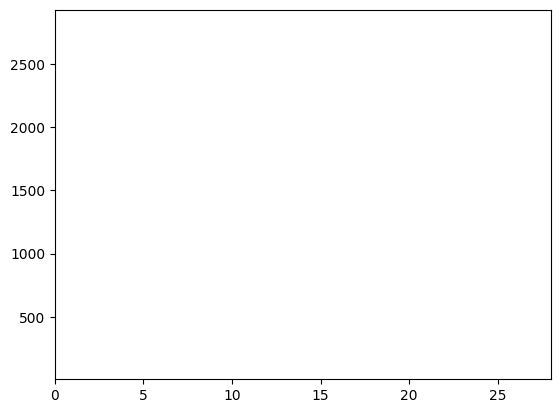

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

# Assuming `data` is a 2D array with shape (500, n_time_points)
# For example, you can create random data for demonstration:
# data = np.random.rand(500, 100)

# Number of time series
n_series = data.shape[0]

# Number of time points
n_time_points = data.shape[1]

# Create a figure and an axis
fig, ax = plt.subplots()

# Initialize a line object on the plot, which will be updated in the animation
line, = ax.plot([], [], lw=2)

# Setting the axes limits
ax.set_xlim(0, n_time_points - 1)
ax.set_ylim(np.min(data), np.max(data))

# Initialization function: plot the background of each frame
def init():
    line.set_data([], [])
    return line,

# Animation function: this is called sequentially
def animate(i):
    x = np.arange(n_time_points)
    y = data[i % n_series]
    line.set_data(x, y)
    return line,

# Call the animator
anim = FuncAnimation(fig, animate, init_func=init, frames=500, interval=20, blit=True)

# To display the animation in a Jupyter notebook, use the following:
# from IPython.display import HTML
# HTML(anim.to_html5_video())

# To save the animation as an mp4 file:
# anim.save('time_series_animation.mp4', fps=30, extra_args=['-vcodec', 'libx264'])

plt.show()

In [ ]:
anim

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

# Assuming `data` is a 2D array with shape (500, n_time_points)
# For example, you can create random data for demonstration:
# data = np.random.rand(500, 100)

# Number of time series
n_series = data.shape[0]

# Number of time points
n_time_points = data.shape[1]

# Create a figure and an axis
fig, ax = plt.subplots()

# Initialize a line object on the plot, which will be updated in the animation
line, = ax.plot([], [], lw=2)

# Setting the axes limits
ax.set_xlim(0, n_time_points - 1)
ax.set_ylim(0, 100)

# Initialization function: plot the background of each frame
def init():
    line.set_data([], [])
    return line,

# Animation function: this is called sequentially
def animate(i):
    x = np.arange(n_time_points)
    y = data[i % n_series]
    line.set_data(x, y)
    return line,

# Call the animator
anim = FuncAnimation(fig, animate, init_func=init, frames=300, interval=20, blit=True)

# To display the animation in a Jupyter notebook, use the following:
# from IPython.display import HTML
# HTML(anim.to_html5_video())
from IPython.display import HTML
HTML(anim.to_html5_video())
# To save the animation as an mp4 file:
# anim.save('time_series_animation.mp4', fps=30, extra_args=['-vcodec', 'libx264'])

plt.show()


In [ ]:
from IPython.display import HTML
HTML(anim.to_html5_video())

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
np.save("data", data)

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

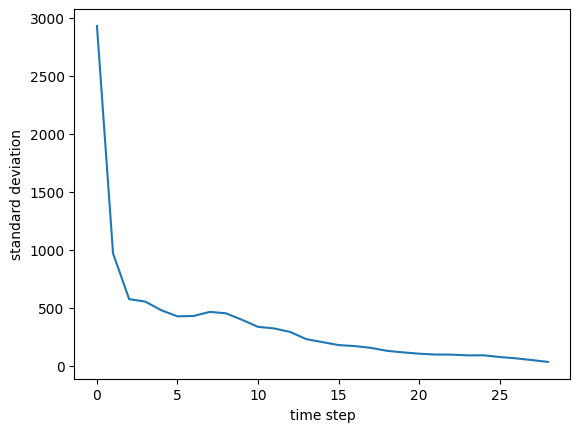

In [ ]:
a = np.load("data (1).npy")

plt.plot(a[0,:])
plt.xlabel('time step')
plt.ylabel('standard deviation')
plt.savefig('variance0.png')

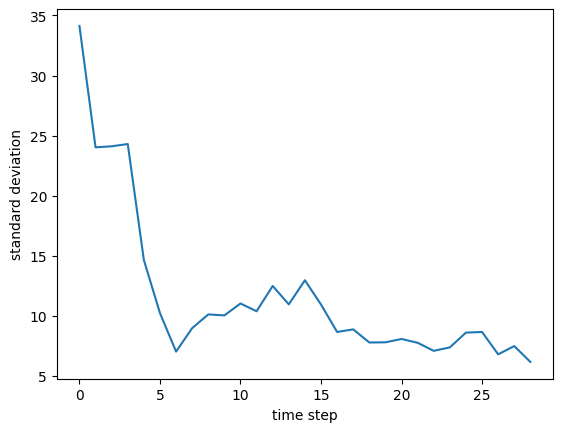

In [ ]:
plt.plot(a[99,:])
plt.xlabel('time step')
plt.ylabel('standard deviation')
plt.savefig('variance99.png')

In [ ]:
data_mean = np.load('datamean.npy')

In [ ]:
data_mean = data_mean[0:100 , :]
data_mean = data_mean[:,:-1]

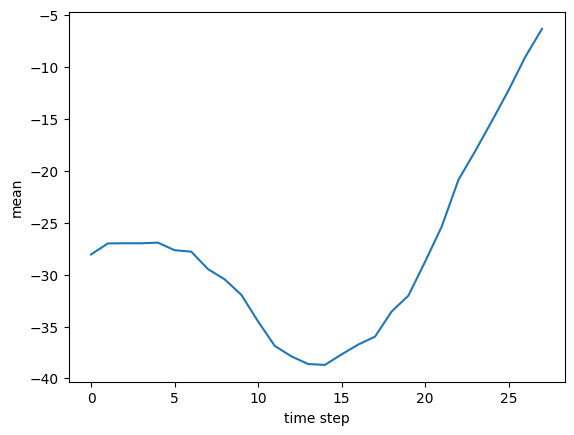

In [ ]:
plt.plot(data_mean[0,:])
plt.xlabel('time step')
plt.ylabel('mean')
plt.savefig('mean0.png')

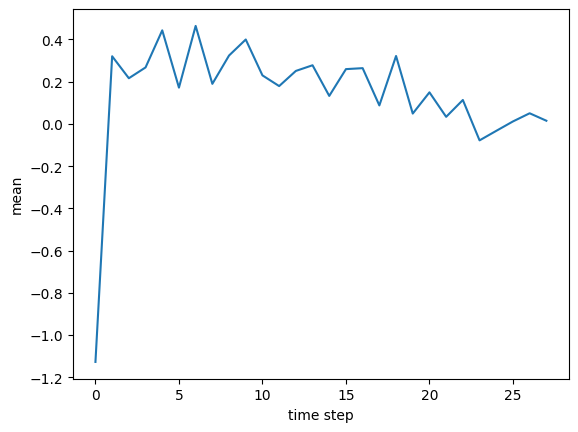

In [ ]:
plt.plot(data_mean[99,:])
plt.xlabel('time step')
plt.ylabel('mean')
plt.savefig('mean99.png')

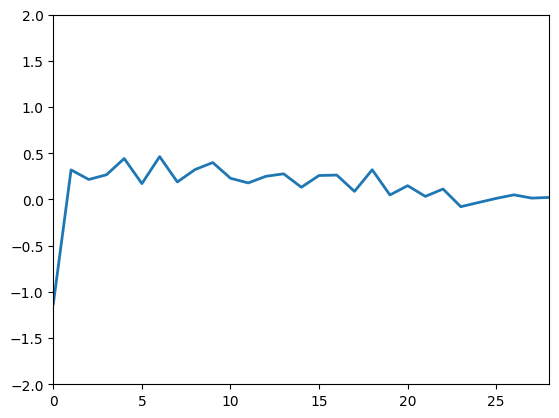

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

# Assuming `data` is a 2D array with shape (500, n_time_points)
# For example, you can create random data for demonstration:
# data = np.random.rand(500, 100)

# Number of time series
n_series = data_mean.shape[0]

# Number of time points
n_time_points = data_mean.shape[1]

# Create a figure and an axis
fig, ax = plt.subplots()

# Initialize a line object on the plot, which will be updated in the animation
line, = ax.plot([], [], lw=2)

# Setting the axes limits
ax.set_xlim(0, n_time_points - 1)
ax.set_ylim(-2, 2)

# Initialization function: plot the background of each frame
def init():
    line.set_data([], [])
    return line,

# Animation function: this is called sequentially
def animate(i):
    x = np.arange(n_time_points)
    y = data_mean[i % n_series]
    line.set_data(x, y)
    return line,

# Call the animator
anim = FuncAnimation(fig, animate, init_func=init, frames=300, interval=20, blit=True)

# To display the animation in a Jupyter notebook, use the following:
# from IPython.display import HTML
# HTML(anim.to_html5_video())
from IPython.display import HTML
HTML(anim.to_html5_video())
# To save the animation as an mp4 file:
# anim.save('time_series_animation.mp4', fps=30, extra_args=['-vcodec', 'libx264'])

plt.show()


In [ ]:
from IPython.display import HTML
HTML(anim.to_html5_video())

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


#DRL

In [ ]:
!git clone  https://github.com/ahmad-aghapour/spinningup.git
!cd spinningup
!pip install -e spinningup

Cloning into 'spinningup'...
remote: Enumerating objects: 1266, done.
remote: Counting objects: 100% (2/2), done.
remote: Compressing objects: 100% (2/2), done.
remote: Total 1266 (delta 0), reused 0 (delta 0), pack-reused 1264
Receiving objects: 100% (1266/1266), 31.02 MiB | 16.30 MiB/s, done.
Resolving deltas: 100% (593/593), done.
Obtaining file:///content/spinningup
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 17.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 37.8/37.8 MB 16.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.5/2.5 MB 100.6 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.9/178.9 kB 25.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
INFO:

In [ ]:
%cd spinningup

/content/spinningup


In [ ]:
!pip install mpi4py

In [ ]:
from spinup.utils.logx import EpochLogger


In [ ]:
%cd ..

/content


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
!git clone https://github.com/ahmad-aghapour/baselines.git


fatal: destination path 'baselines' already exists and is not an empty directory.


In [ ]:
%cd baselines/

/content/baselines


In [ ]:
from baselines.deepq.replay_buffer import *
from baselines.common.schedules import *

In [ ]:
%cd ..

/content


In [ ]:
from copy import deepcopy
import numpy as np
import torch
from torch.optim import Adam
import gym
import time
import core as core

buffer_size = 6000
prioritized_replay_alpha = 0.6
replay_buffer = PrioritizedReplayBuffer(buffer_size, alpha=prioritized_replay_alpha)

prioritized_replay_beta0 = 0.4

# need not be the same as training episode (see schedules.py)
prioritized_replay_beta_iters = 50001

beta_schedule = LinearSchedule(prioritized_replay_beta_iters,
                              initial_p=prioritized_replay_beta0,
                              final_p=1.0)

# for numerical stabiligy
prioritized_replay_eps = 1e-6




def ddpg(env, actor_critic=core.MLPActorCritic, ac_kwargs=dict(), seed=0,
         steps_per_epoch=4000, epochs=500, replay_size=int(1e6), gamma=1,
         polyak=0.9999, pi_lr=1e-4, q_lr=1e-4, batch_size=100, start_steps=10000,
         update_after=1000, update_every=50, act_noise=0.1, num_test_episodes=10,
         max_ep_len=1000, logger_kwargs=dict(), save_freq=1, device = torch.device('cpu')):
    """
    Deep Deterministic Policy Gradient (DDPG)


    Args:
        env_fn : A function which creates a copy of the environment.
            The environment must satisfy the OpenAI Gym API.

        actor_critic: The constructor method for a PyTorch Module with an ``act``
            method, a ``pi`` module, and a ``q`` module. The ``act`` method and
            ``pi`` module should accept batches of observations as inputs,
            and ``q`` should accept a batch of observations and a batch of
            actions as inputs. When called, these should return:

            ===========  ================  ======================================
            Call         Output Shape      Description
            ===========  ================  ======================================
            ``act``      (batch, act_dim)  | Numpy array of actions for each
                                           | observation.
            ``pi``       (batch, act_dim)  | Tensor containing actions from policy
                                           | given observations.
            ``q``        (batch,)          | Tensor containing the current estimate
                                           | of Q* for the provided observations
                                           | and actions. (Critical: make sure to
                                           | flatten this!)
            ===========  ================  ======================================

        ac_kwargs (dict): Any kwargs appropriate for the ActorCritic object
            you provided to DDPG.

        seed (int): Seed for random number generators.

        steps_per_epoch (int): Number of steps of interaction (state-action pairs)
            for the agent and the environment in each epoch.

        epochs (int): Number of epochs to run and train agent.

        replay_size (int): Maximum length of replay buffer.

        gamma (float): Discount factor. (Always between 0 and 1.)

        polyak (float): Interpolation factor in polyak averaging for target
            networks. Target networks are updated towards main networks
            according to:

            .. math:: \\theta_{\\text{targ}} \\leftarrow
                \\rho \\theta_{\\text{targ}} + (1-\\rho) \\theta

            where :math:`\\rho` is polyak. (Always between 0 and 1, usually
            close to 1.)

        pi_lr (float): Learning rate for policy.

        q_lr (float): Learning rate for Q-networks.

        batch_size (int): Minibatch size for SGD.

        start_steps (int): Number of steps for uniform-random action selection,
            before running real policy. Helps exploration.

        update_after (int): Number of env interactions to collect before
            starting to do gradient descent updates. Ensures replay buffer
            is full enough for useful updates.

        update_every (int): Number of env interactions that should elapse
            between gradient descent updates. Note: Regardless of how long
            you wait between updates, the ratio of env steps to gradient steps
            is locked to 1.

        act_noise (float): Stddev for Gaussian exploration noise added to
            policy at training time. (At test time, no noise is added.)

        num_test_episodes (int): Number of episodes to test the deterministic
            policy at the end of each epoch.

        max_ep_len (int): Maximum length of trajectory / episode / rollout.

        logger_kwargs (dict): Keyword args for EpochLogger.

        save_freq (int): How often (in terms of gap between epochs) to save
            the current policy and value function.

    """

    logger = EpochLogger(**logger_kwargs)
    logger.save_config(locals())

    torch.manual_seed(seed)
    np.random.seed(seed)

    act_dim = env.action_space.shape[0]

    # Action limit for clamping: critically, assumes all dimensions share the same bound!
    act_limit = env.action_space.high[0]

    # Create actor-critic module and target networks
    ac = actor_critic(env.observation_space, env.action_space, **ac_kwargs).to(device)
    ac_targ = deepcopy(ac)

    # Freeze target networks with respect to optimizers (only update via polyak averaging)
    for p in ac_targ.parameters():
        p.requires_grad = False

    # Experience buffer

    epsilon = 1.0

        # discount rate for epsilon
    epsilon_decay = 0.9994
    # self.epsilon_decay = 0.9994

    # min epsilon of epsilon-greedy.
    epsilon_min = 0.1

    # Set up function for computing DDPG Q-loss
    def compute_loss_q(data):

        (states, actions, rewards, next_states, dones, weights, batch_idxes) = data


        states = torch.tensor(states).to(torch.float32).to(device)
        actions = torch.tensor(actions).to(torch.float32).to(device)
        rewards = torch.tensor(rewards).to(torch.float32).to(device)
        next_states = torch.tensor(next_states).to(torch.float32).to(device)
        dones = torch.tensor(dones).to(torch.float32).to(device)
        q = ac.q1(states,actions)
        q2 = ac.q2(states,actions)

        # Bellman backup for Q function
        with torch.no_grad():
          q_pi_targ = ac_targ.q1(next_states, ac_targ.pi(next_states))
          q2_pi_targ = ac_targ.q2(next_states, ac_targ.pi(next_states))
          #q_pi_targ = ac_targ.q1(next_states, (torch.ones(batch_size,1)*50).to(device))

          backup = rewards + (1 - dones) * q_pi_targ
          backup2 = rewards**2 + gamma * (1 - dones) * (2* q_pi_targ * rewards +q2_pi_targ )


        # MSE loss against Bellman backup

        w =torch.tensor(weights).to(torch.float32).to(device)

        loss_q = torch.sum(torch.square(q - backup)*w)
        loss_q2=  torch.sum(torch.square(q2 - backup2)*w)


        # Useful info for logging
        td_errors = torch.abs(q - backup).detach().cpu().numpy()
        new_priorities = (td_errors + prioritized_replay_eps).flatten()
        replay_buffer.update_priorities(batch_idxes, new_priorities)
        loss_info = dict(QVals=q.detach().cpu().numpy())

        return loss_q, loss_info  , loss_q2

    # Set up function for computing DDPG pi loss
    def compute_loss_pi(data):
        (states, actions, rewards, next_states, dones, weights, batch_idxes) = data
        q_pi = ac.q2(torch.tensor(states).to(torch.float32).to(device), ac.pi(torch.tensor(states).to(torch.float32).to(device)))
        return q_pi.mean()

    # Set up optimizers for policy and q-function
    pi_optimizer = Adam(ac.pi.parameters(), lr=pi_lr)
    q_optimizer = Adam(ac.q1.parameters(), lr=q_lr)
    q2_optimizer = Adam(ac.q2.parameters(), lr=q_lr)

    # Set up model saving
    logger.setup_pytorch_saver(ac)

    def update(data):
        # First run one gradient descent step for Q.
        q_optimizer.zero_grad()
        loss_q, loss_info ,loss_q2 = compute_loss_q(data)
        loss_q.backward()
        q_optimizer.step()

        q2_optimizer.zero_grad()
        loss_q2.backward()
        q2_optimizer.step()




        # Freeze Q-network so you don't waste computational effort
        # computing gradients for it during the policy learning step.
        for p in ac.q1.parameters():
            p.requires_grad = False
        for p in ac.q2.parameters():
            p.requires_grad = False

        # Next run one gradient descent step for pi.
        pi_optimizer.zero_grad()
        loss_pi = compute_loss_pi(data)
        loss_pi.backward()
        pi_optimizer.step()

        # Unfreeze Q-network so you can optimize it at next DDPG step.
        for p in ac.q1.parameters():
            p.requires_grad = True
        for p in ac.q2.parameters():
            p.requires_grad = True

        # Record things
        logger.store(LossQ=loss_q.item(), LossPi=loss_pi.item(), **loss_info)

        # Finally, update target networks by polyak averaging.
        with torch.no_grad():
            for p, p_targ in zip(ac.parameters(), ac_targ.parameters()):
                # NB: We use an in-place operations "mul_", "add_" to update target
                # params, as opposed to "mul" and "add", which would make new tensors.
                p_targ.data.mul_(polyak)
                p_targ.data.add_((1 - polyak) * p.data)

    def get_action(o, noise_scale):

      o = torch.cat((torch.tensor(o[0]),torch.tensor(o[1]),torch.tensor([o[2]])) , dim = 0).to(torch.float32).to(device)

      if len(o.size()) == 1 :
        o = torch.unsqueeze(o,0)
      ac.pi.eval()
      a = ac.act(o)[0]
      ac.pi.train()
      #print(a)
      #a += noise_scale * np.random.randn(act_dim)
      return a


    # Prepare for interaction with environment
    total_steps = steps_per_epoch * epochs
    start_time = time.time()
    o, ep_ret, ep_len = env.reset(), 0, 0

    # Main loop: collect experience in env and update/log each epoch
    for t in range(total_steps):

        # Until start_steps have elapsed, randomly sample actions
        # from a uniform distribution for better exploration. Afterwards,
        # use the learned policy (with some noise, via act_noise).
        if np.random.rand()>= epsilon:
            a = get_action(o,0)
        else:
            a = env.action_space.sample()

        # Step the env

        if epsilon >= epsilon_min:
          epsilon *= epsilon_decay
        # Step the env

        o2, r, d, _ = env.step(a)
        #print(a)
        #print(r)
        ep_ret += r
        ep_len += 1

        # Ignore the "done" signal if it comes from hitting the time
        # horizon (that is, when it's an artificial terminal signal
        # that isn't based on the agent's state)
        #d = False if ep_len==max_ep_len else d

        # Store experience to replay buffer

        o = np.concatenate((o[0] , o[1], [o[2]]))
        o21 = np.concatenate((o2[0] , o2[1], [o2[2]]))
        replay_buffer.add(o, a, r, o21, d)

        # Super critical, easy to overlook step: make sure to update
        # most recent observation!
        o = o2

        # End of trajectory handling
        if d or (ep_len == max_ep_len):
            logger.store(EpRet=ep_ret, EpLen=ep_len)
            o, ep_ret, ep_len = env.reset(), 0, 0

        # Update handling
        if len(replay_buffer) >= batch_size:
            for _ in range(update_every):
                batch = replay_buffer.sample(batch_size,beta=beta_schedule.value(t))
                update(data=batch)

        # End of epoch handling
        if (t+1) % steps_per_epoch == 0:
            epoch = (t+1) // steps_per_epoch

            # Save model
            if (epoch % save_freq == 0) or (epoch == epochs):
                logger.save_state({'env': env}, None)

            # Test the performance of the deterministic version of the agent.


            # Log info about epoch
            logger.log_tabular('Epoch', epoch)
            logger.log_tabular('EpRet', with_min_and_max=True)
            #logger.log_tabular('TestEpRet', with_min_and_max=True)
            logger.log_tabular('EpLen', average_only=True)
            #logger.log_tabular('TestEpLen', average_only=True)
            logger.log_tabular('TotalEnvInteracts', t)
            logger.log_tabular('QVals', with_min_and_max=True)
            logger.log_tabular('LossPi', average_only=True)
            logger.log_tabular('LossQ', average_only=True)
            logger.log_tabular('Time', time.time()-start_time)
            logger.dump_tabular()



In [ ]:
ddpg(env , start_steps = 100 , steps_per_epoch = 1000 , update_after = 100 ,update_every = 1, device = torch.device('cuda'))

Logging data to /tmp/experiments/1697894394/progress.txt
Saving config:

{
    "ac_kwargs":	{},
    "act_noise":	0.1,
    "actor_critic":	"MLPActorCritic",
    "batch_size":	100,
    "device":	"cuda",
    "env":	{
        "<TradingEnv instance>":	{
            "_np_random":	"RandomNumberGenerator(PCG64)",
            "action_space":	{
                "Box(-2.0, 2.0, (1,), float32)":	{
                    "_np_random":	"RandomNumberGenerator(PCG64)",
                    "_shape":	[
                        1
                    ],
                    "bounded_above":	"[ True]",
                    "bounded_below":	"[ True]",
                    "dtype":	"float32",
                    "high":	"[2.]",
                    "high_repr":	"2.0",
                    "low":	"[-2.]",
                    "low_repr":	"-2.0"
                }
            },
            "num_path":	500002,
            "num_period":	31,
            "num_state":	3,
            "observation_space":	{
                "Box

KeyboardInterrupt: ignored